In [11]:
import mido
import string
import numpy as np
import math
from music21 import converter, instrument, note, chord, stream
import glob
import pypianoroll
import pickle
import matplotlib.pyplot as plt

In [12]:
def save_data(data, location):
    num_samp = len(data)
    x = data[0][0]
    arr_data = np.zeros((num_samp, 4, x.shape[0], 4, 96, 84))
    for i in range(num_samp):
        for j in range(4):
            arr_data[i,j,:,:,:,:] = data[i][j][:,:,:,:,0]
    print(arr_data.shape)
    with open(location, 'wb') as f:
        pickle.dump(arr_data,f)

In [13]:
def arry2mid(ary, tempo=200):
    # get the difference
    new_ary = np.concatenate([np.array([[0] * 84]), np.array(ary)], axis=0)
    changes = new_ary[1:] - new_ary[:-1]
    print(changes)
    # create a midi file with an empty track
    mid_new = mido.MidiFile()
    track = mido.MidiTrack()
    mid_new.tracks.append(track)
    track.append(mido.MetaMessage('set_tempo', tempo=tempo, time=5))
    # add difference in the empty track
    last_time = 0
    for ch in changes:
        if set(ch) == {0}:  # no change
            last_time += 1
        else:
            on_notes = np.where(ch > 0)[0]
            on_notes_vol = ch[on_notes]
            off_notes = np.where(ch < 0)[0]
            first_ = True
            for n, v in zip(on_notes, on_notes_vol):
                new_time = last_time if first_ else 0

                #print(n+24)
                track.append(mido.Message('note_on', note=n + 24, velocity=v, time=new_time))
                first_ = False
            for n in off_notes:
                new_time = last_time if first_ else 0
                track.append(mido.Message('note_off', note=n + 24, velocity=0, time=new_time))
                first_ = False
            last_time = 0
    return mid_new

In [14]:
def tarry2mid(quartet, tempo=200):
    mid_new = mido.MidiFile()
    
    for i in range(4):
        ary = quartet[i]
        # get the difference
        track = mido.MidiTrack()
        new_ary = np.concatenate([np.array([[0] * 84]), np.array(ary)], axis=0)
        changes = new_ary[1:] - new_ary[:-1]
        print(changes)
        # create a midi file with an empty track

        mid_new.tracks.append(track)
        track.append(mido.MetaMessage('set_tempo', tempo=tempo, time=60))
        # add difference in the empty track
        last_time = 0
        for ch in changes:
            if set(ch) == {0}:  # no change
                last_time += 1
            else:
                on_notes = np.where(ch > 0)[0]
                on_notes_vol = ch[on_notes]
                off_notes = np.where(ch < 0)[0]
                first_ = True
                for n, v in zip(on_notes, on_notes_vol):
                    new_time = last_time if first_ else 0

                    #print(n+24)
                    track.append(mido.Message('note_on', note=n + 24, velocity=v, time=new_time))
                    first_ = False
                for n in off_notes:
                    new_time = last_time if first_ else 0
                    track.append(mido.Message('note_off', note=n + 24, velocity=0, time=new_time))
                    first_ = False
                last_time = 0
    return mid_new

In [15]:
def truncate(roll, num_iter):
    
    non_z = (roll > 0).astype("int32")
    posi = np.multiply(roll, non_z)
    total = np.sum(posi)
    num_nz = np.count_nonzero(posi)
    mean = total/num_nz
    
    threshold = (posi>mean).astype("int32")
    result = np.multiply(posi, threshold)
    num_iter -= 1 
    if num_iter == 0:
        return result
    else:
        return truncate(result, num_iter)
    

In [16]:
def truncate_pitches(roll, num_iter):
    new_roll = np.zeros(roll.shape)
    for i in range(roll.shape[1]):
        curr = roll[:,i]
        non_z = (curr>0).astype('int32')
        posi = np.multiply(curr, non_z)
        
        total = np.sum(posi)
        num_nz = np.count_nonzero(posi)
        mean = total/num_nz
        
        threshold = (posi>mean).astype("int32")
        result = np.multiply(posi, threshold)
        
        new_roll[:,i] = result
    
    num_iter -= 1
    
    if num_iter == 0:
        return new_roll
    else:
        return truncate(new_roll, num_iter)


In [17]:
def truncate_time(roll, num_iter):
    new_roll = np.zeros(roll.shape)
    for i in range(roll.shape[0]):
        curr = roll[i,:]
        non_z = (curr>0).astype('int32')
        posi = np.multiply(curr, non_z)
        
        total = np.sum(posi)
        num_nz = np.count_nonzero(posi)
        mean = total/num_nz
        
        threshold = (posi>mean).astype("int32")
        result = np.multiply(posi, threshold)
        
        new_roll[i,:] = result
    
    num_iter -= 1
    
    if num_iter == 0:
        return new_roll
    else:
        return truncate(new_roll, num_iter)

In [18]:
def save_mid(roll, name):
    mid = arry2mid(roll)
    mid.save(name)

In [19]:
def compose(data):
    combined = np.zeros((4,384,84))
    for i in range(4): #for each instrument
        track = np.zeros((384, 84))
        
        for j in range(4): # for each bar
            n = np.random.randint(0,data.shape[1])
             # choose random sample
                
                
            x = np.random.randint(0, 4) # choose random bar
            result = data[i,n,x,:,:]
            '''
            if i==0:
                aa, bb = 2, 4
            if i==1:
                aa, bb = 5, 3
            if i==2:
                aa, bb = 5, 2
            if i ==3:
                aa, bb = 5, 2'''
            

            Y = truncate_pitches(result*100, 8)
            num = np.count_nonzero(Y)
            #plot(Y)
            #Z=Y
            Z = truncate_time(Y, 1).astype('int32')
            plot(Z)
            track[j*96:j*96+96, :] = Z
            
        combined[i] = track
        #plot(track)
            
    return combined

In [20]:
def plot(roll):
    plt.plot(range(roll.shape[0]), np.multiply(np.where(roll>0, 1, 0), range(0, 84)), marker='.', markersize=1, linestyle='')
    plt.title("nocturne_27_2_(c)inoue.mid")
    plt.show()

In [24]:
Data = np.load('data_v1.pkl', allow_pickle=True)
print(Data.shape)


(19, 4, 40, 4, 96, 84)


(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


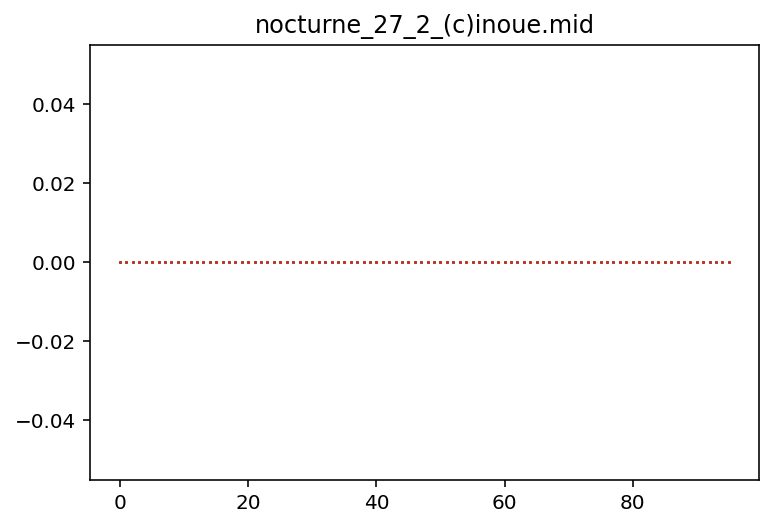

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


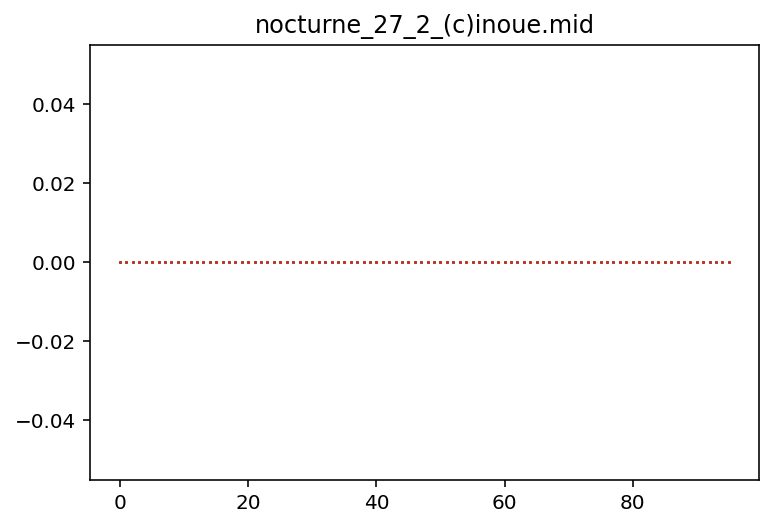

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


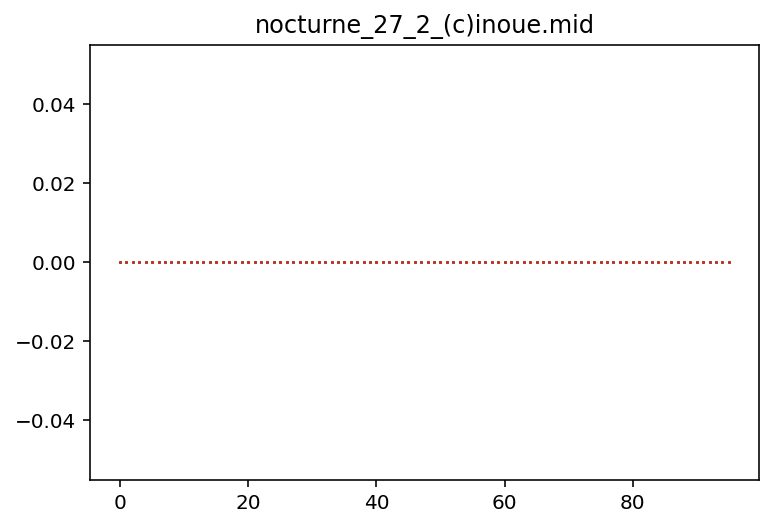

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


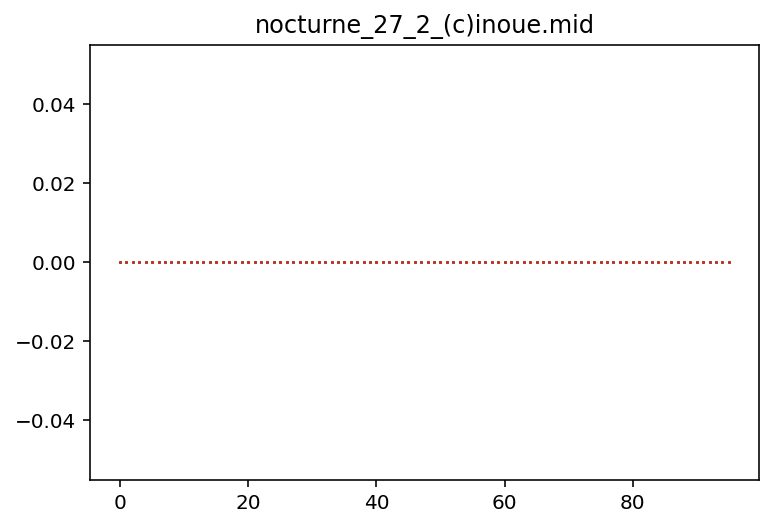

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


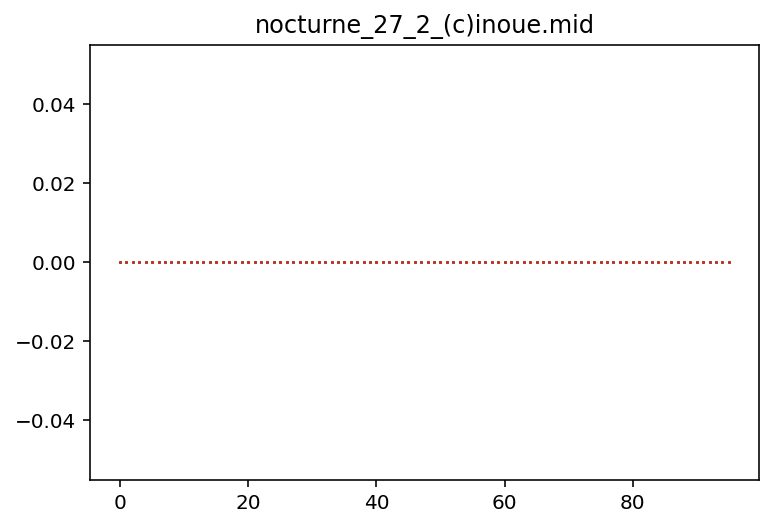

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


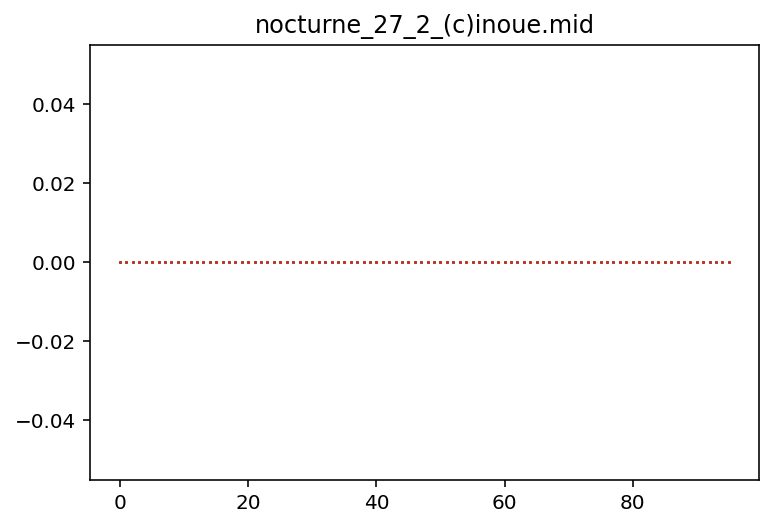

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


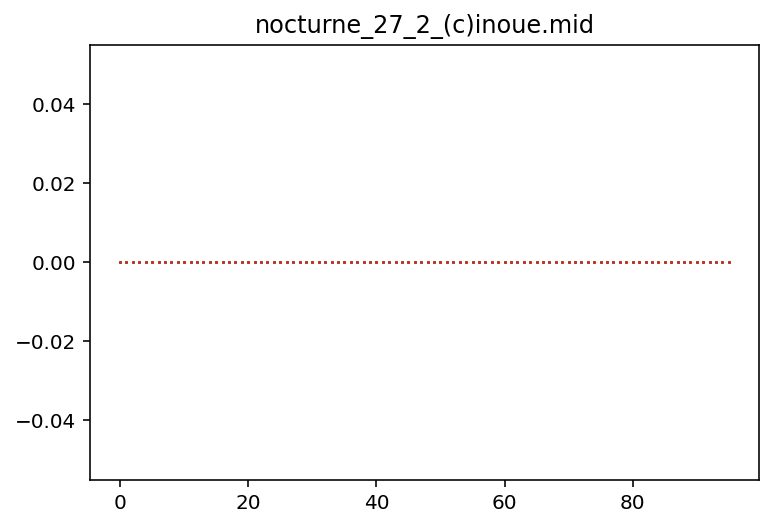

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


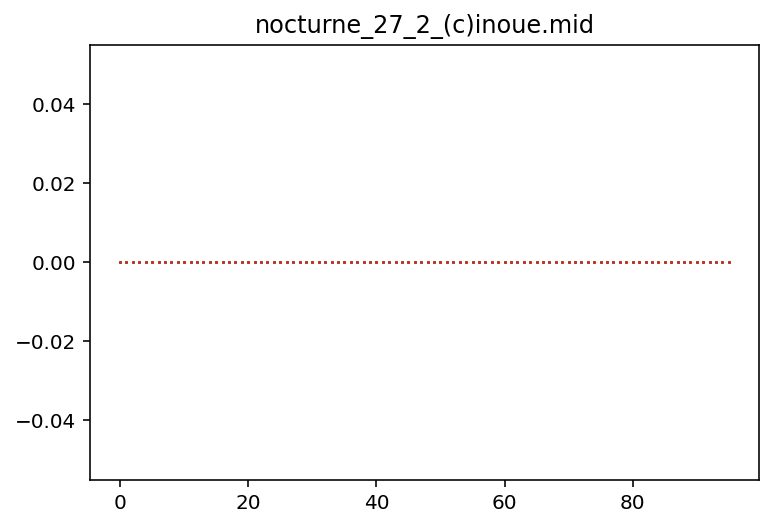

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


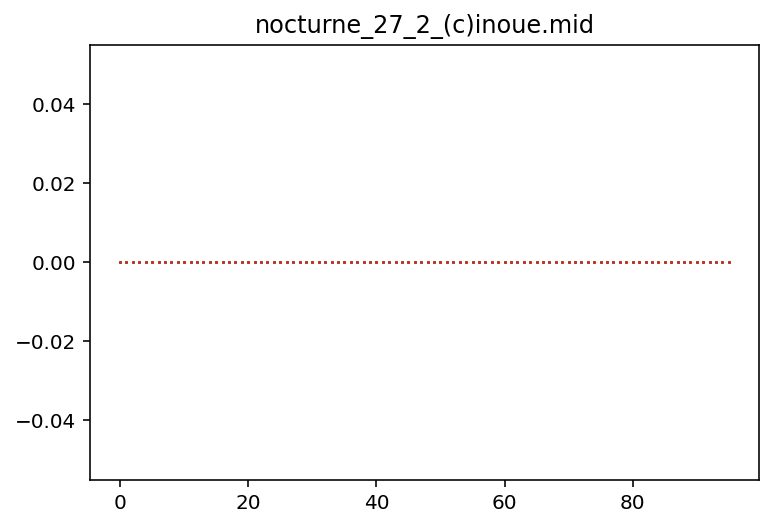

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


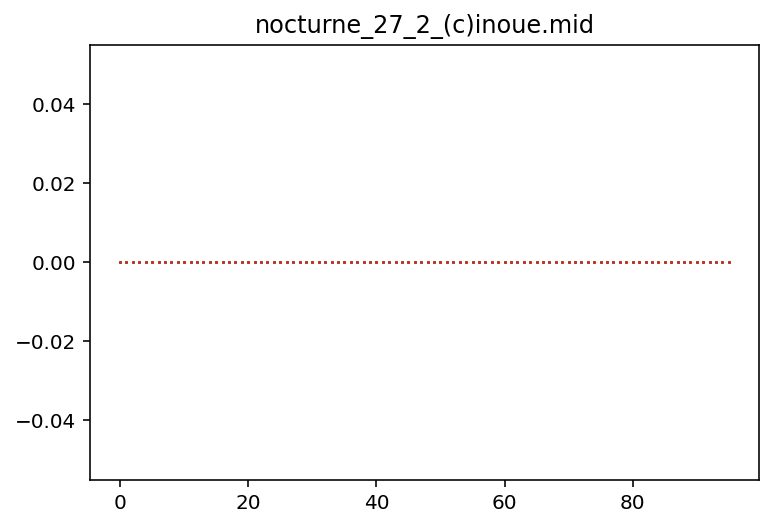

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


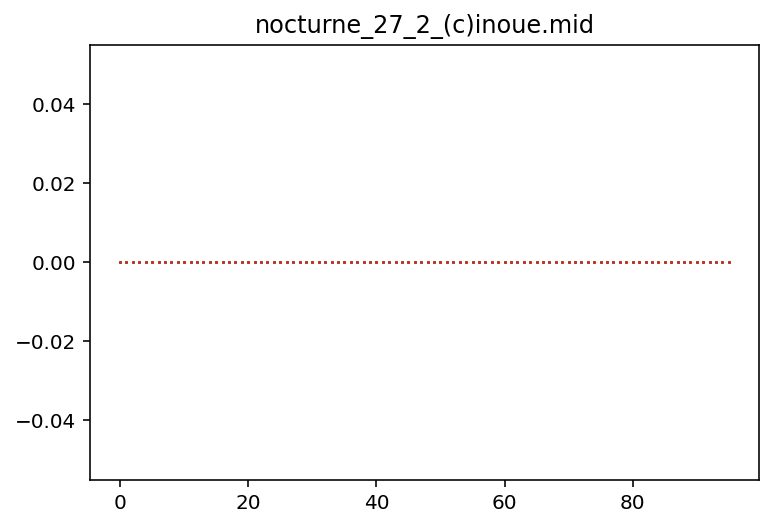

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


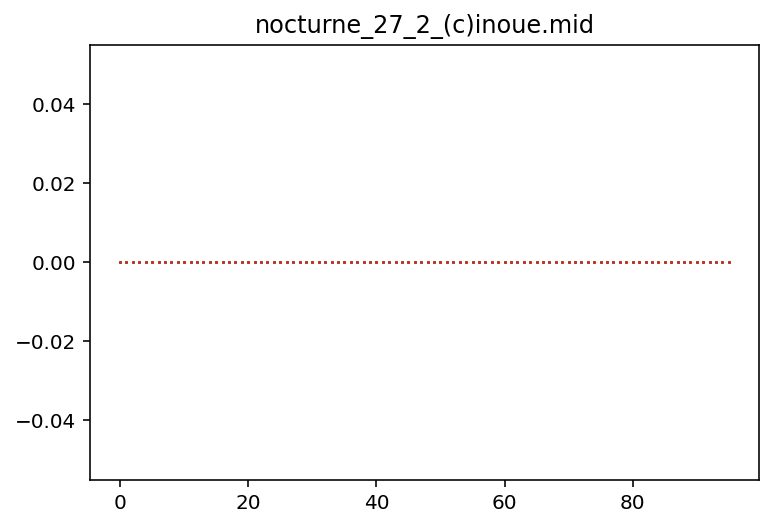

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


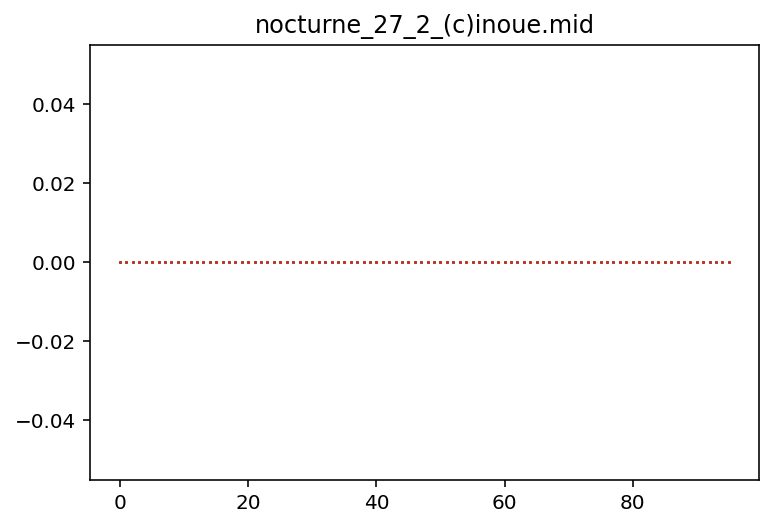

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


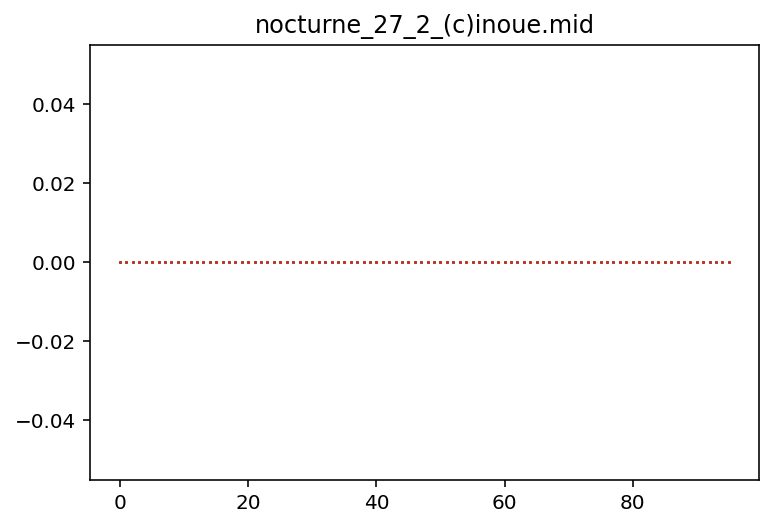

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


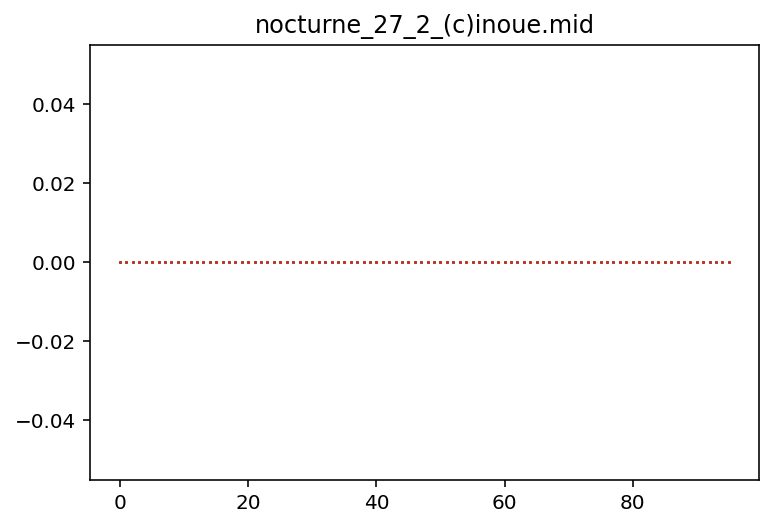

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


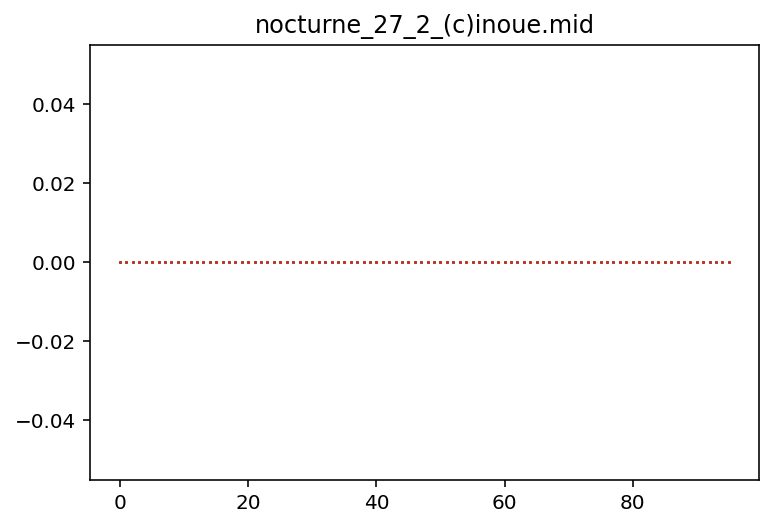

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


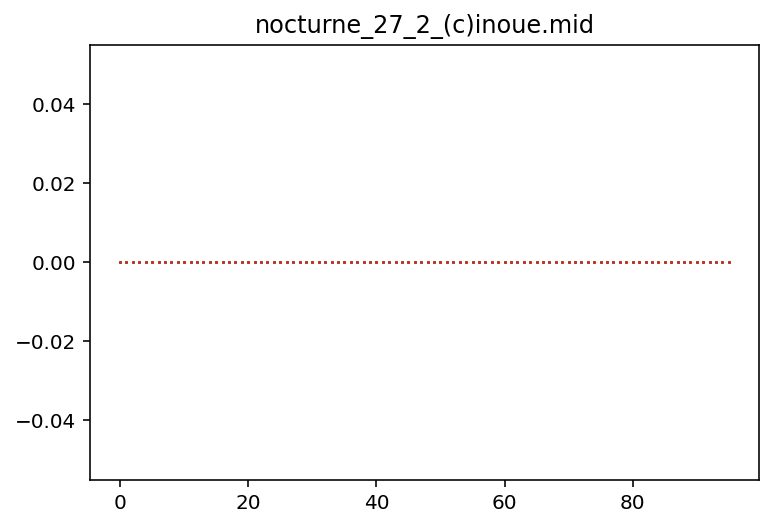

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


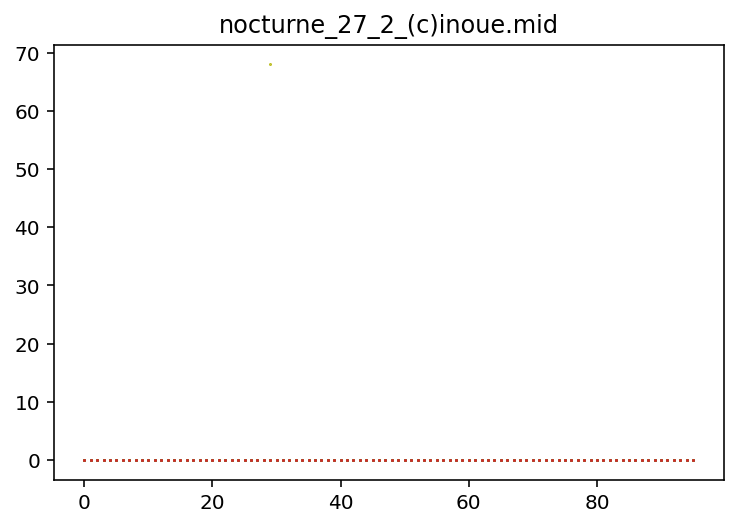

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


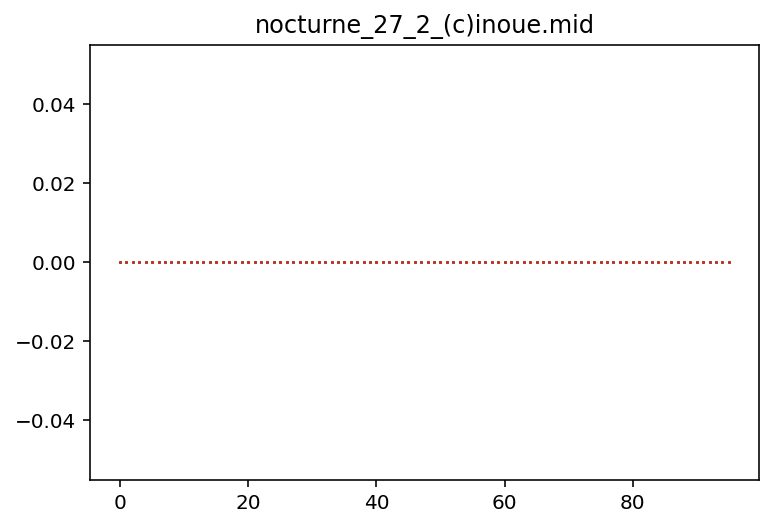

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


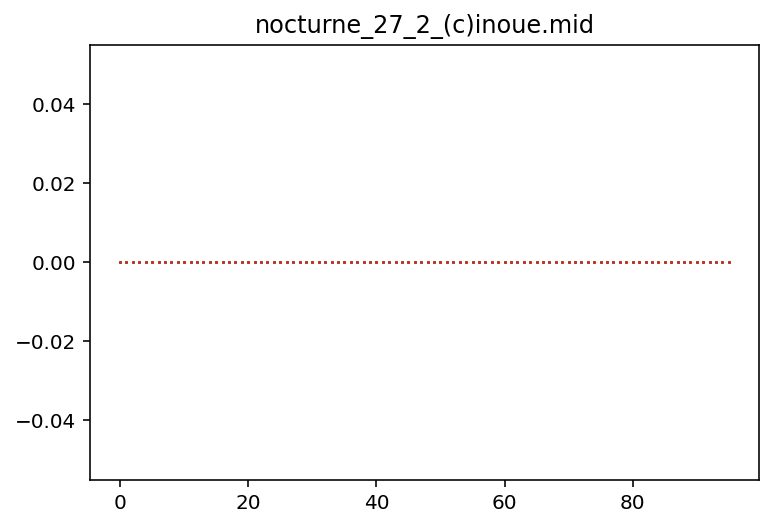

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


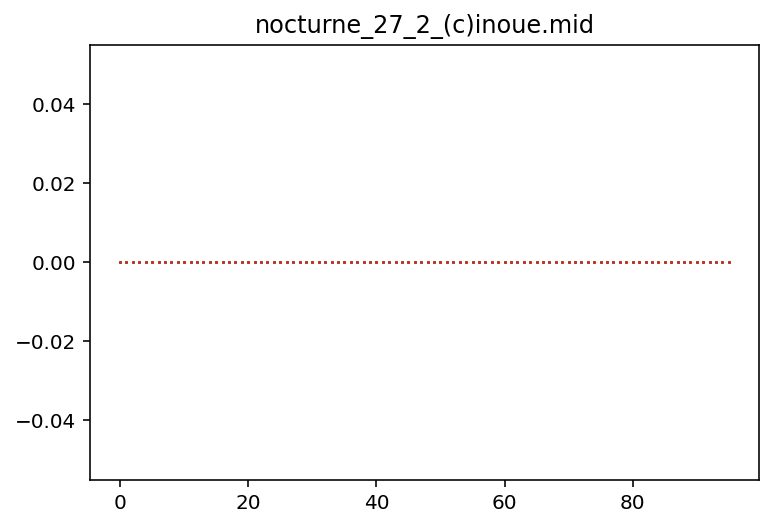

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


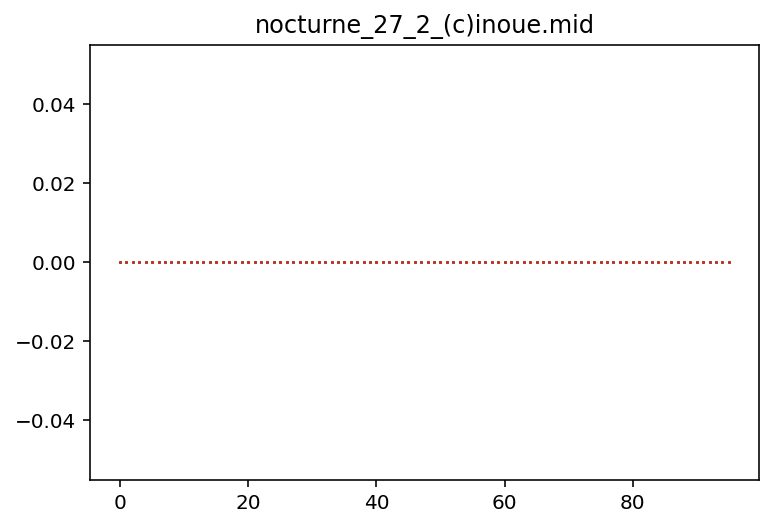

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


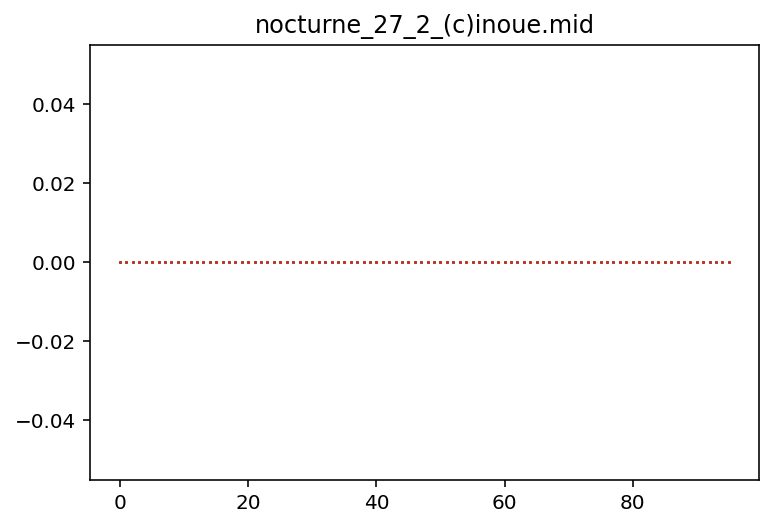

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


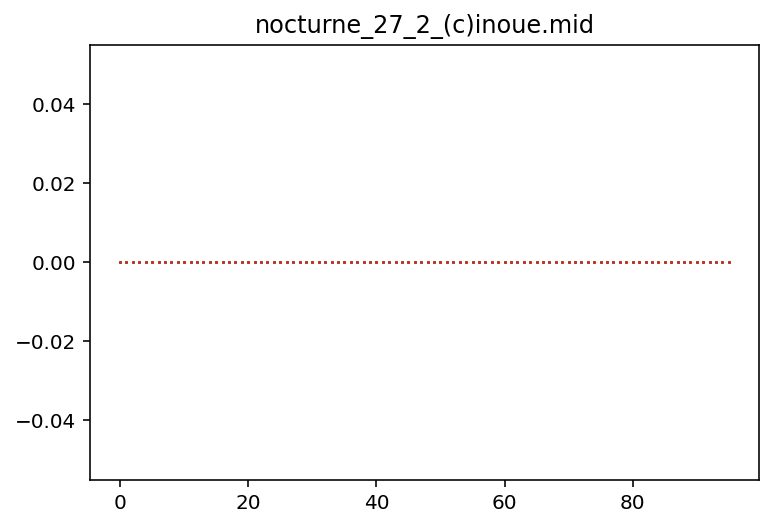

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


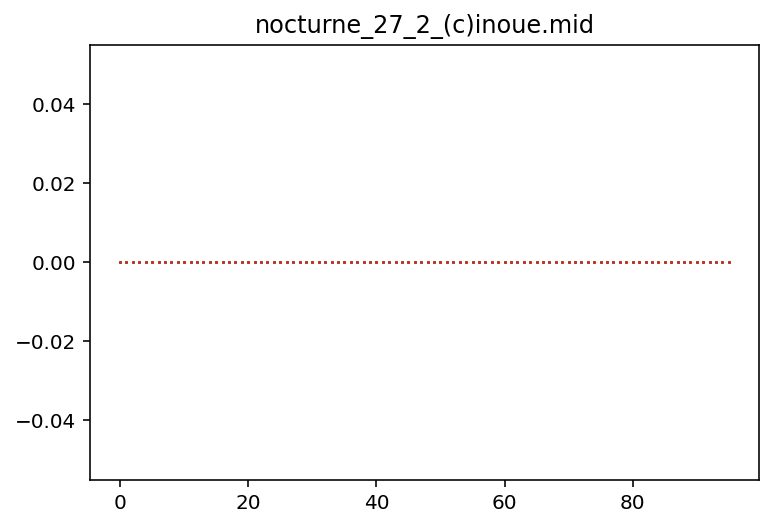

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


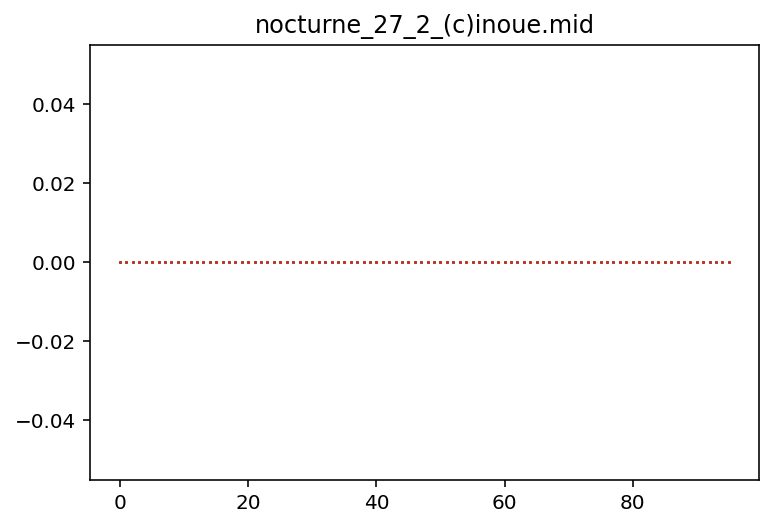

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


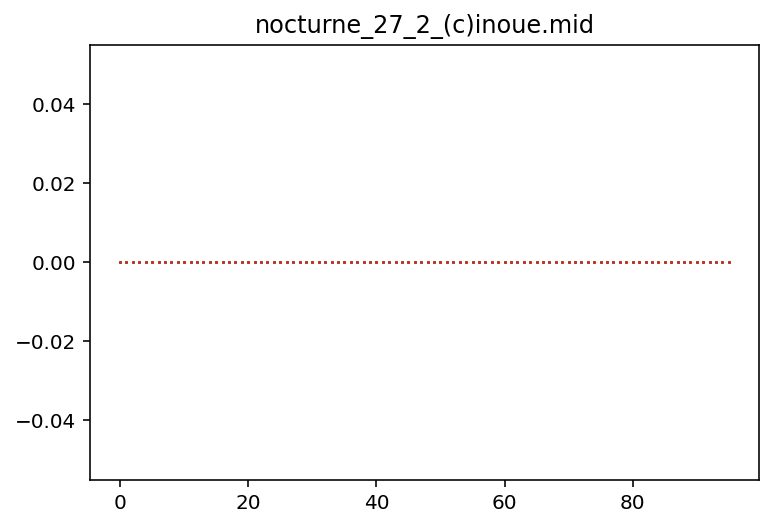

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


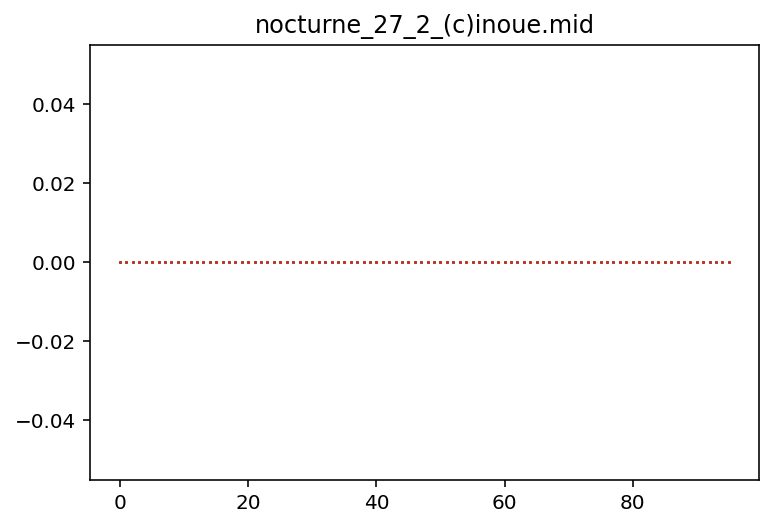

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


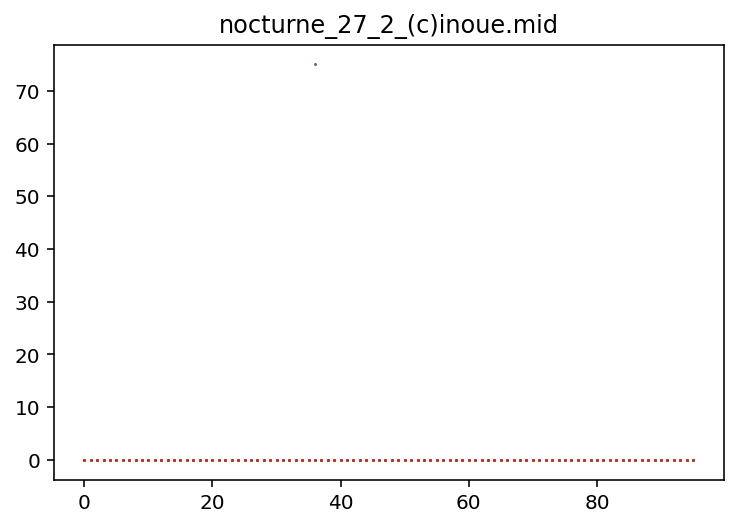

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


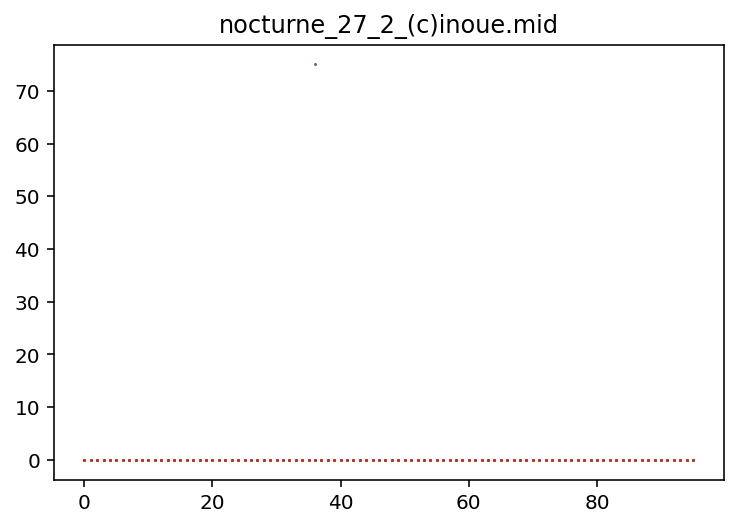

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


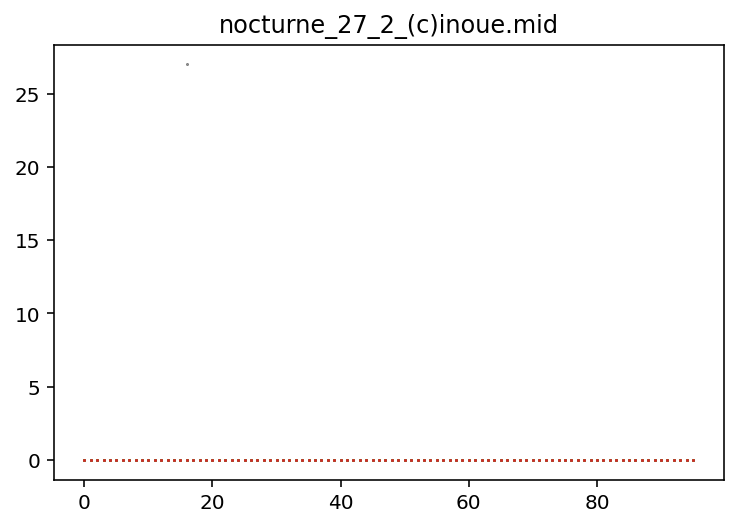

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


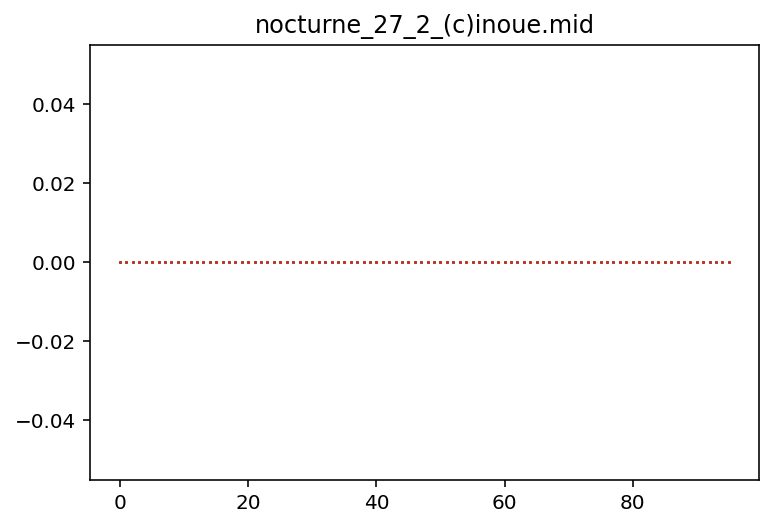

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


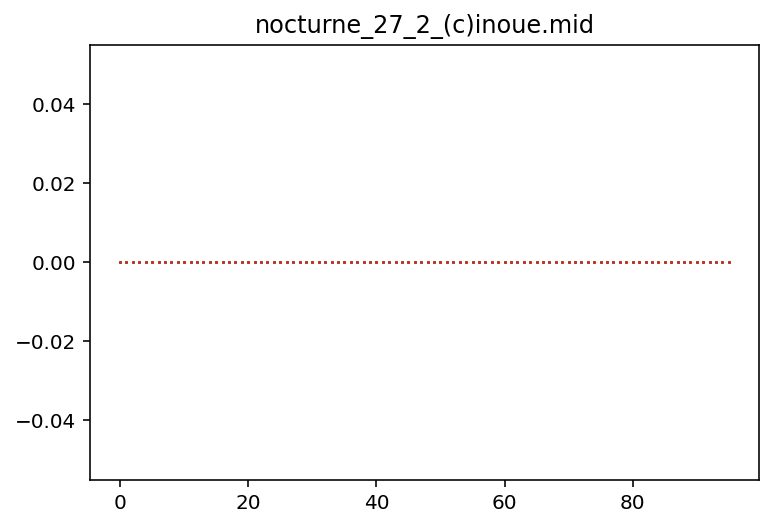

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


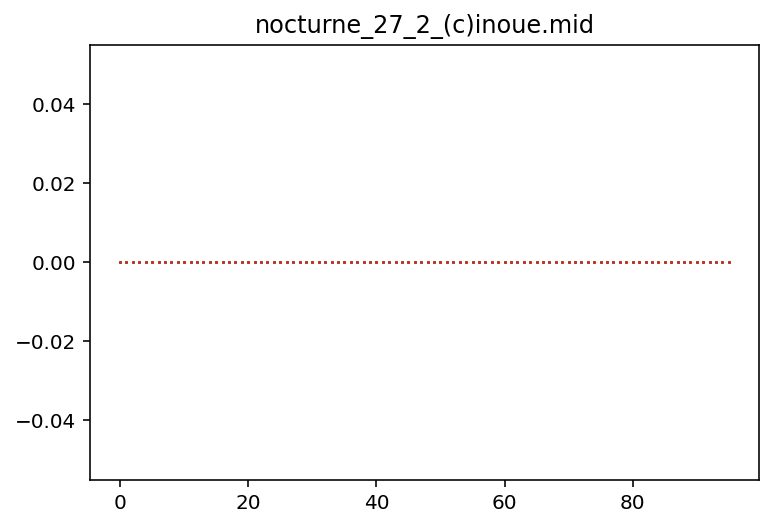

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


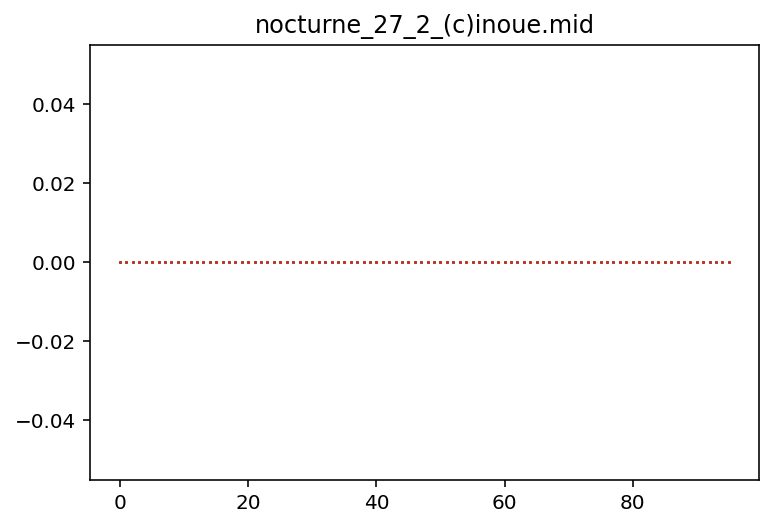

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


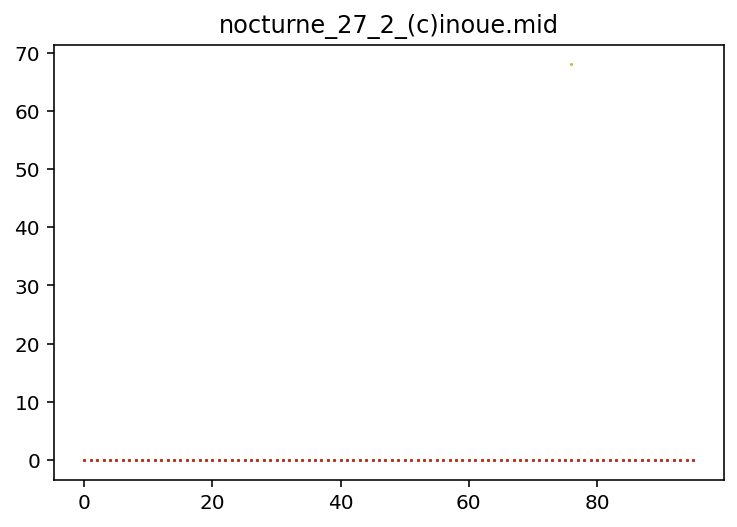

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


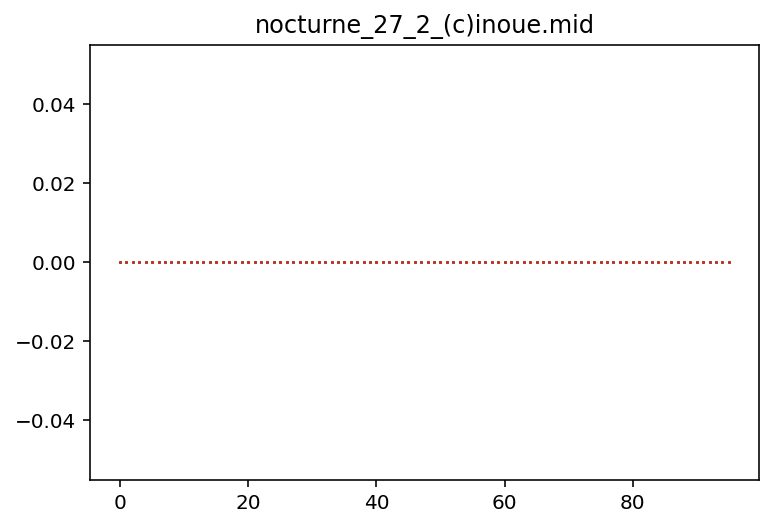

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


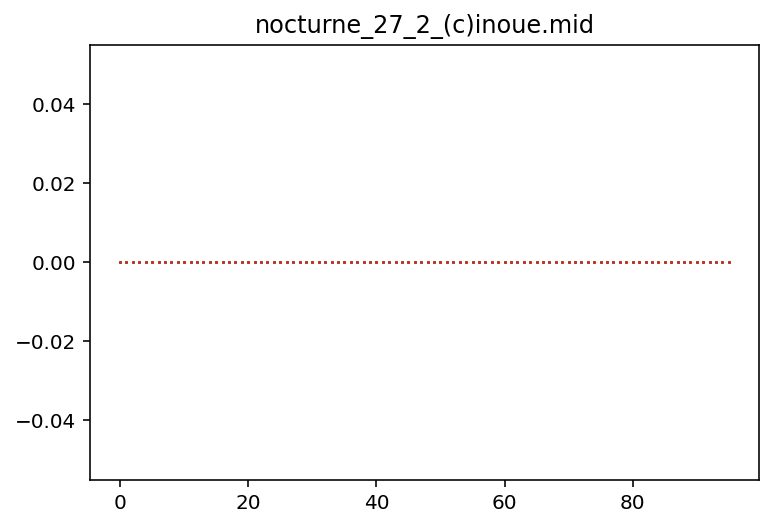

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


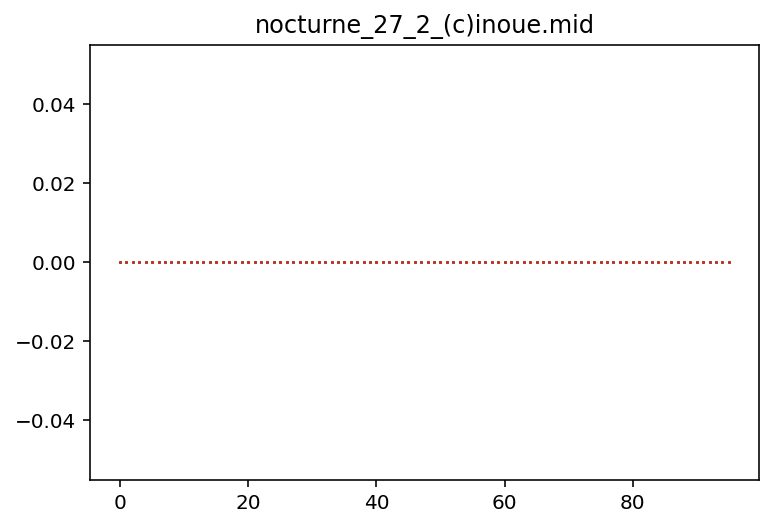

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


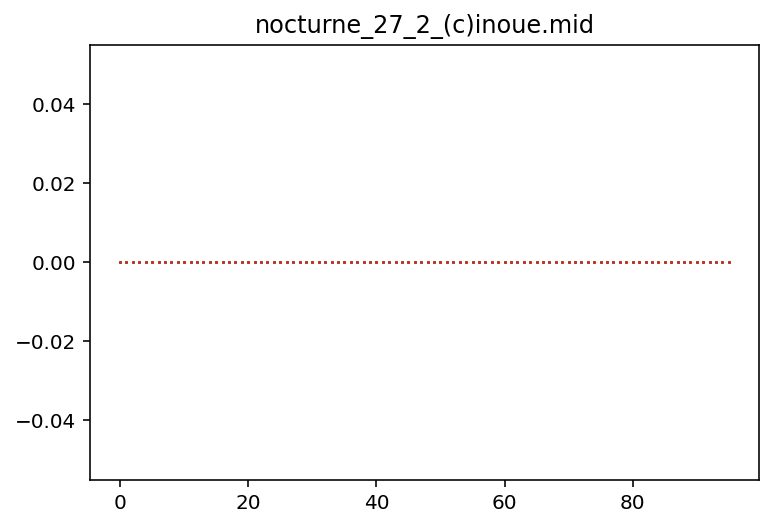

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


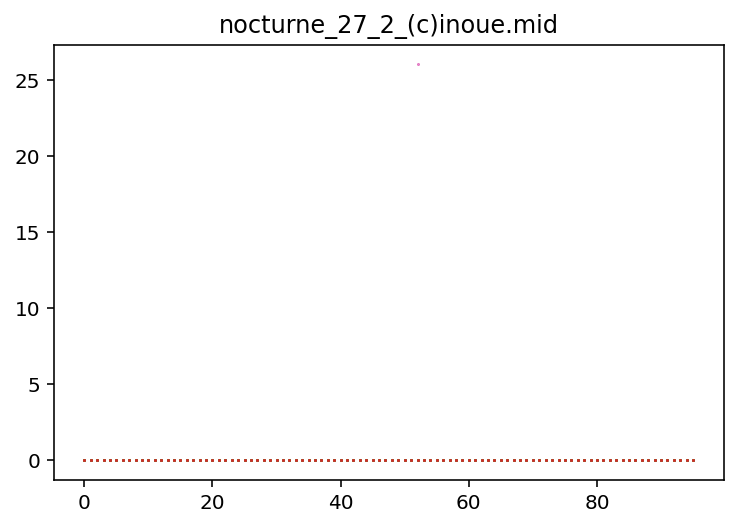

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


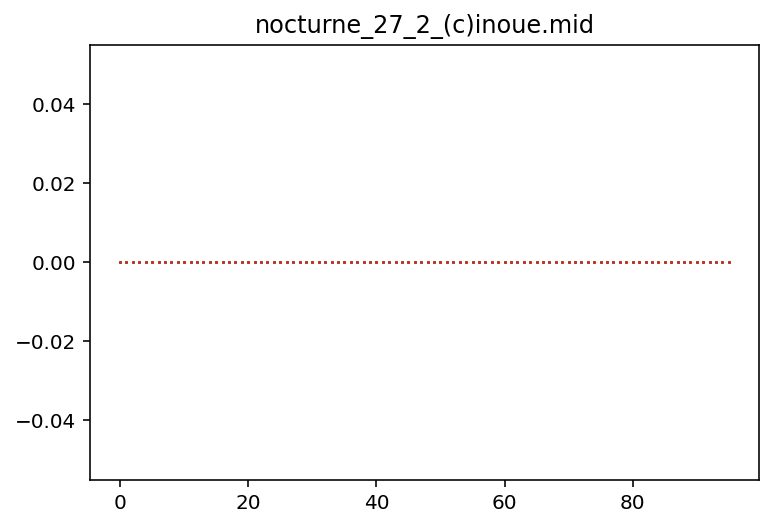

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


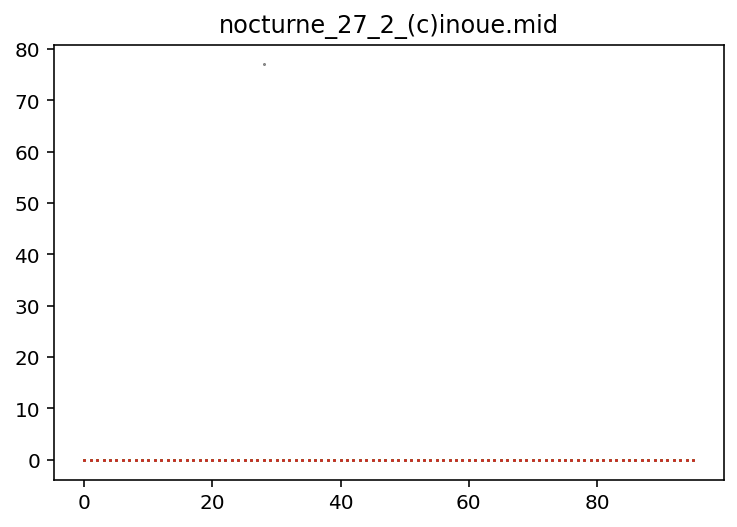

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


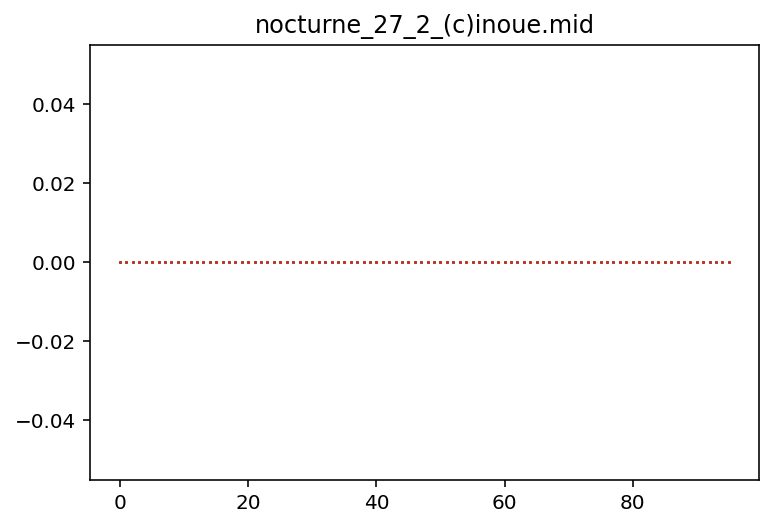

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


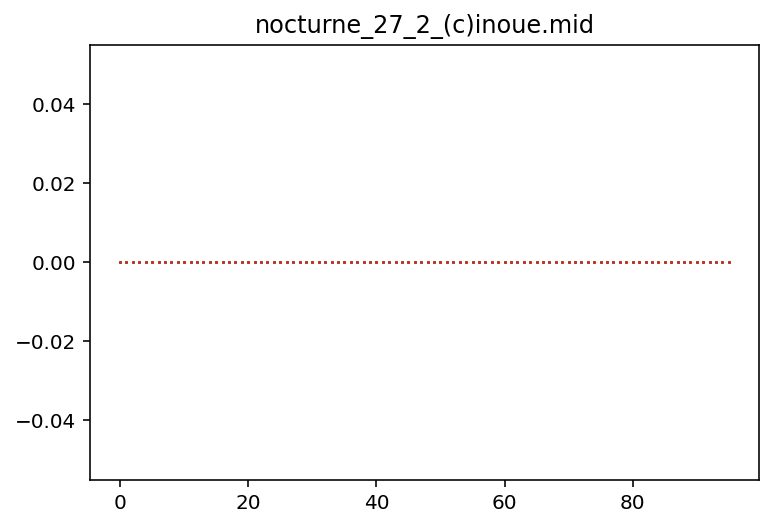

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


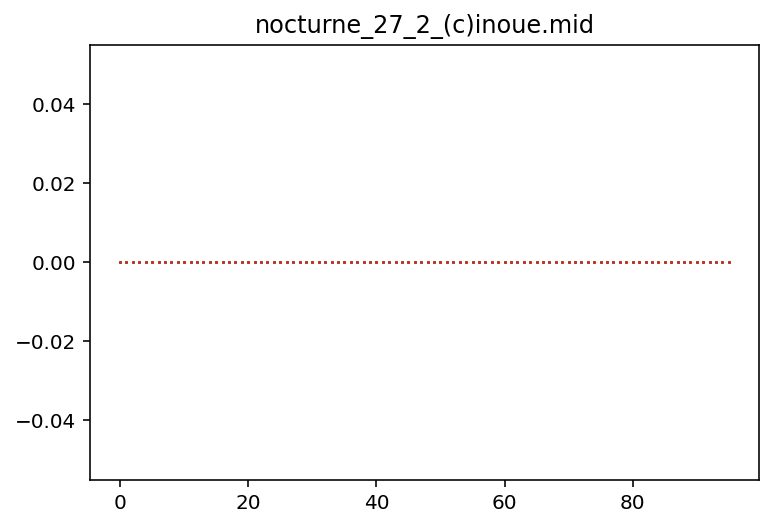

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


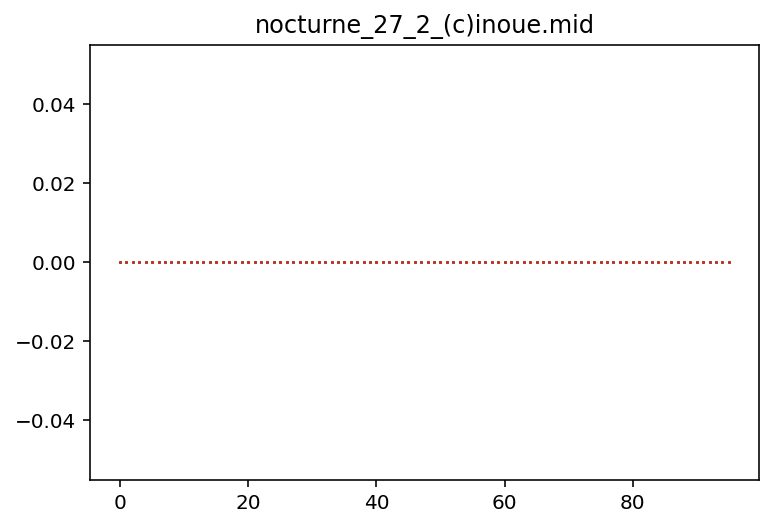

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


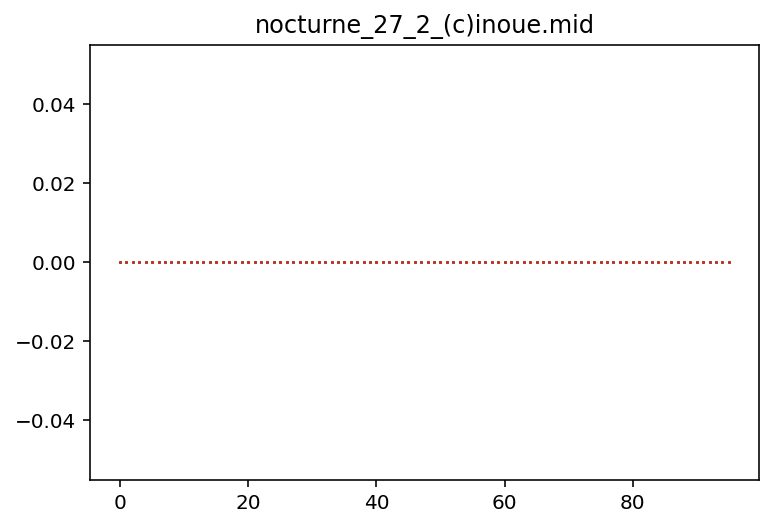

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


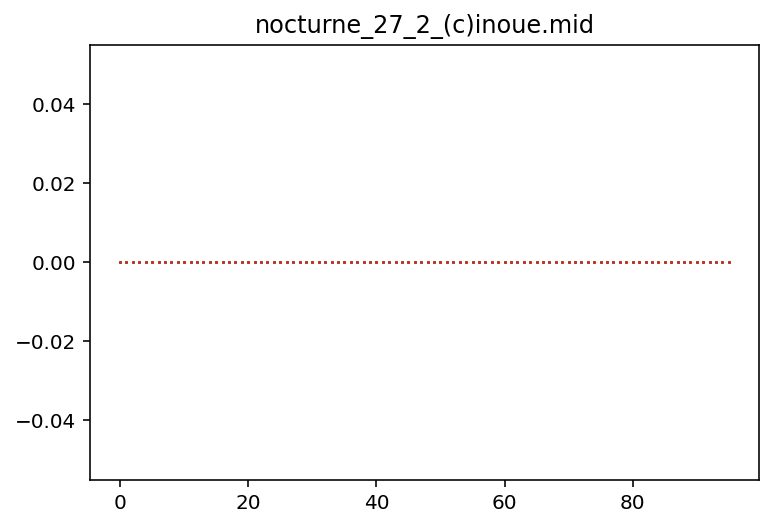

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


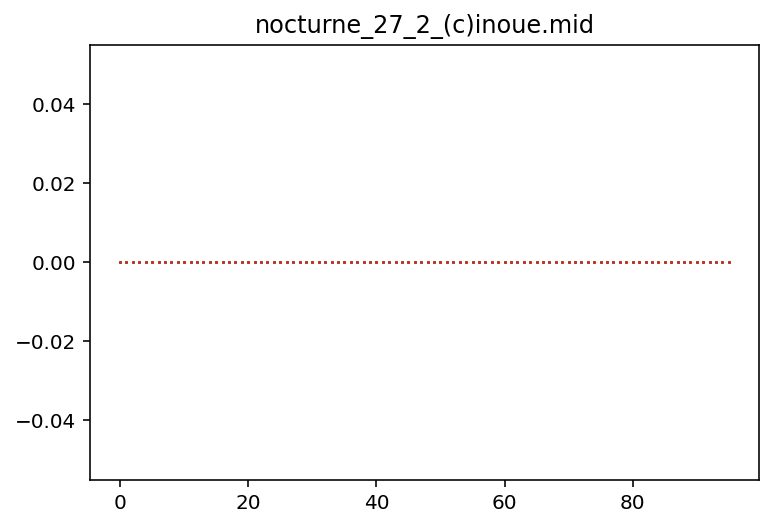

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


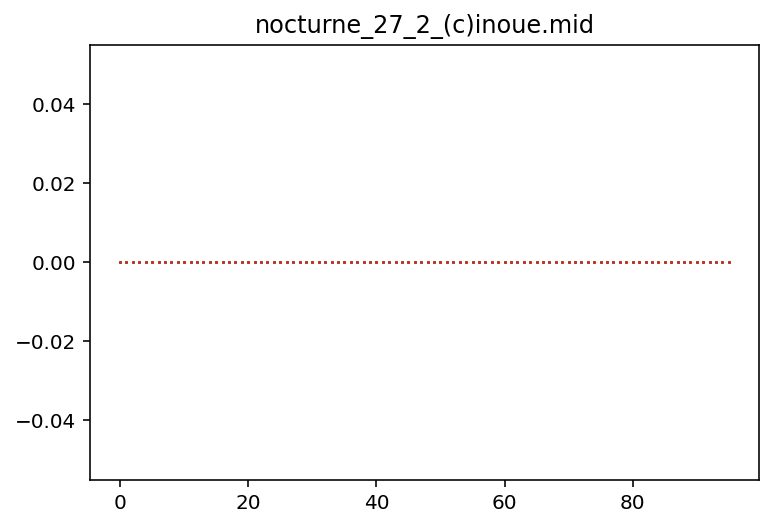

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


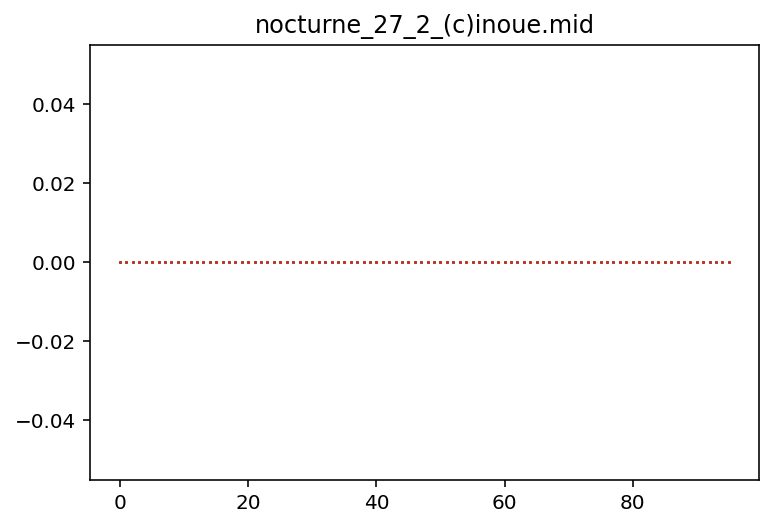

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


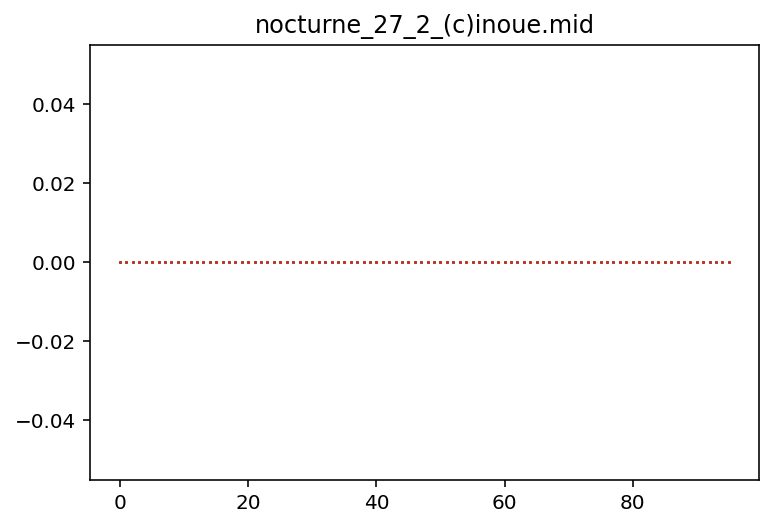

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


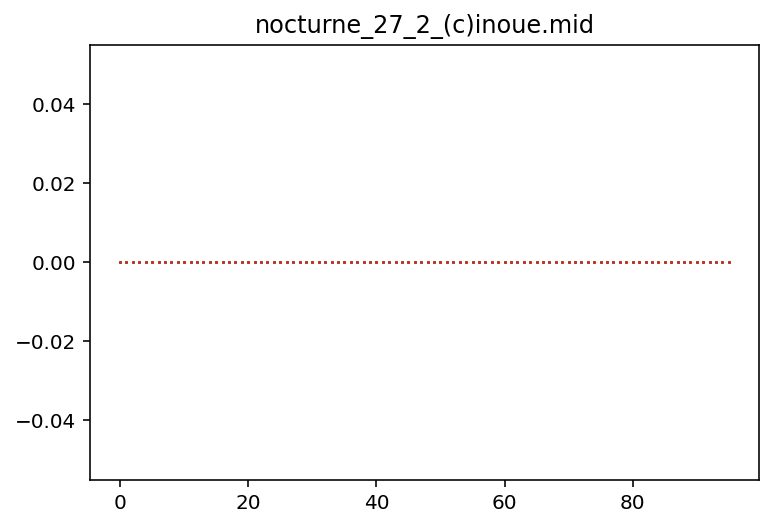

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


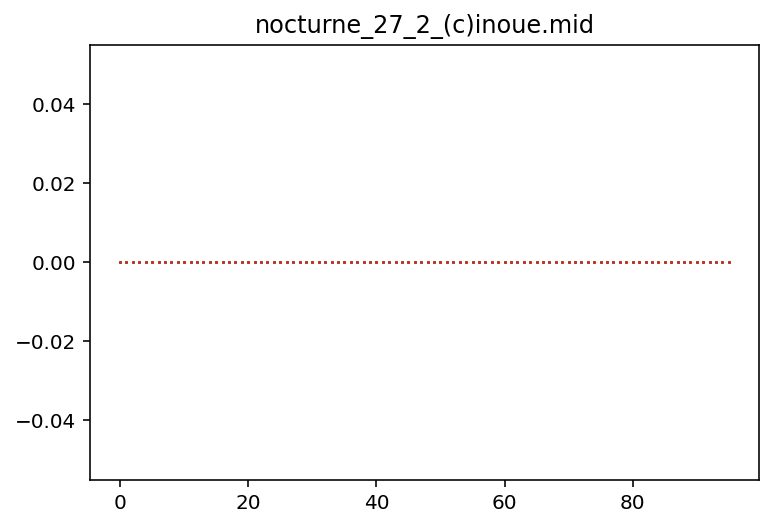

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


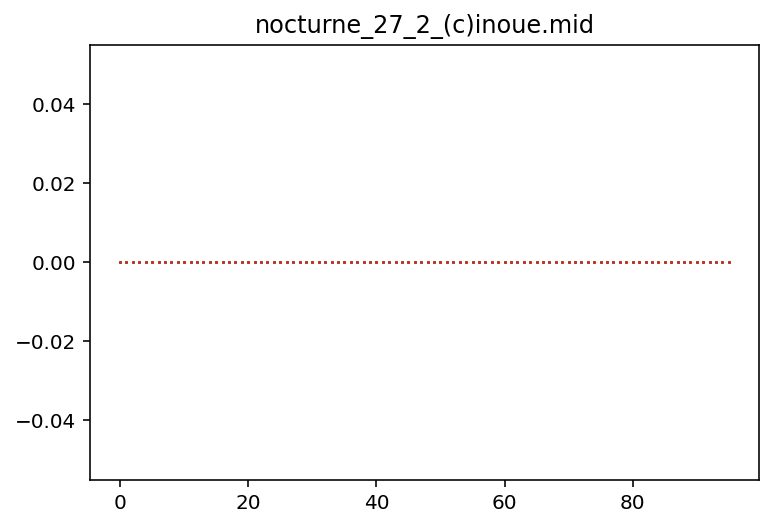

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


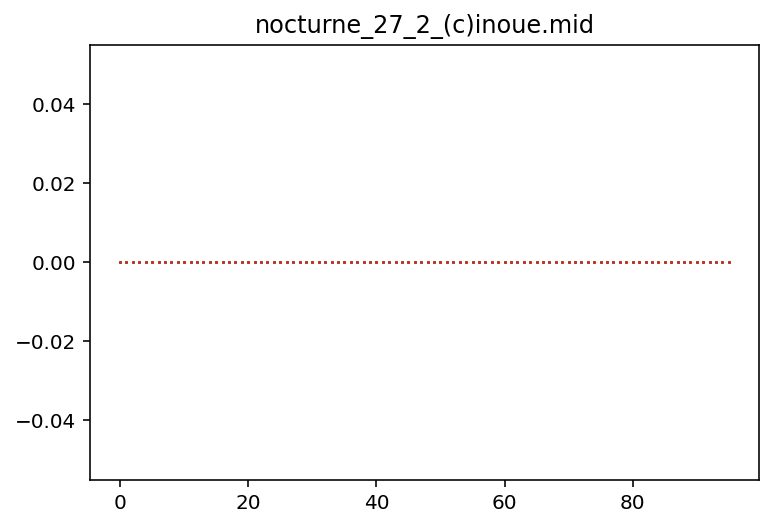

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


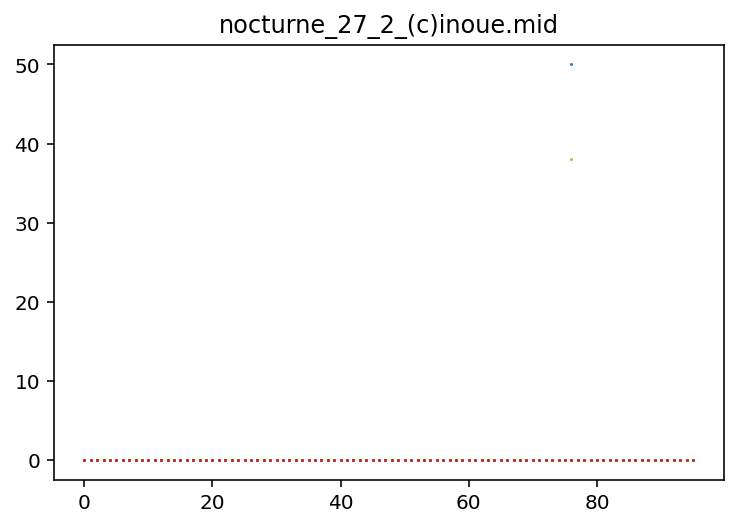

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


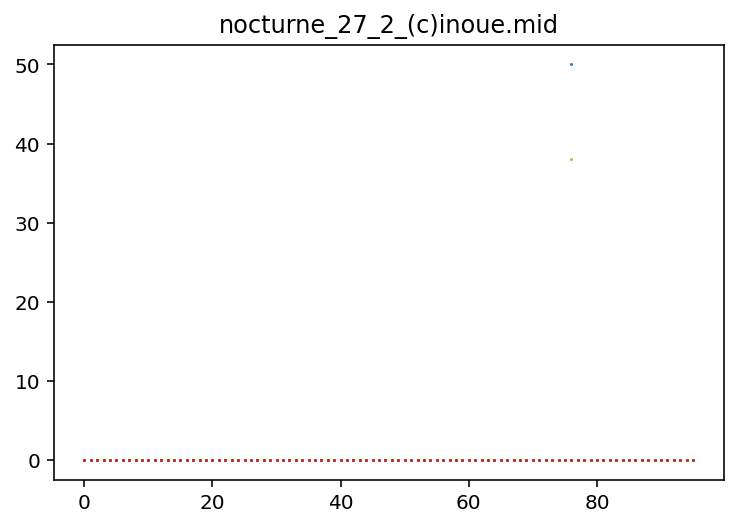

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


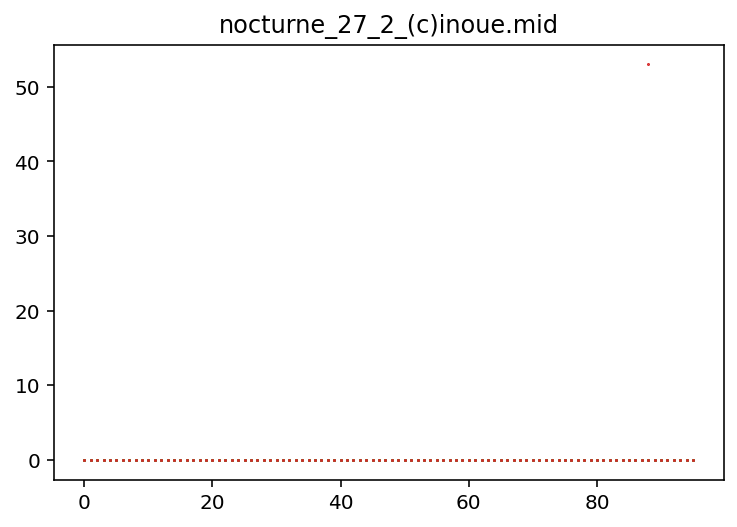

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


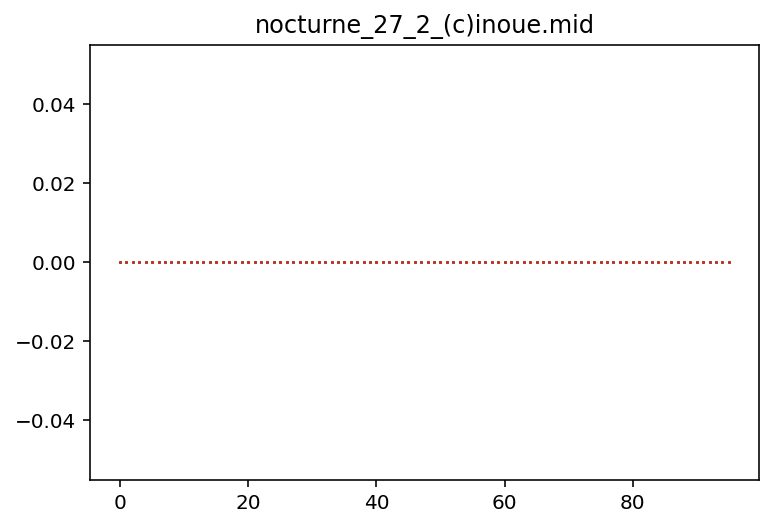

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


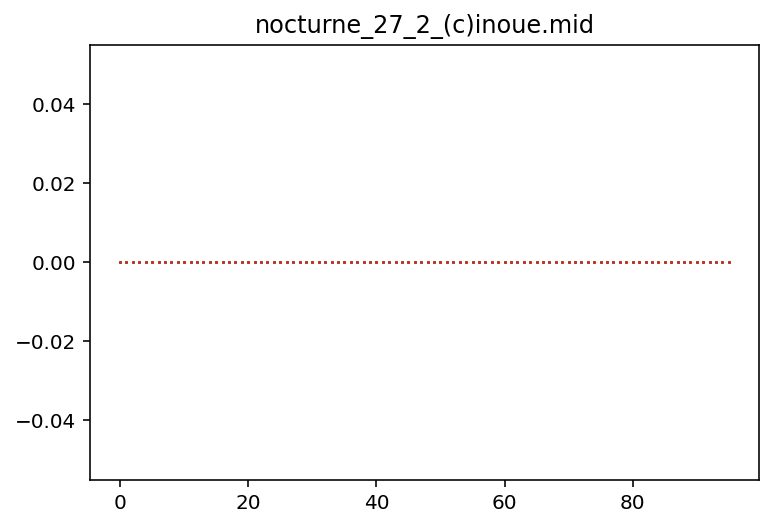

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


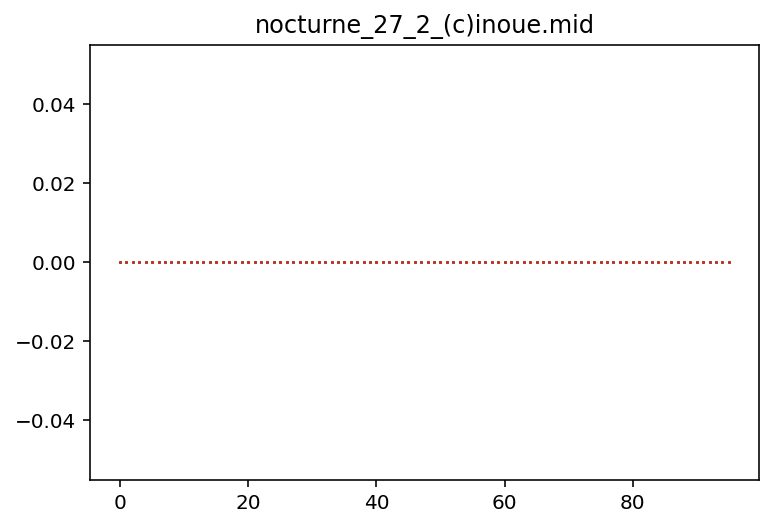

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


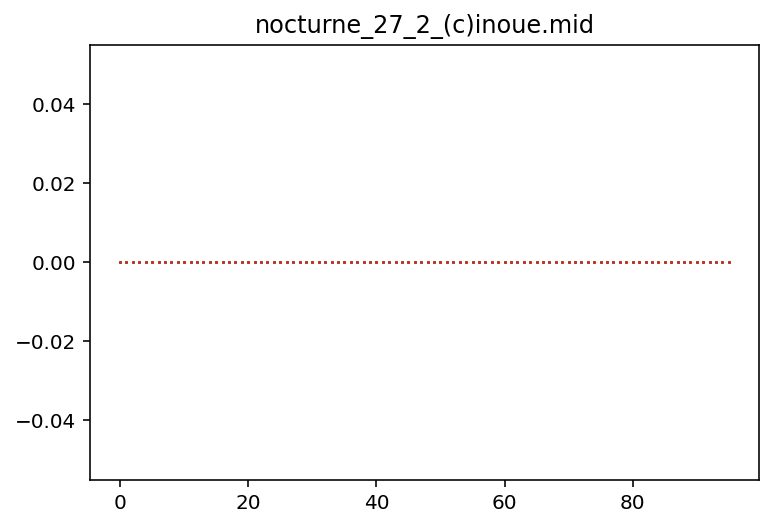

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


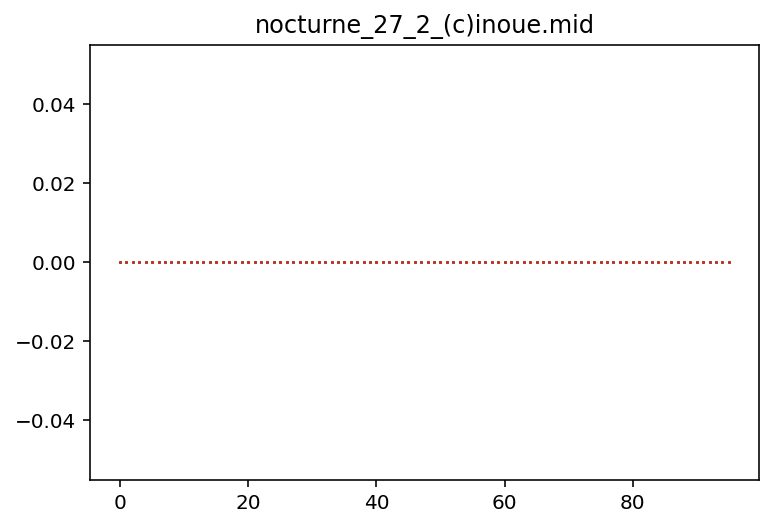

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


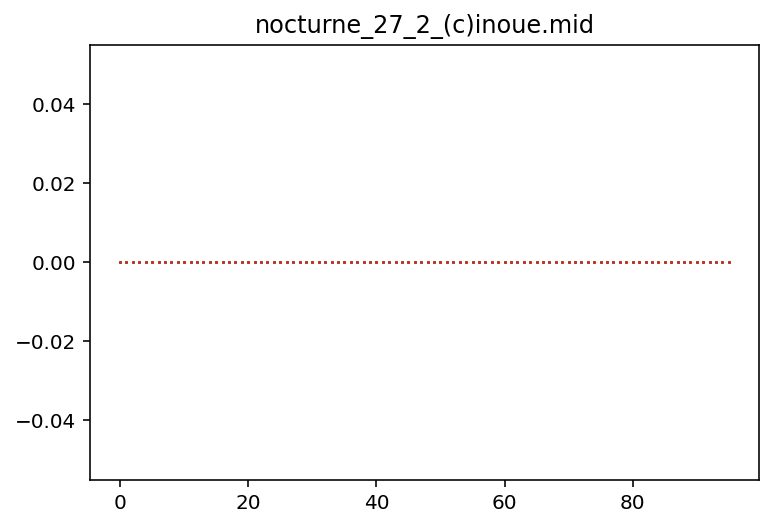

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


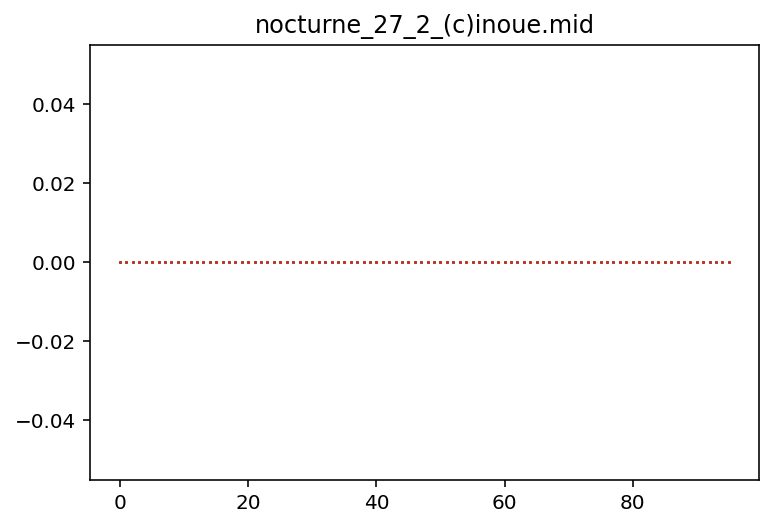

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


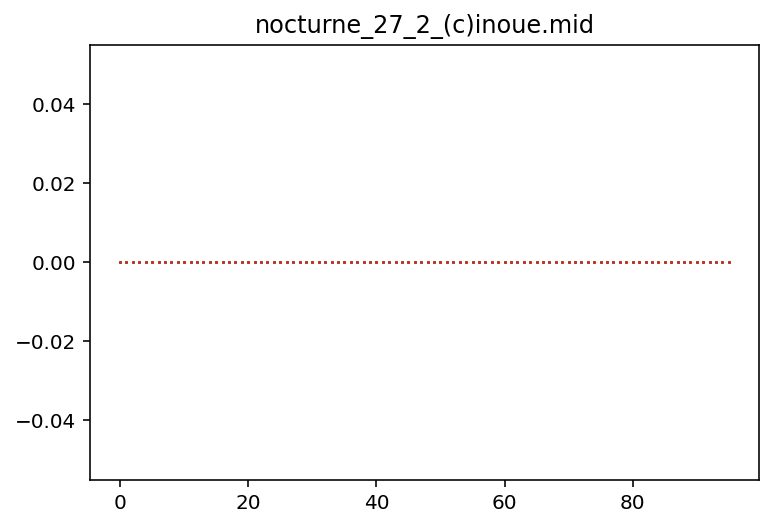

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


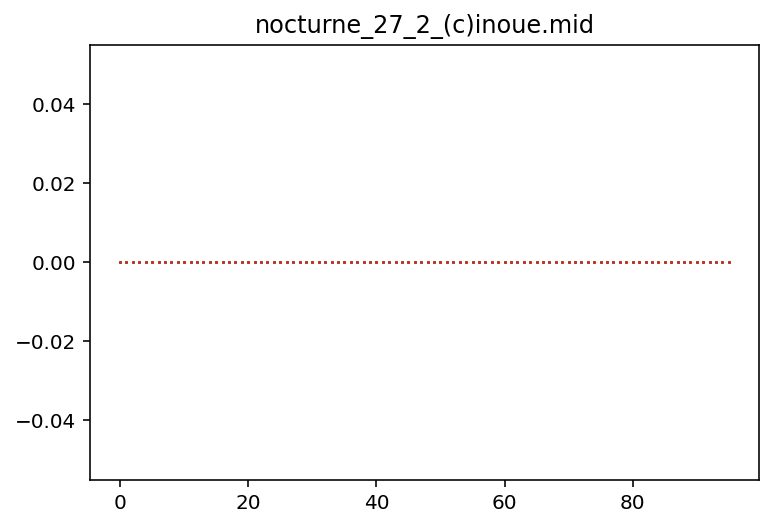

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


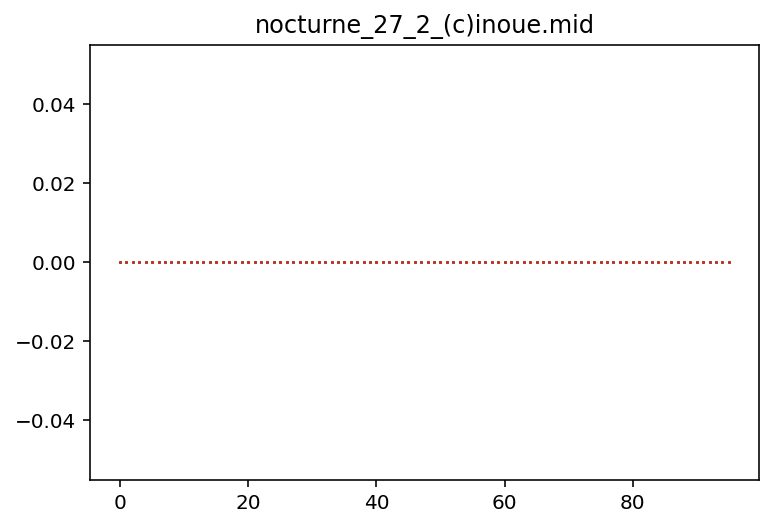

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


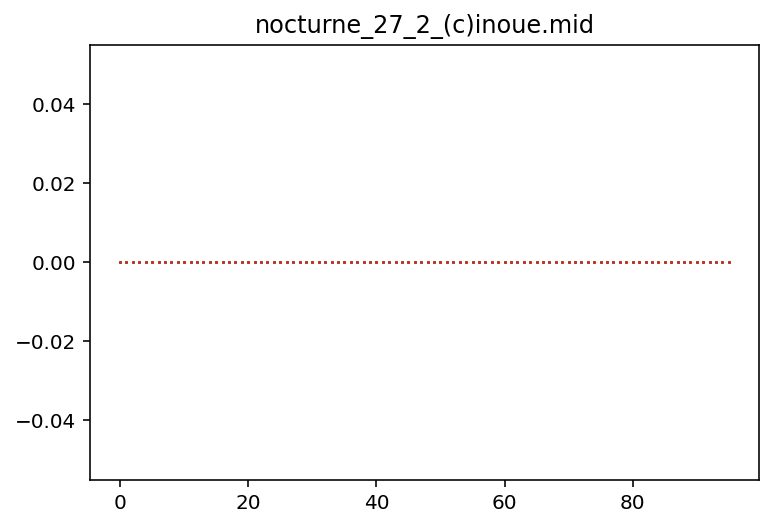

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


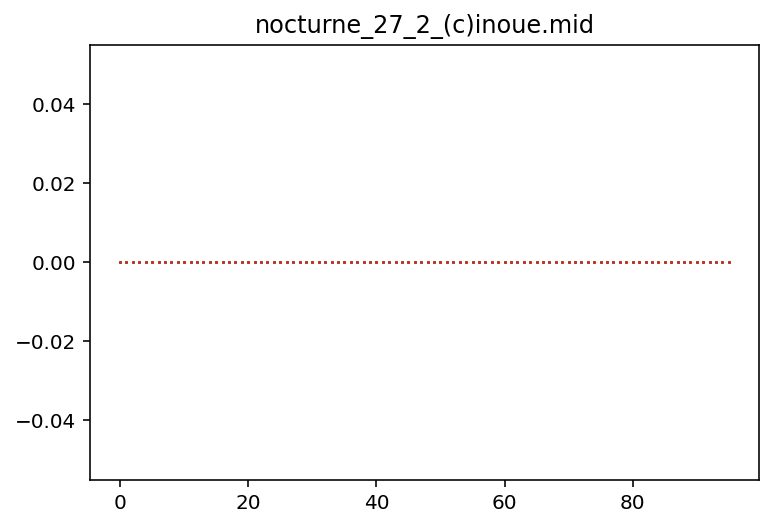

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


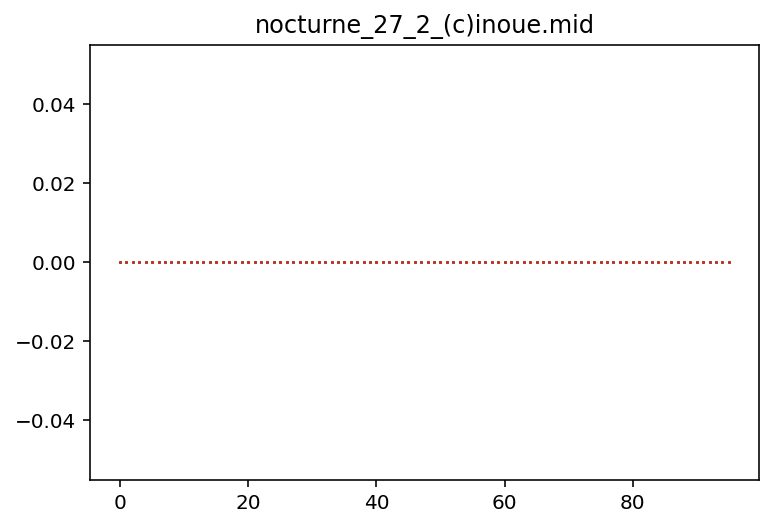

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


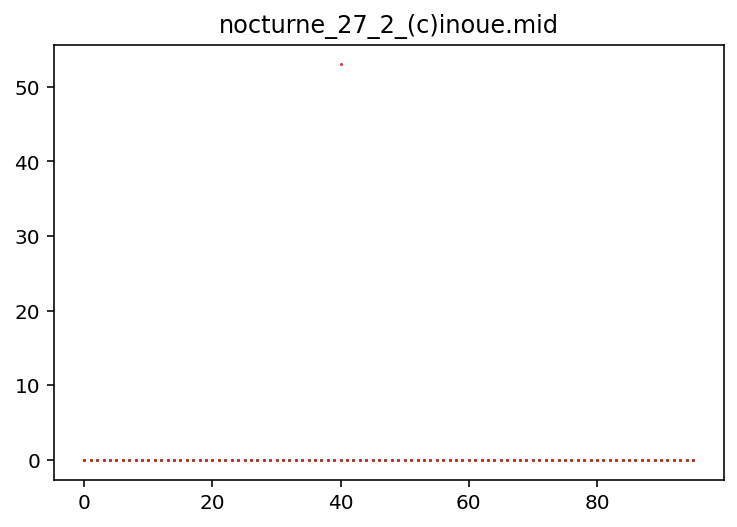

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


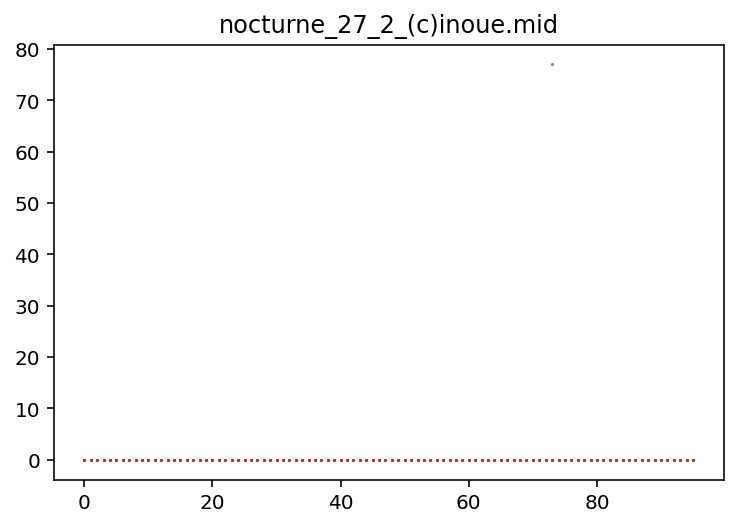

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


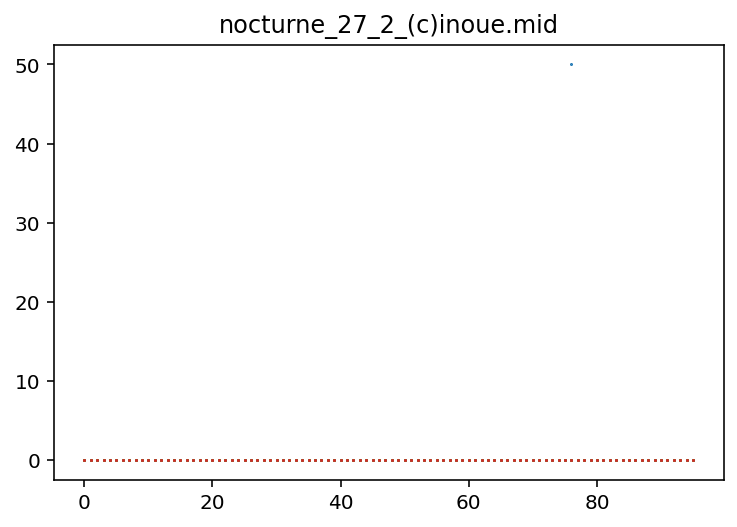

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


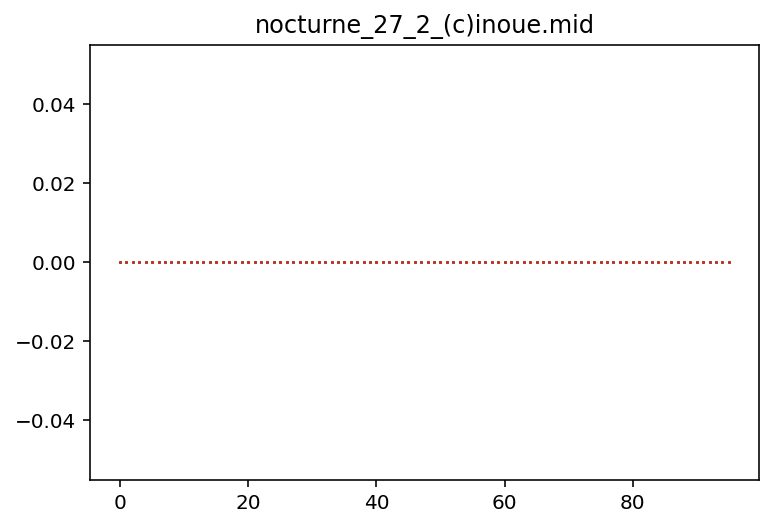

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


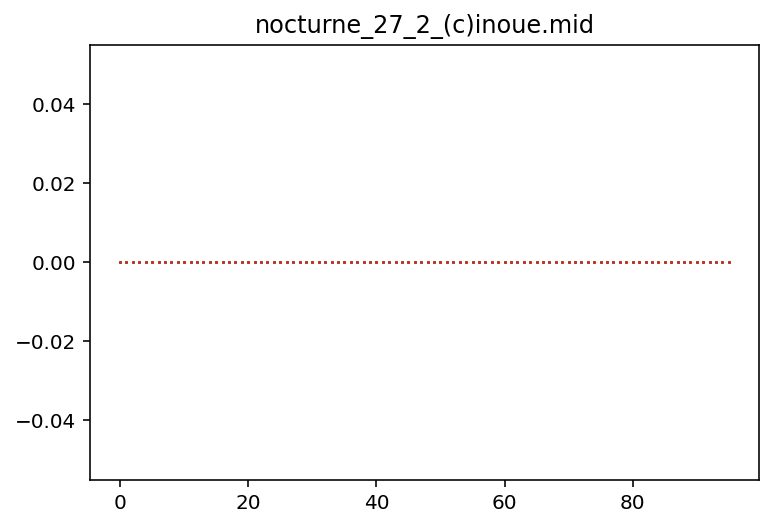

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


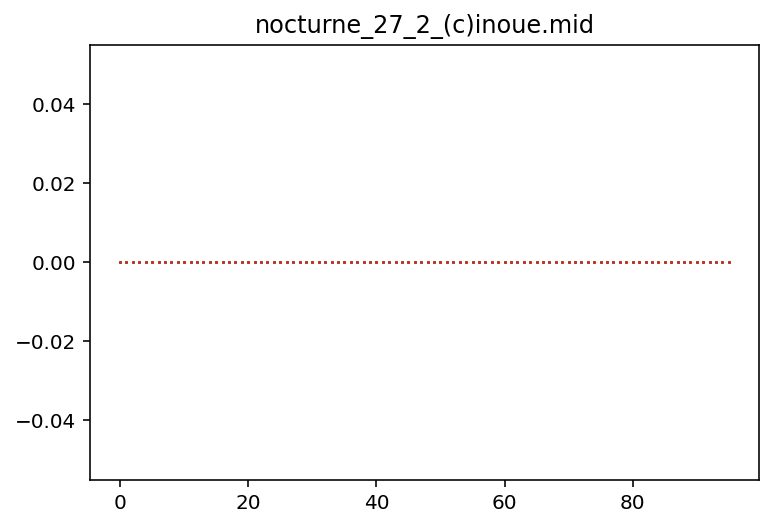

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


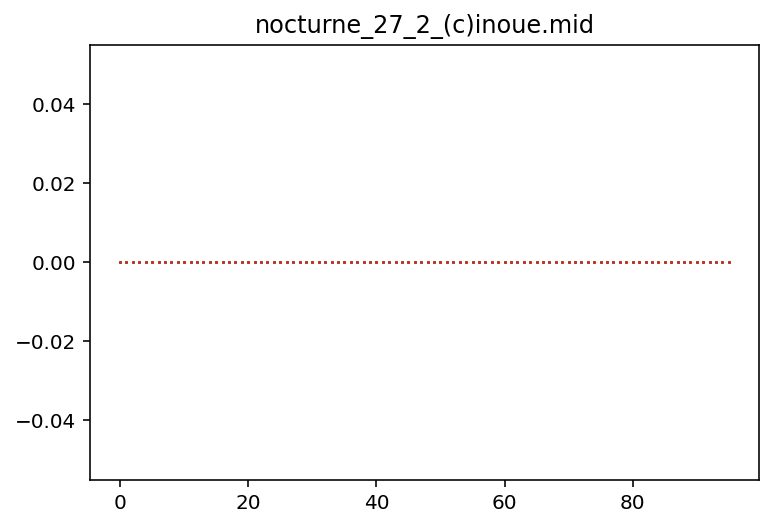

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


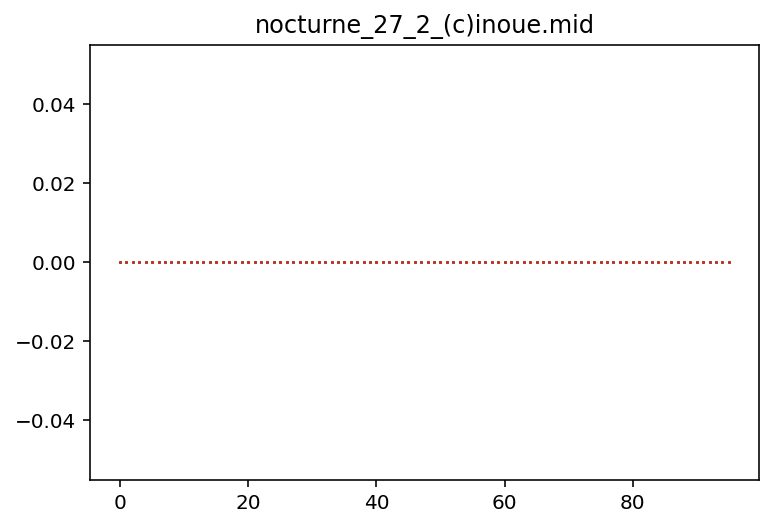

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


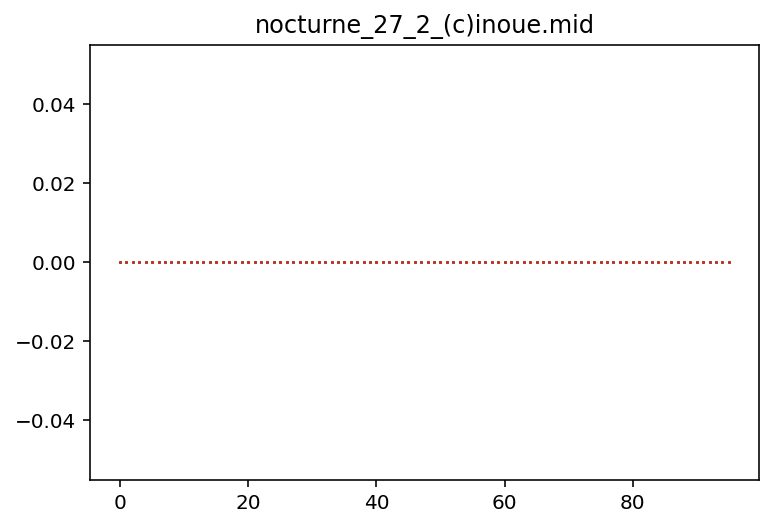

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


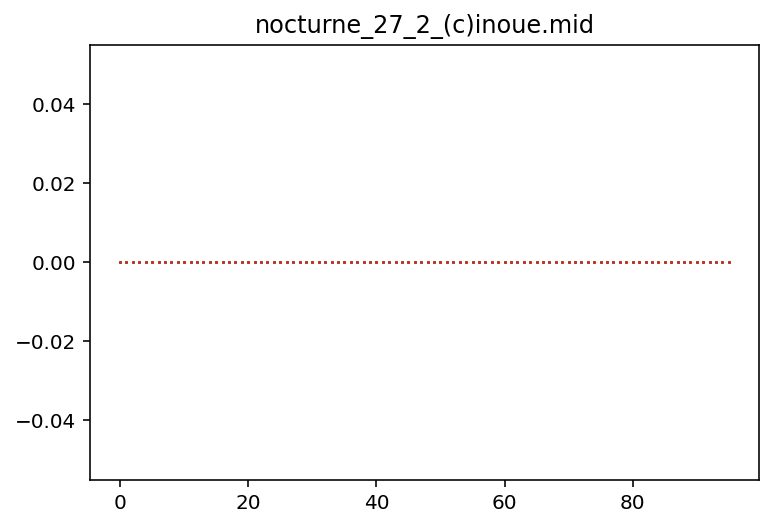

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


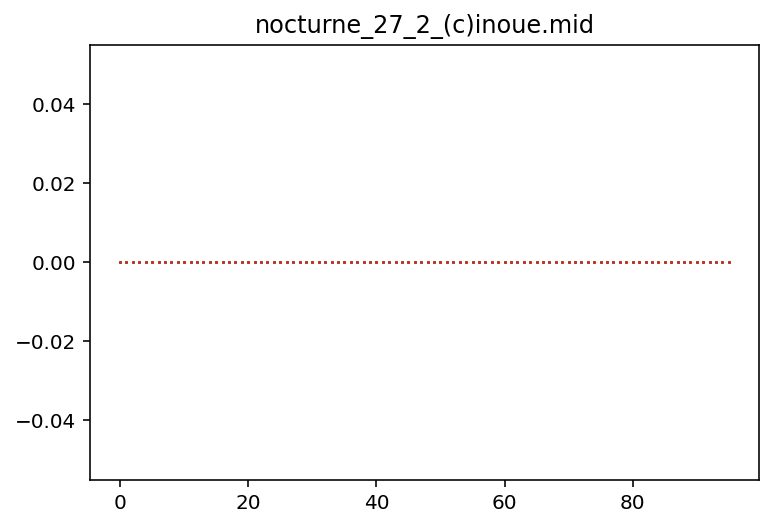

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


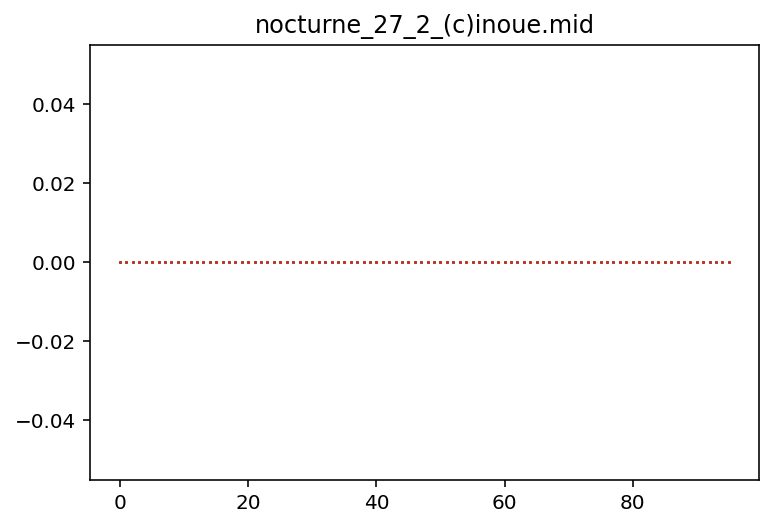

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


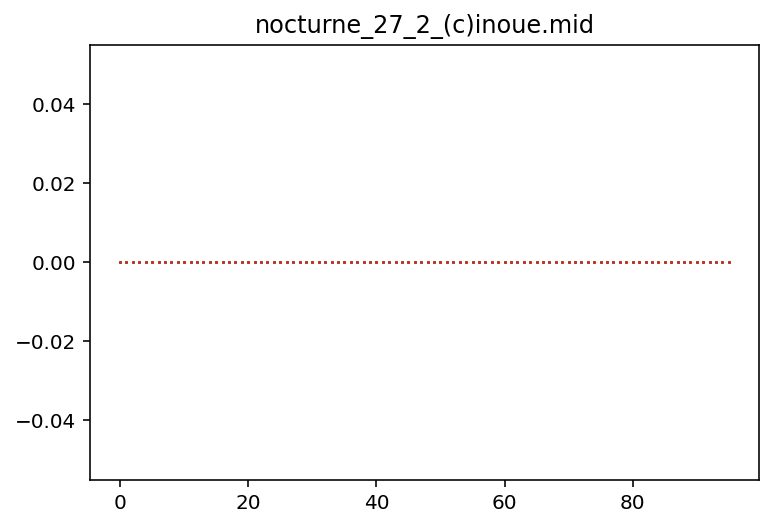

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


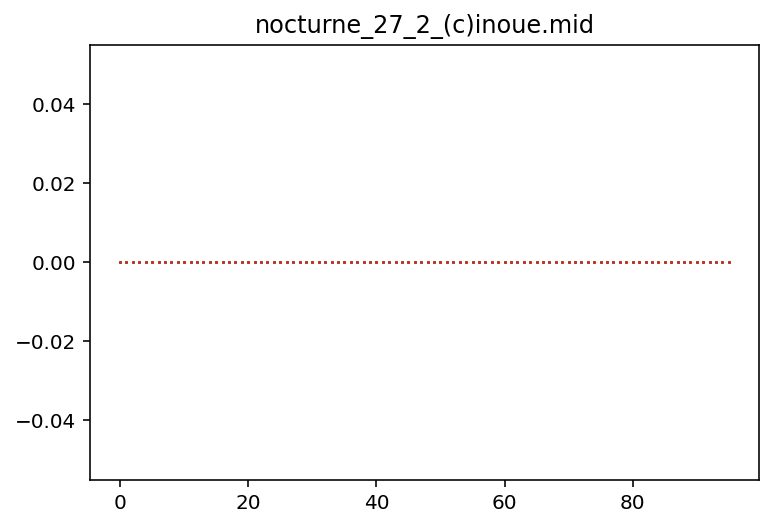

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


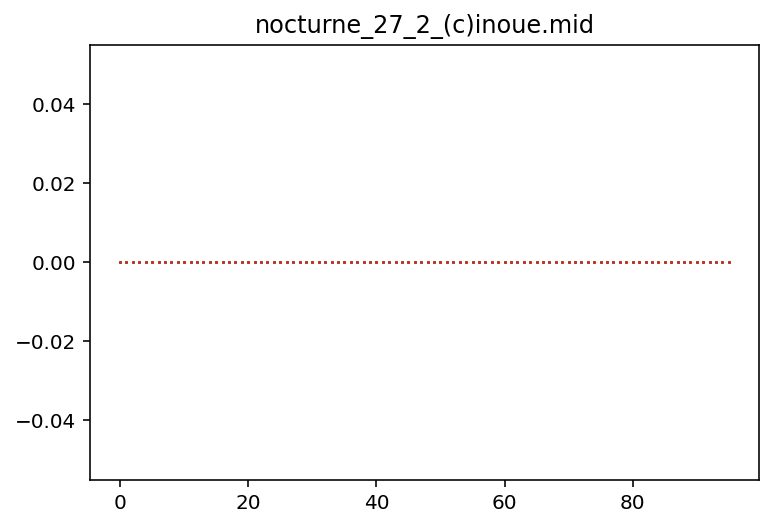

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


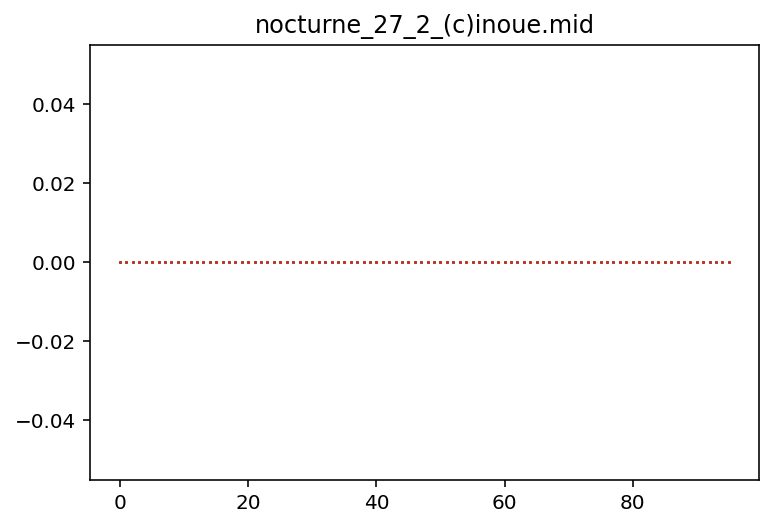

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


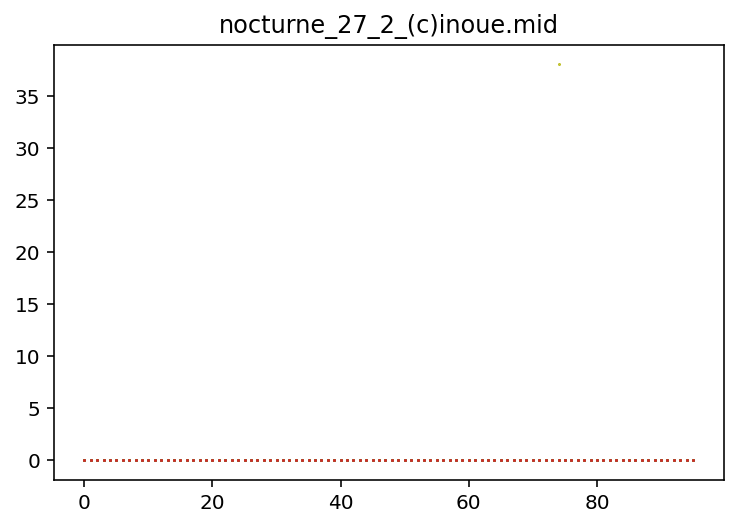

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


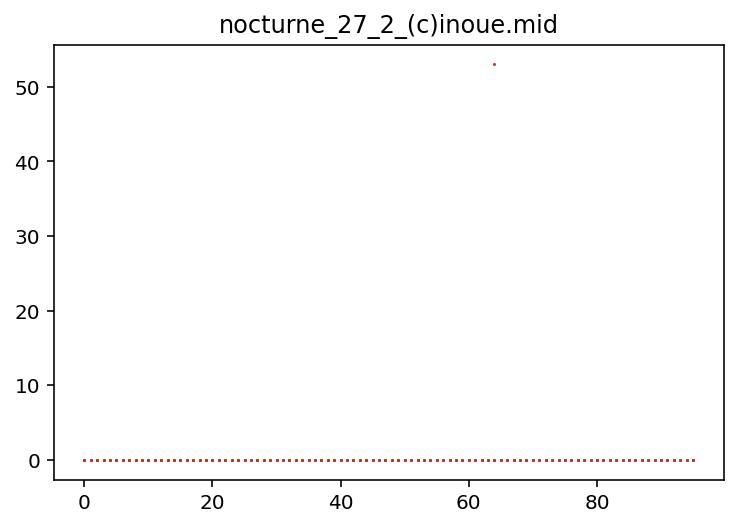

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


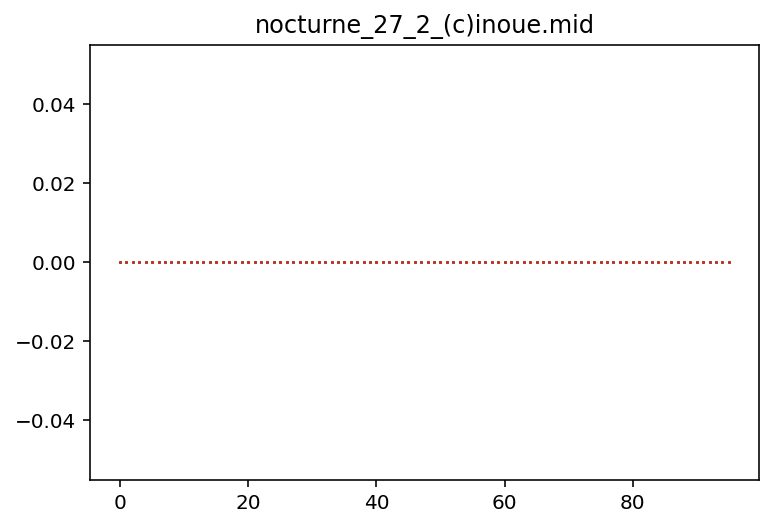

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


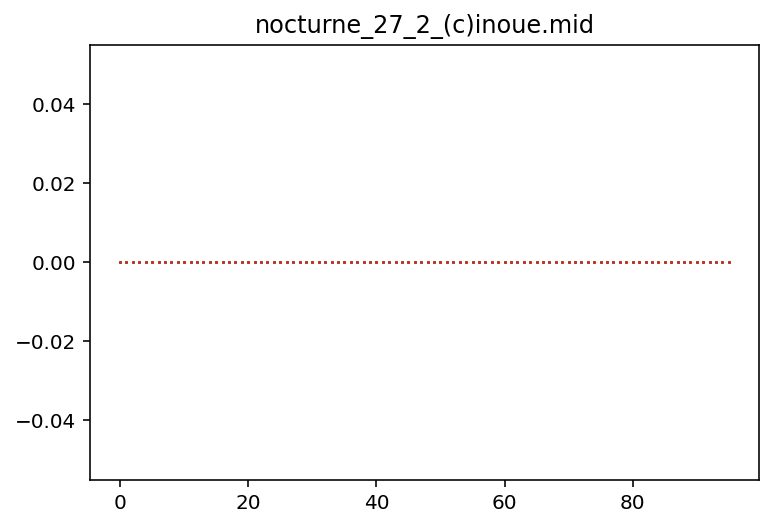

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


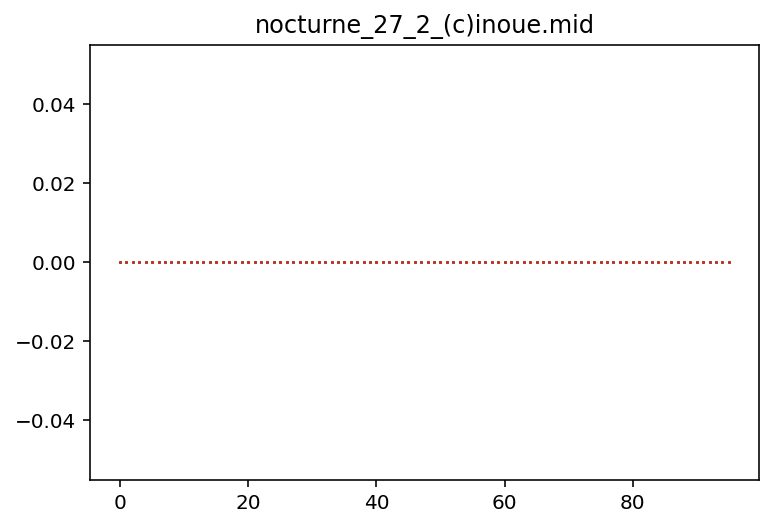

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


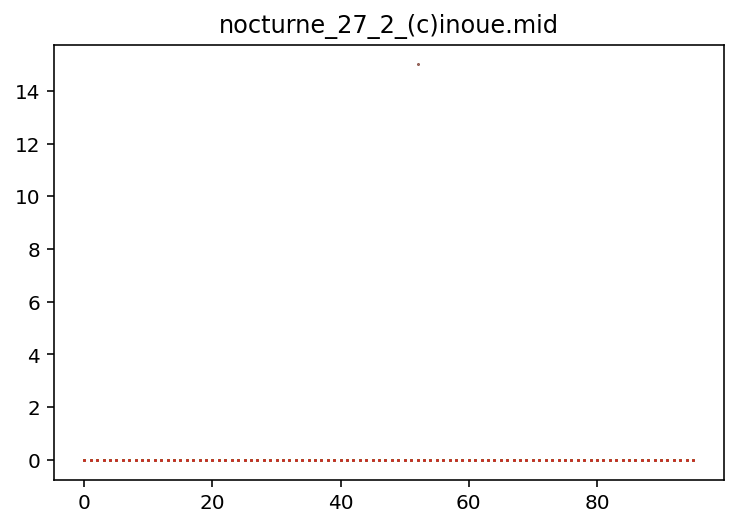

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


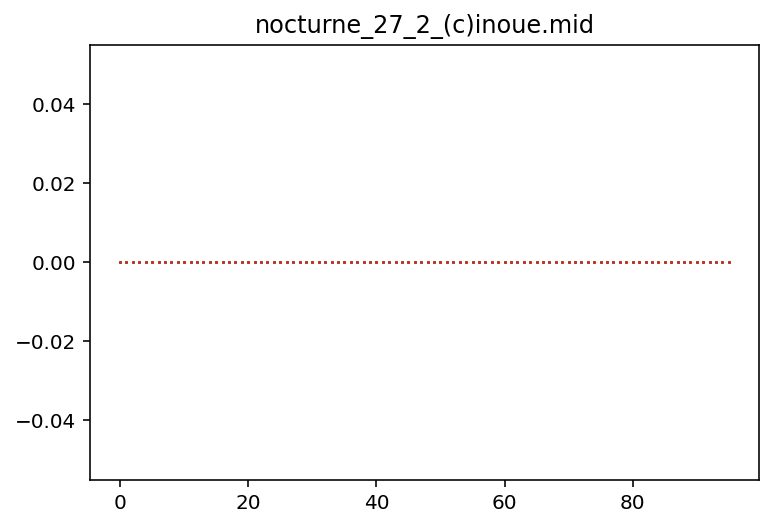

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


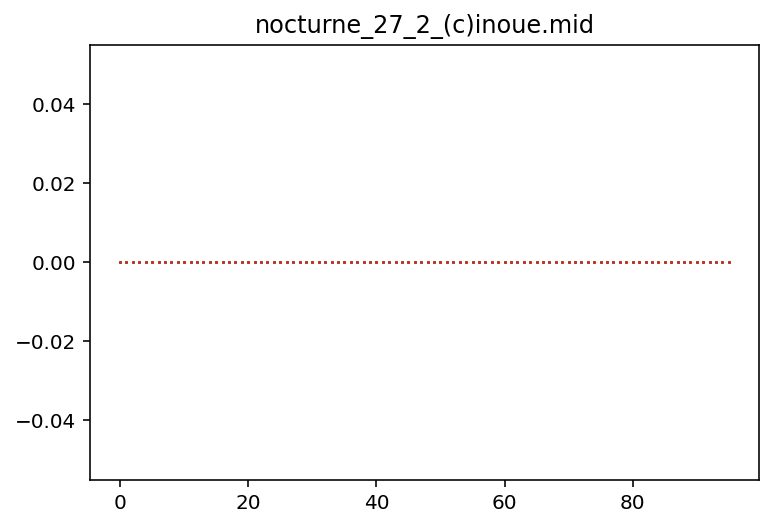

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


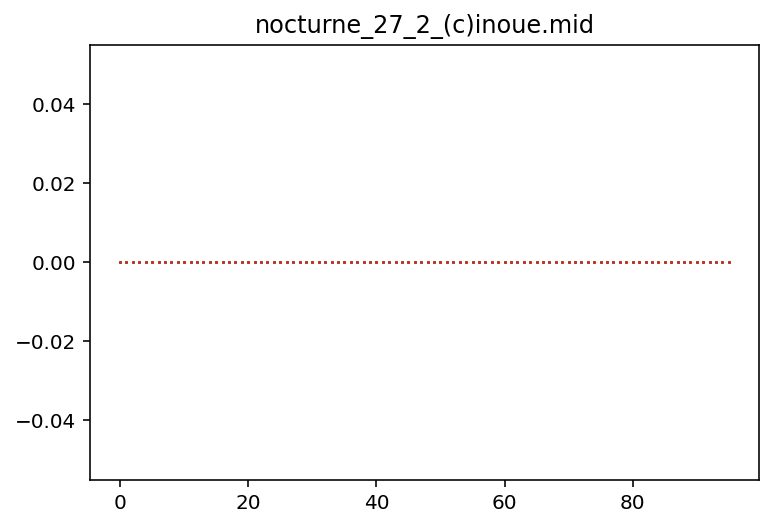

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


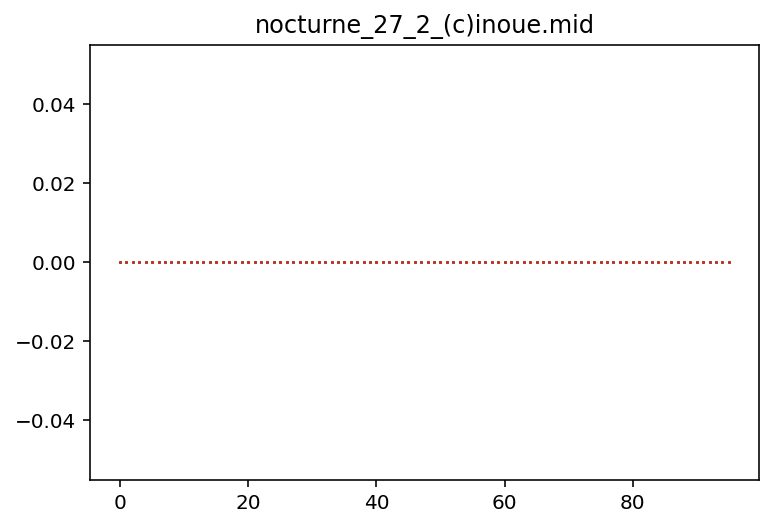

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


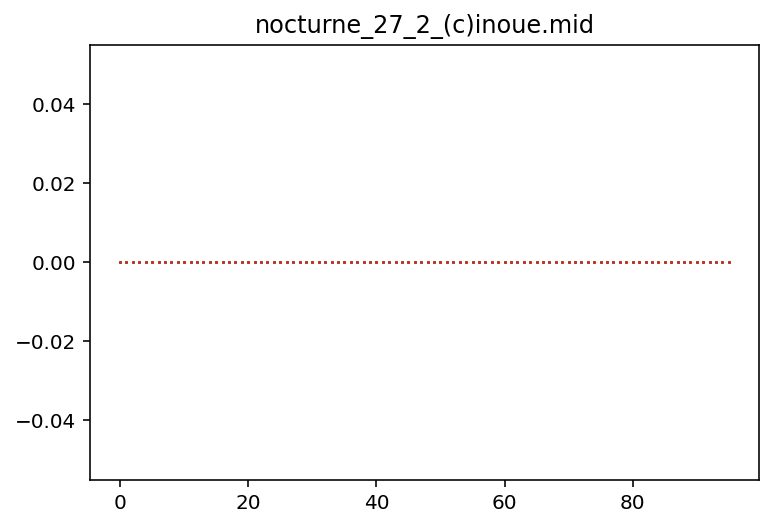

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


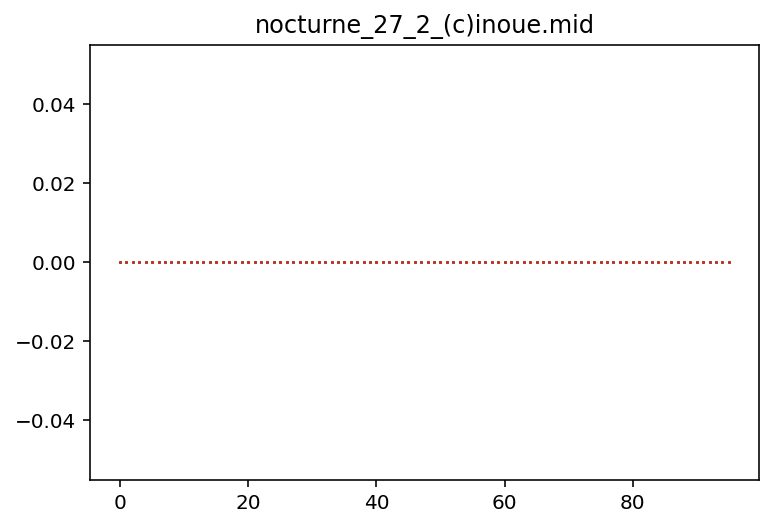

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


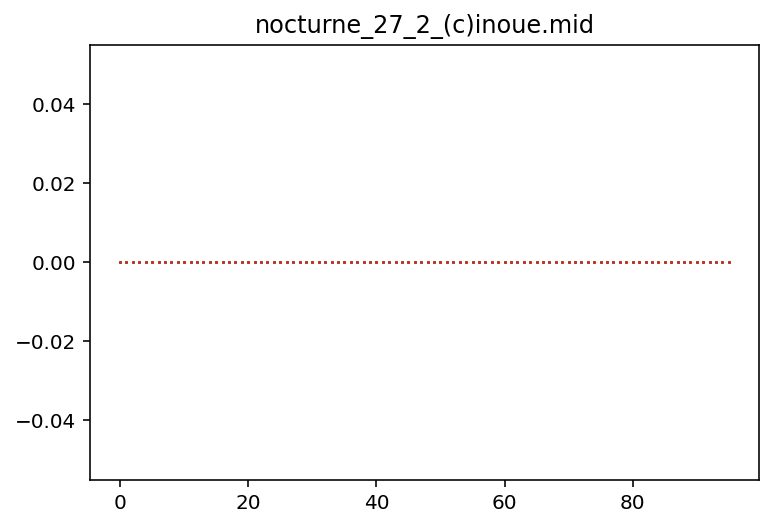

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


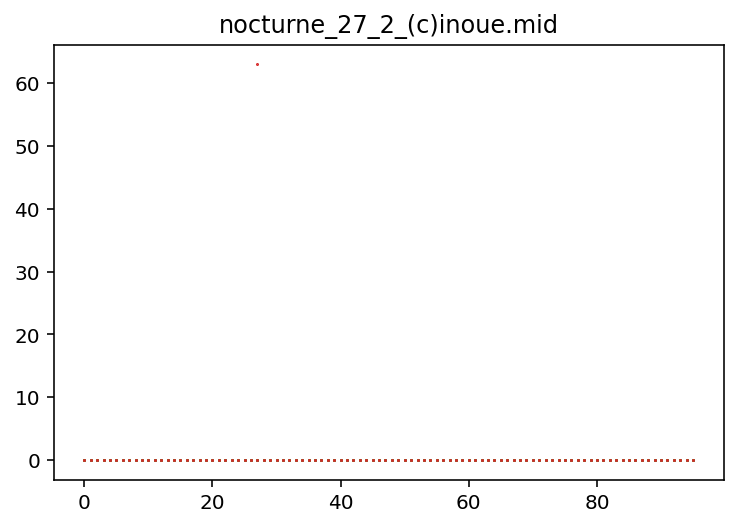

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


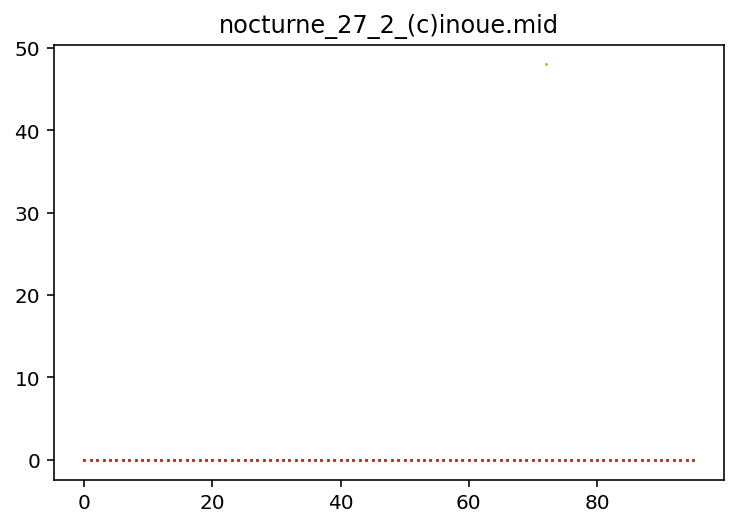

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


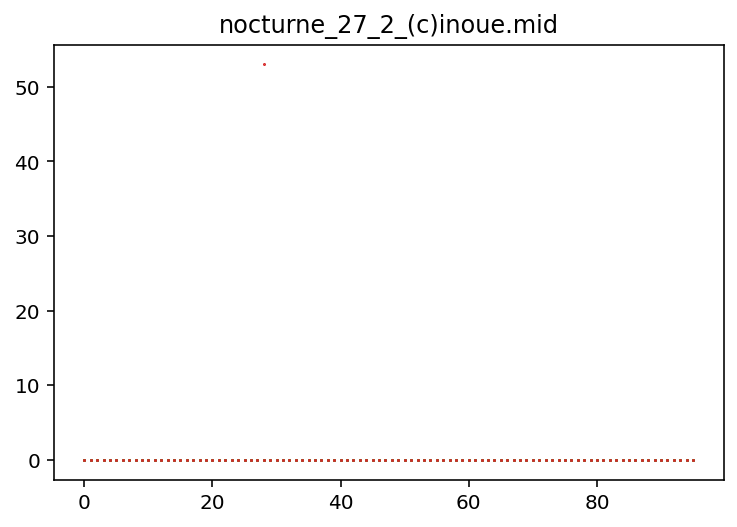

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


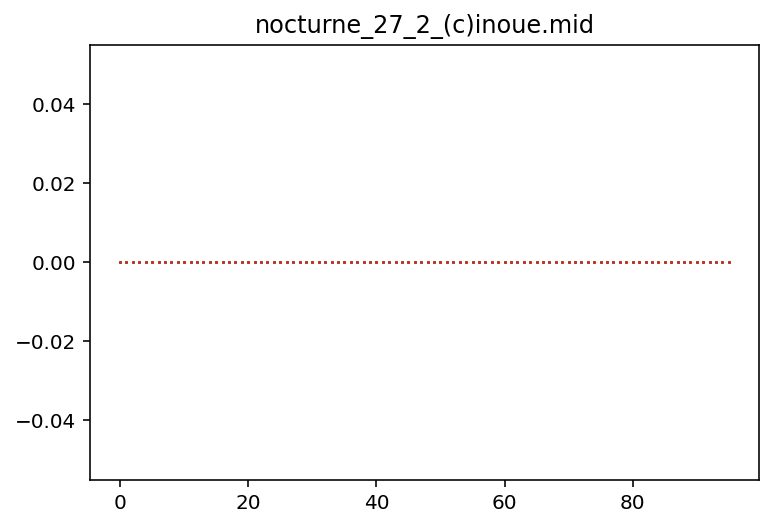

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


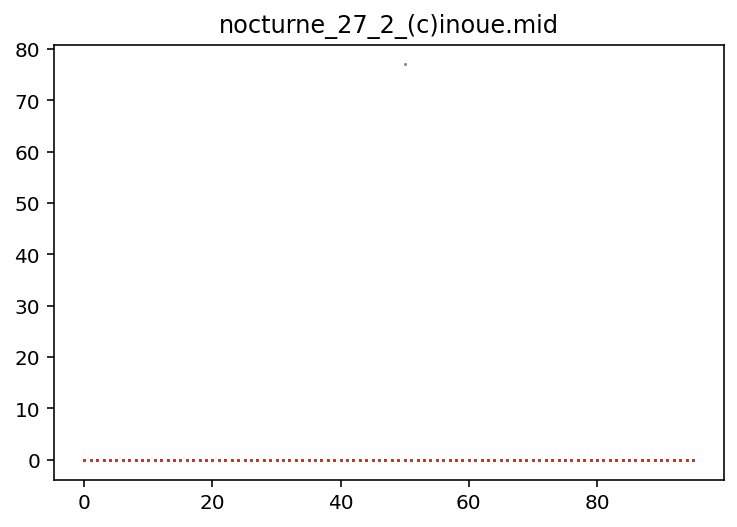

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


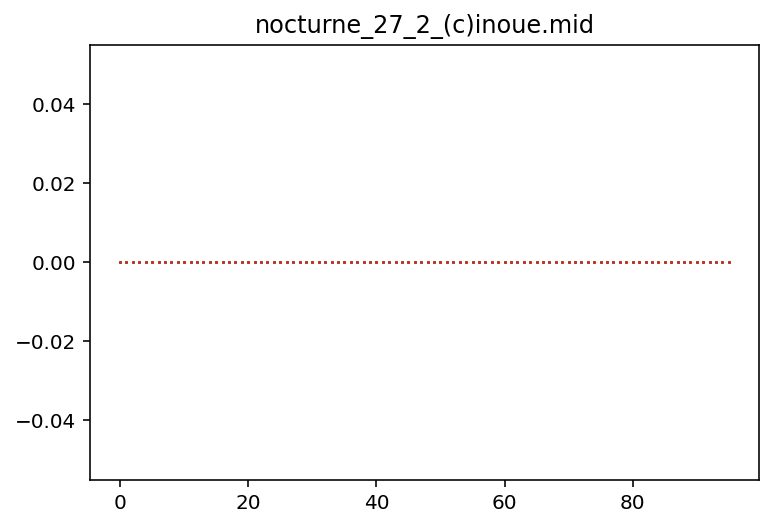

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


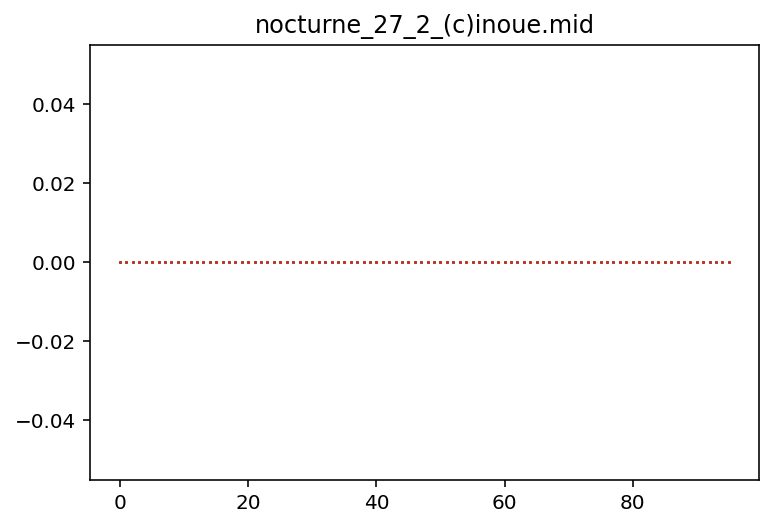

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


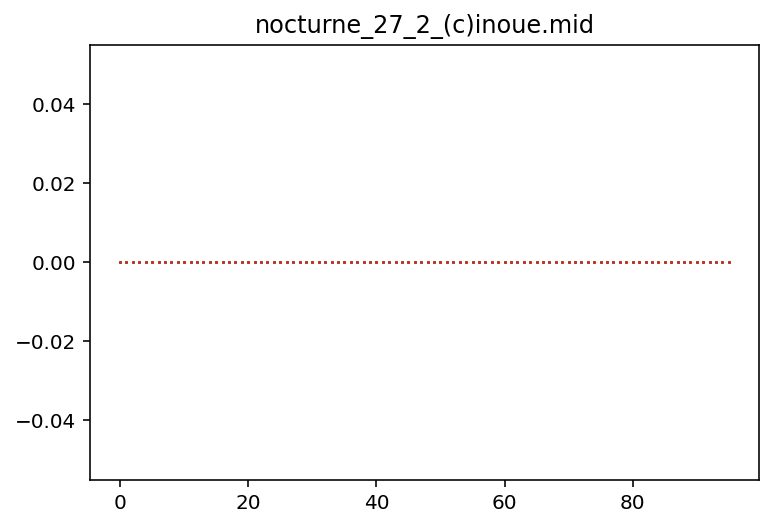

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


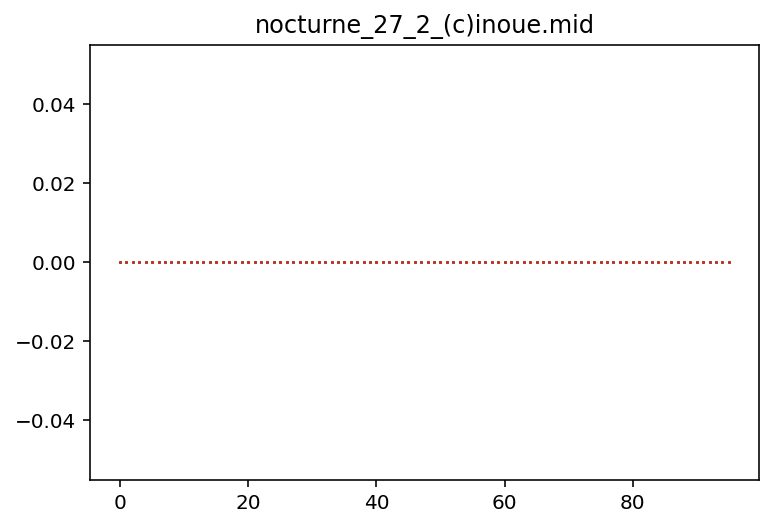

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


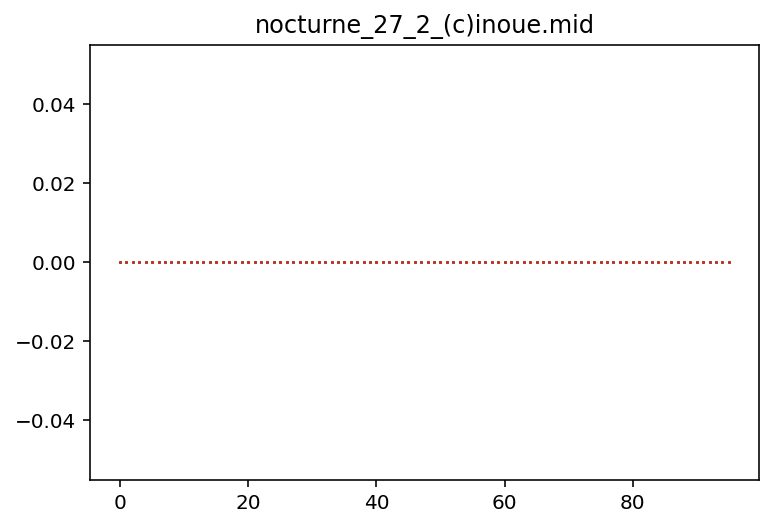

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


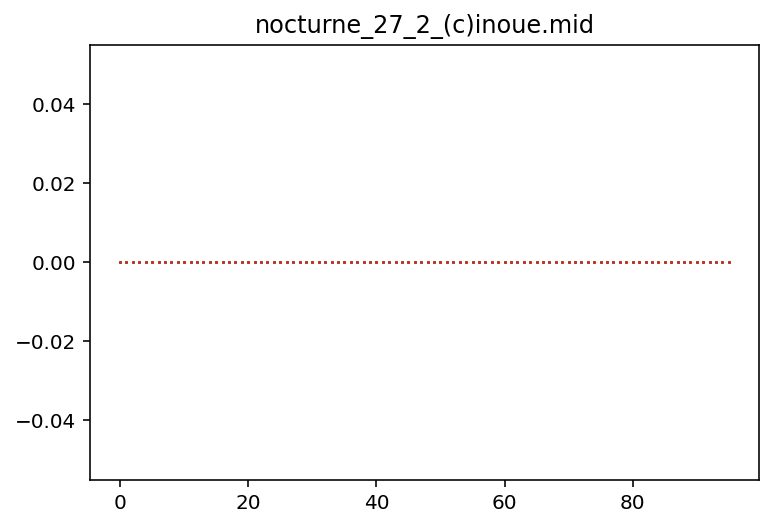

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


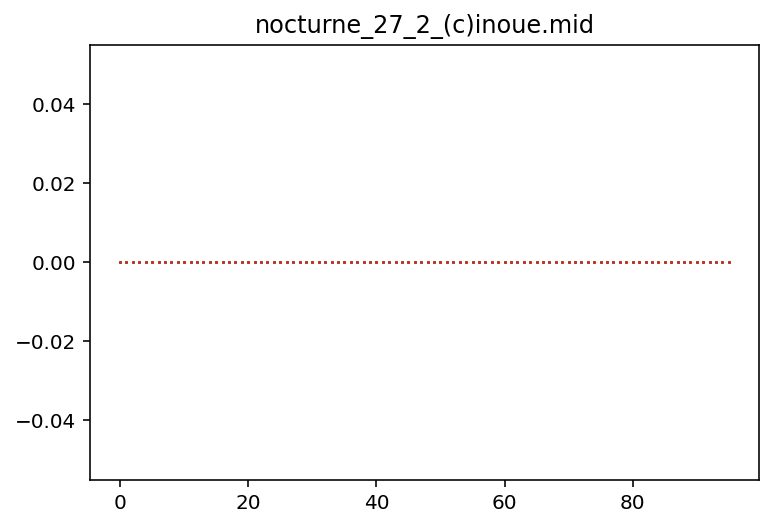

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


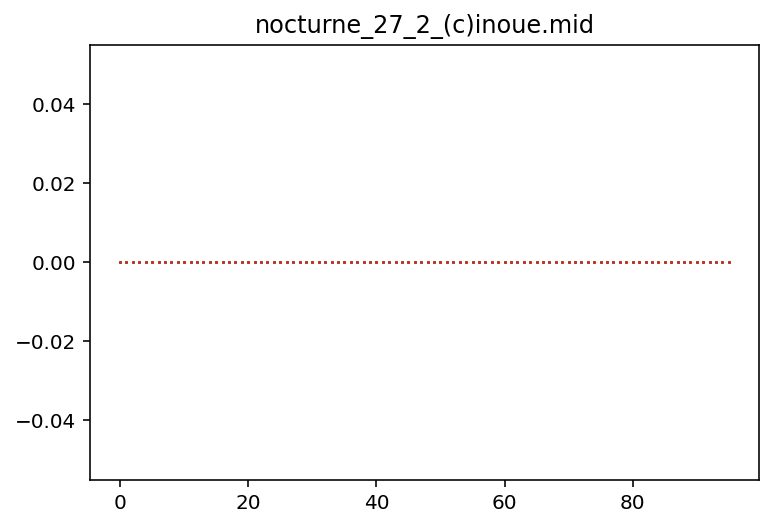

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


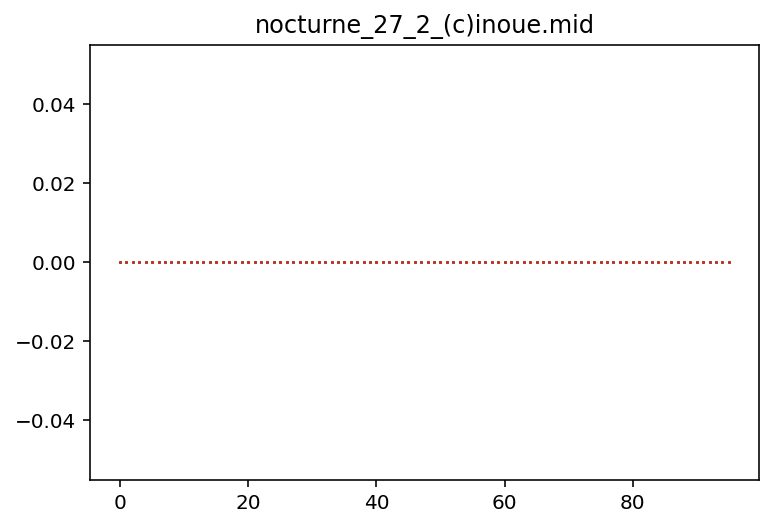

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


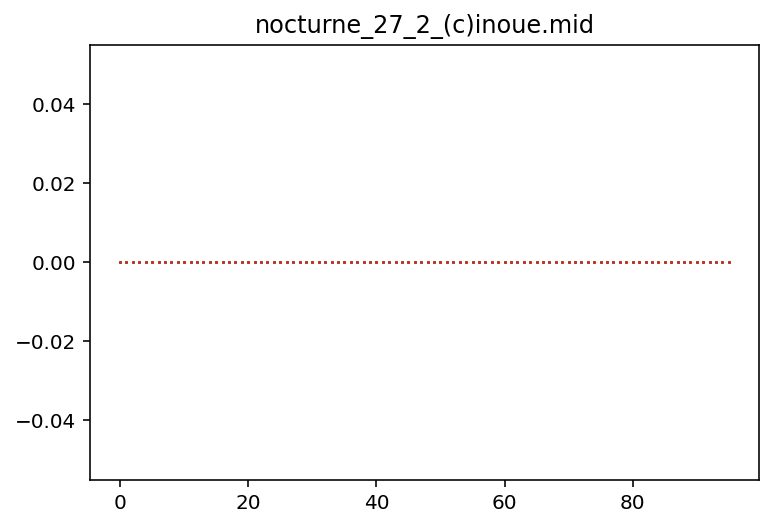

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


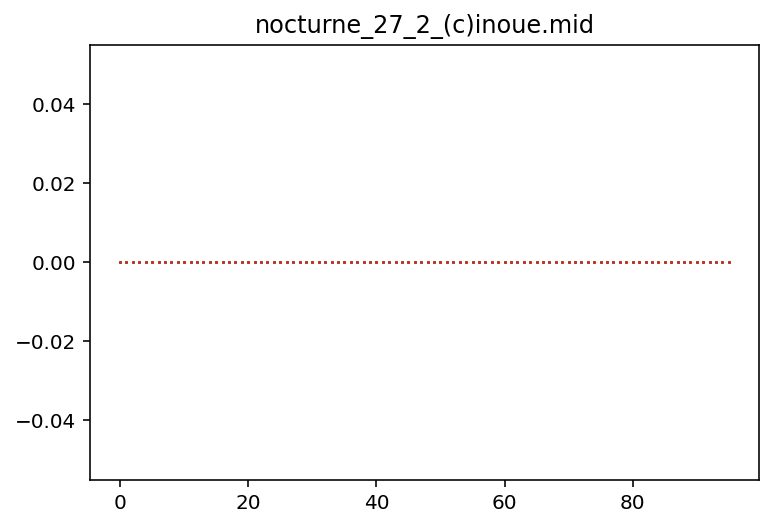

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


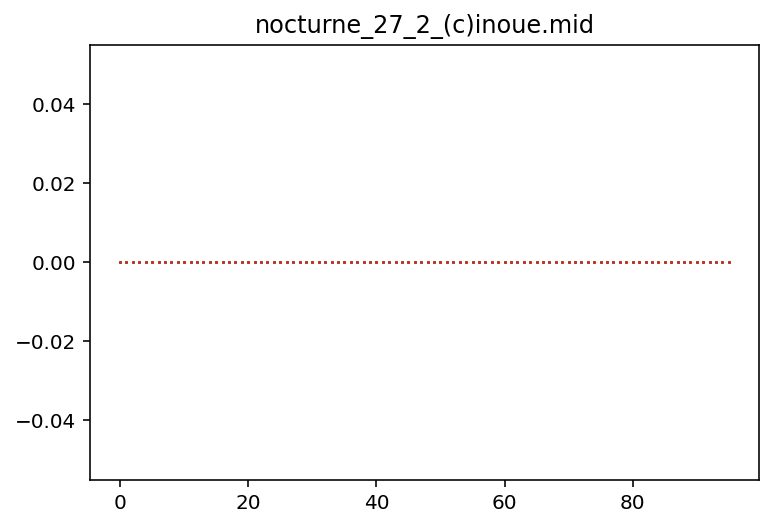

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


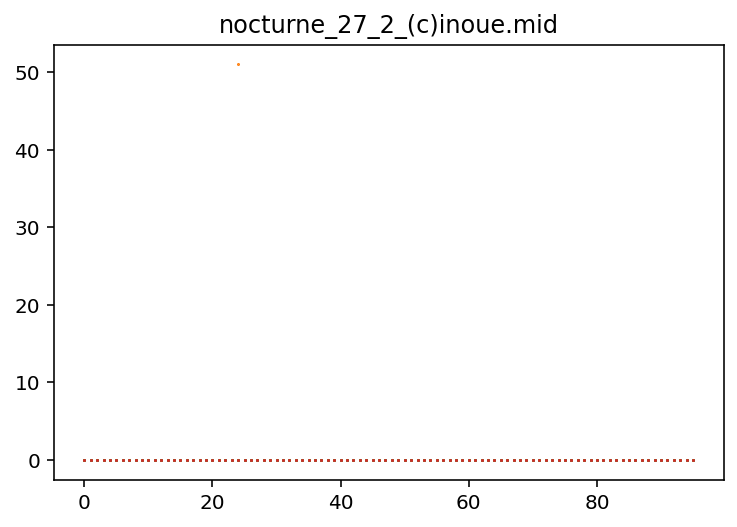

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


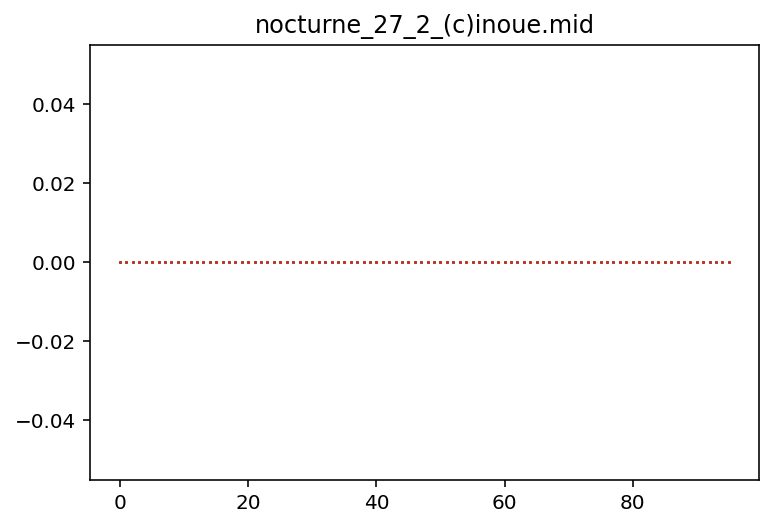

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


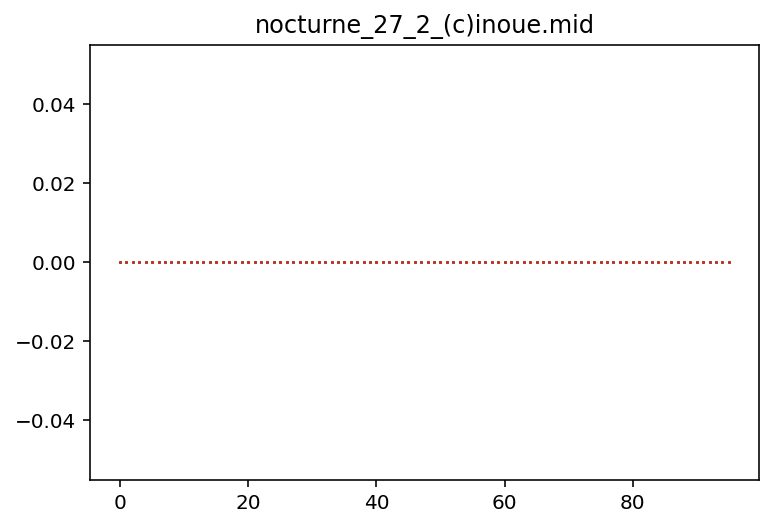

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


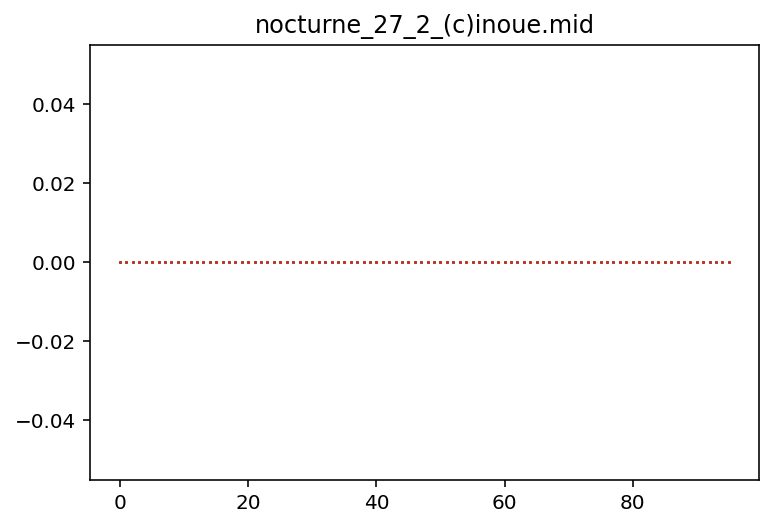

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


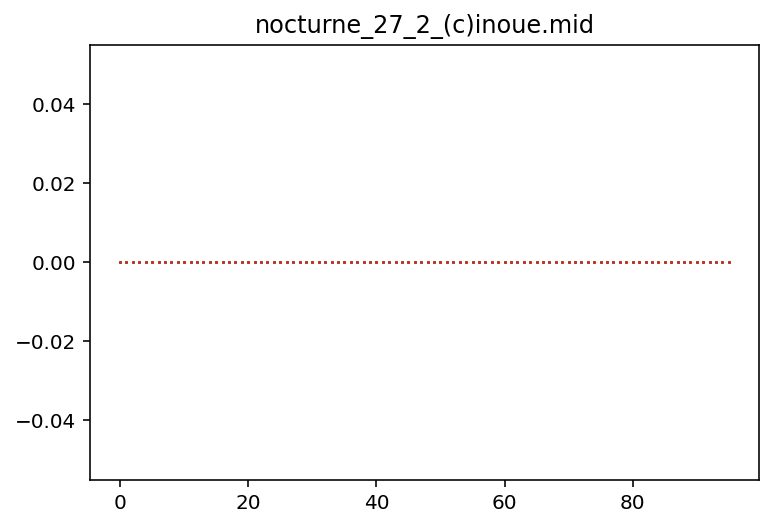

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


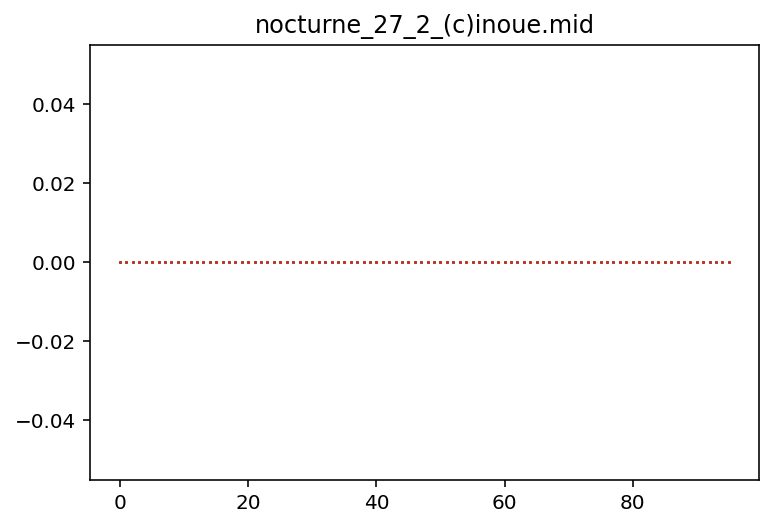

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


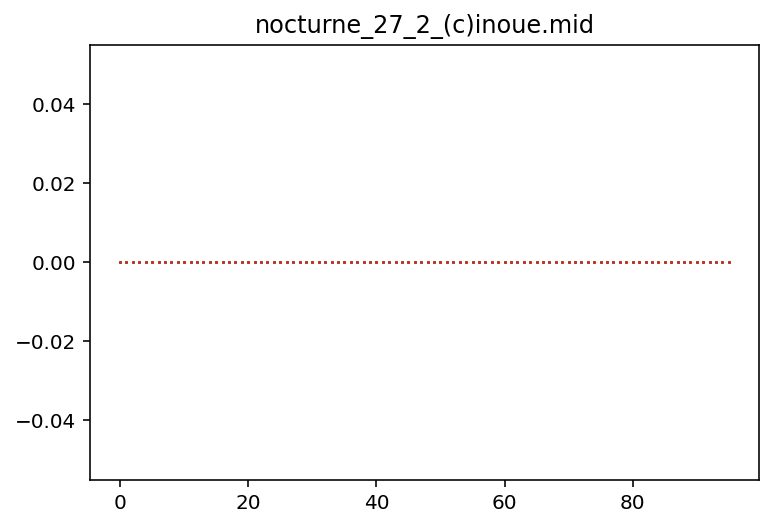

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


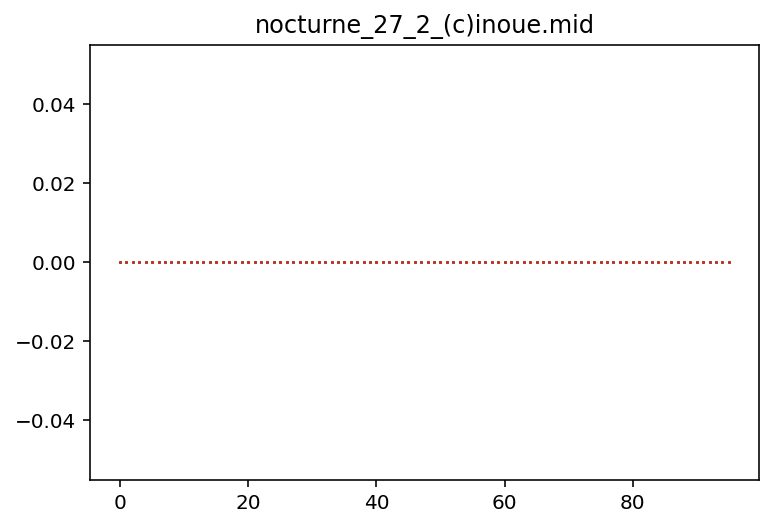

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


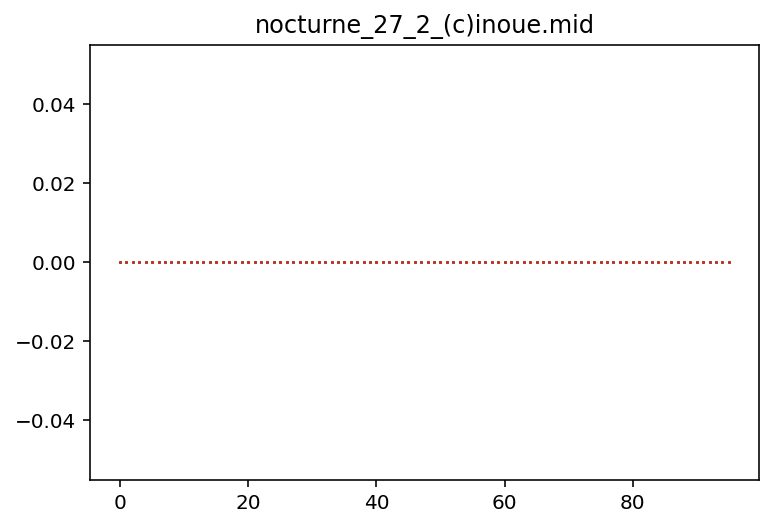

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


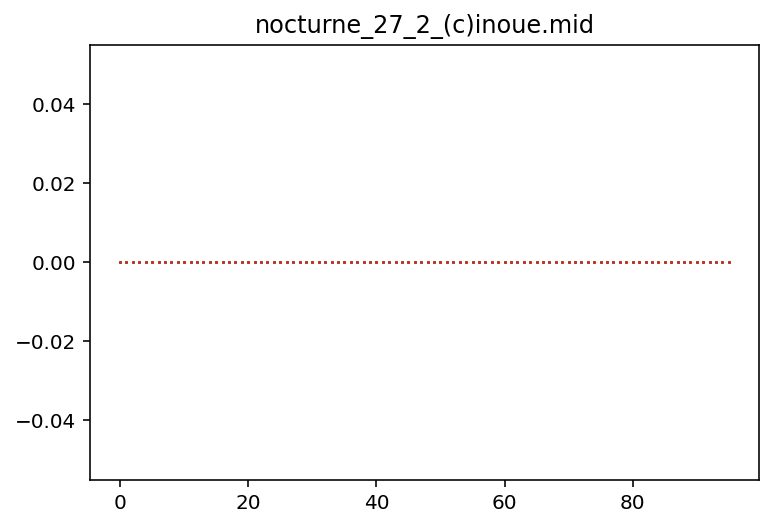

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


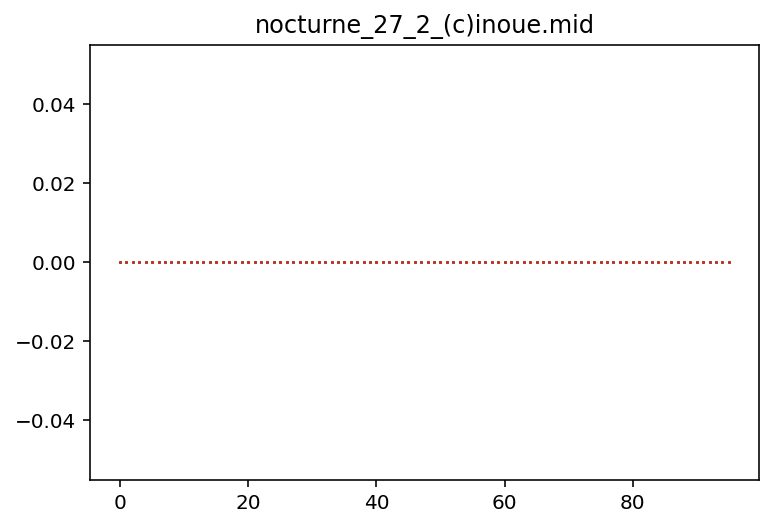

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


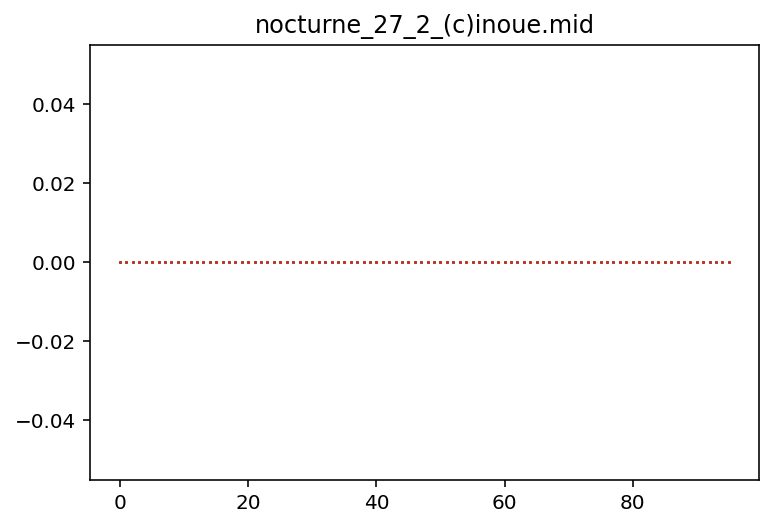

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


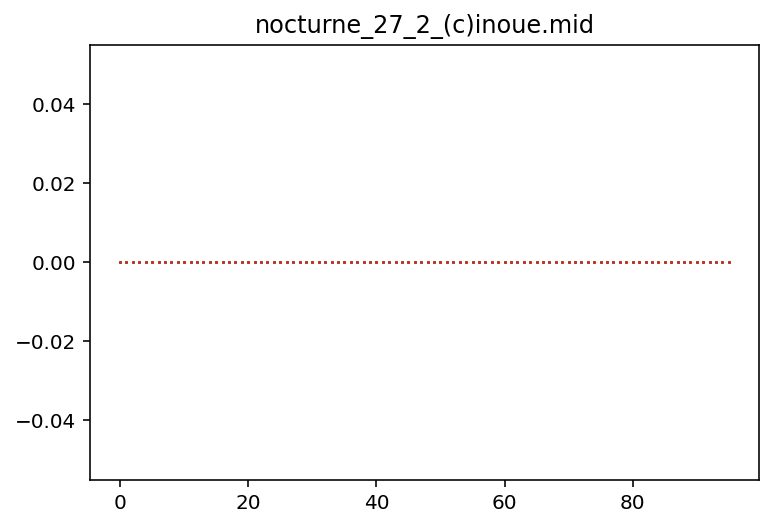

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


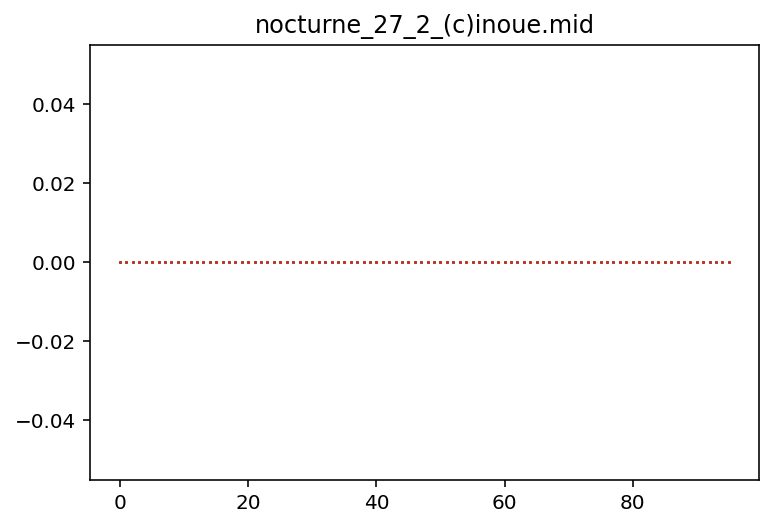

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


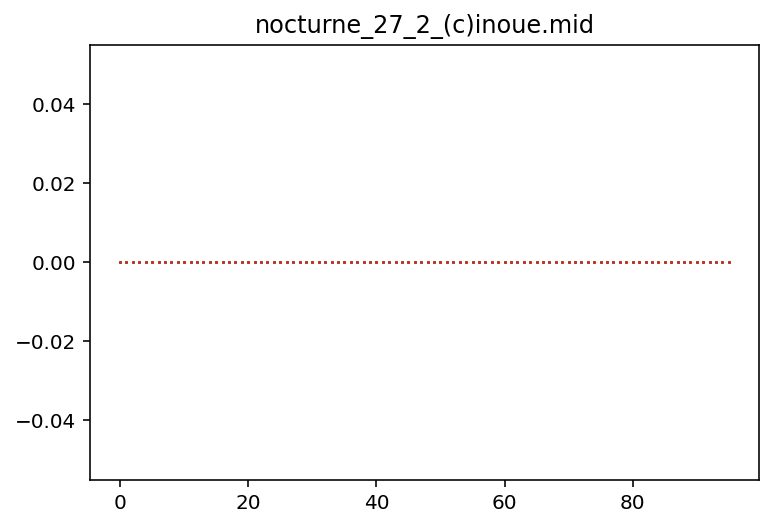

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


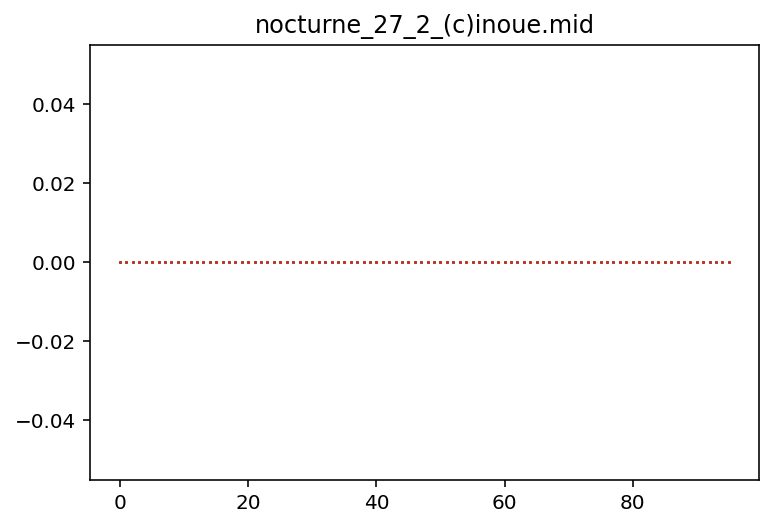

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


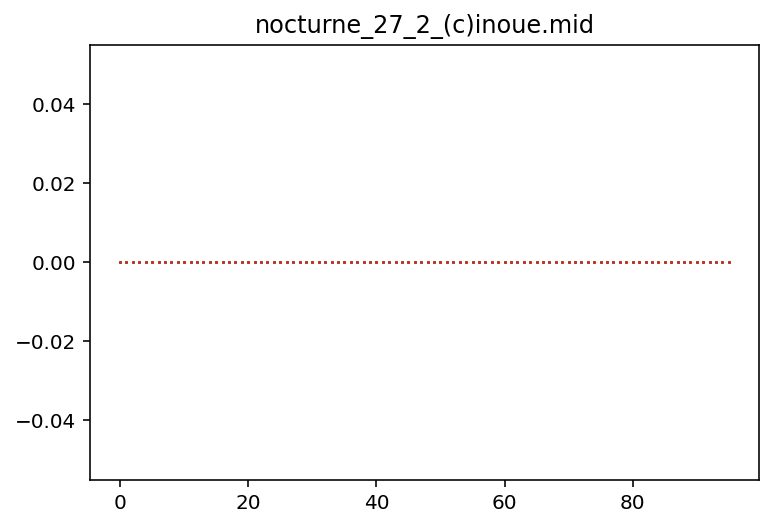

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


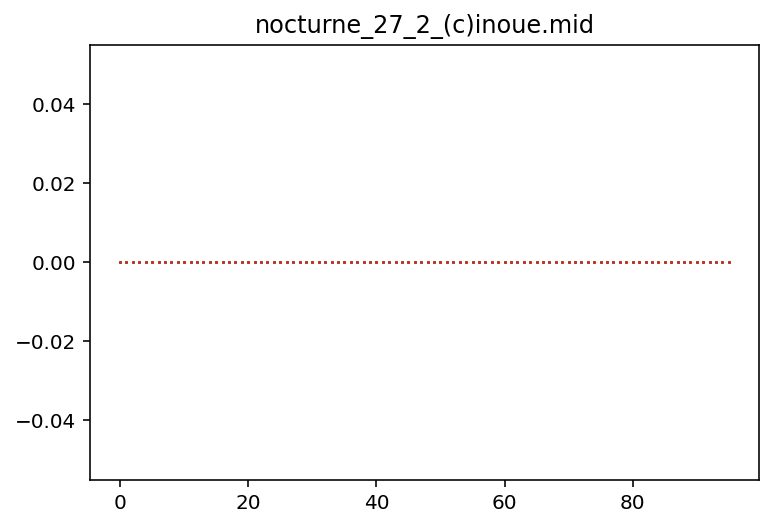

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


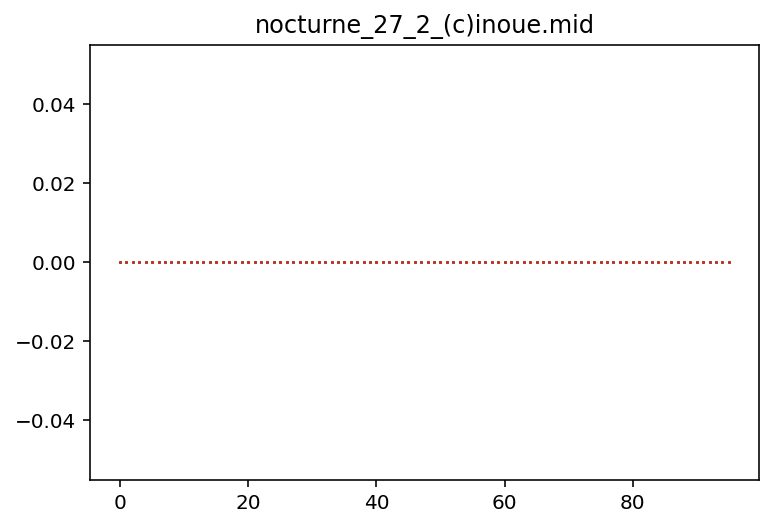

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


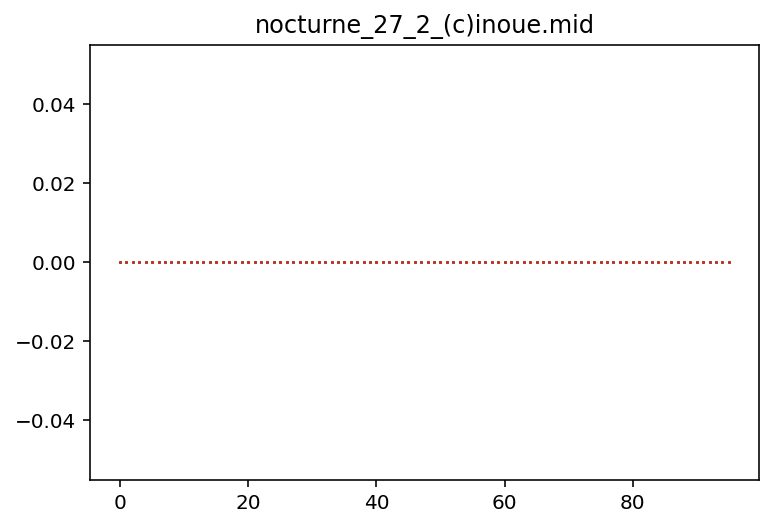

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


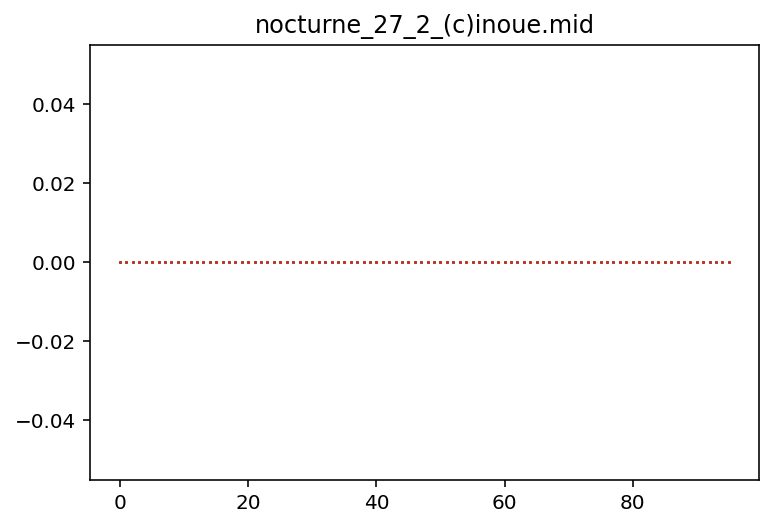

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


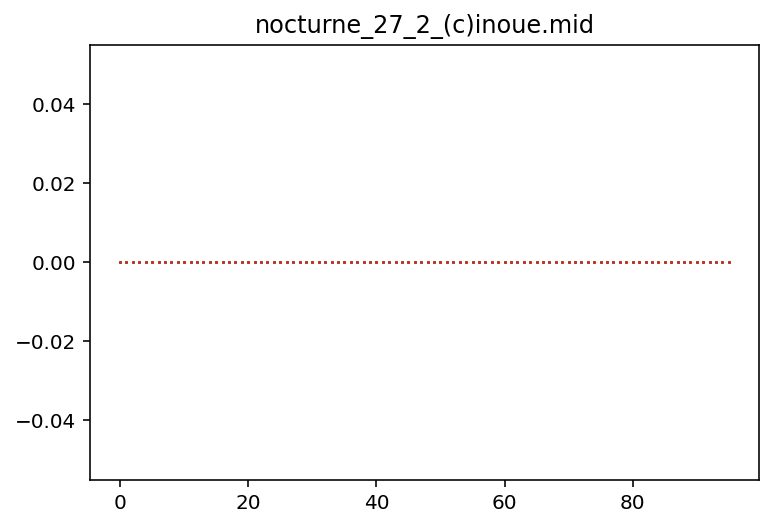

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


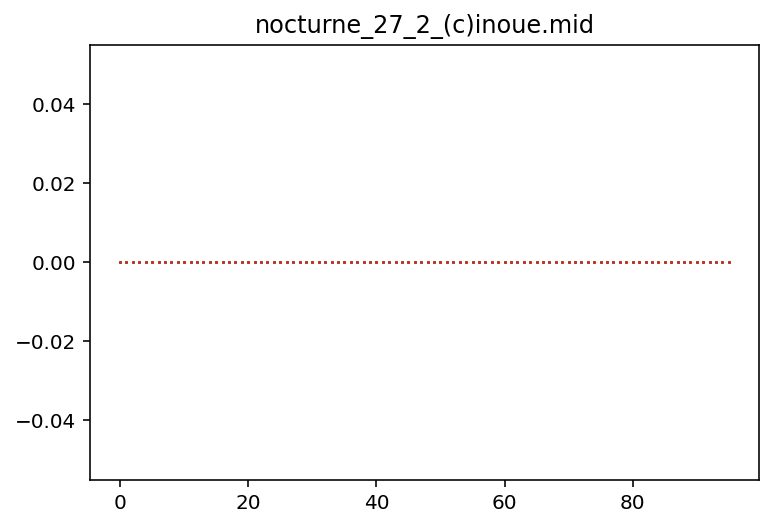

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


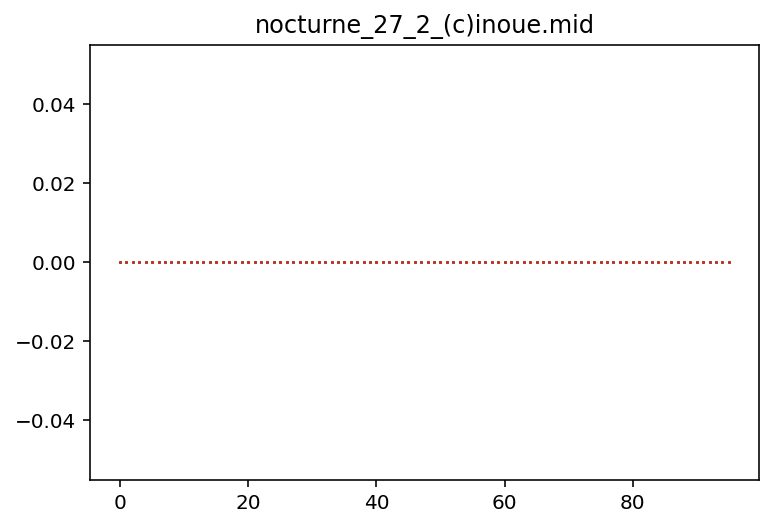

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


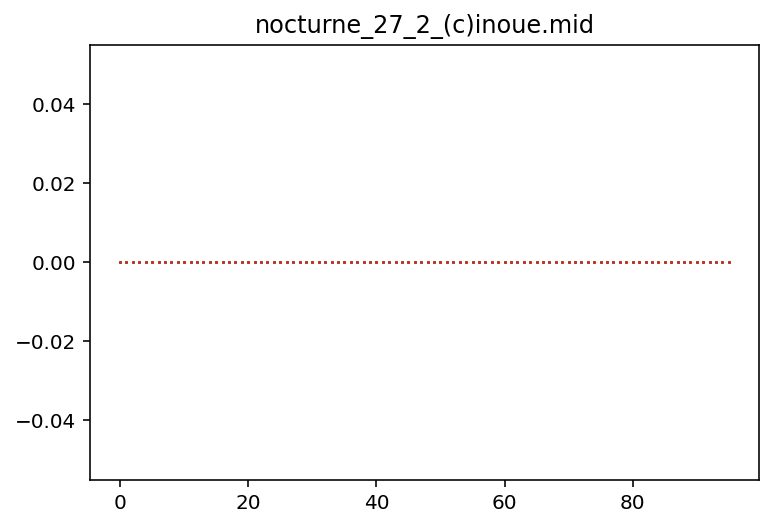

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


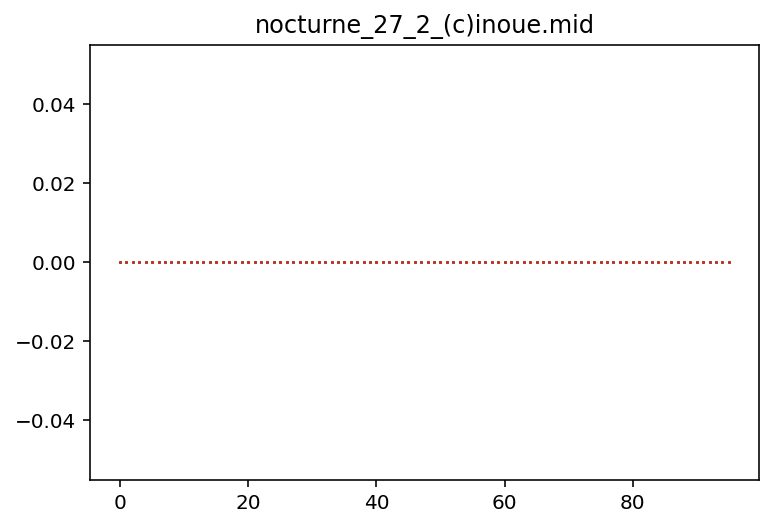

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


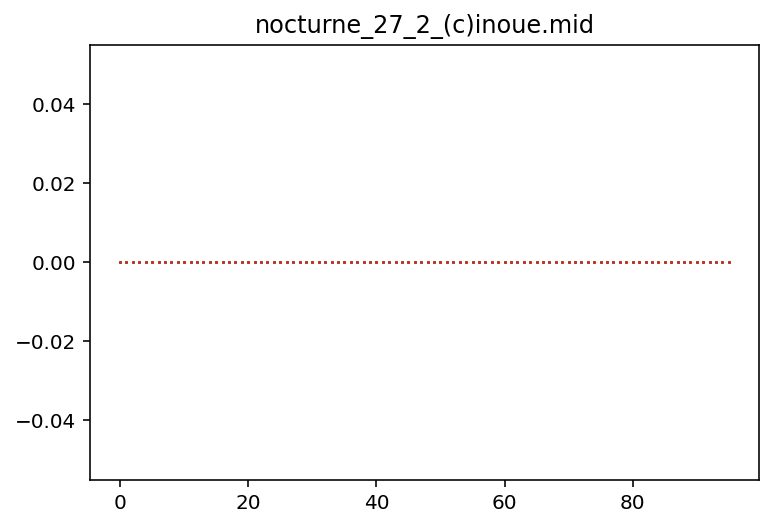

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


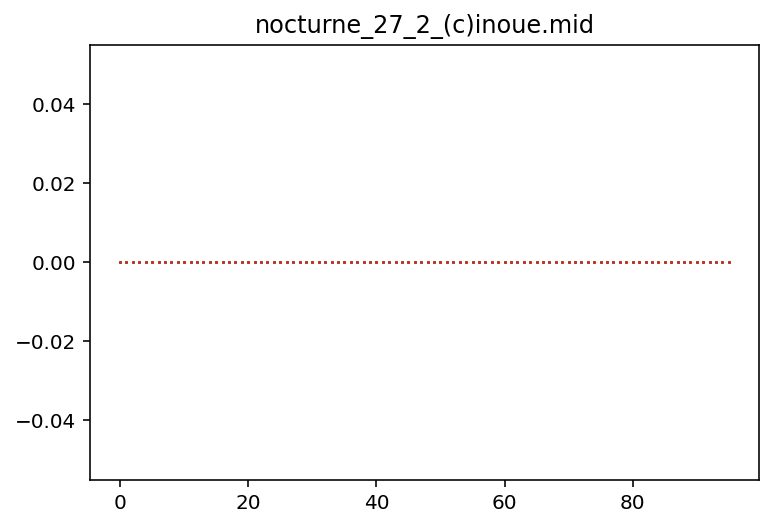

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


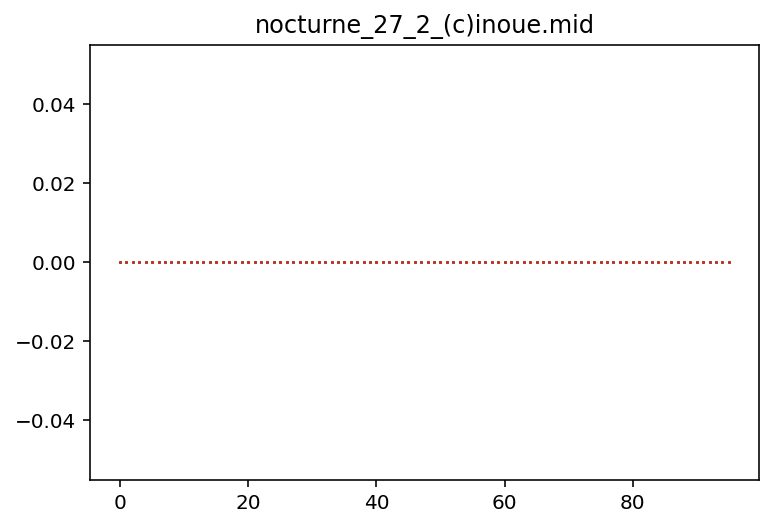

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


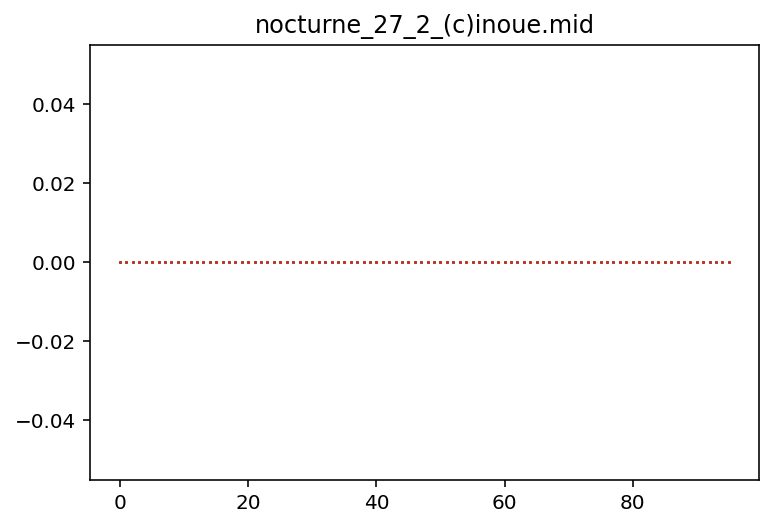

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


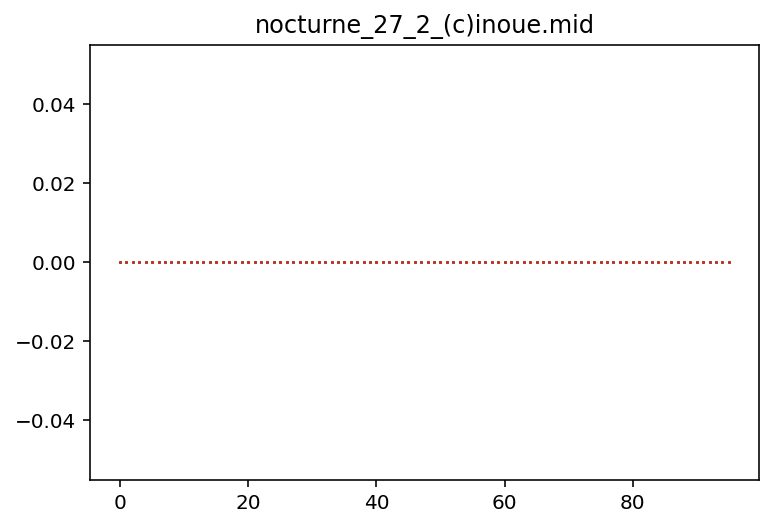

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


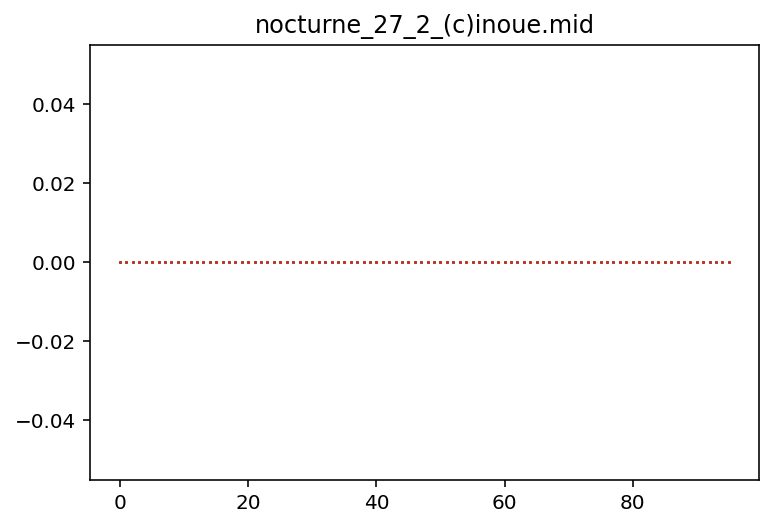

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


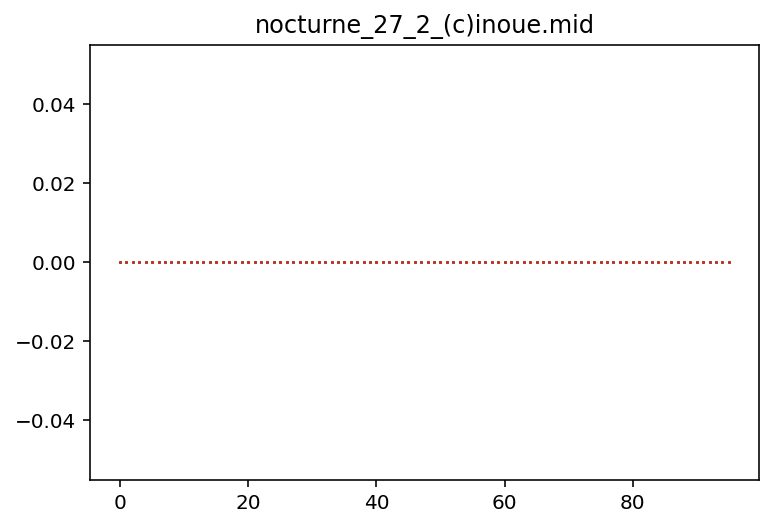

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


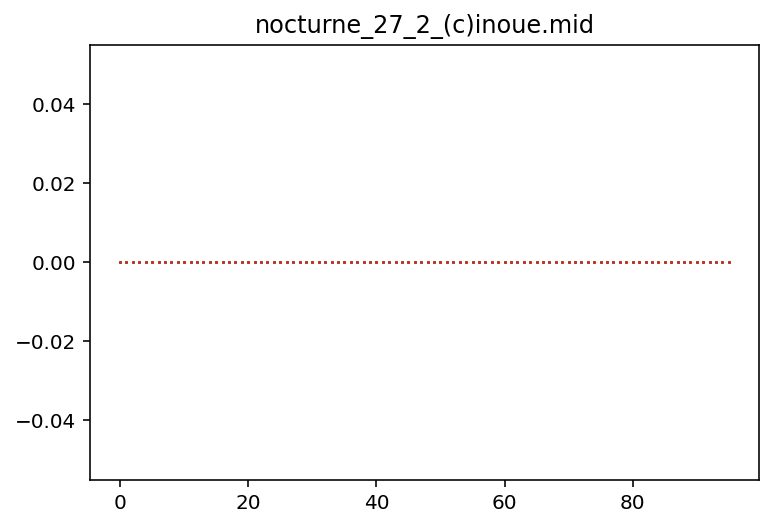

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


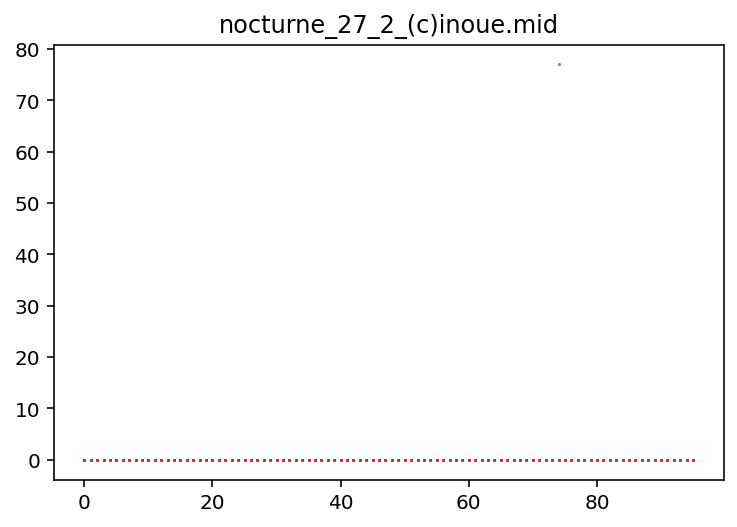

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


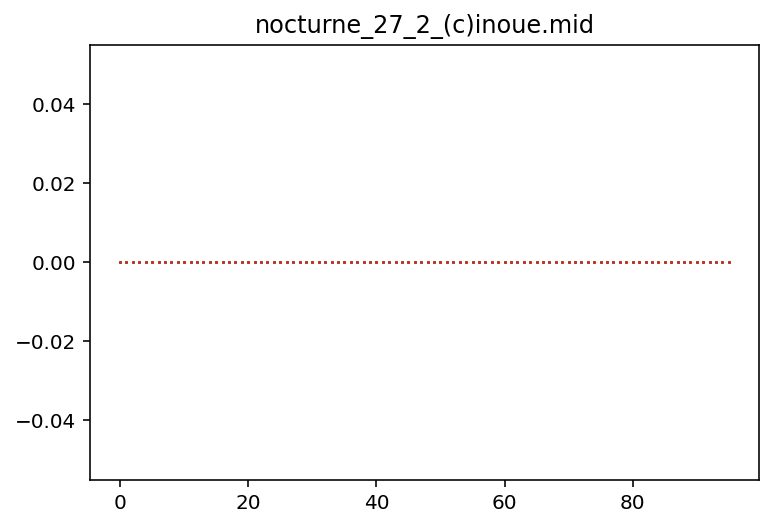

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


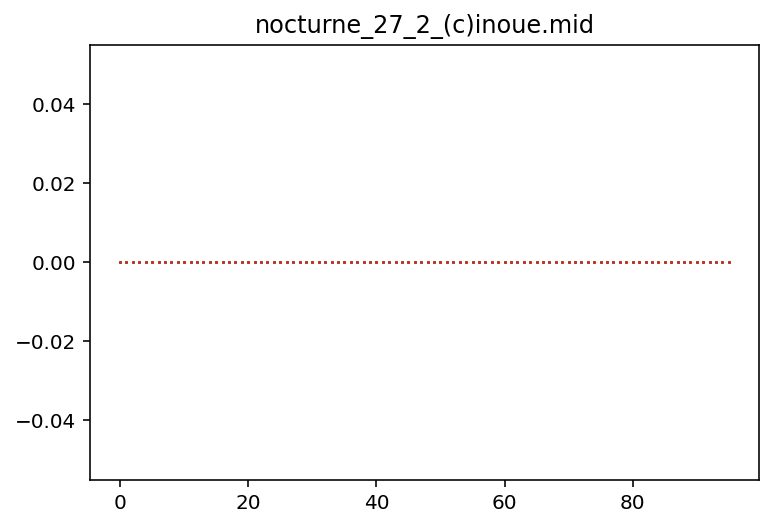

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


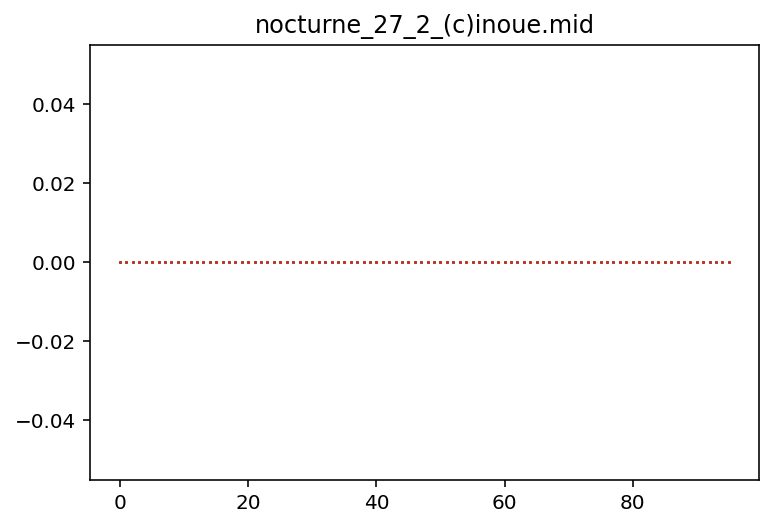

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


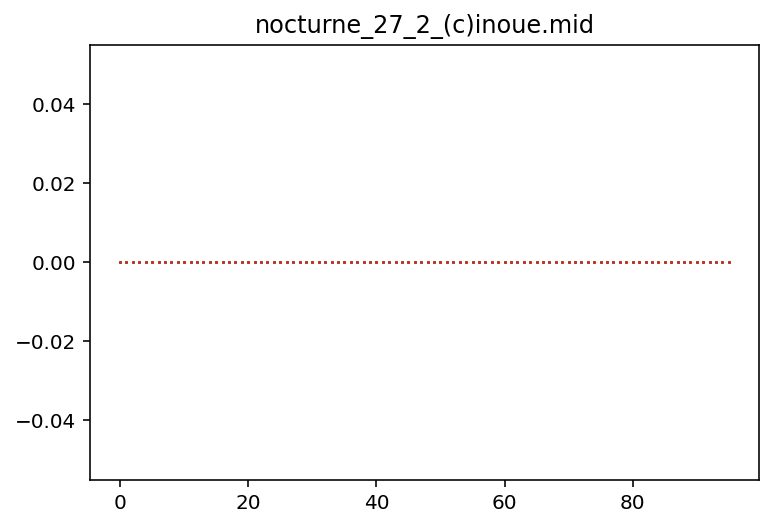

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


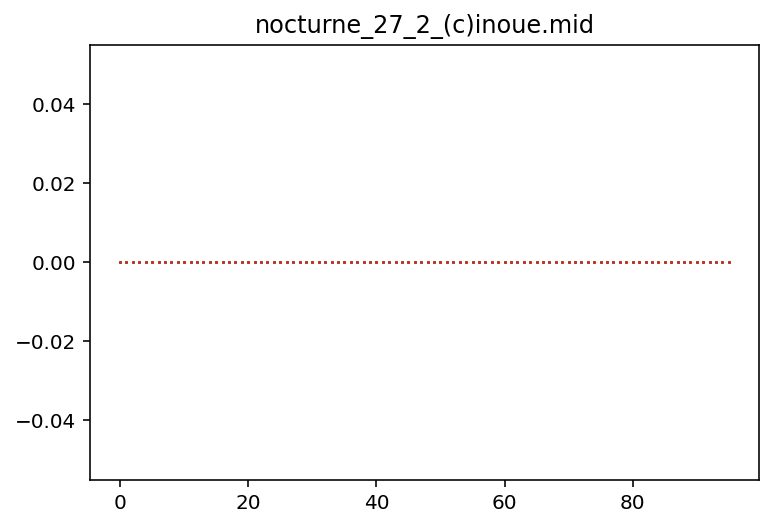

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


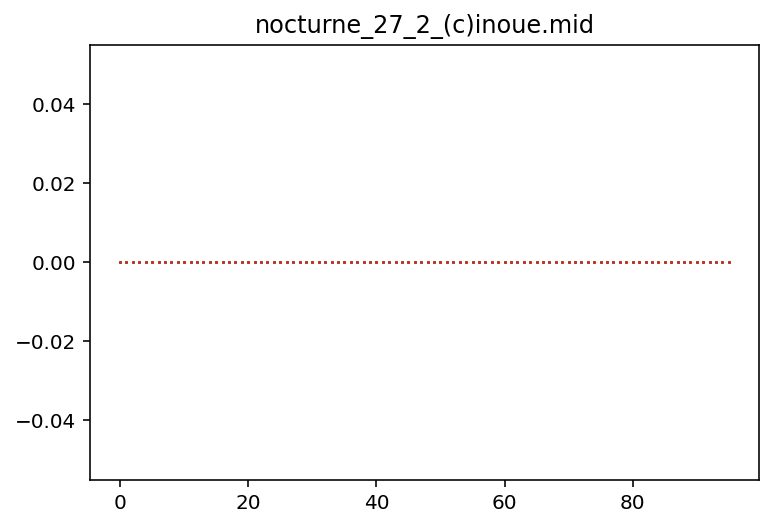

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


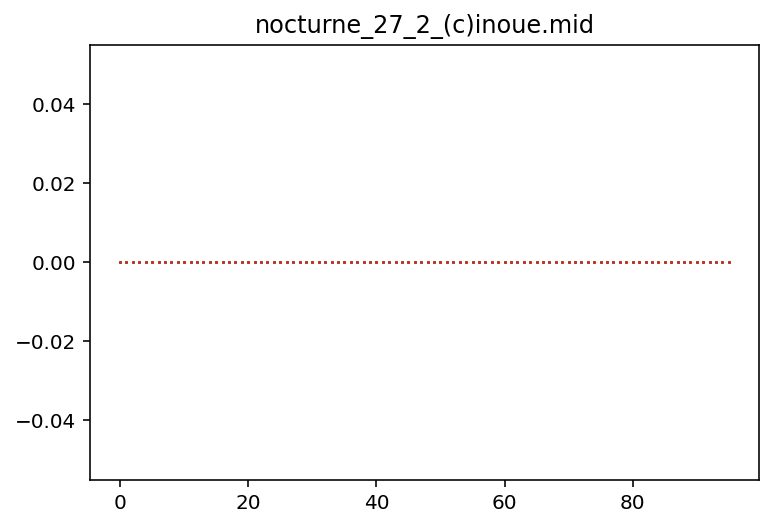

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


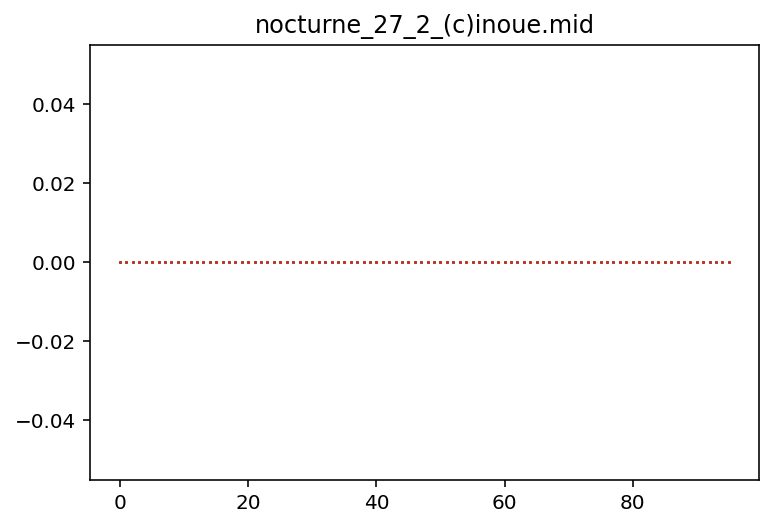

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


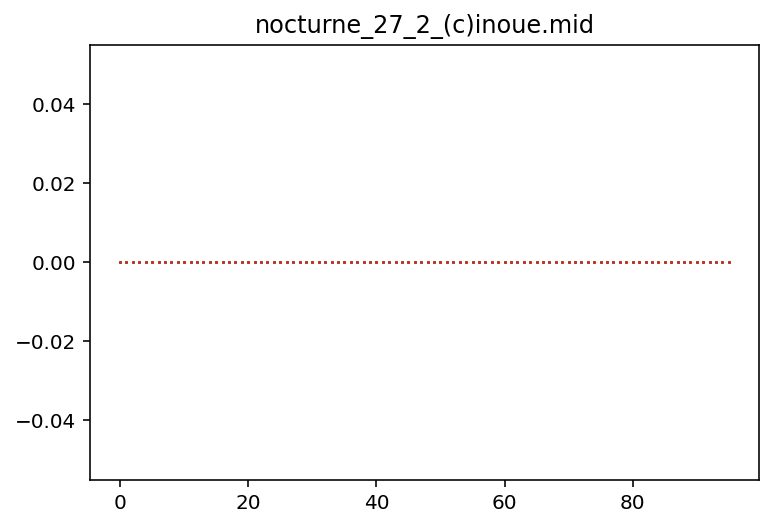

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


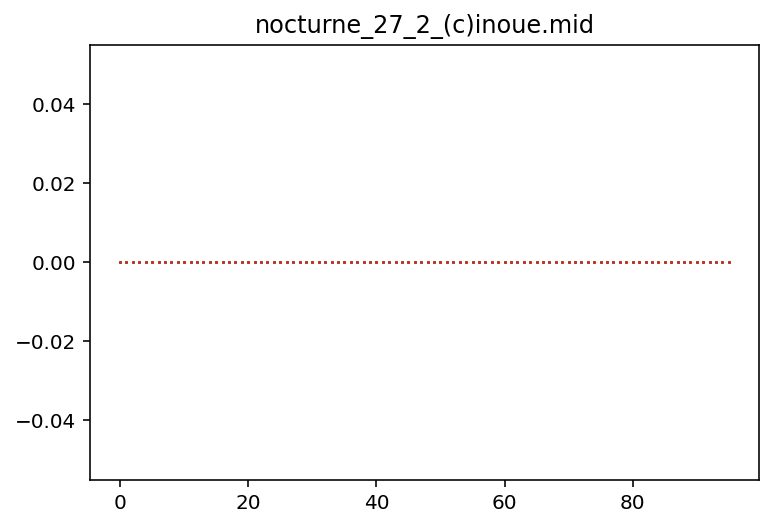

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


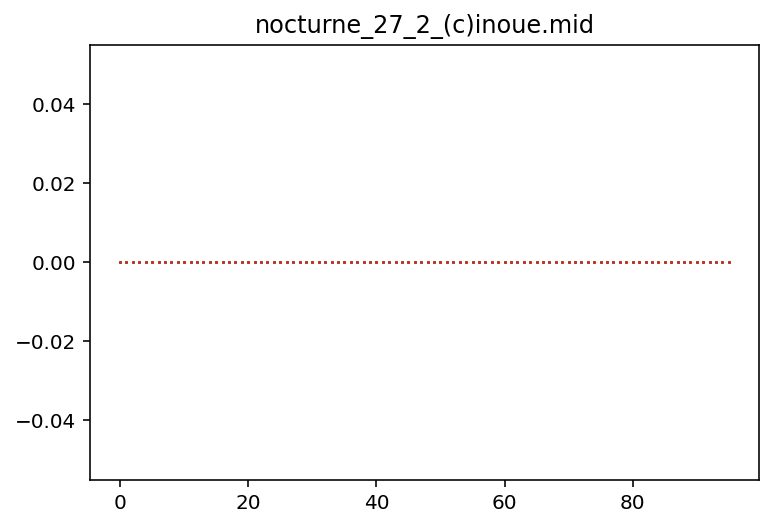

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


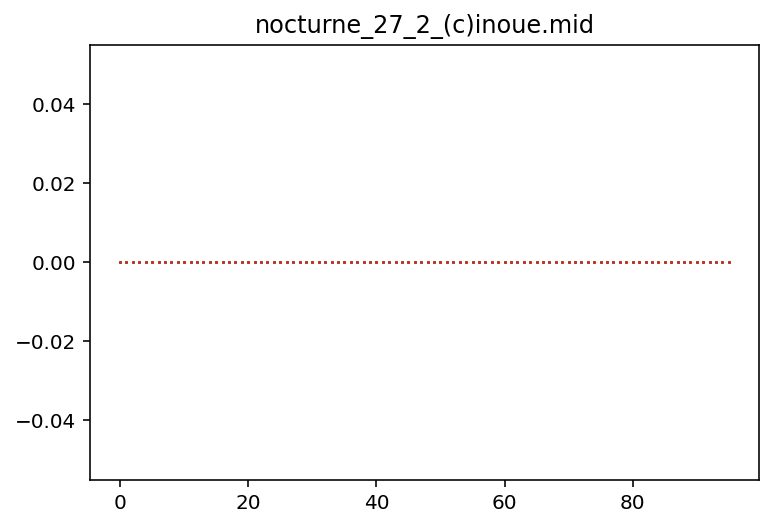

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


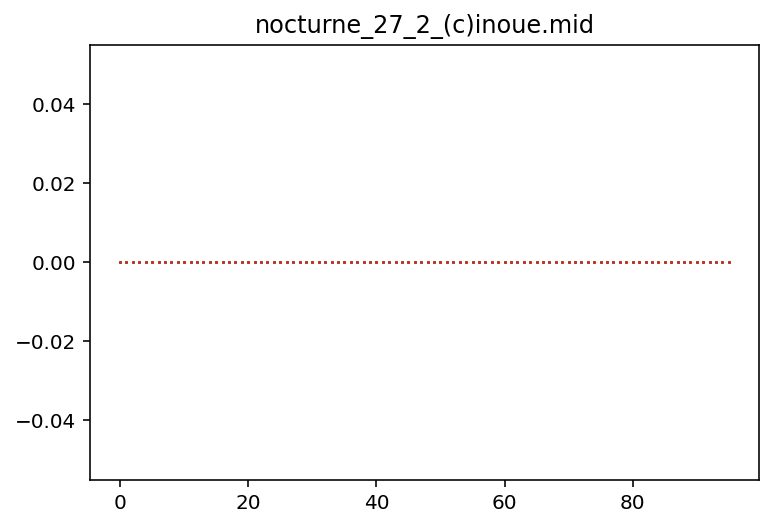

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


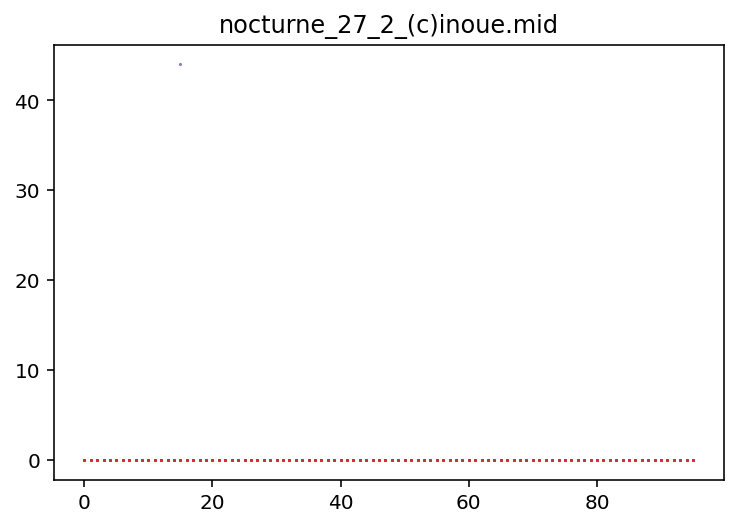

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


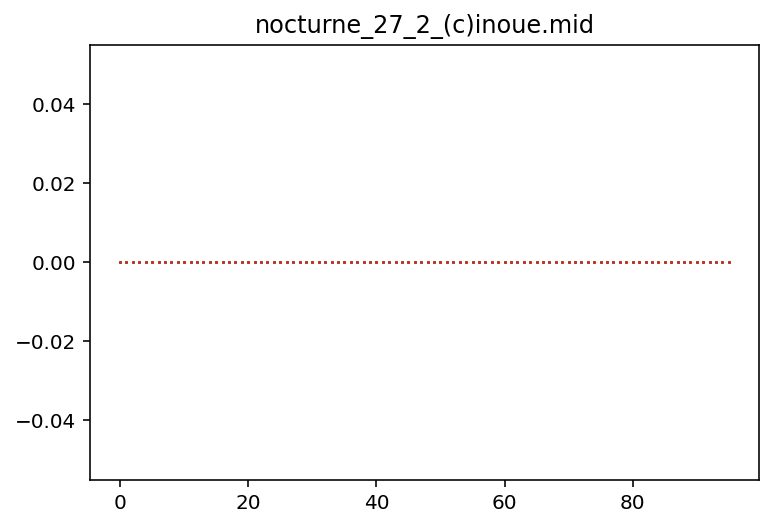

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


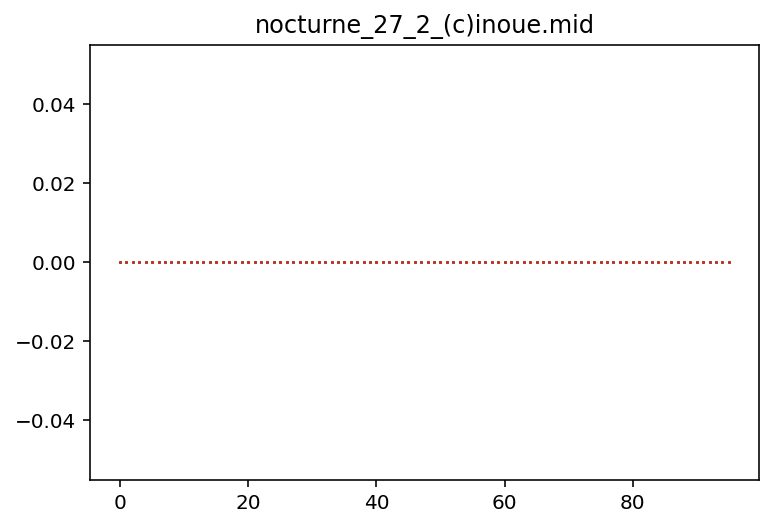

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


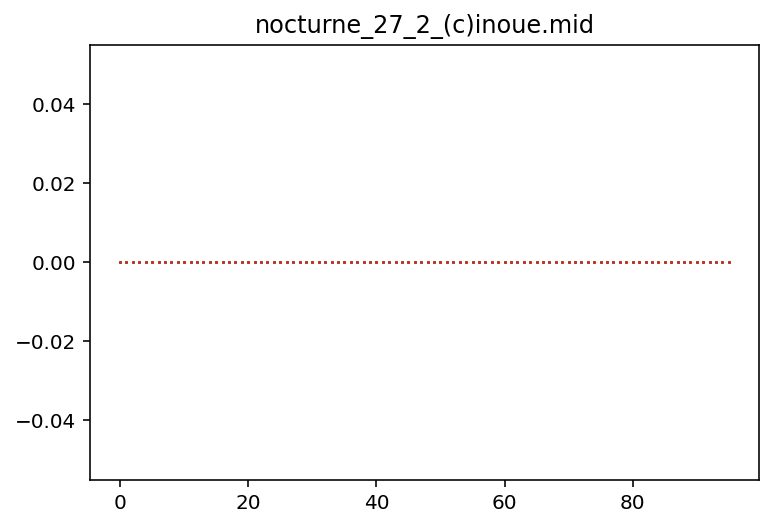

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


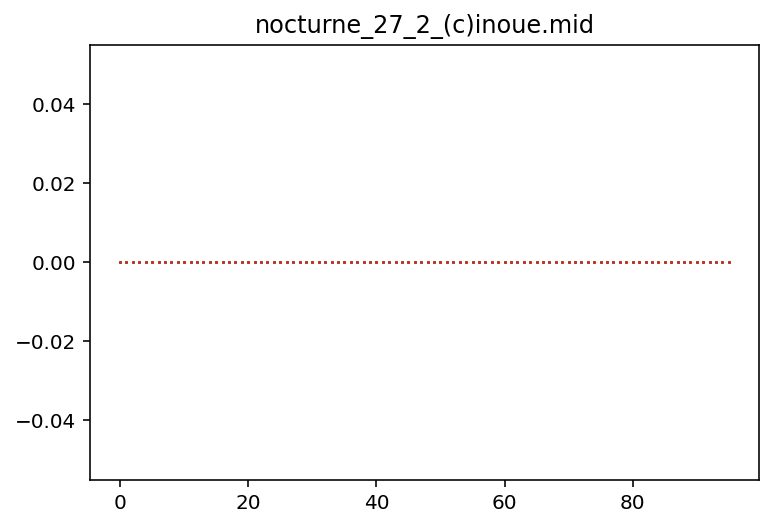

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


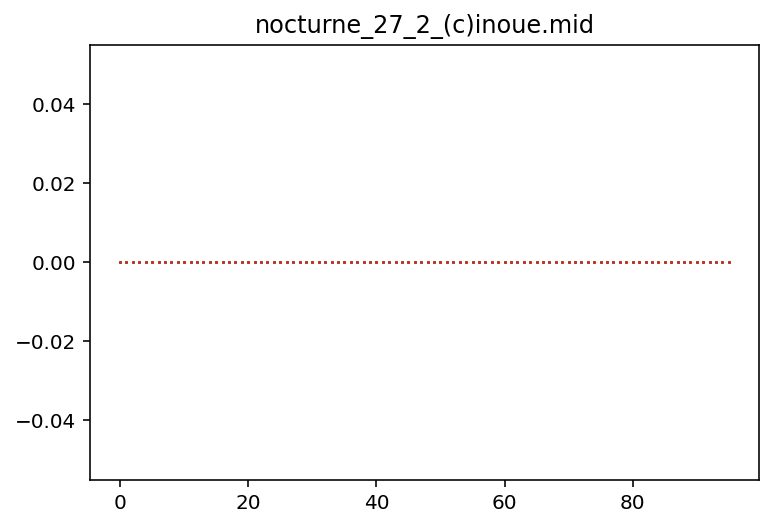

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


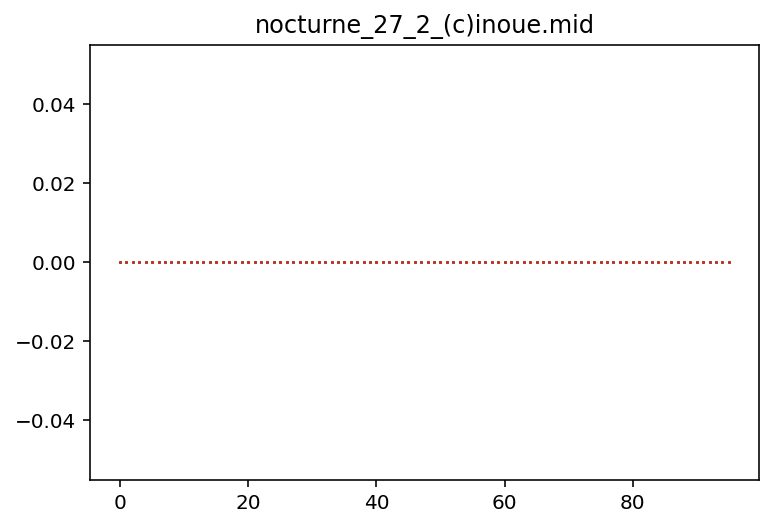

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


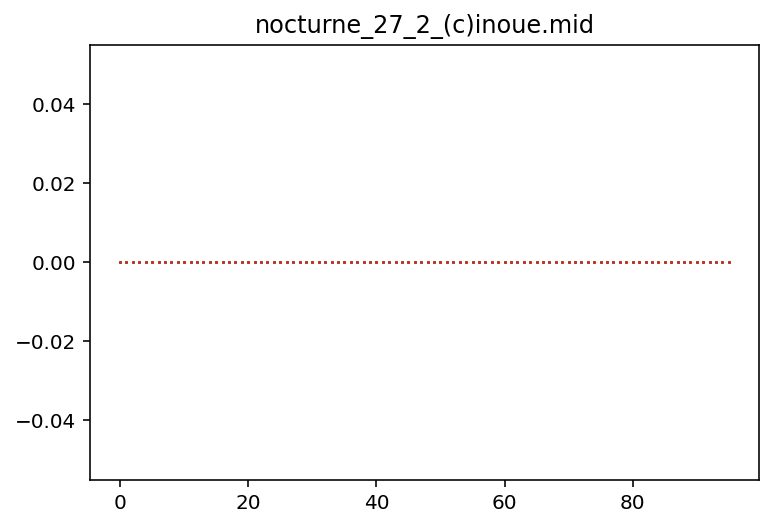

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


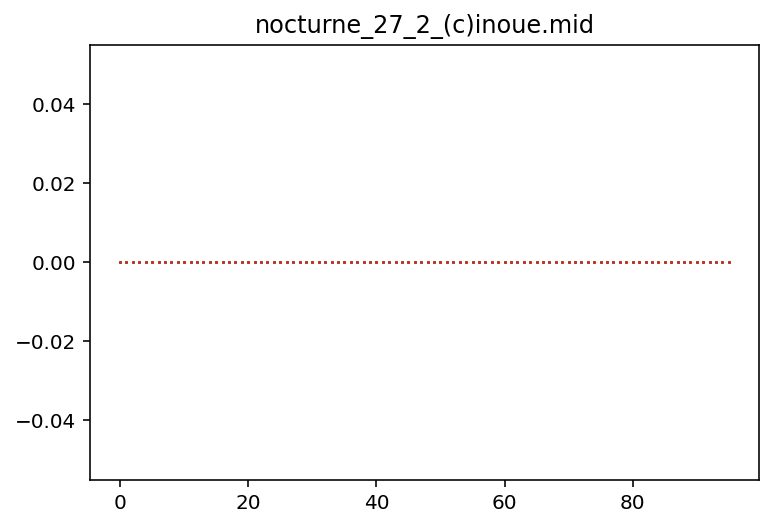

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


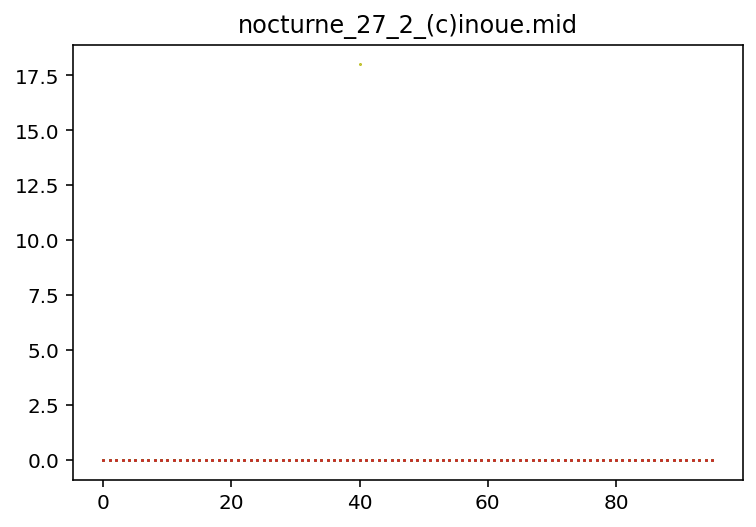

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


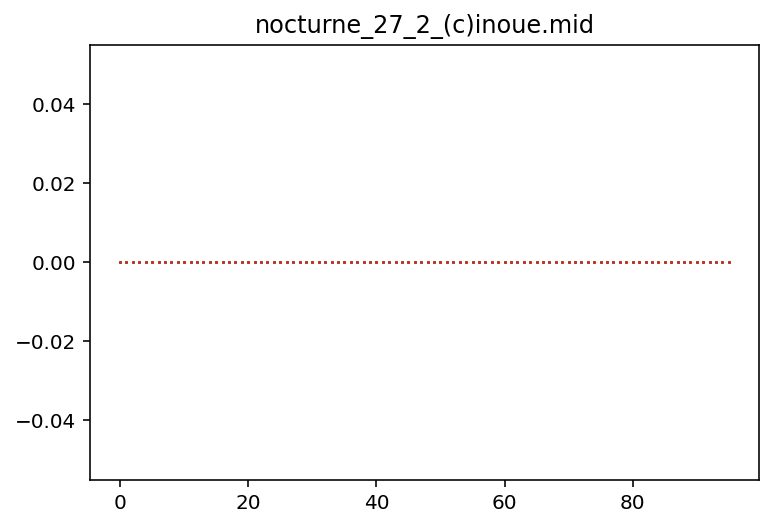

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


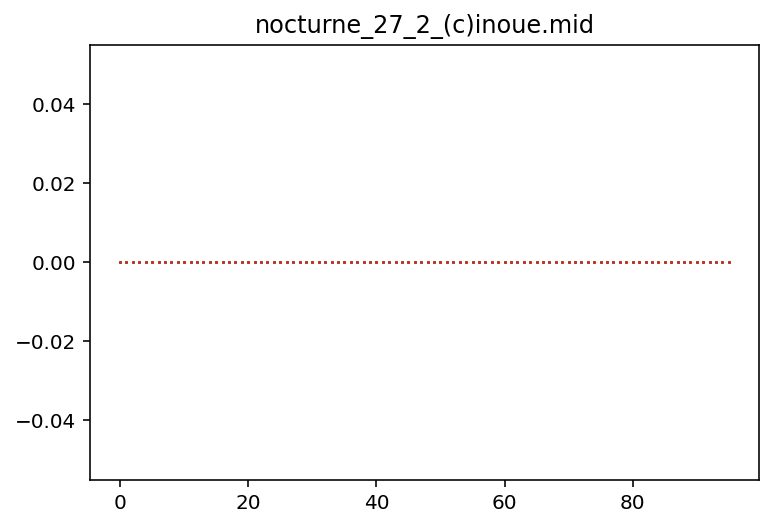

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


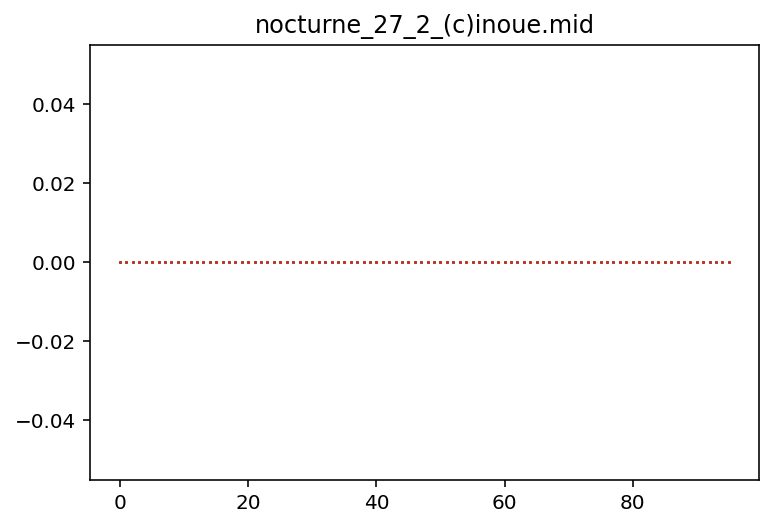

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


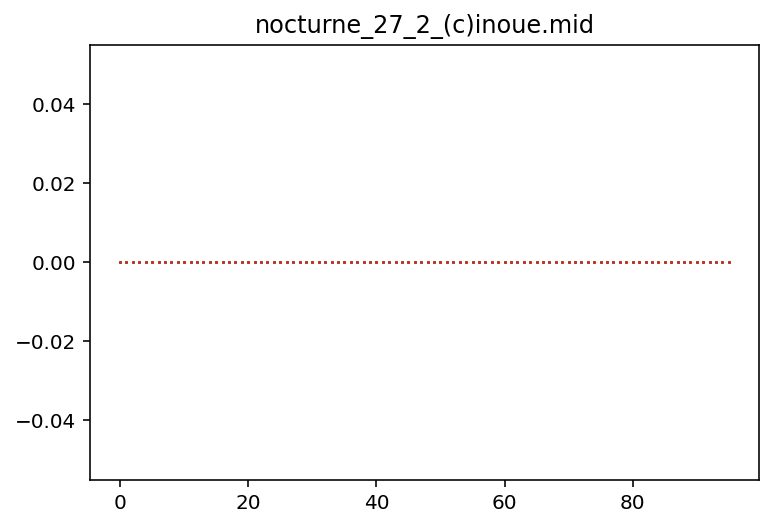

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


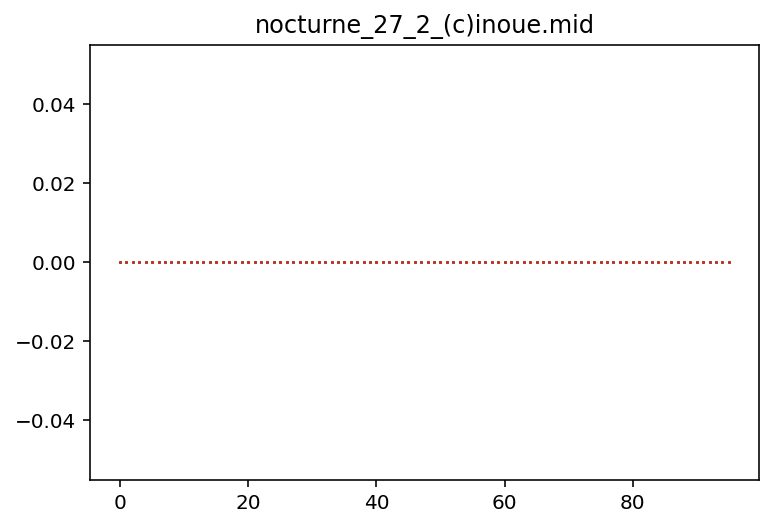

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


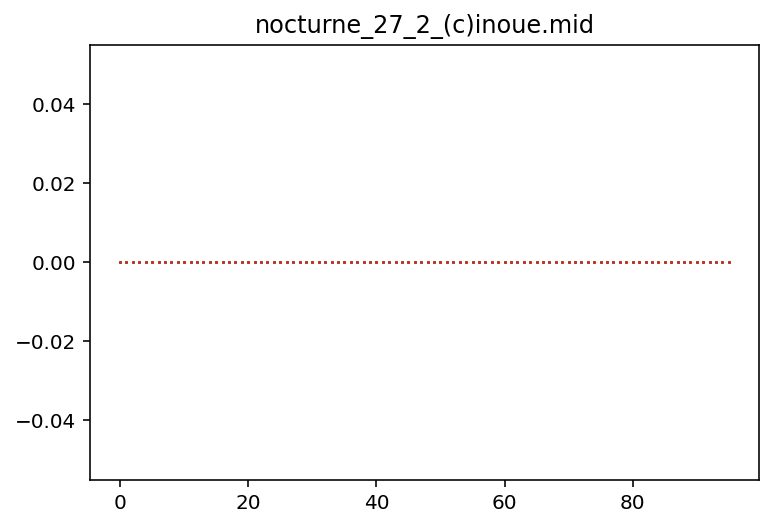

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


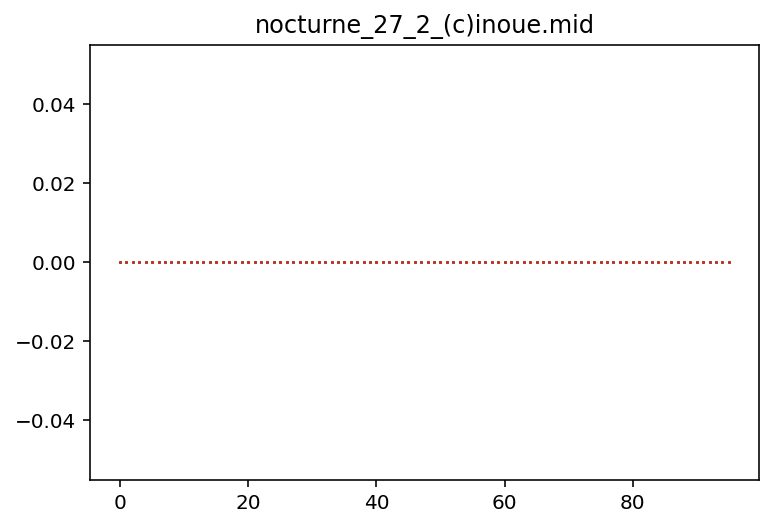

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


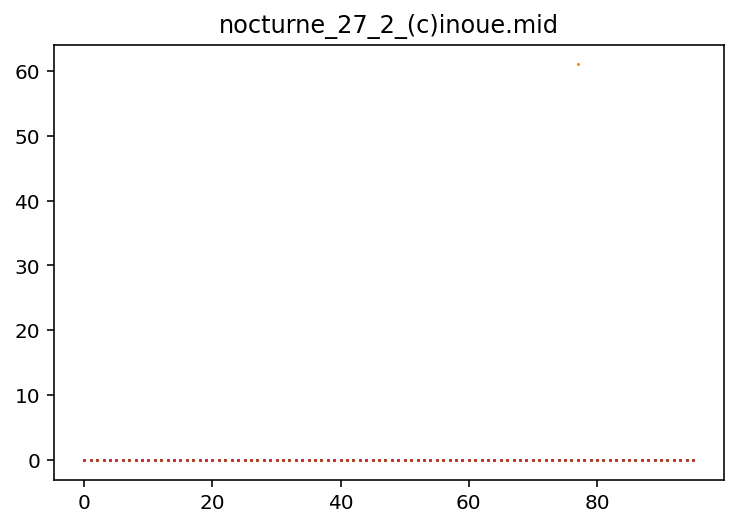

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


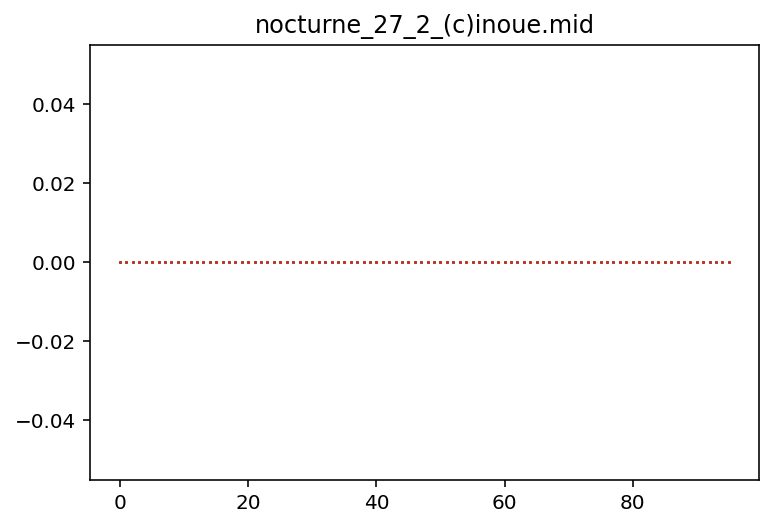

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


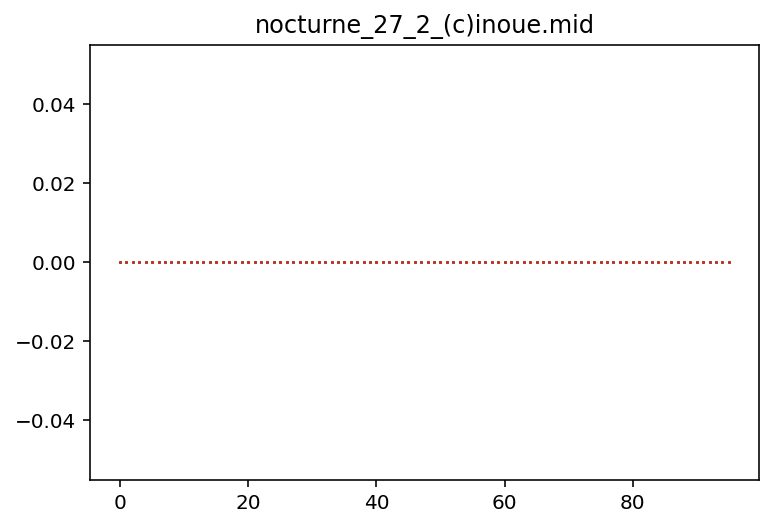

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


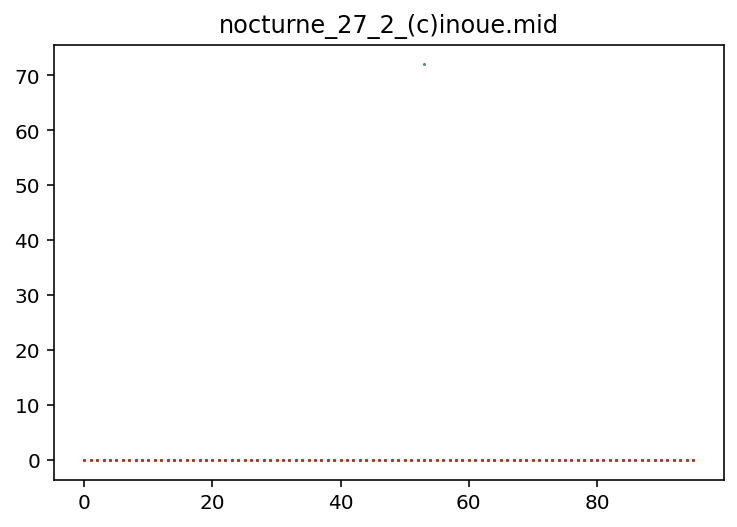

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


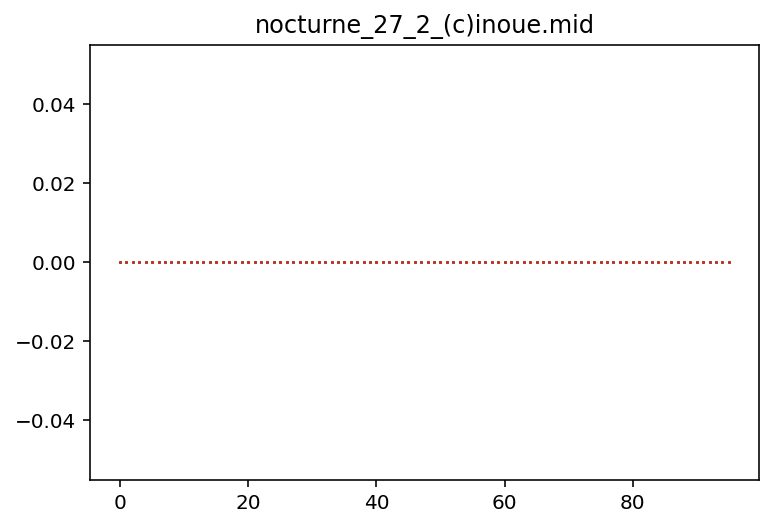

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


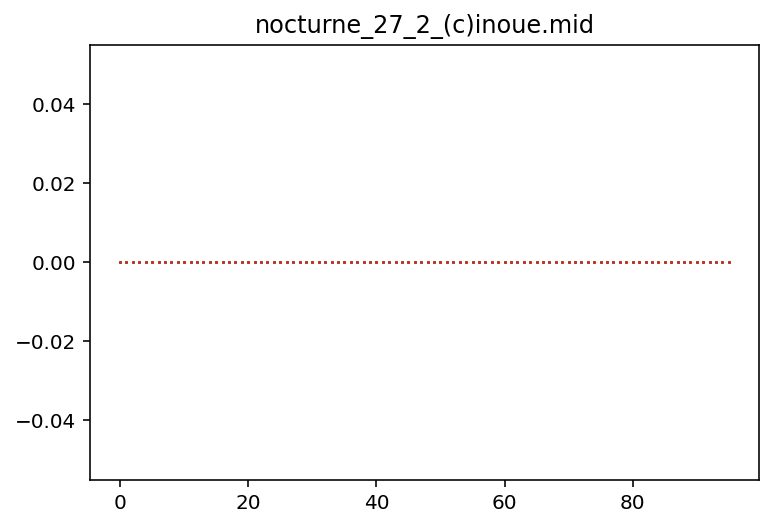

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


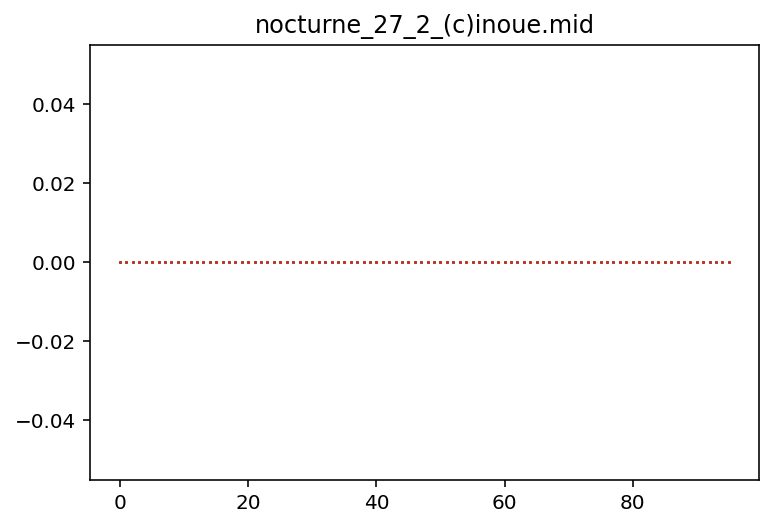

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


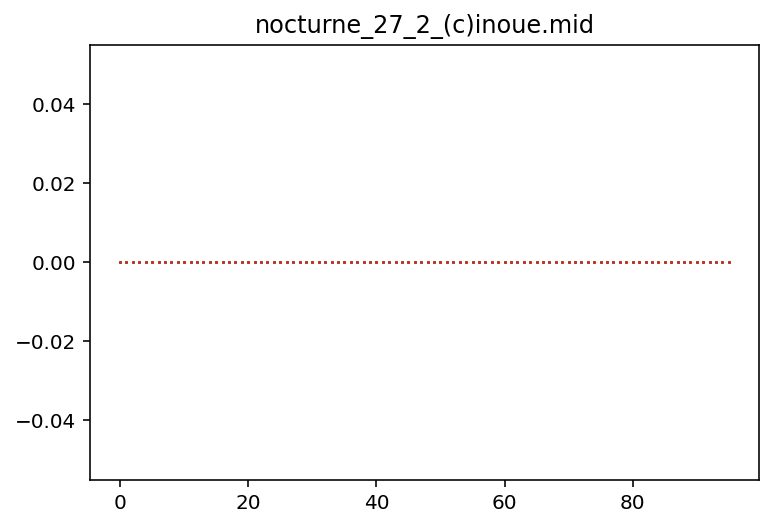

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


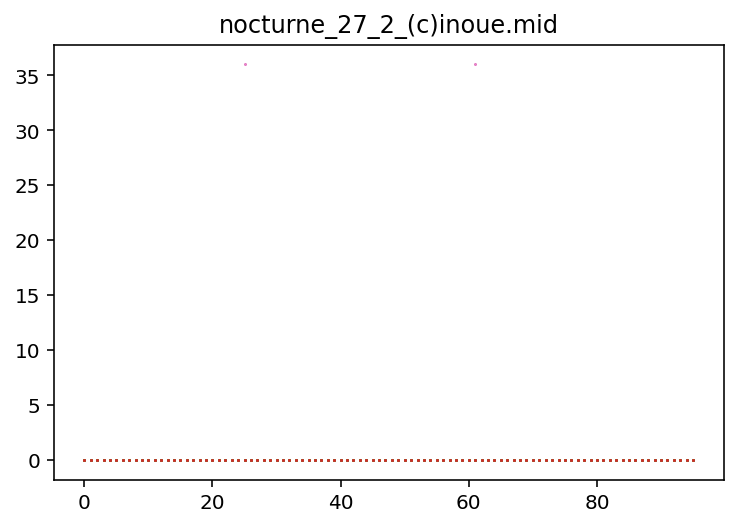

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


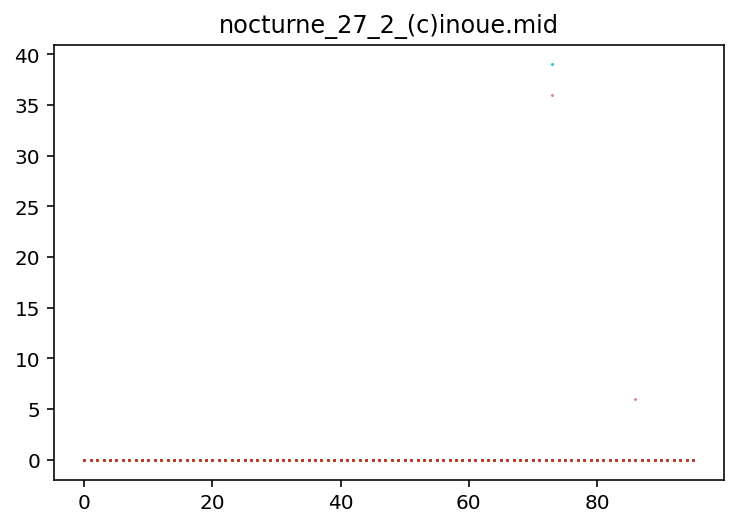

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


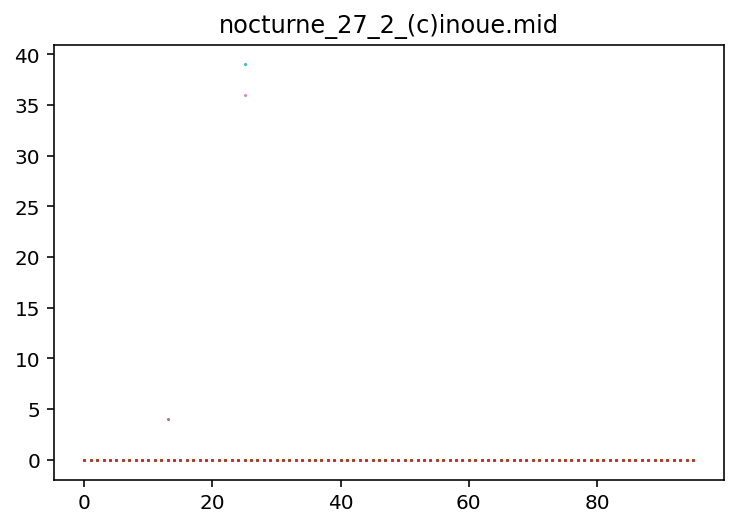

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


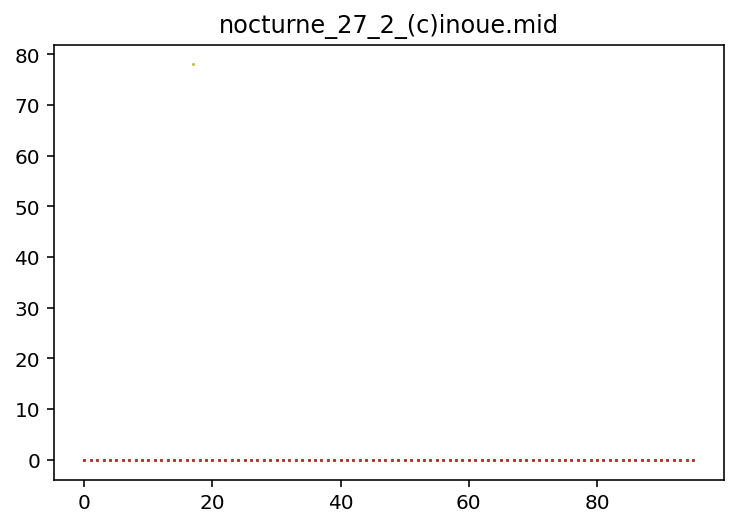

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


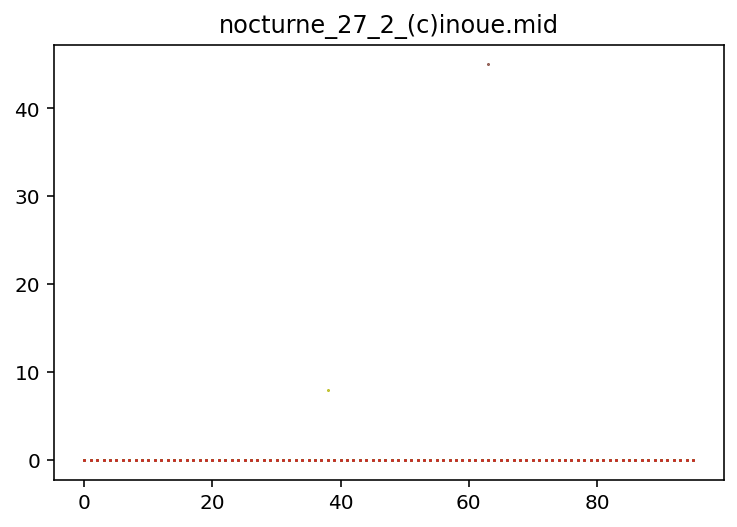

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


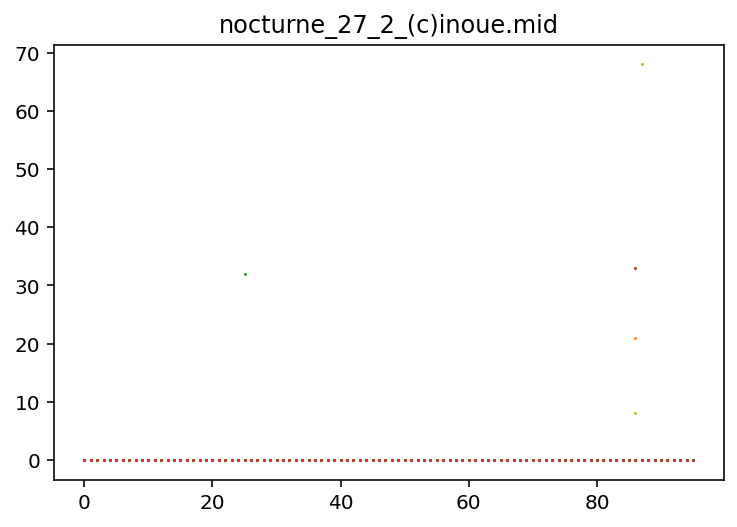

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


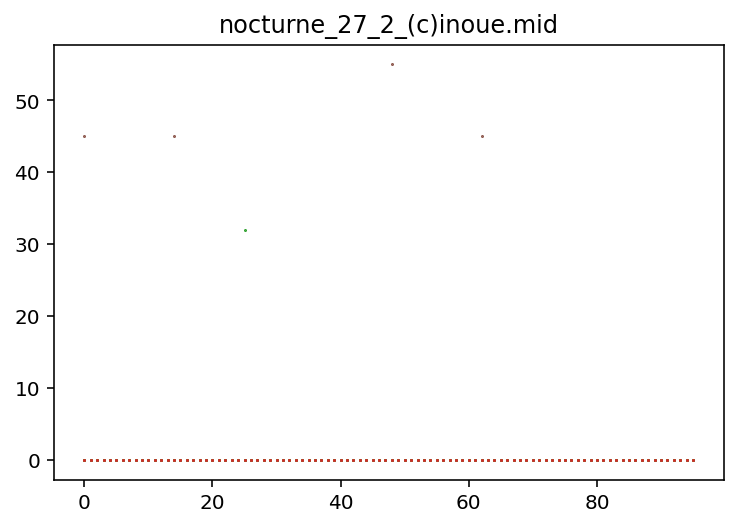

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


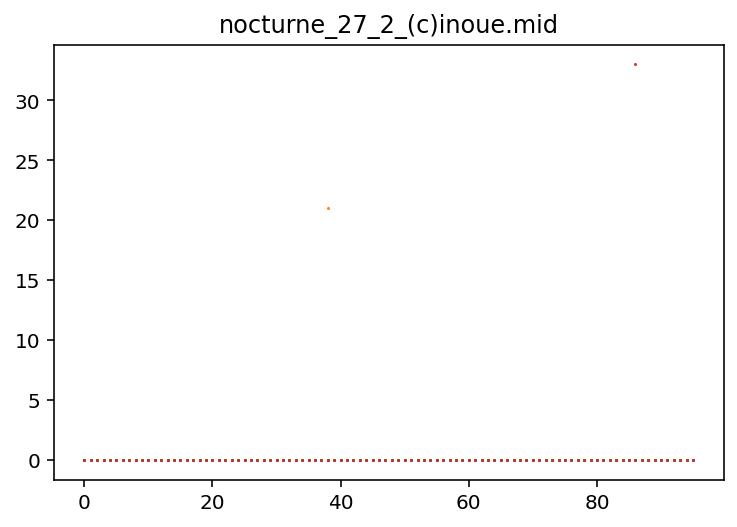

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


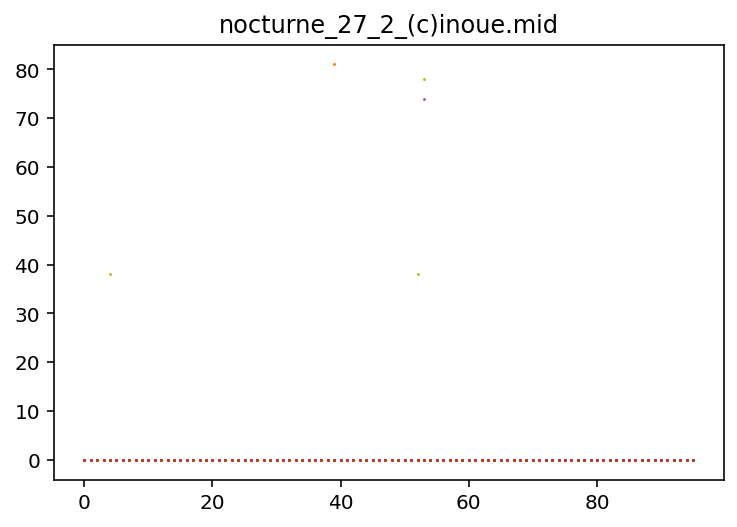

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


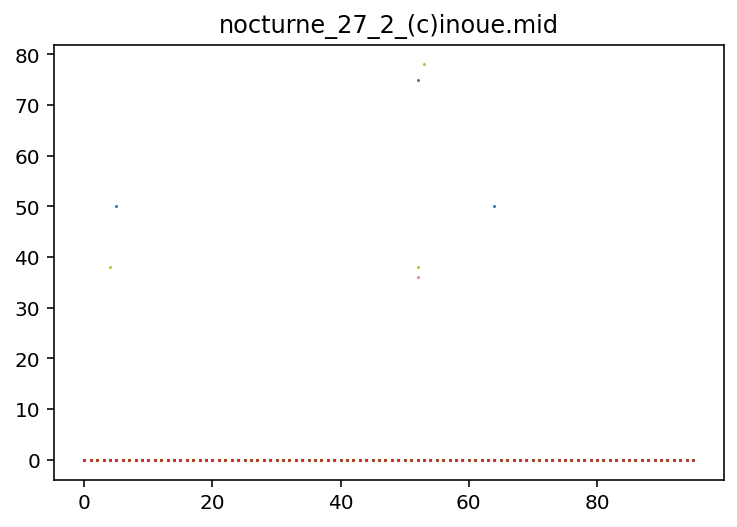

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


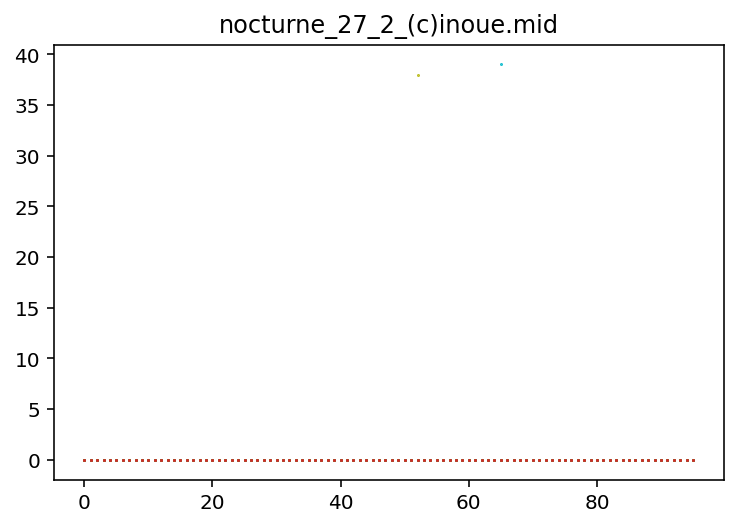

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


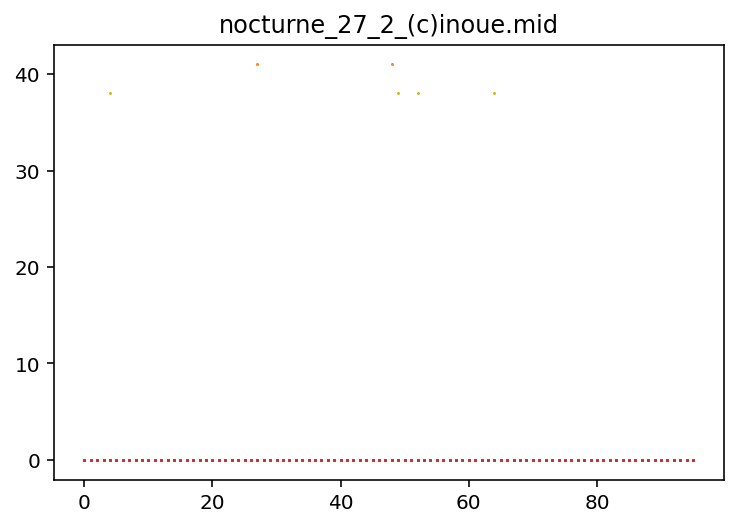

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


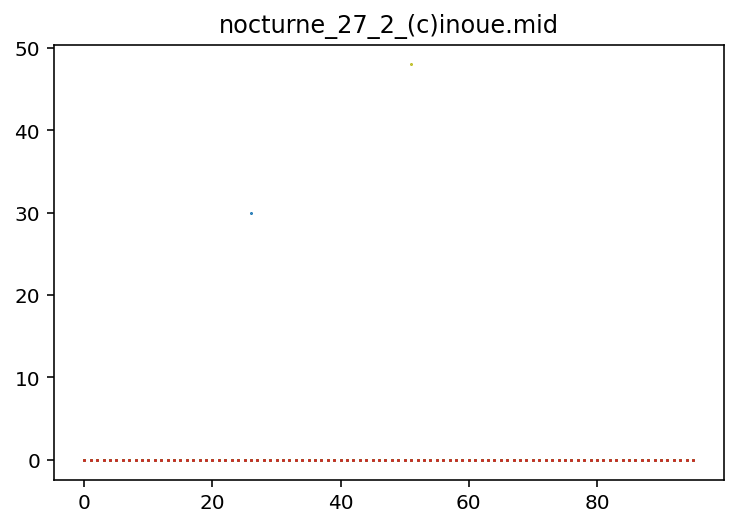

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


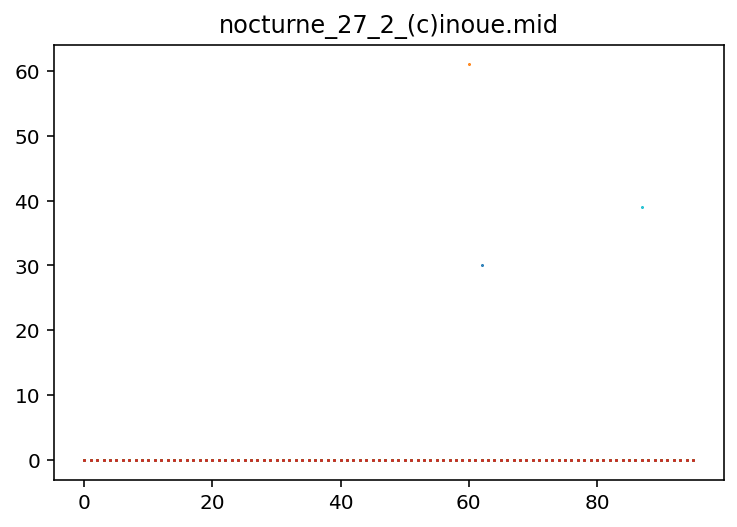

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


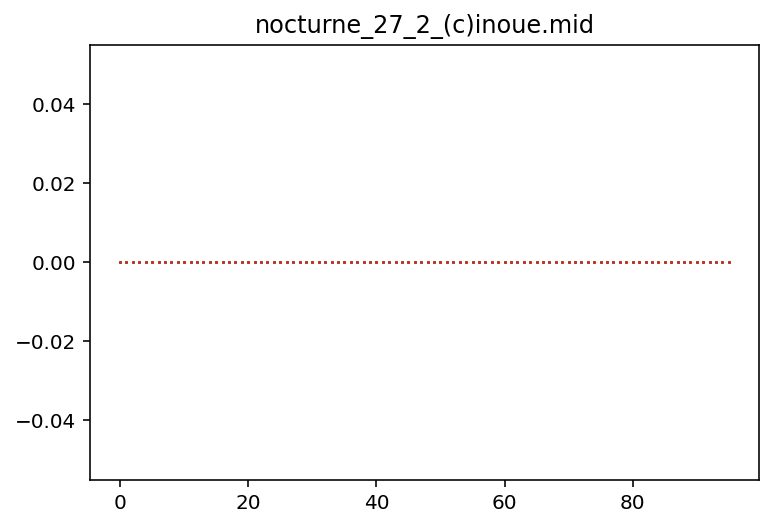

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


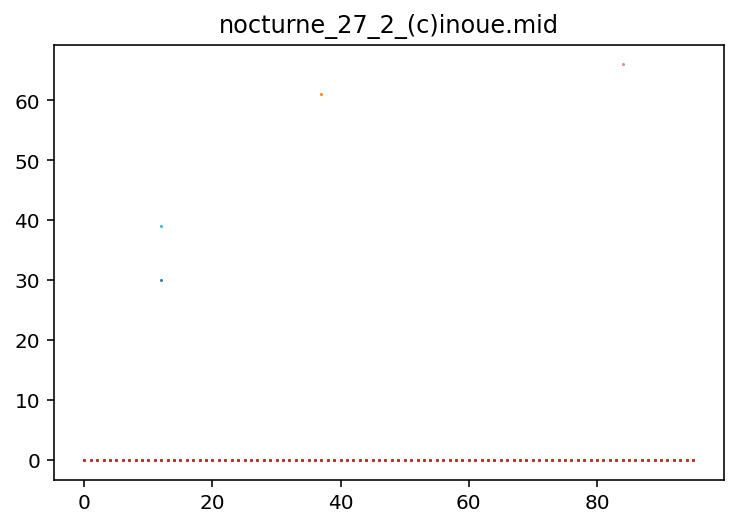

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


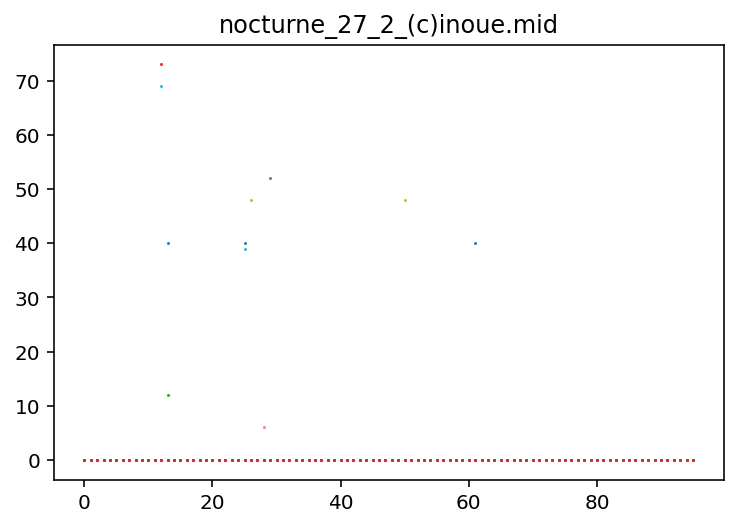

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


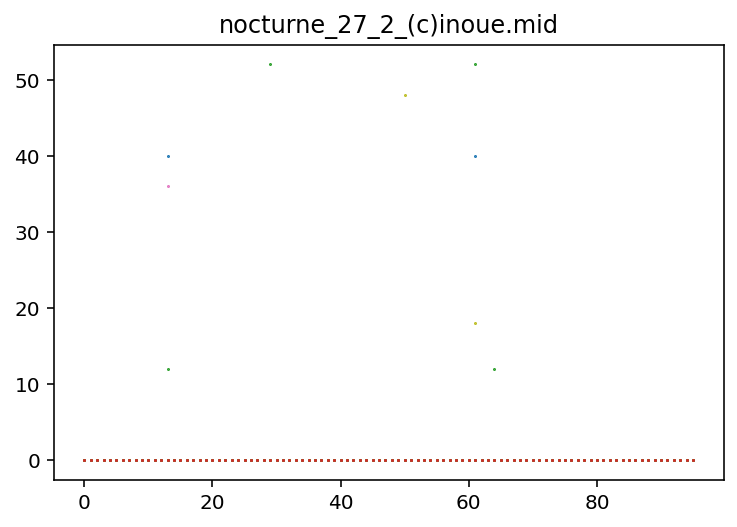

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


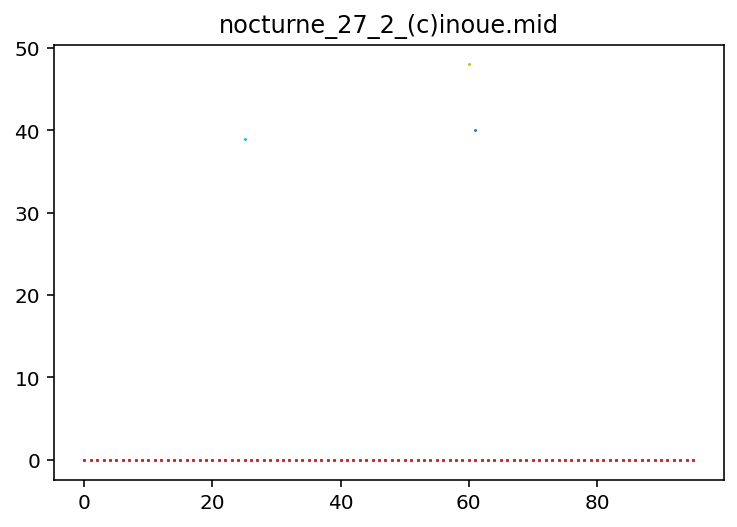

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


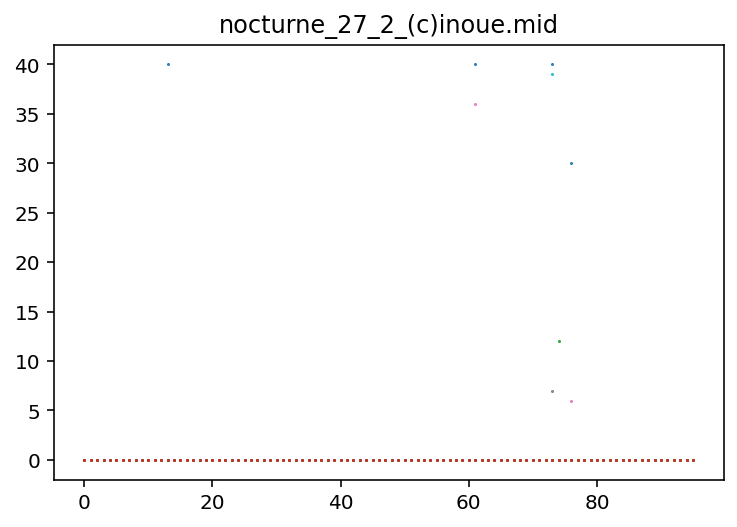

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


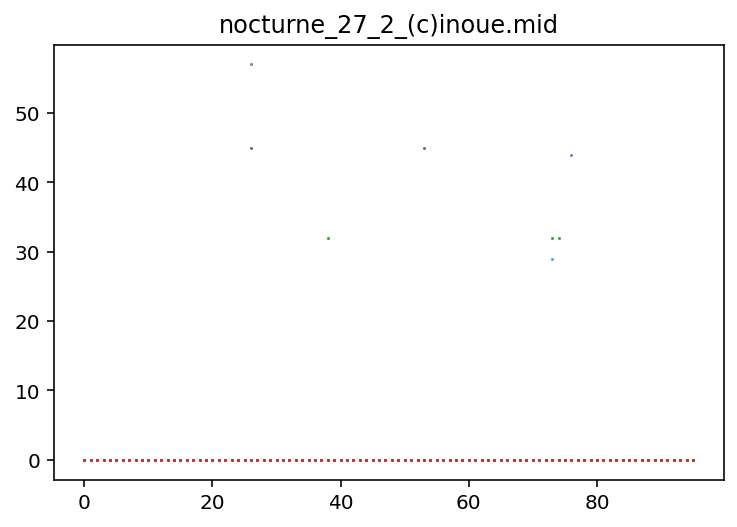

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


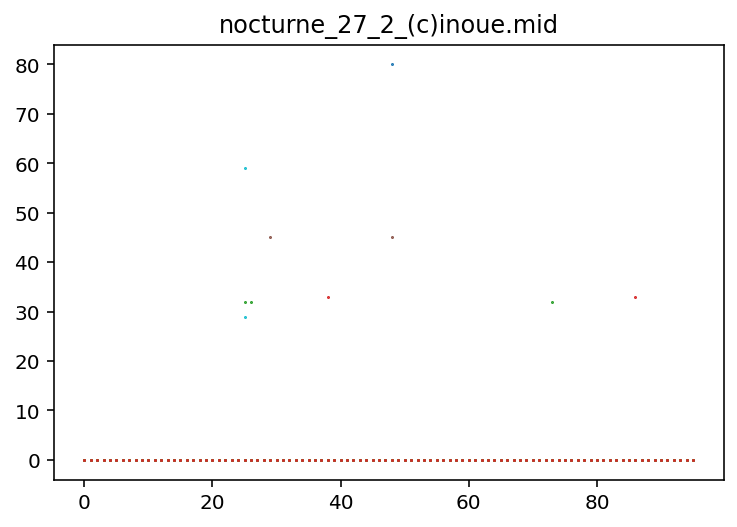

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


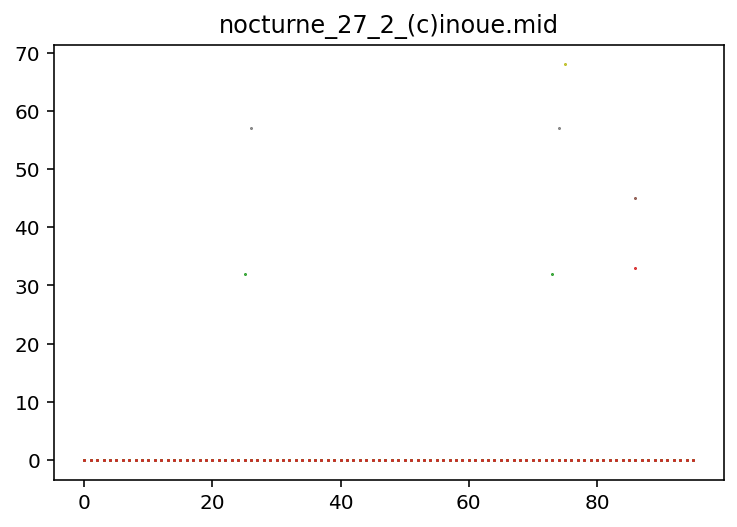

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


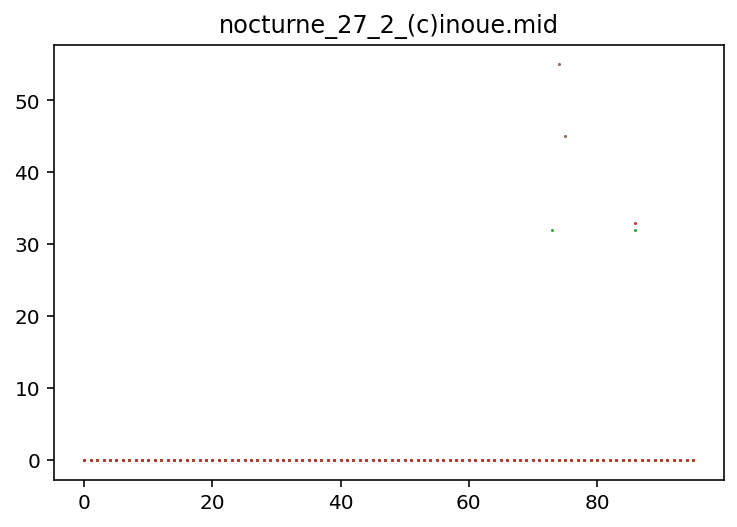

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


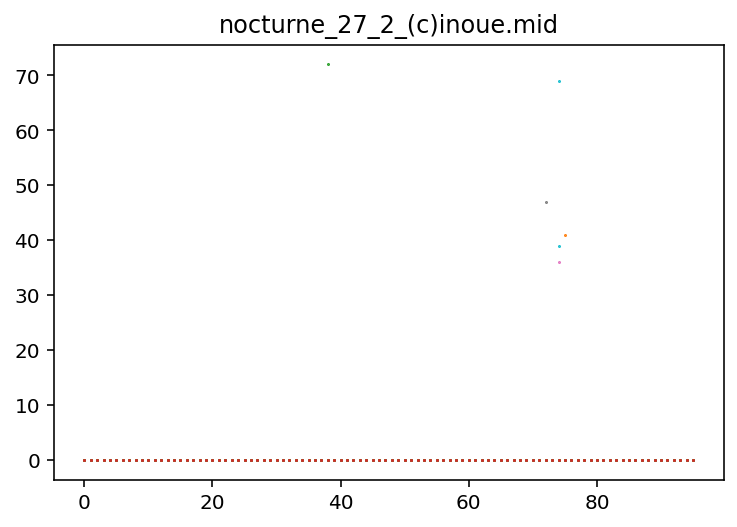

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


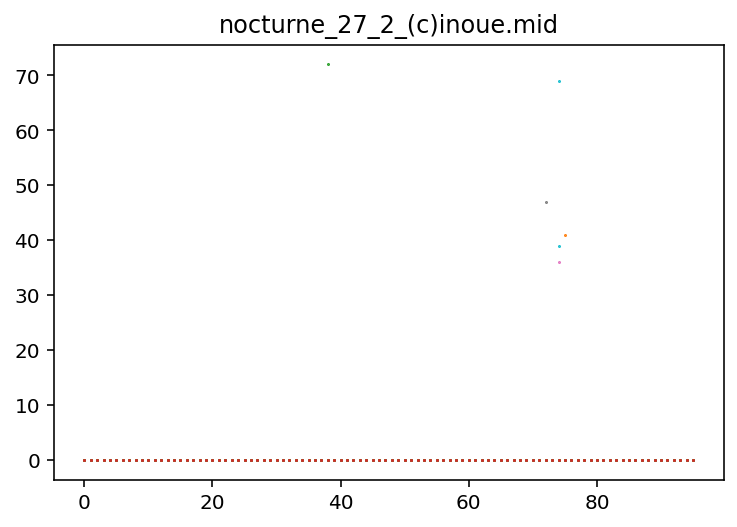

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


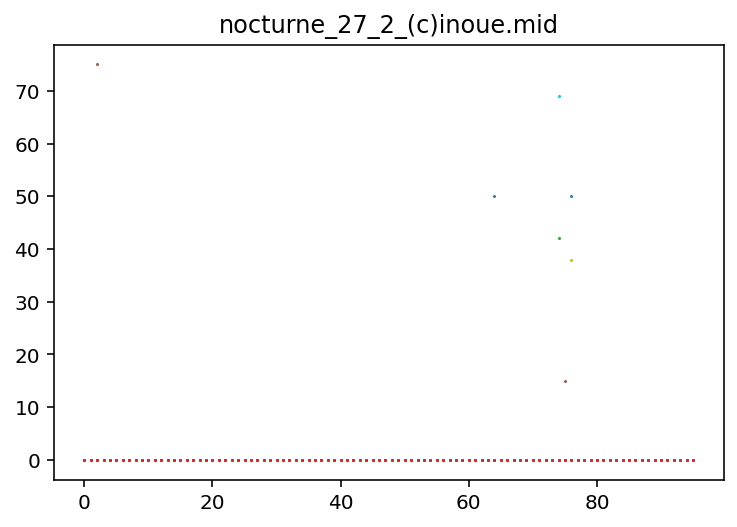

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


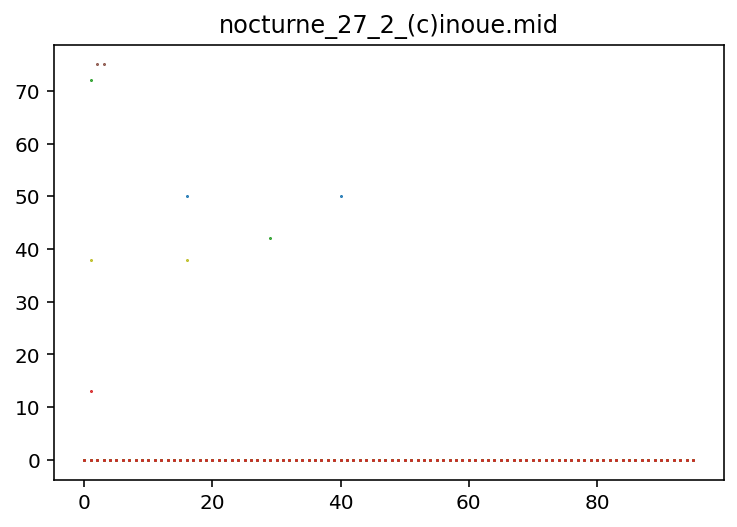

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


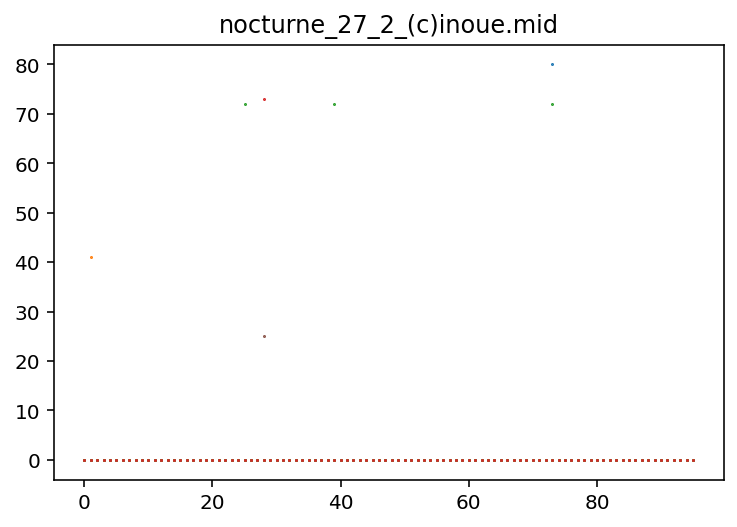

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


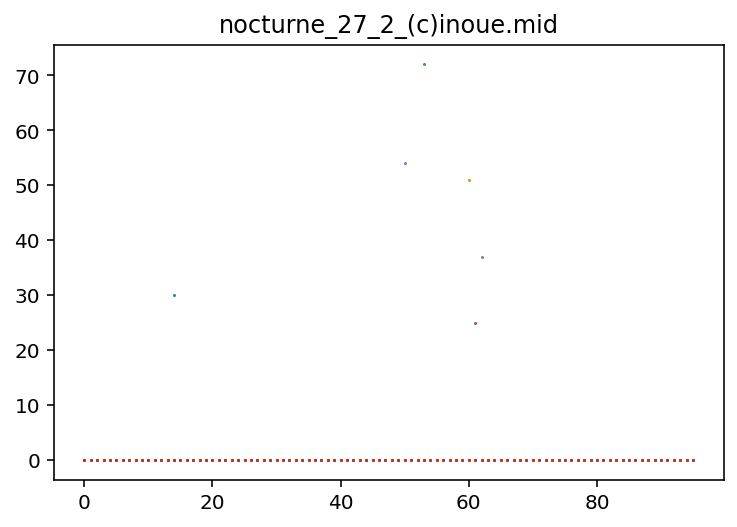

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


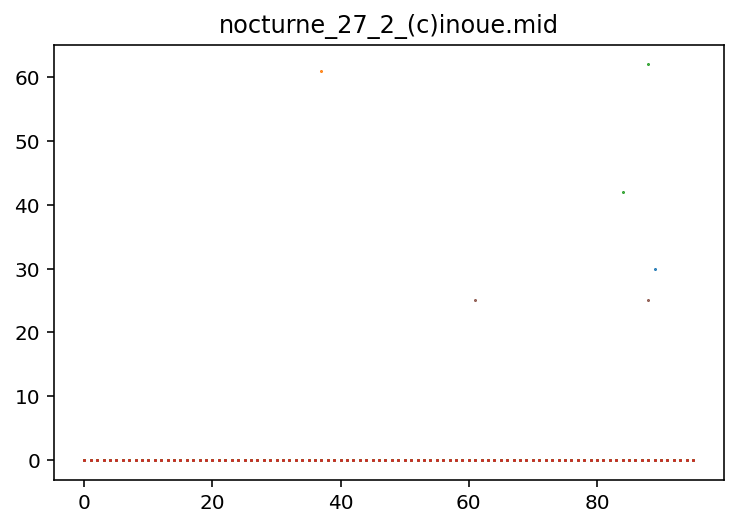

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


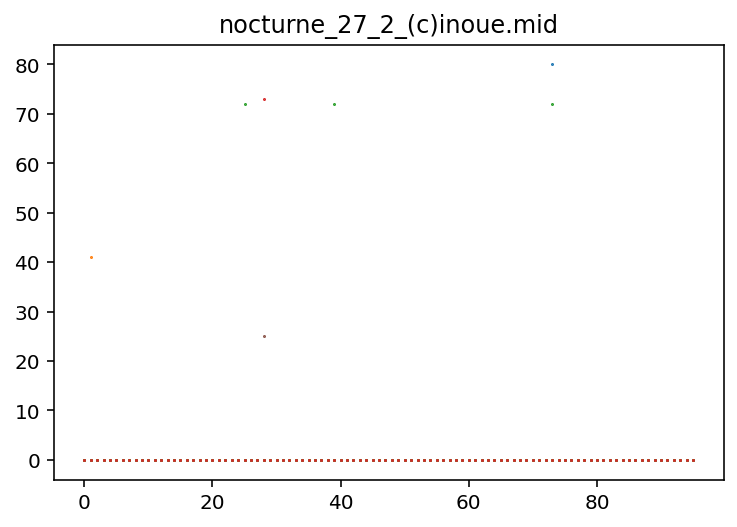

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


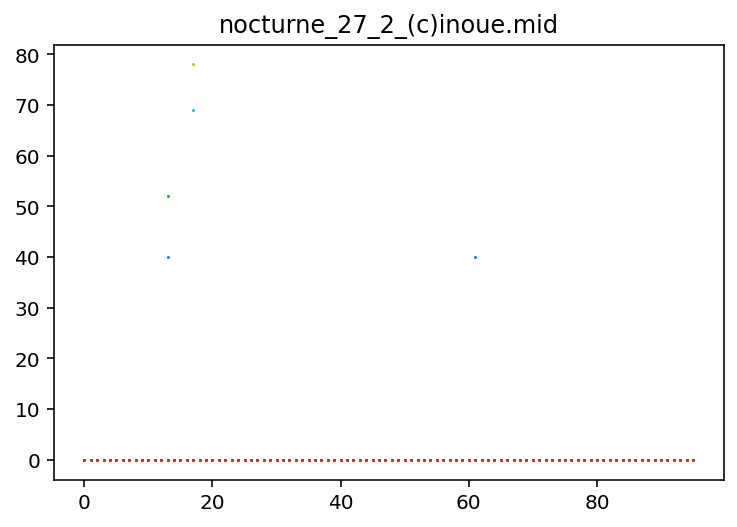

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


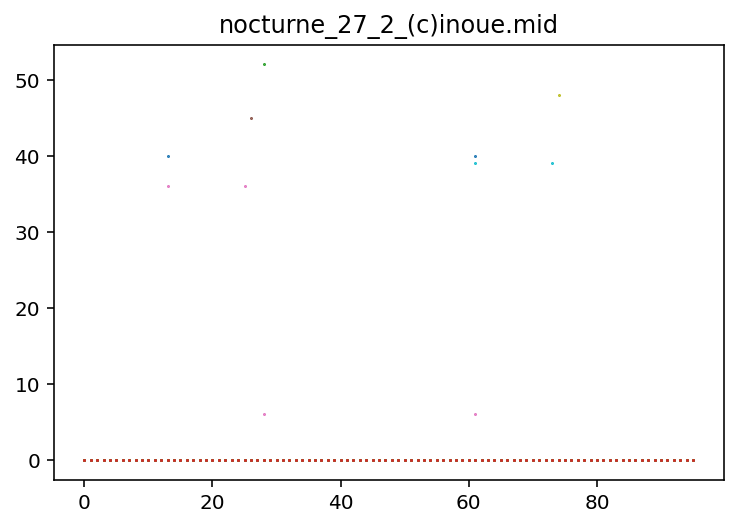

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


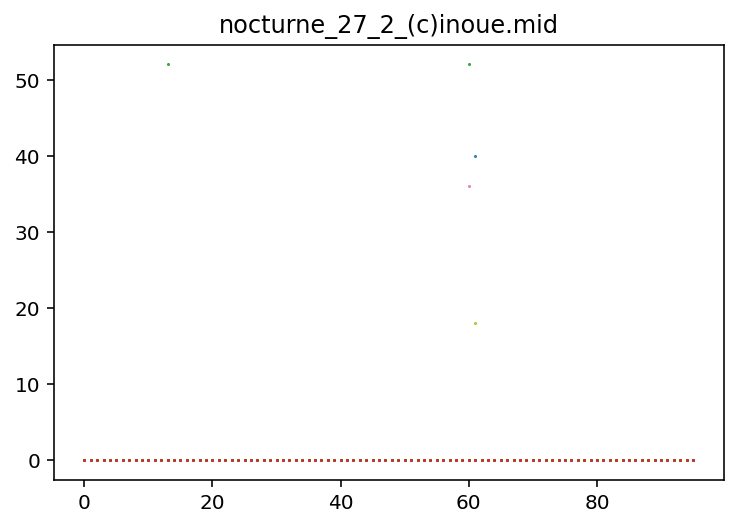

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


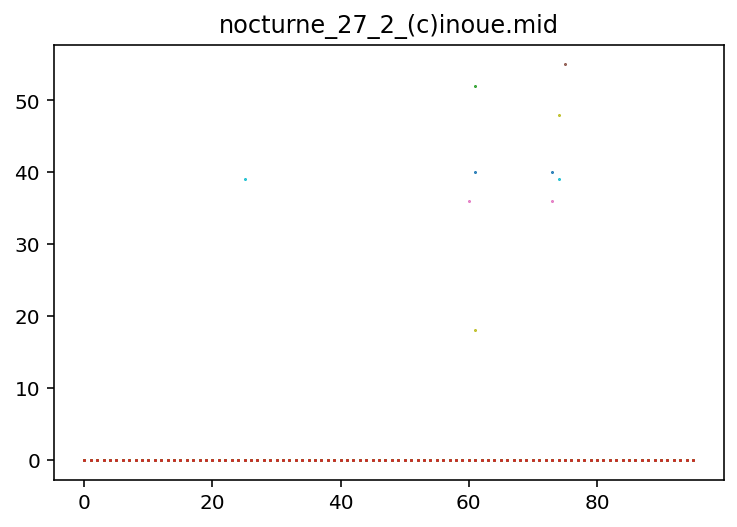

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


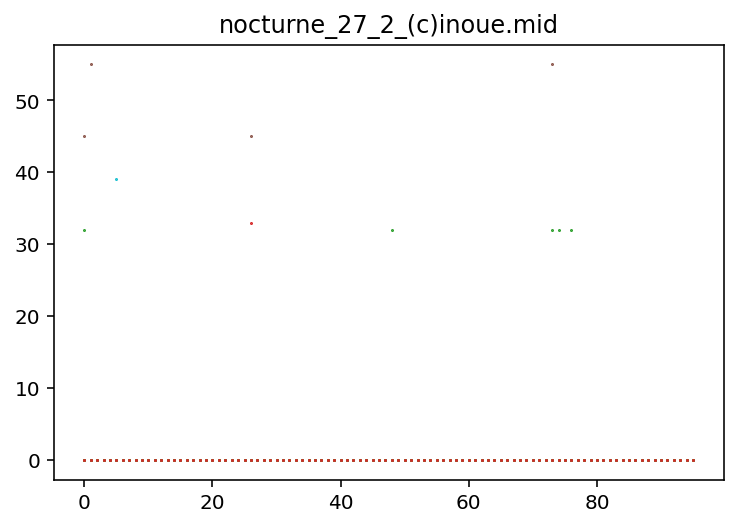

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


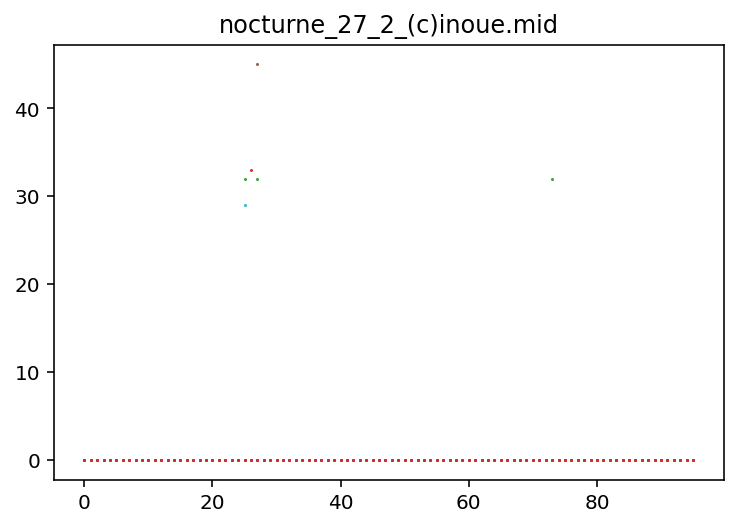

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


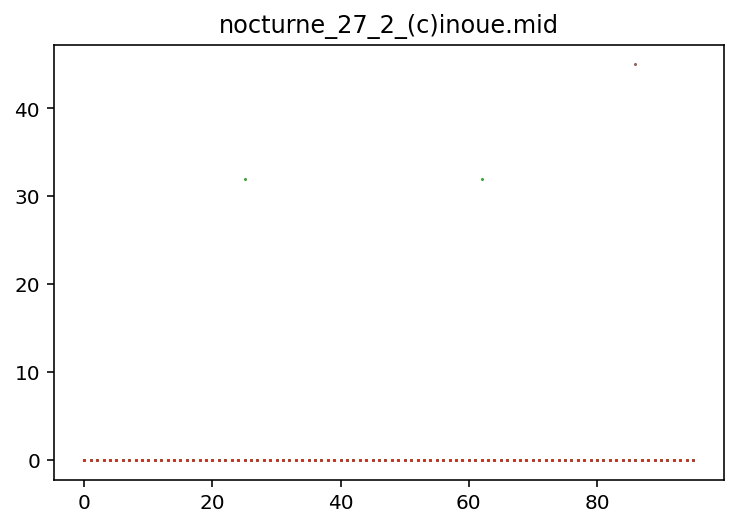

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


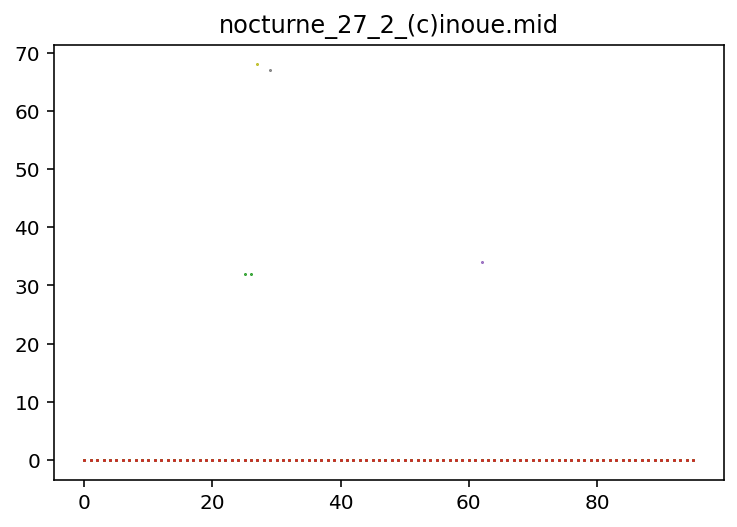

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


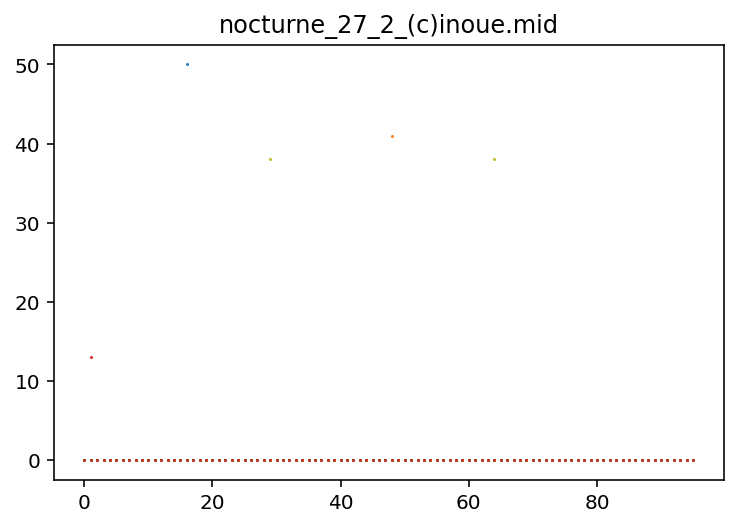

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


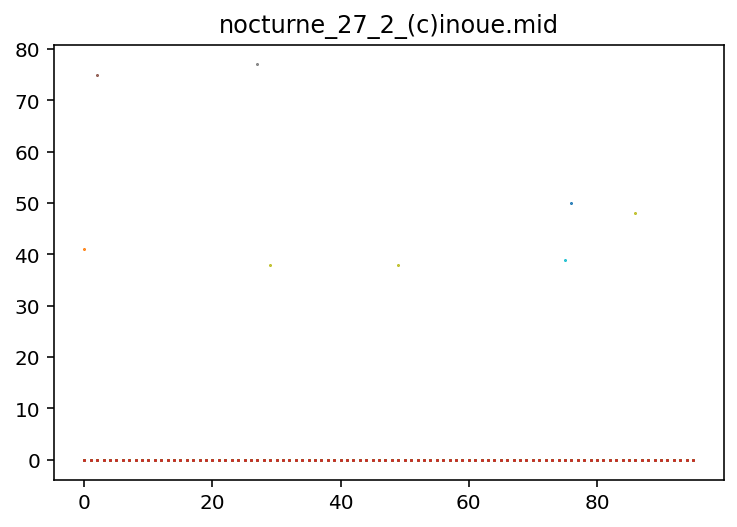

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


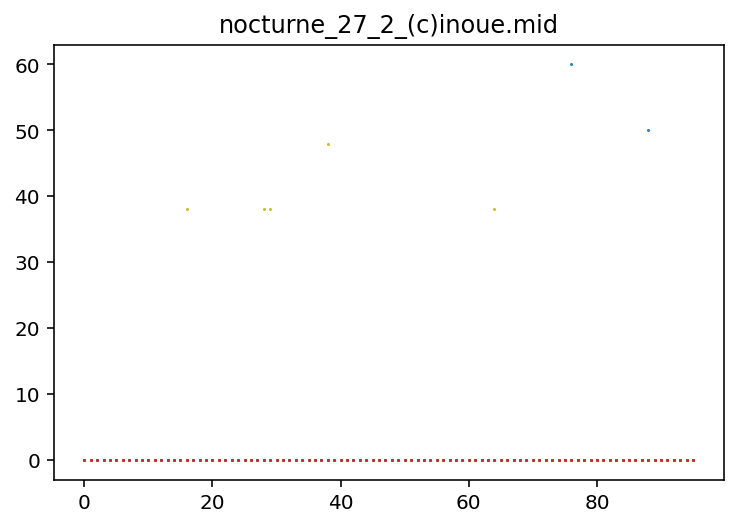

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


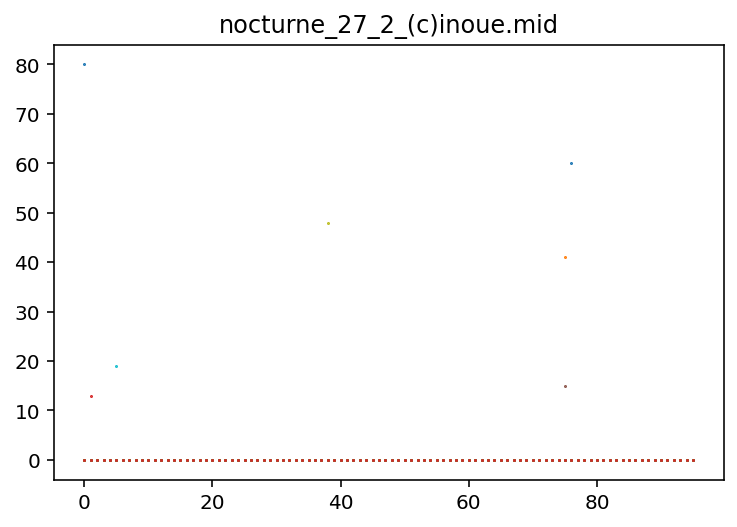

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


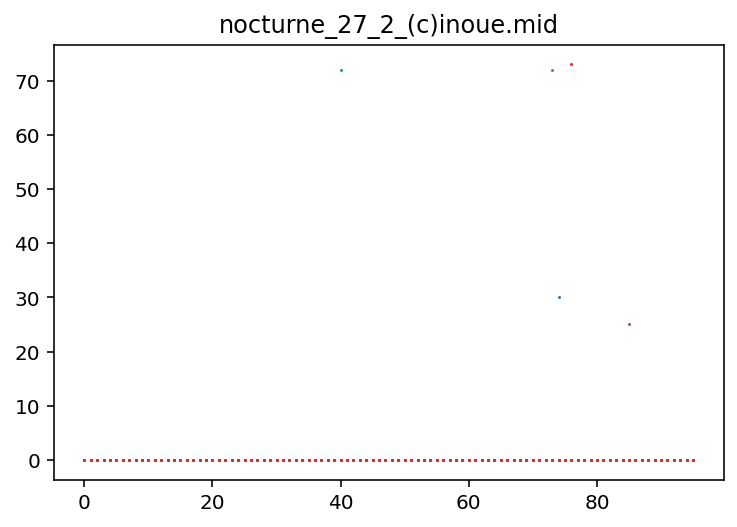

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


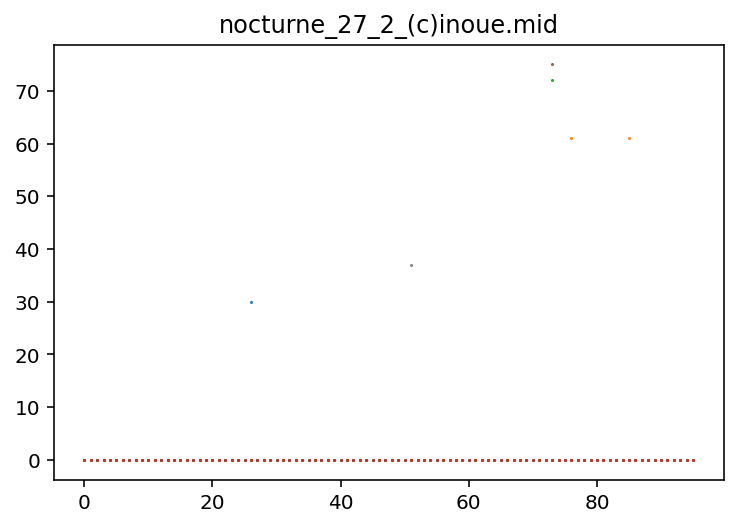

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


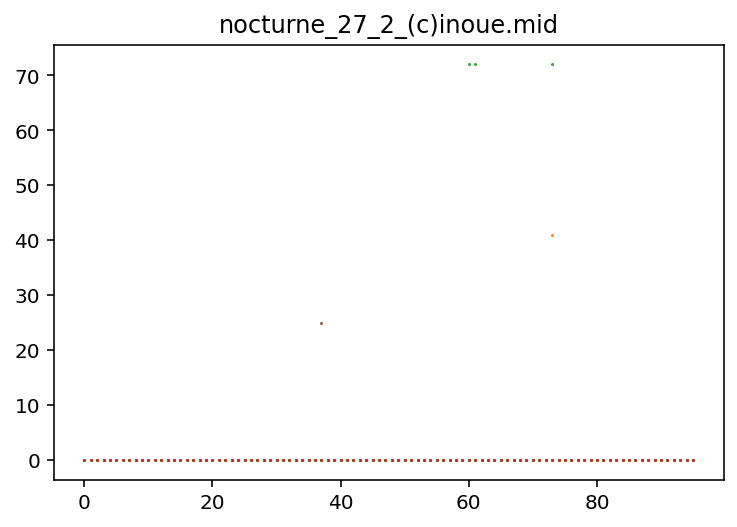

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


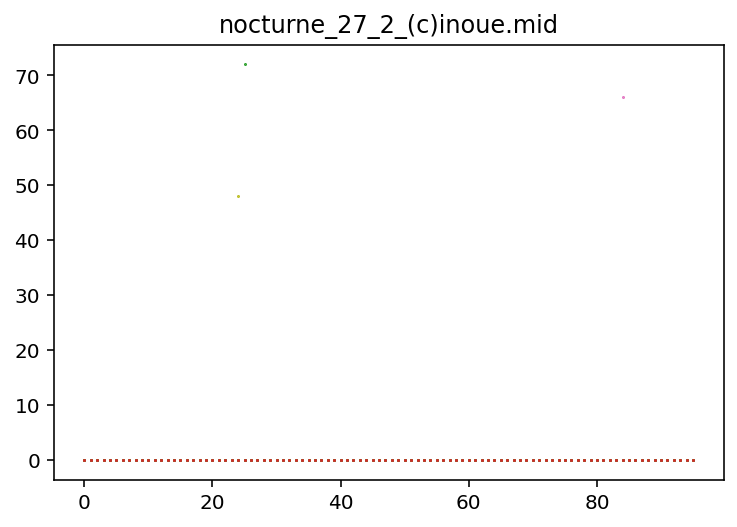

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


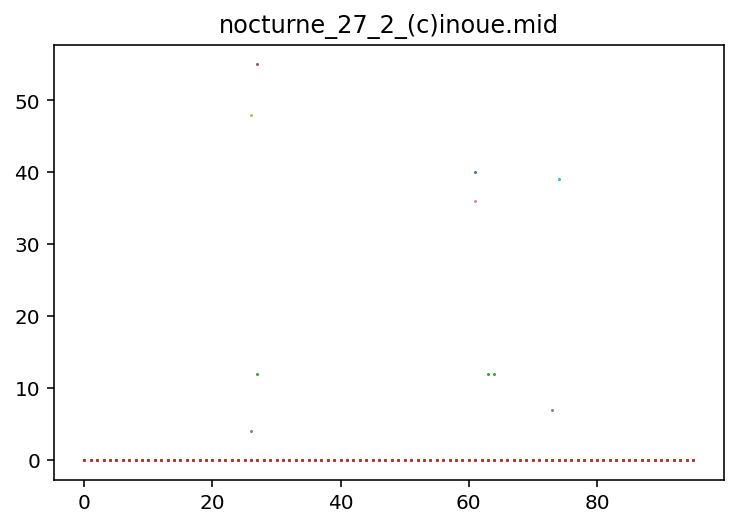

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


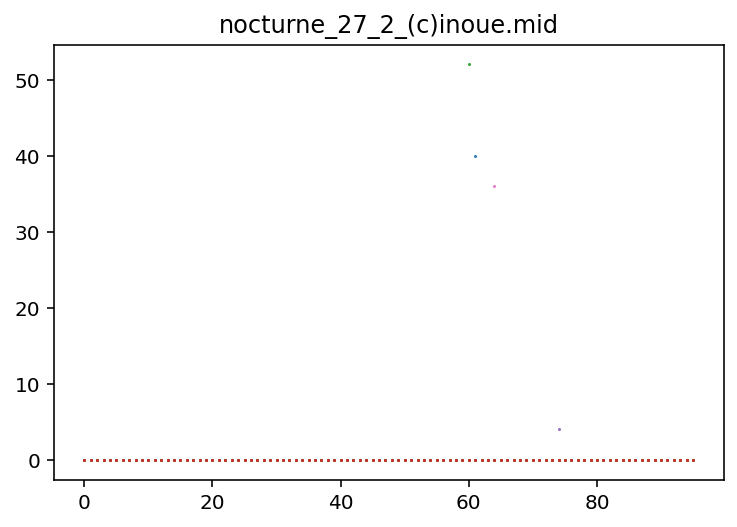

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


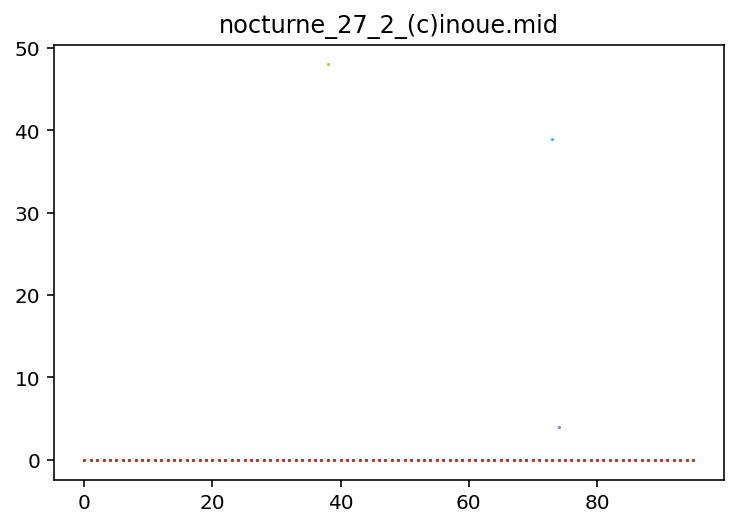

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


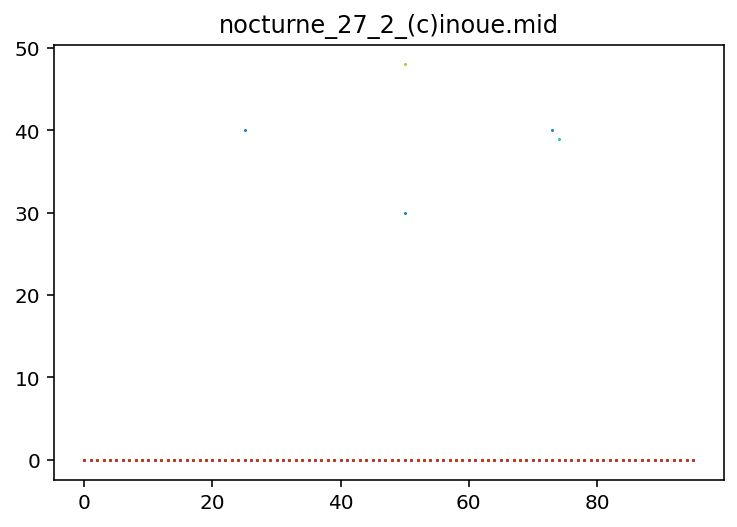

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


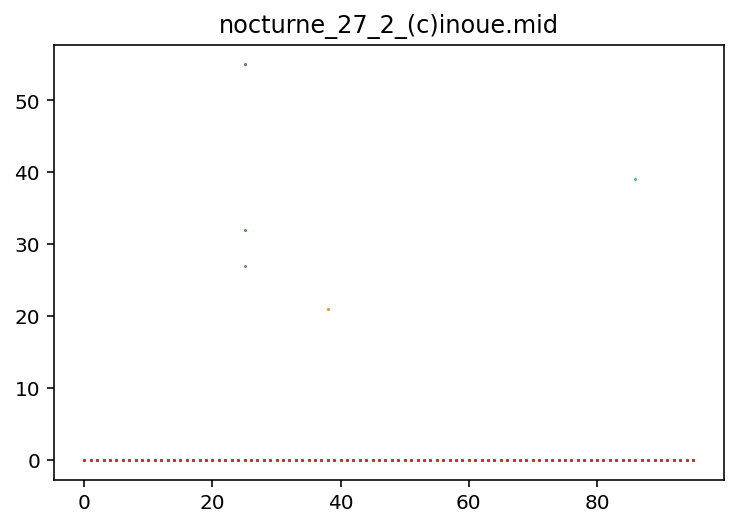

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


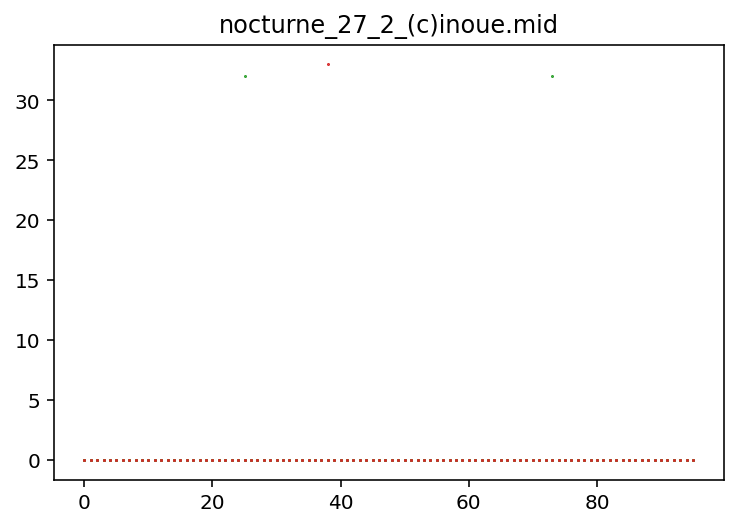

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


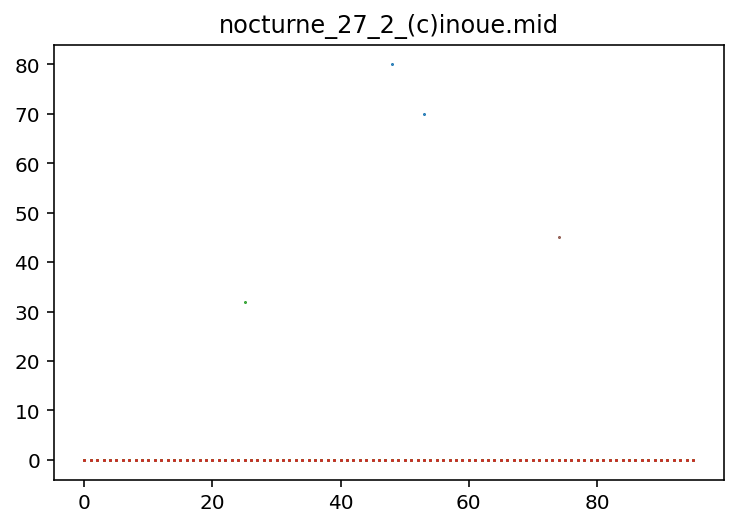

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


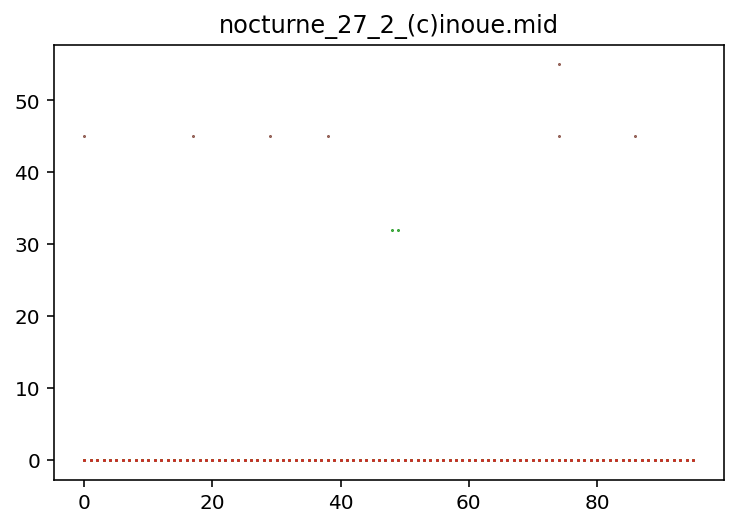

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


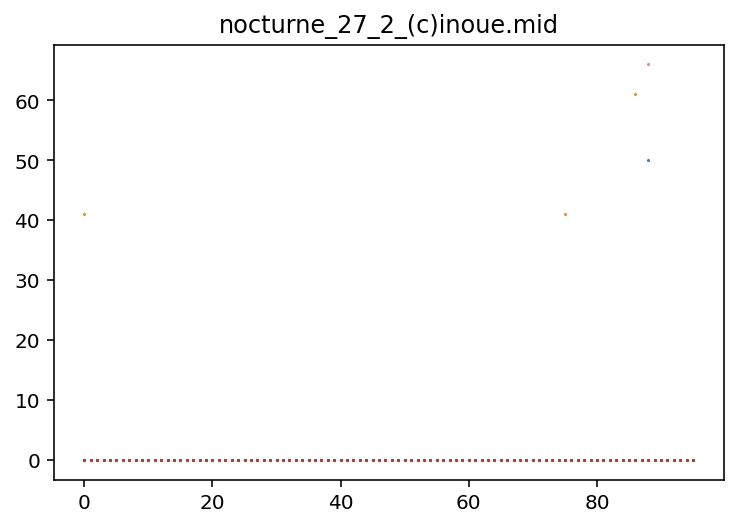

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


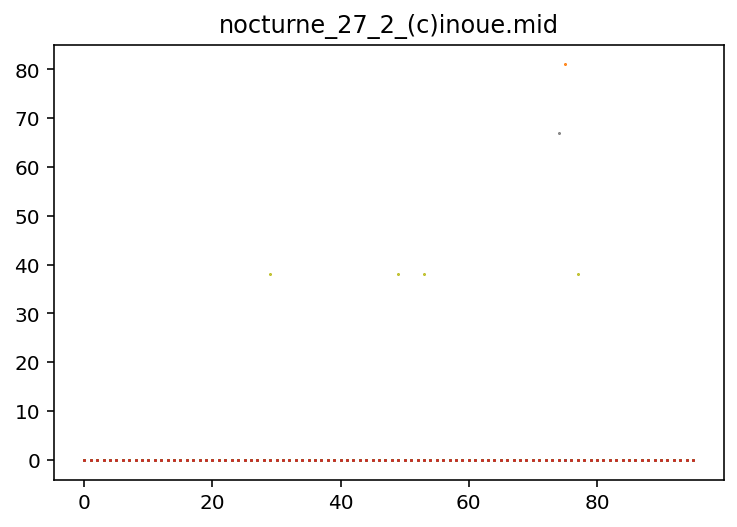

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


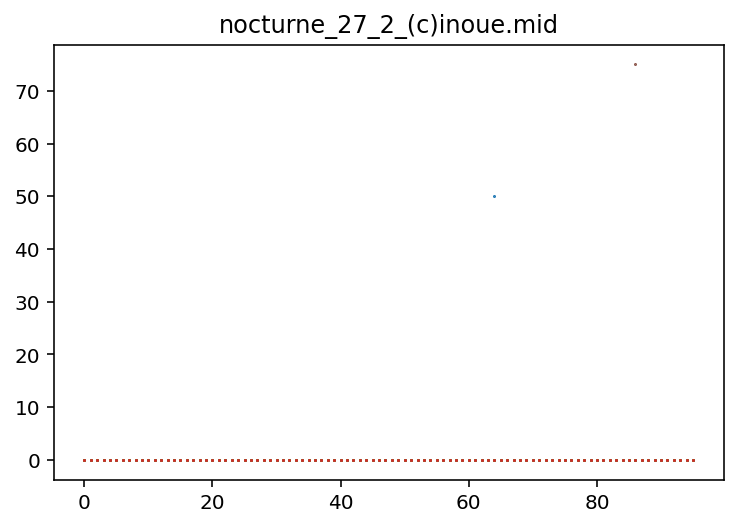

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


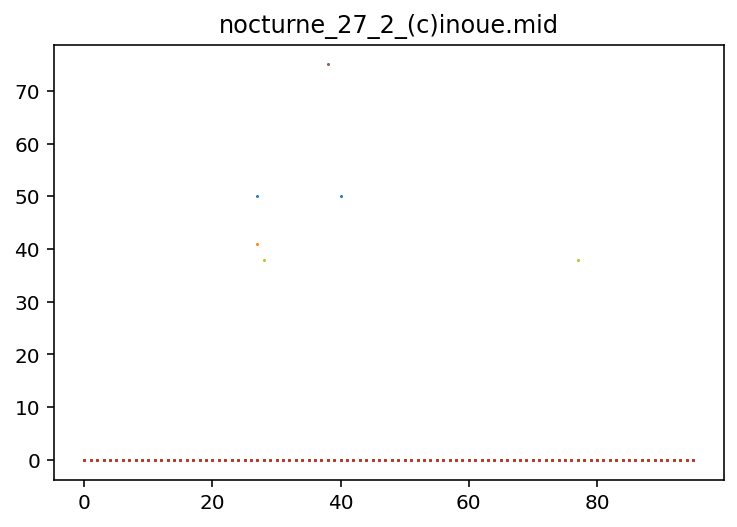

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


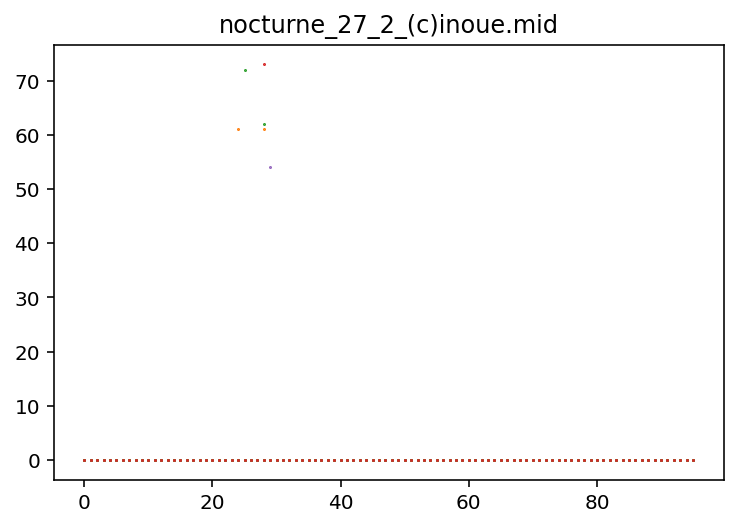

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


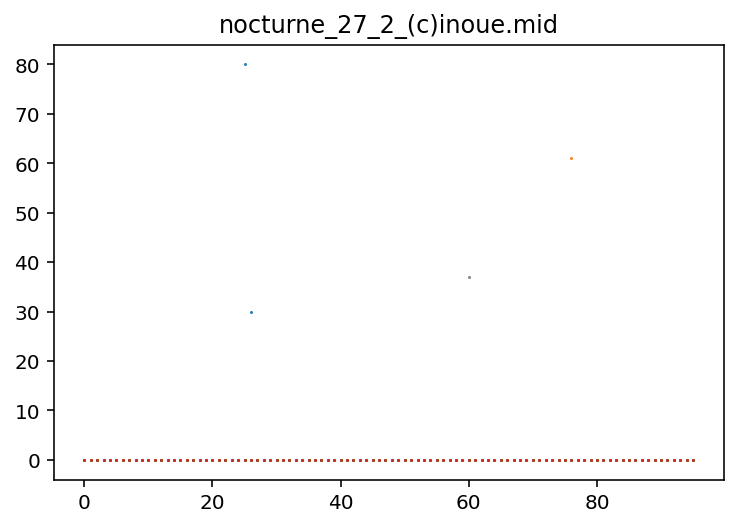

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


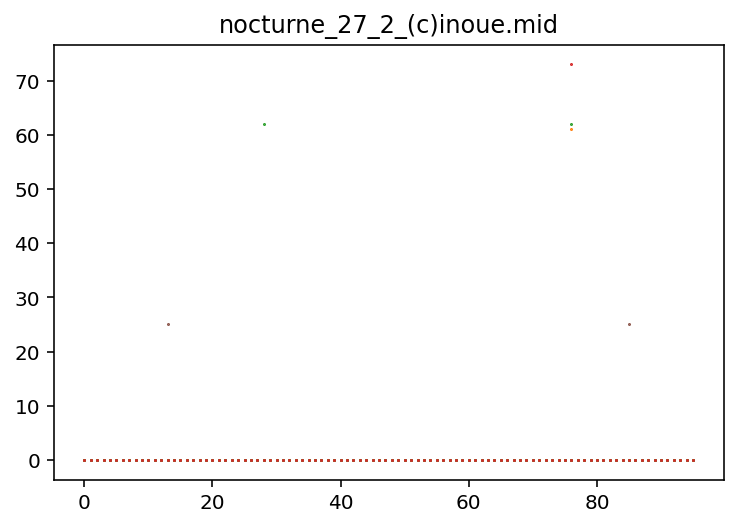

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


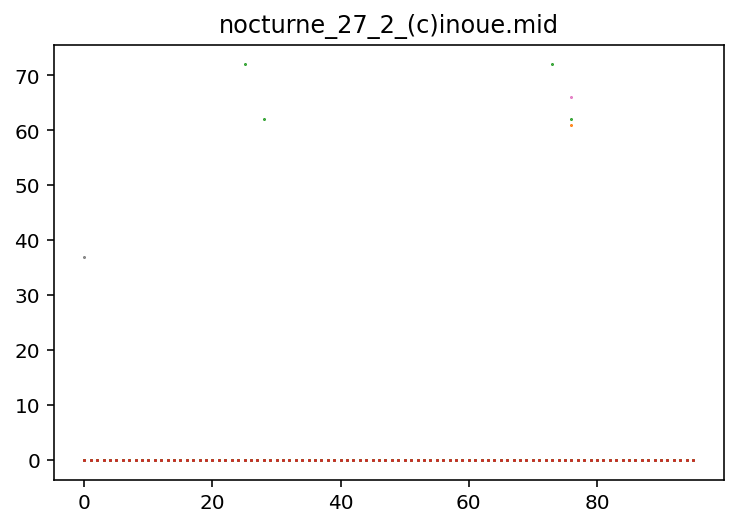

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


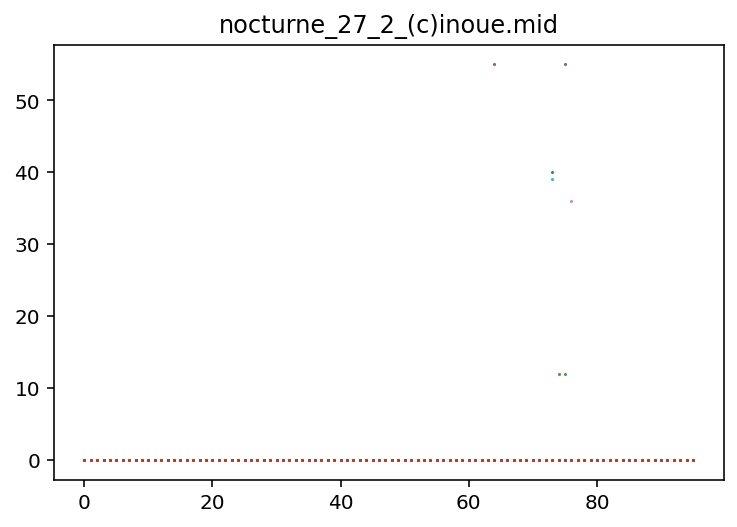

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


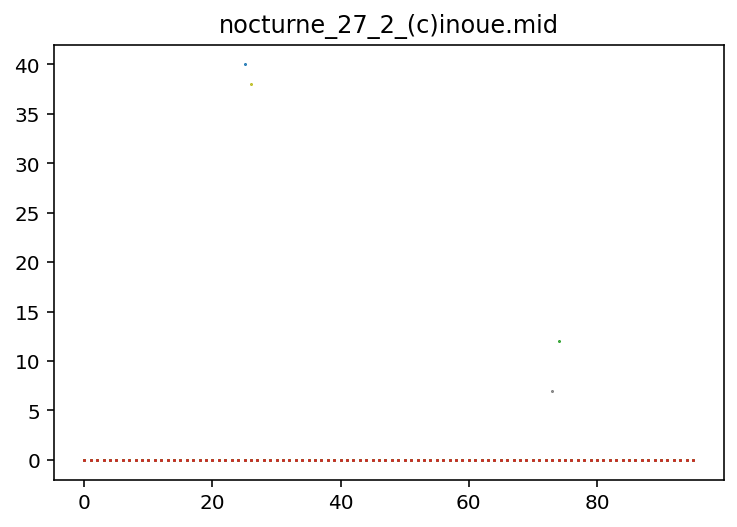

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


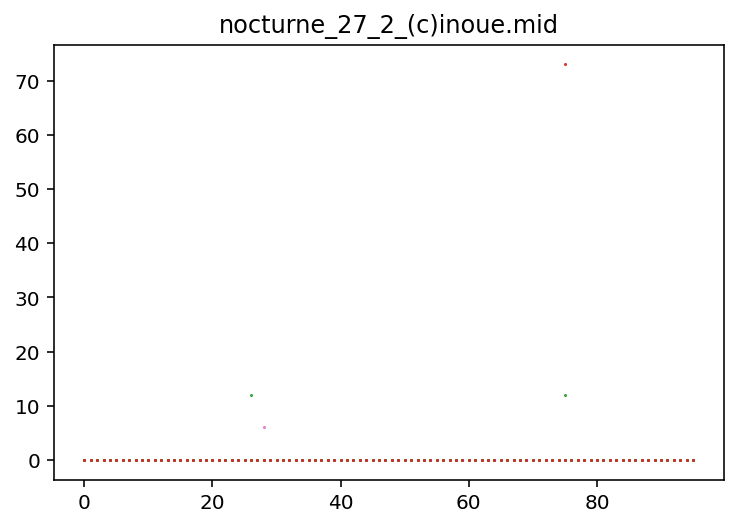

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


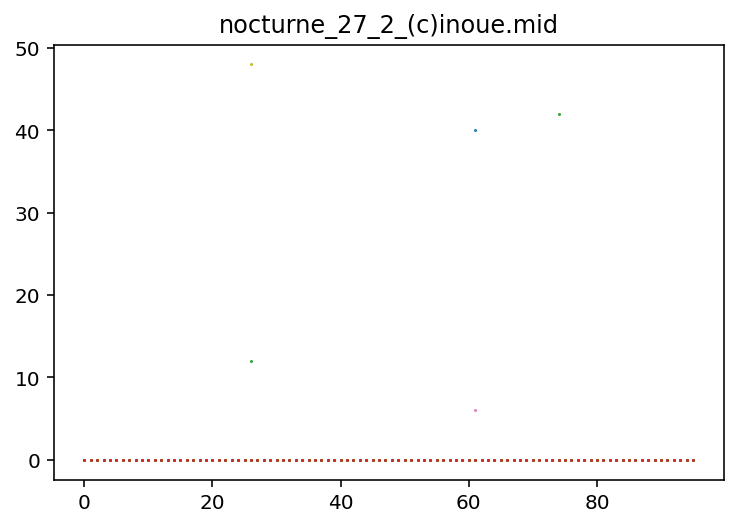

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


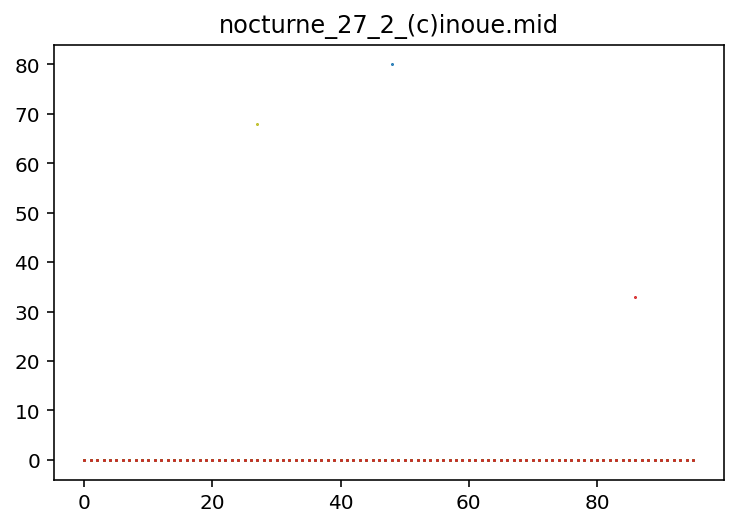

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


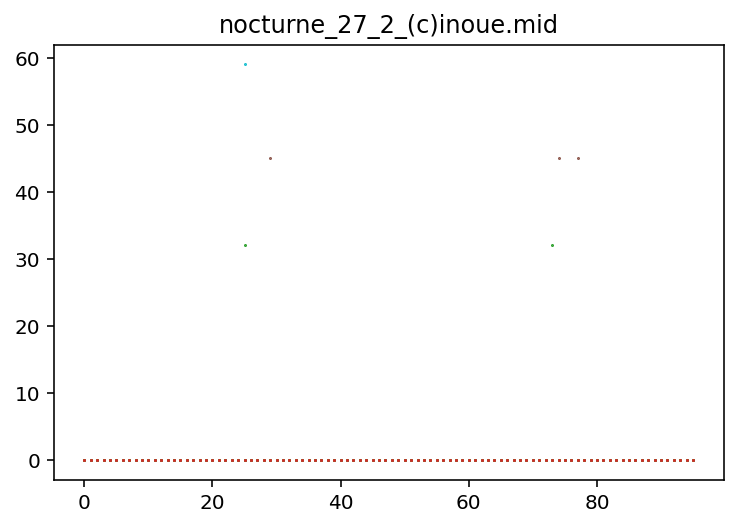

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


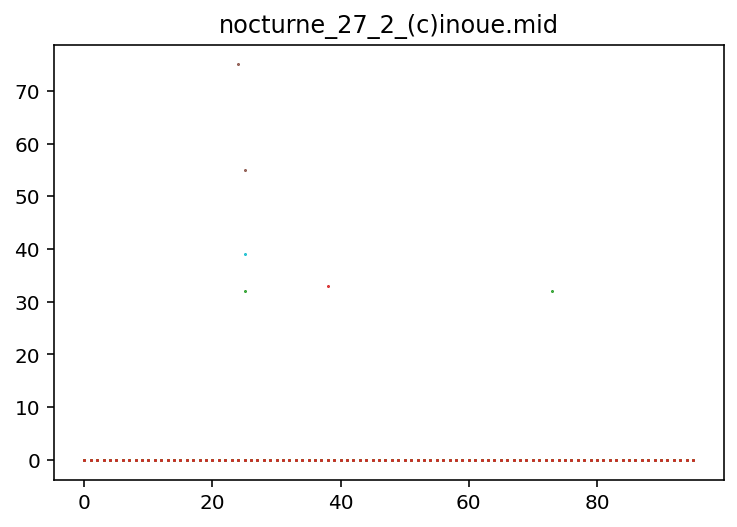

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


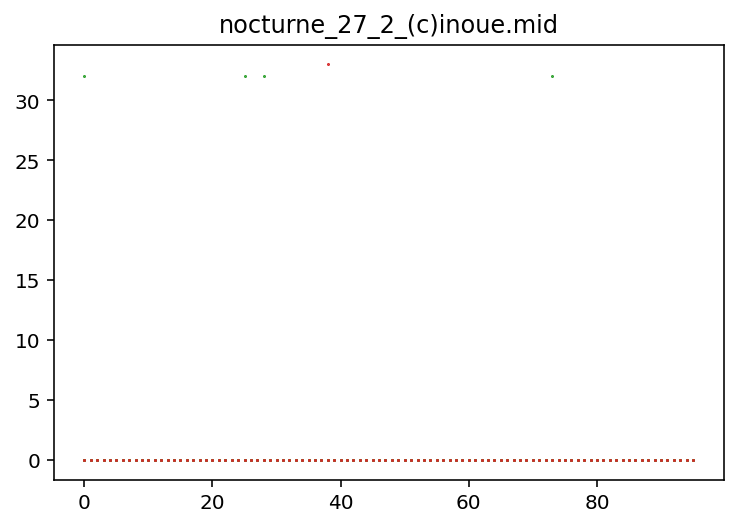

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


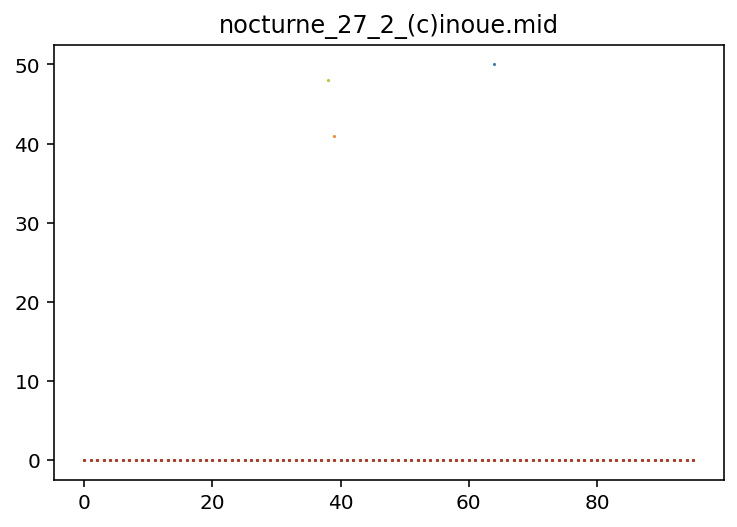

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


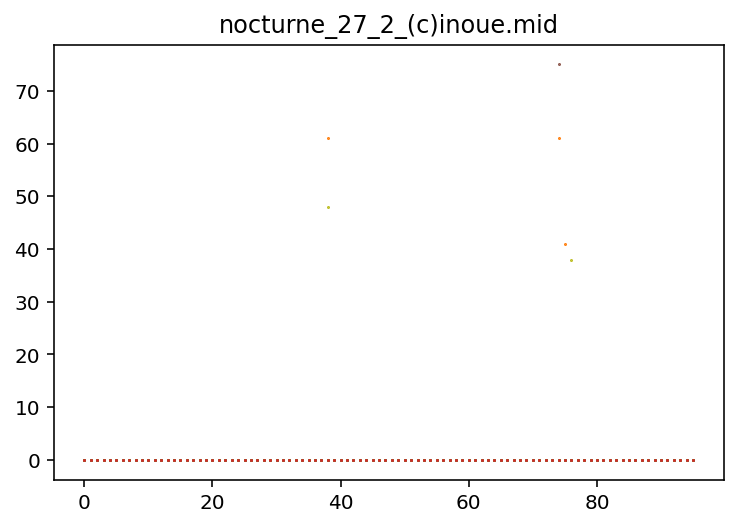

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


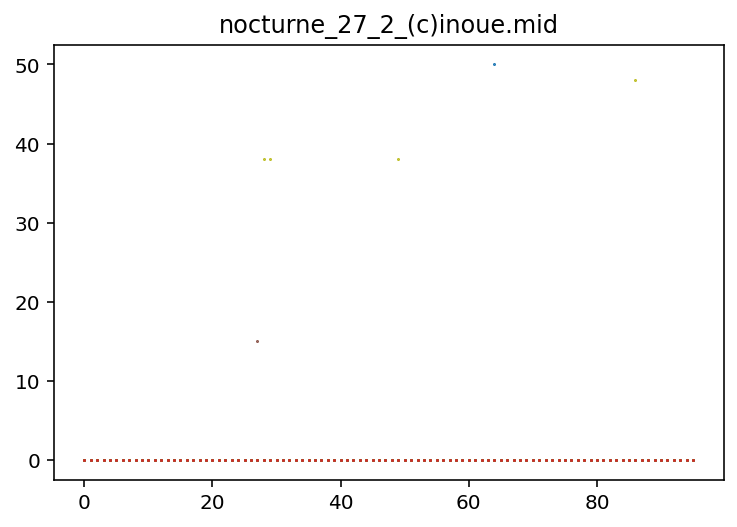

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


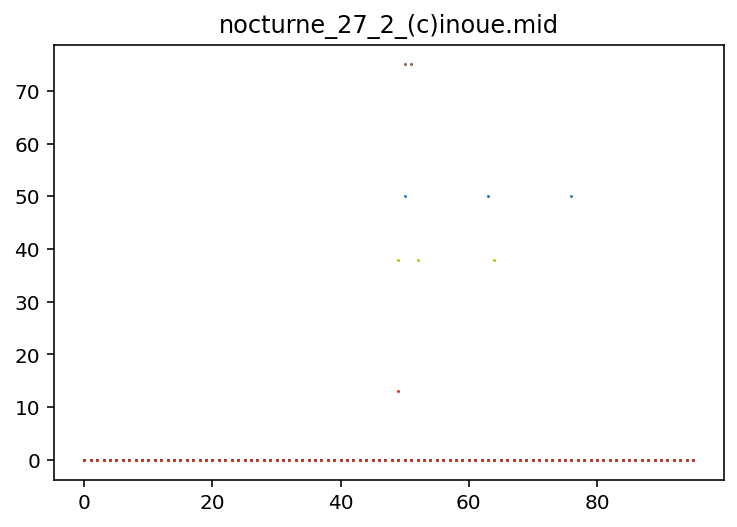

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


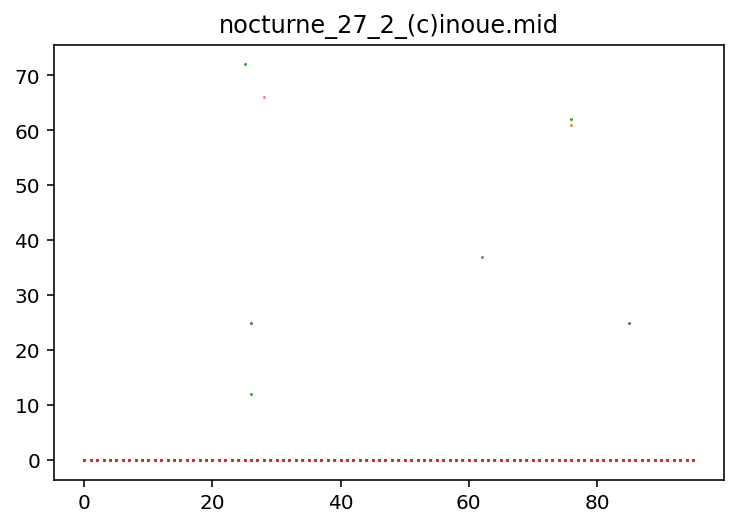

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


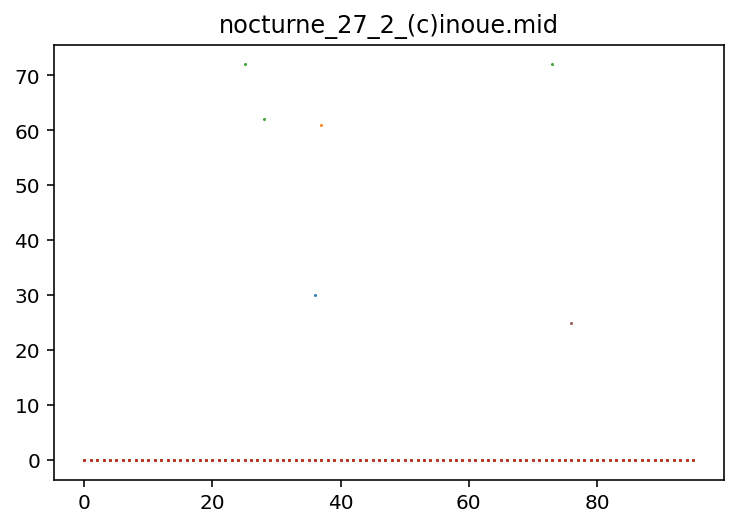

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


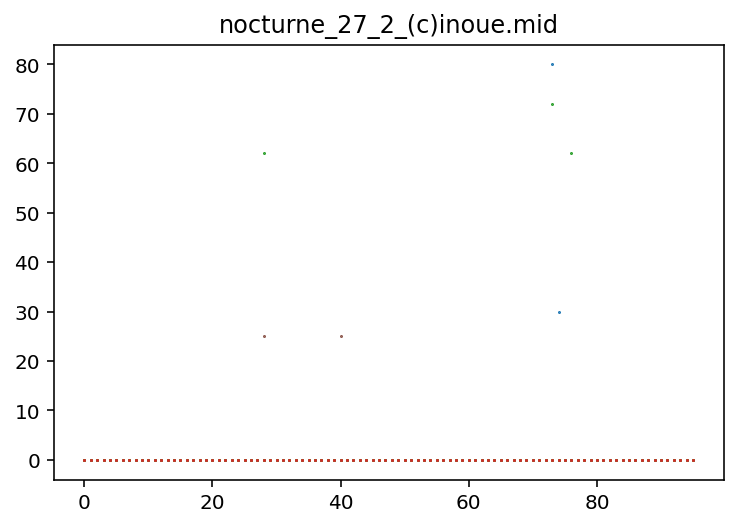

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


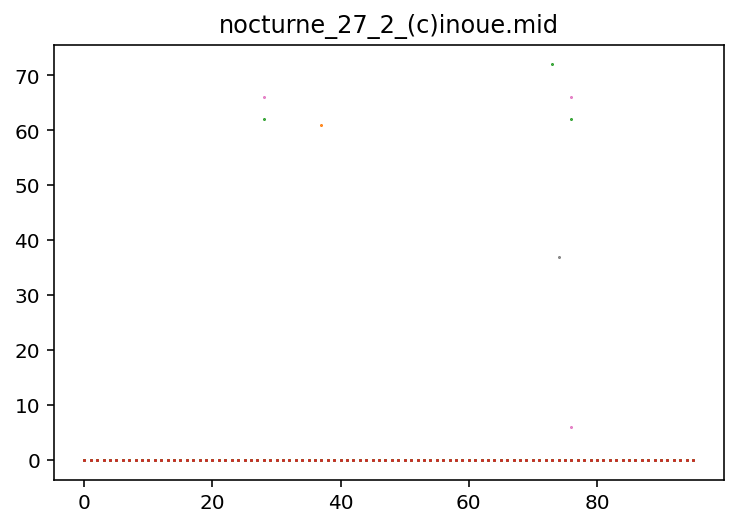

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


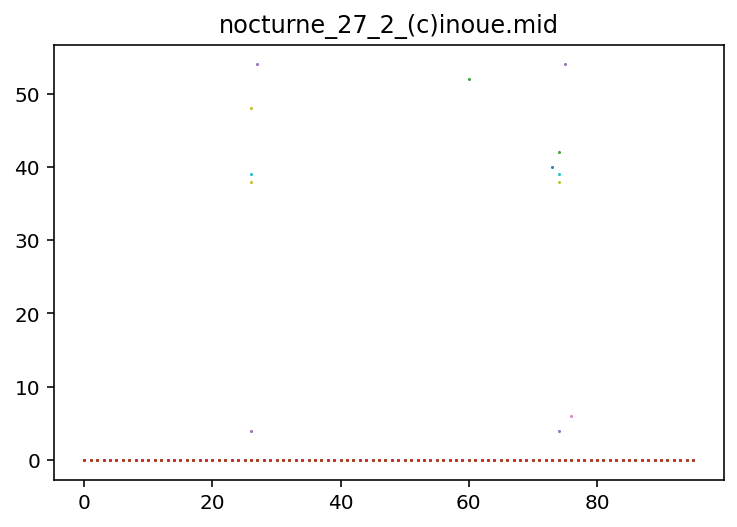

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


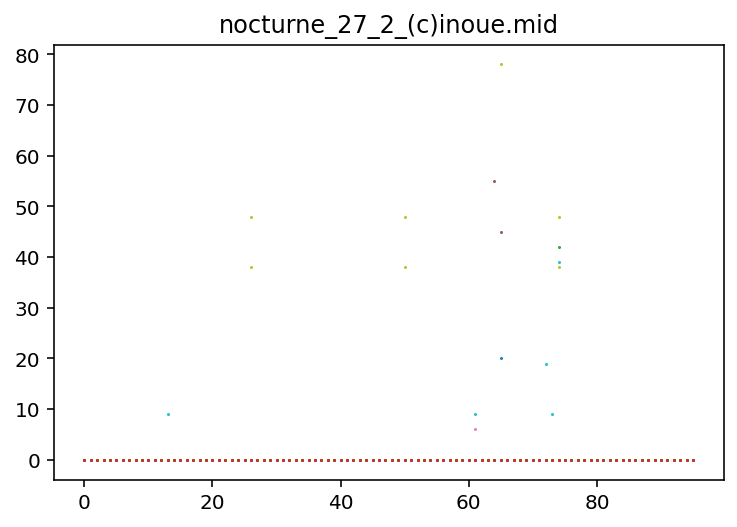

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


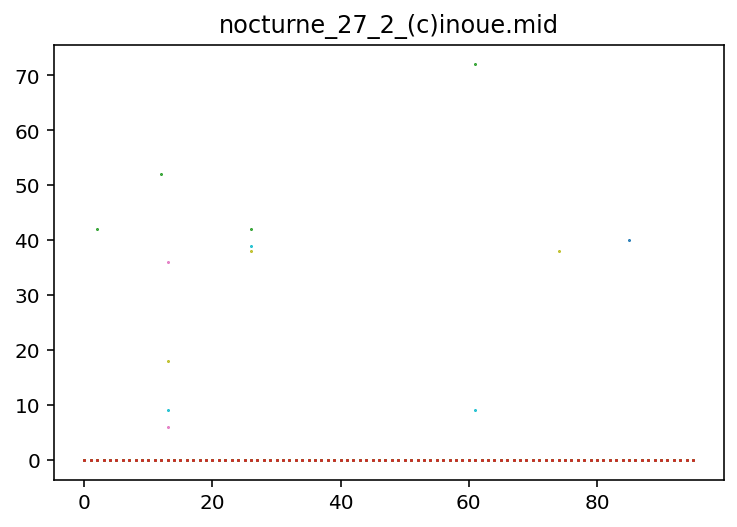

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


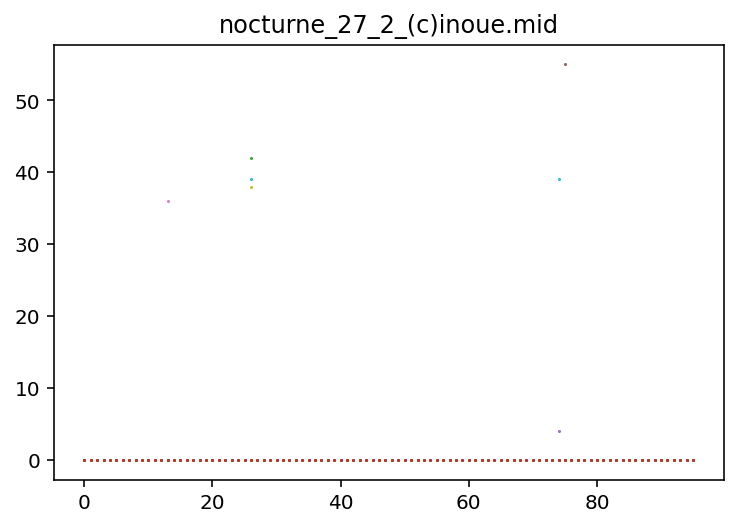

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


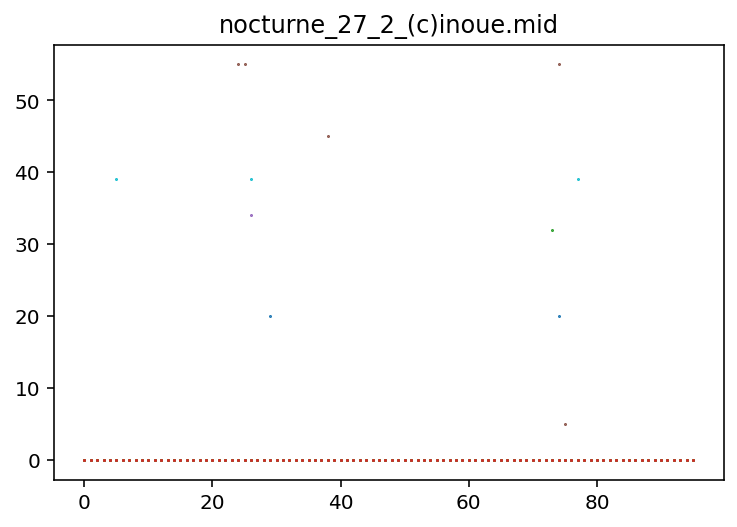

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


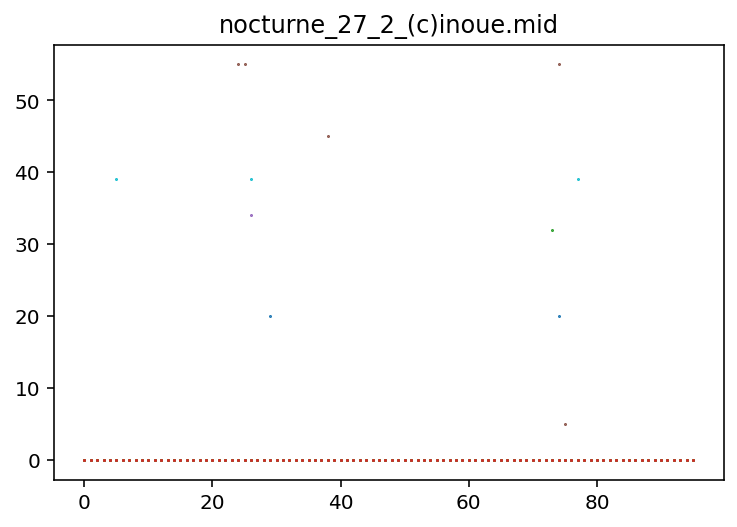

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


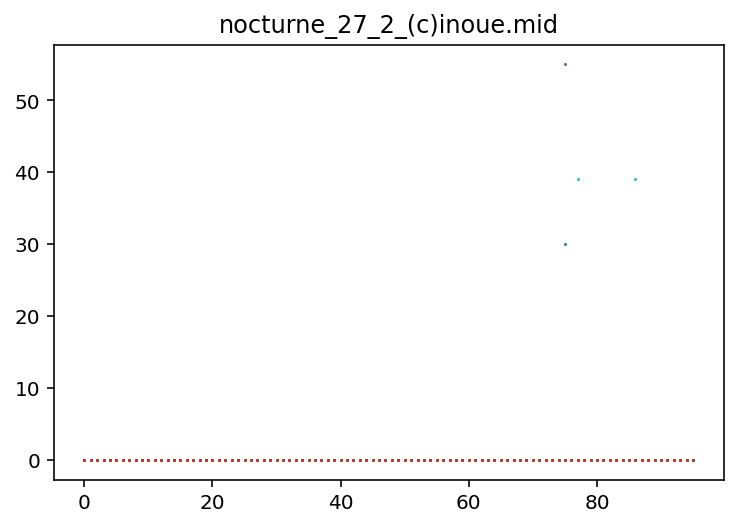

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


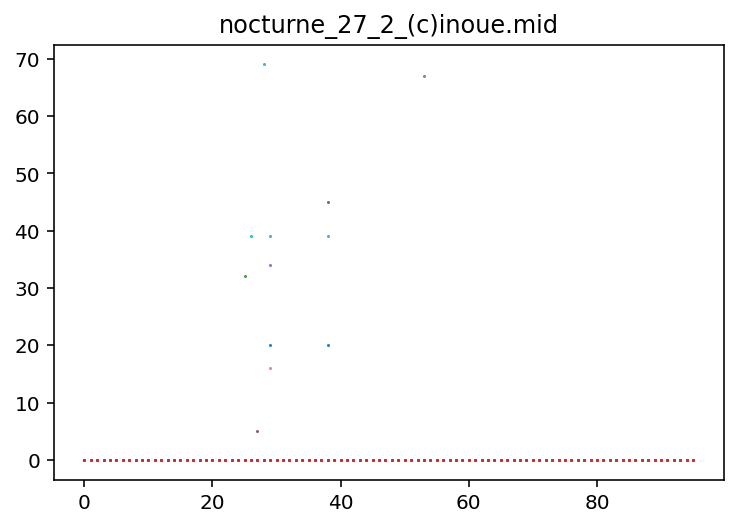

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


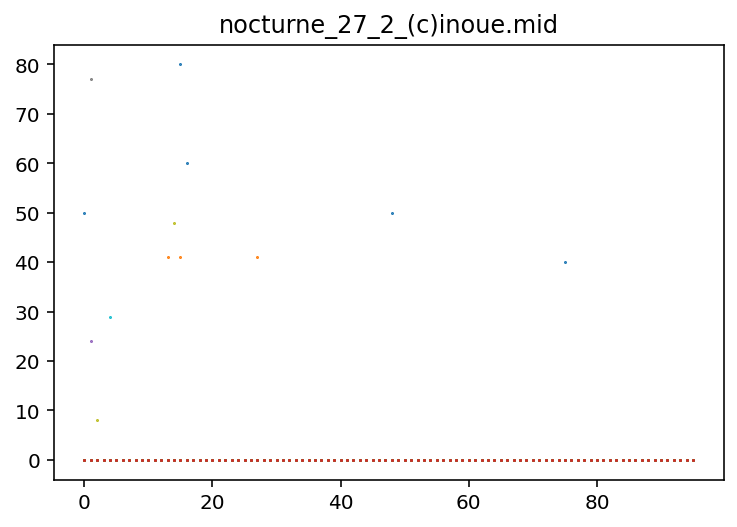

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


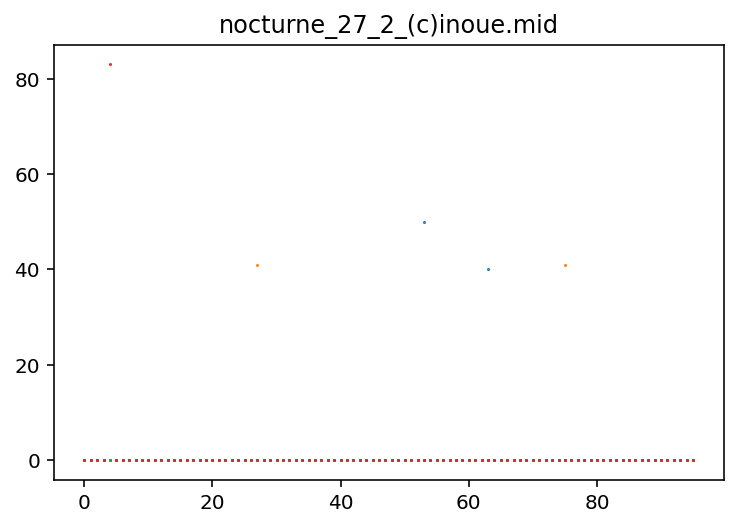

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


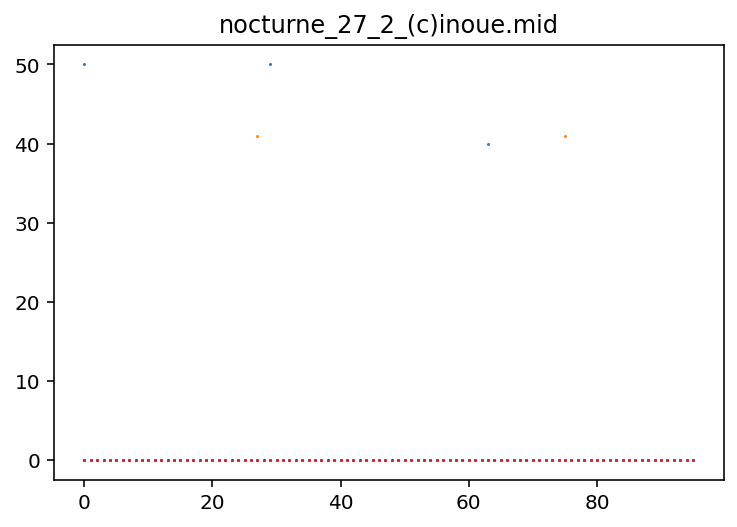

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


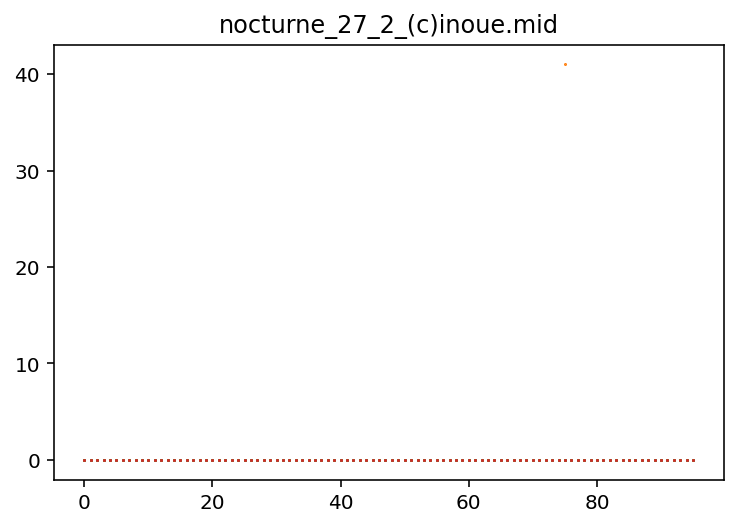

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


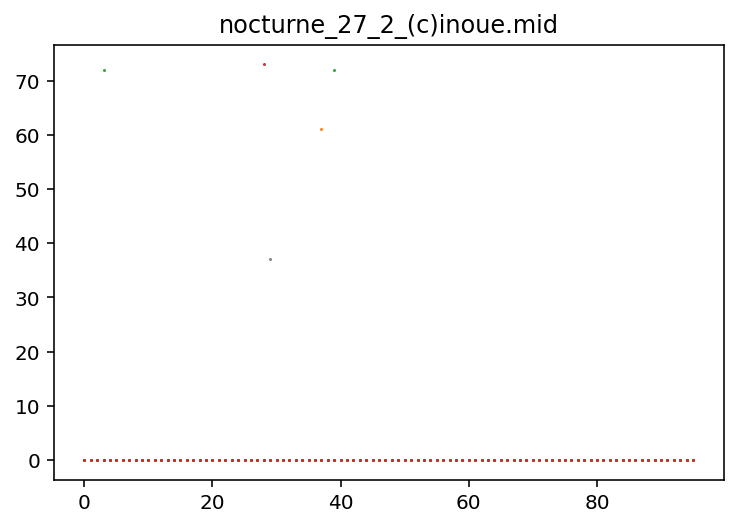

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


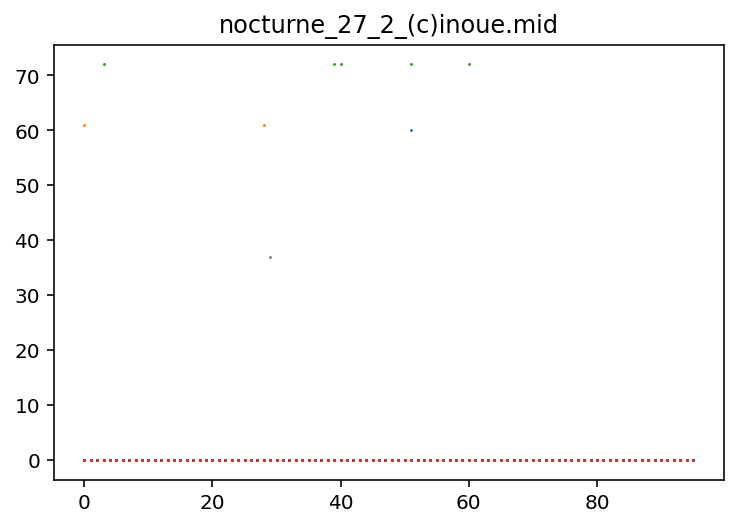

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


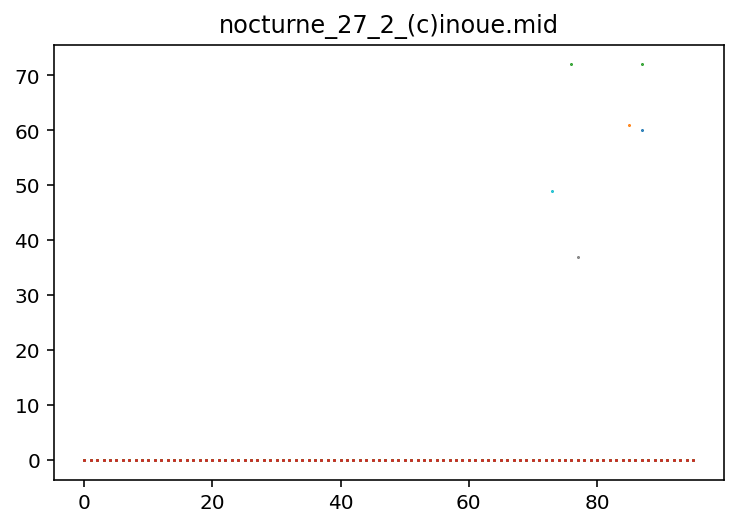

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


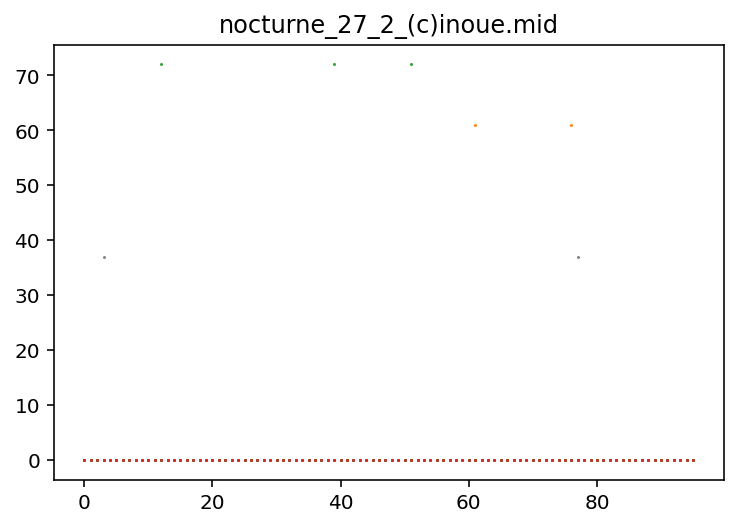

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [27]:
for i in range(Data.shape[0] - 1):

    DDD = Data[i]
    print(DDD.shape)
    Q = compose(DDD)
    print(Q.shape)
    mid = tarry2mid(Q.astype('int32'))
    mid.save("results_v1/v1_epoch%d.mid" % (i*50))

In [28]:
Data = np.load('data_v2.pkl', allow_pickle=True)
print(Data.shape)


(64, 4, 40, 4, 96, 84)


(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


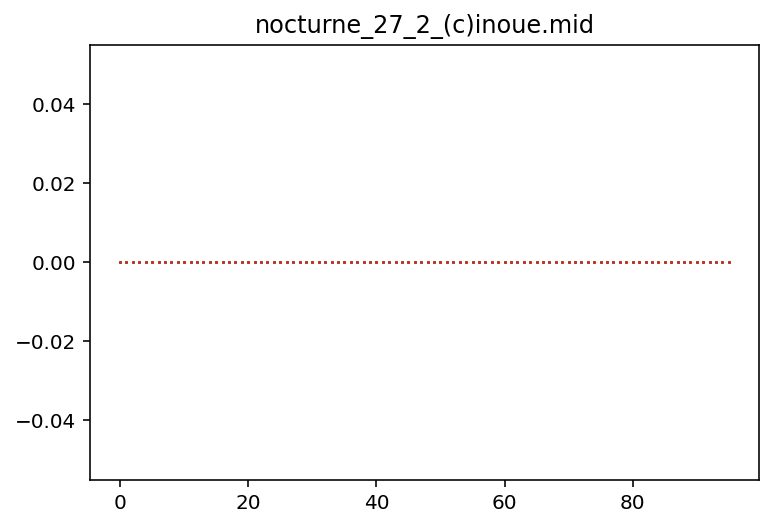

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


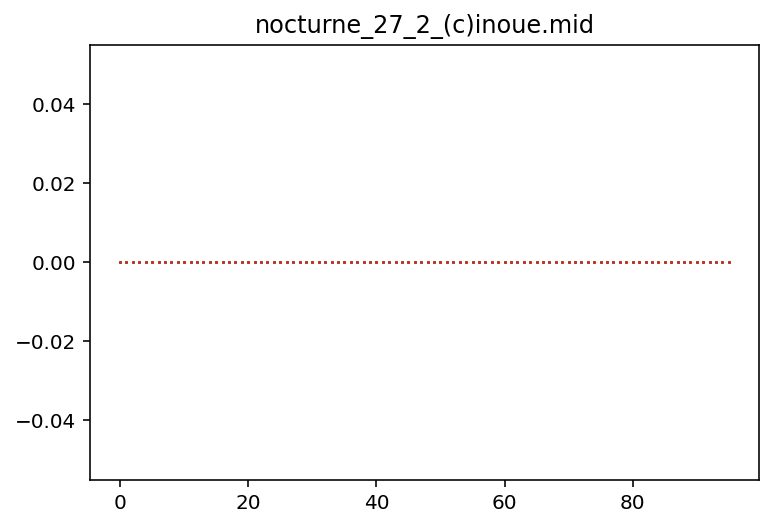

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


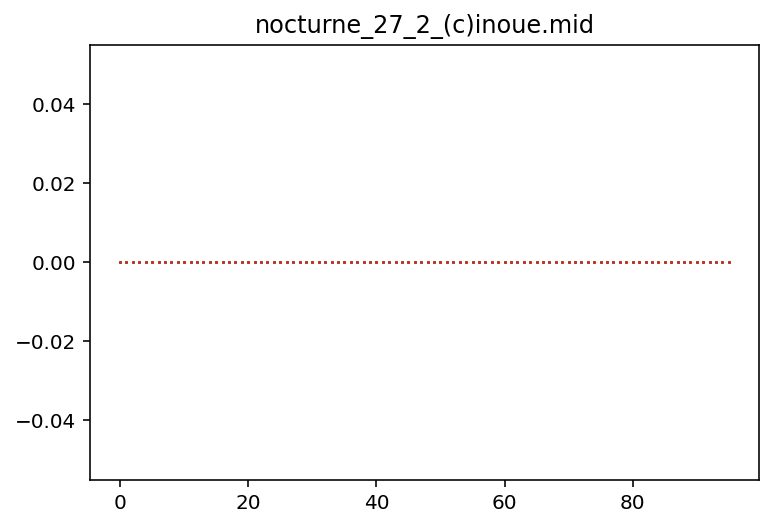

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


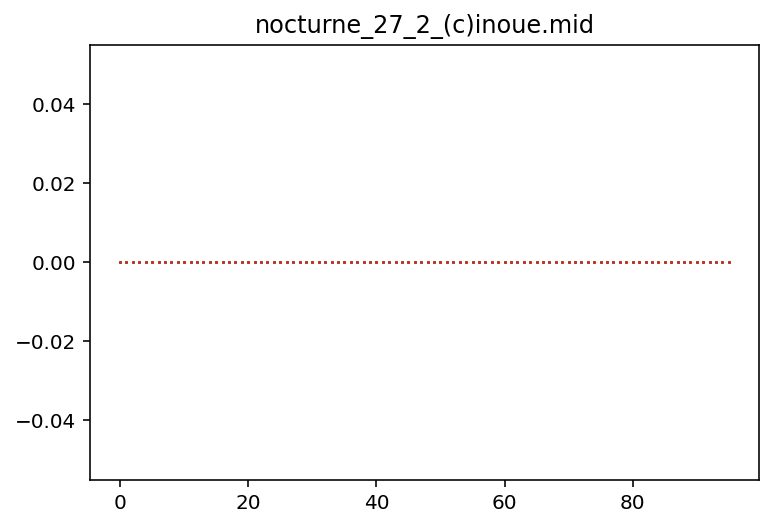

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


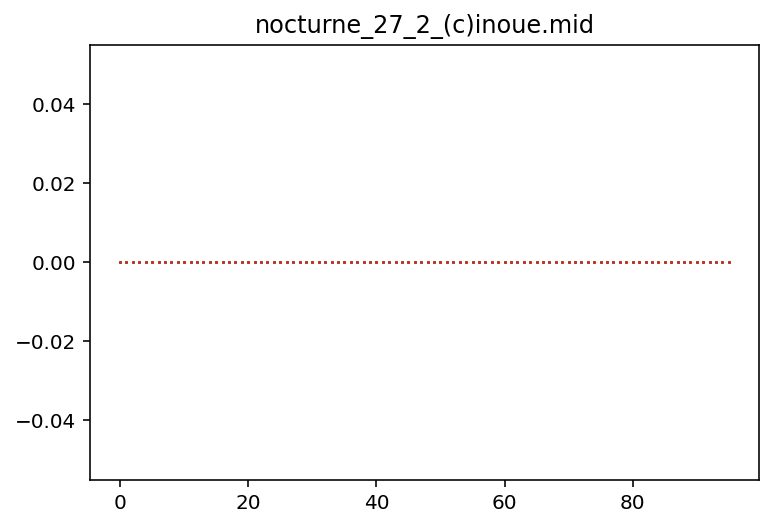

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


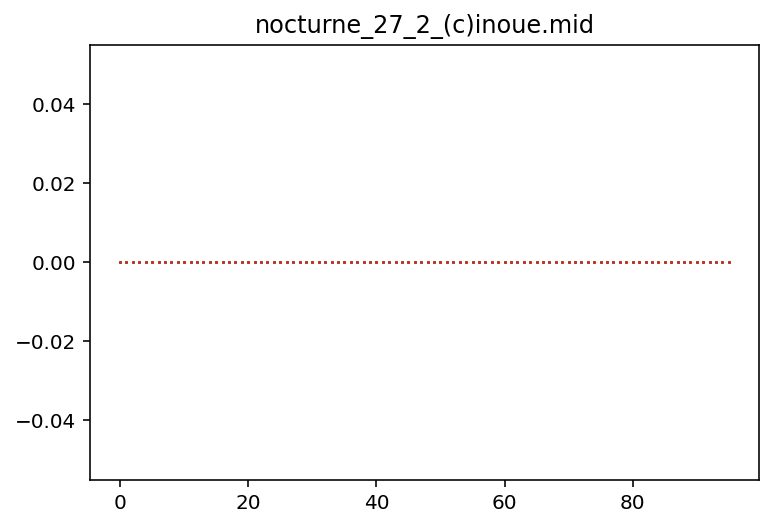

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


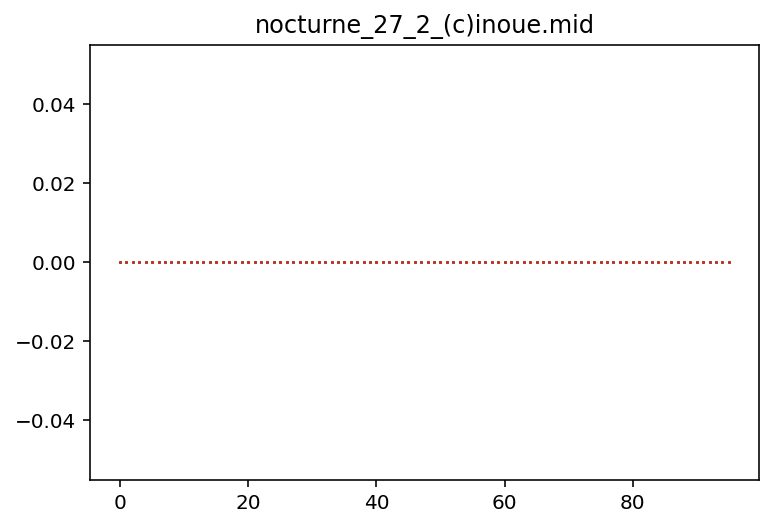

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


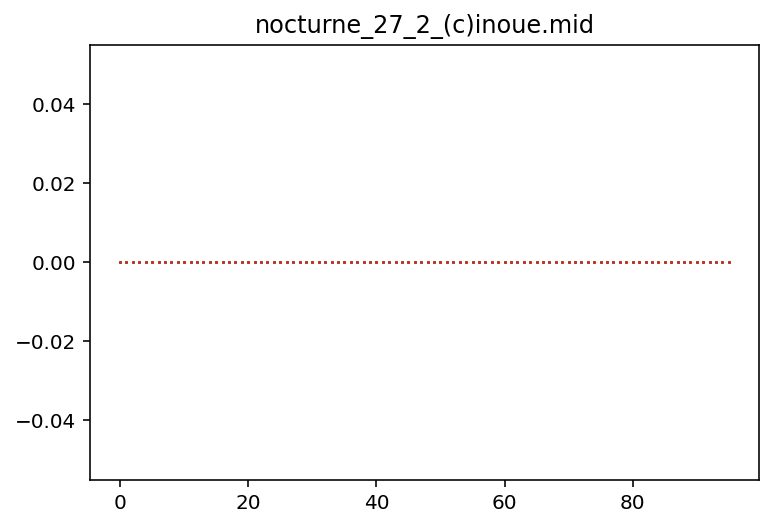

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


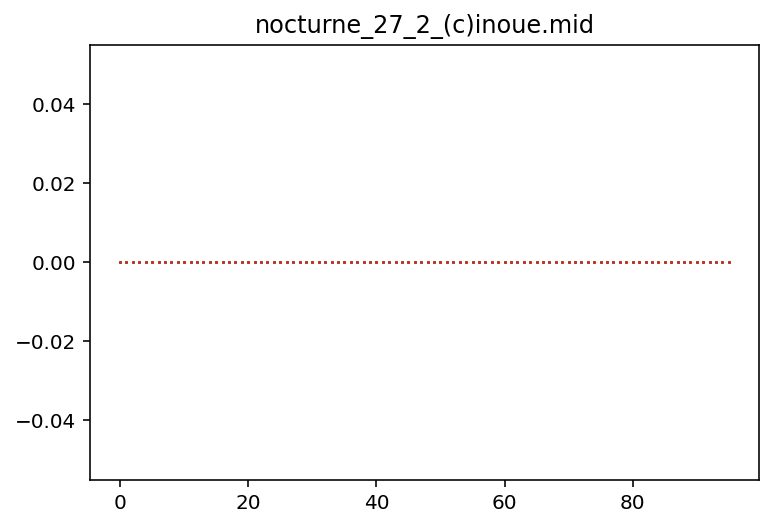

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


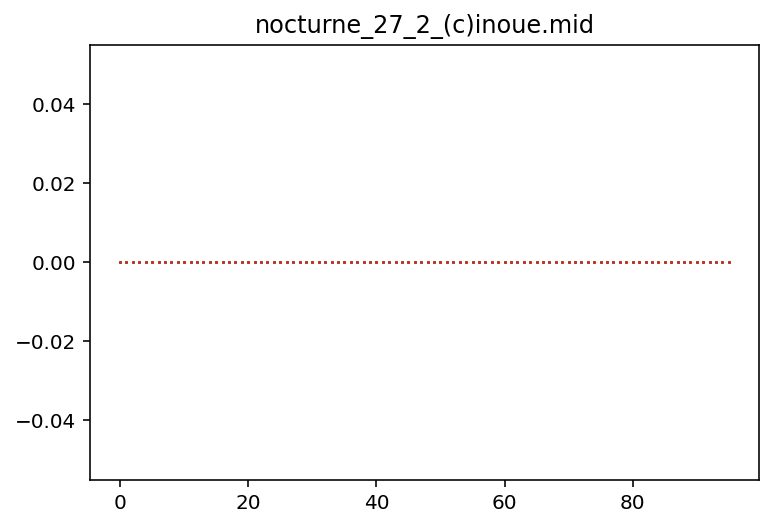

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


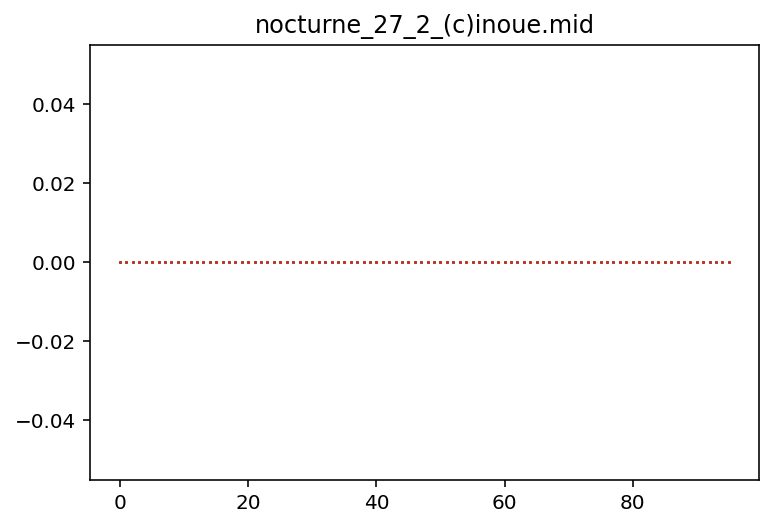

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


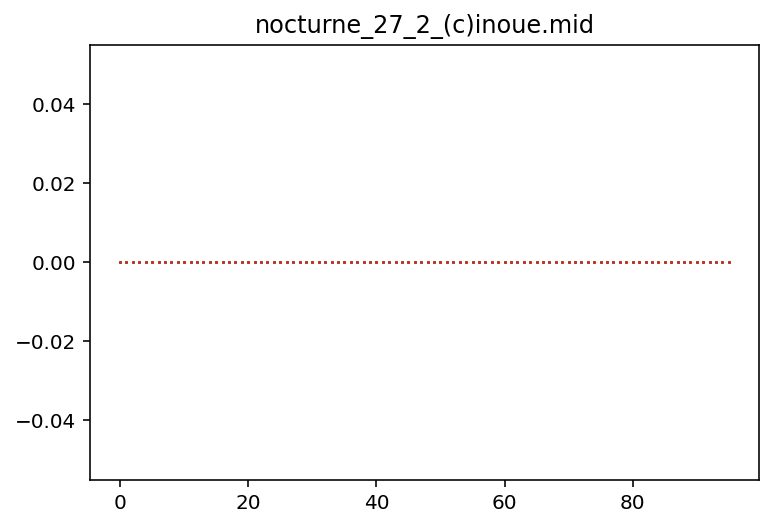

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


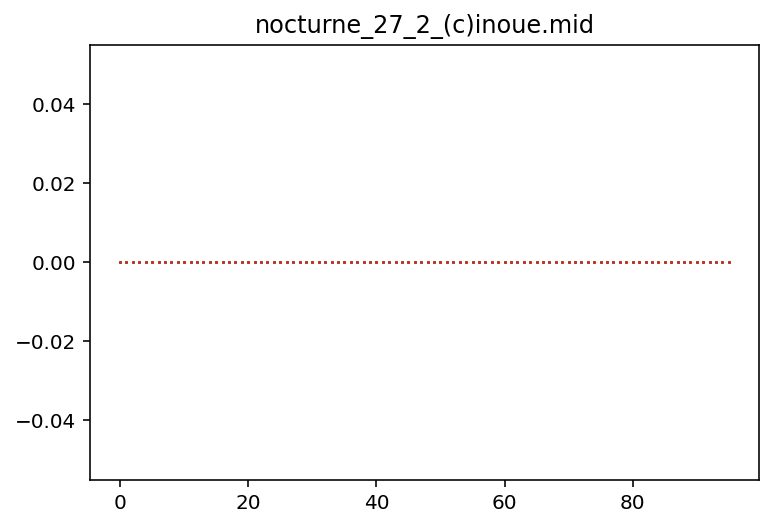

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


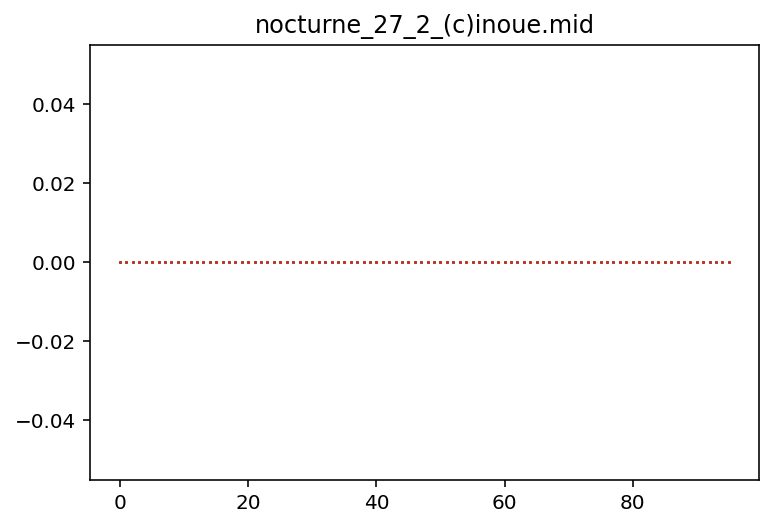

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


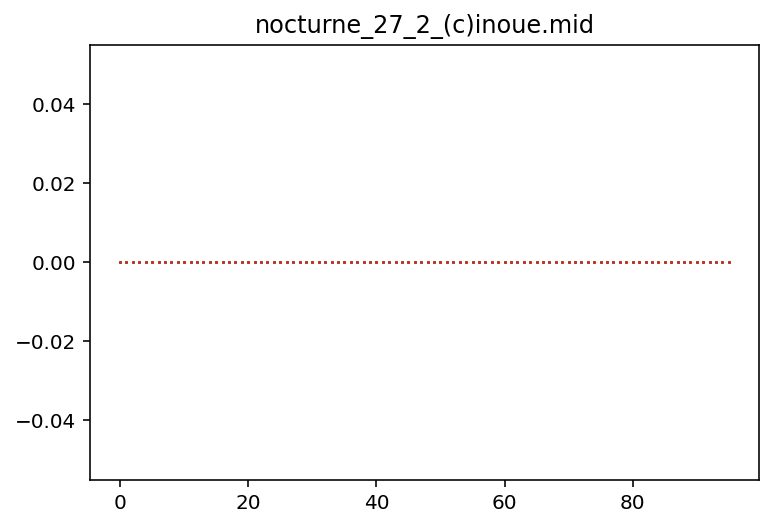

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


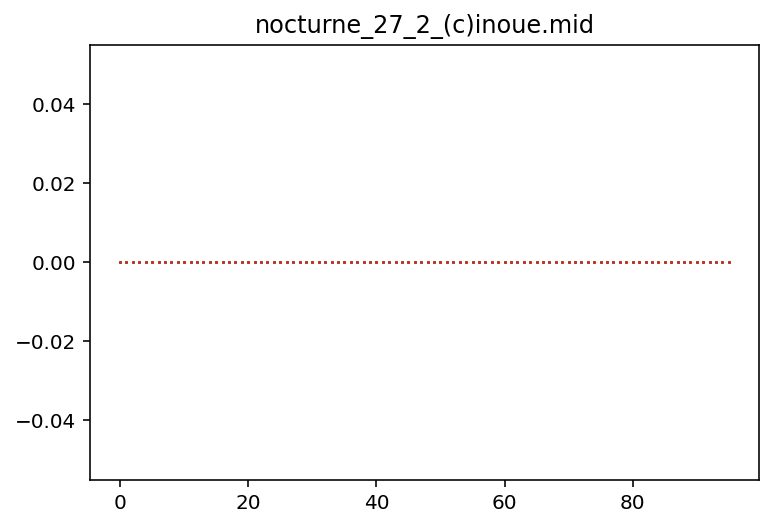

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


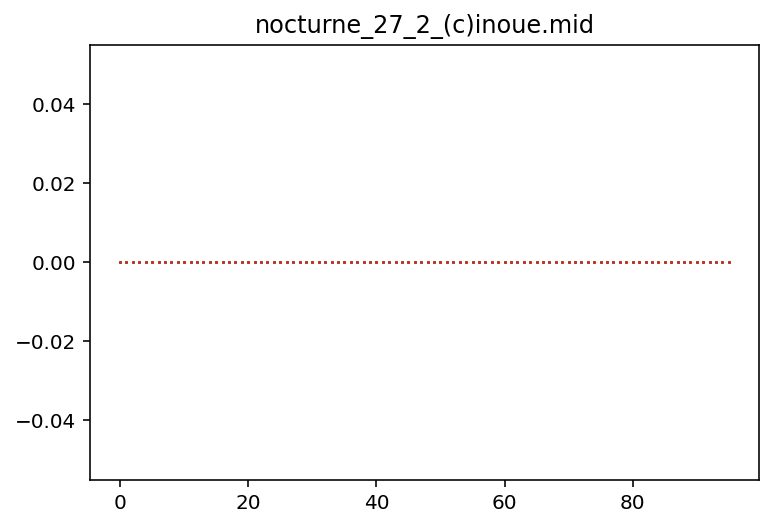

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


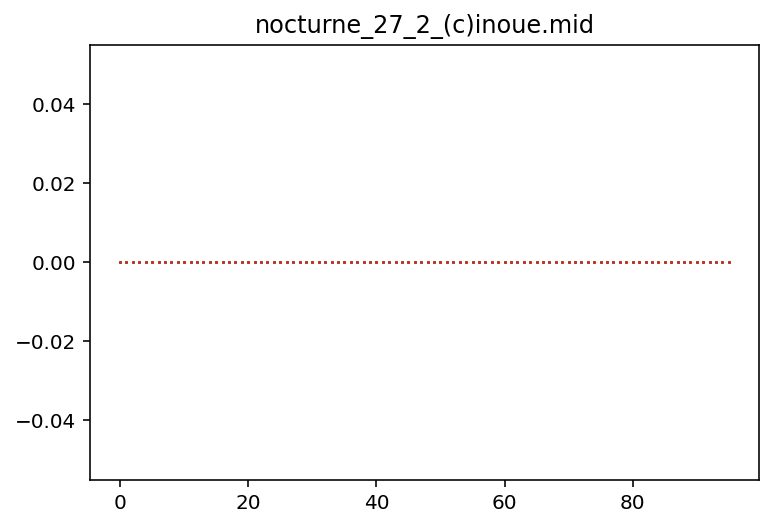

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


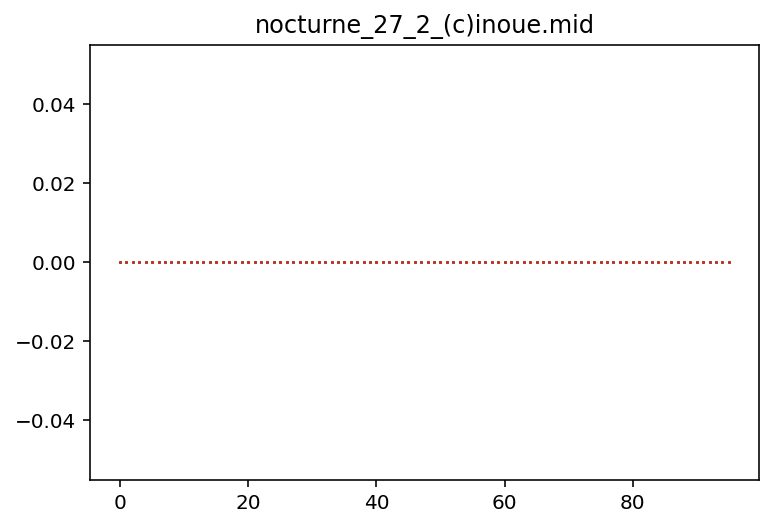

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


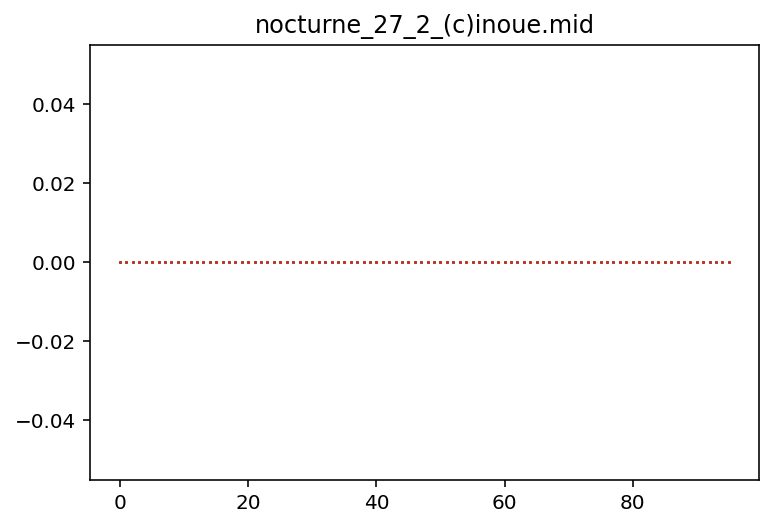

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


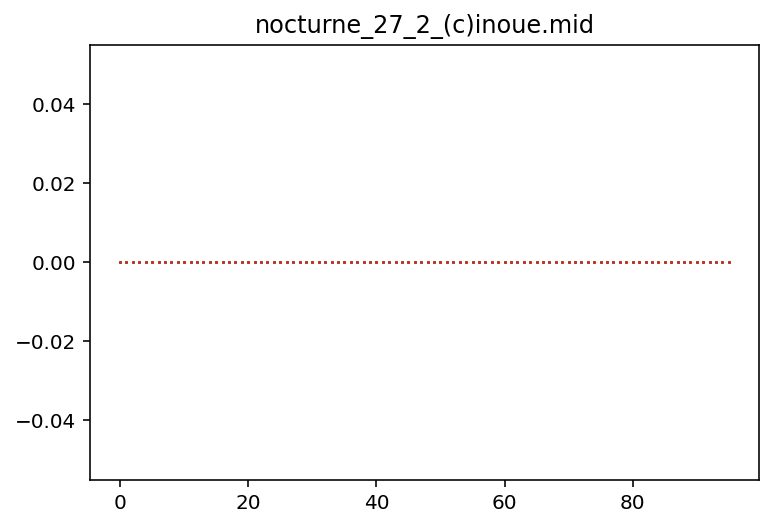

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


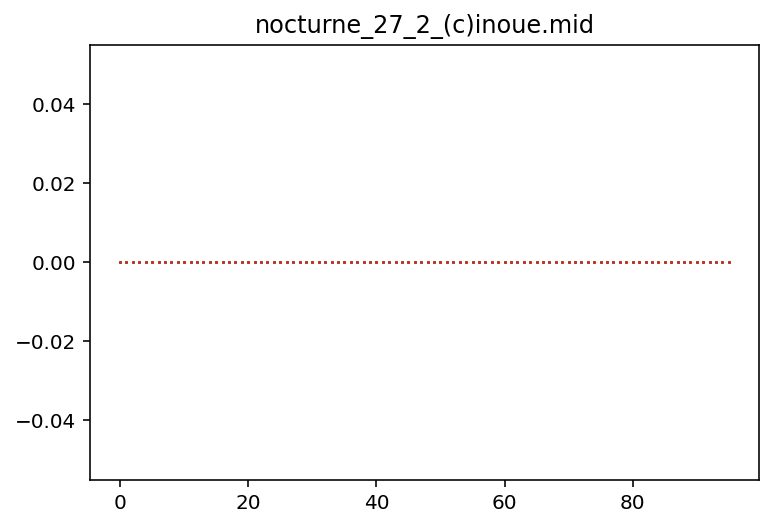

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


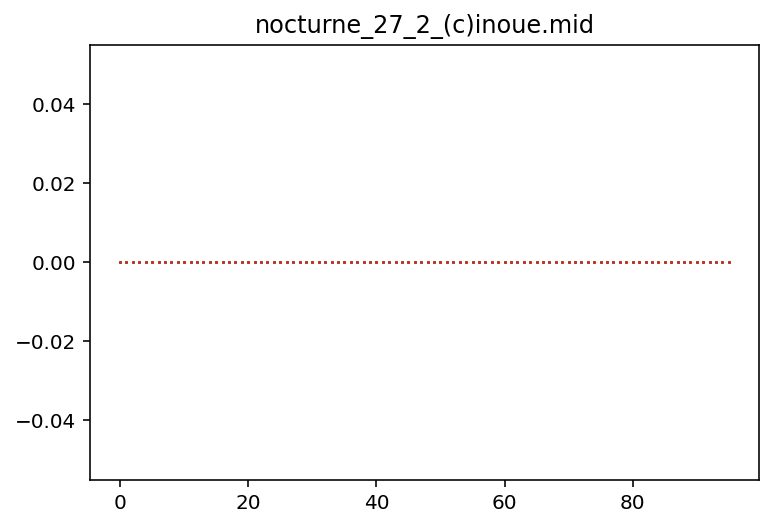

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


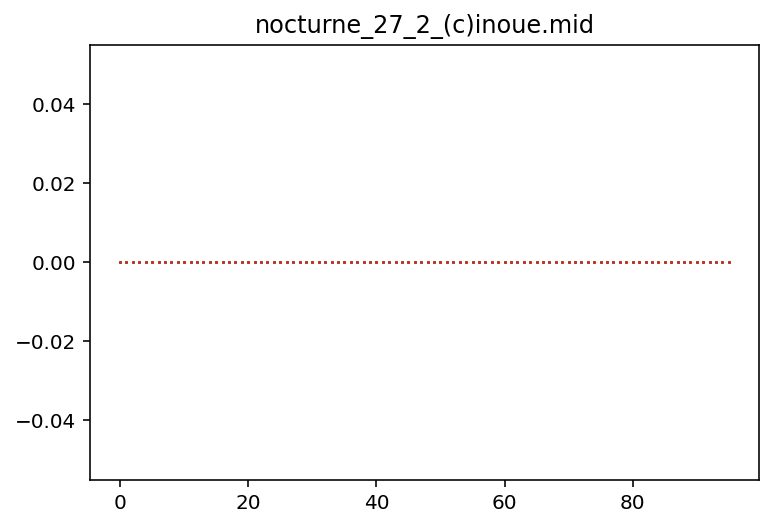

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


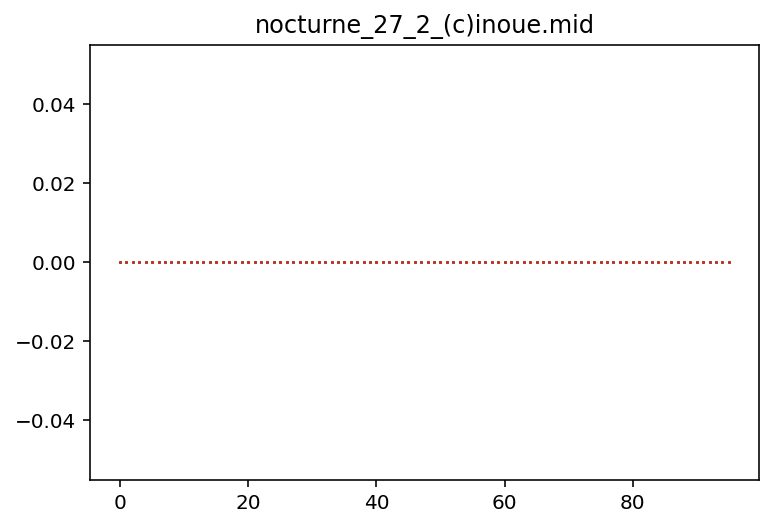

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


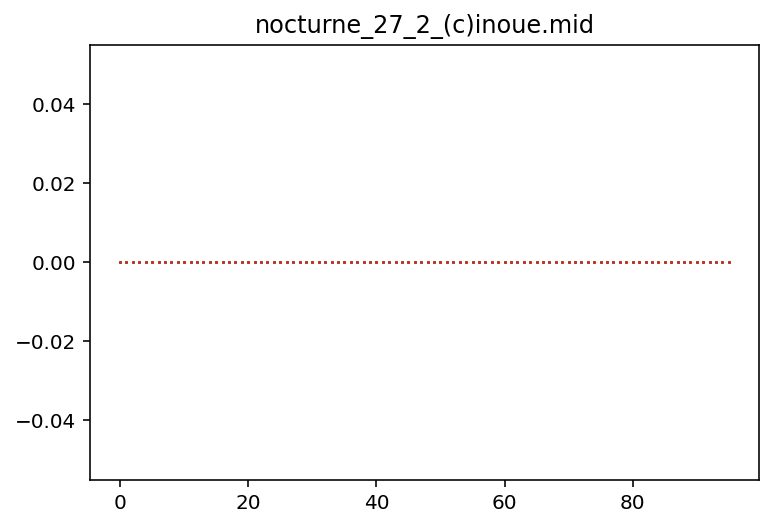

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


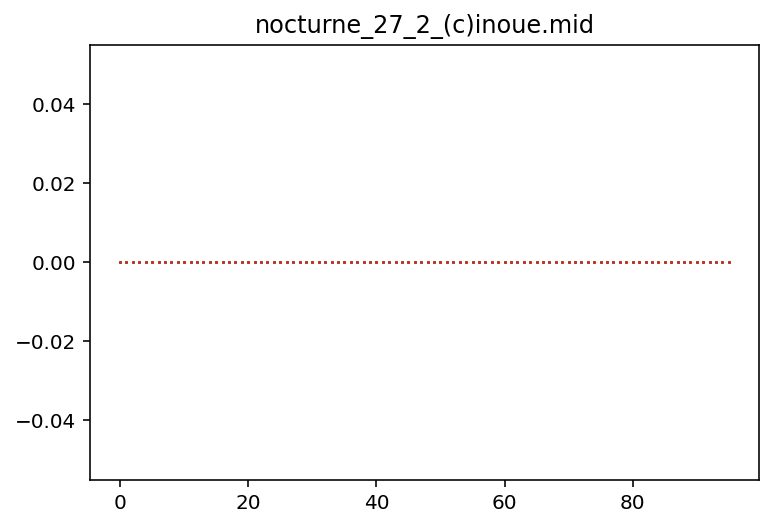

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


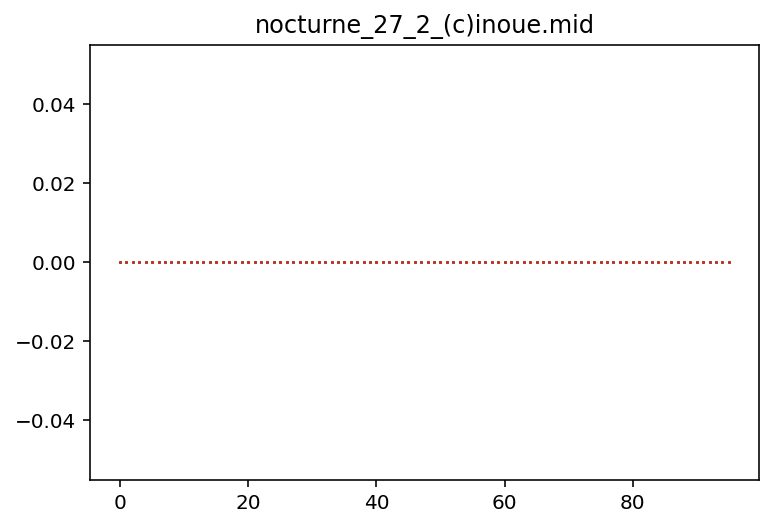

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


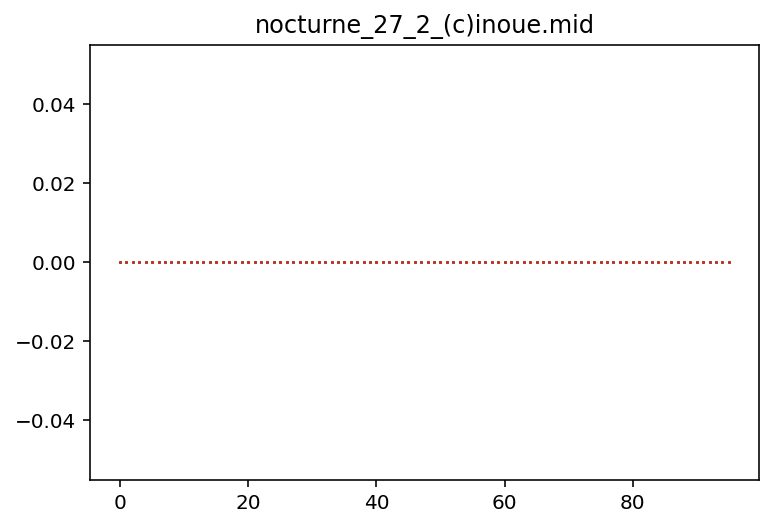

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


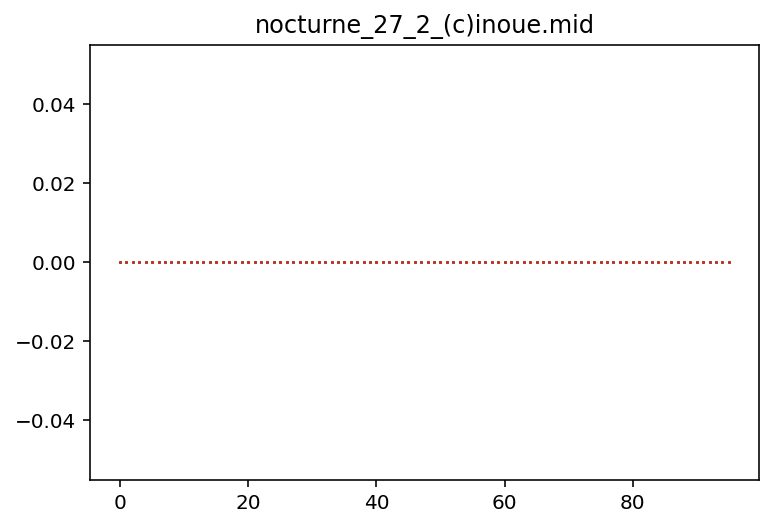

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


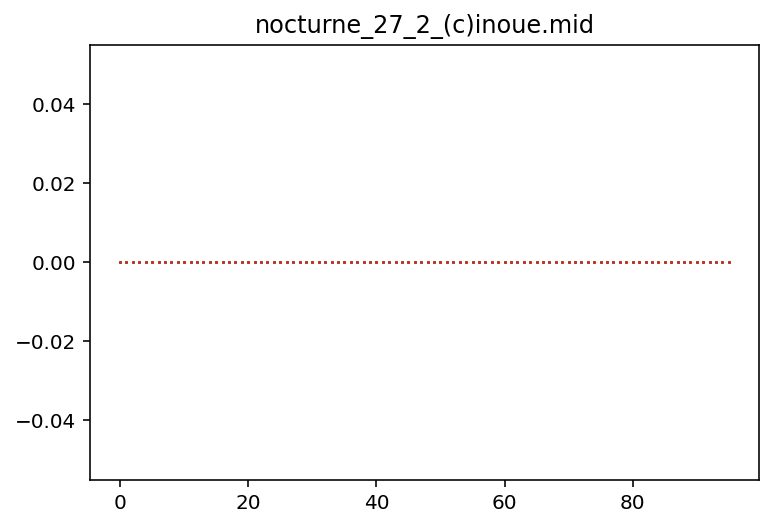

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


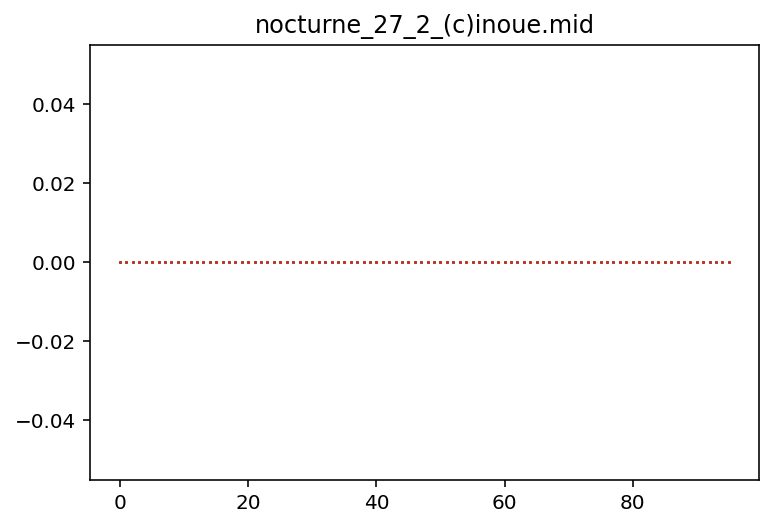

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


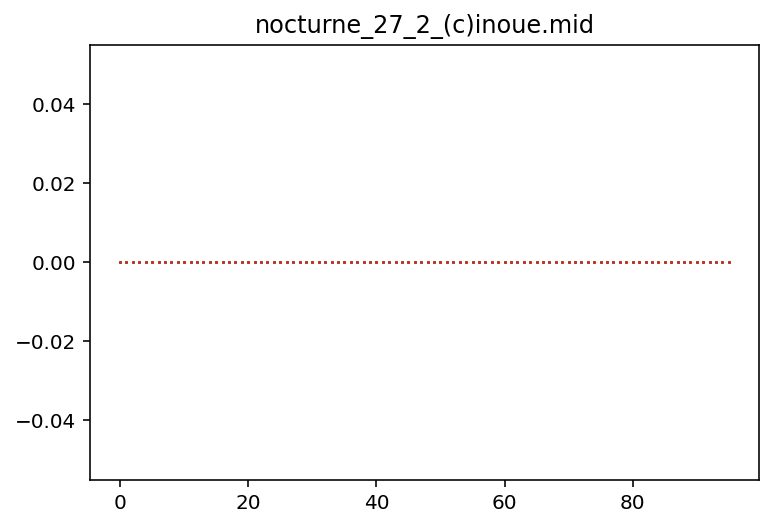

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


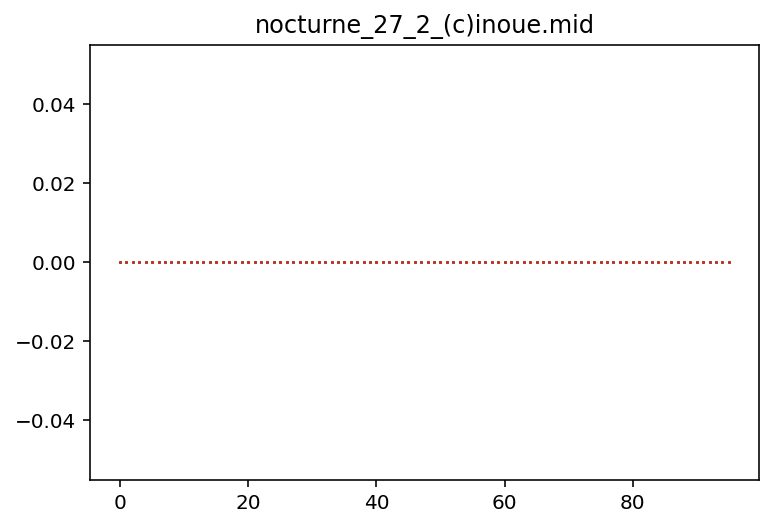

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


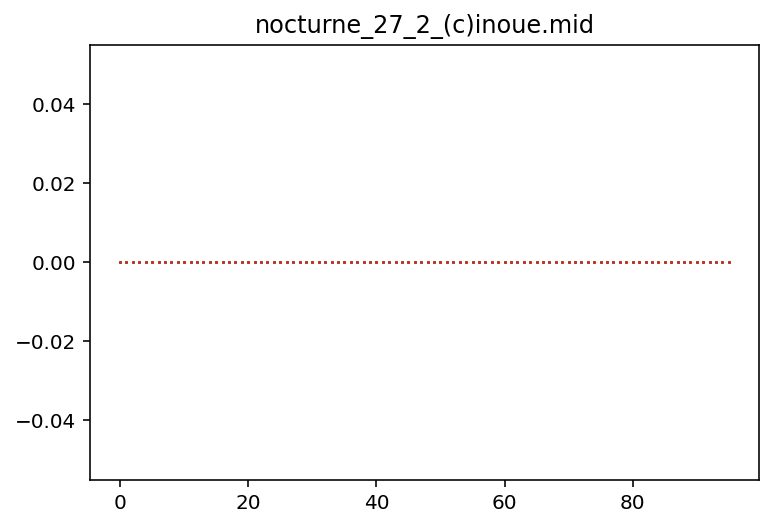

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


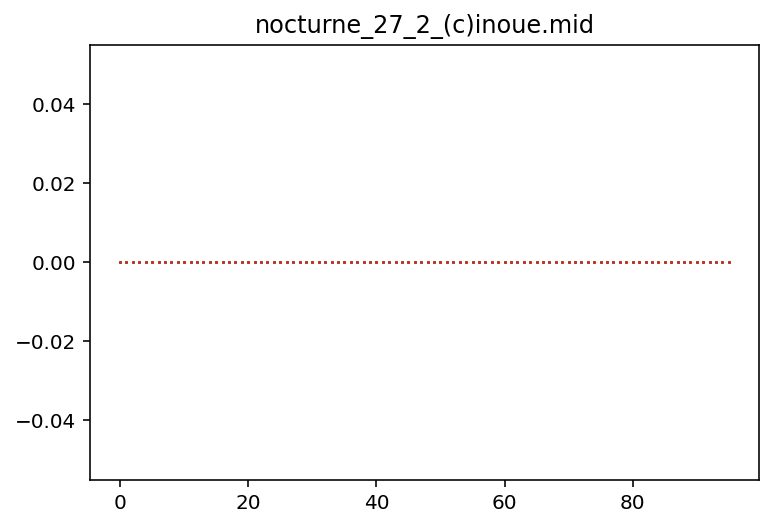

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


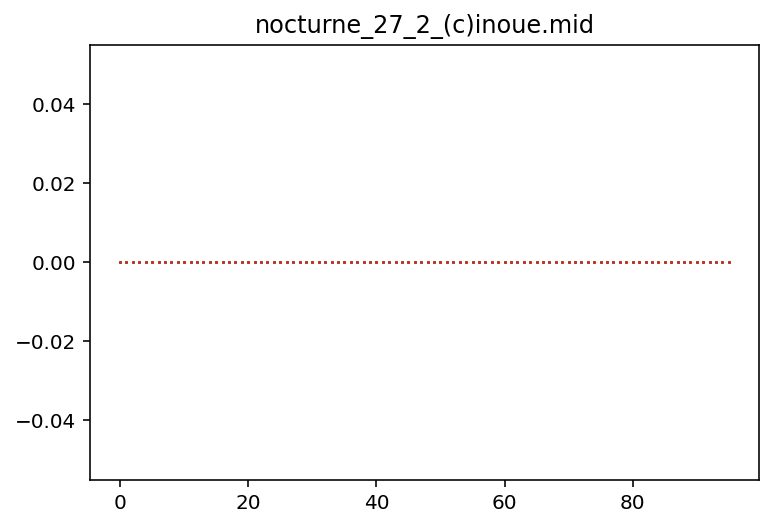

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


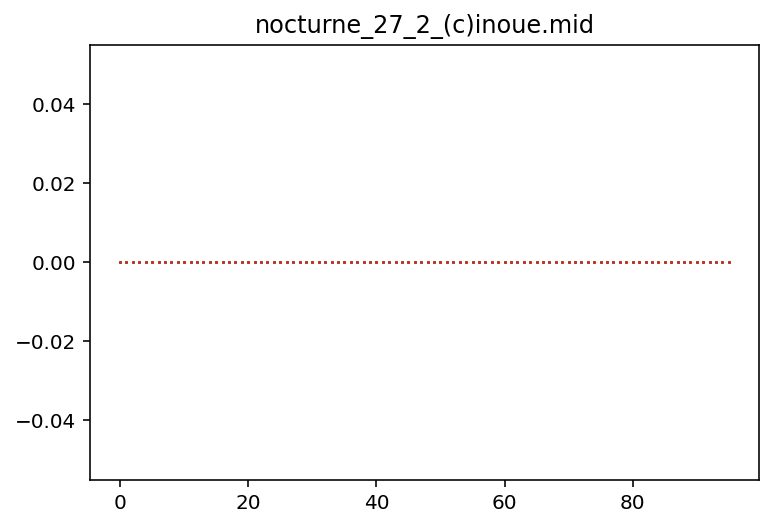

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


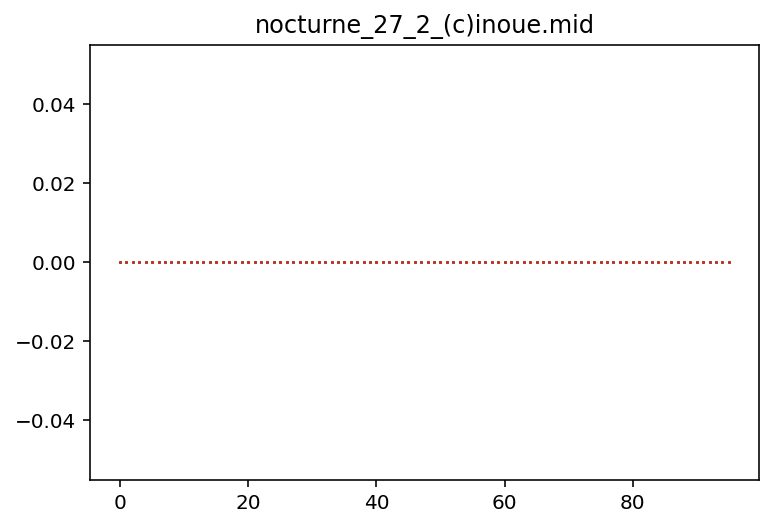

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


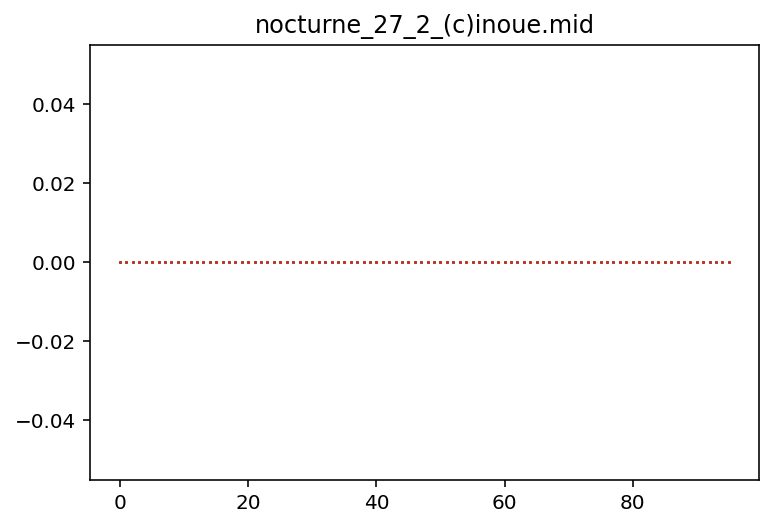

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


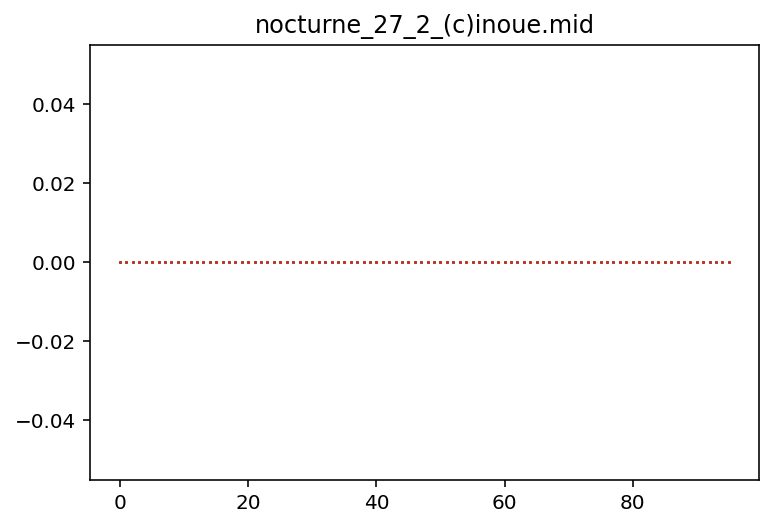

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


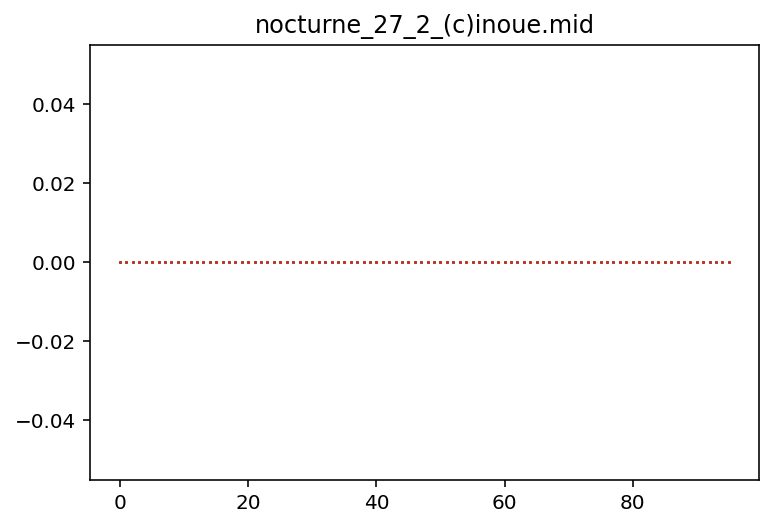

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


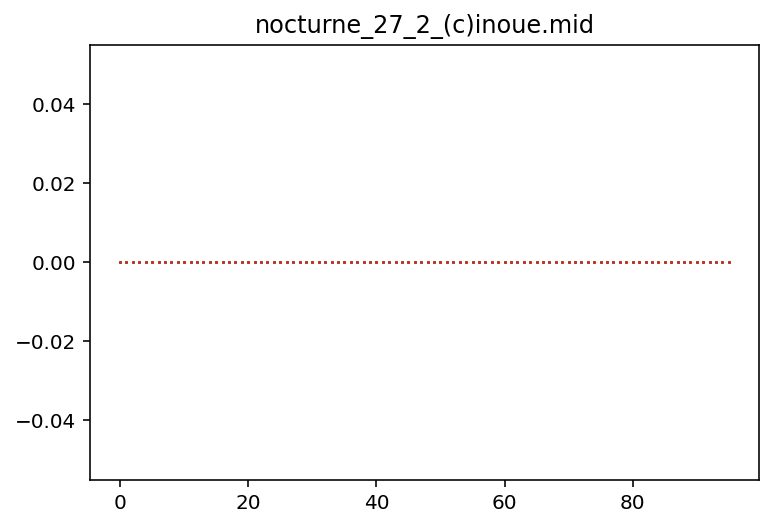

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


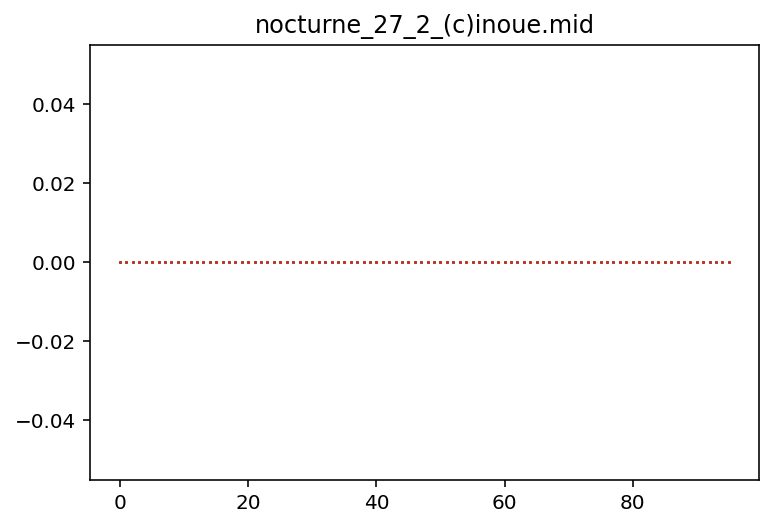

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


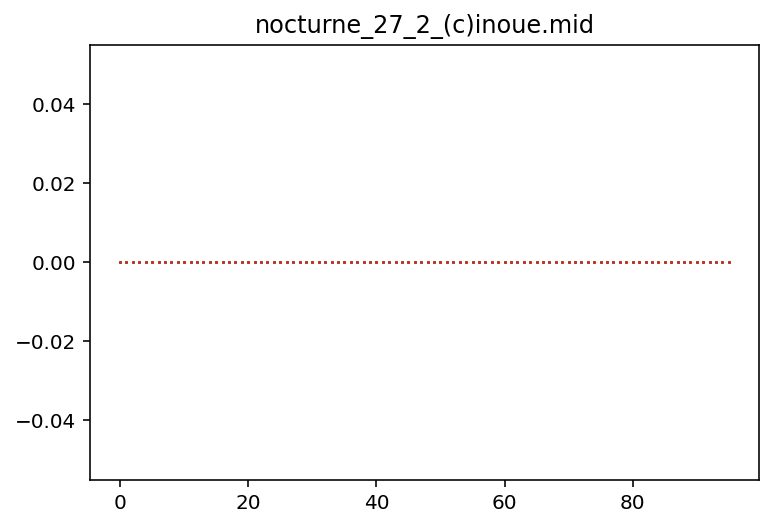

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


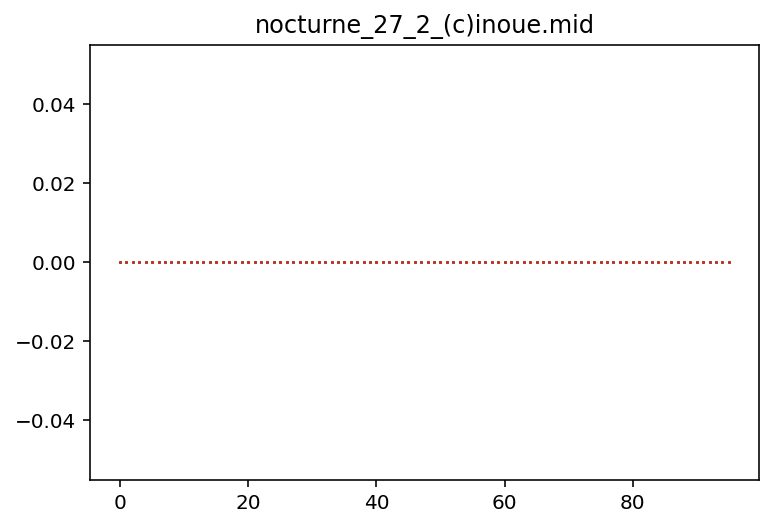

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


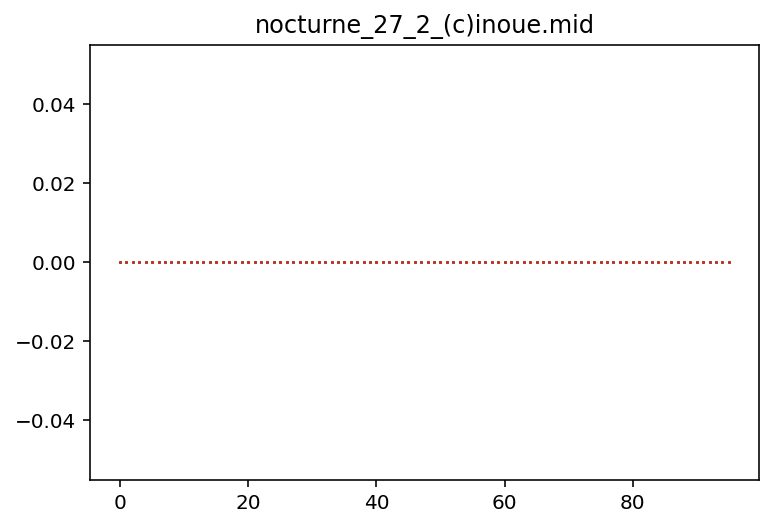

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


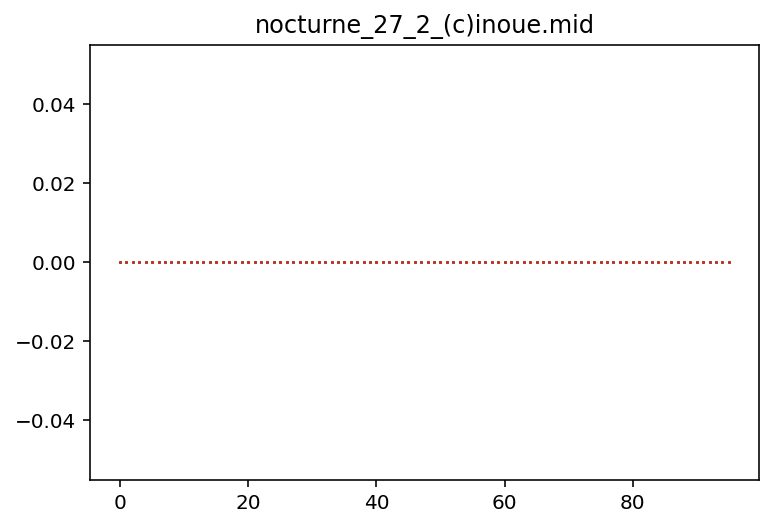

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


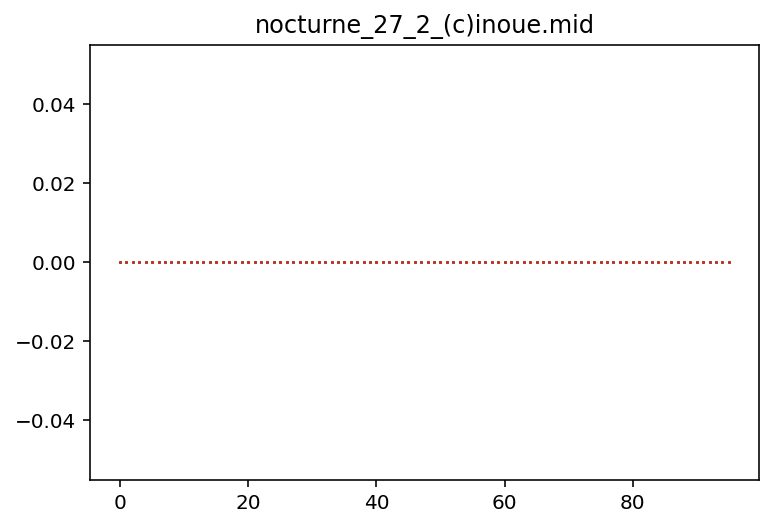

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


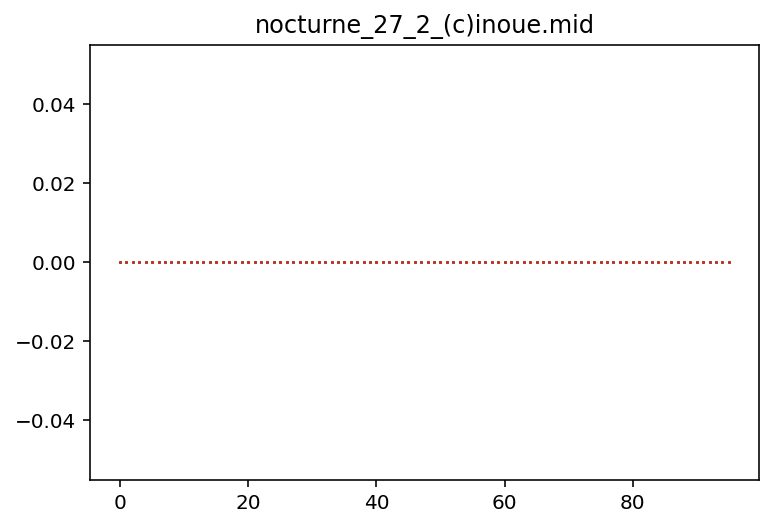

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


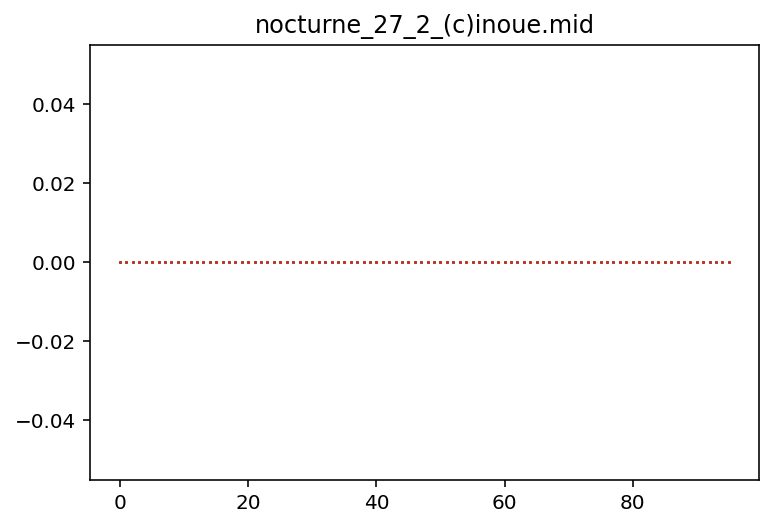

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


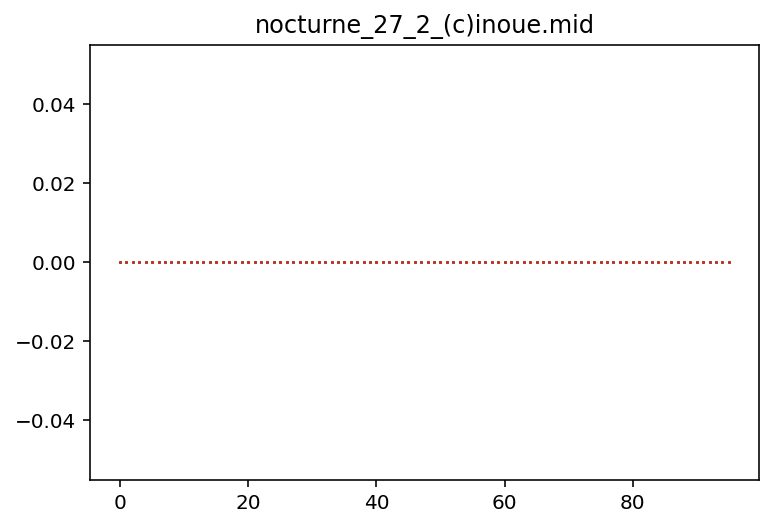

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


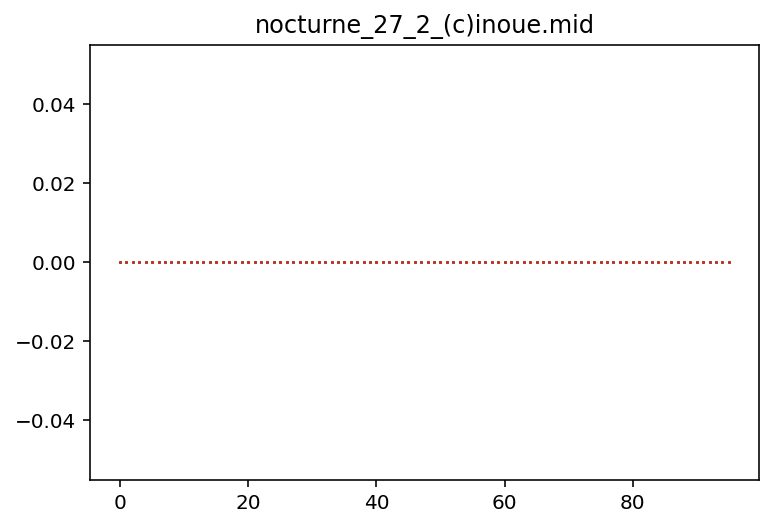

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


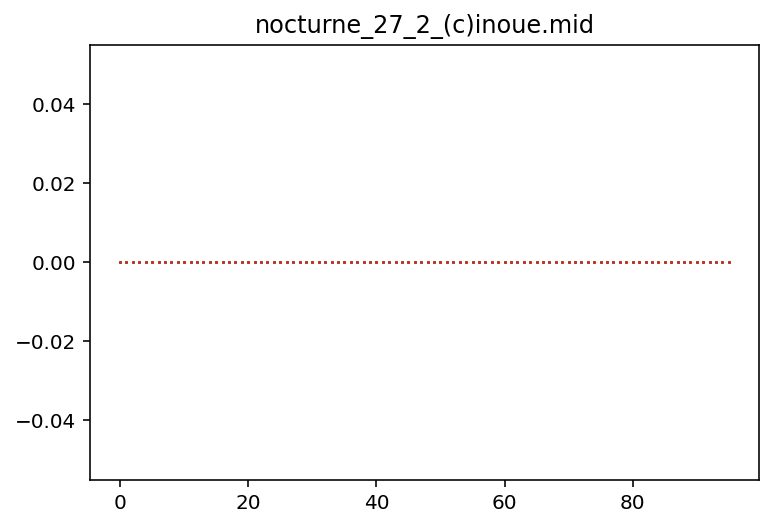

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


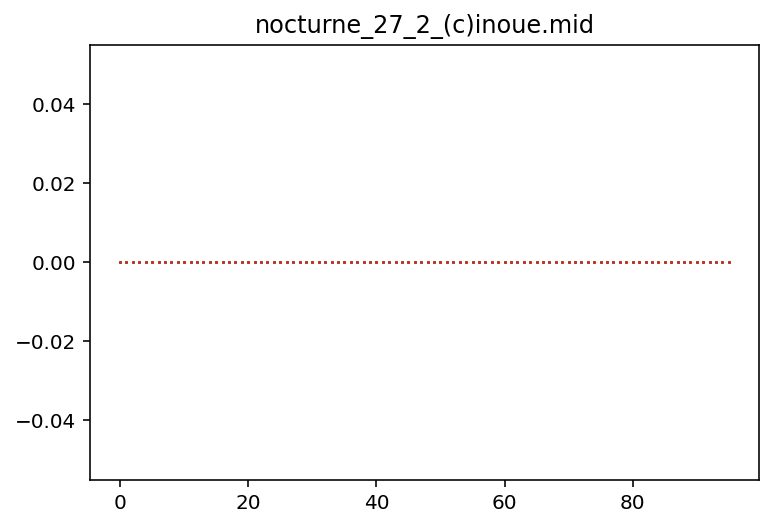

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


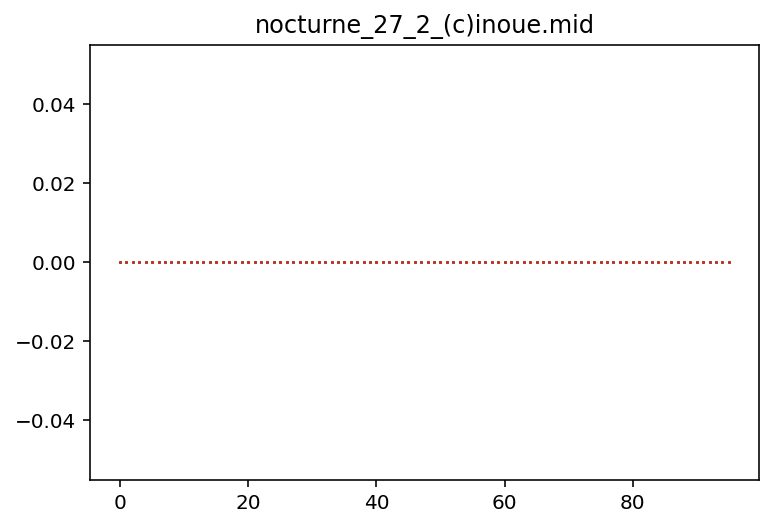

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


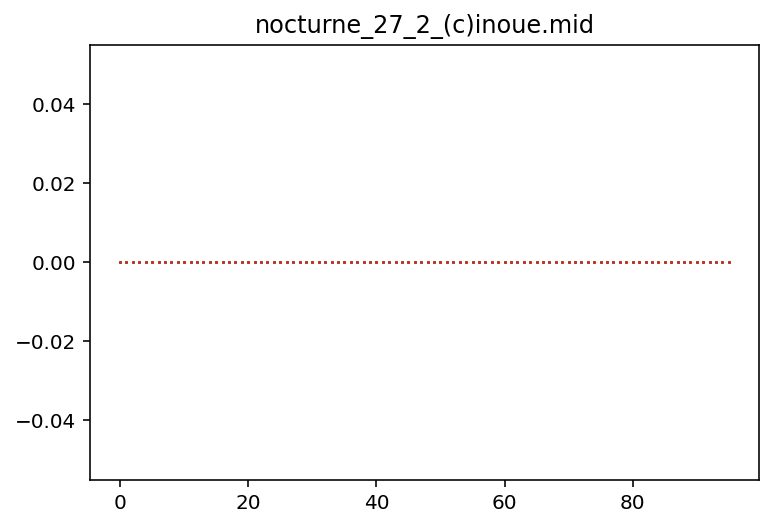

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


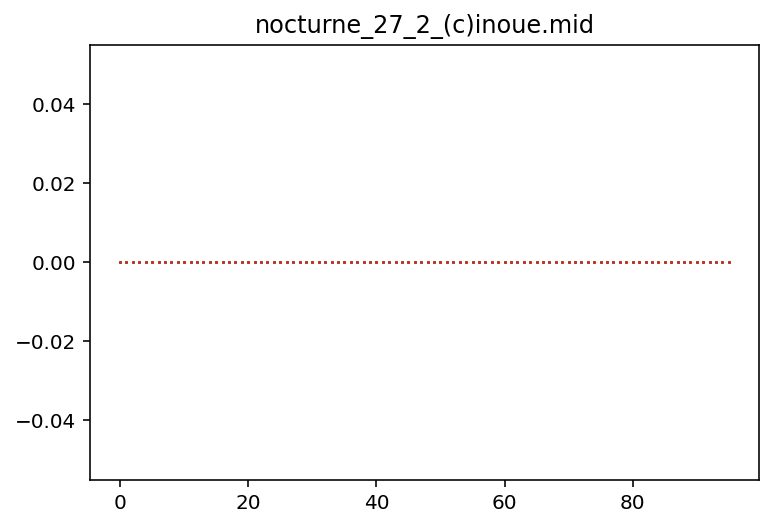

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


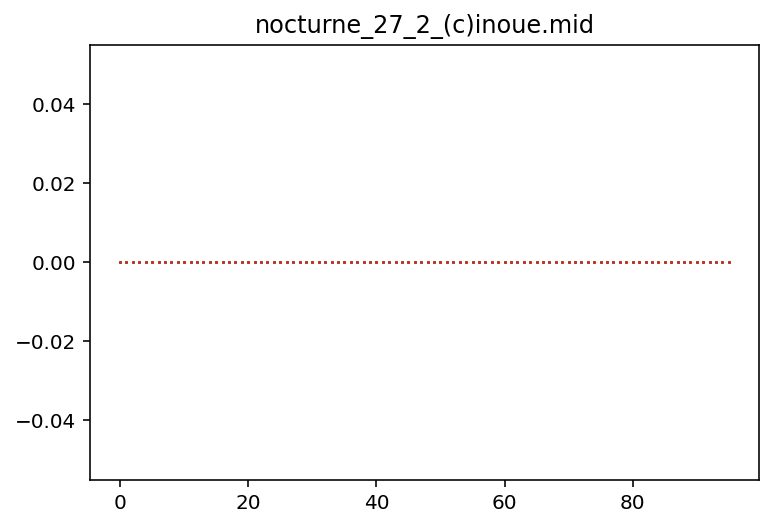

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


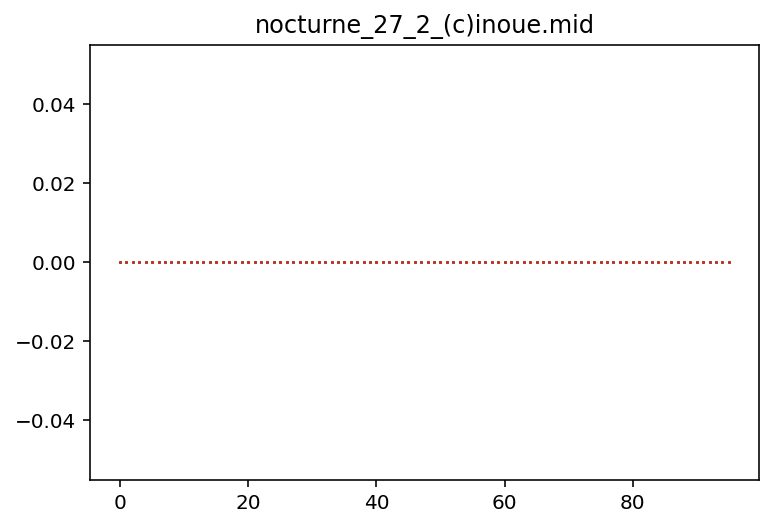

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


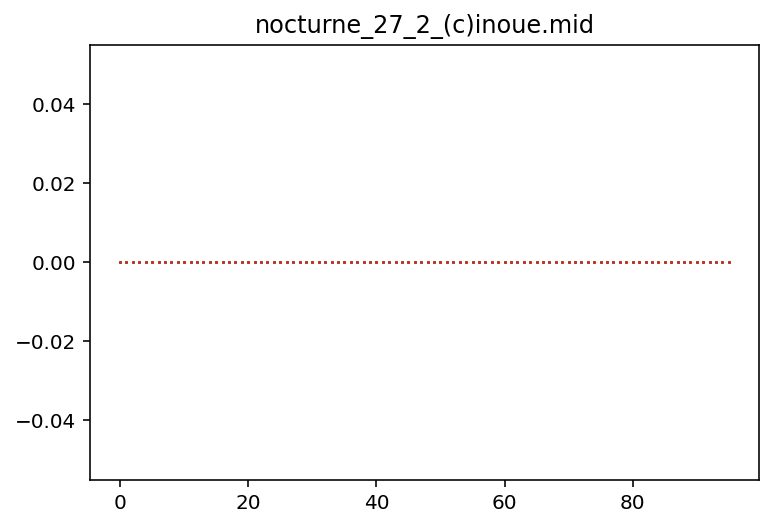

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


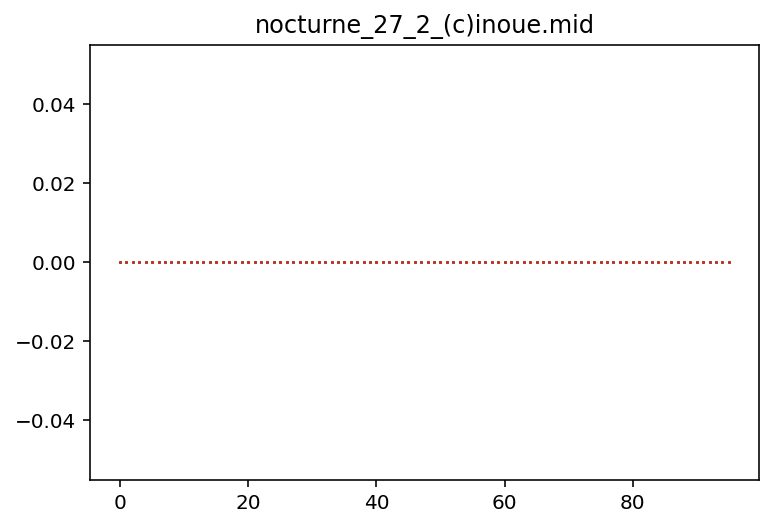

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


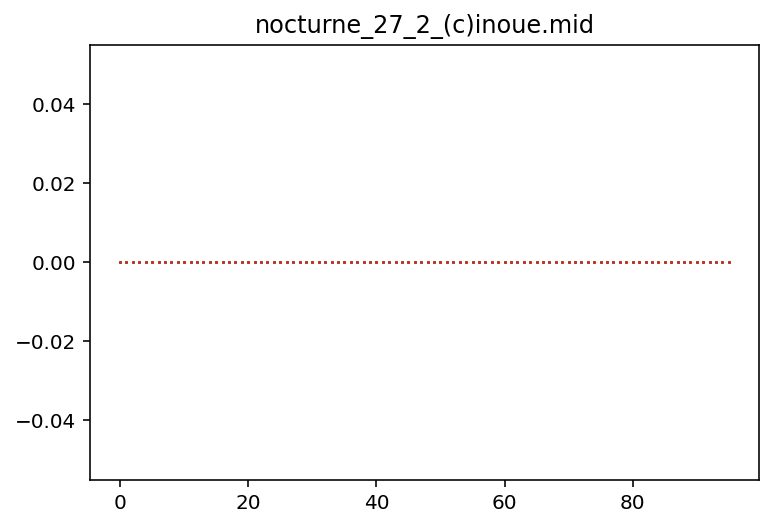

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


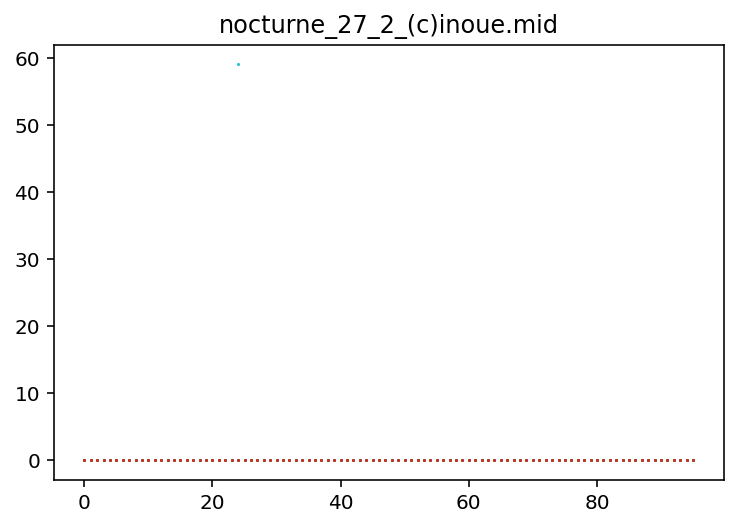

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


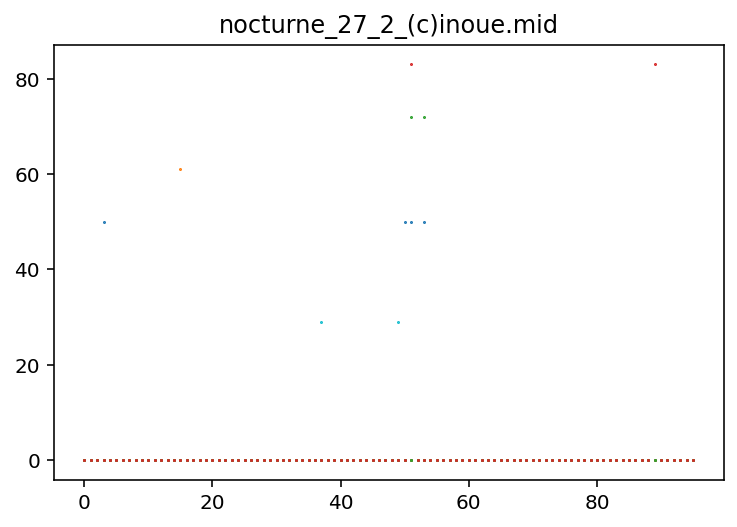

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


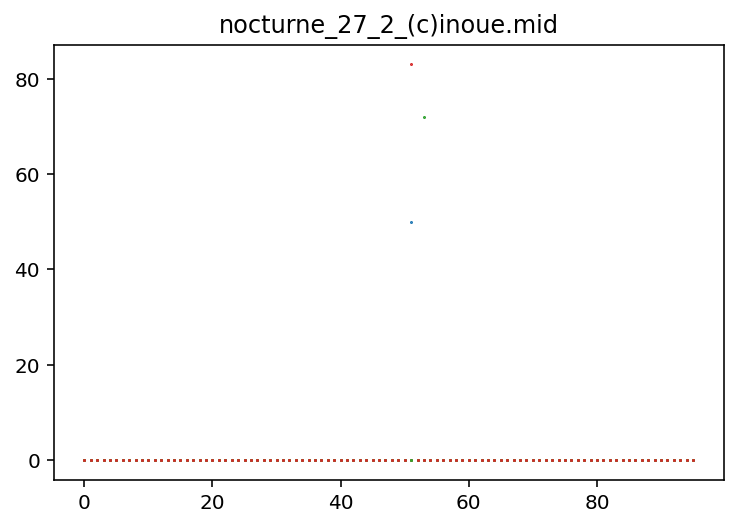

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


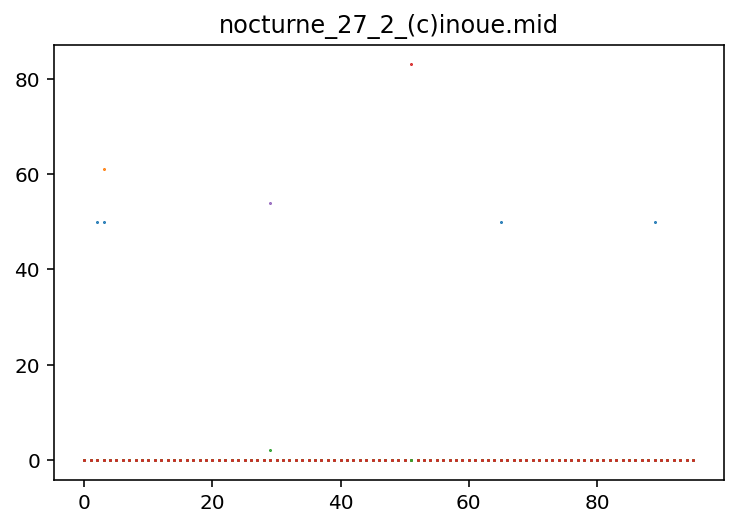

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


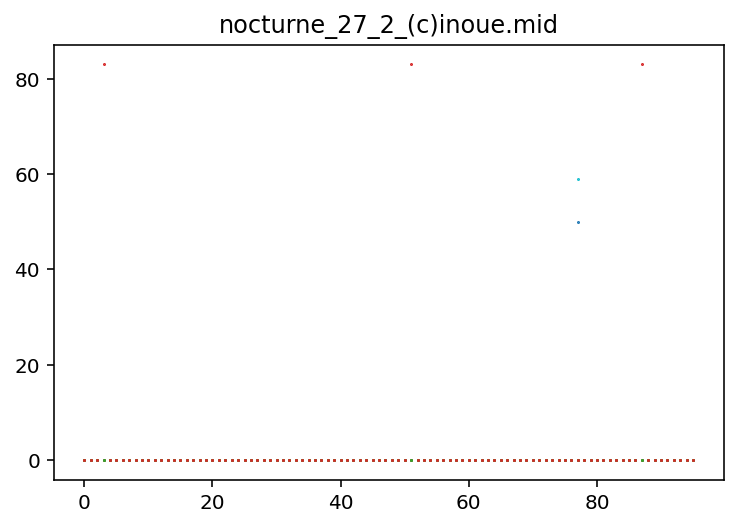

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


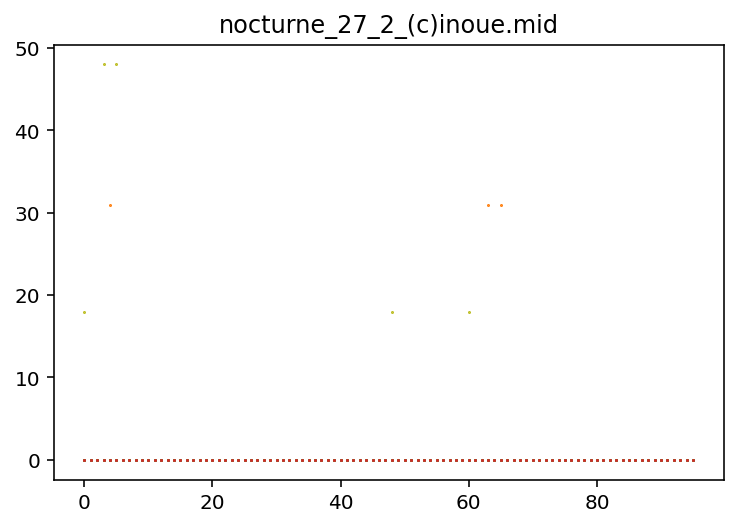

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


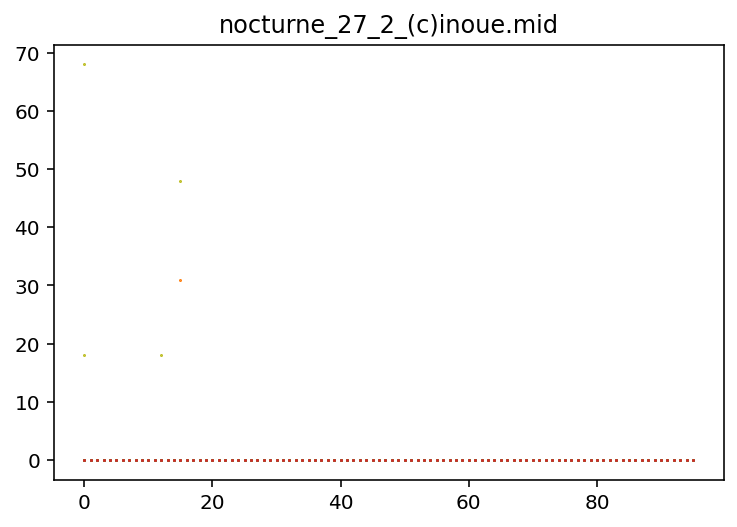

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


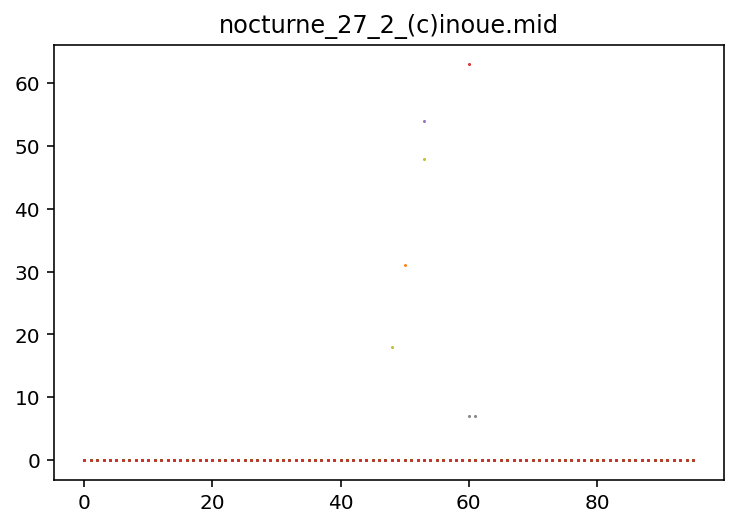

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


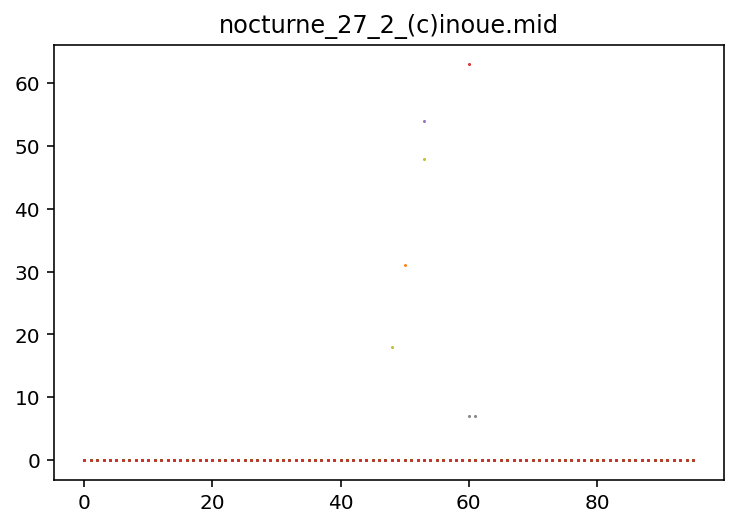

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


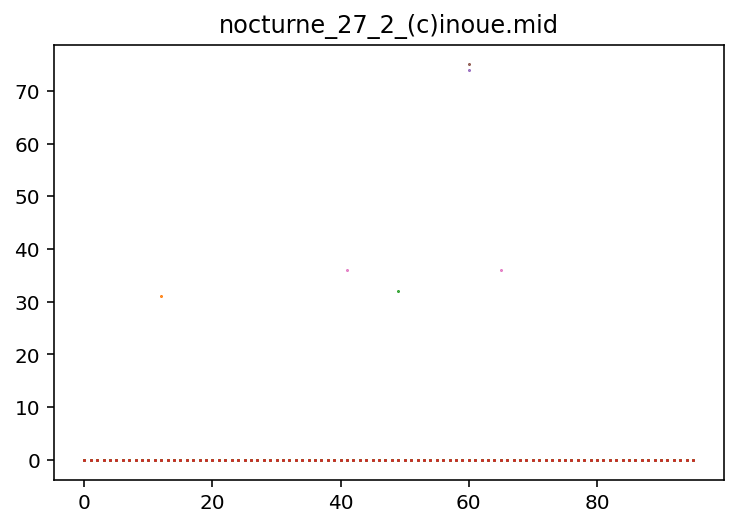

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


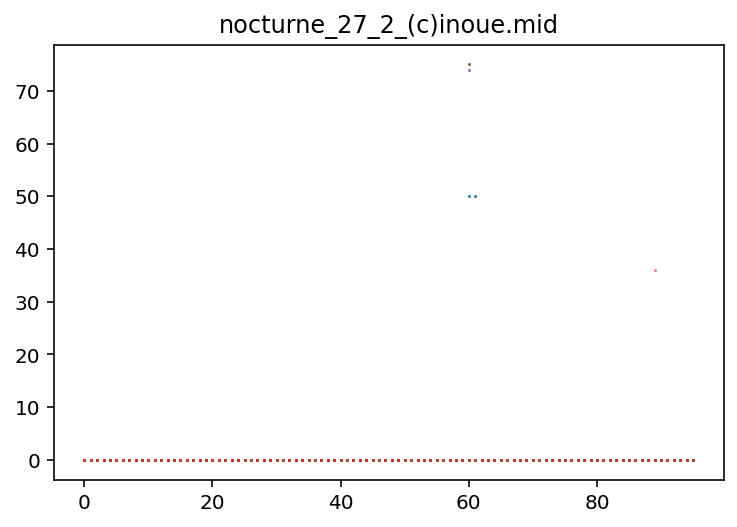

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


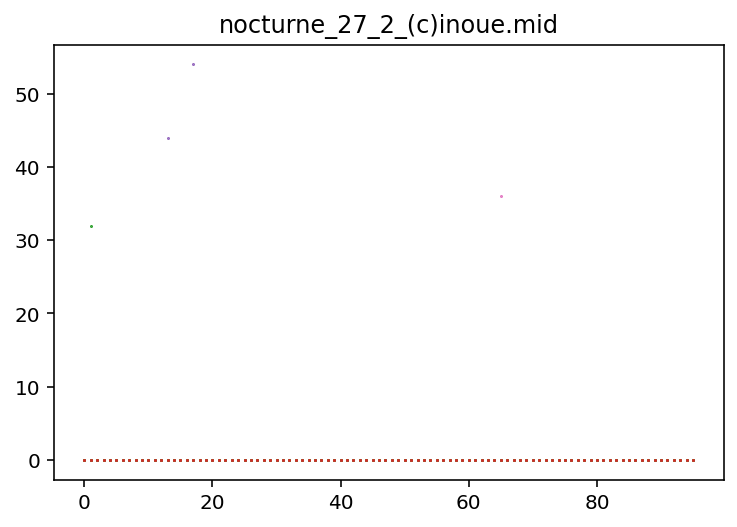

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


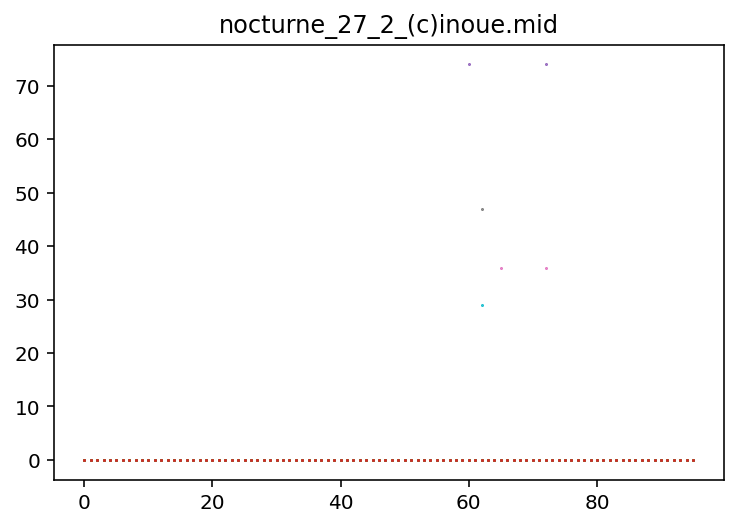

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


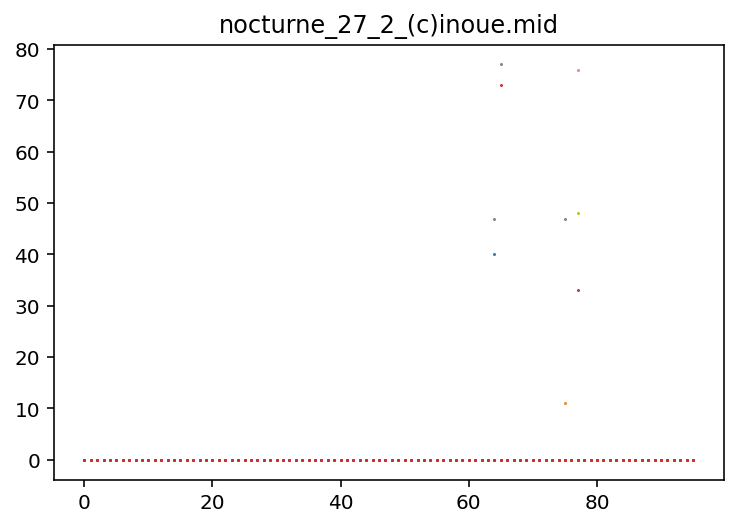

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


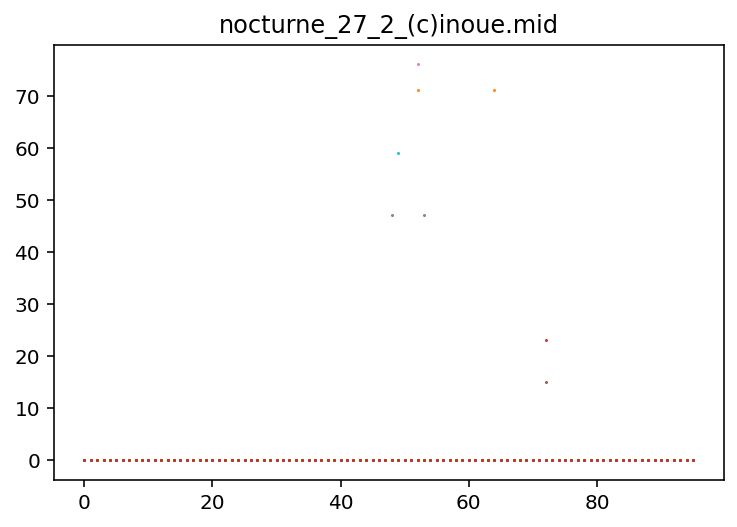

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


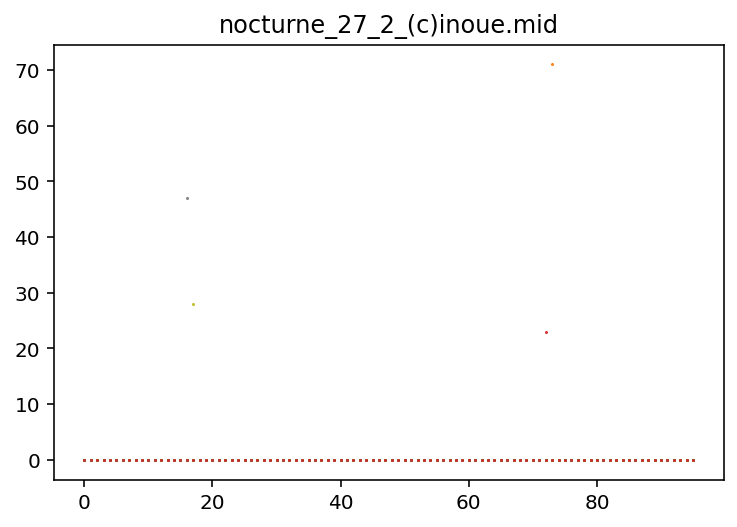

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


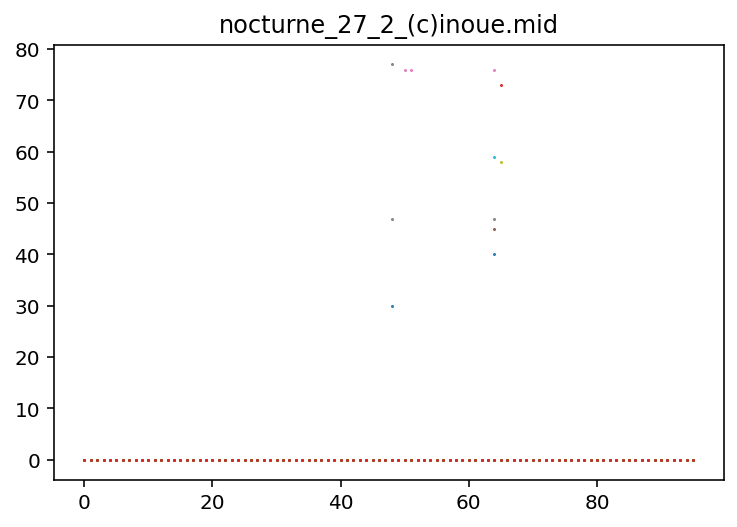

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


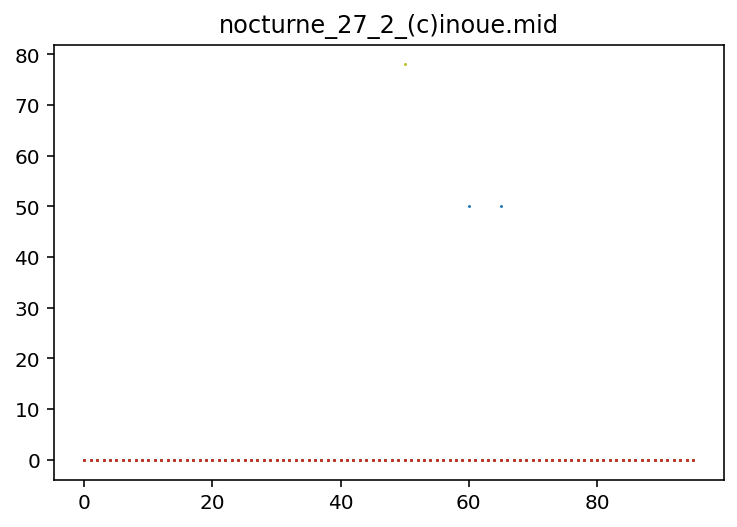

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


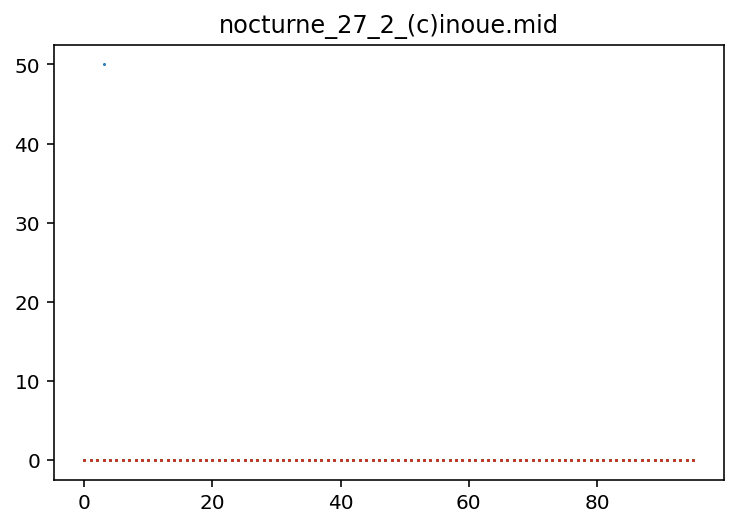

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


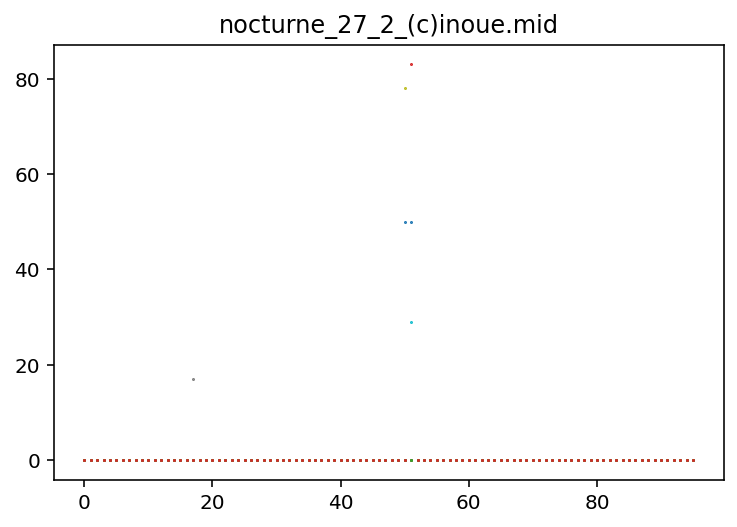

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


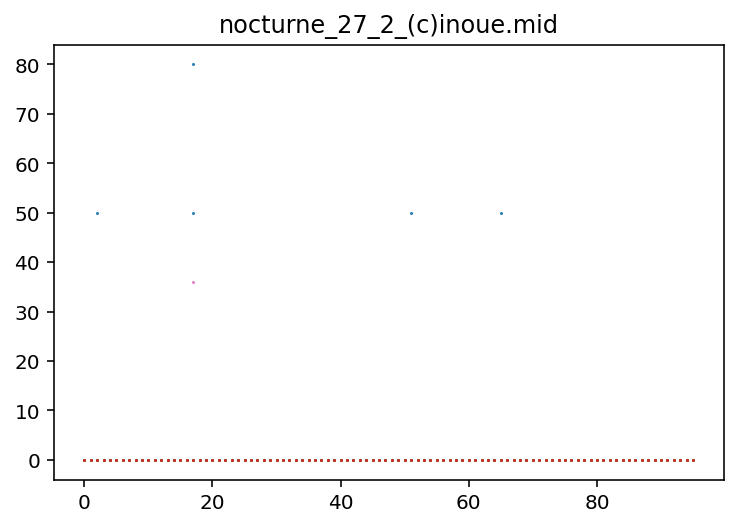

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


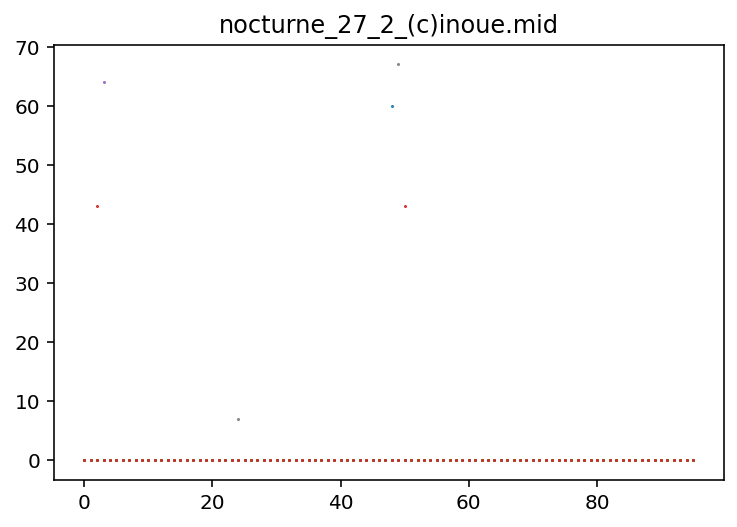

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


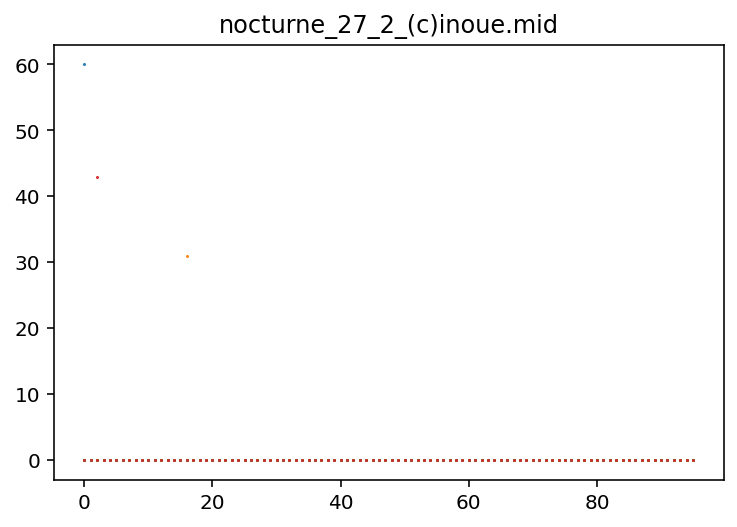

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


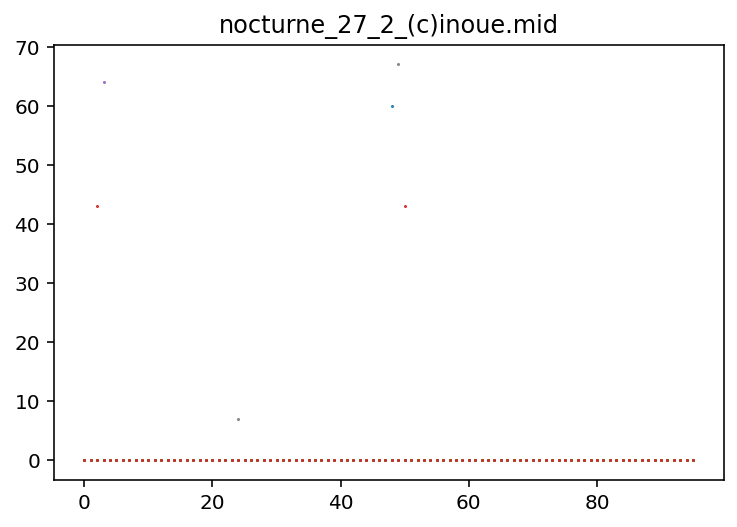

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


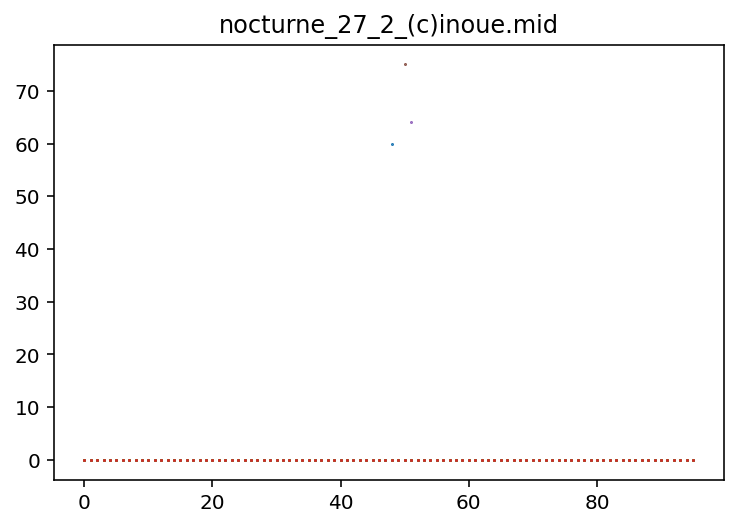

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


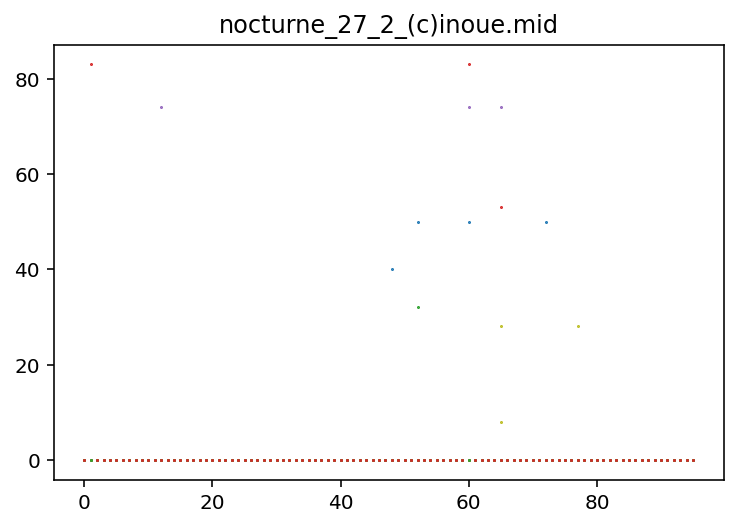

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


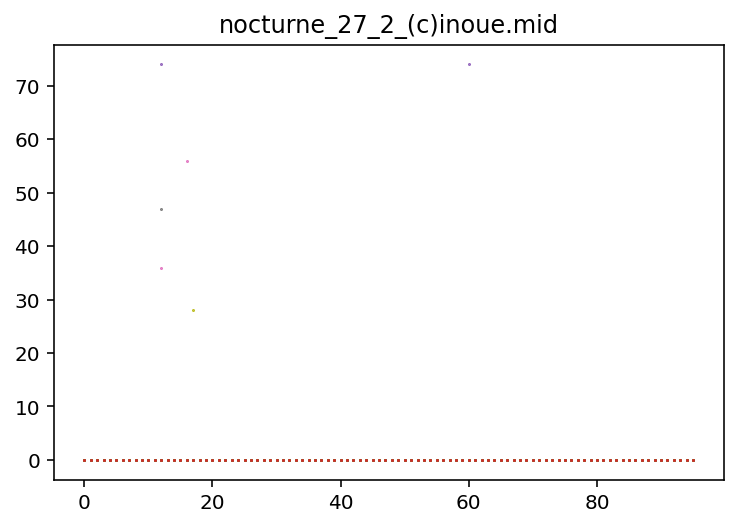

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


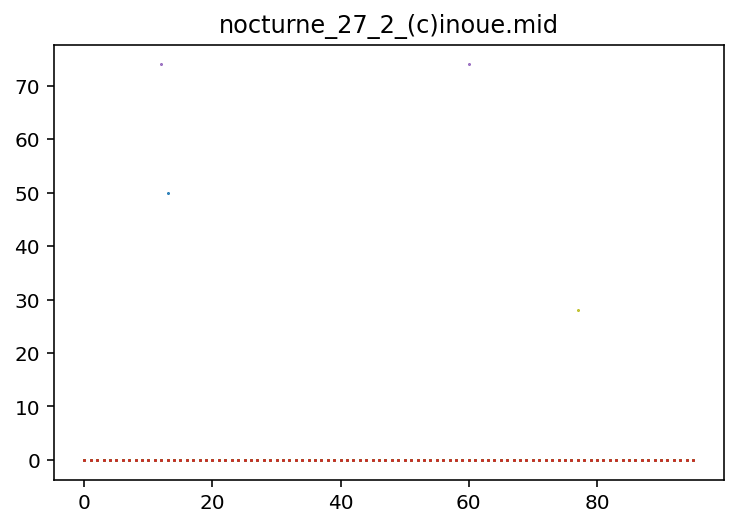

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


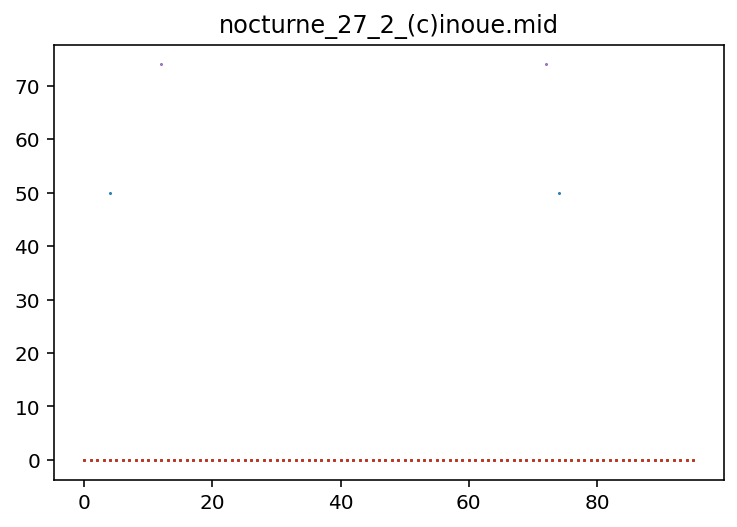

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


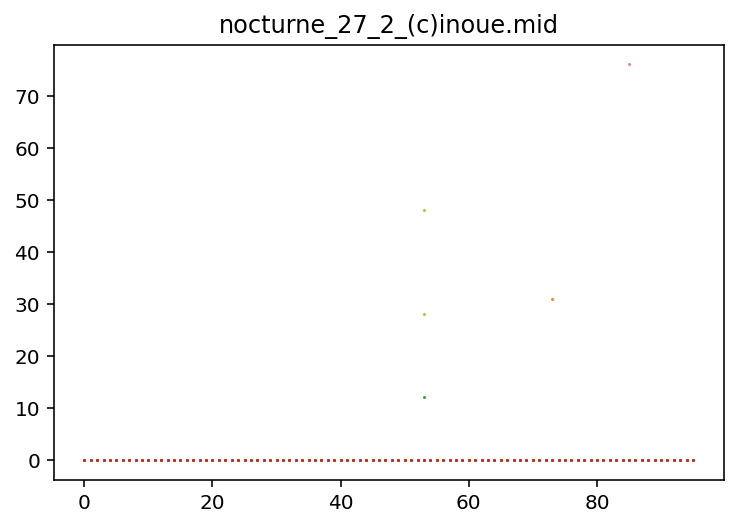

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


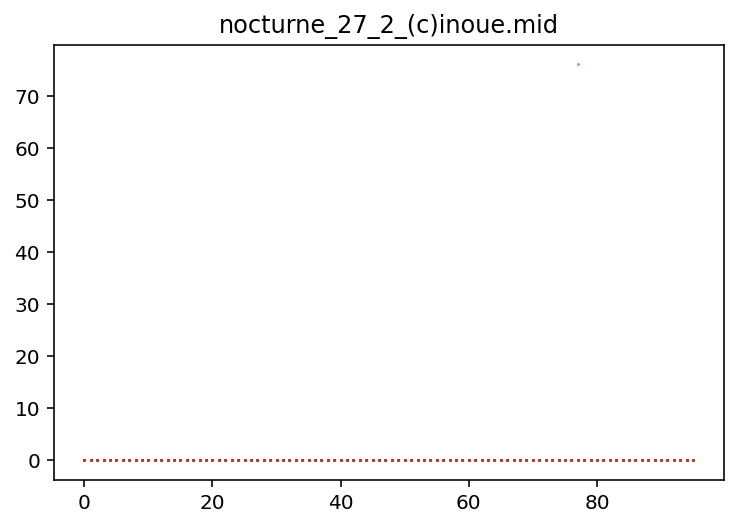

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


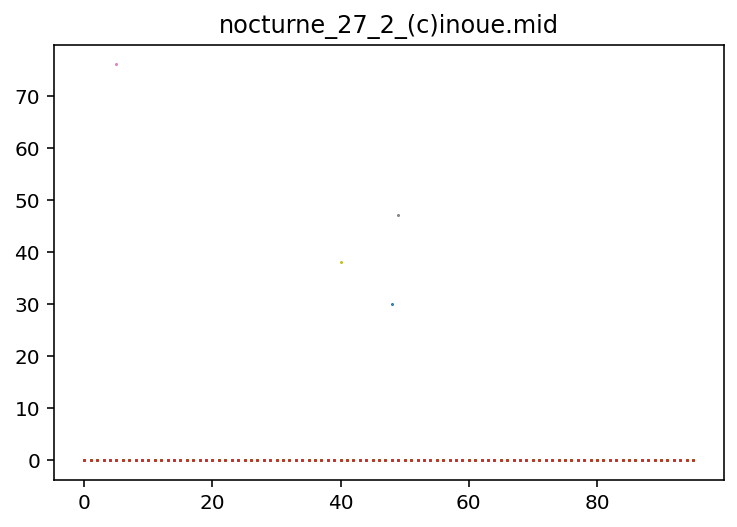

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


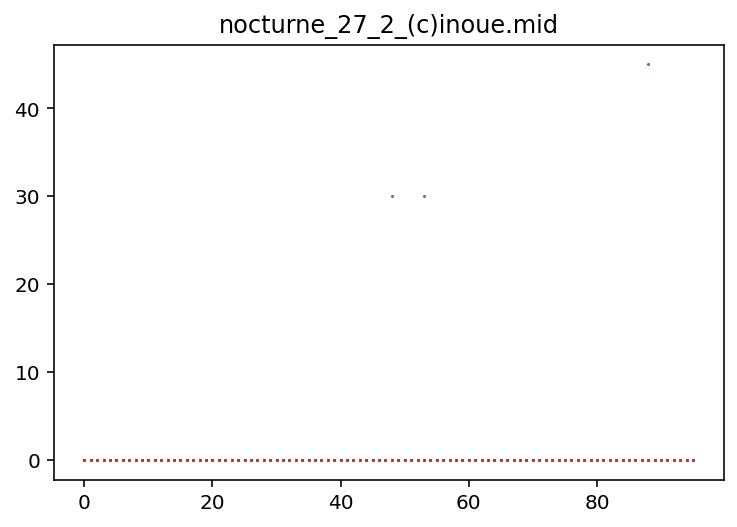

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0  99]
 [  0   0   0 ...   0   0 -99]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


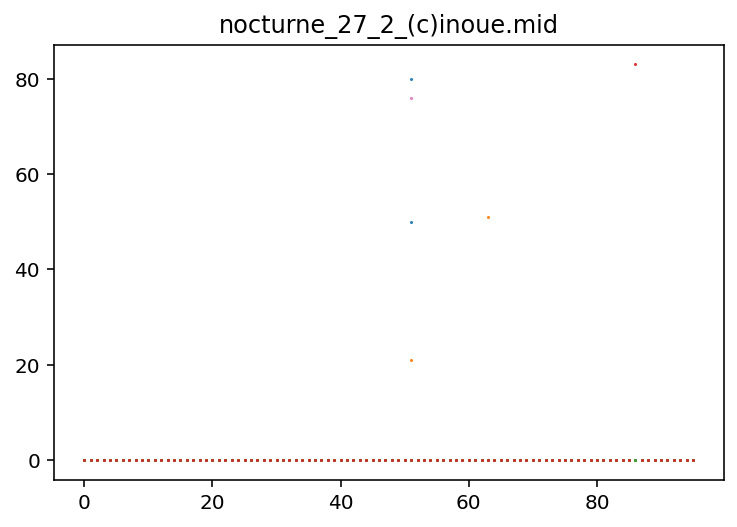

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


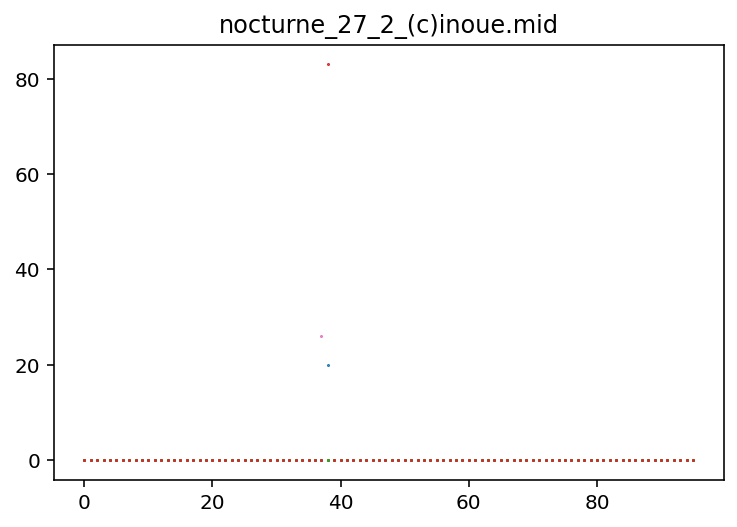

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


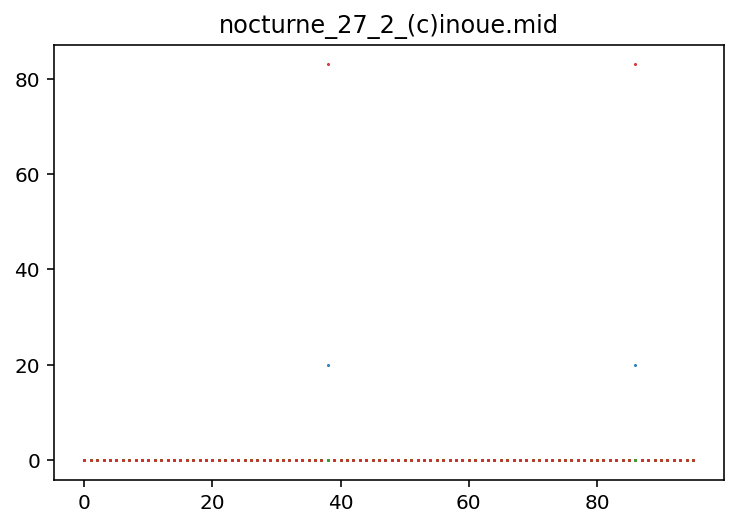

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


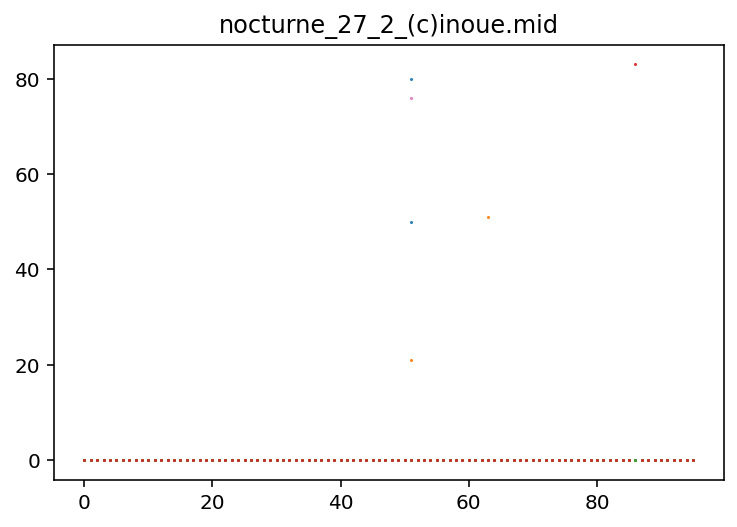

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


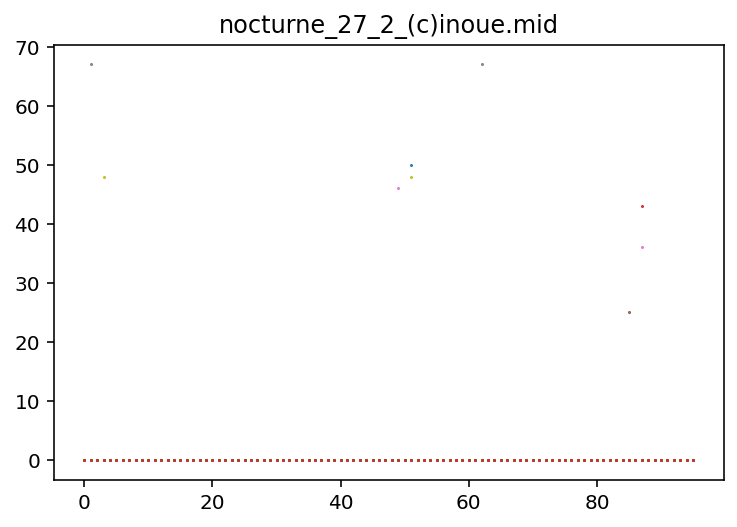

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


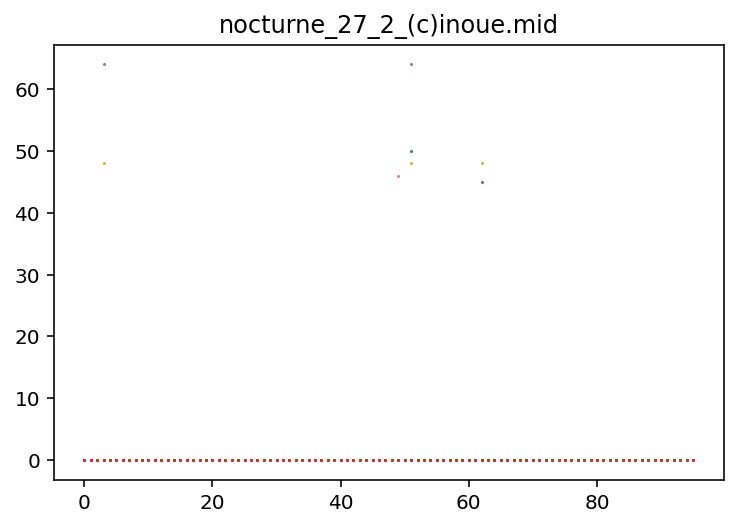

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


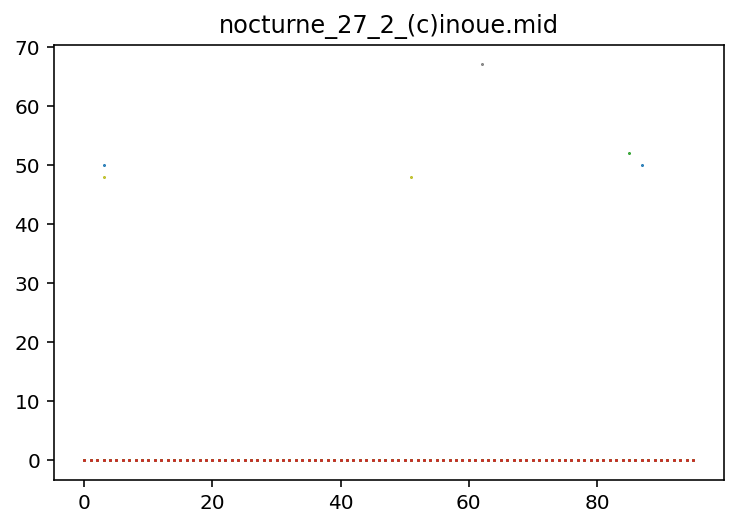

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


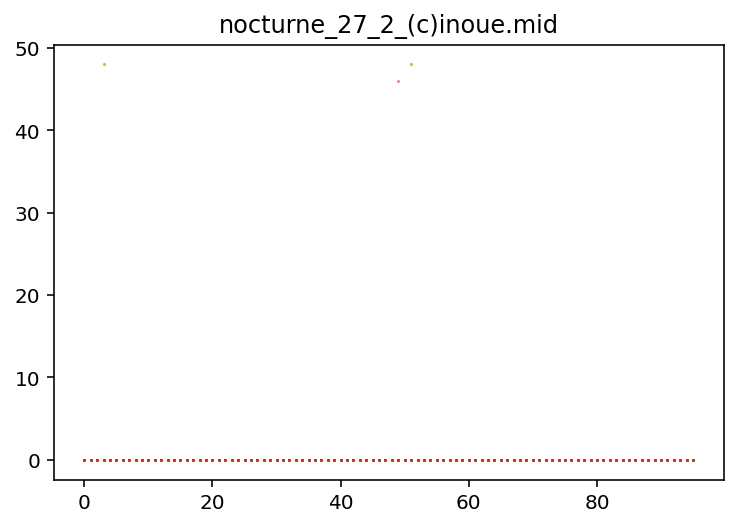

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


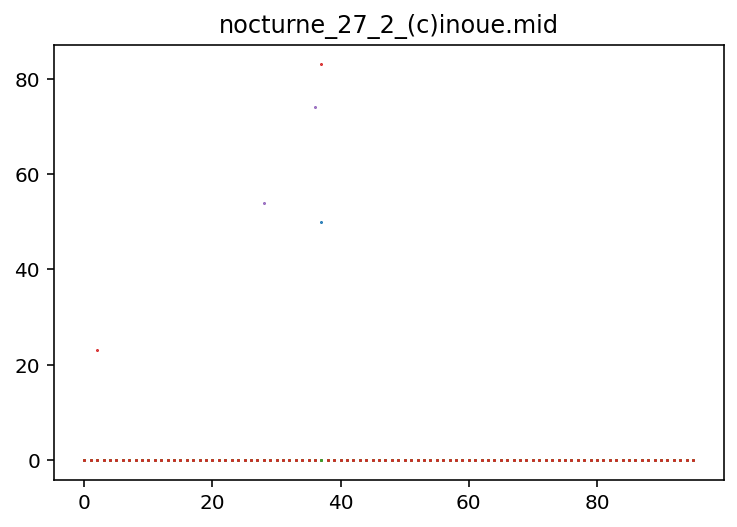

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


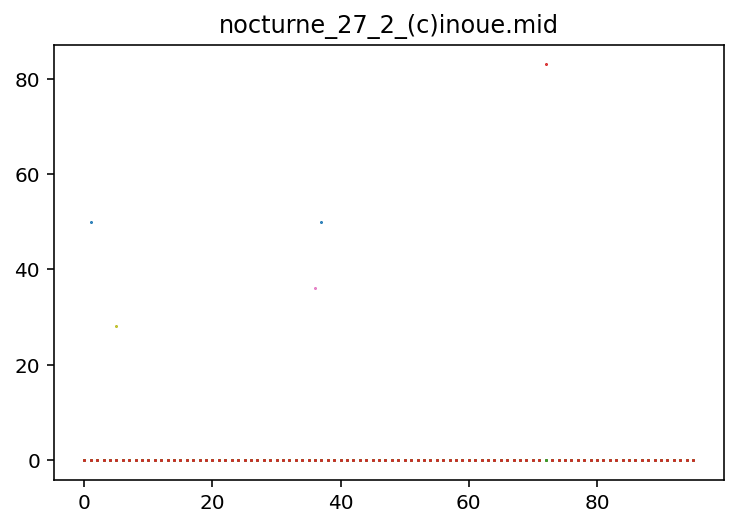

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


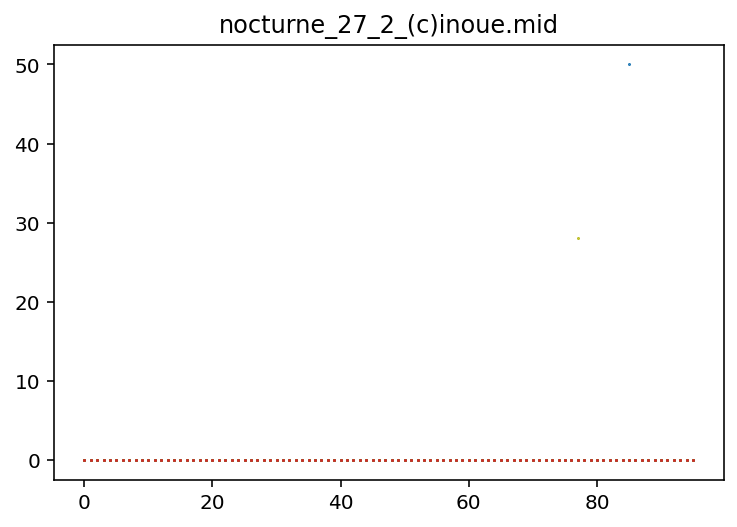

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


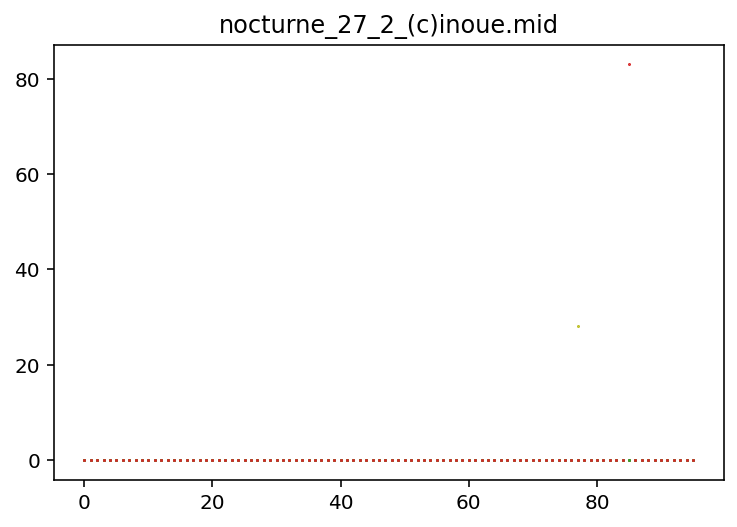

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


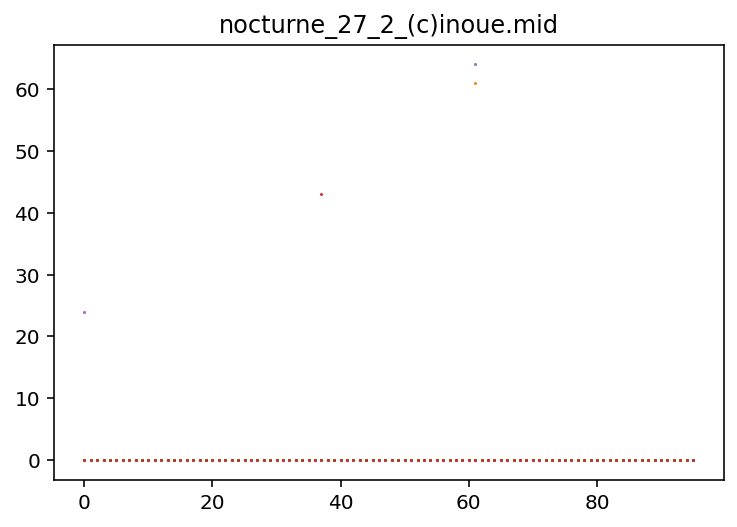

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


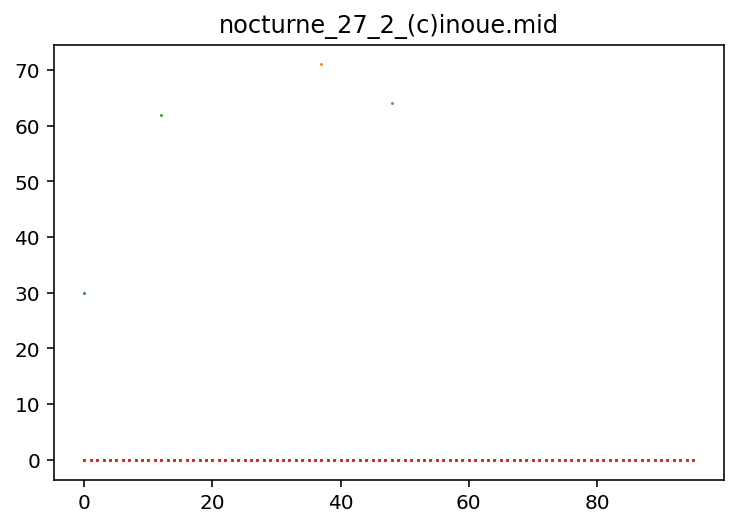

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


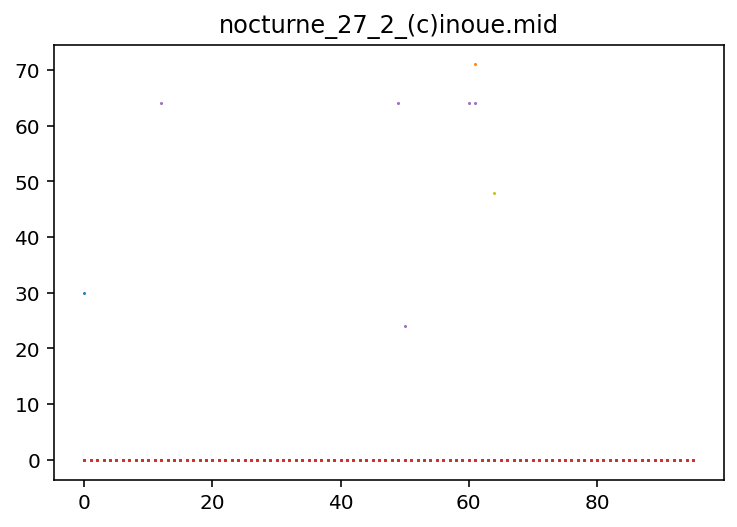

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


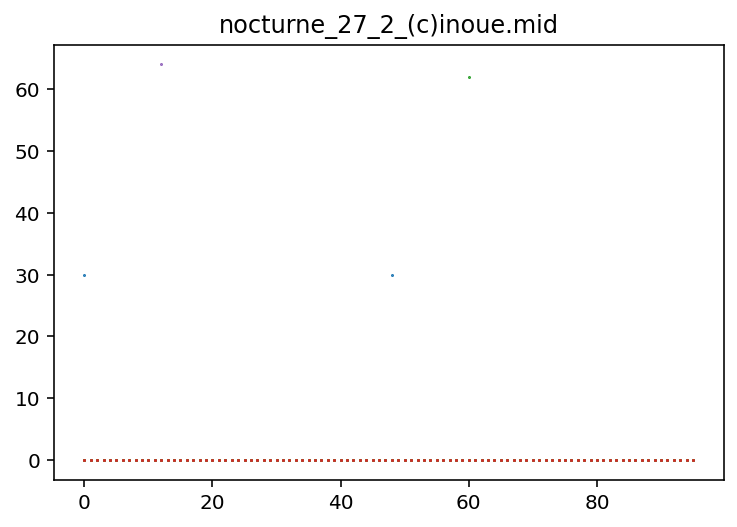

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


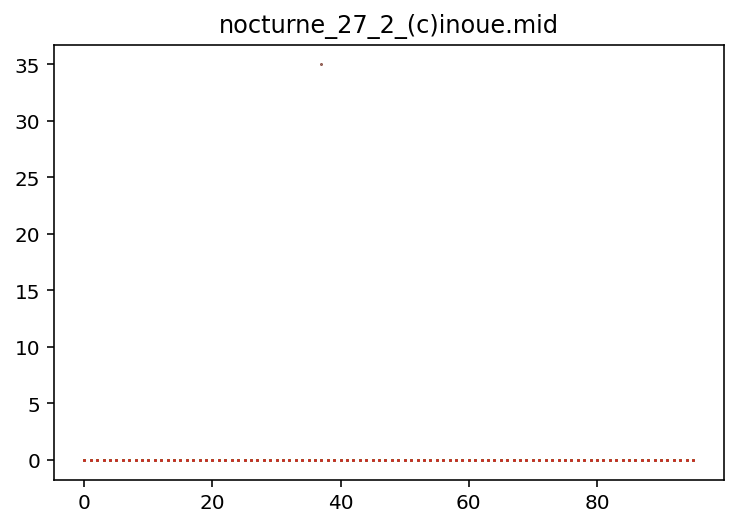

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


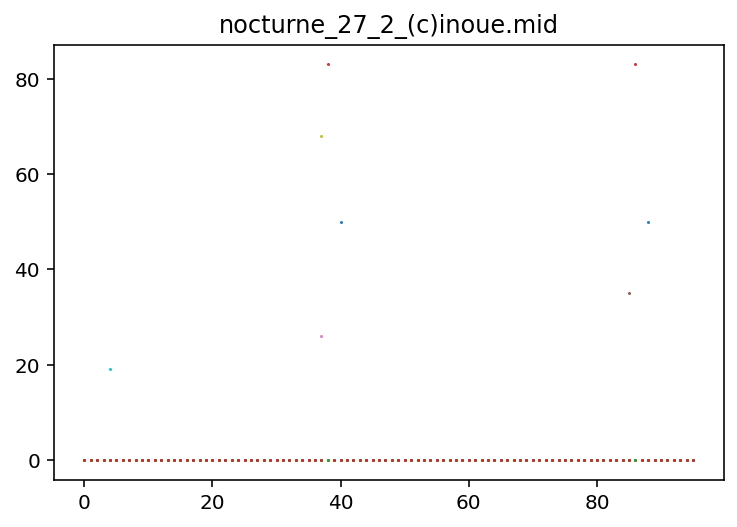

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


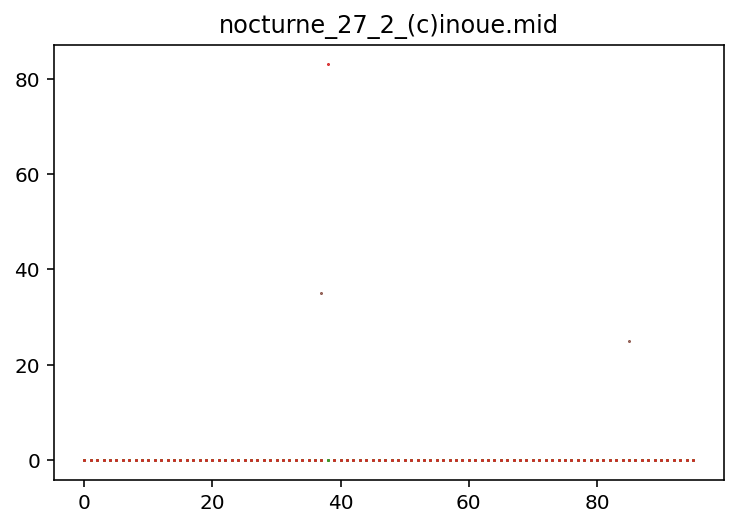

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


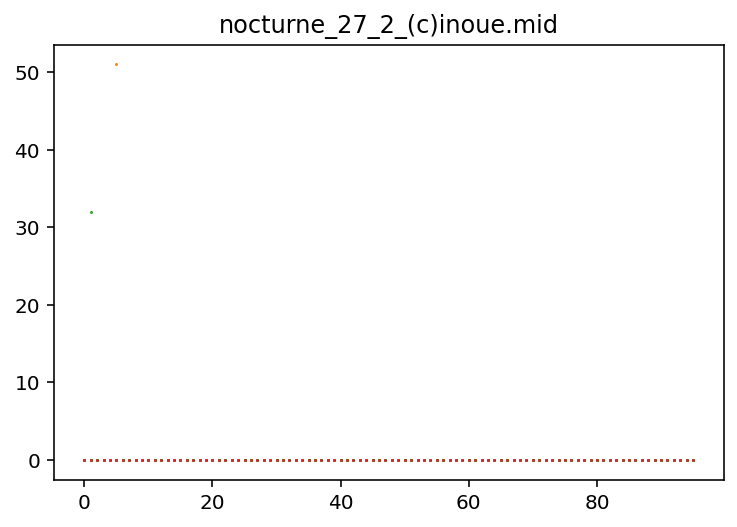

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


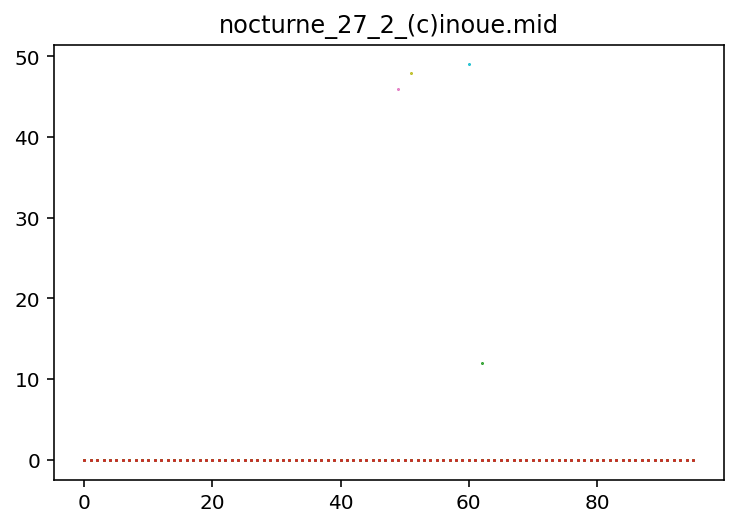

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


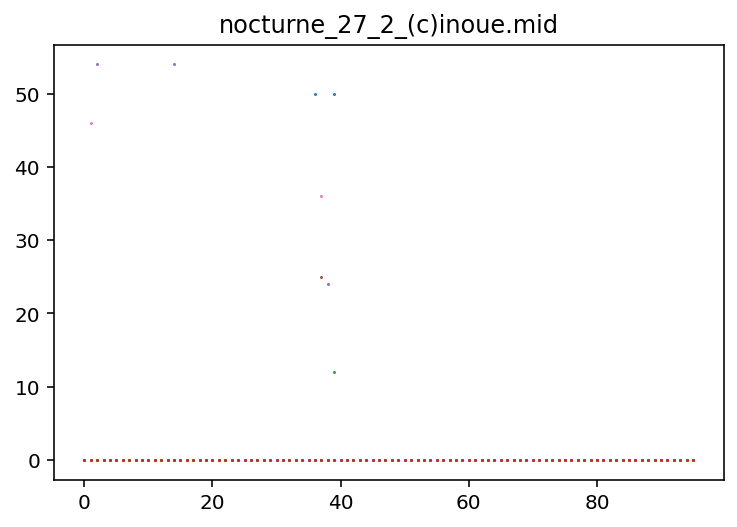

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


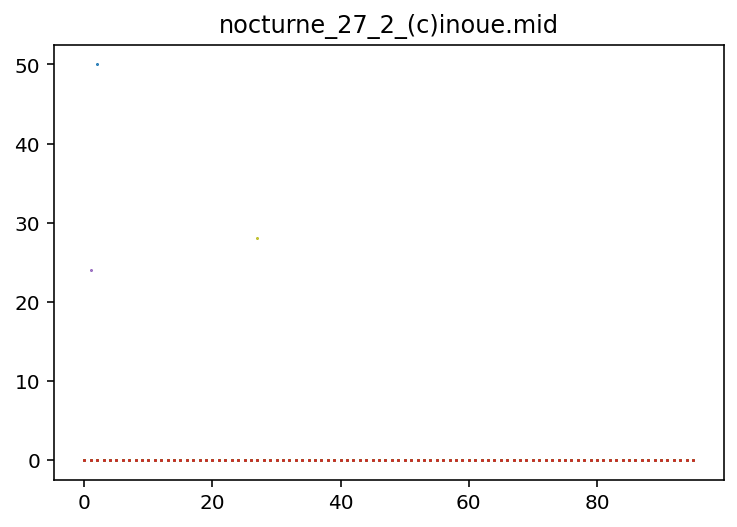

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


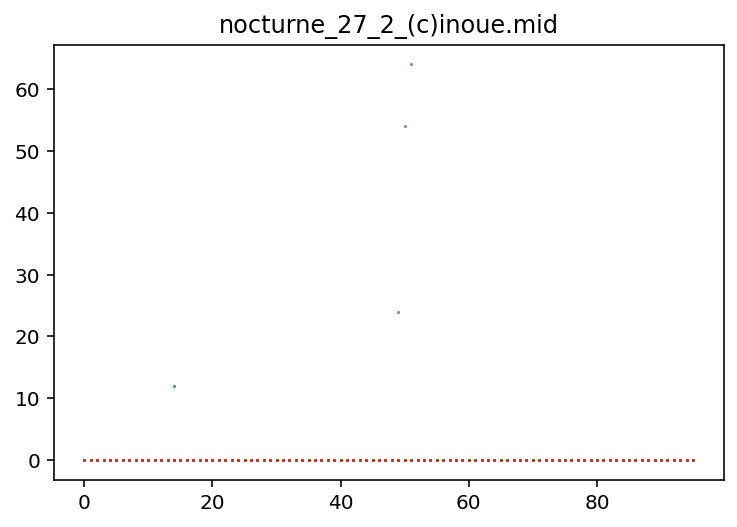

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


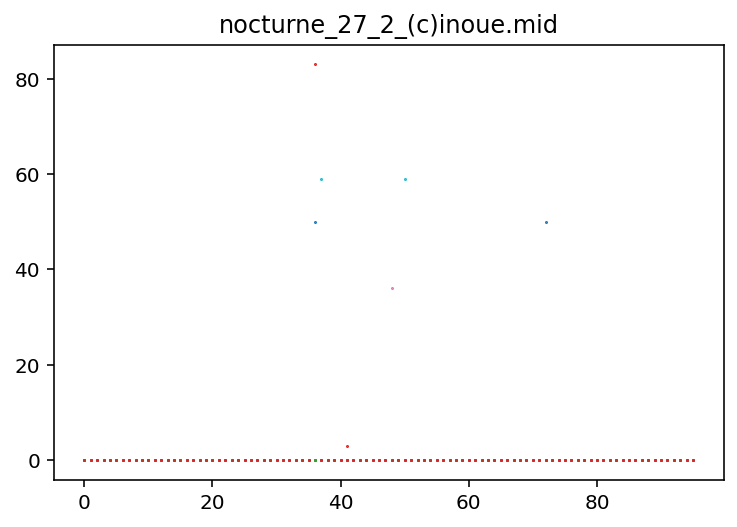

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


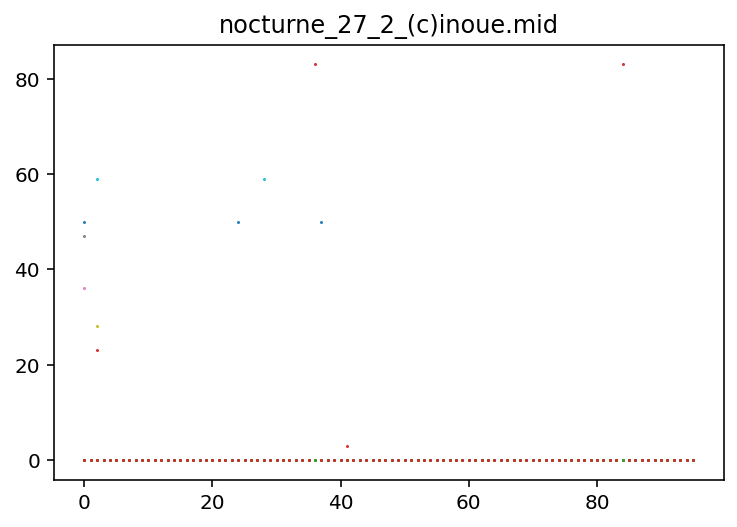

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


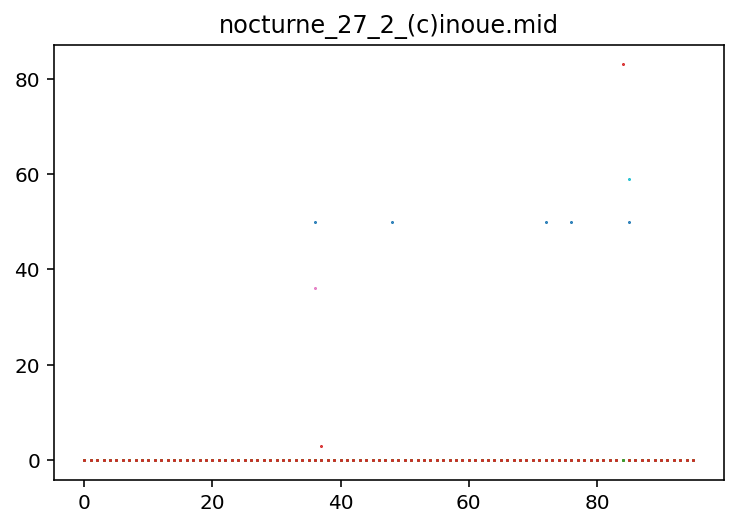

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


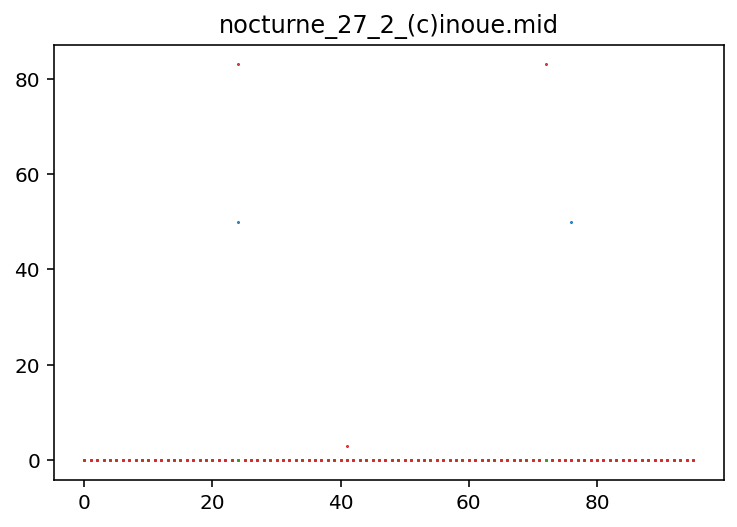

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


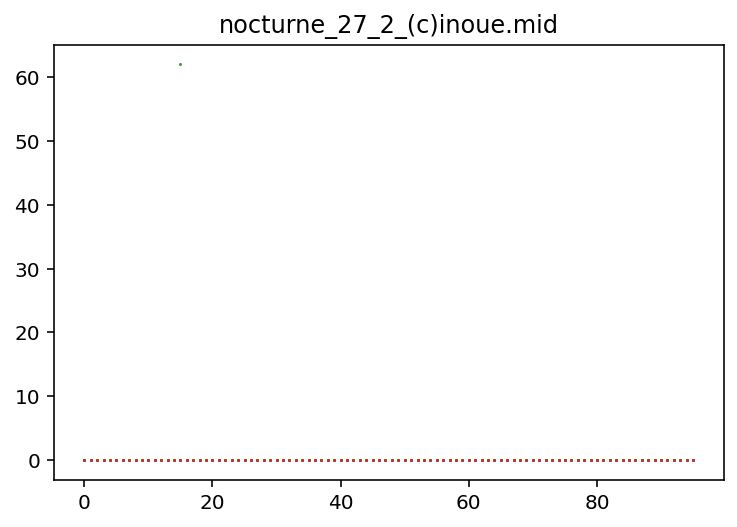

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


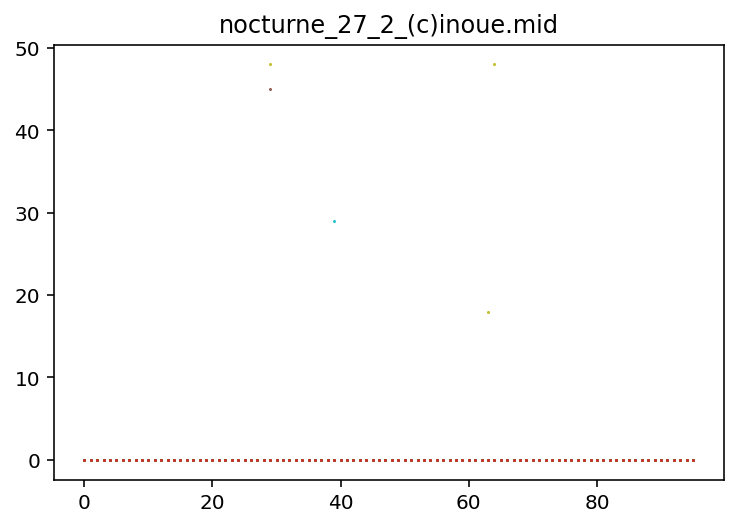

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


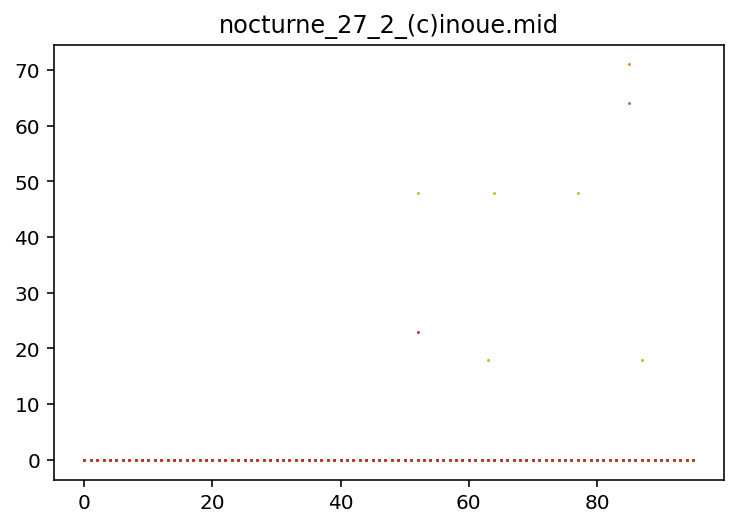

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


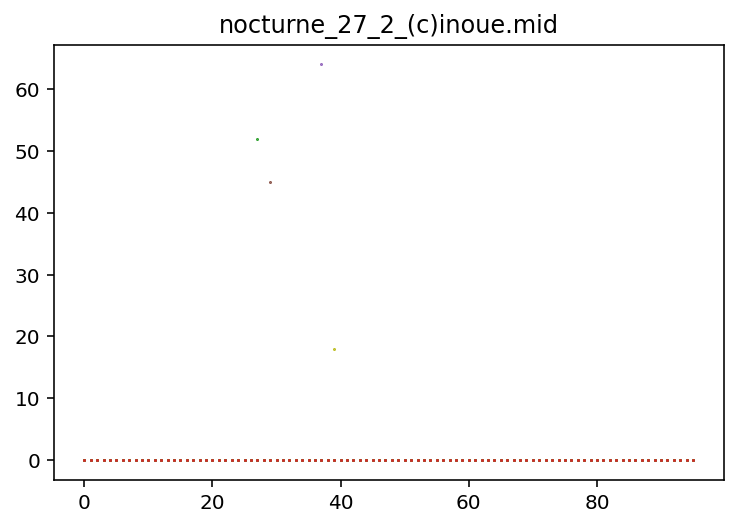

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


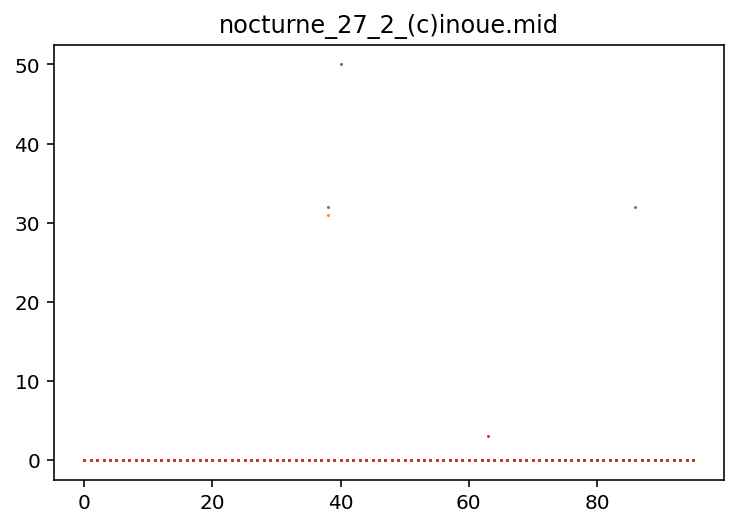

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


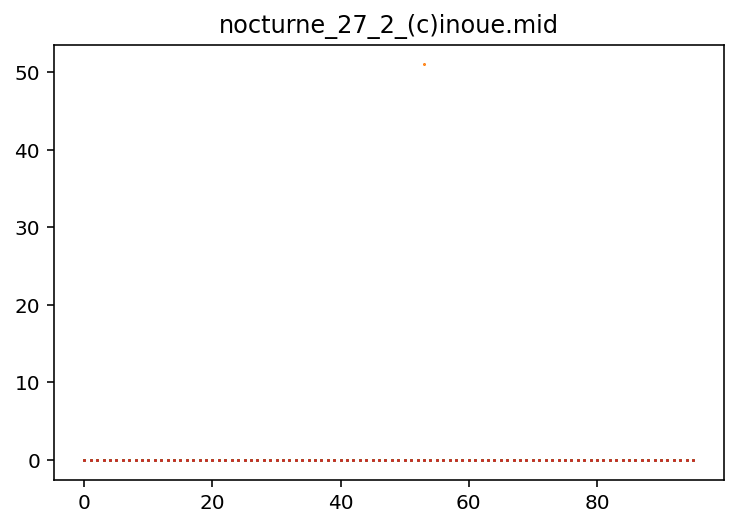

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


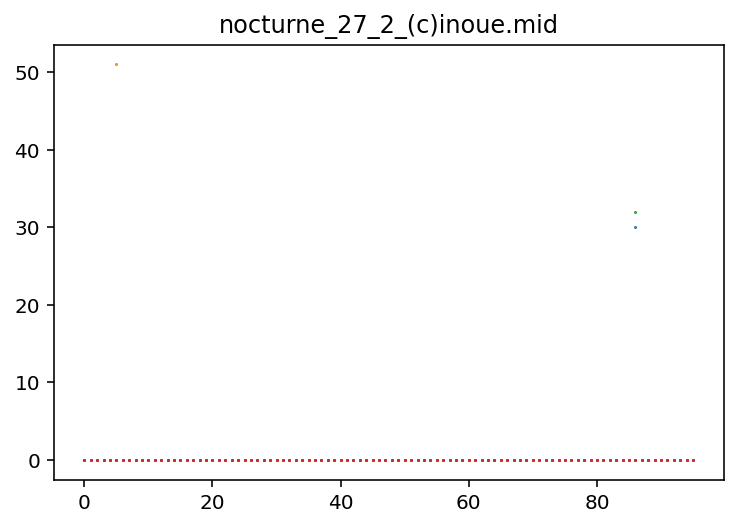

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


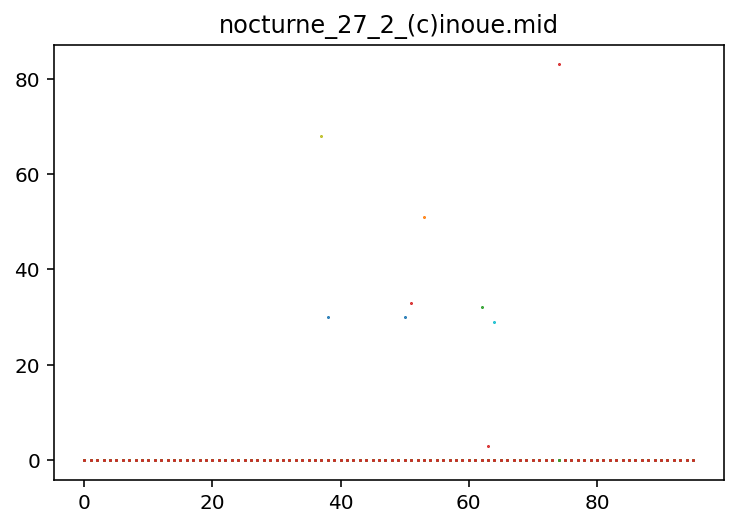

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


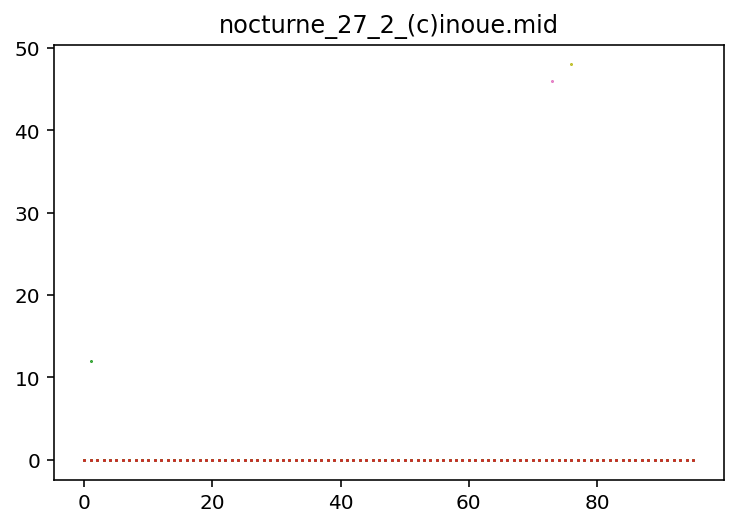

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


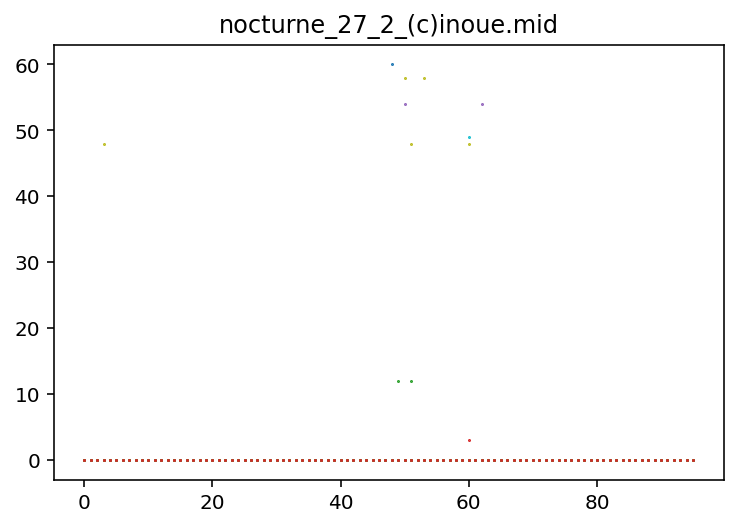

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


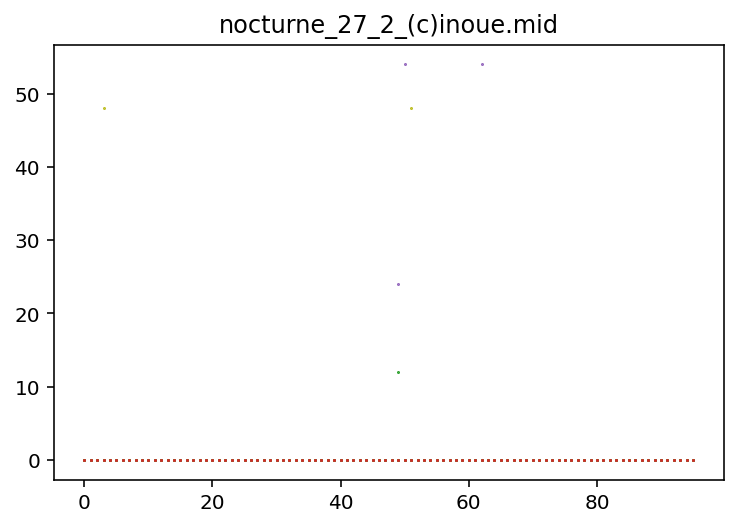

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


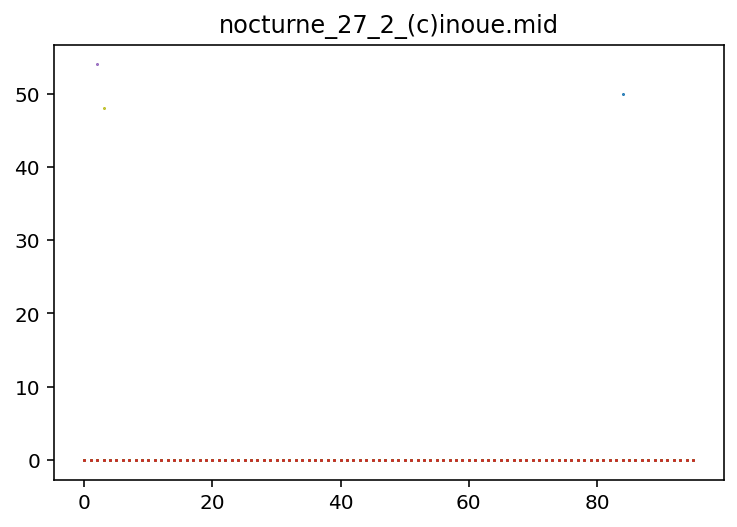

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


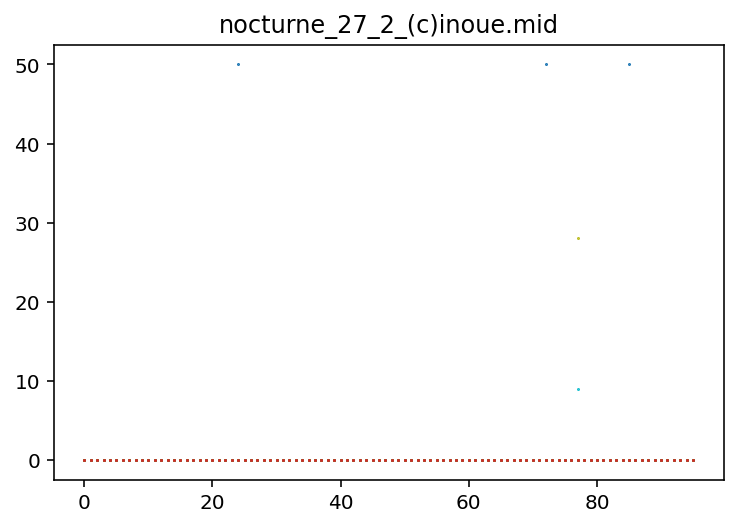

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


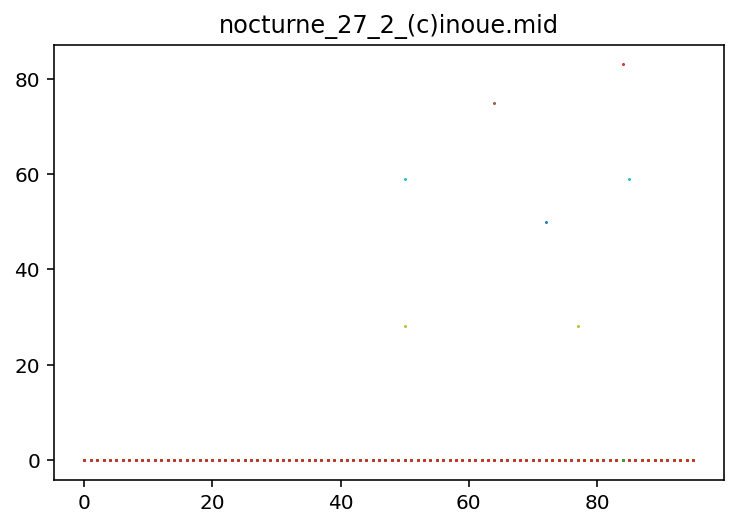

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


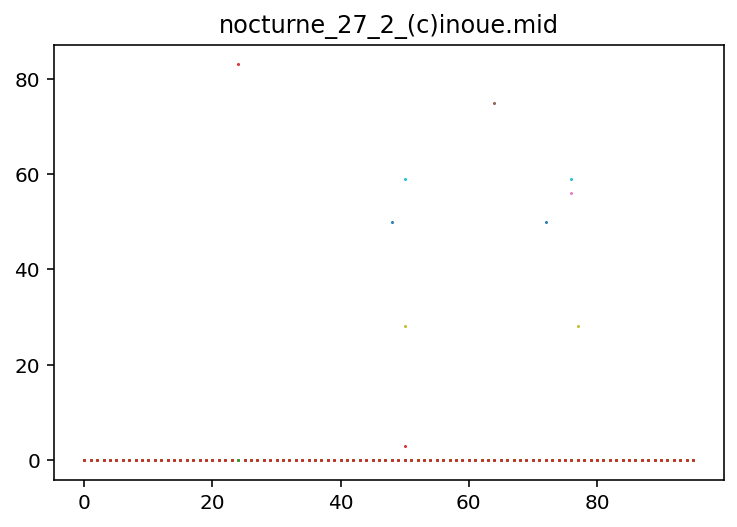

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


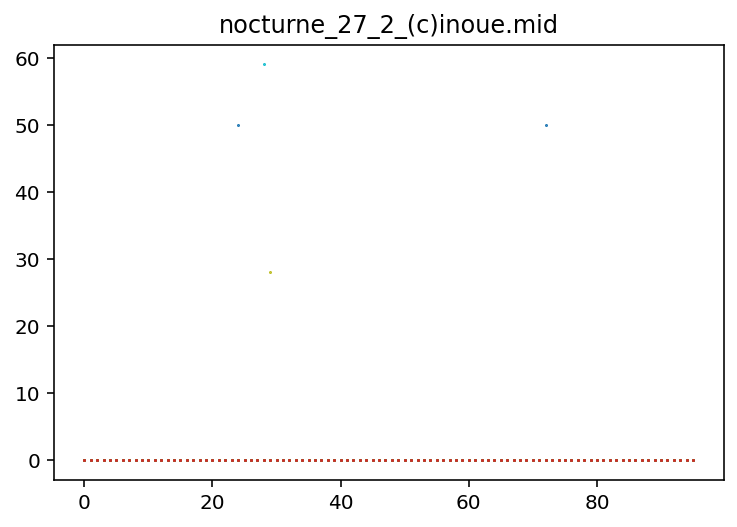

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


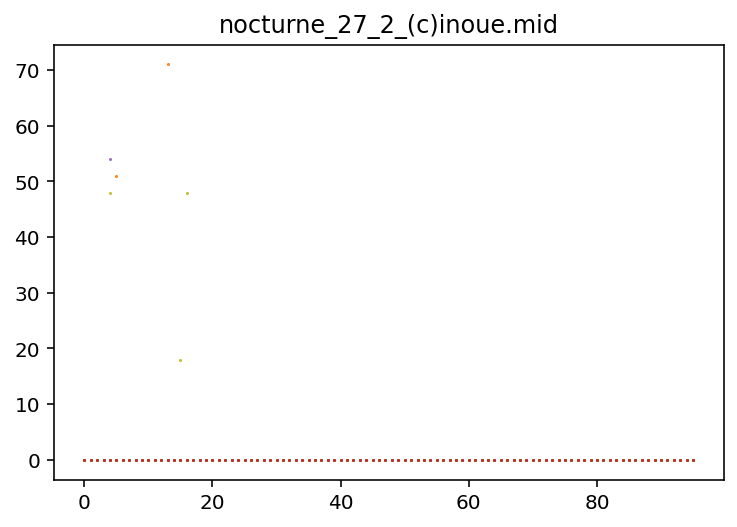

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


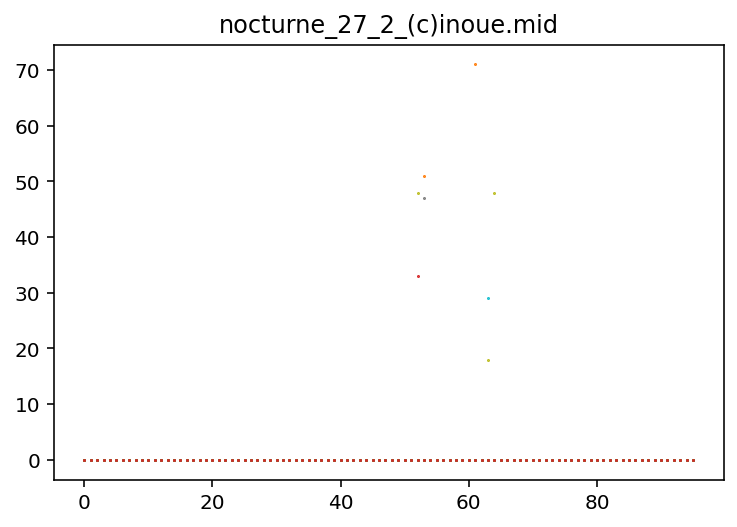

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


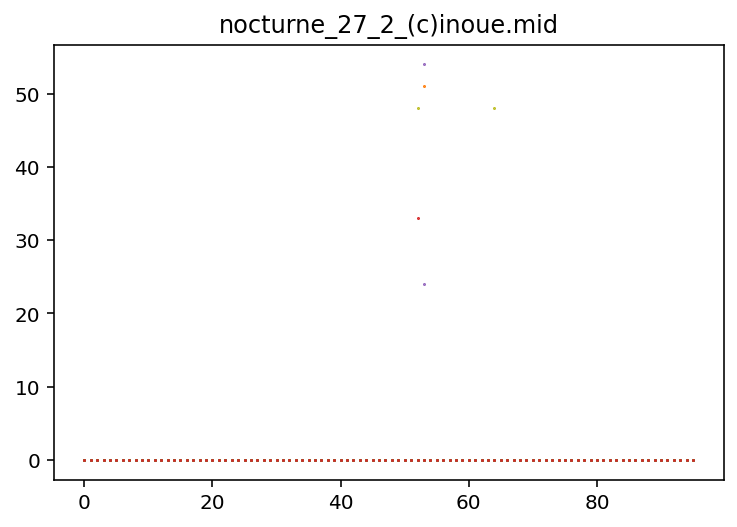

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


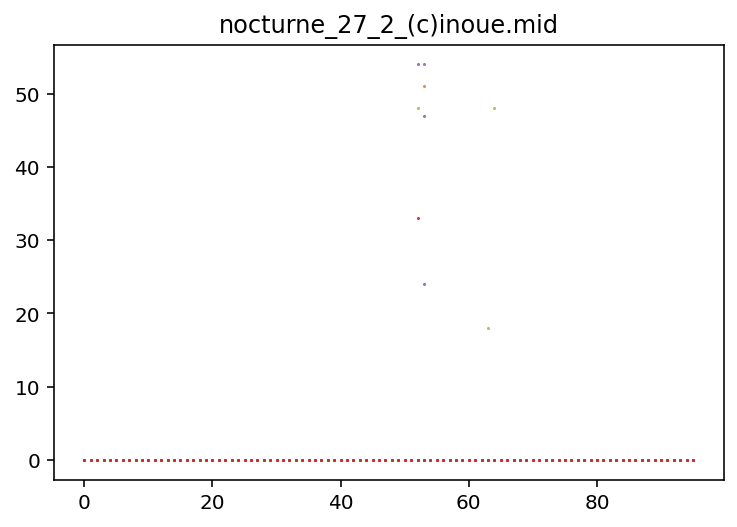

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


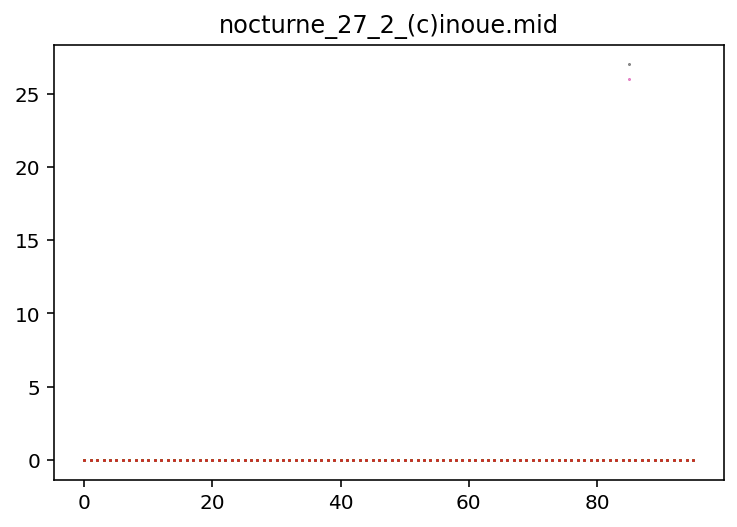

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


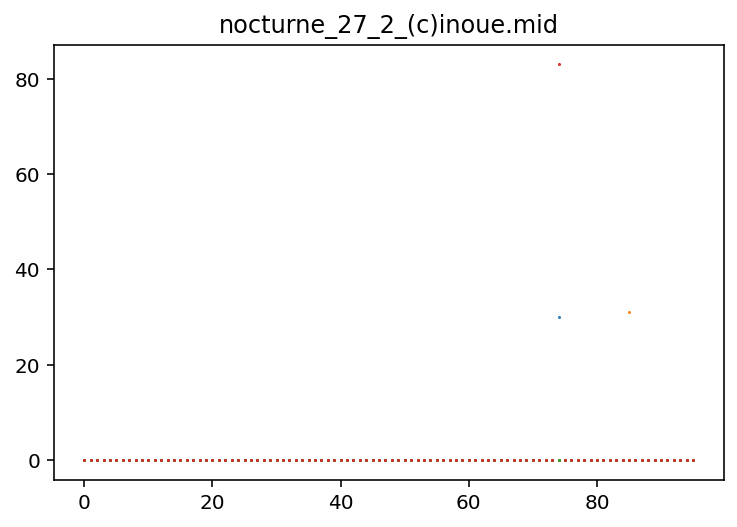

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


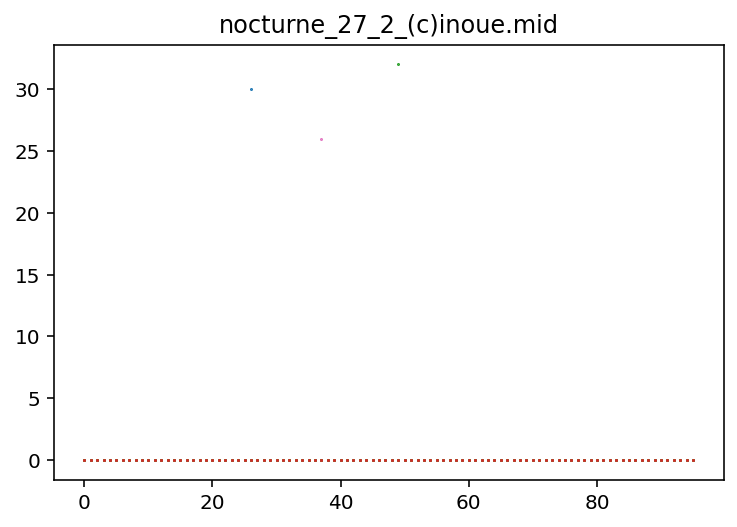

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


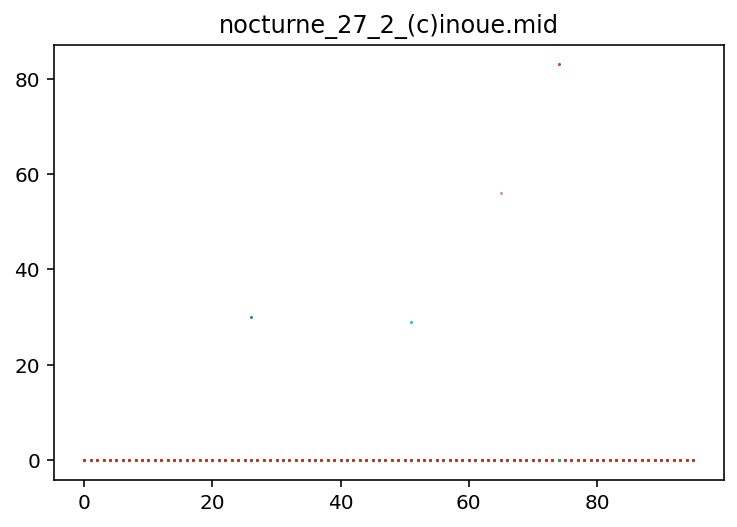

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


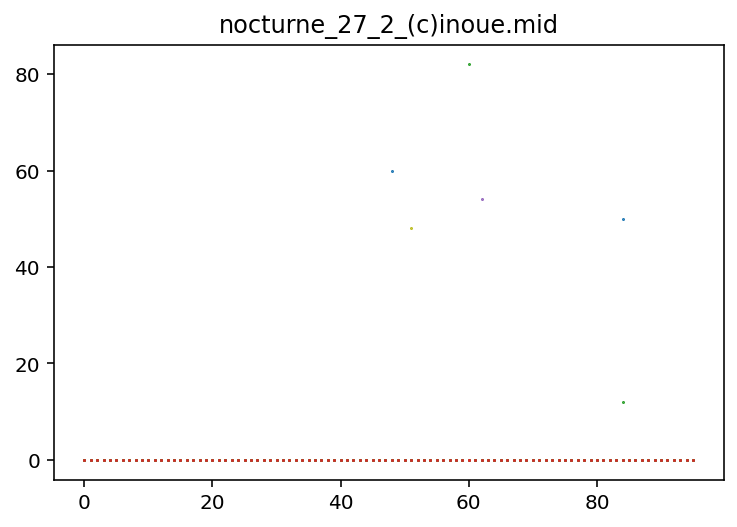

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


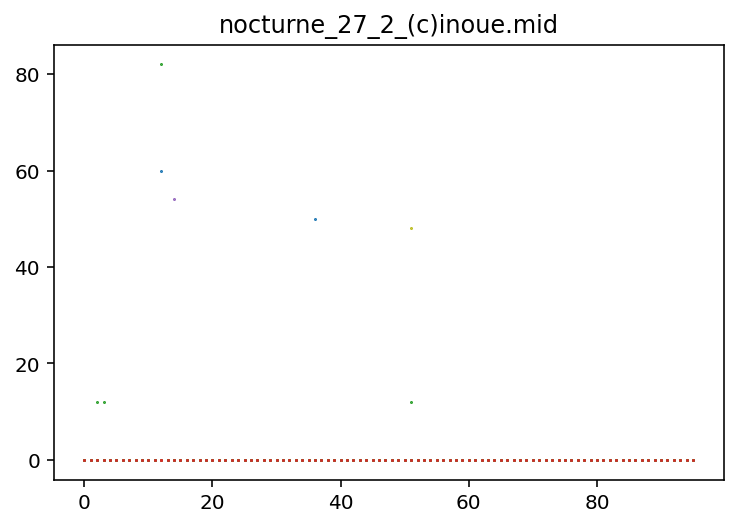

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


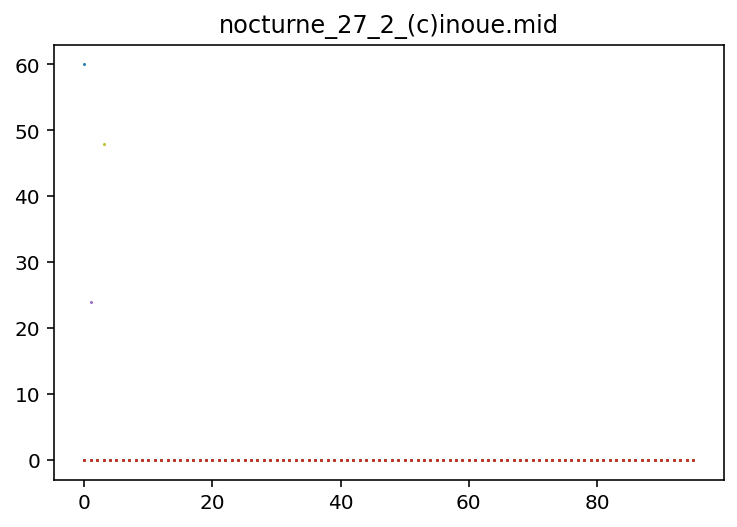

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


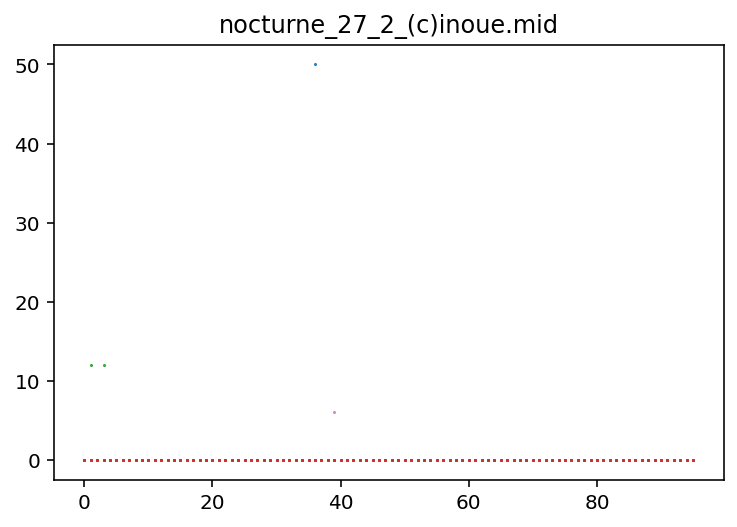

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


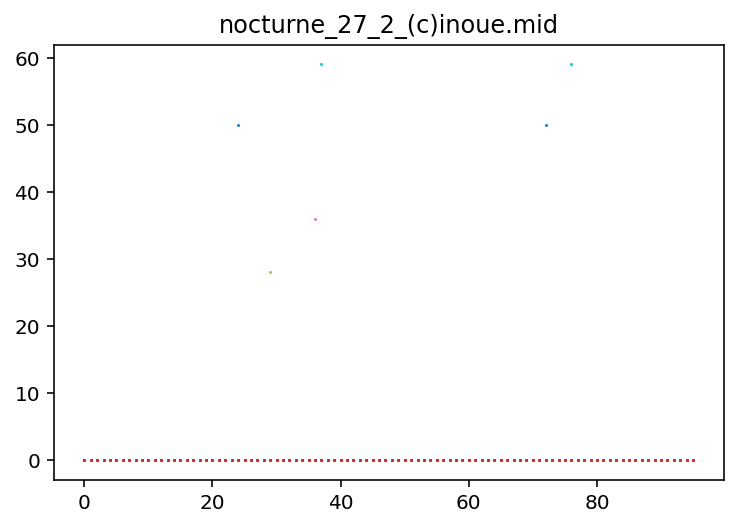

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


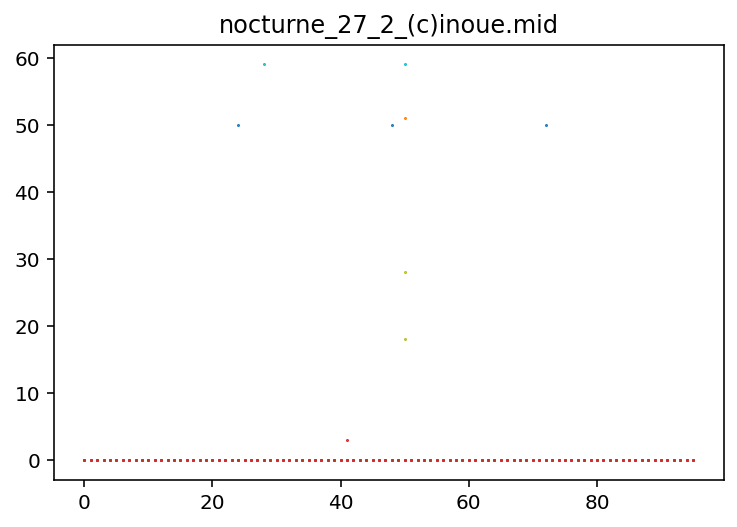

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


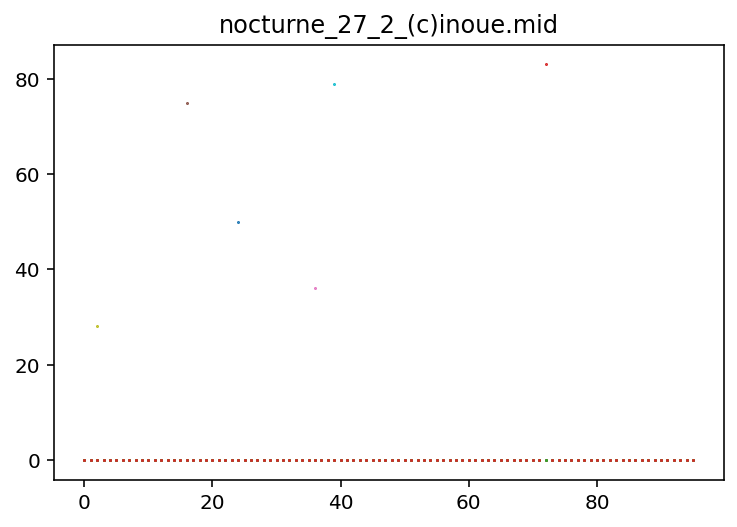

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


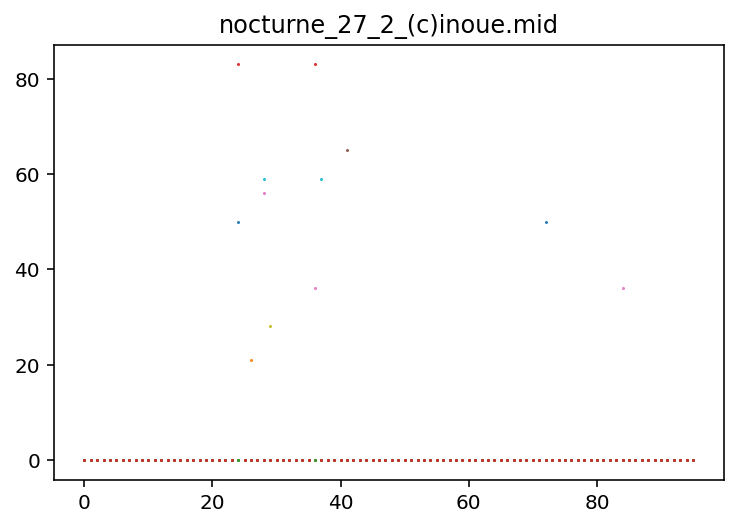

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


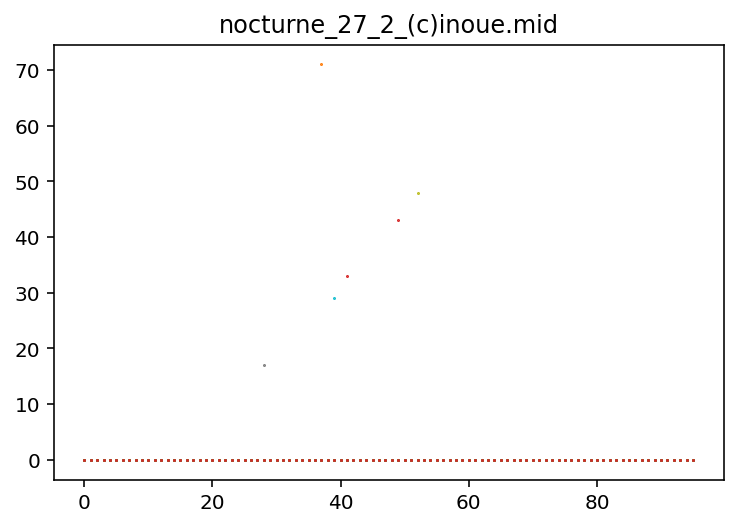

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


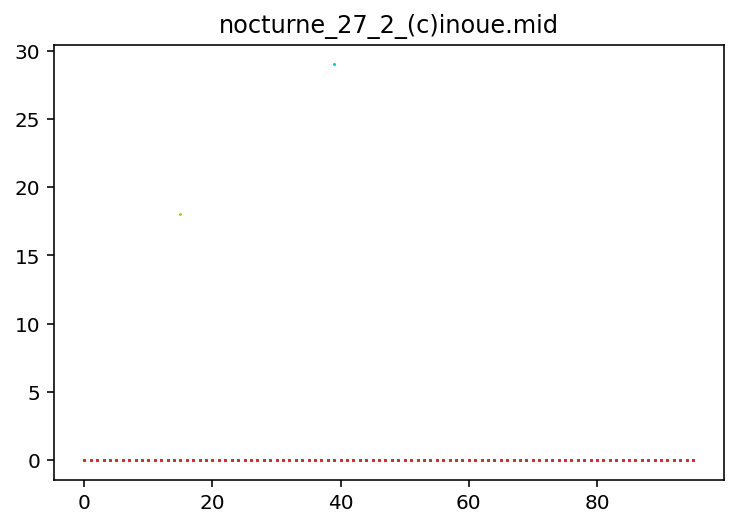

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


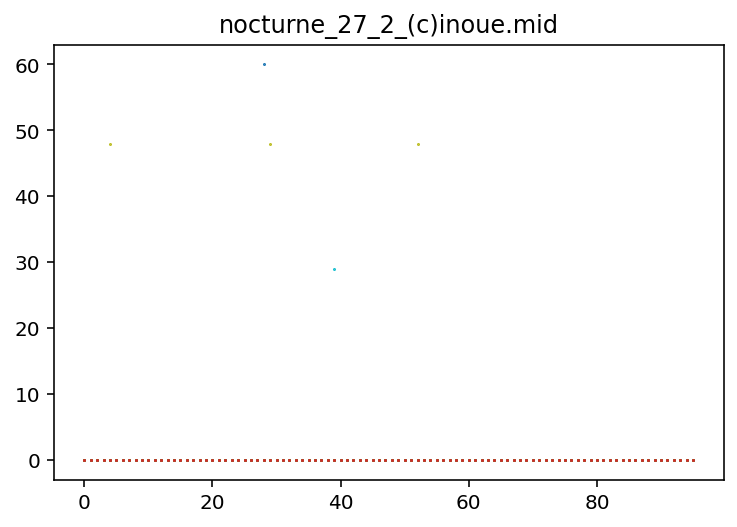

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


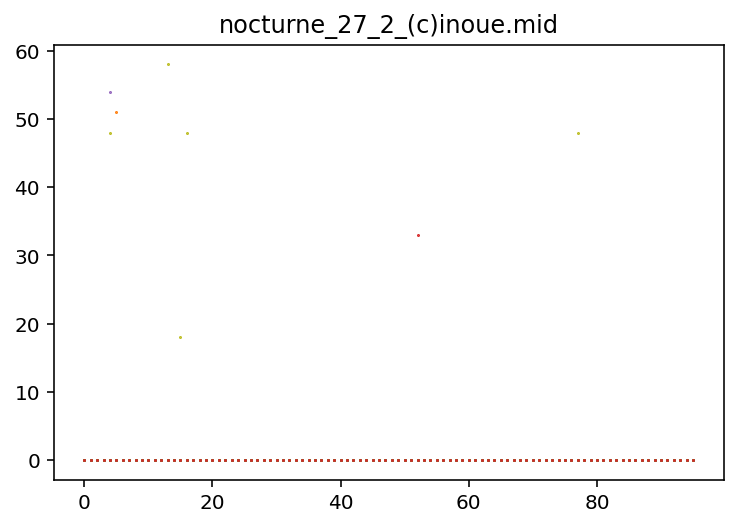

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


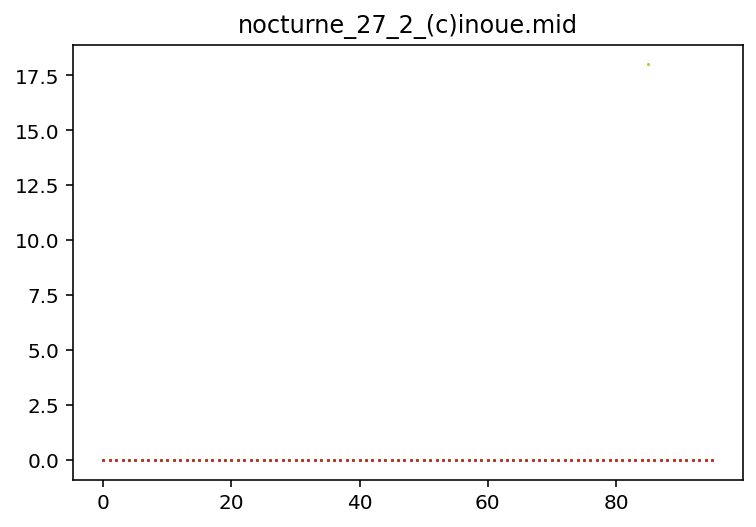

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


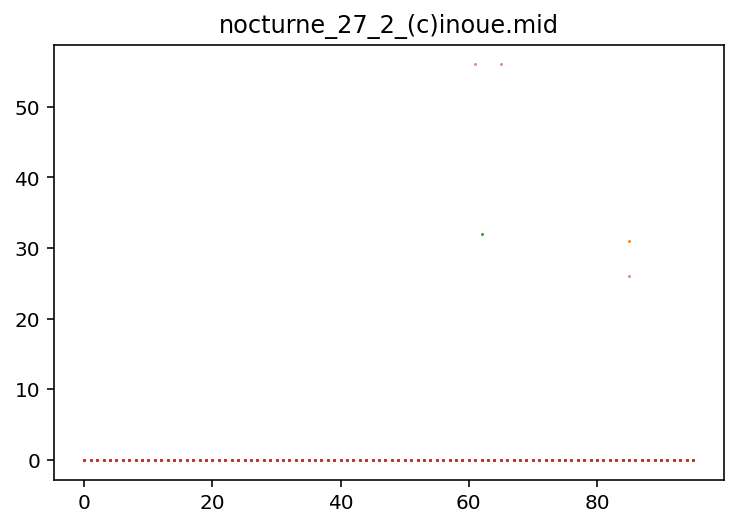

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


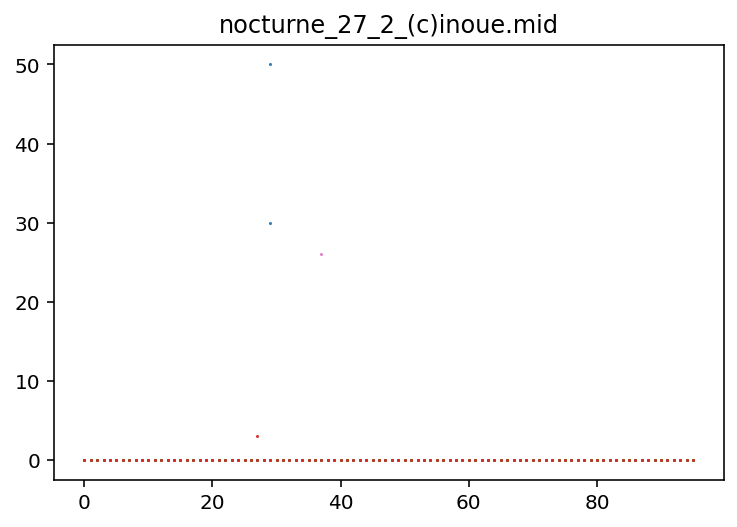

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


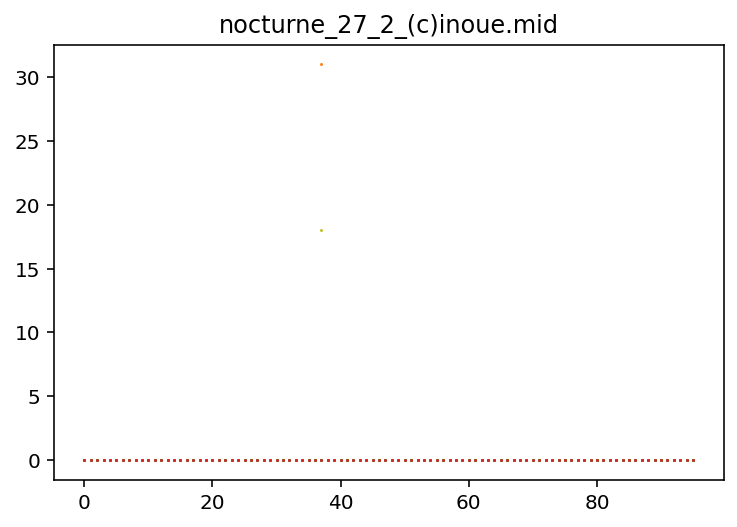

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


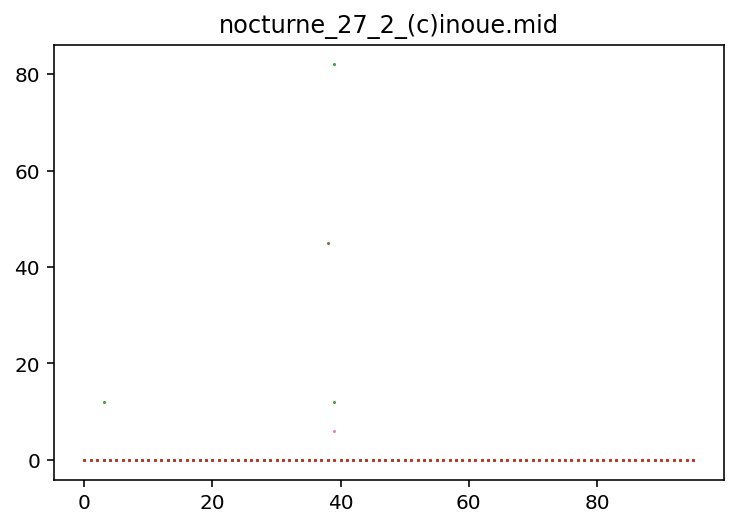

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


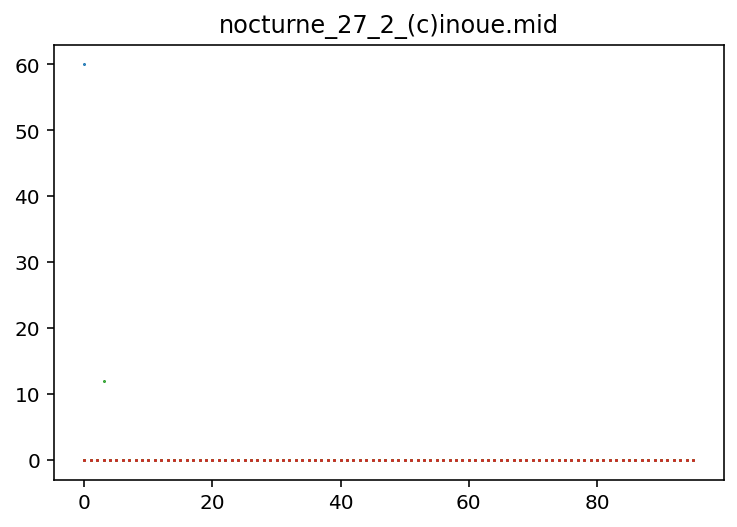

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


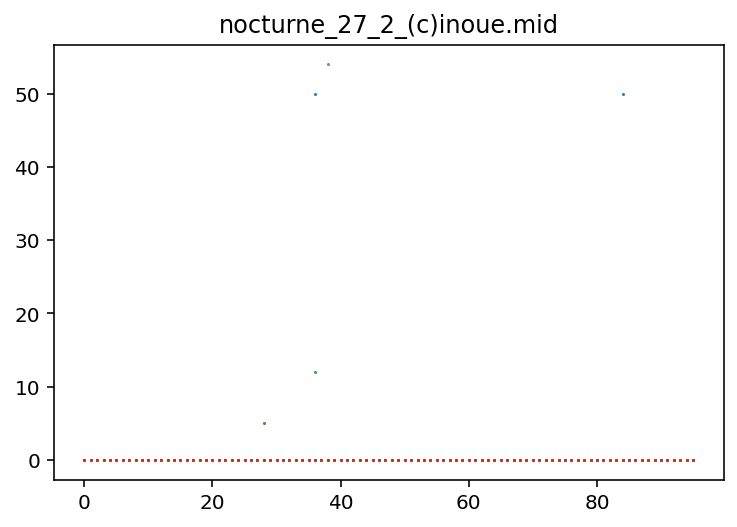

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


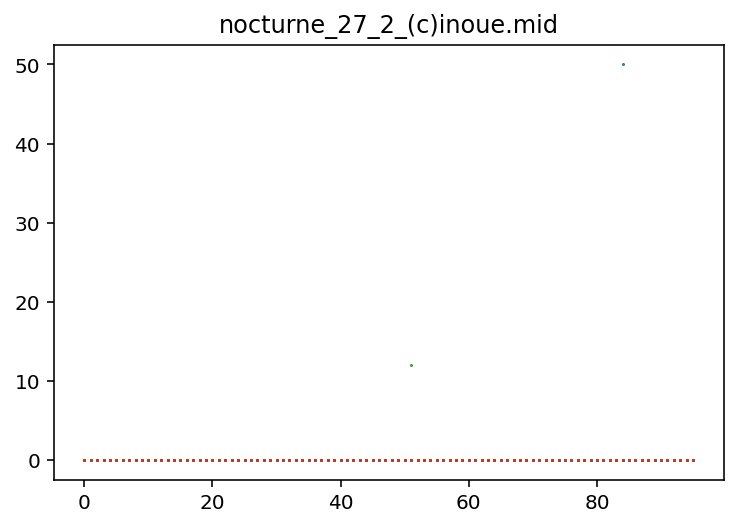

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


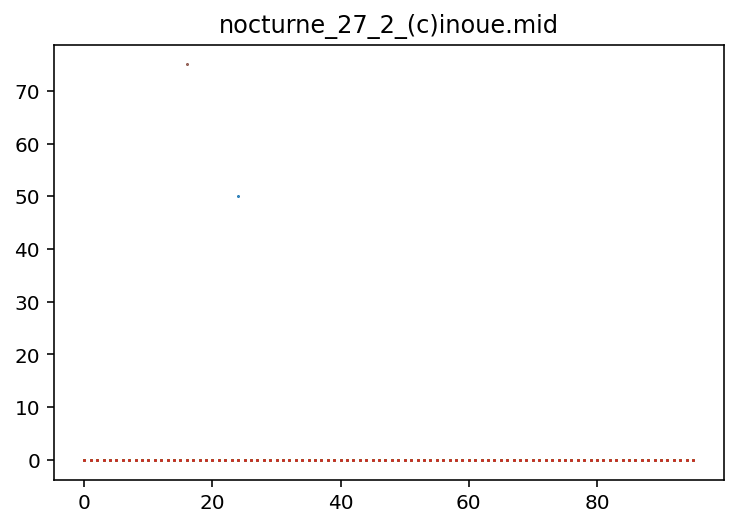

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


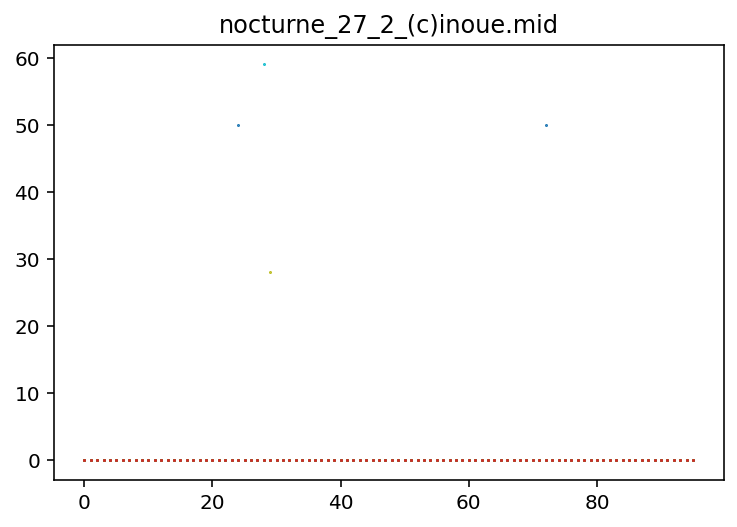

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


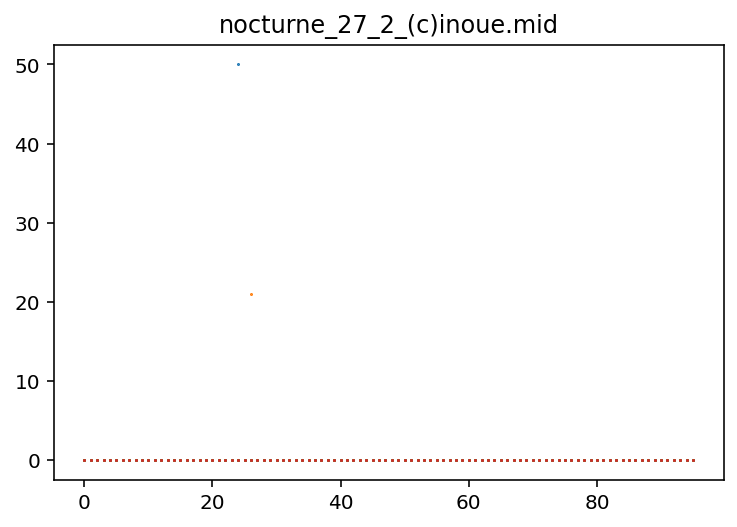

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


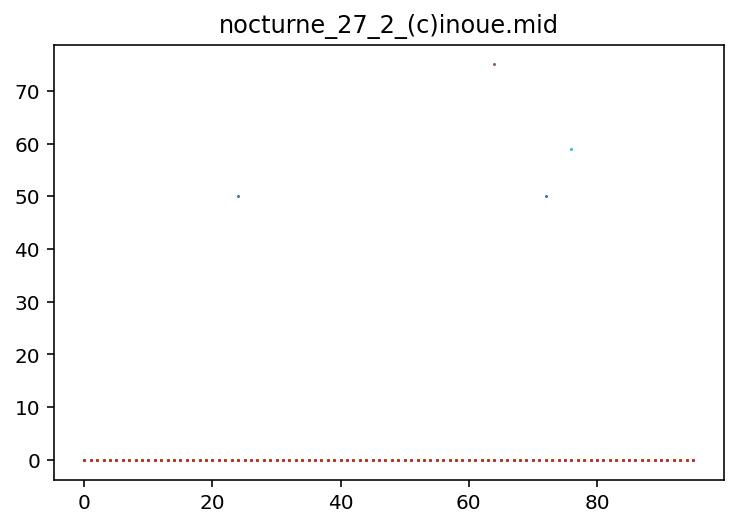

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


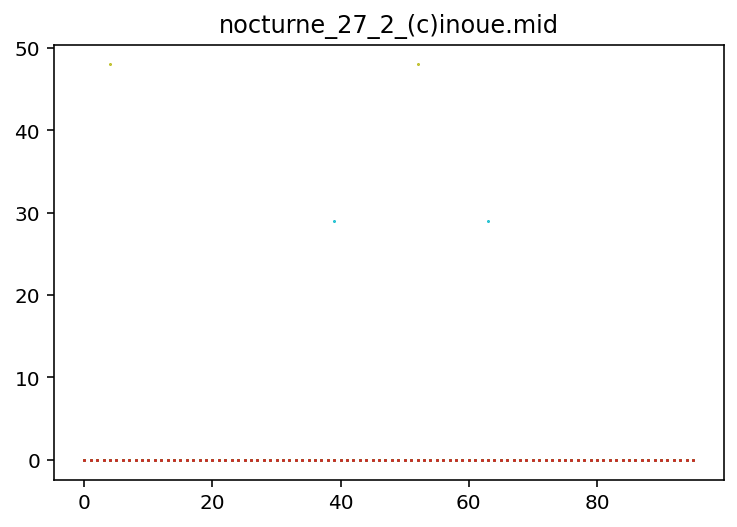

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


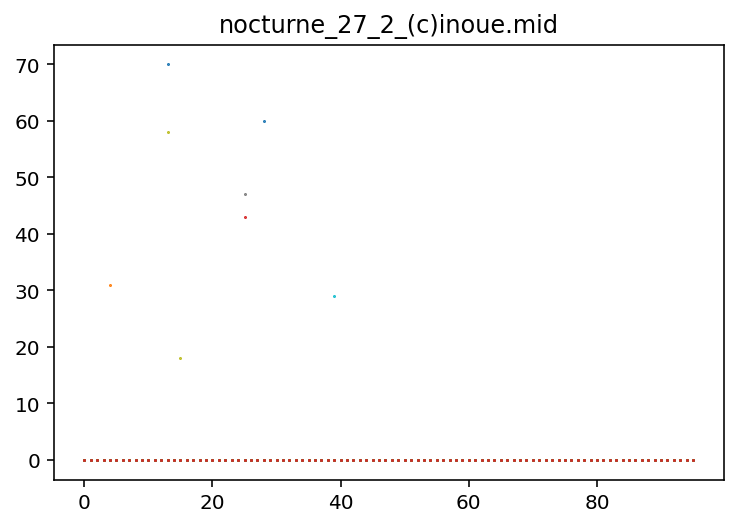

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


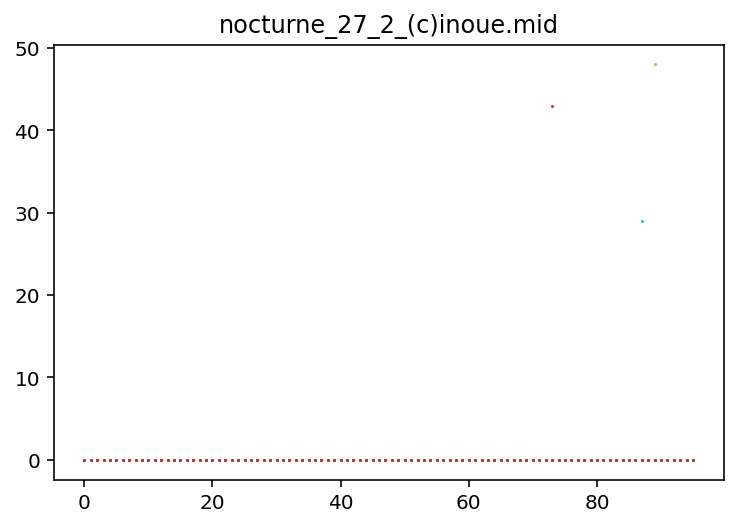

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


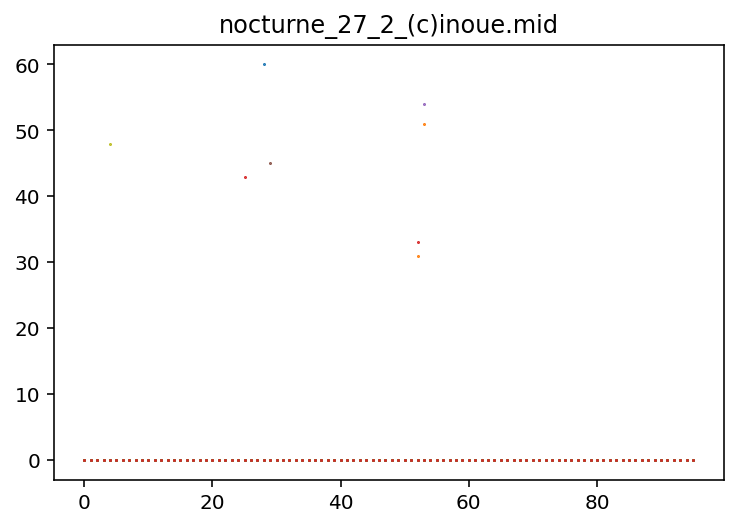

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


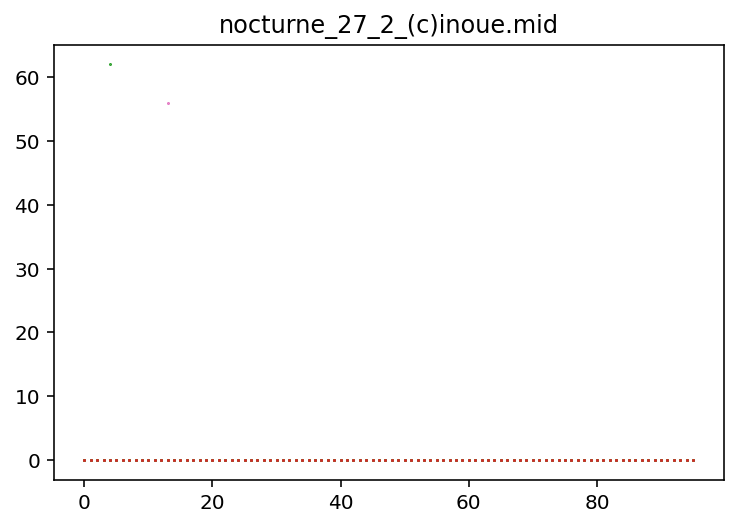

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


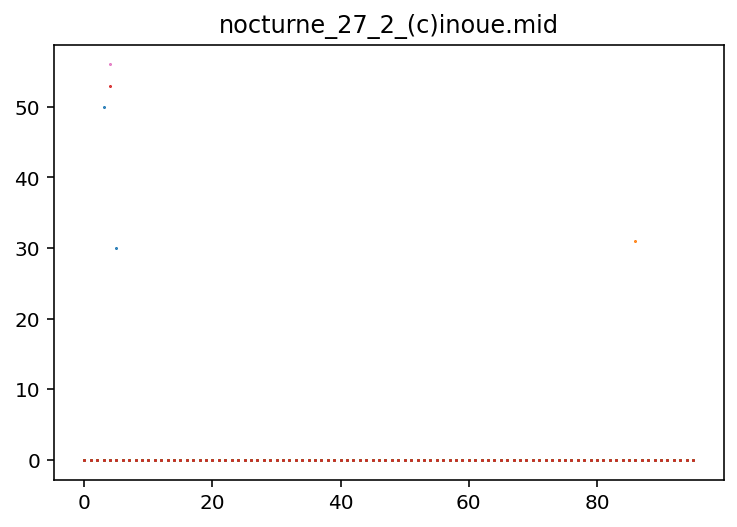

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


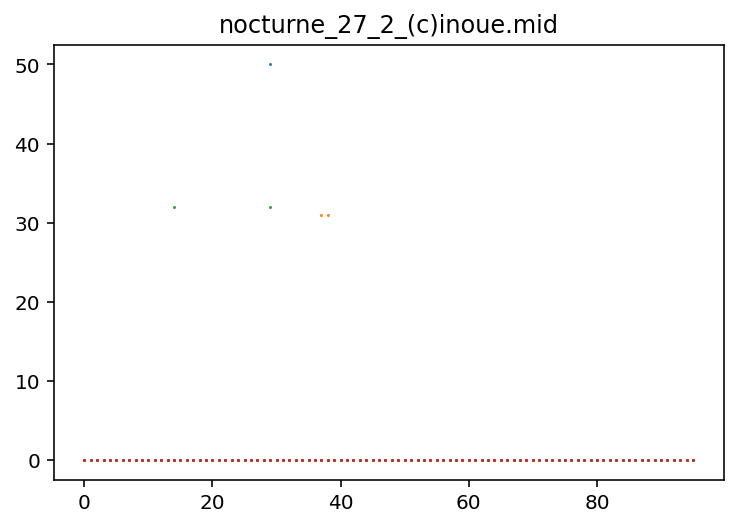

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


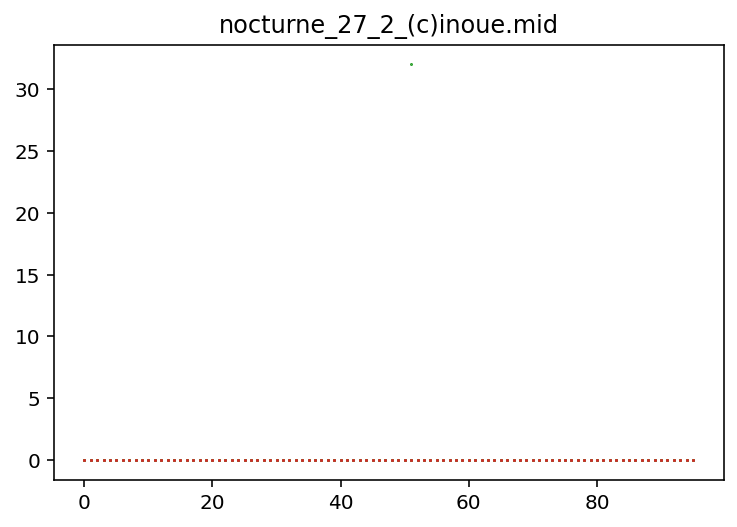

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


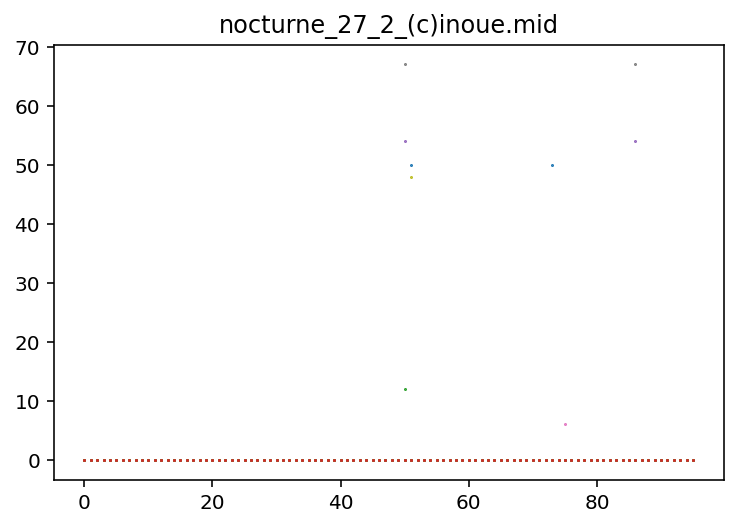

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


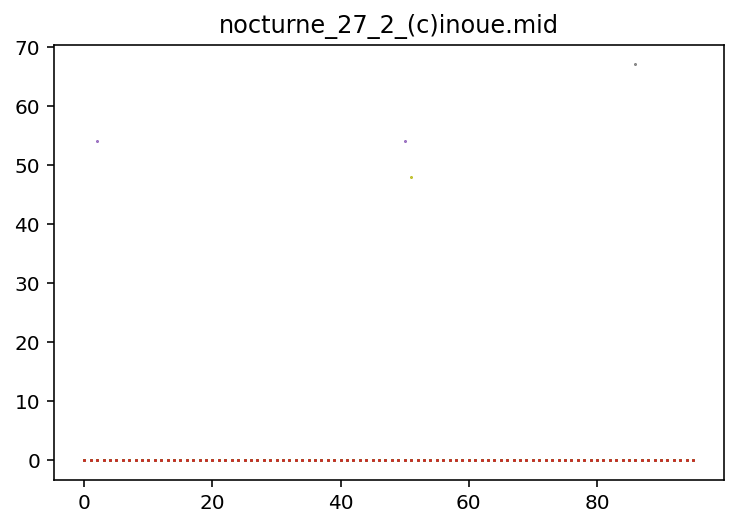

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


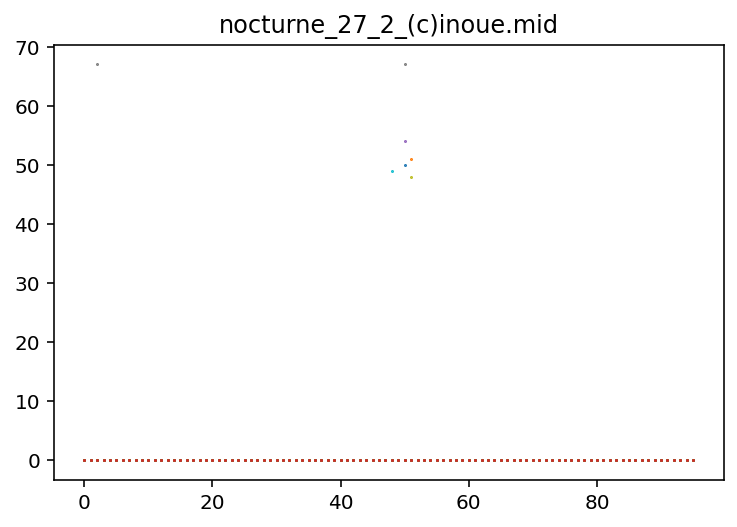

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


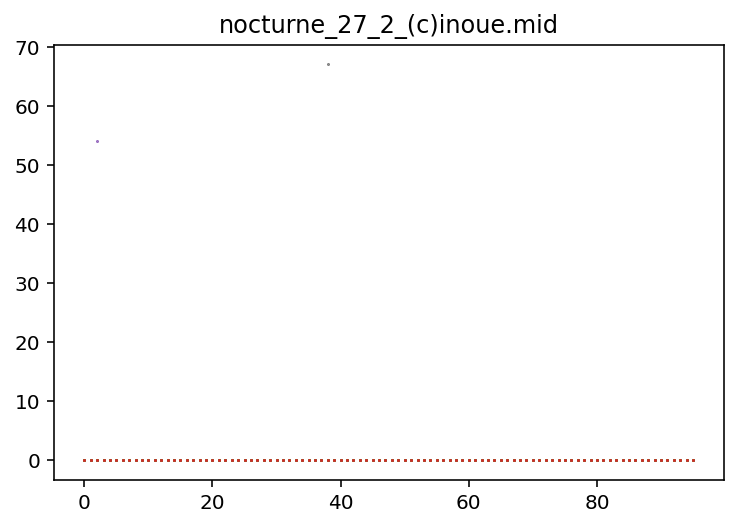

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


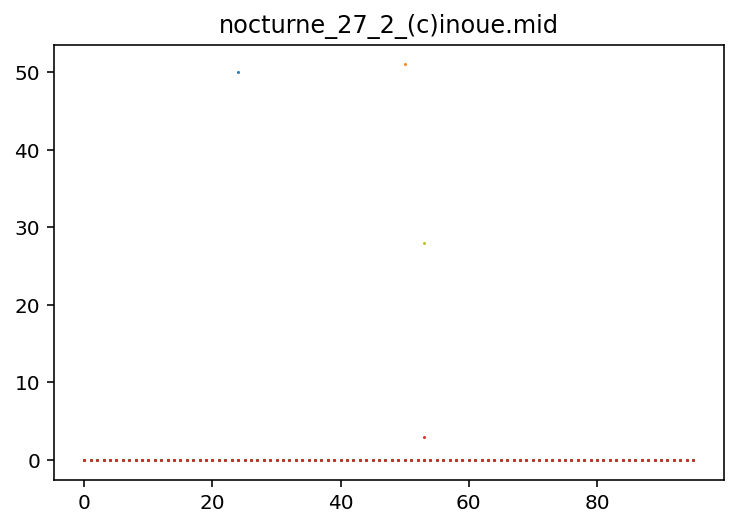

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


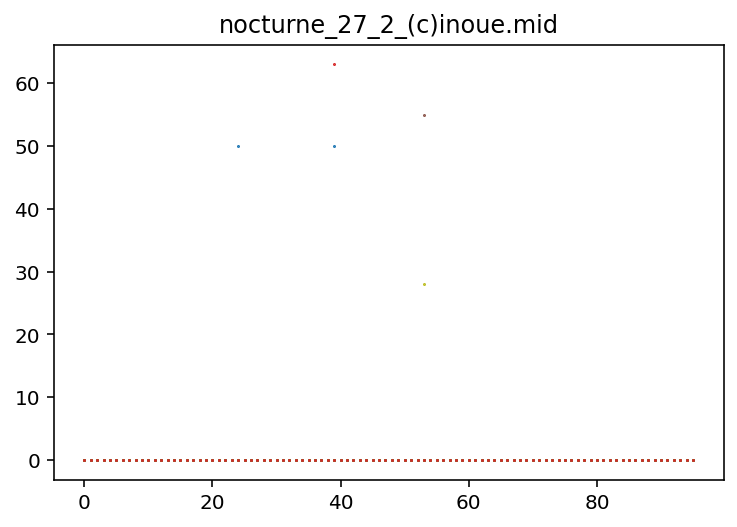

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


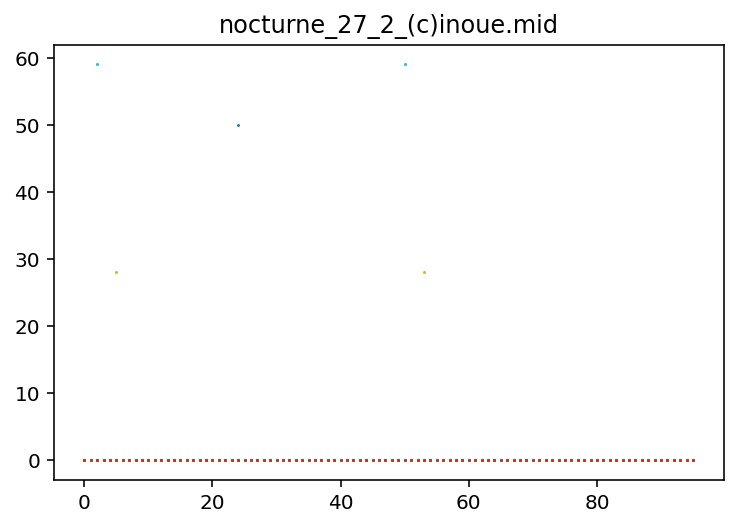

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


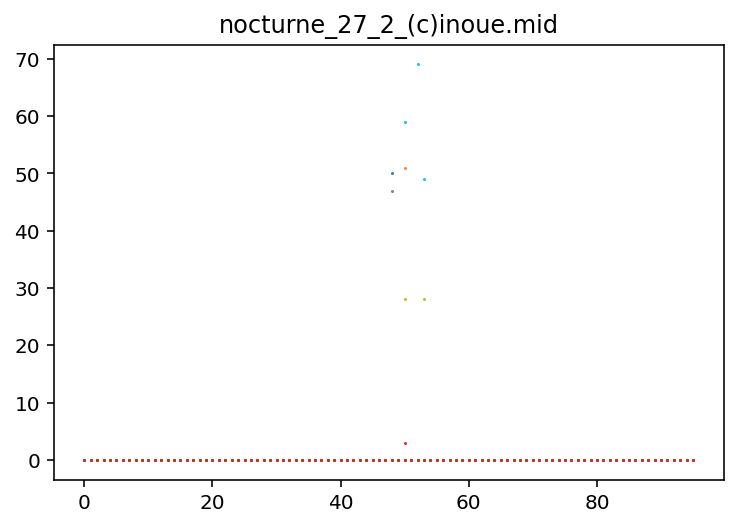

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


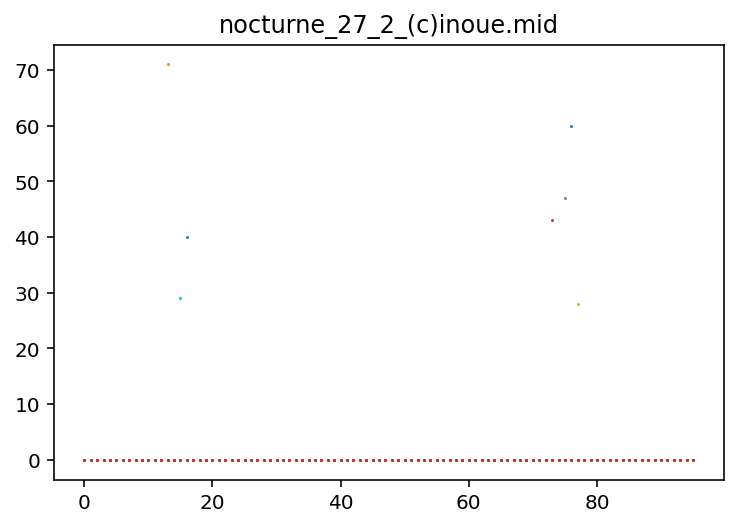

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


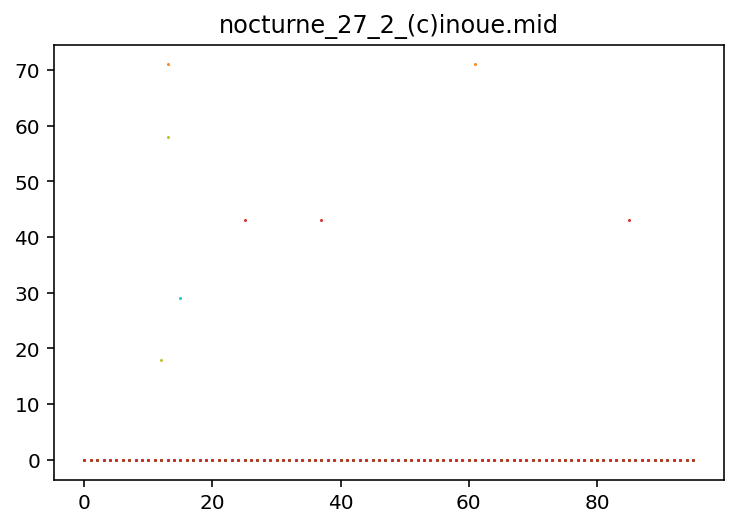

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


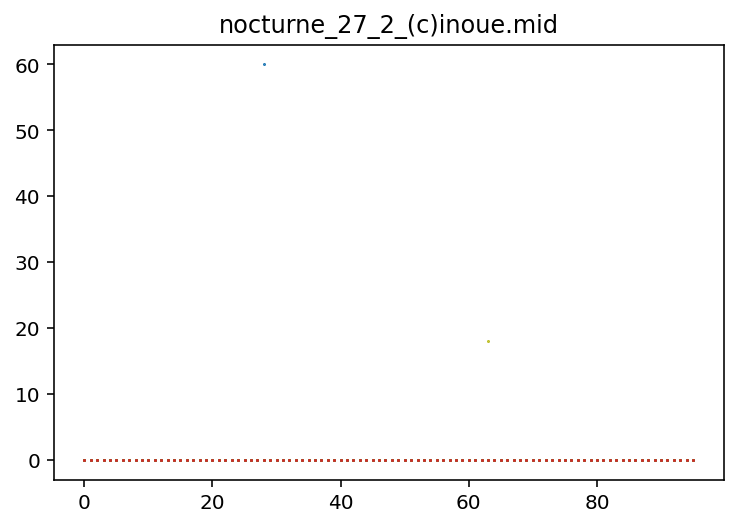

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


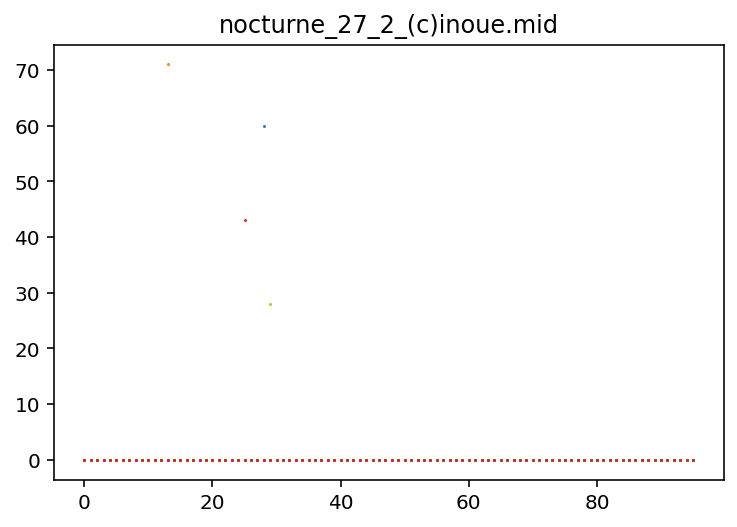

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


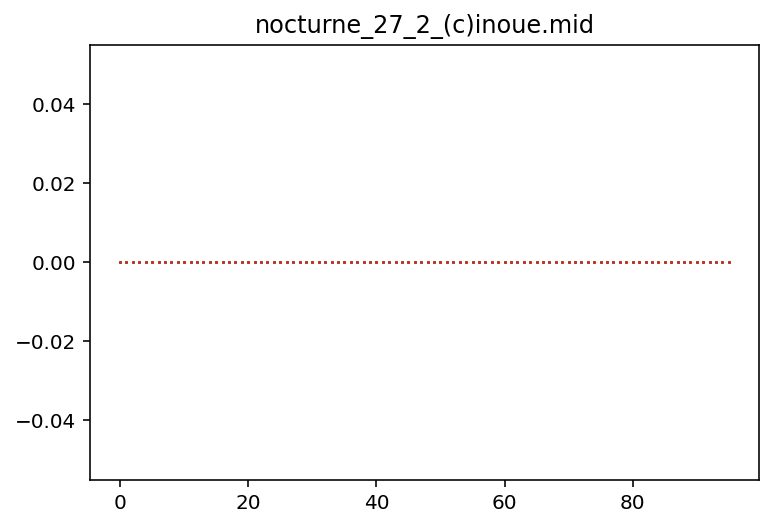

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


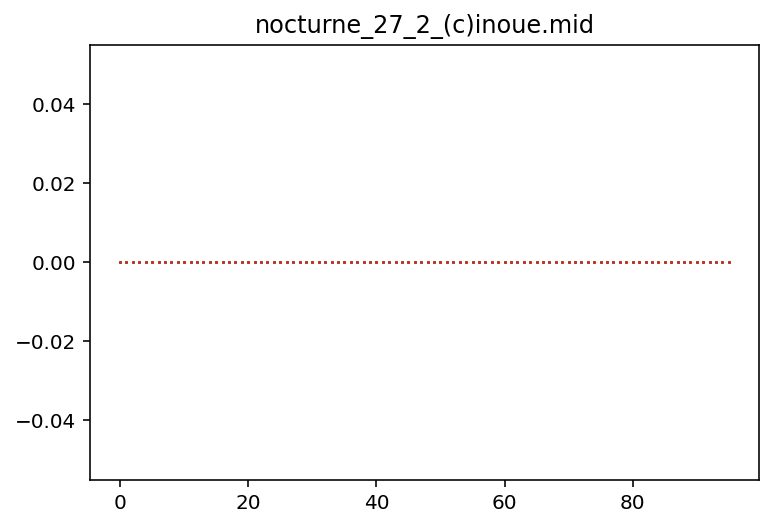

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


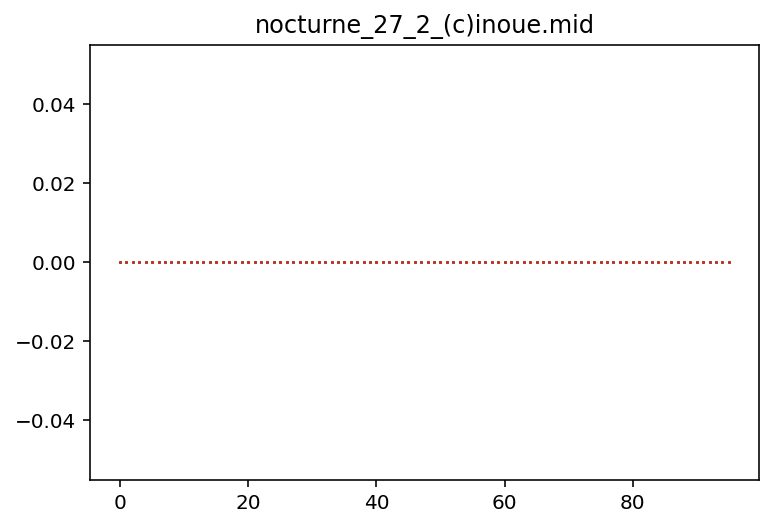

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


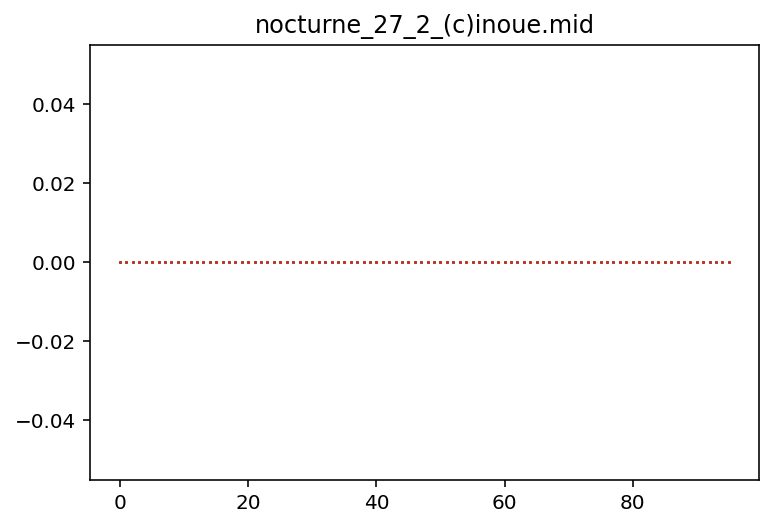

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


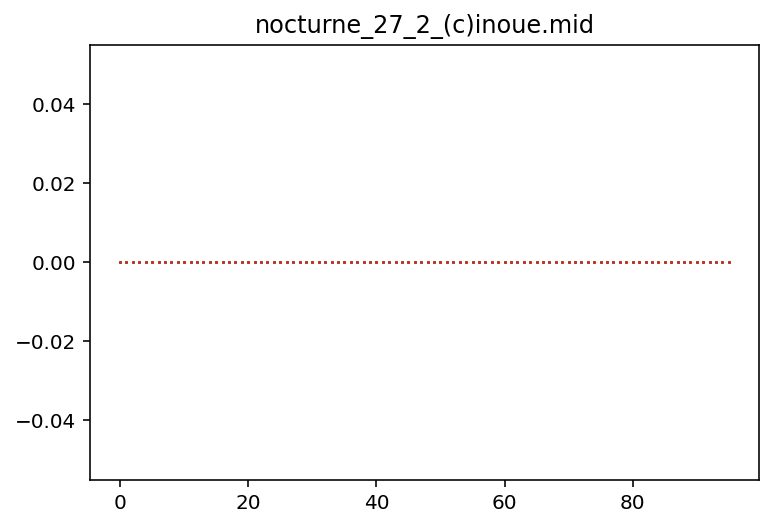

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


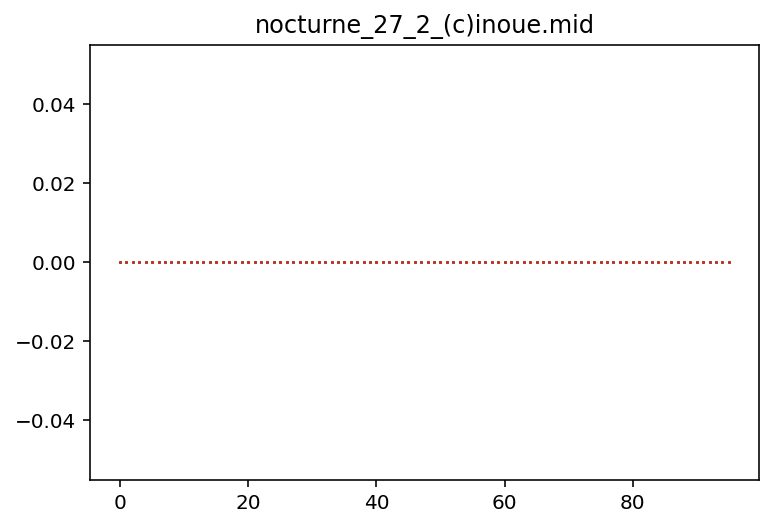

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


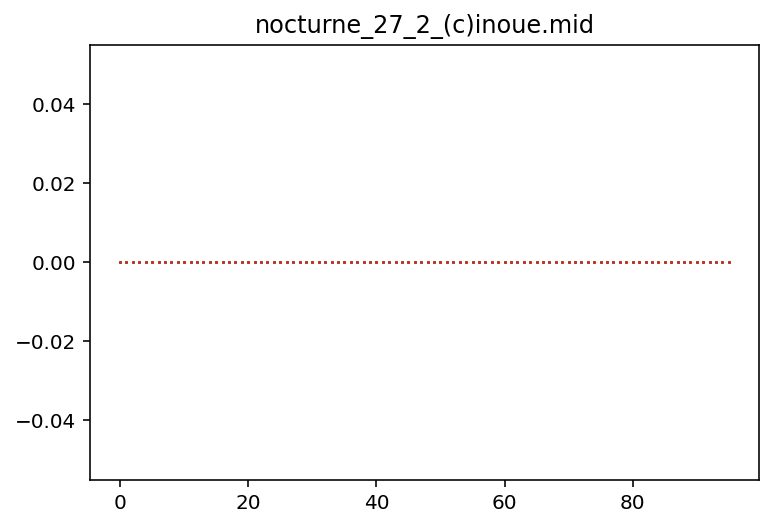

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


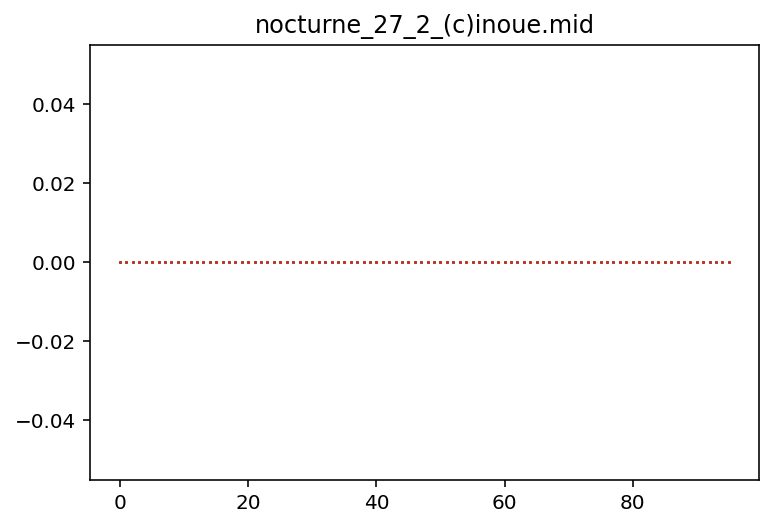

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


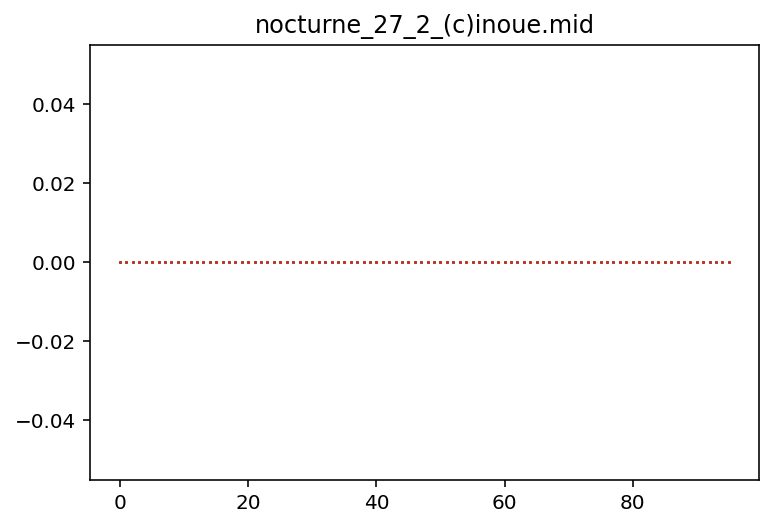

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


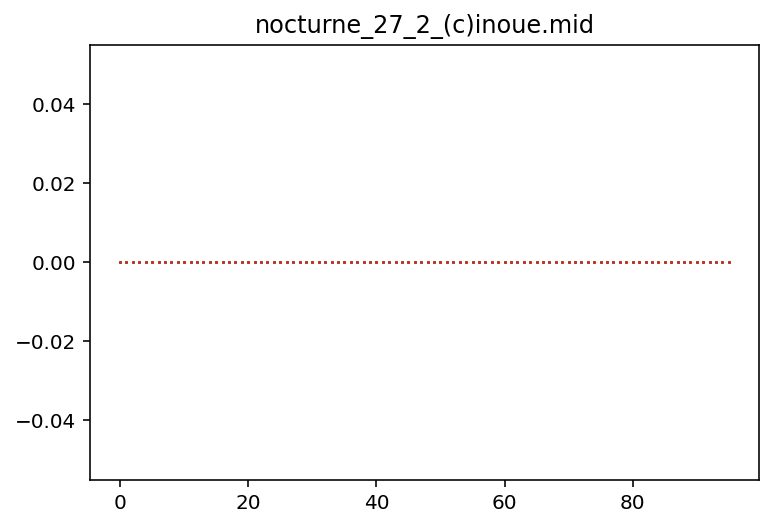

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


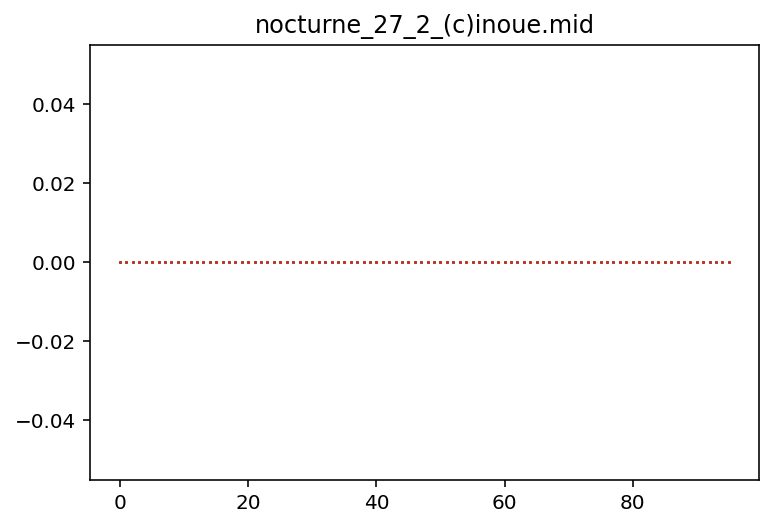

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


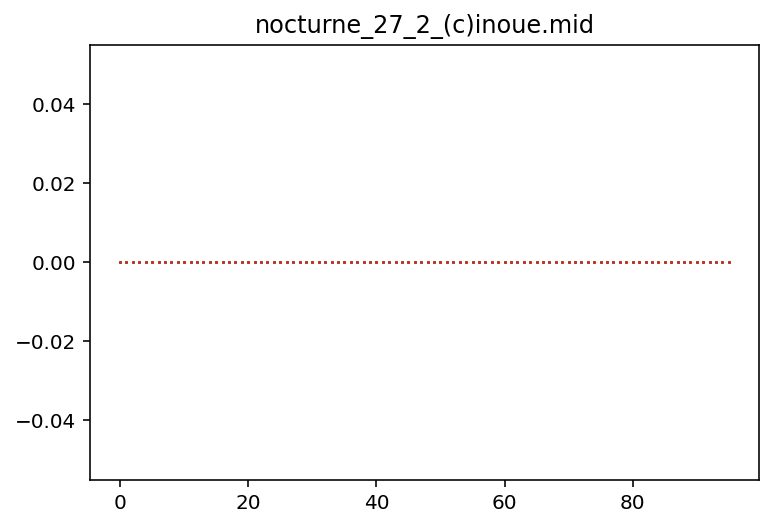

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


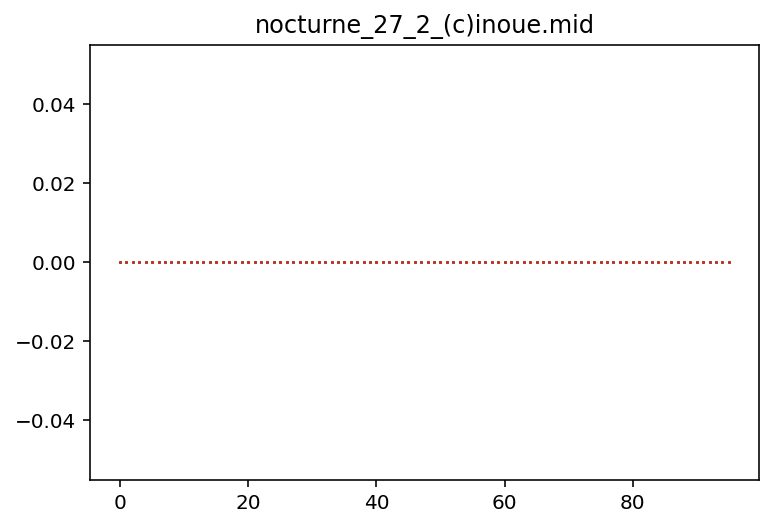

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


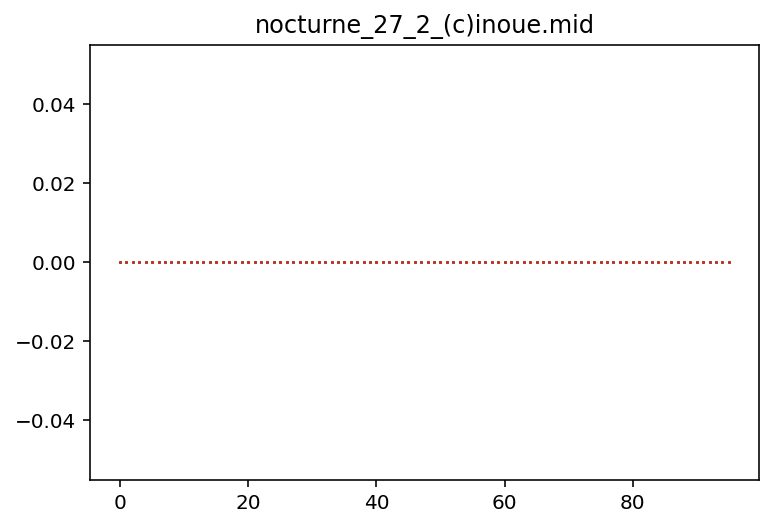

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


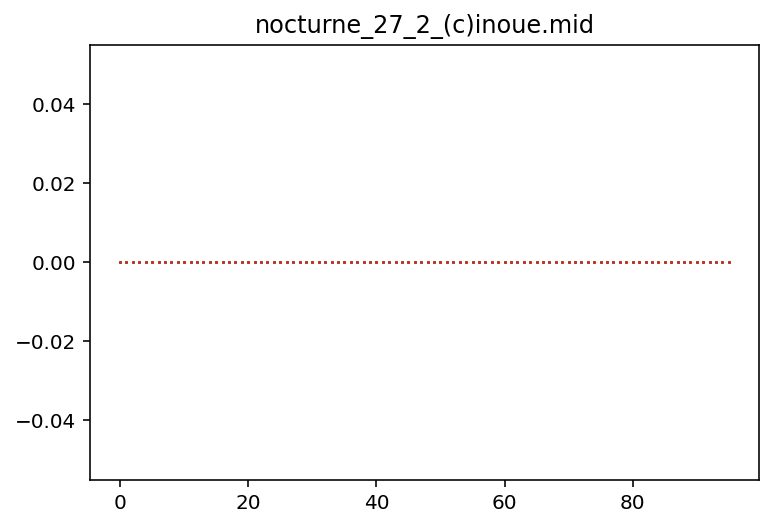

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


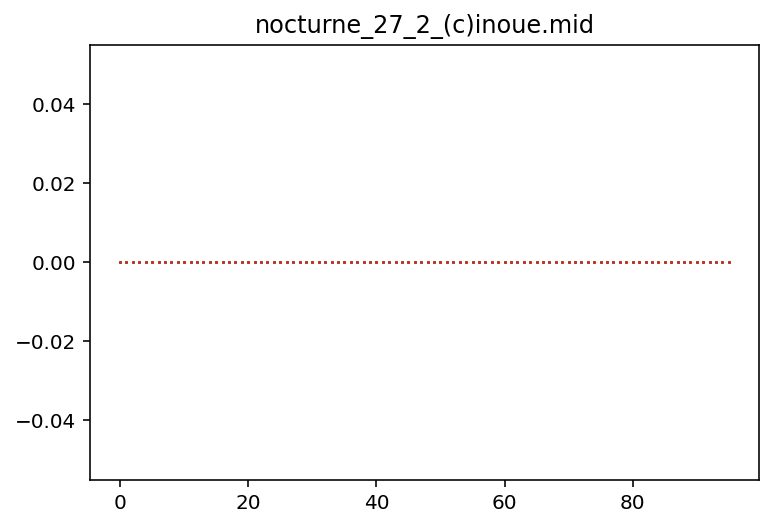

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


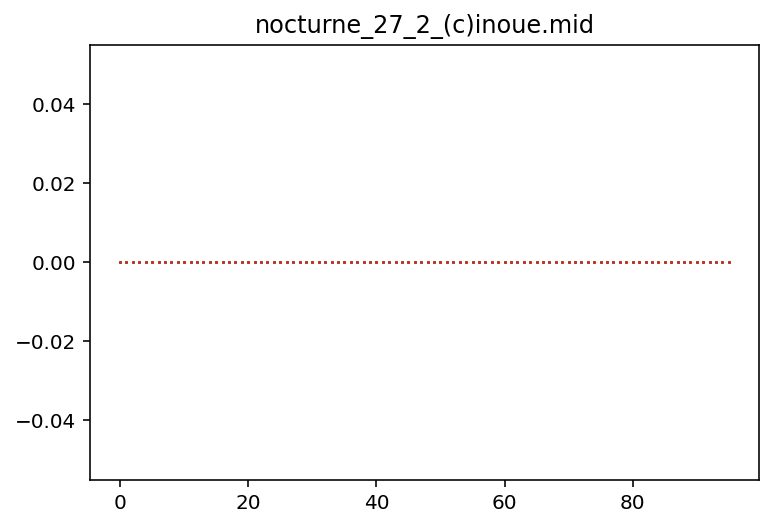

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


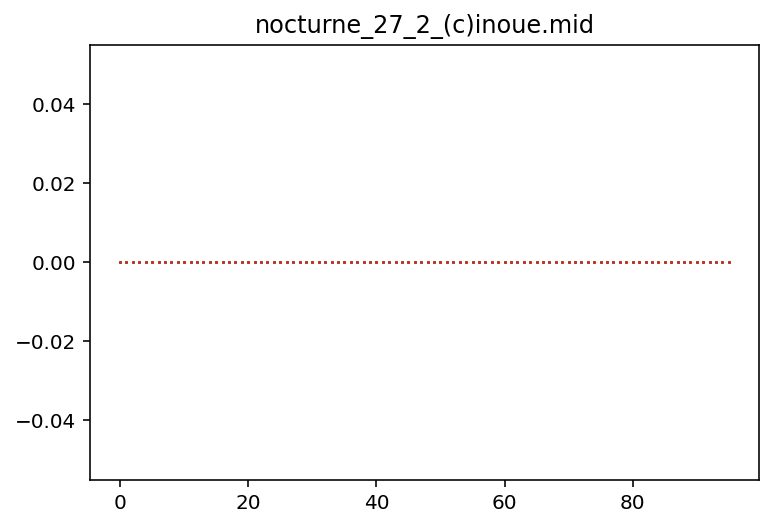

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


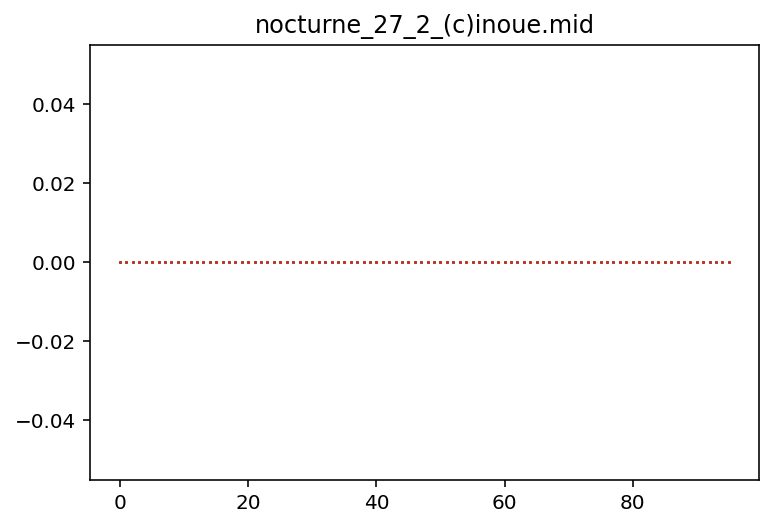

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


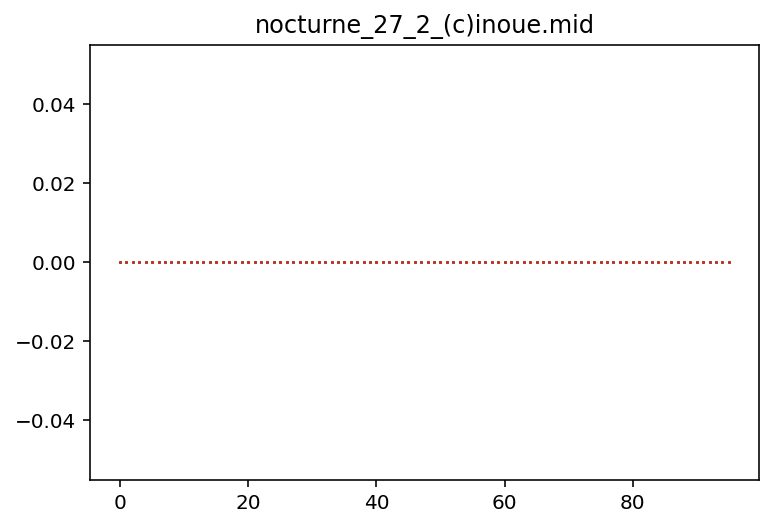

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


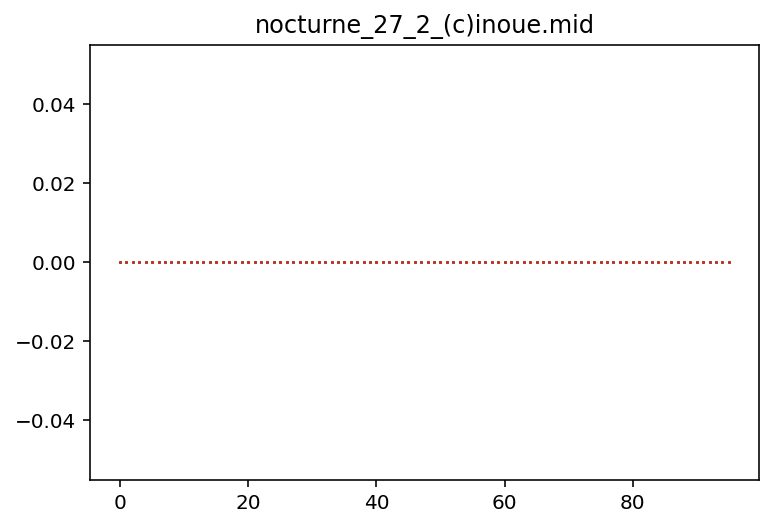

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


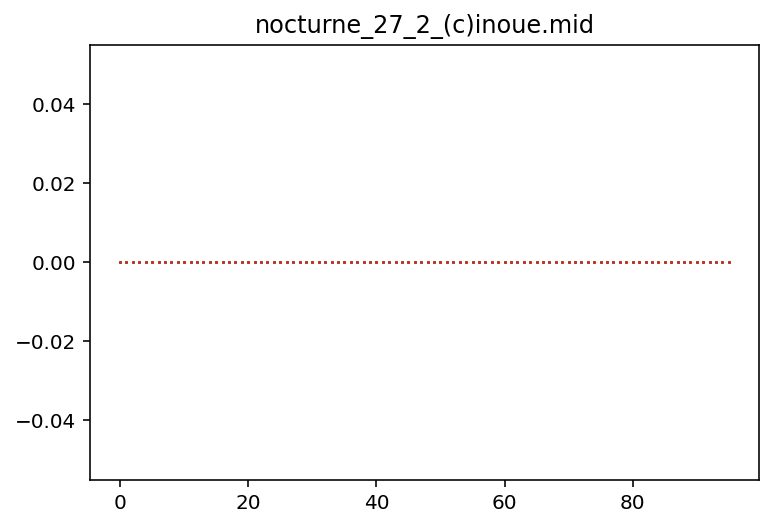

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


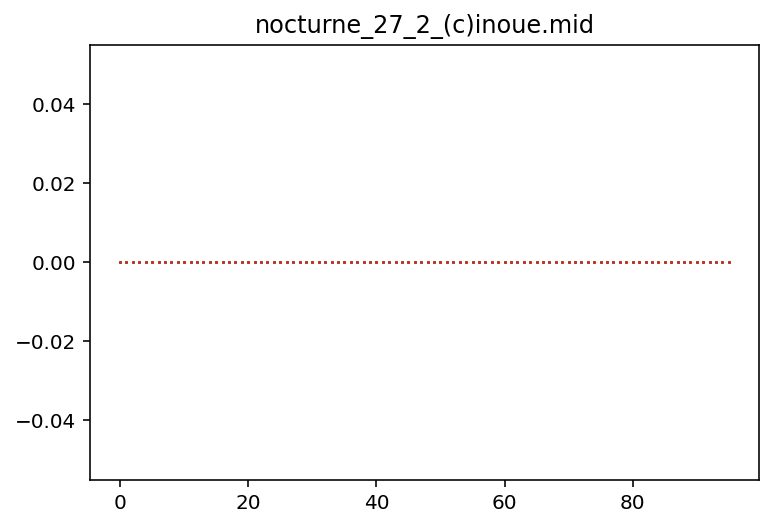

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


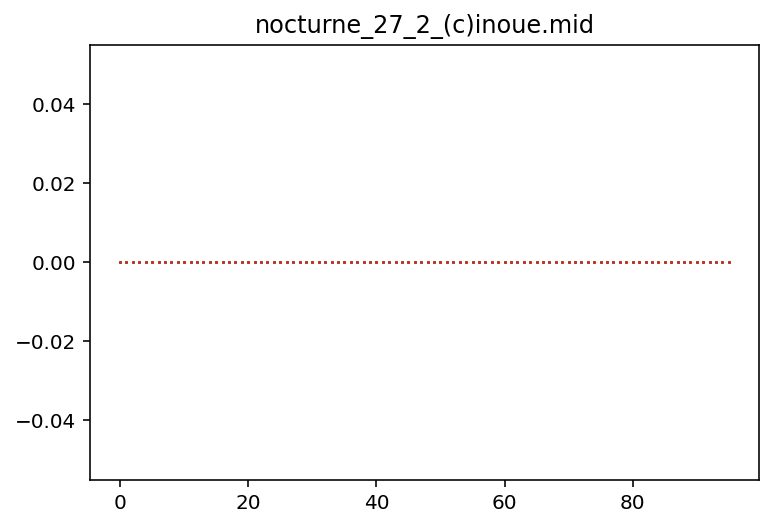

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


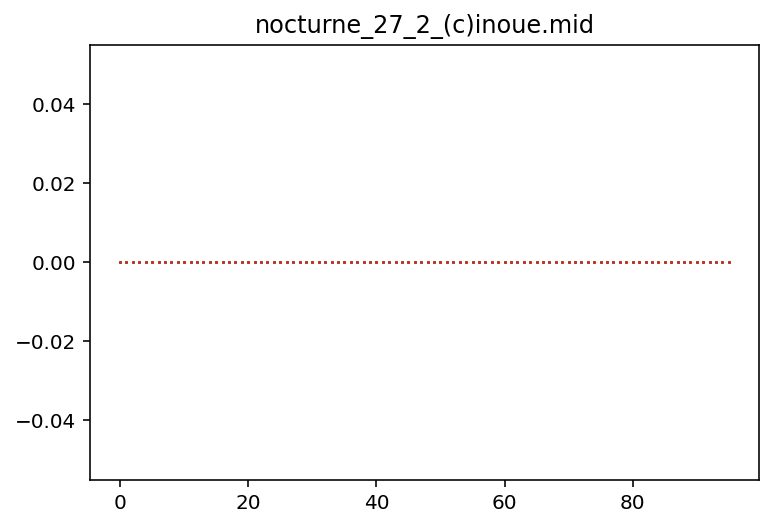

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


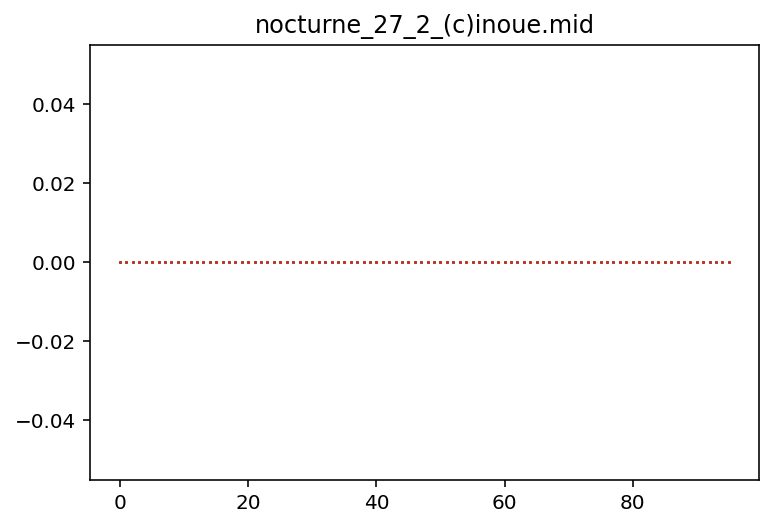

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


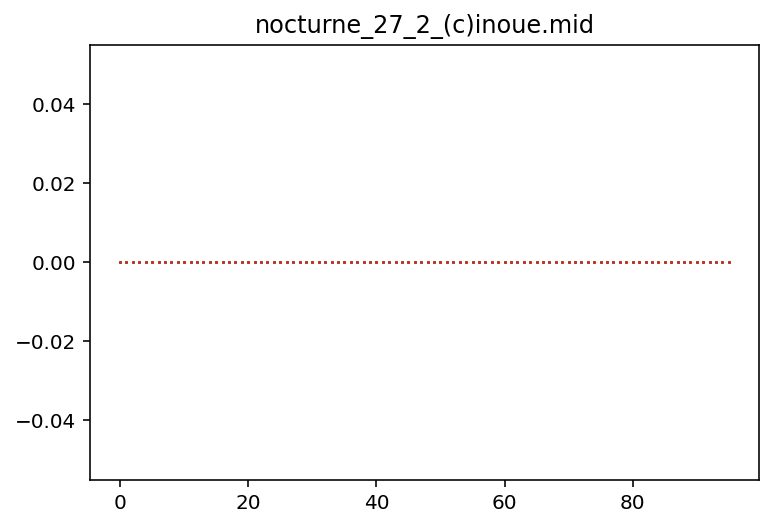

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


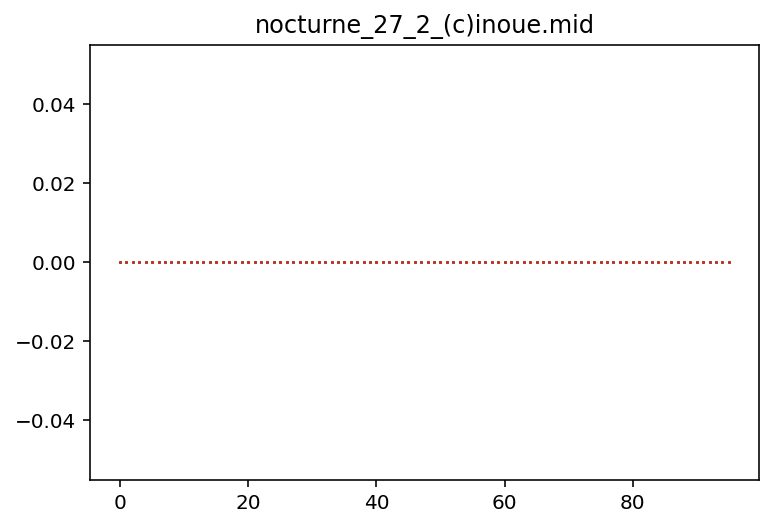

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


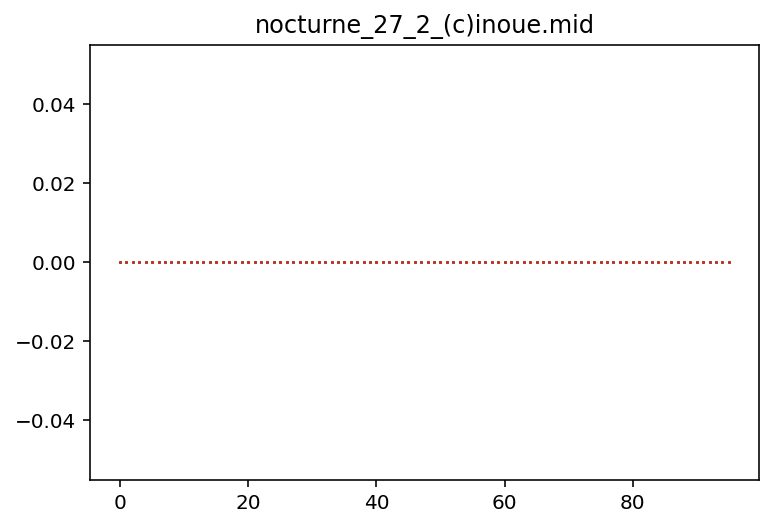

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


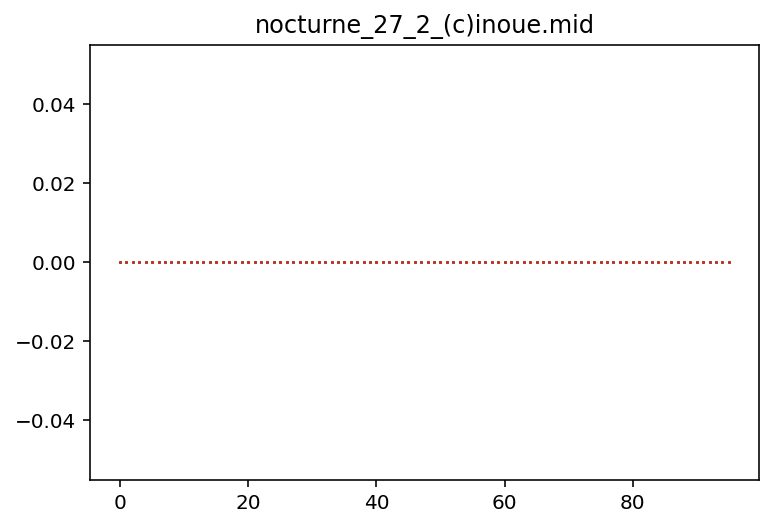

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


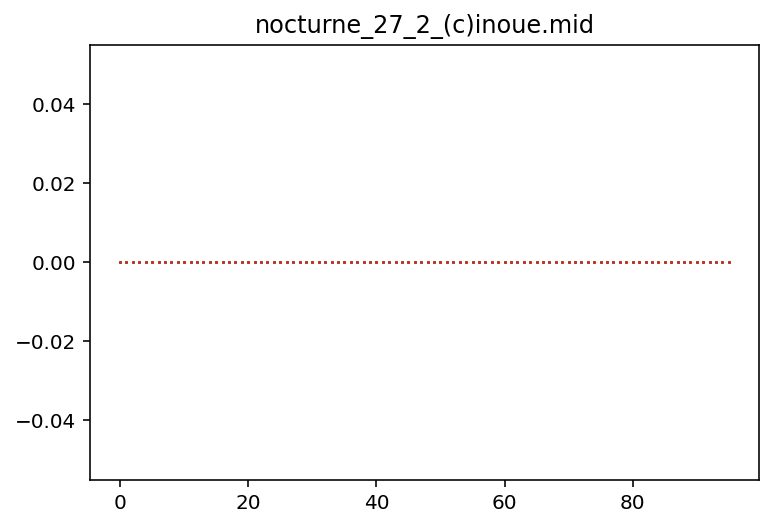

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


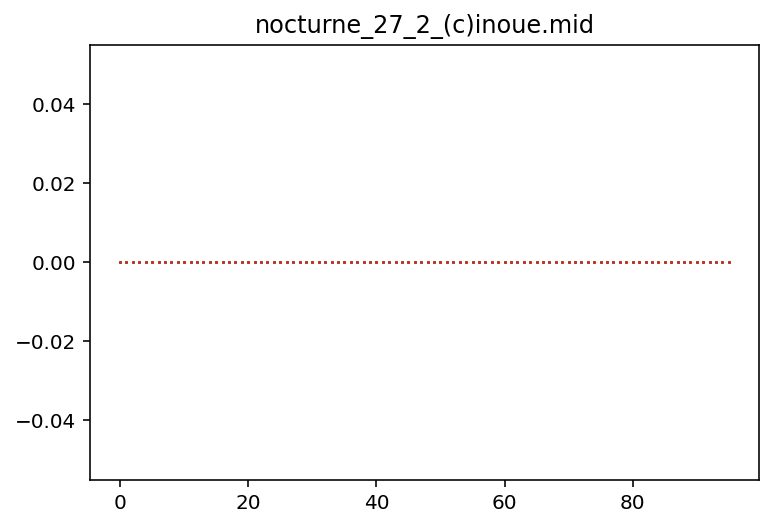

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


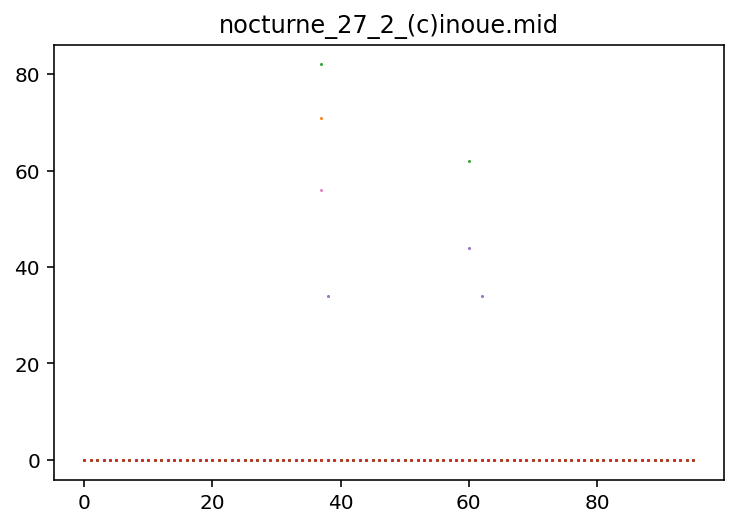

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


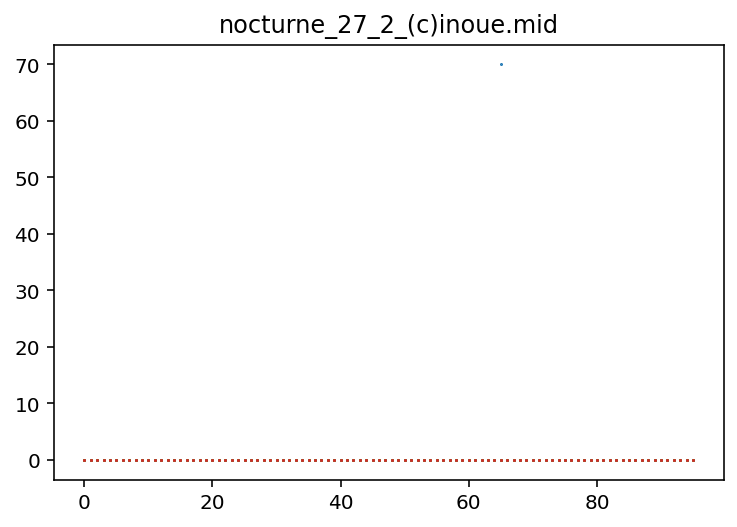

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


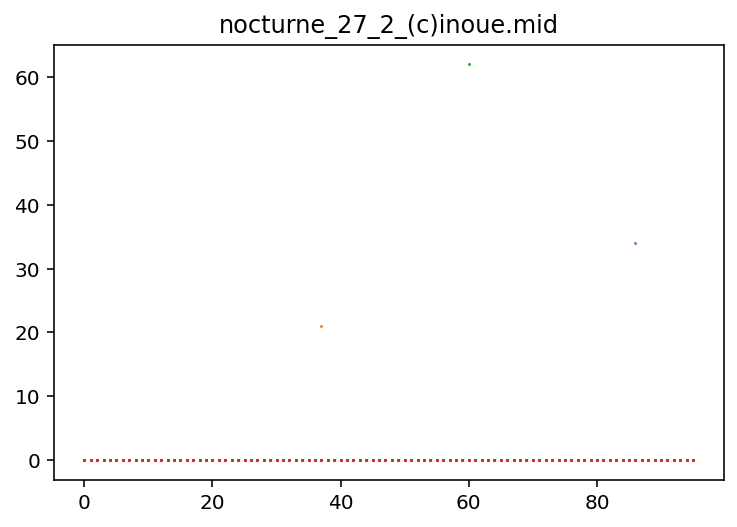

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


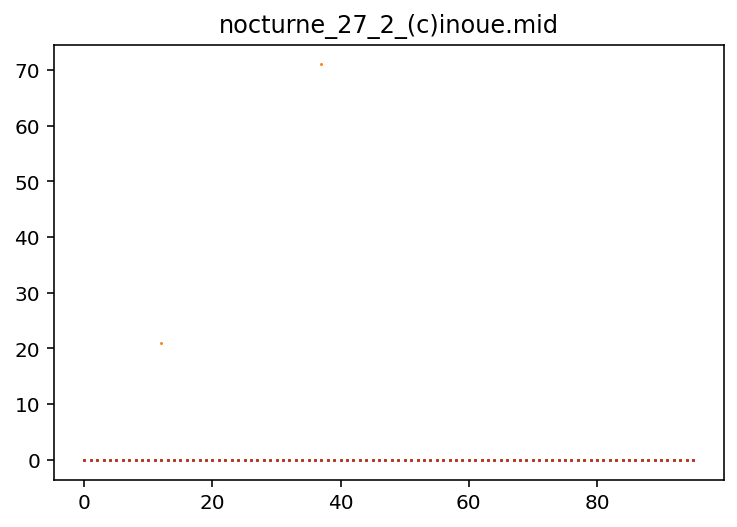

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


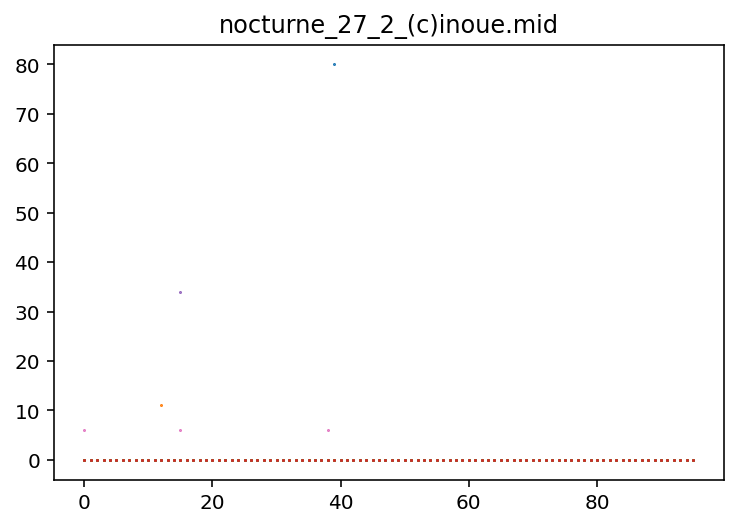

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


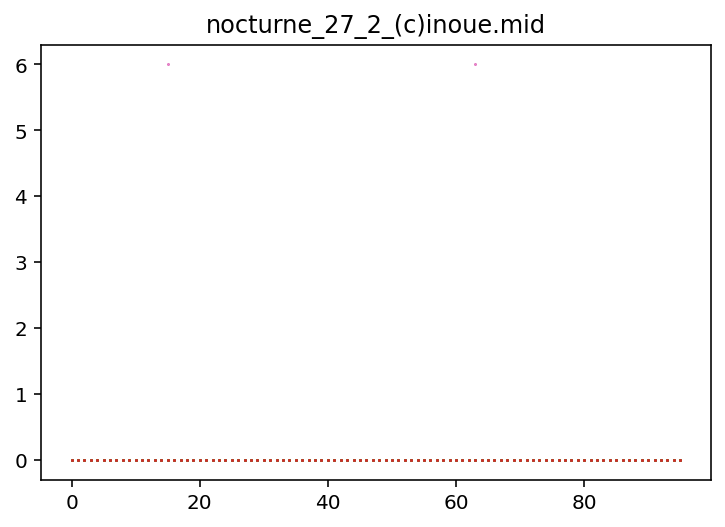

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


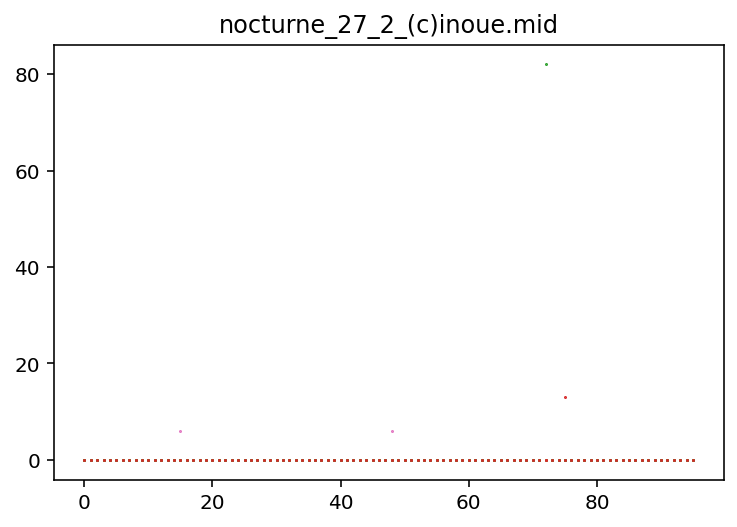

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


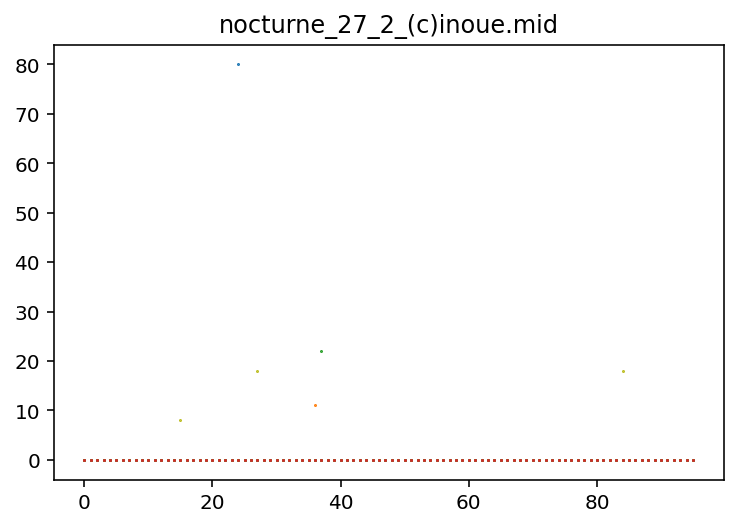

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


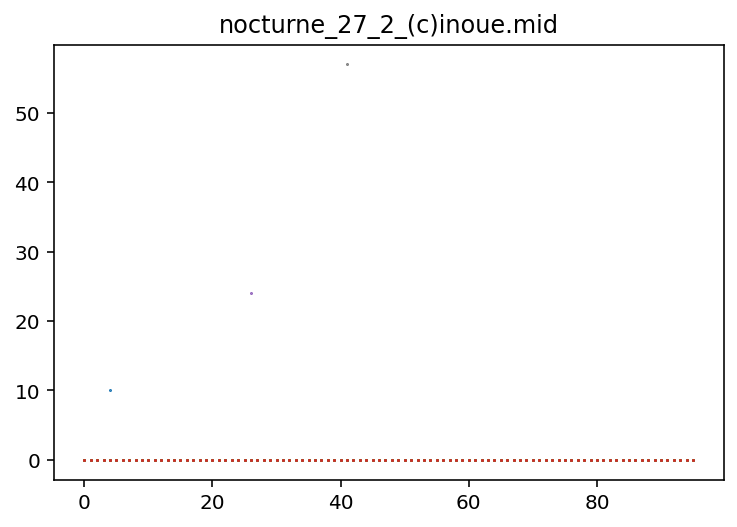

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


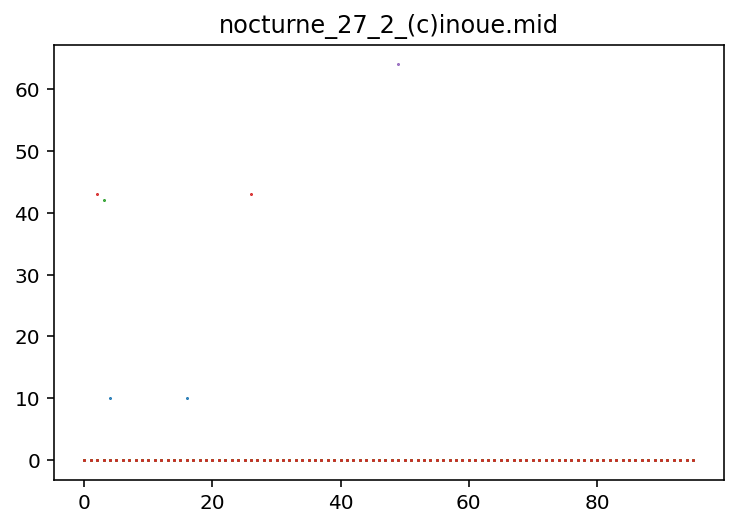

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


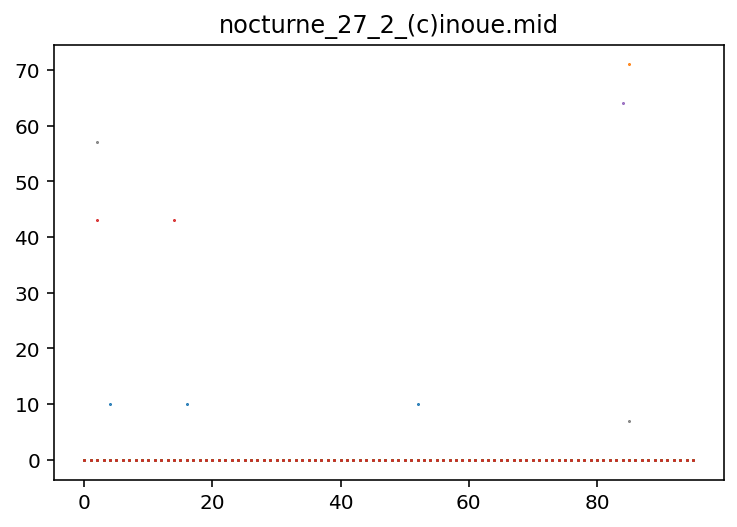

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


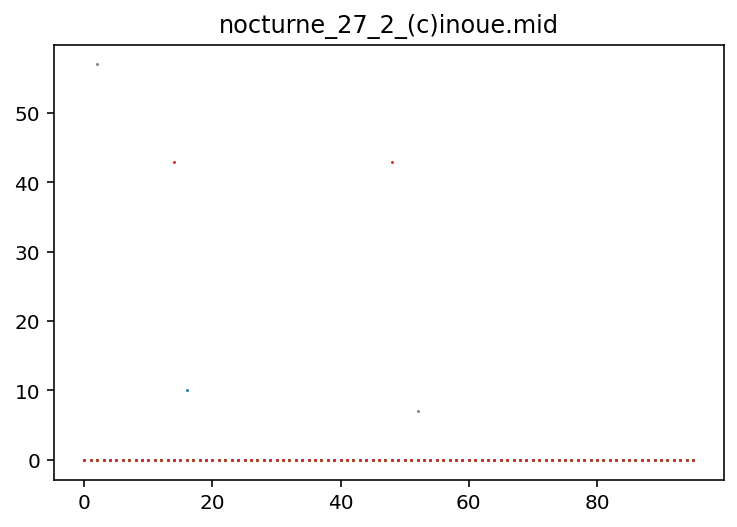

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


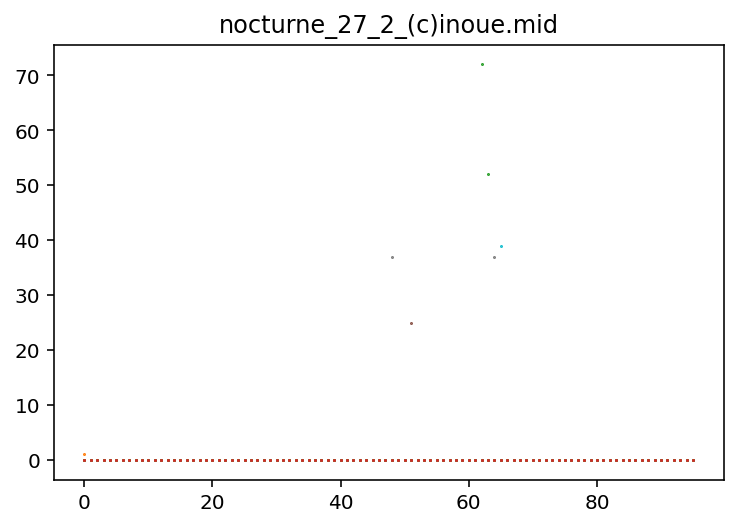

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


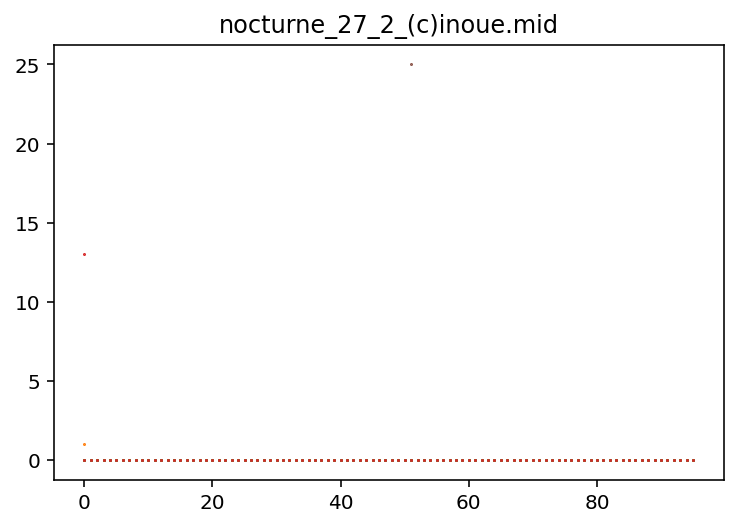

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


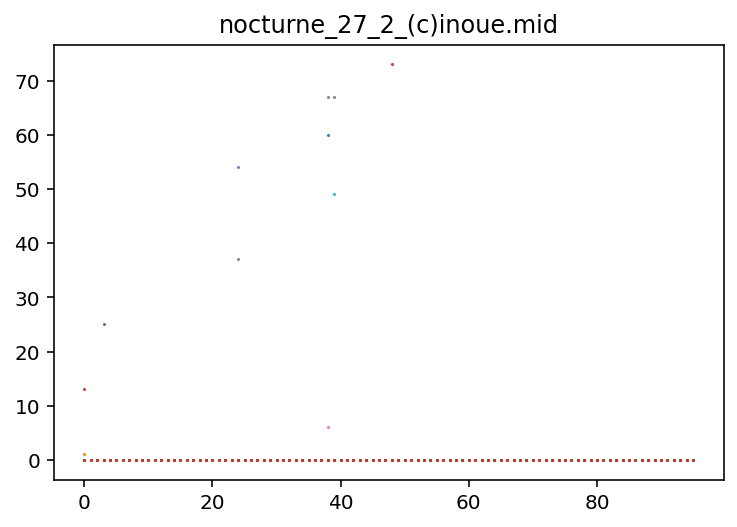

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


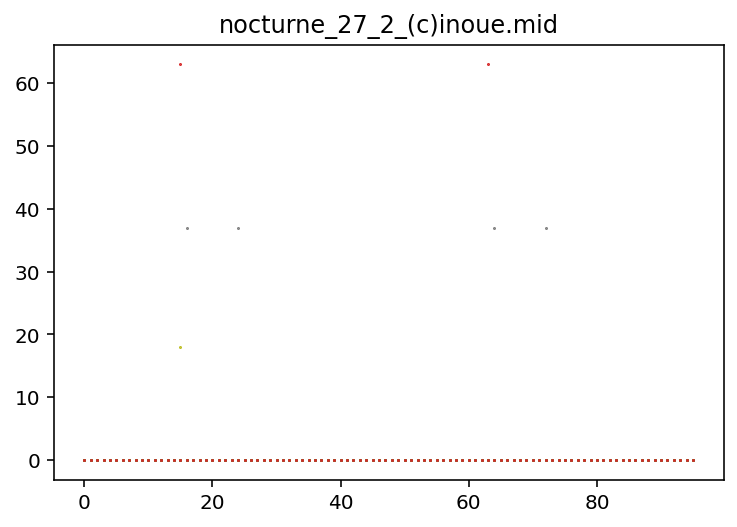

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


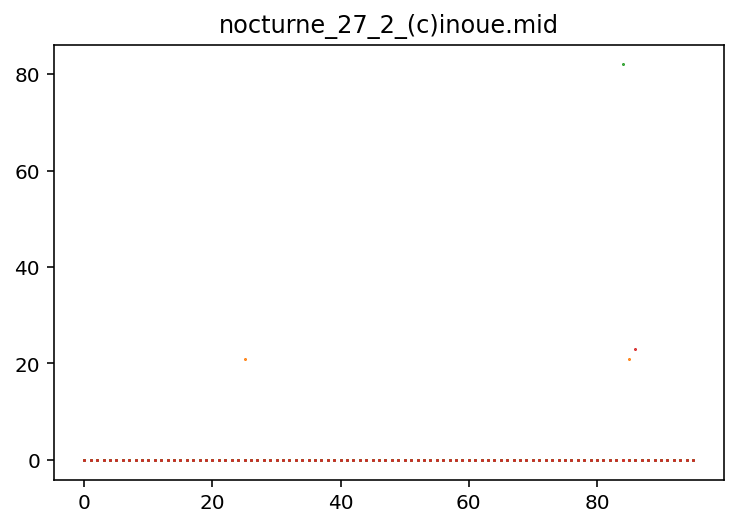

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


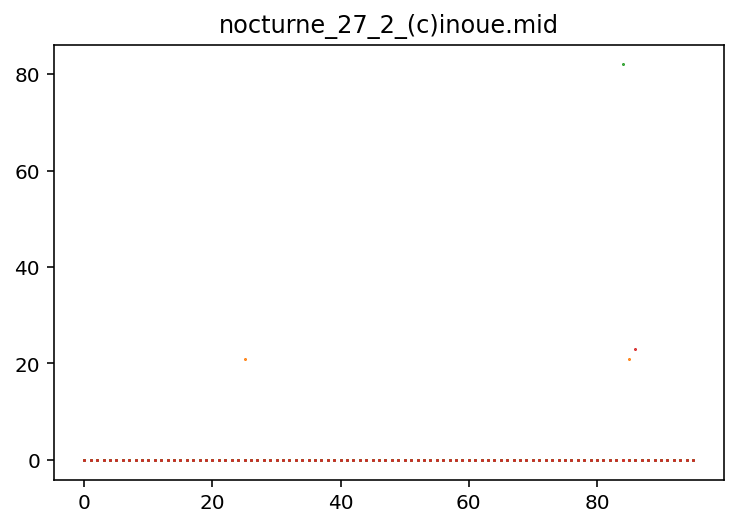

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


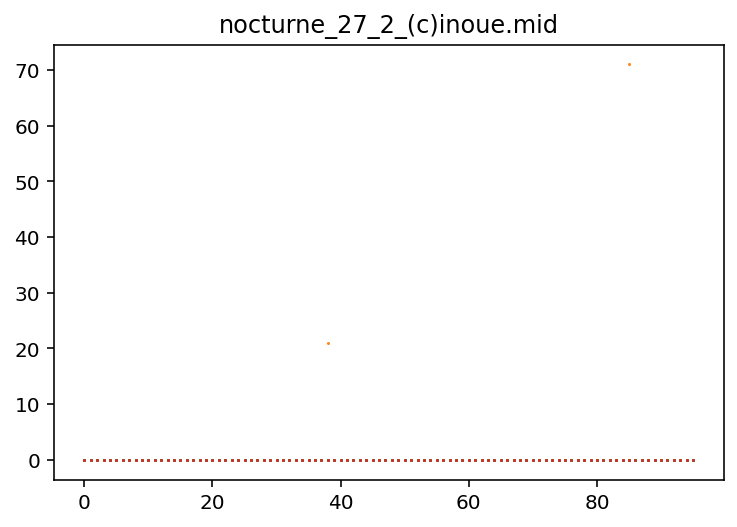

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


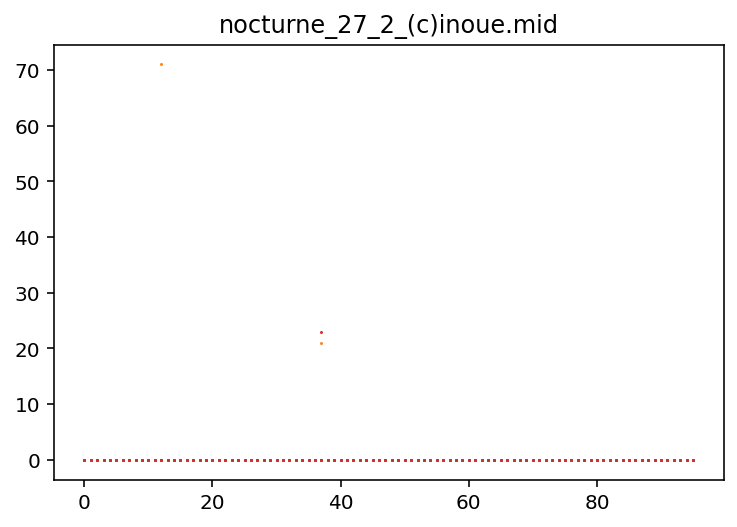

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


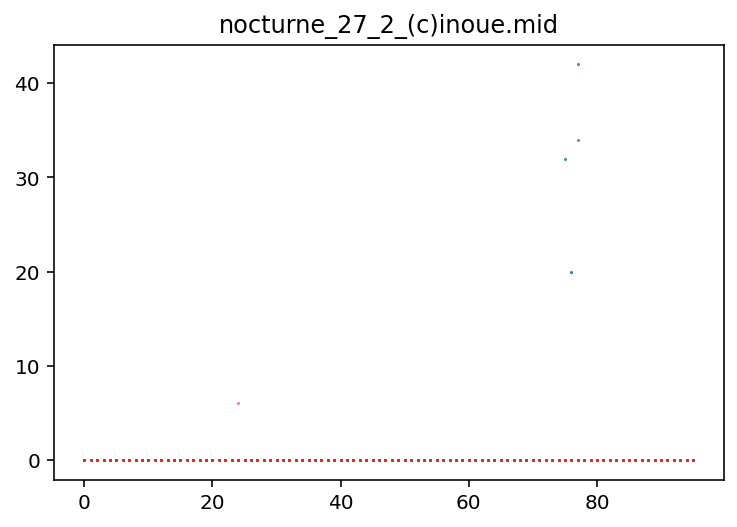

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


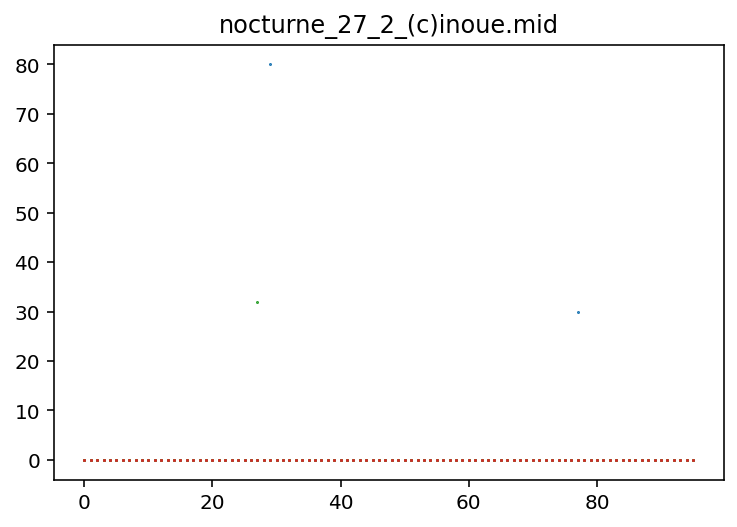

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


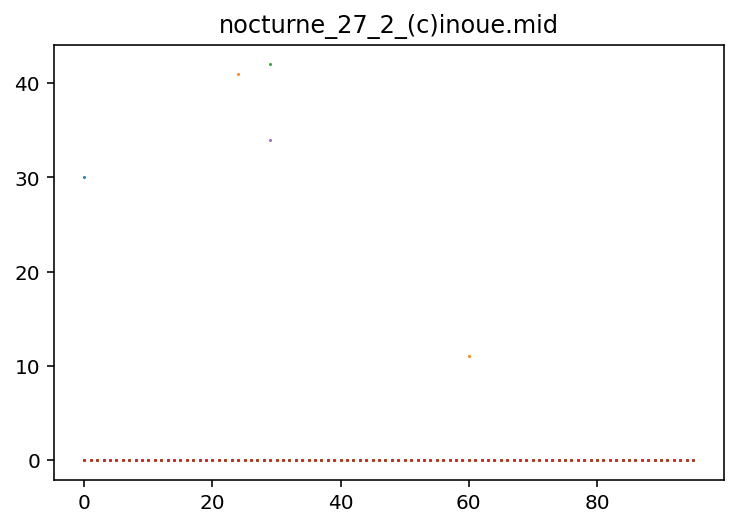

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


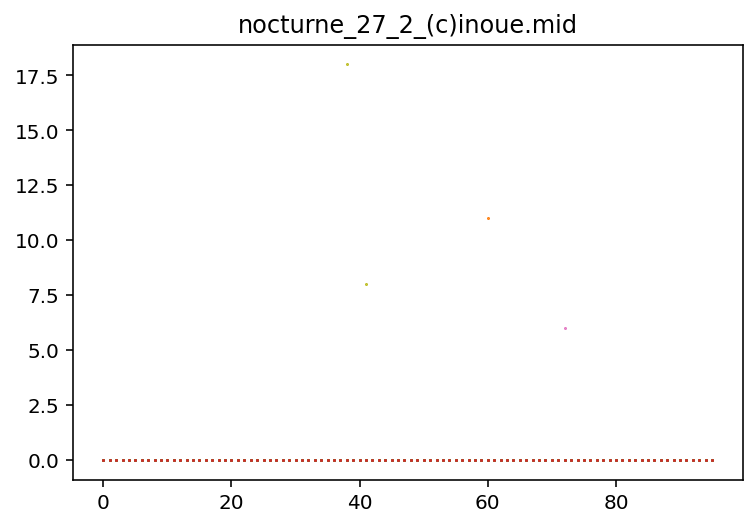

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


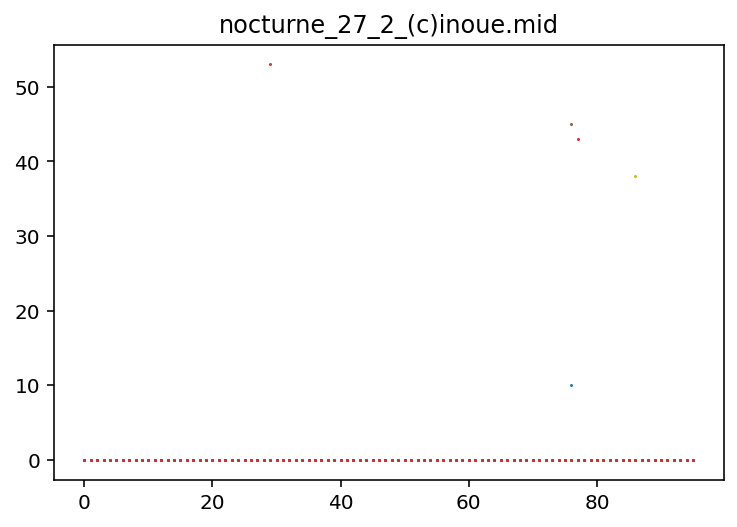

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


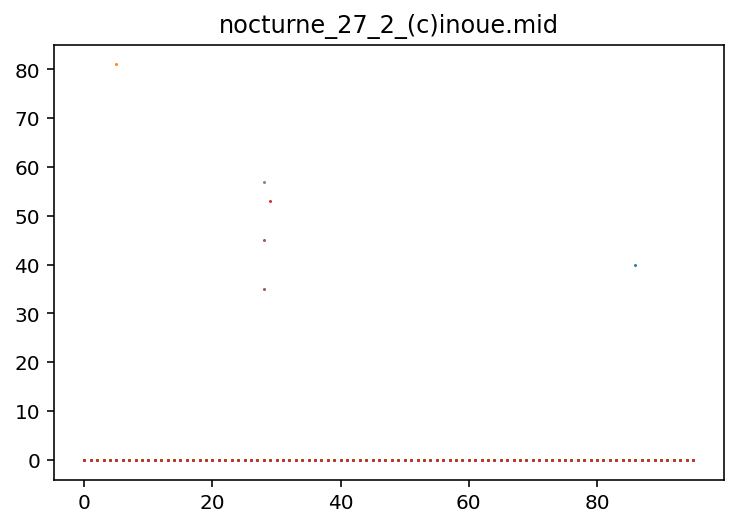

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


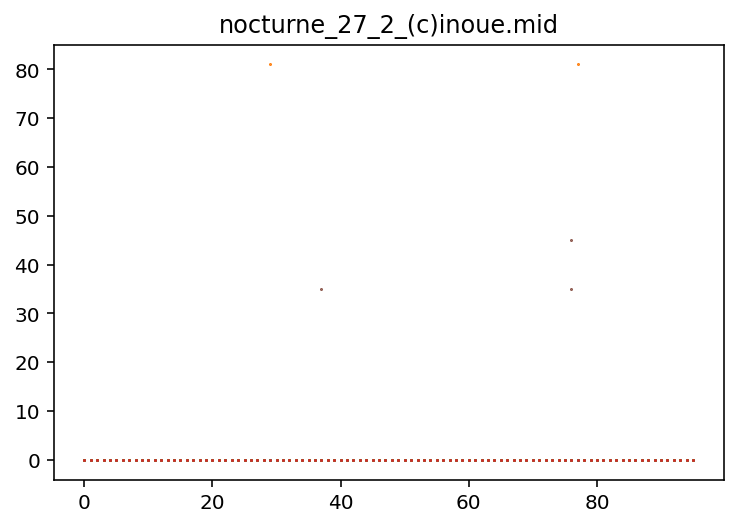

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


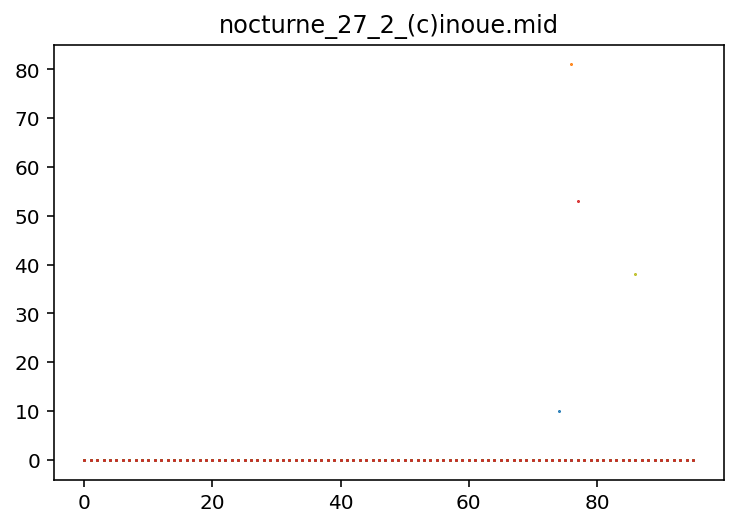

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


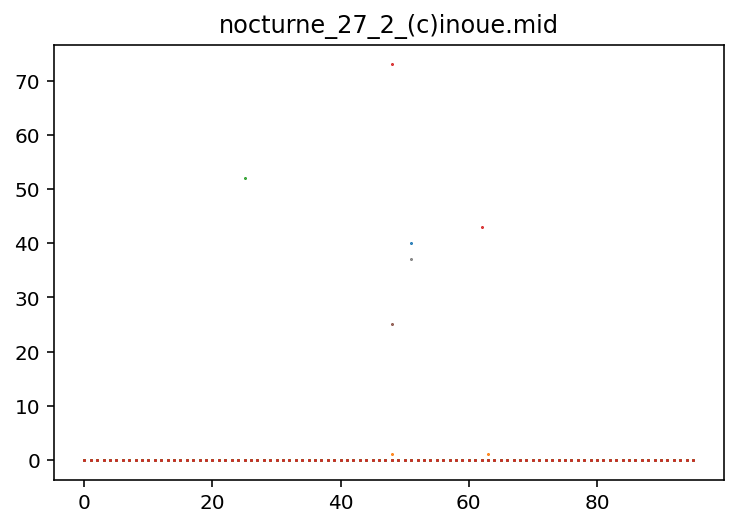

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


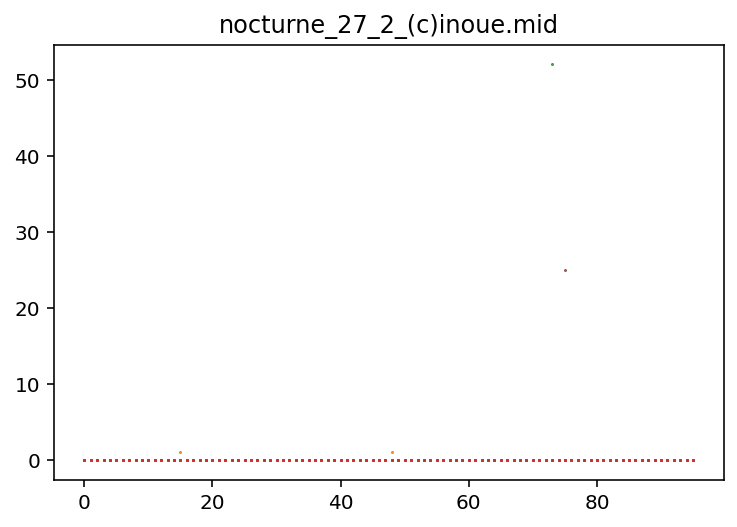

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


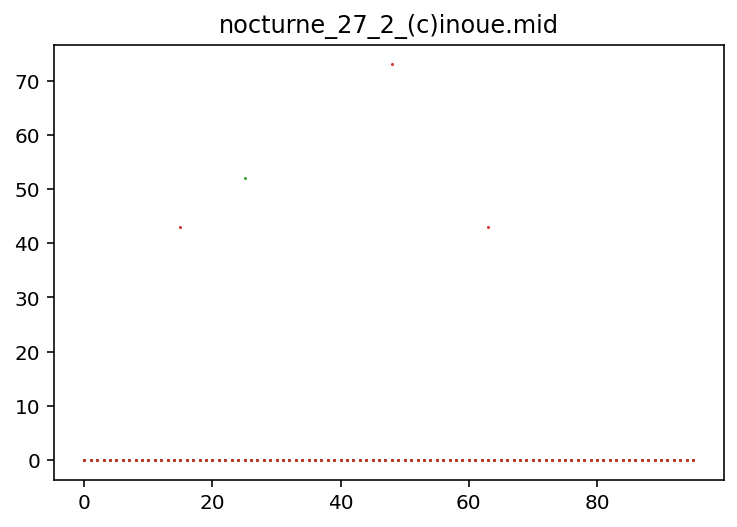

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


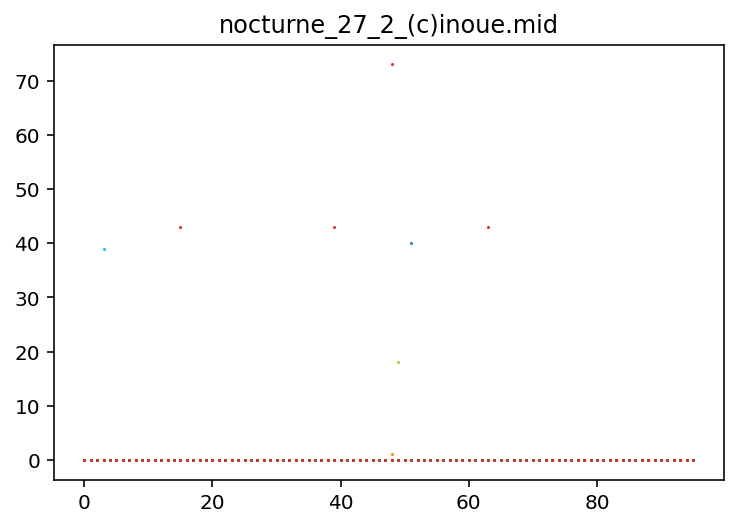

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


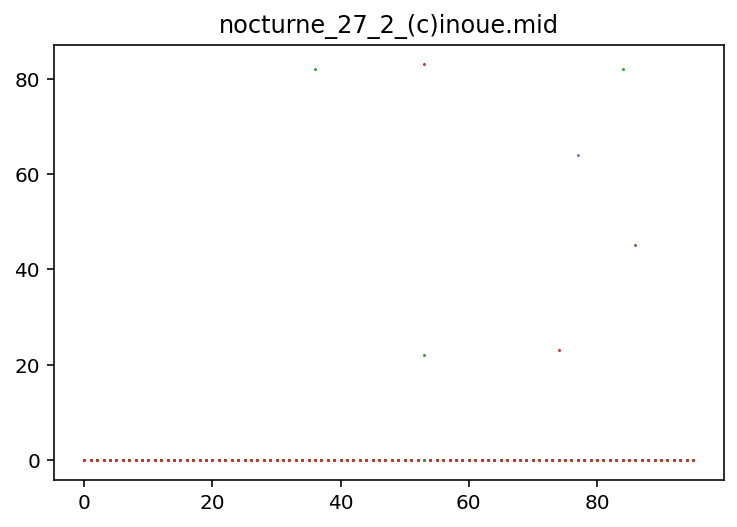

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


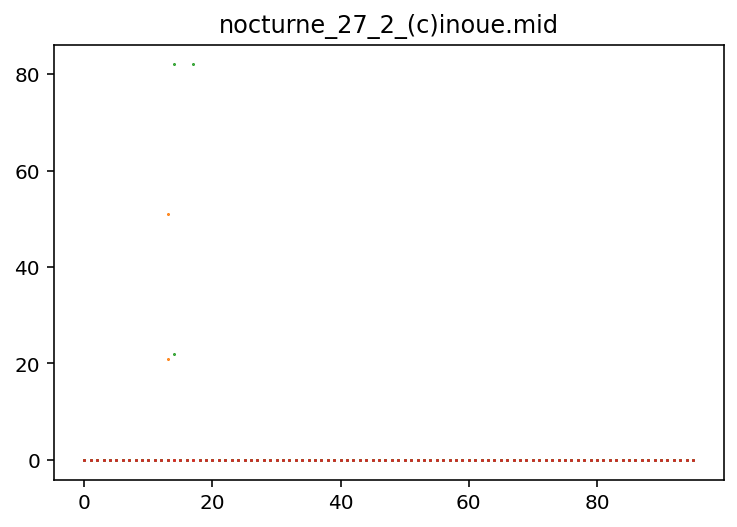

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


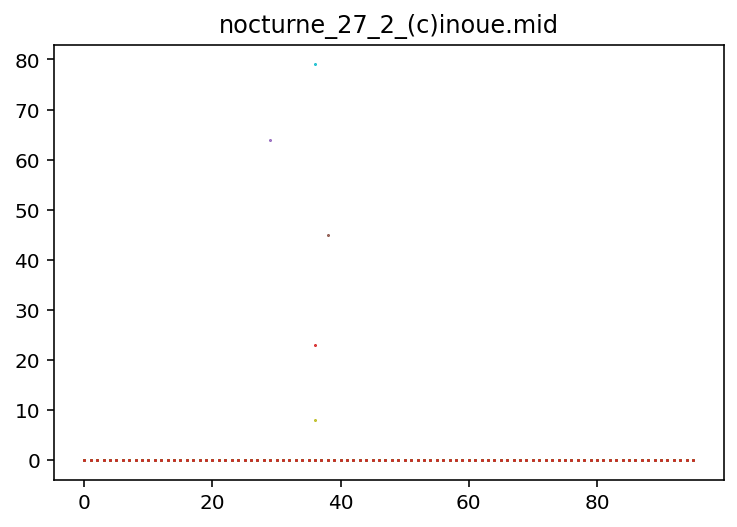

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


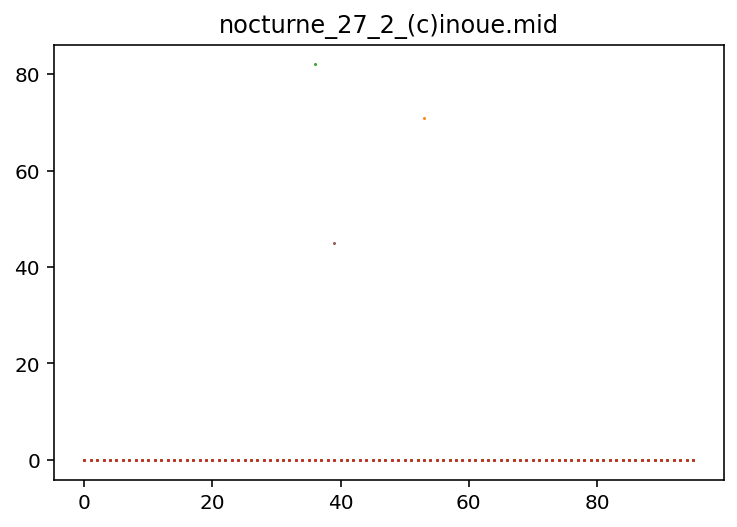

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


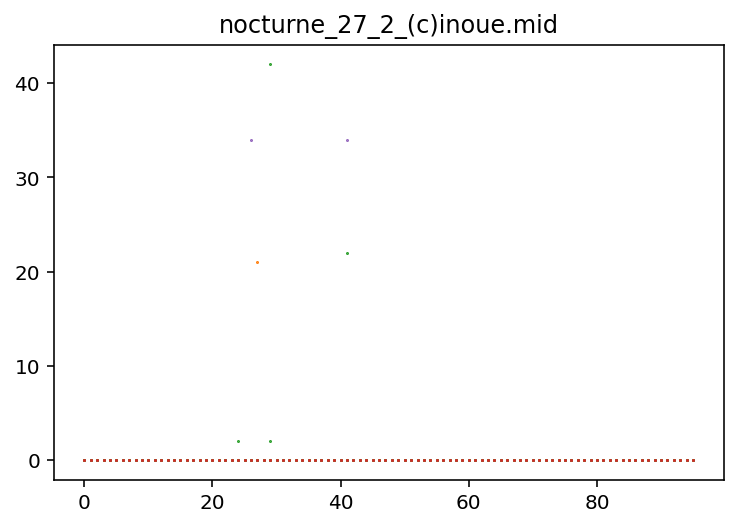

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


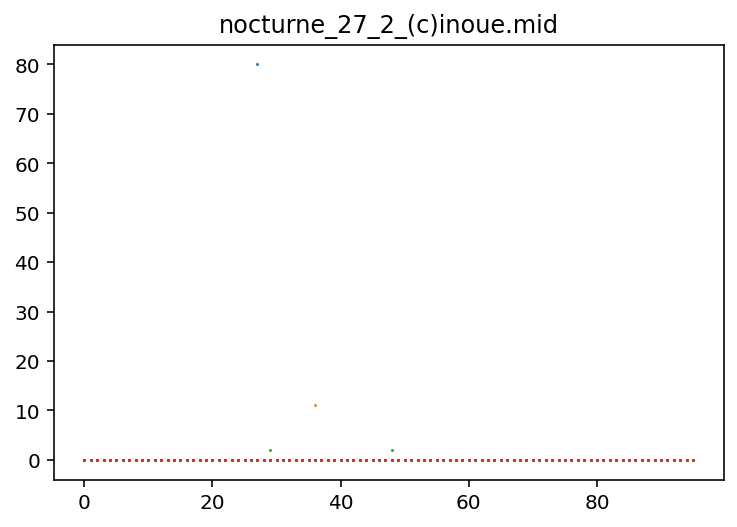

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


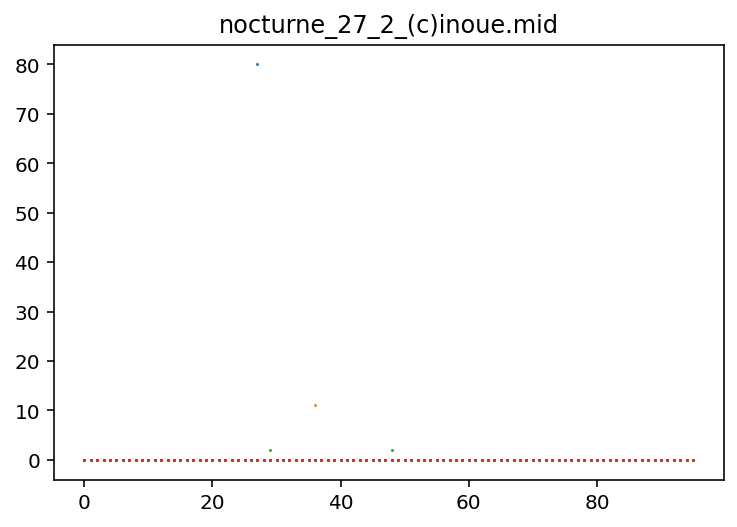

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


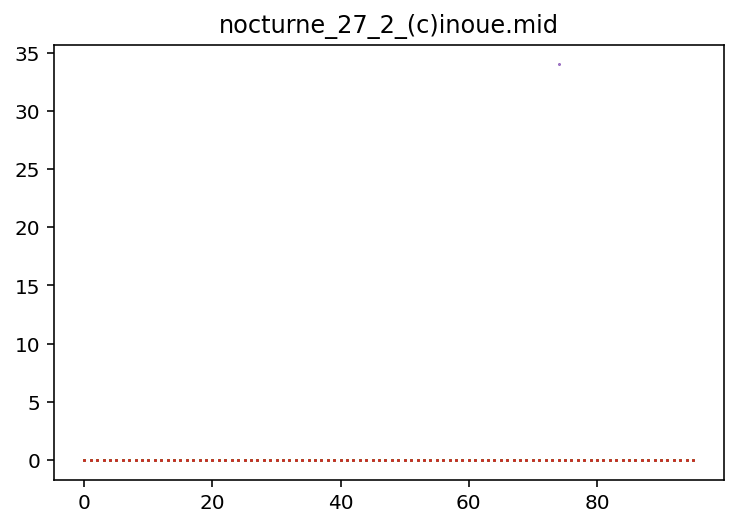

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


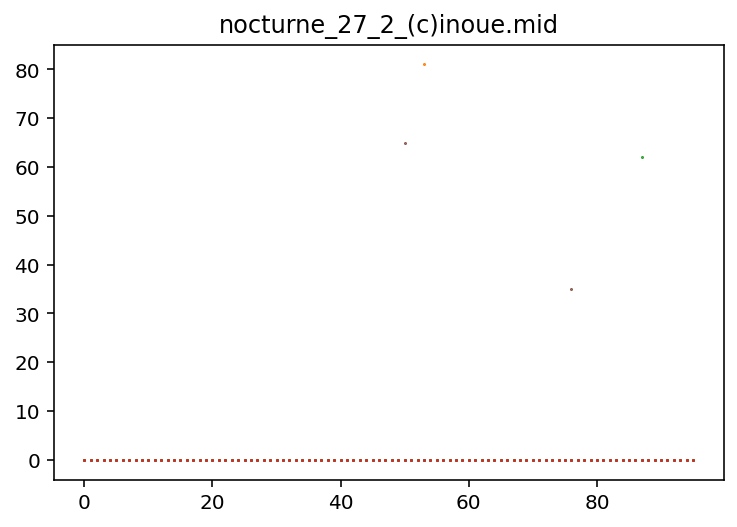

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


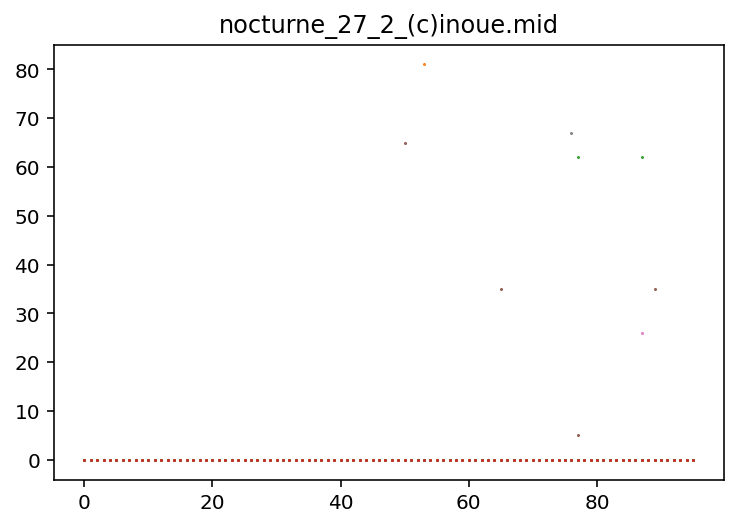

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


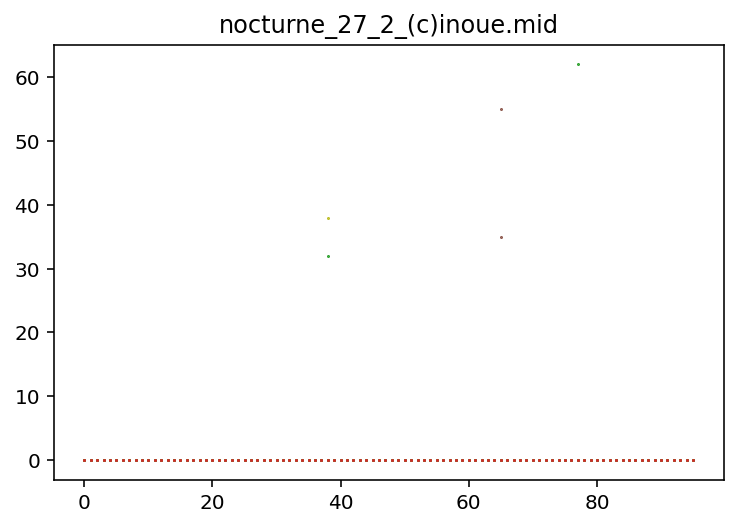

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


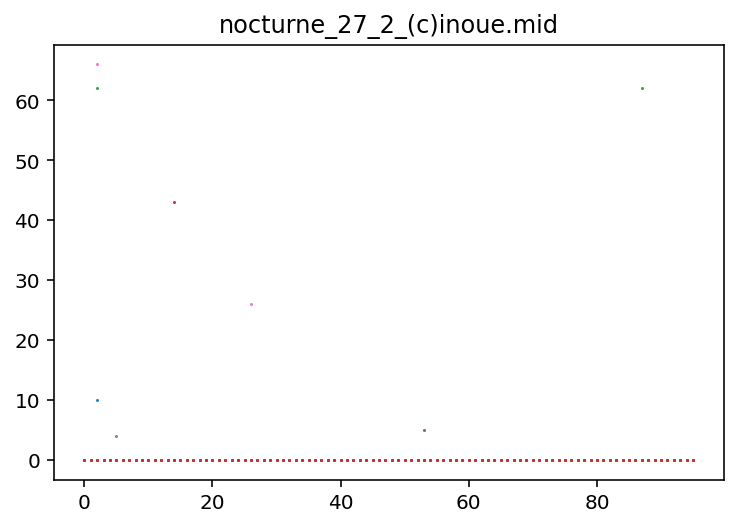

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


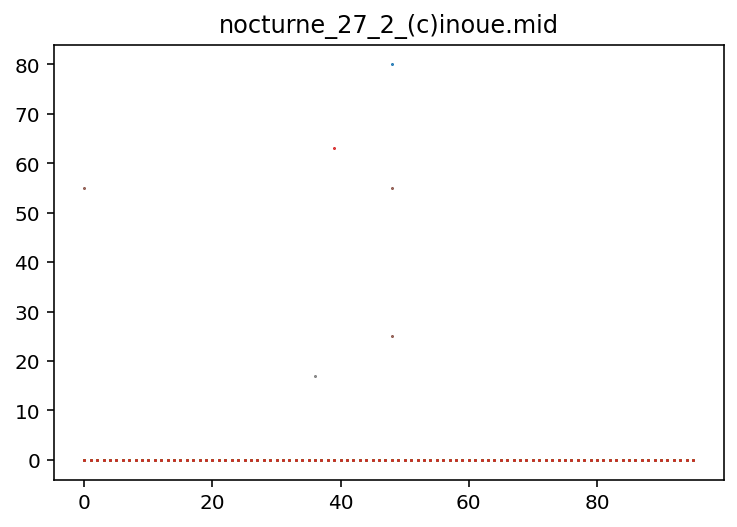

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


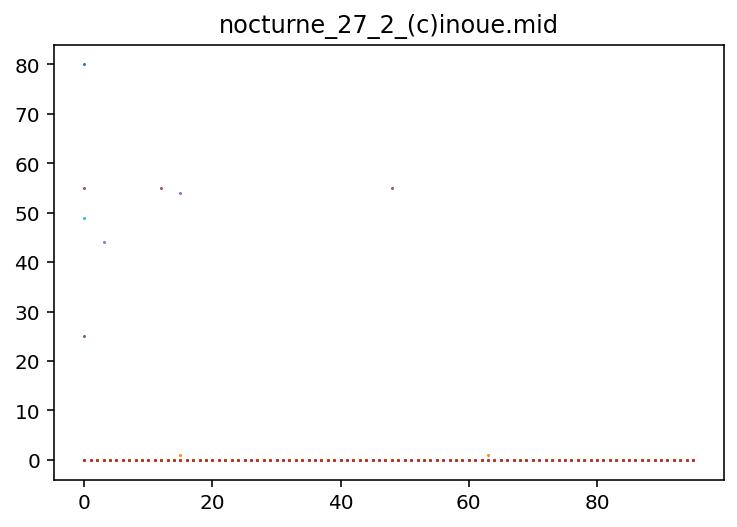

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


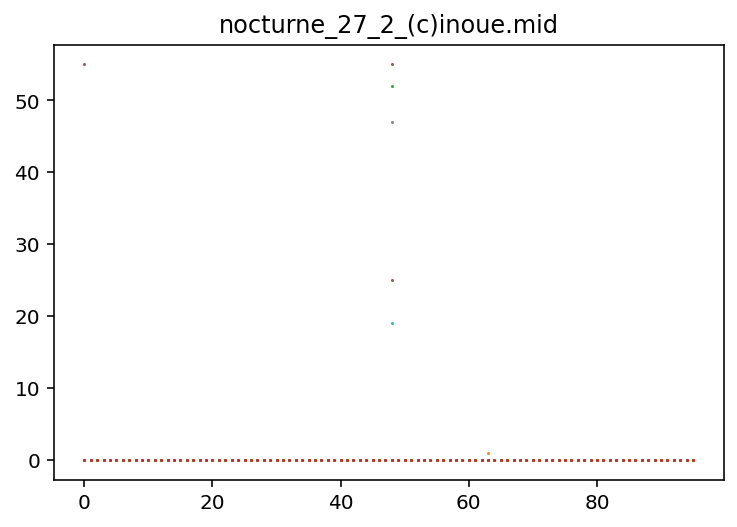

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


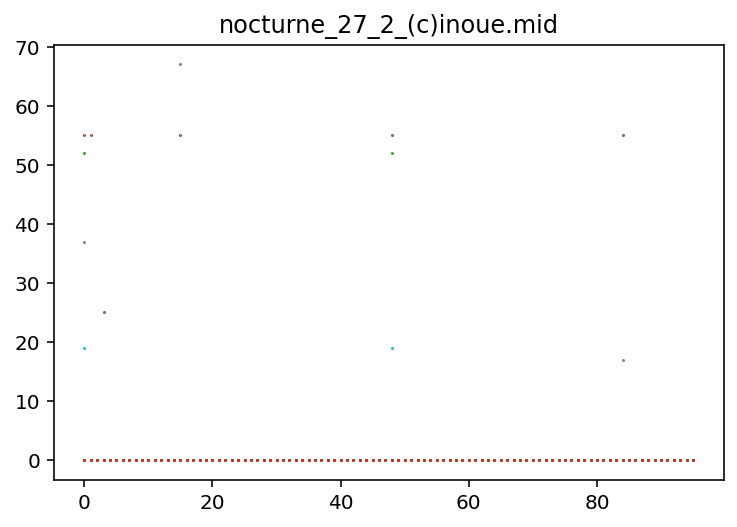

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


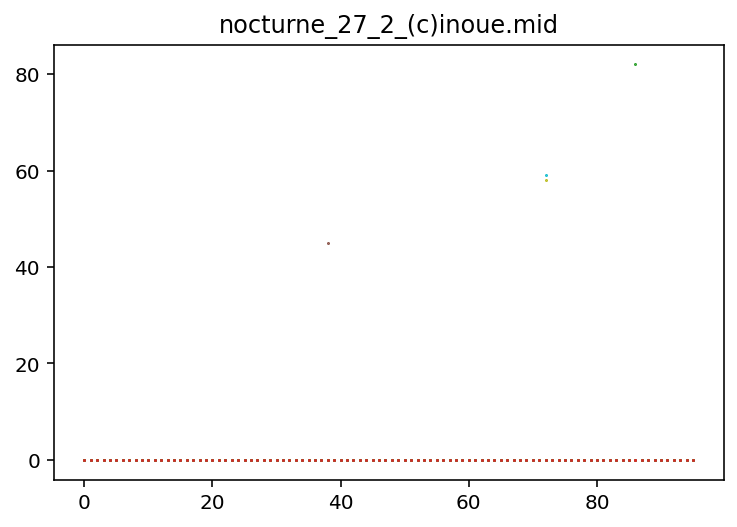

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


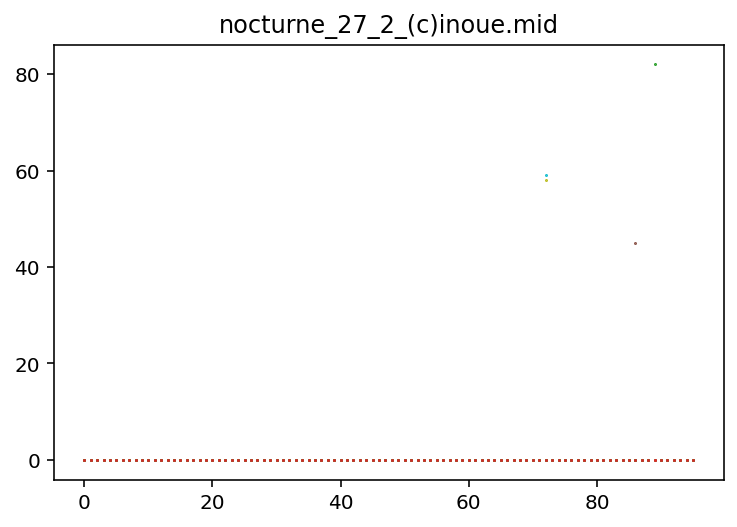

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


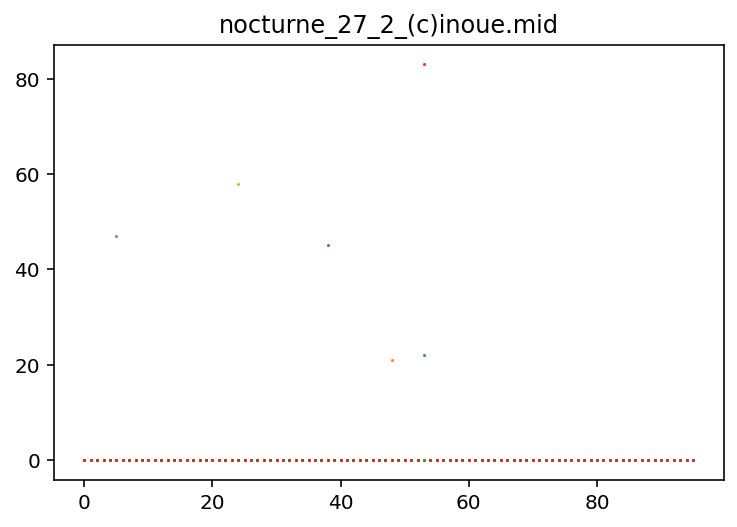

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


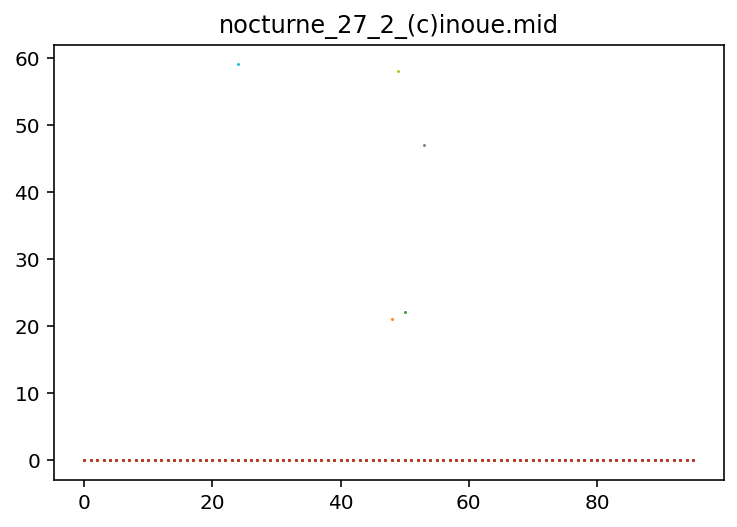

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


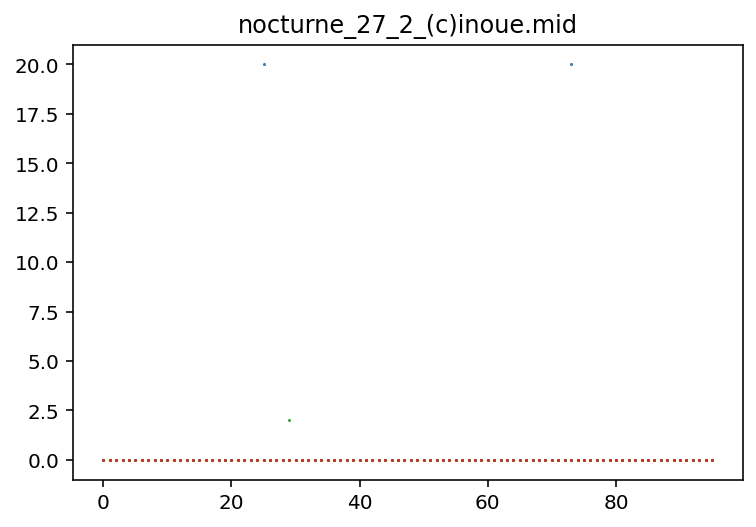

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


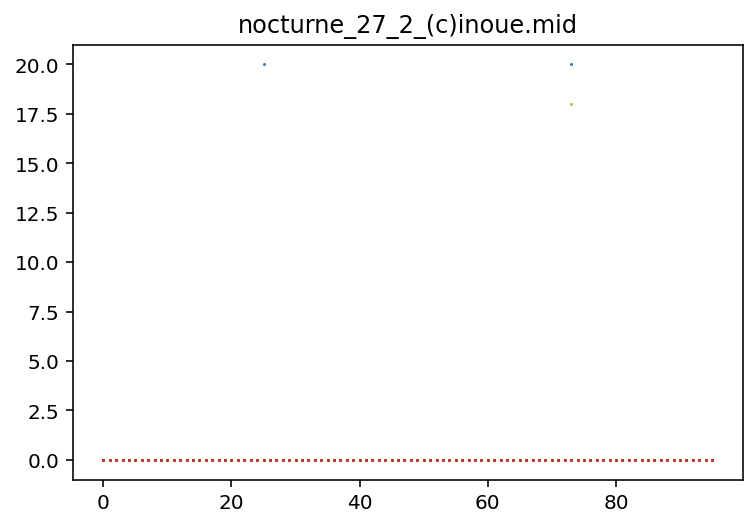

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


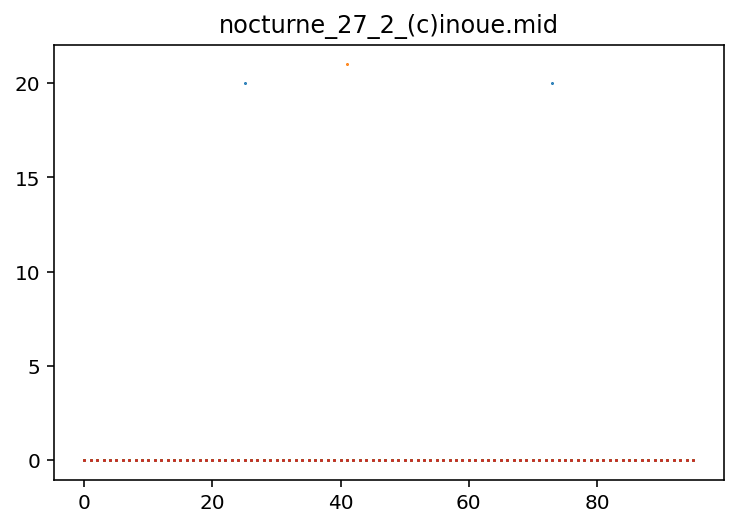

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


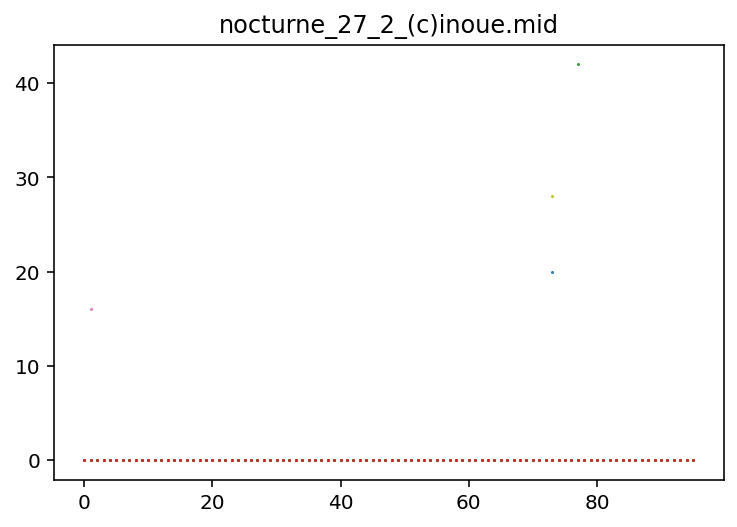

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


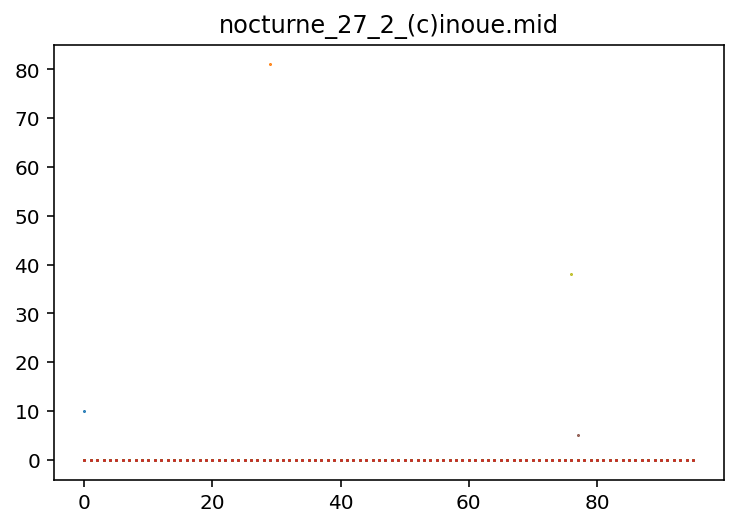

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


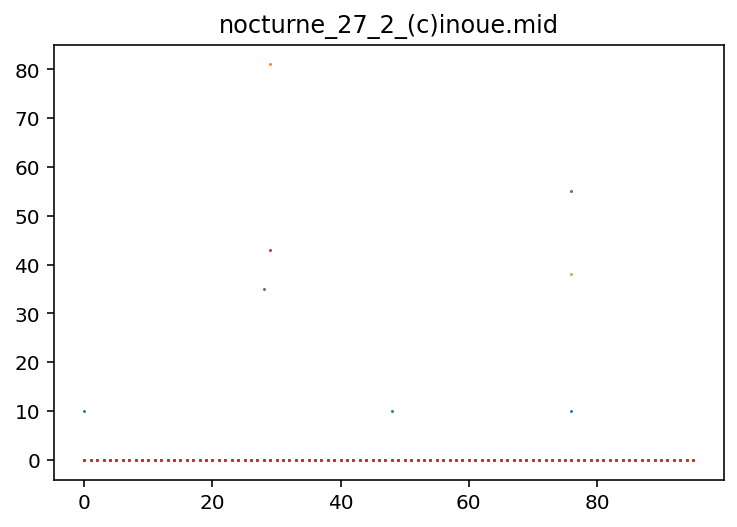

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


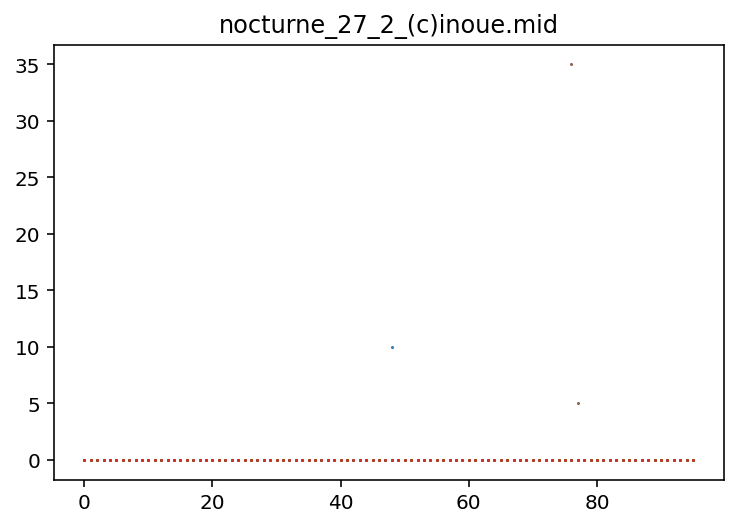

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


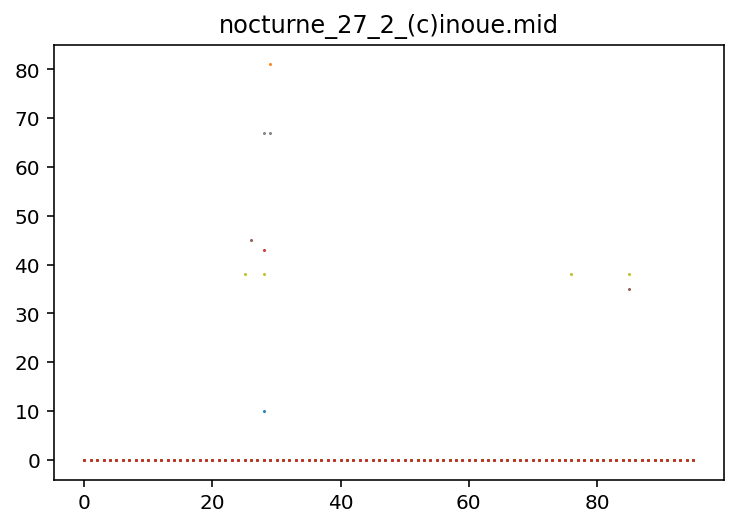

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


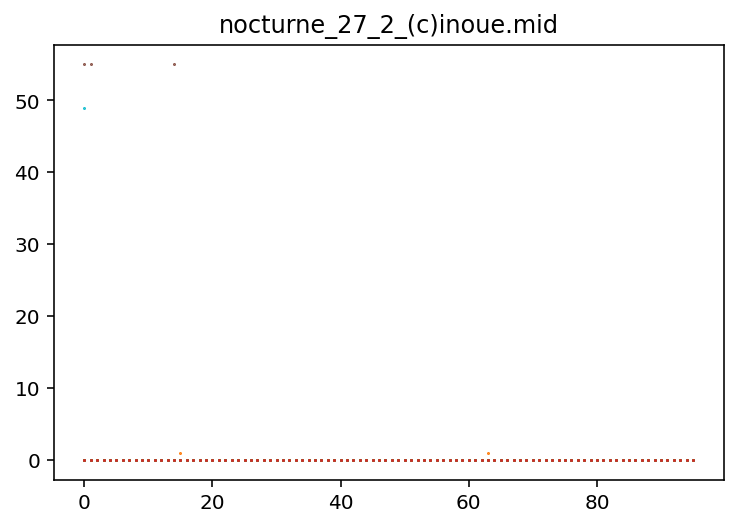

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


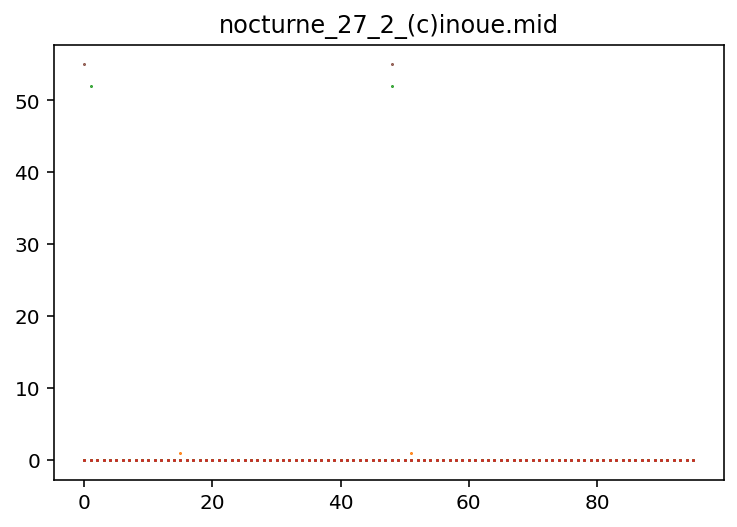

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


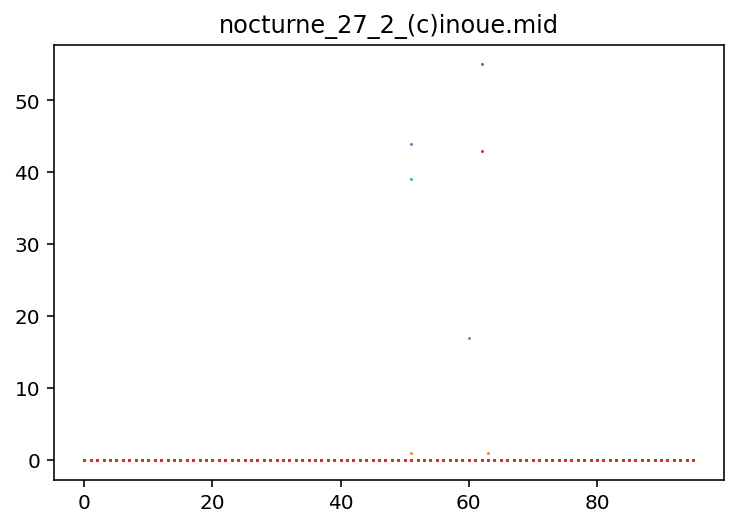

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


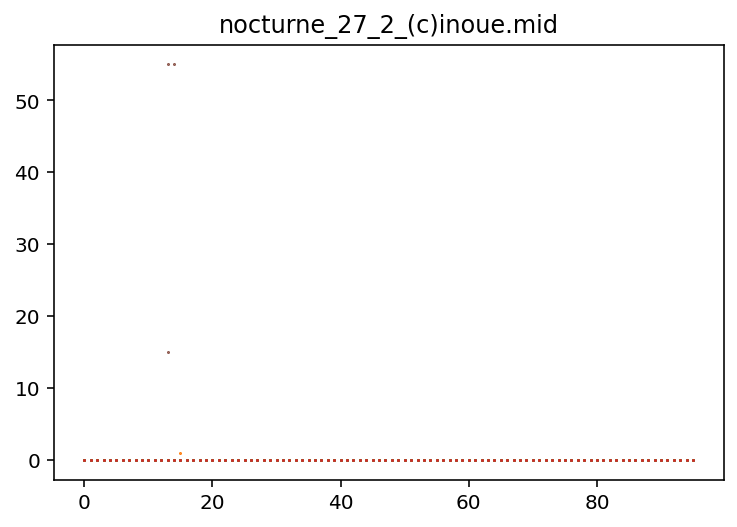

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


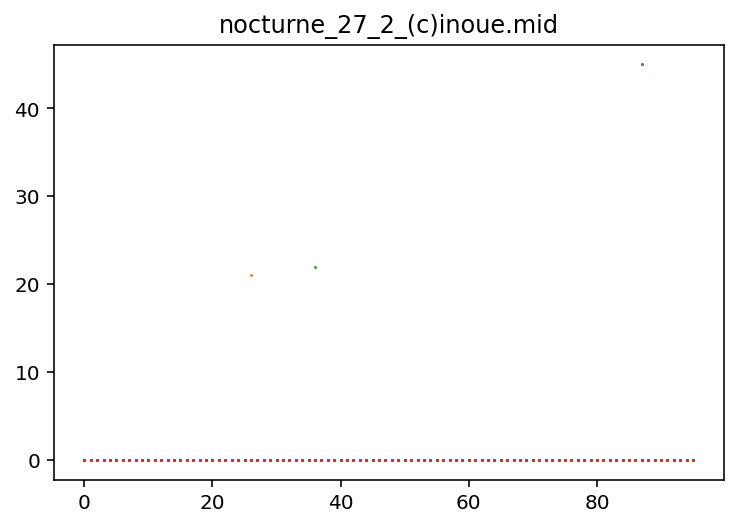

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


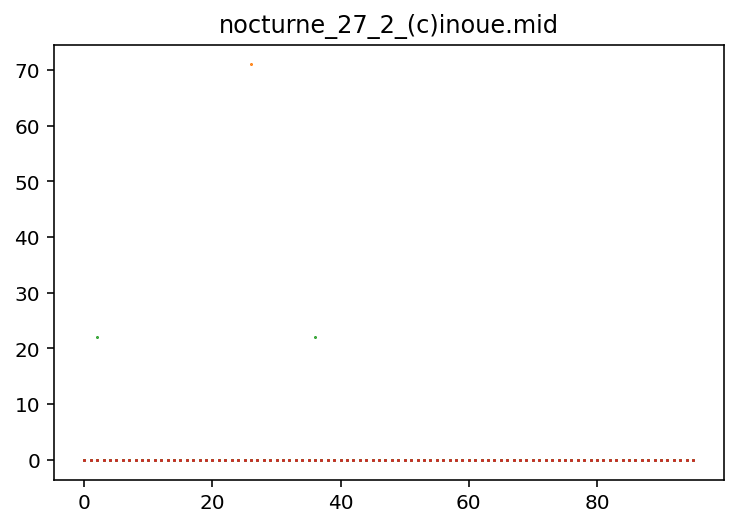

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


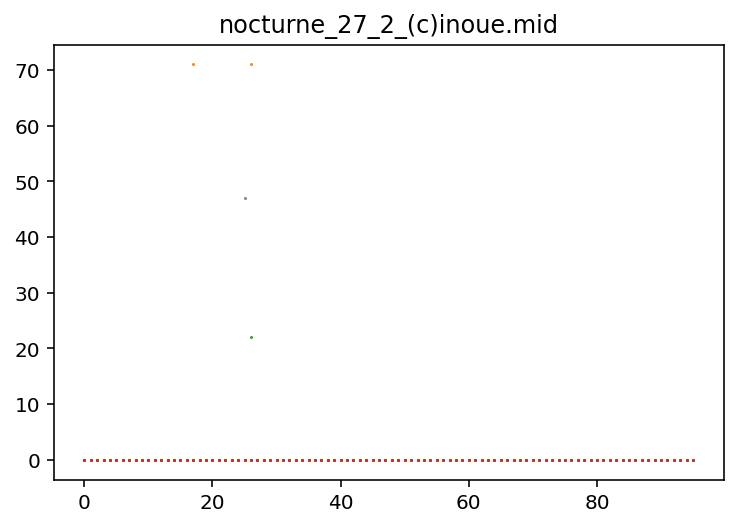

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


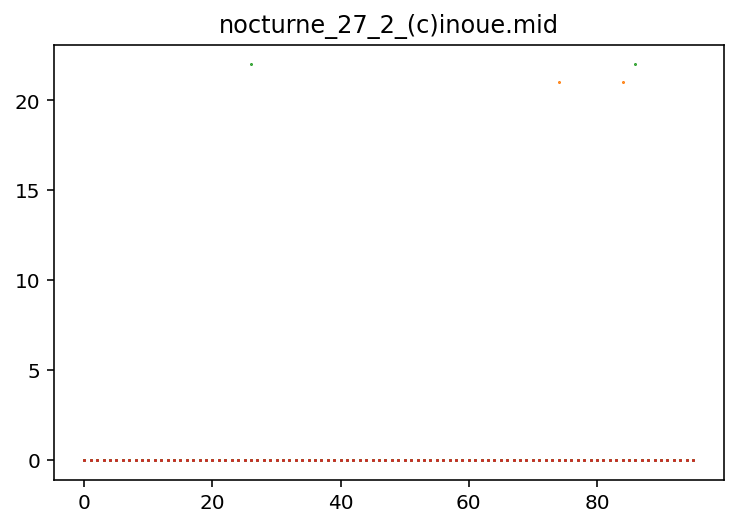

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


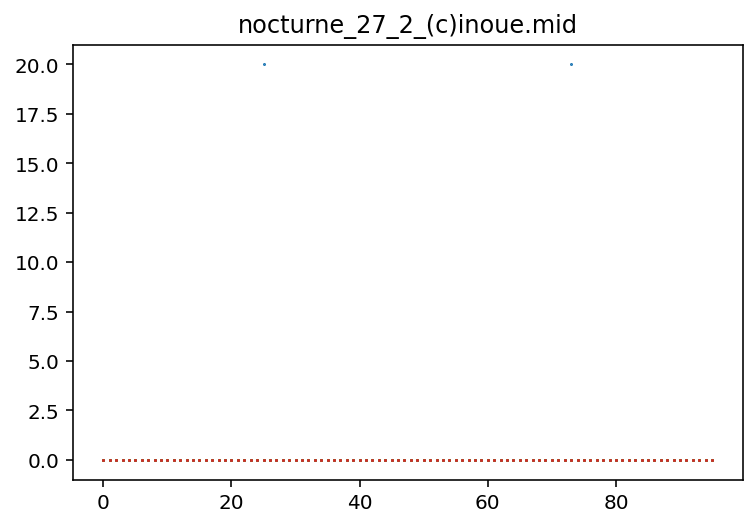

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


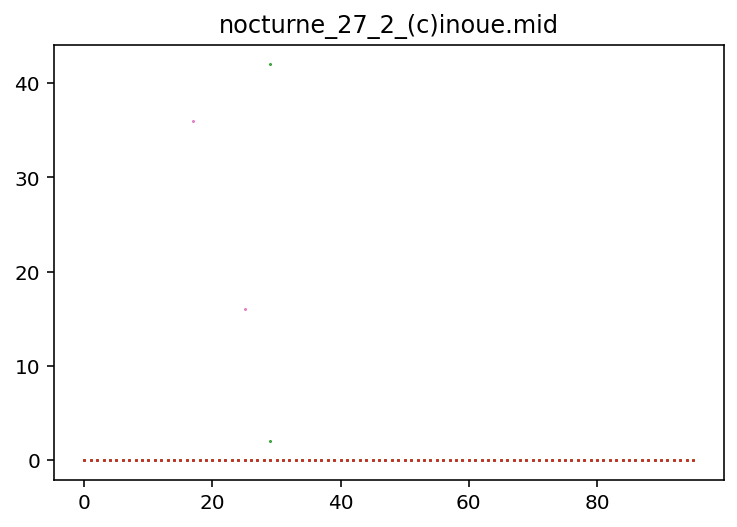

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


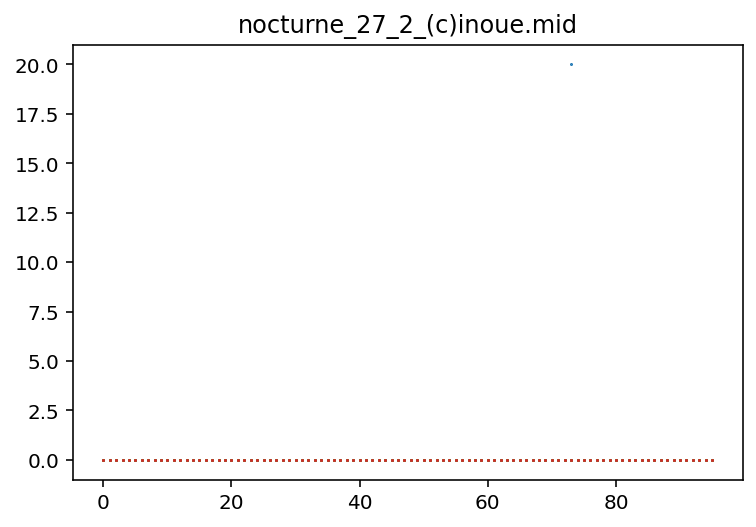

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


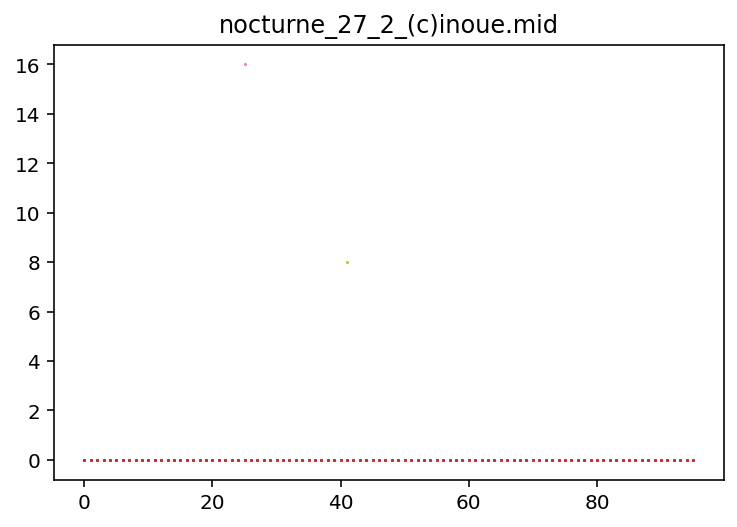

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


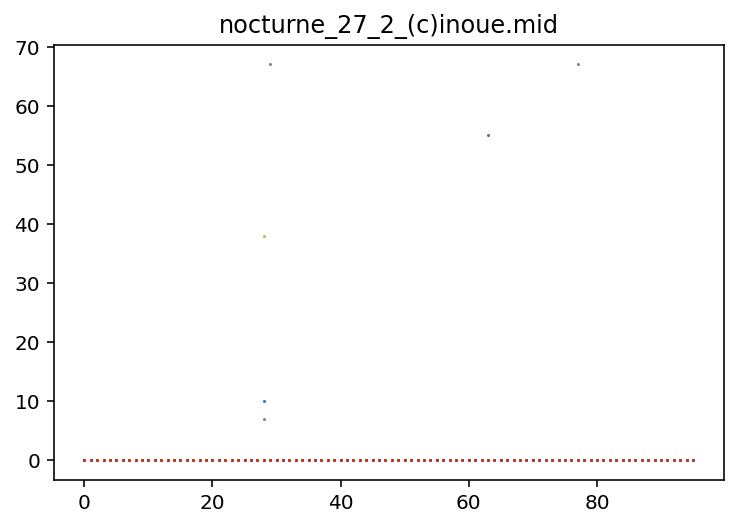

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


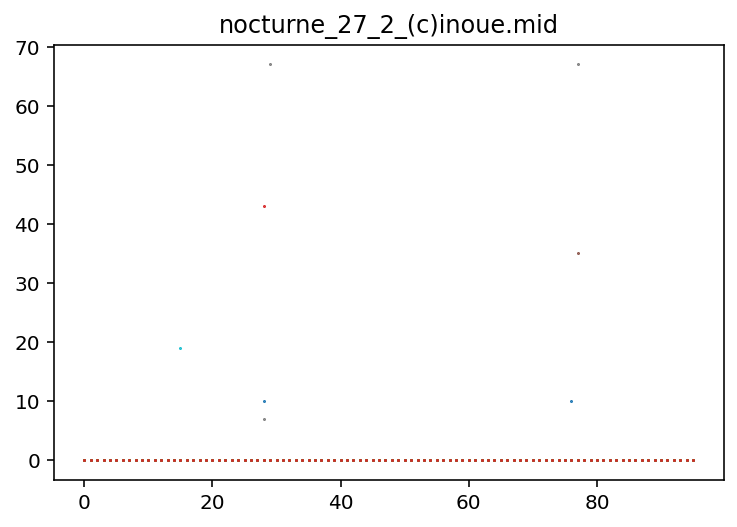

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


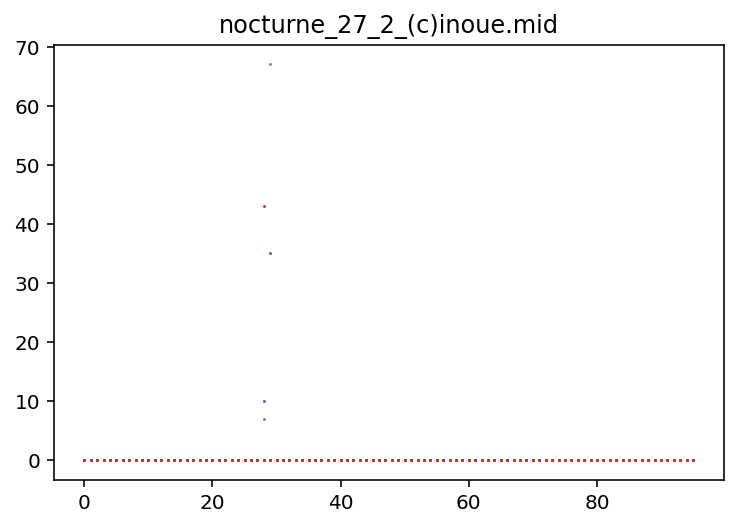

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


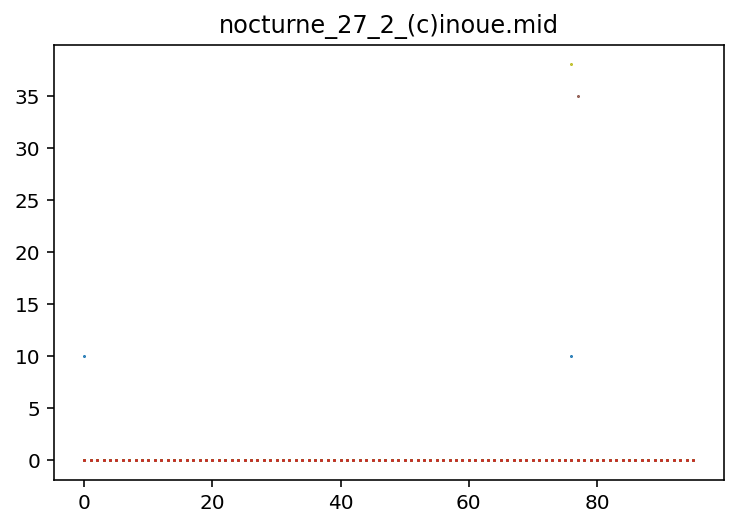

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


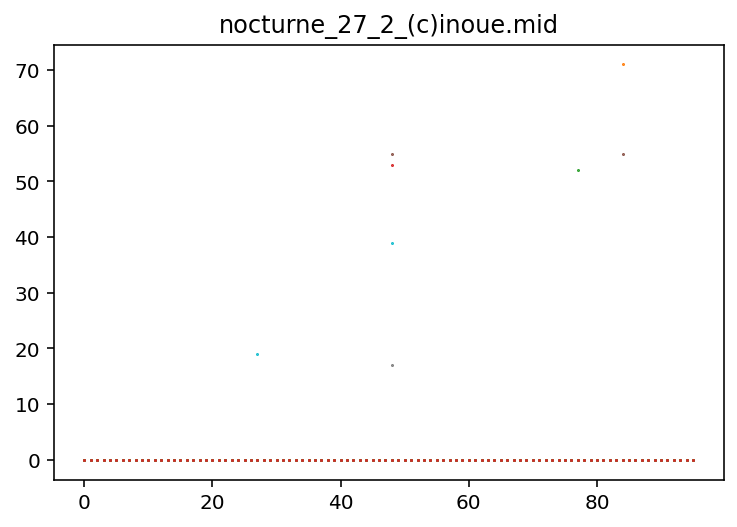

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


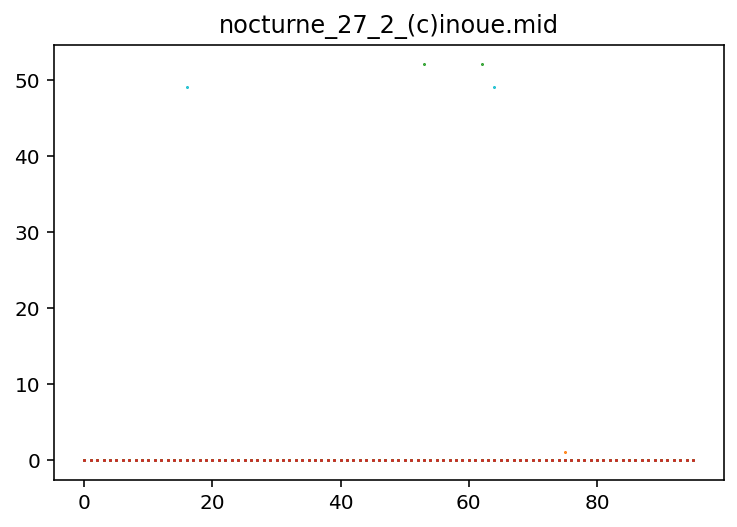

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


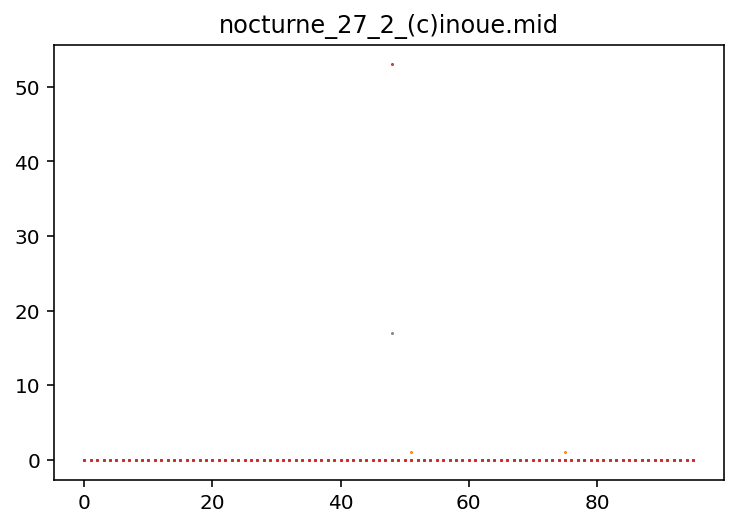

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


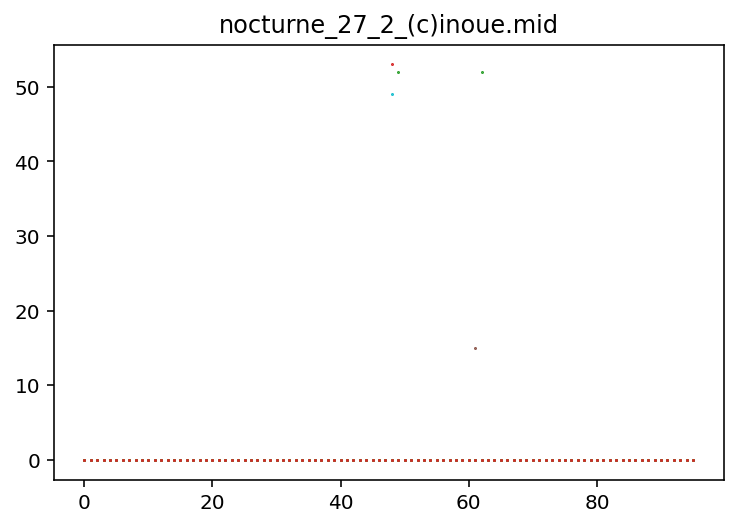

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


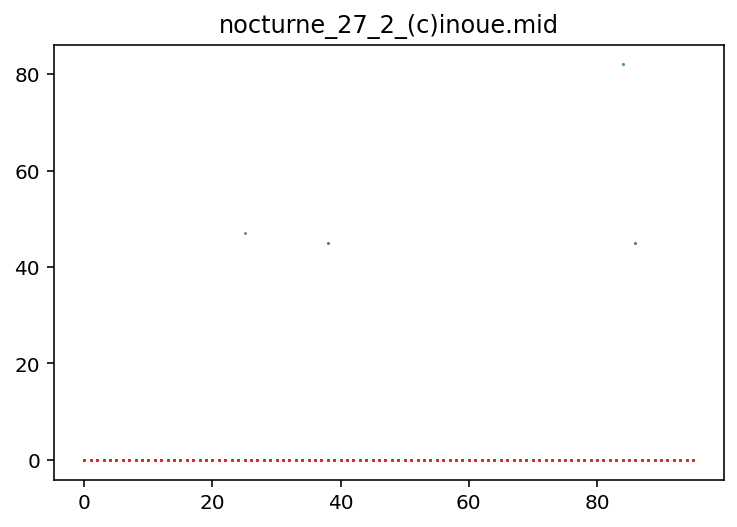

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


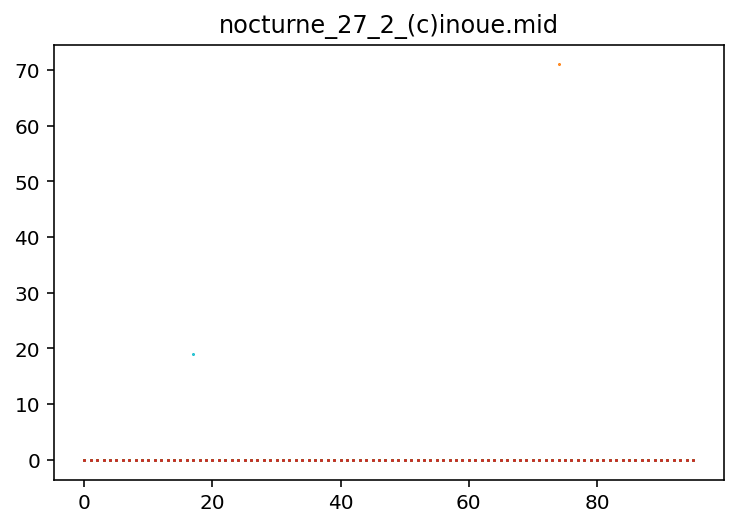

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


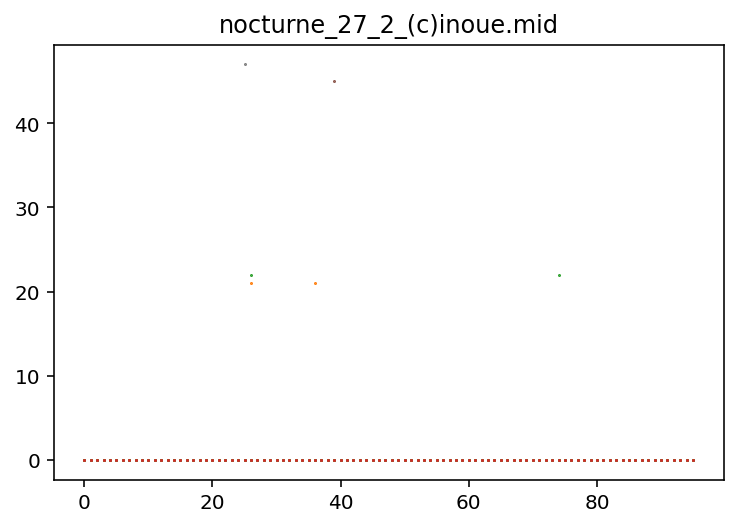

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


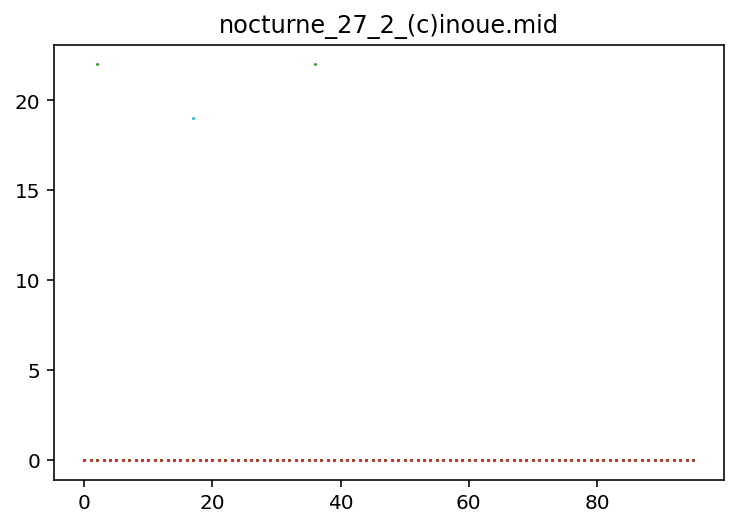

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


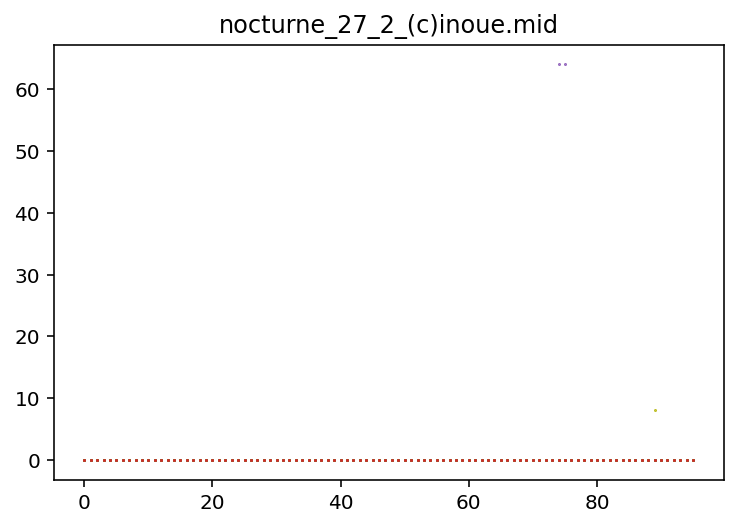

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


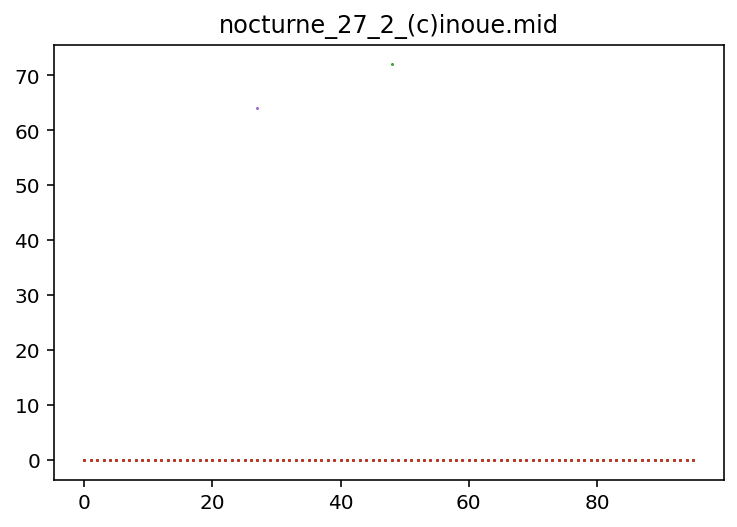

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


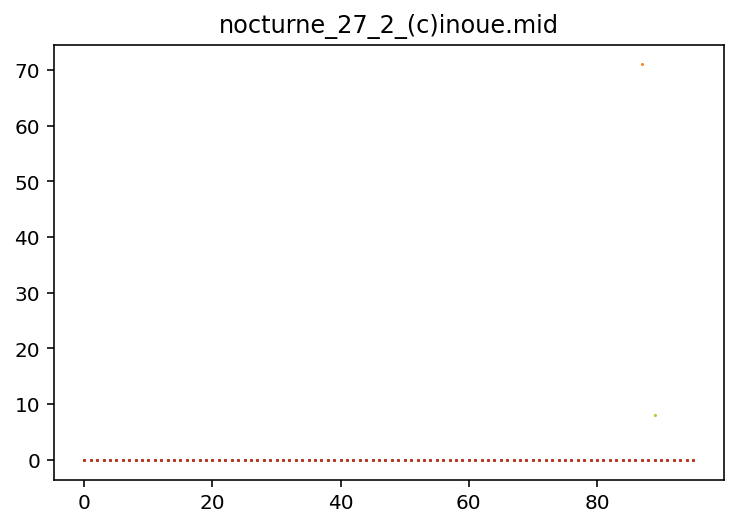

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


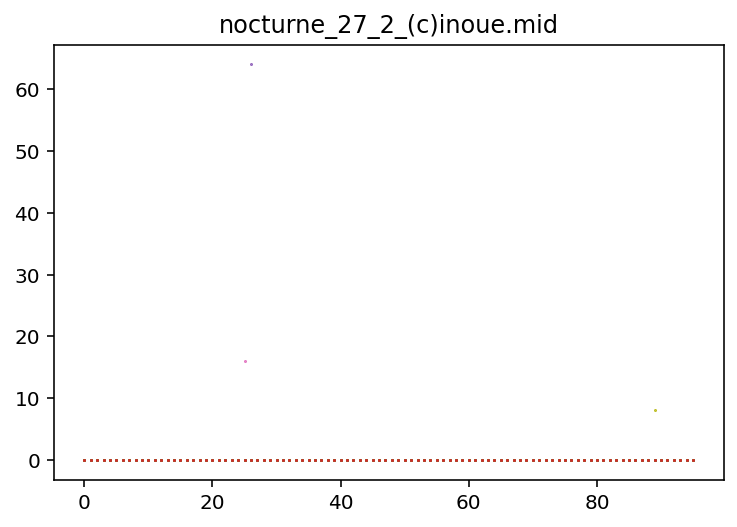

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


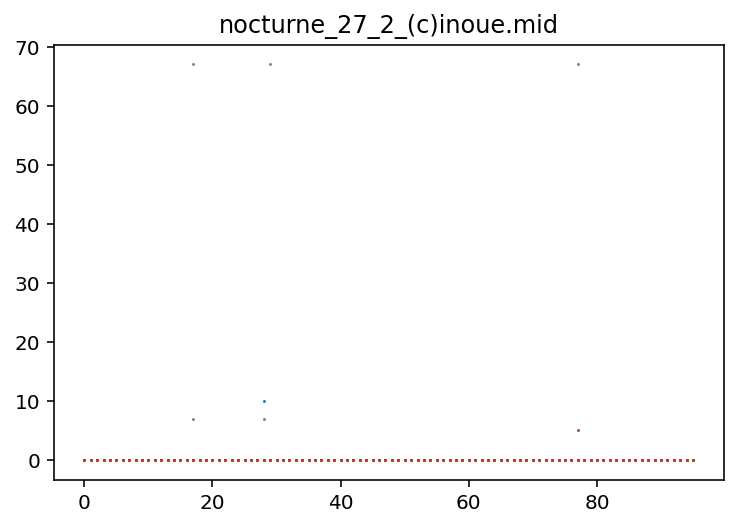

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


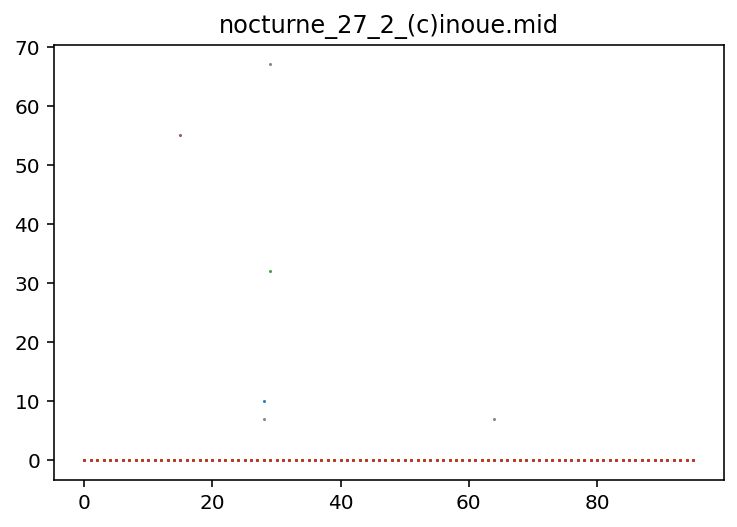

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


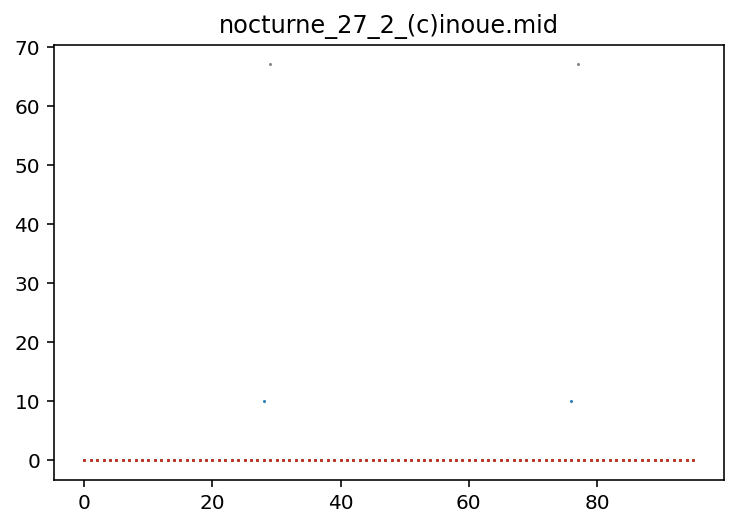

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


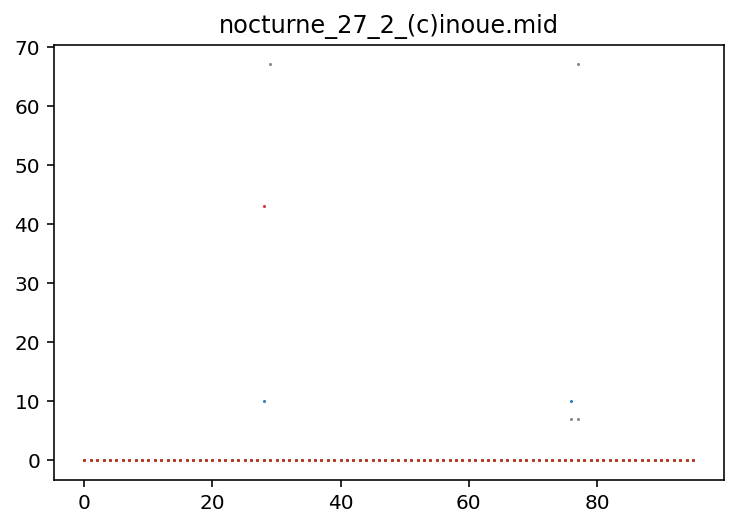

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


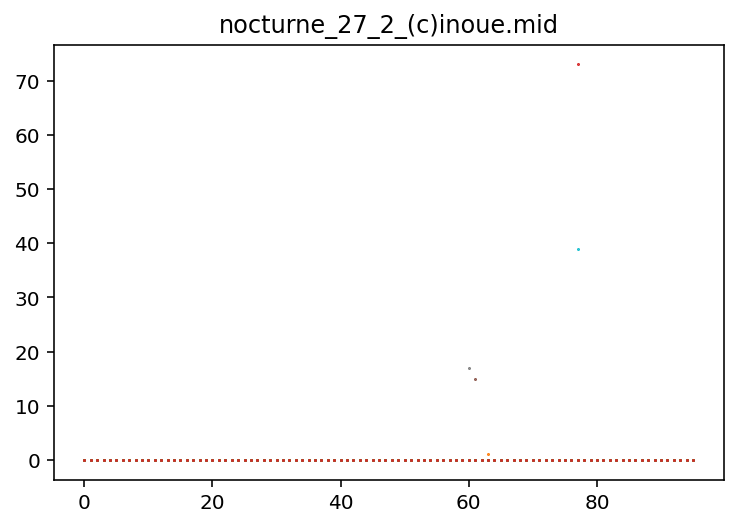

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


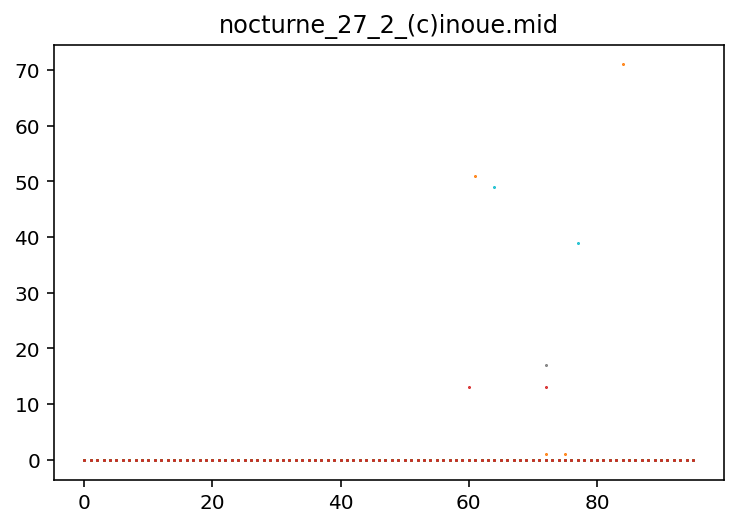

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


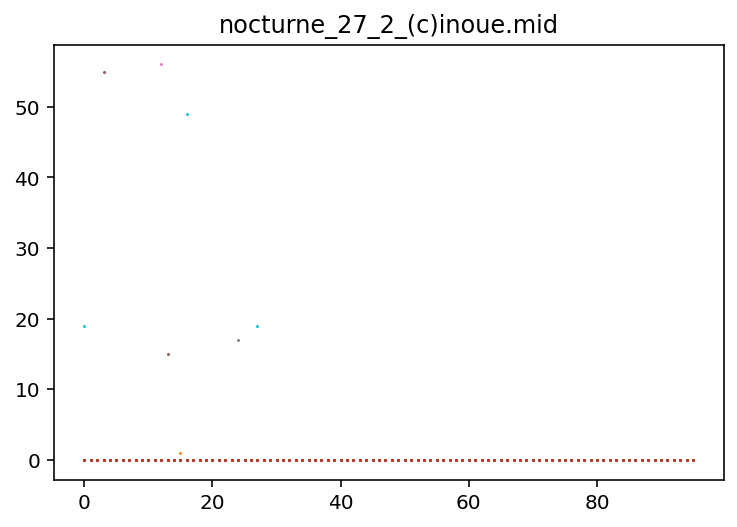

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


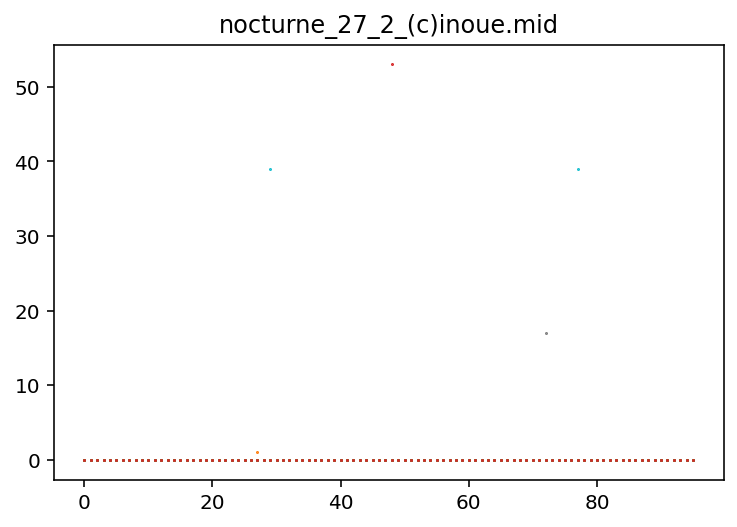

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


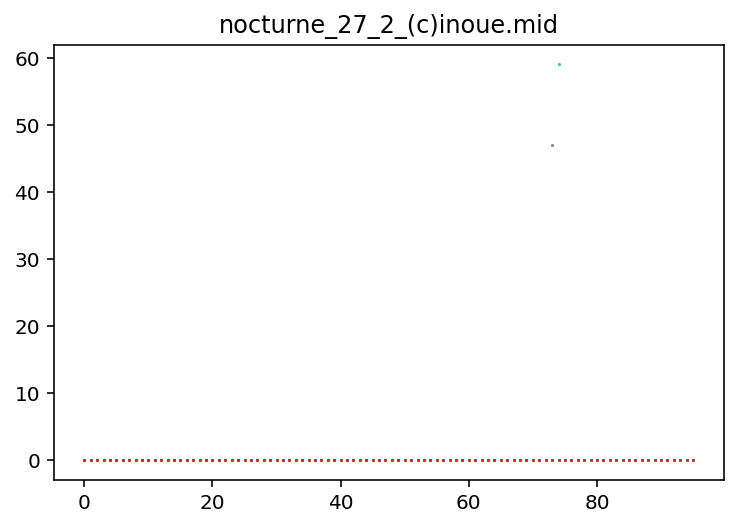

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


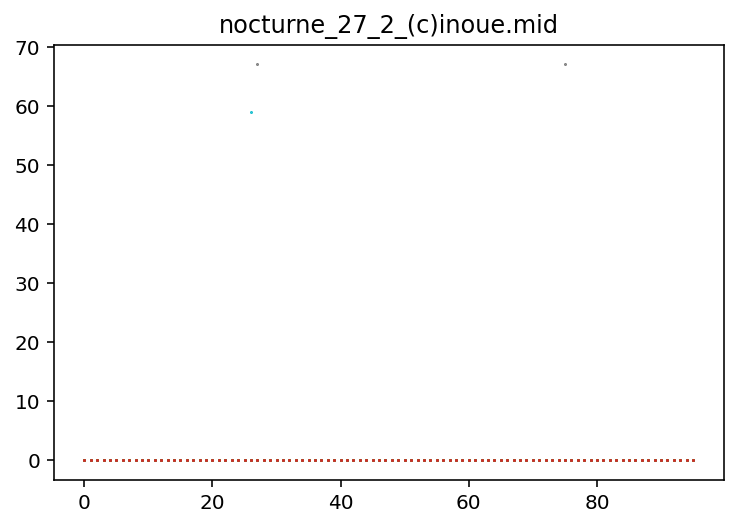

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


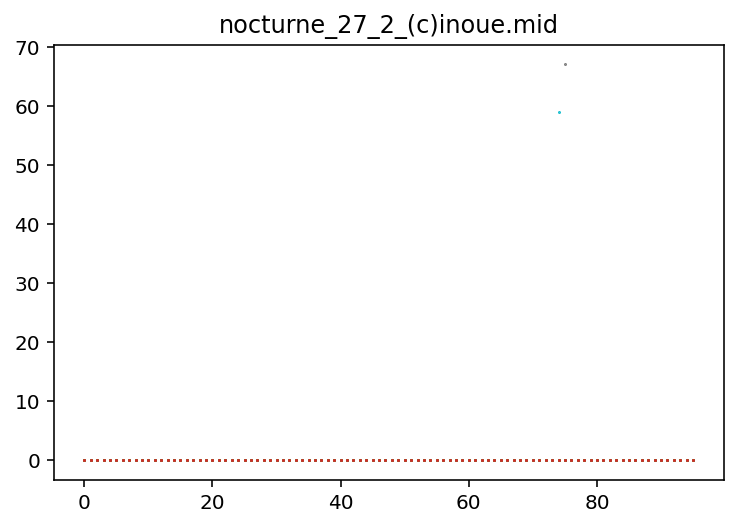

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


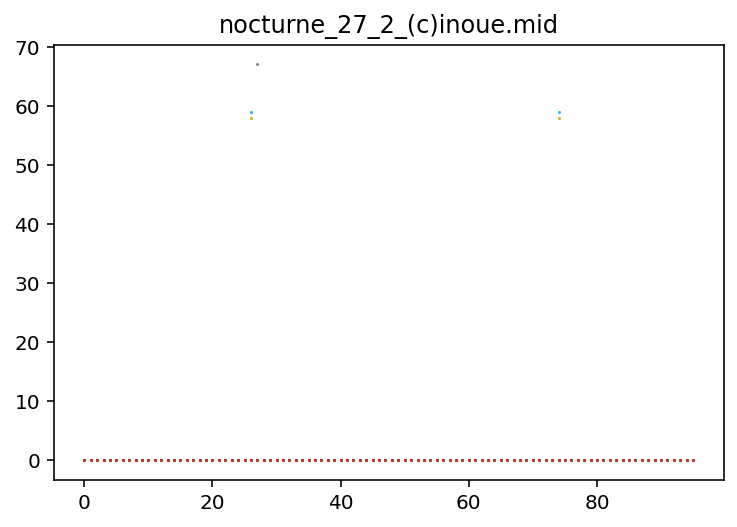

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


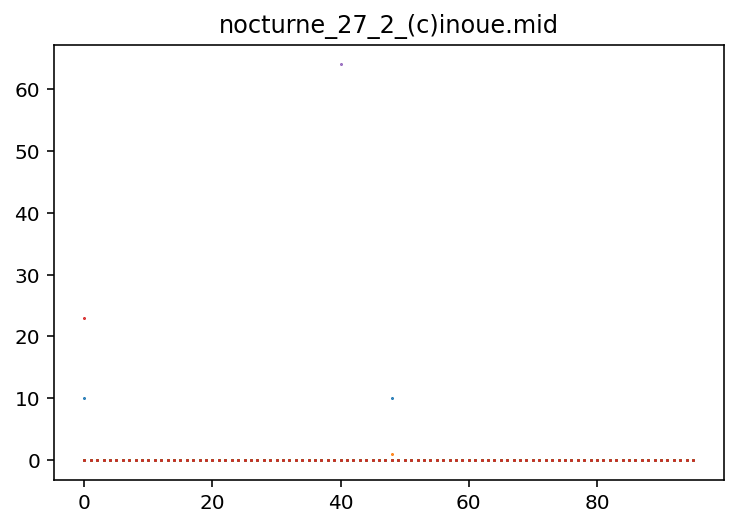

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


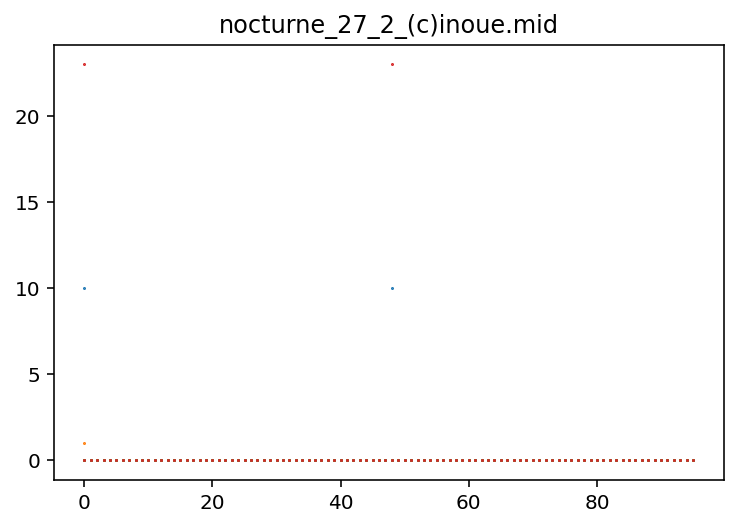

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


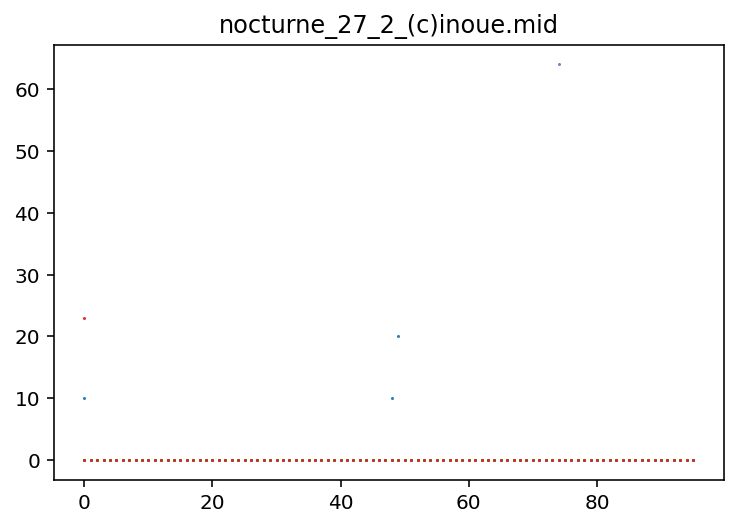

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


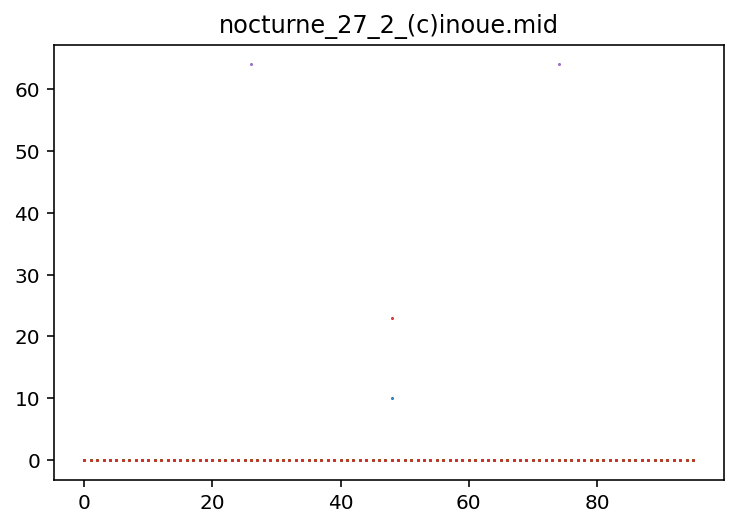

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


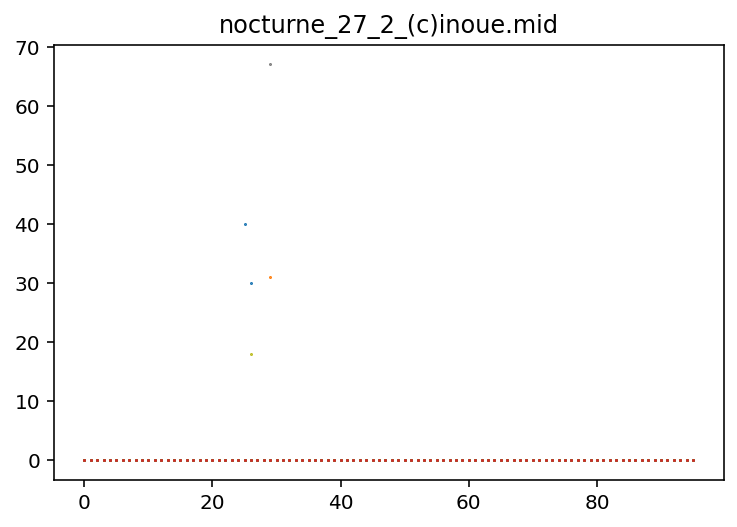

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


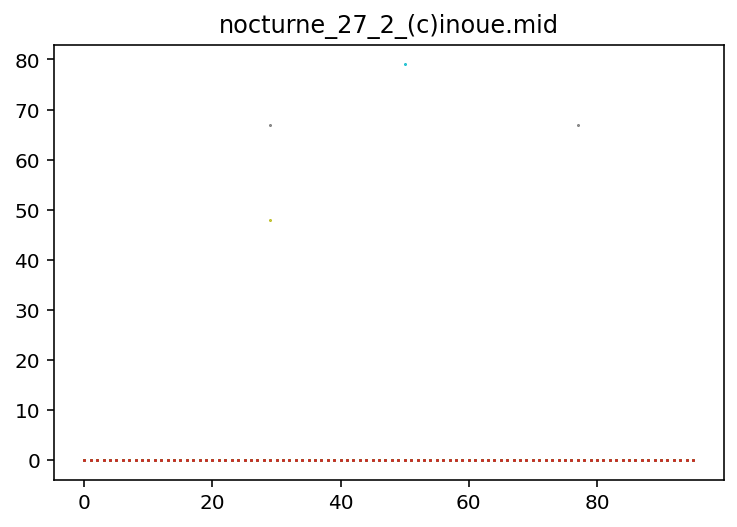

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


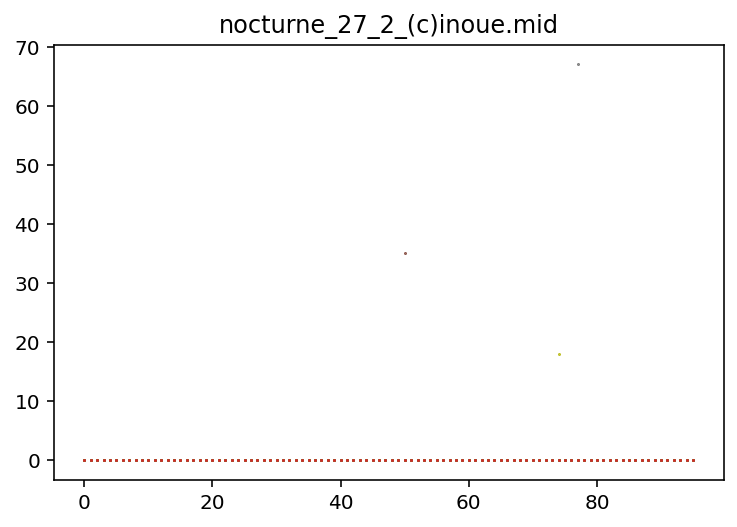

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


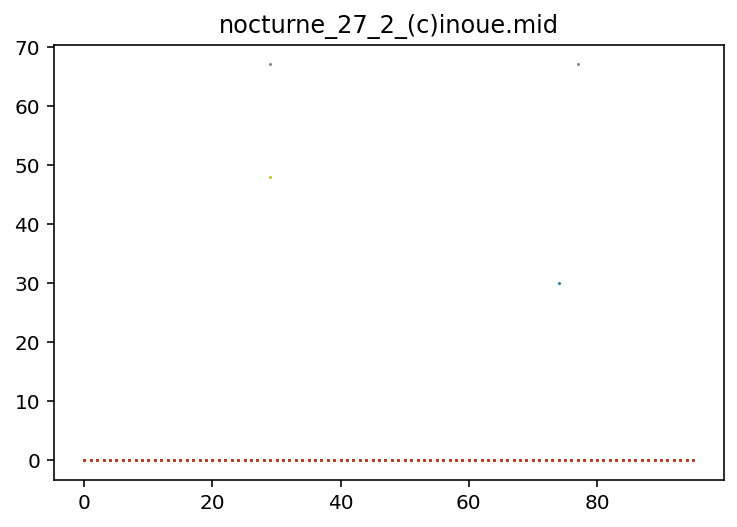

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


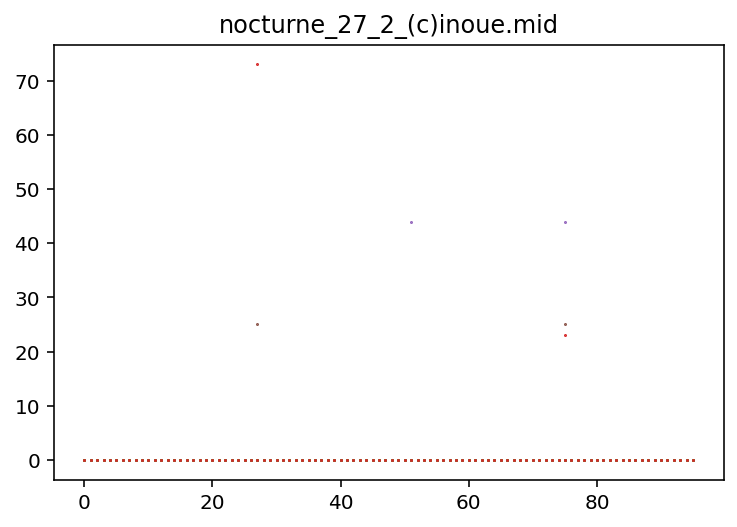

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


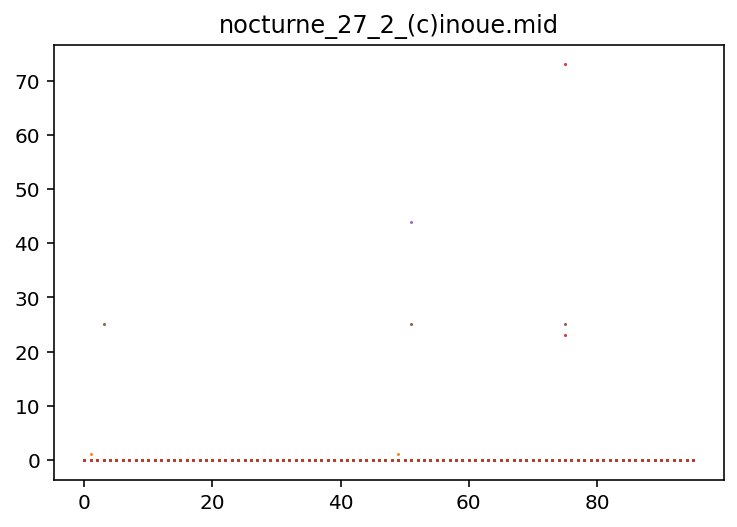

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


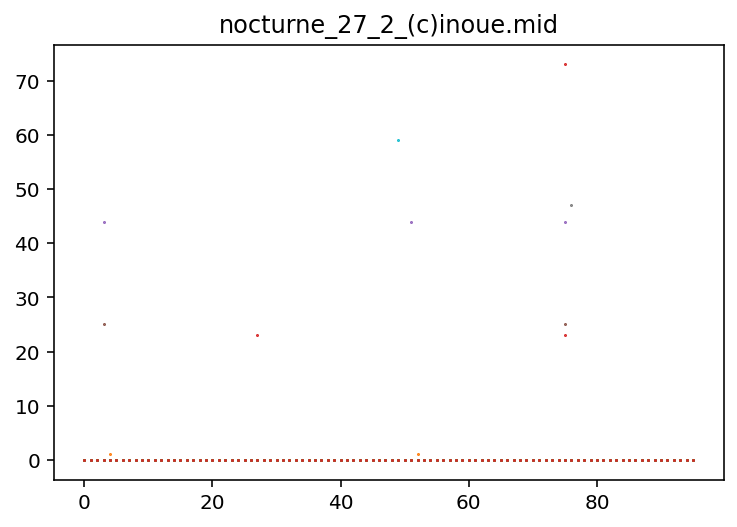

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


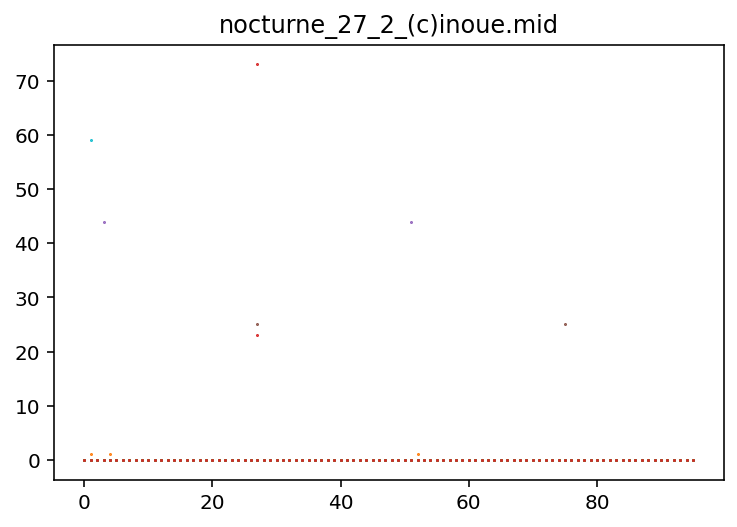

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


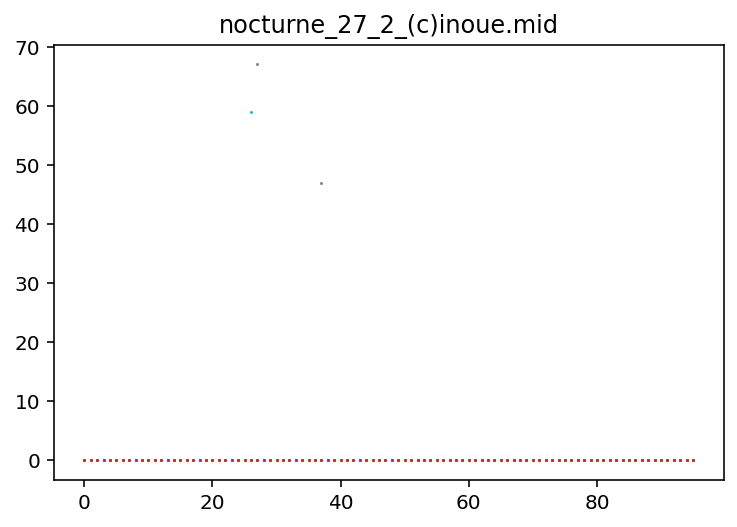

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


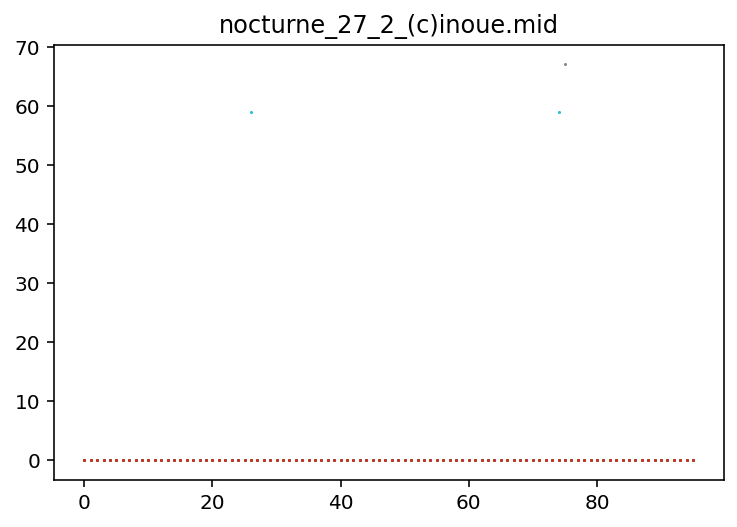

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


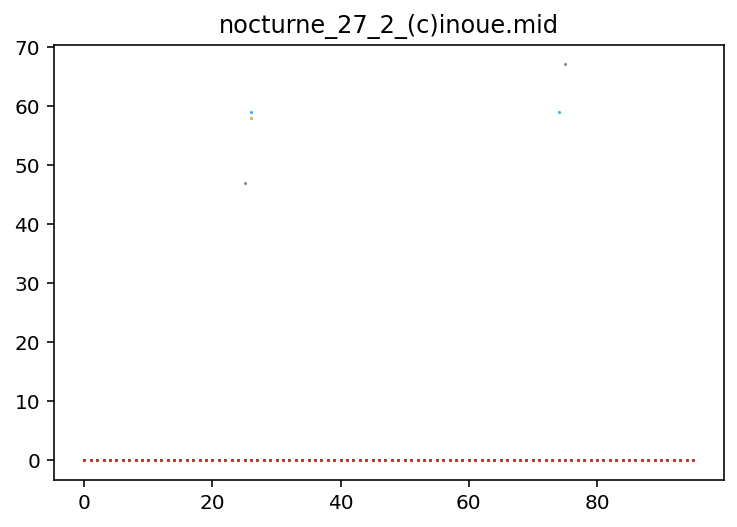

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


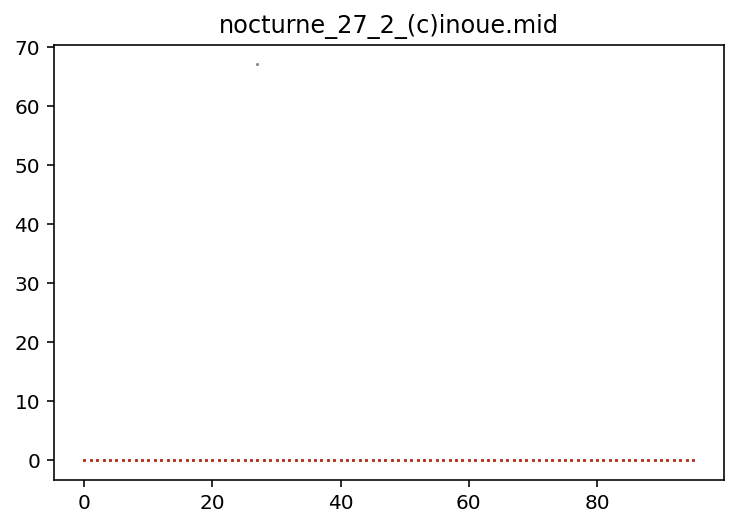

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


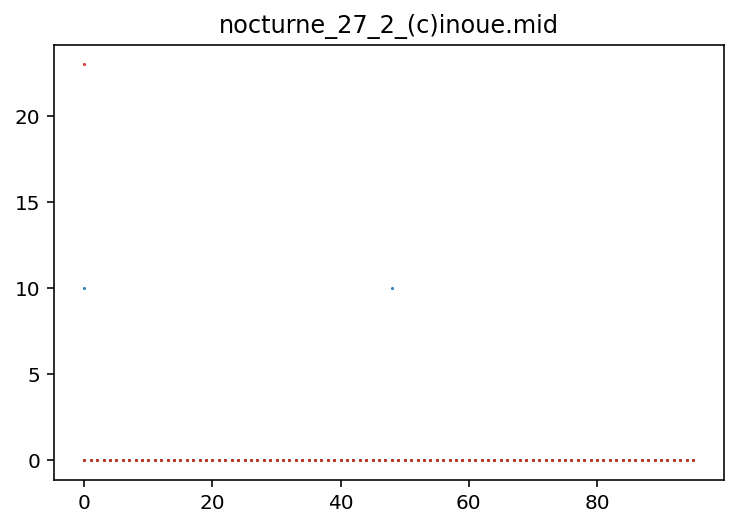

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


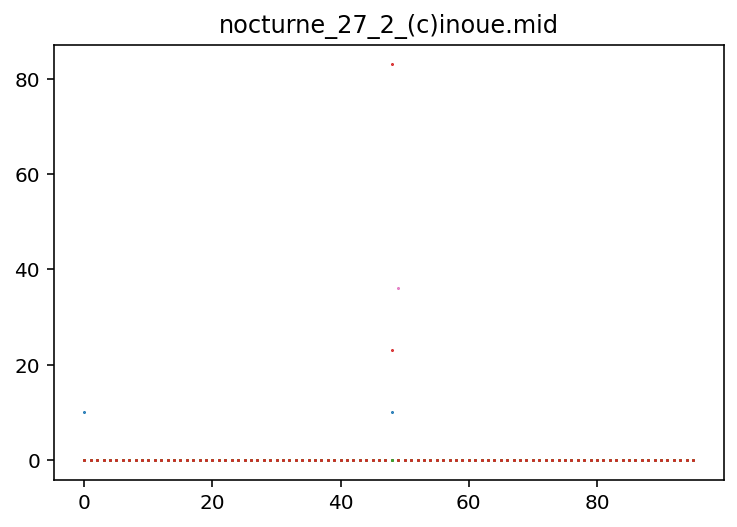

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


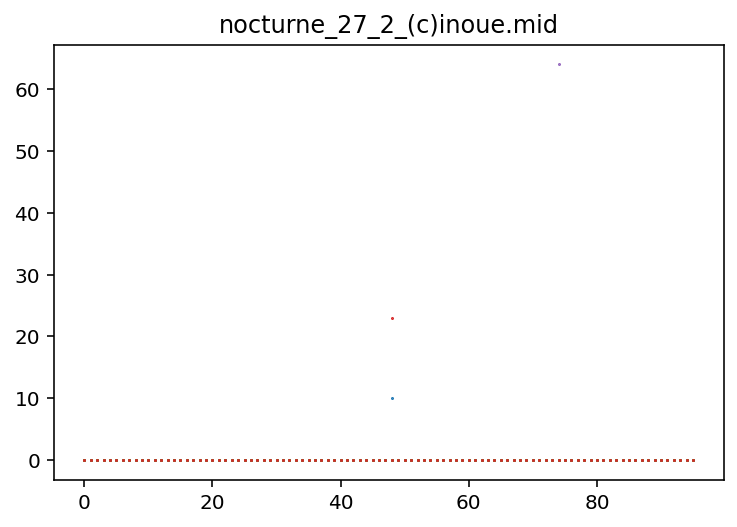

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


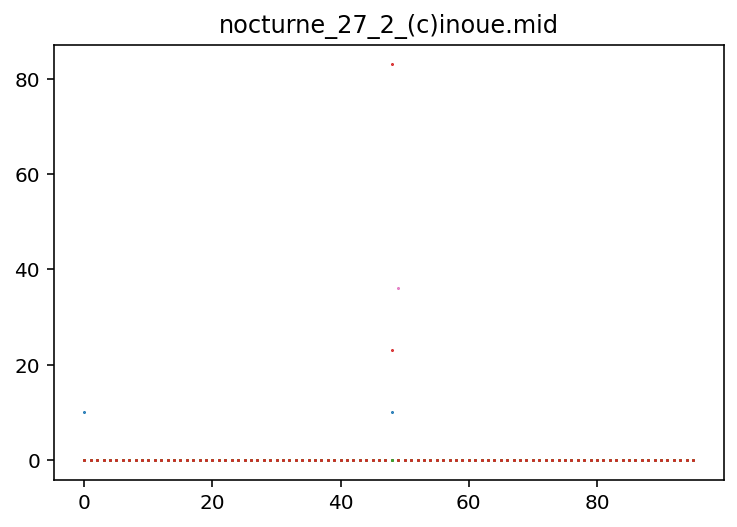

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


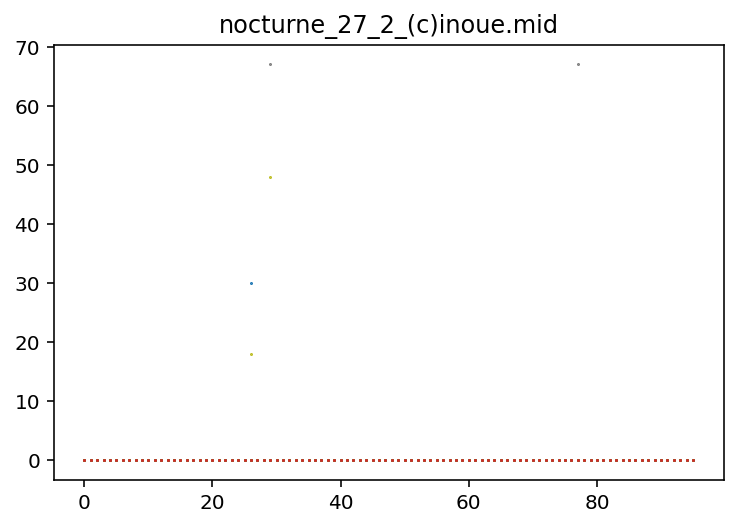

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


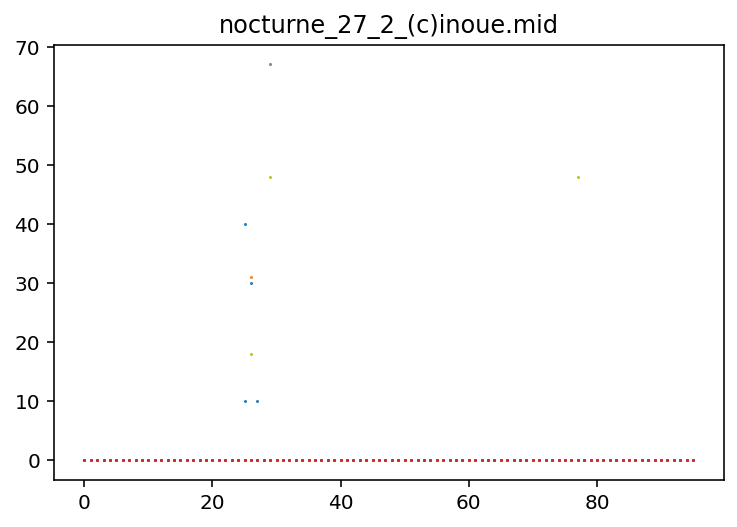

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


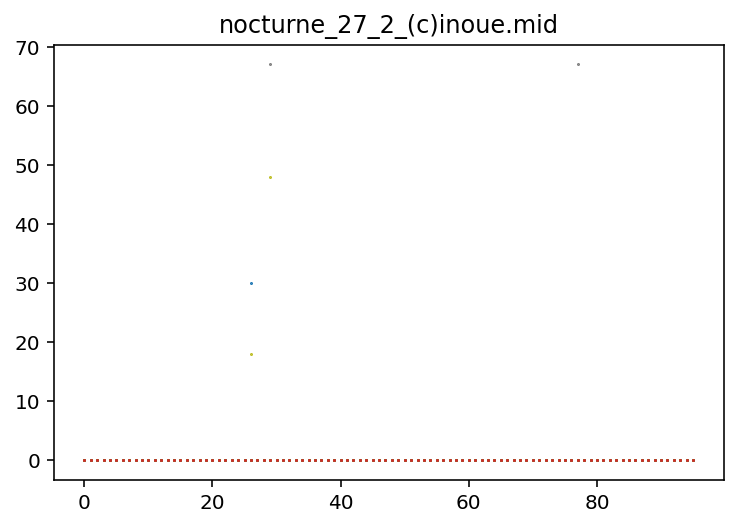

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


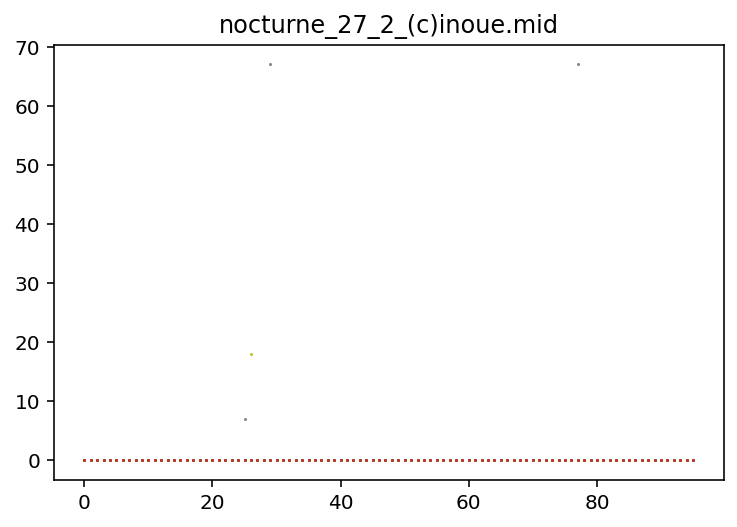

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


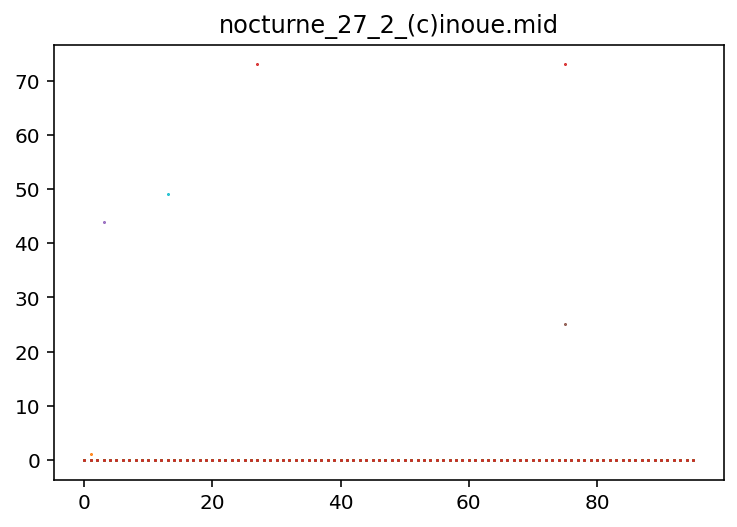

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


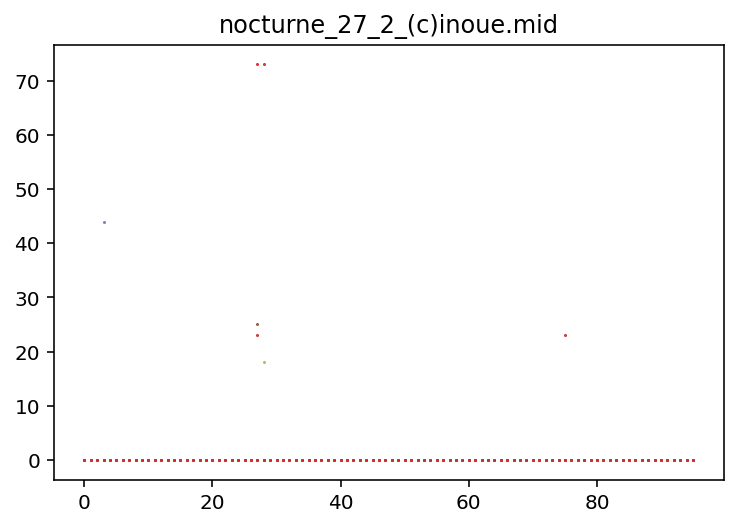

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


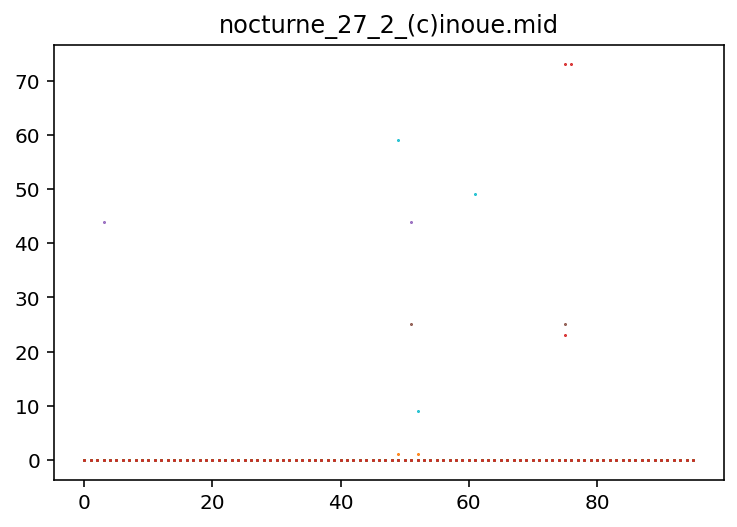

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


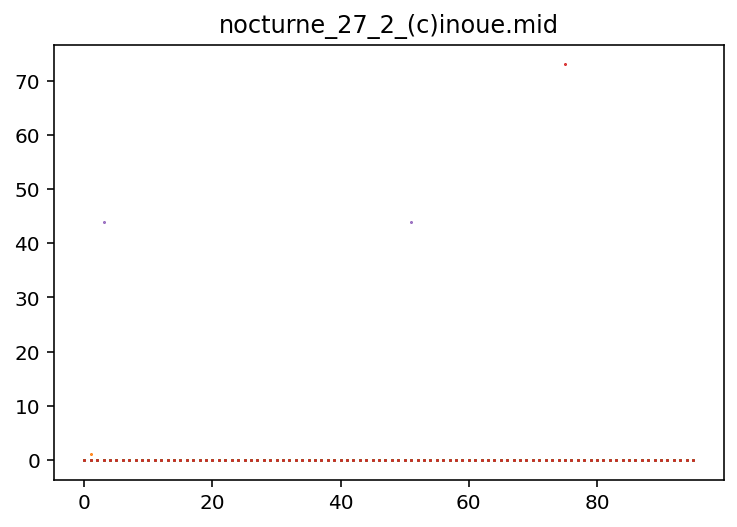

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


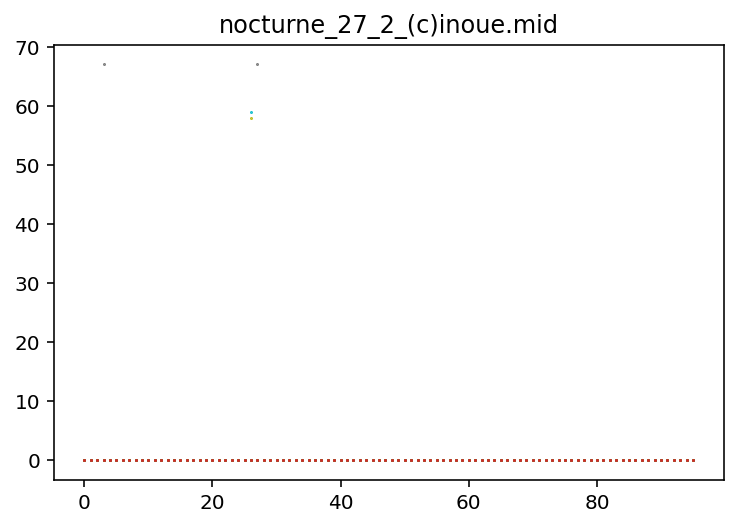

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


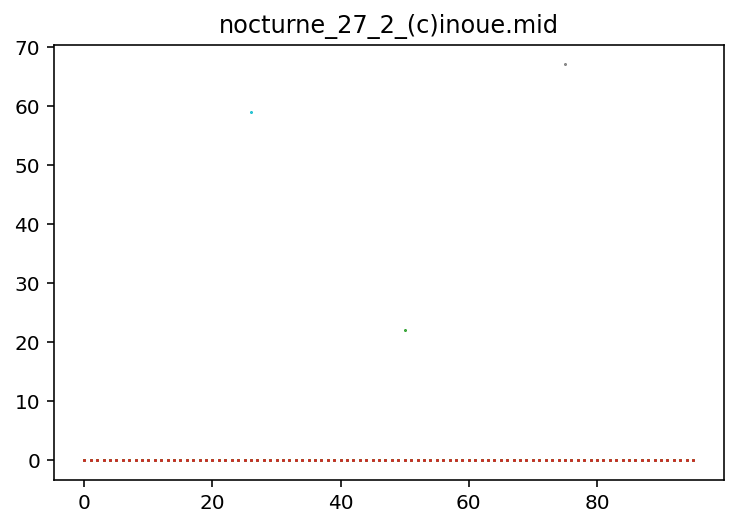

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


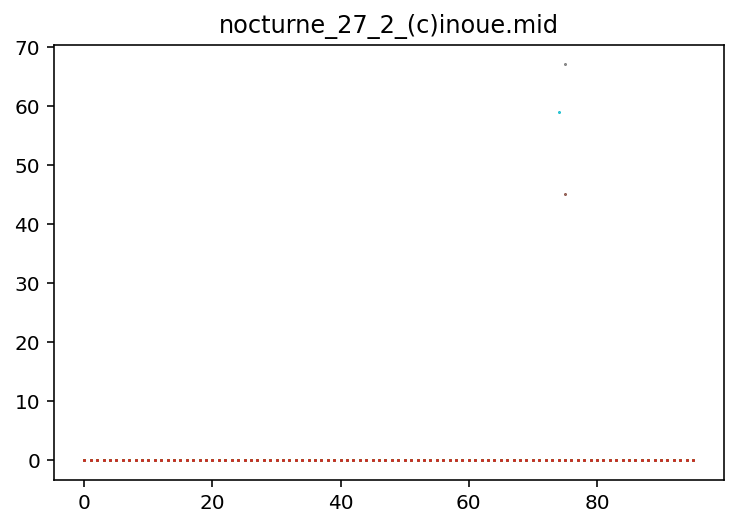

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


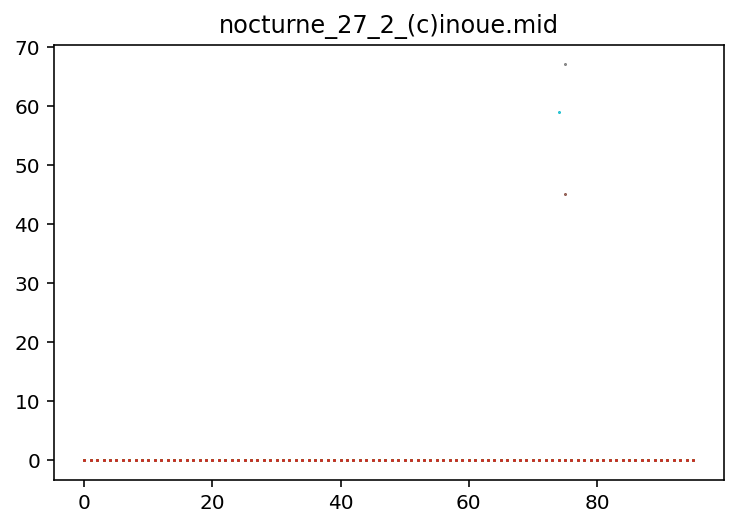

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


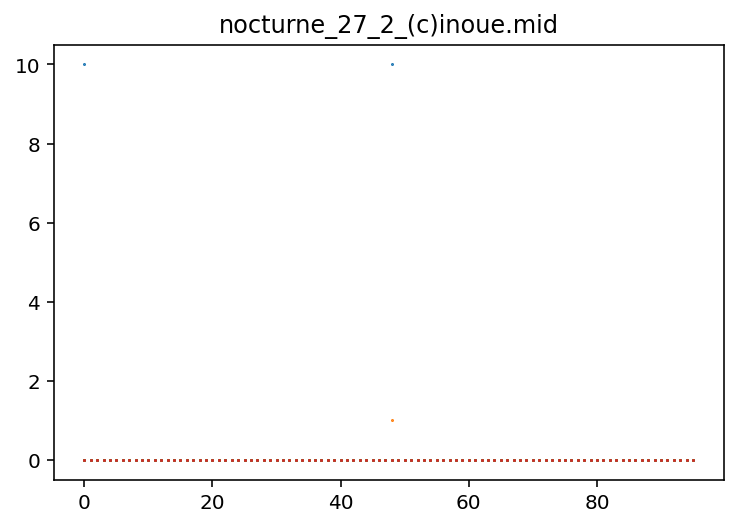

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


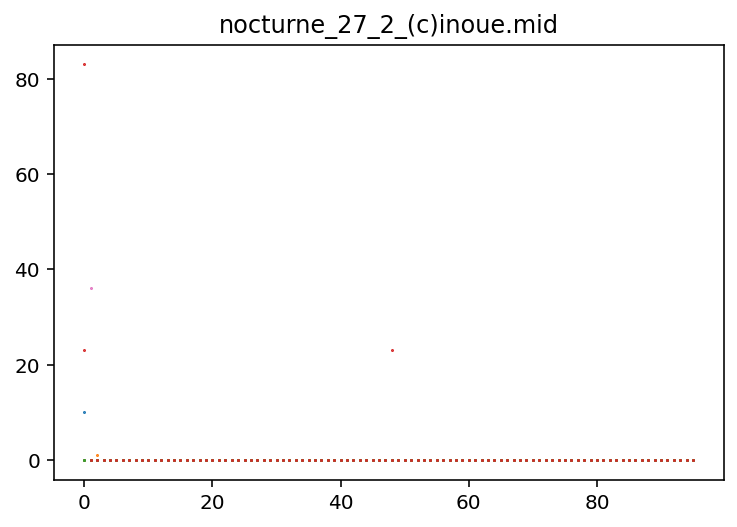

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


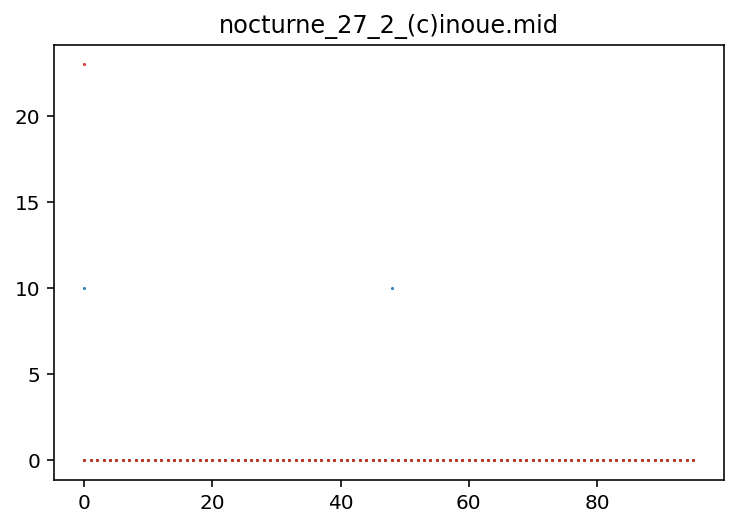

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


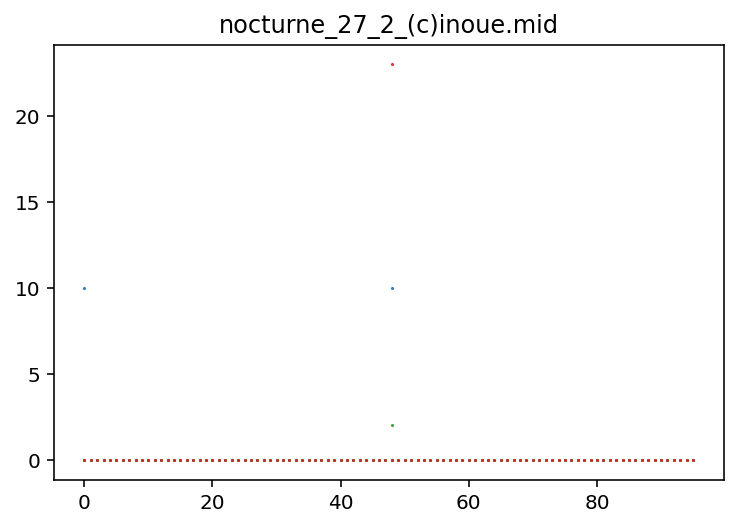

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


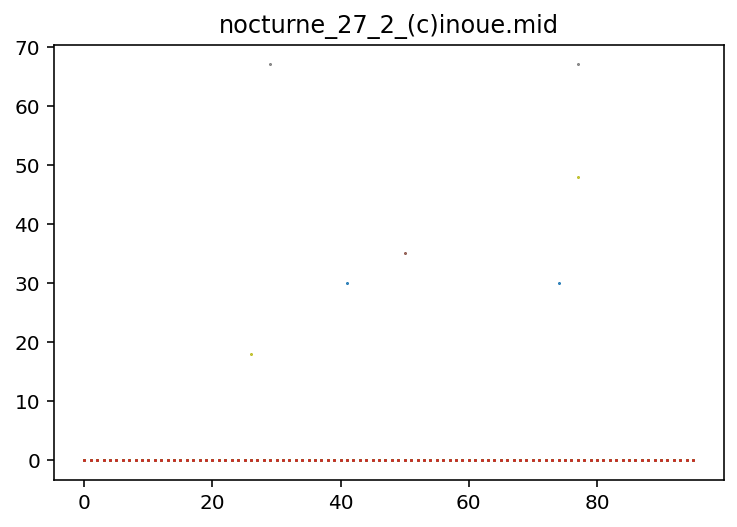

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


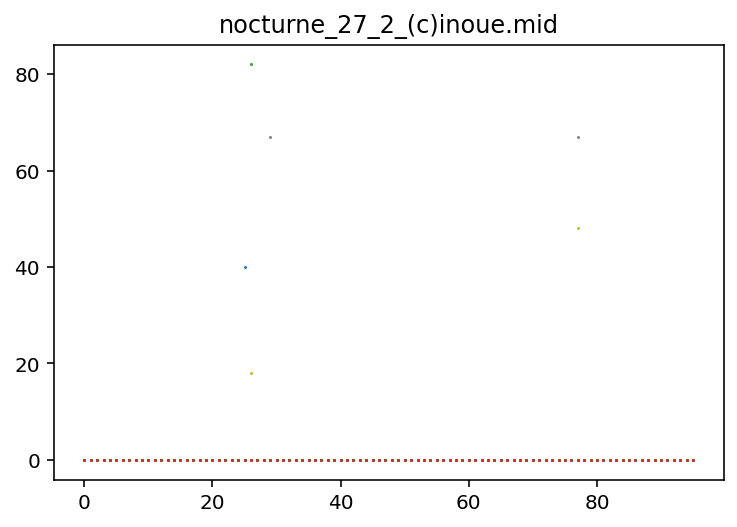

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


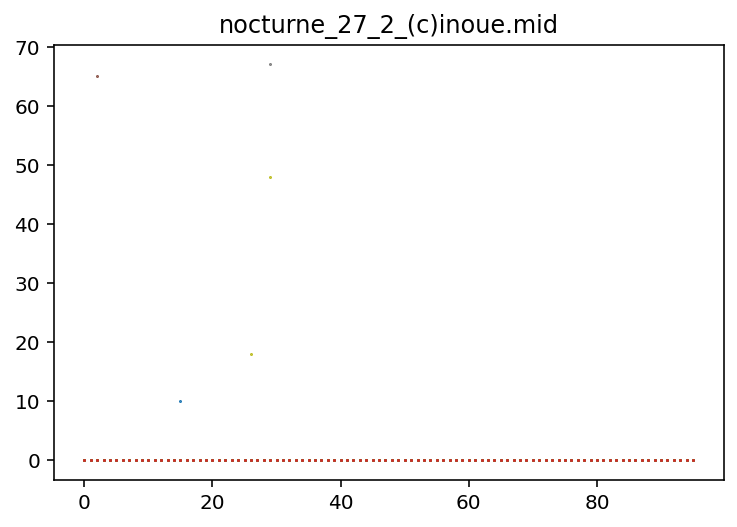

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


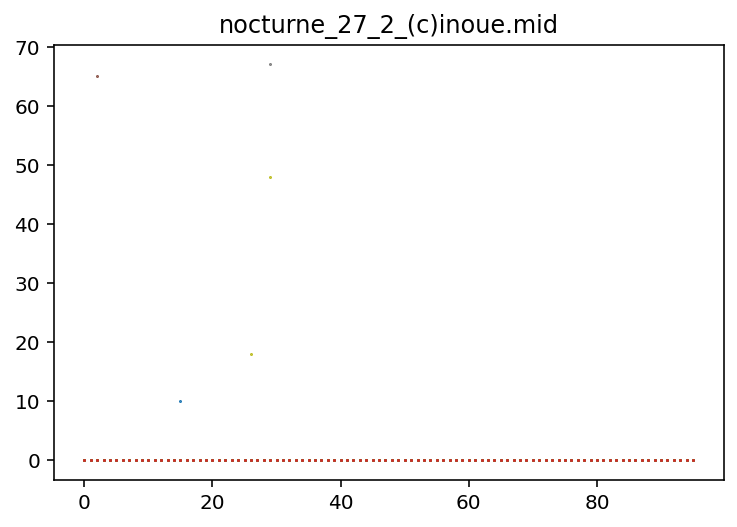

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


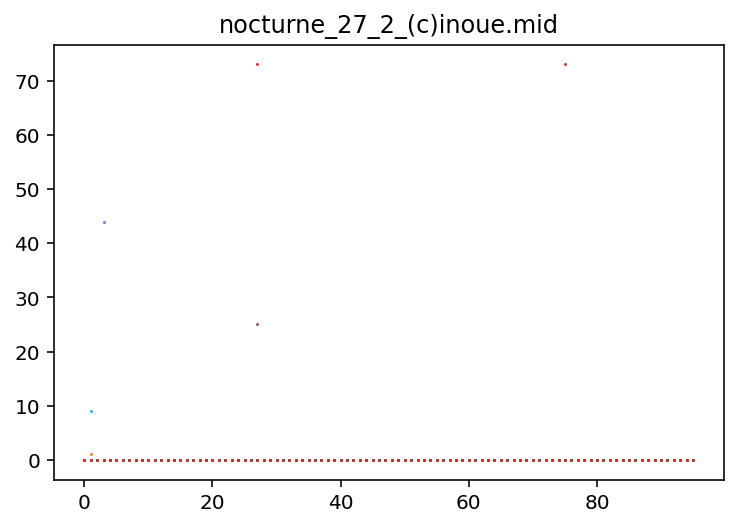

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


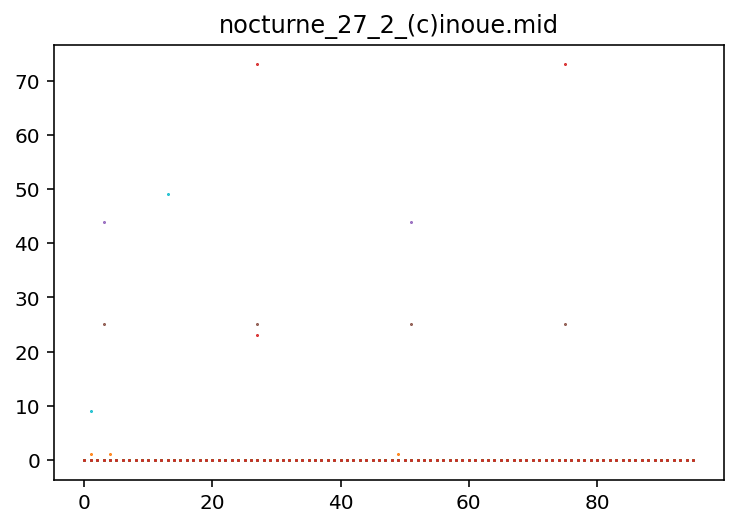

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


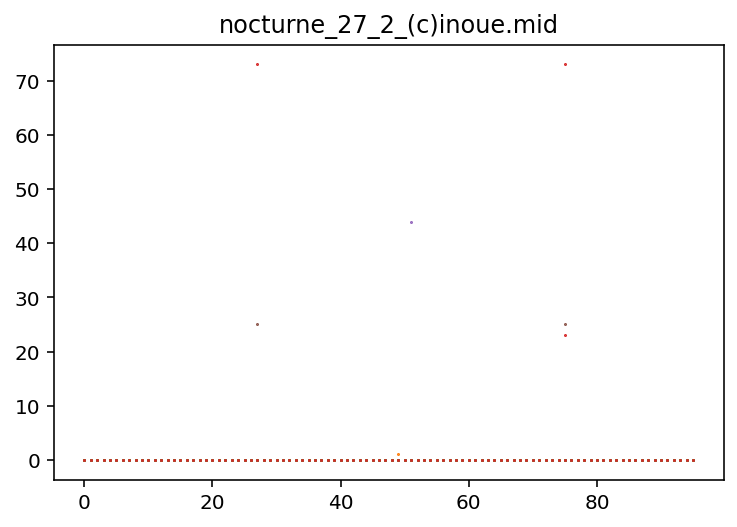

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


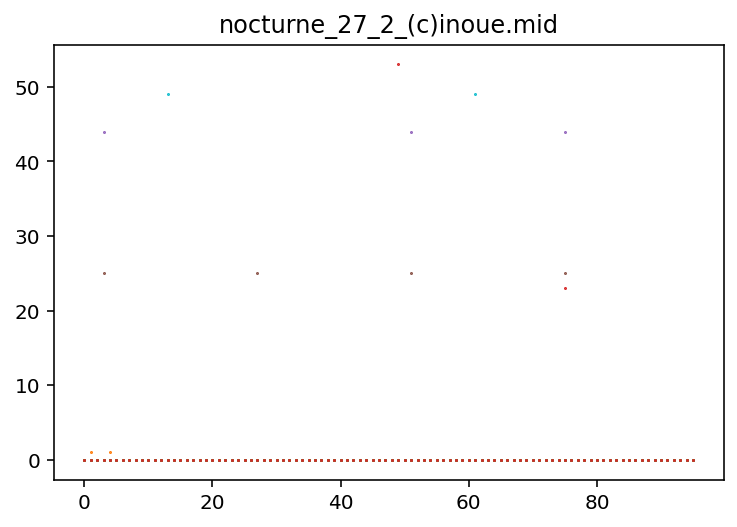

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


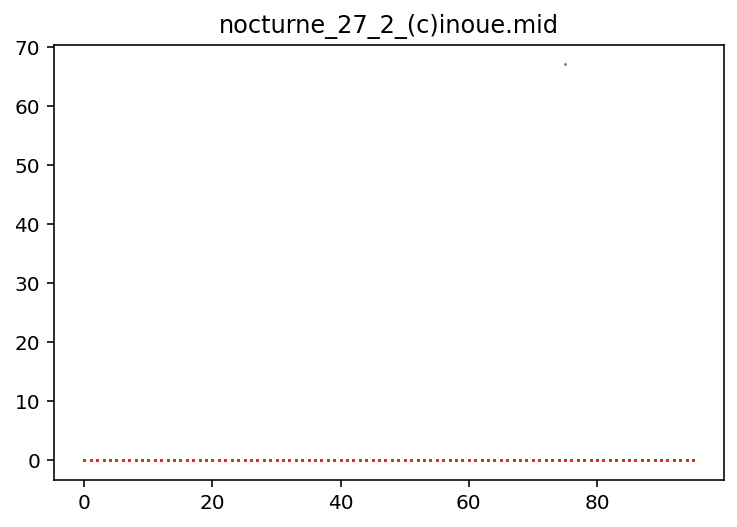

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


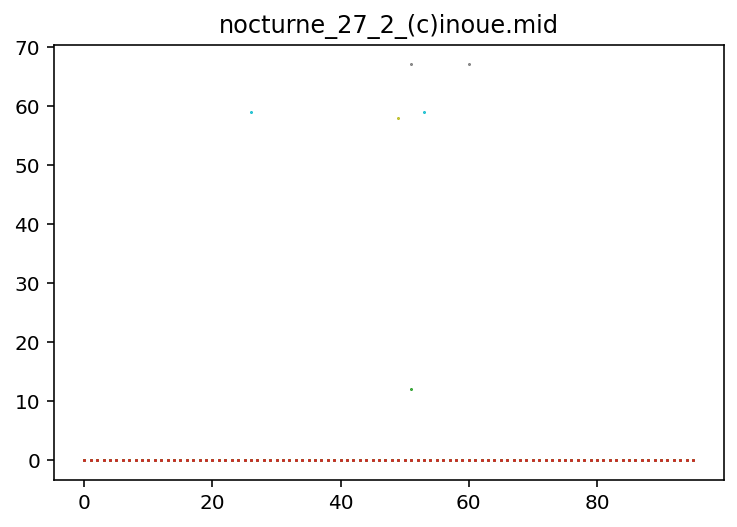

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


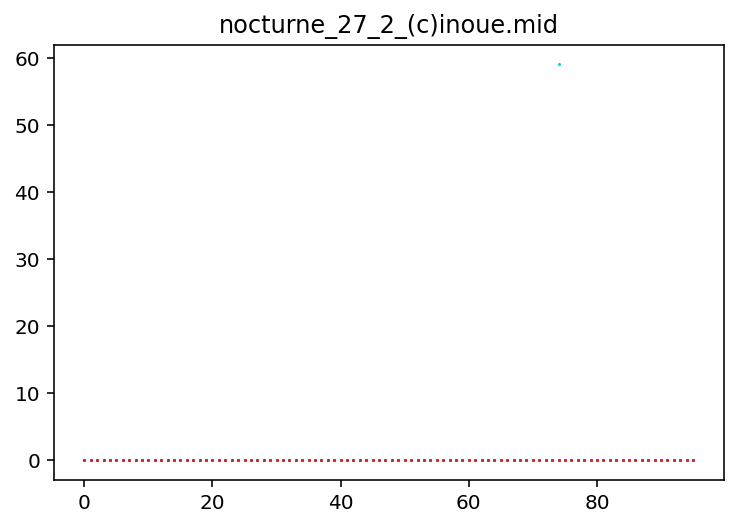

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


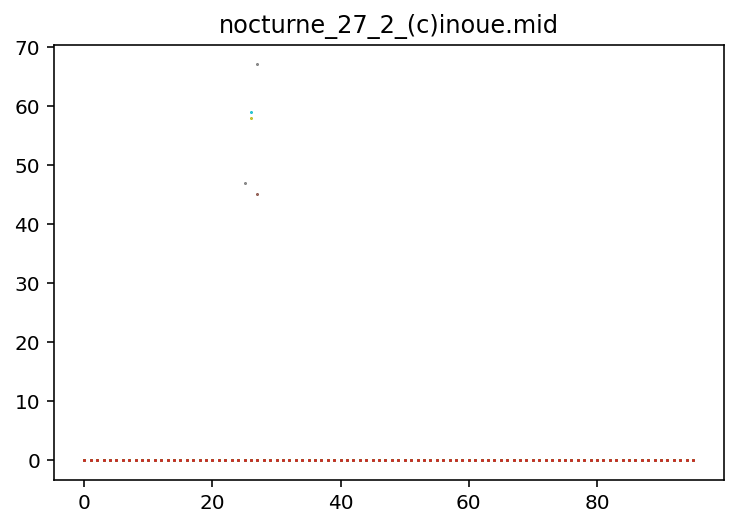

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


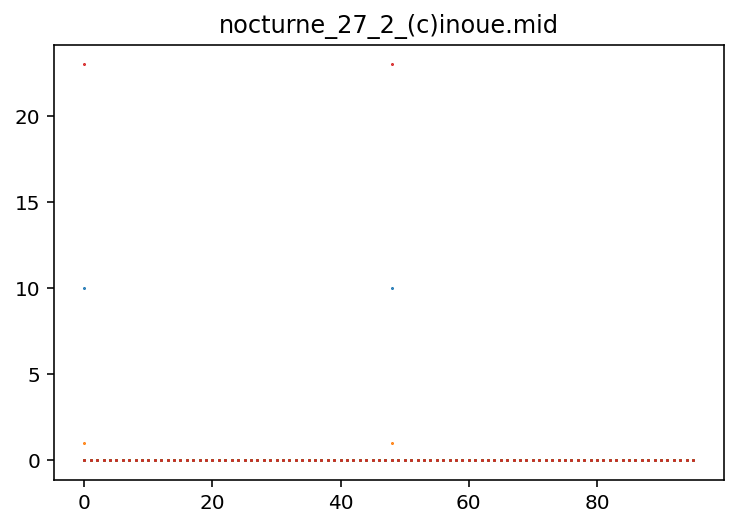

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


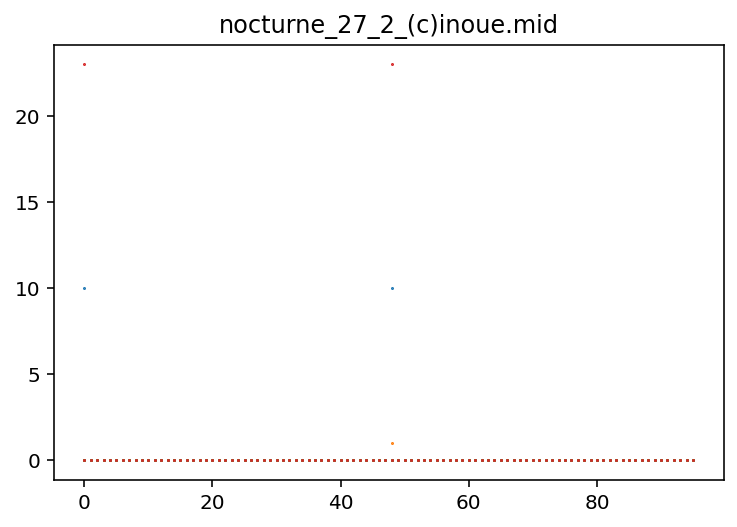

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


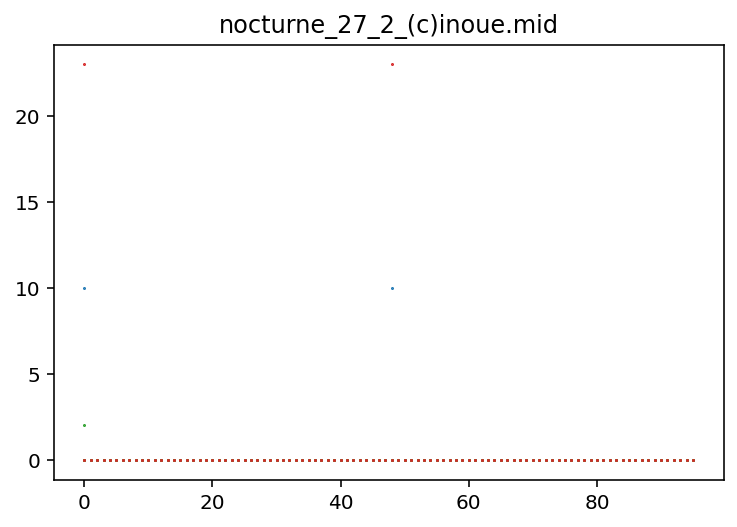

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


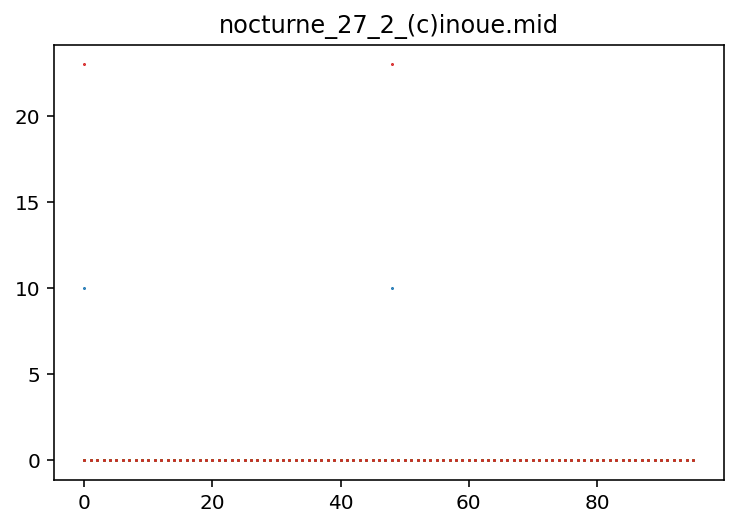

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


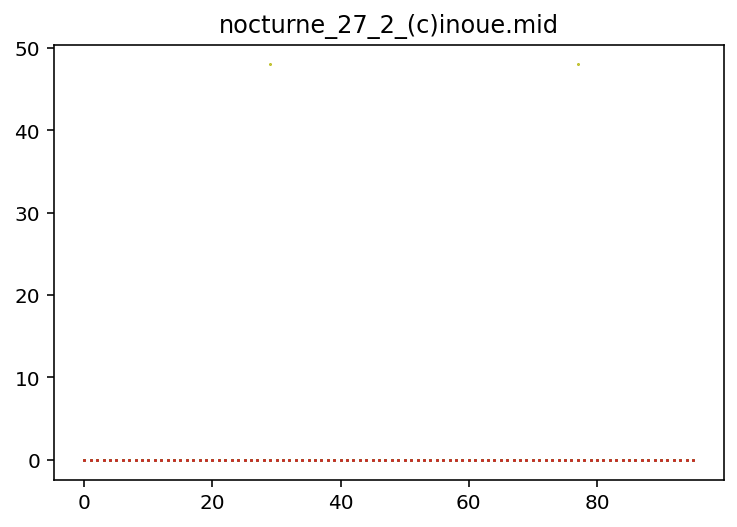

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


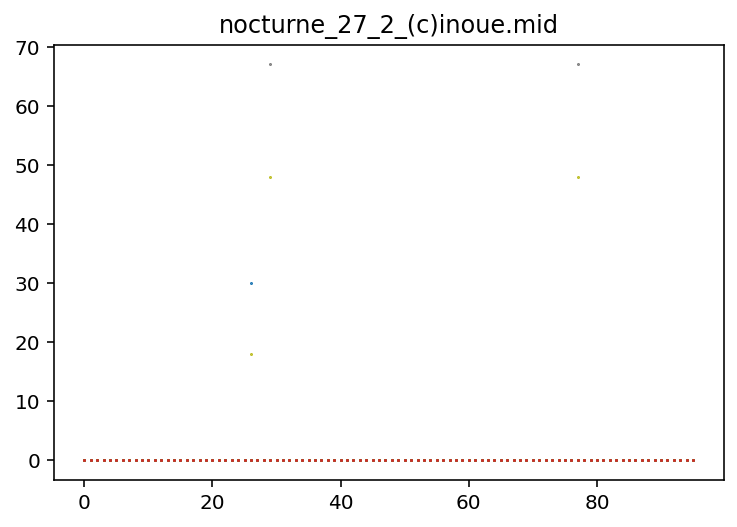

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


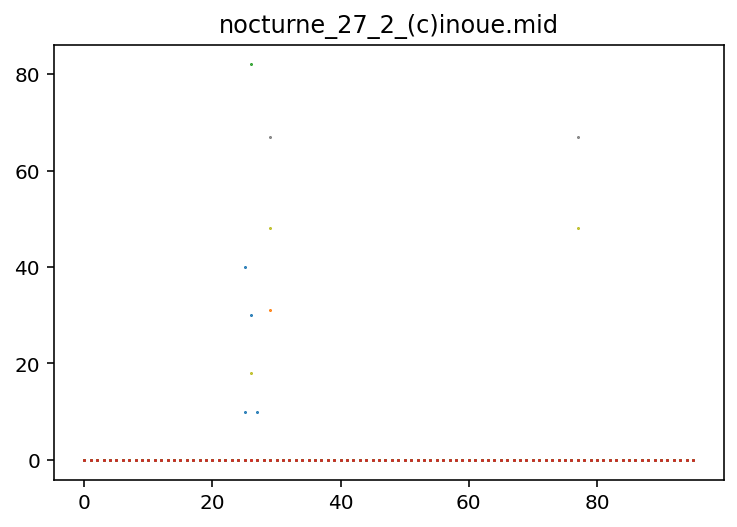

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


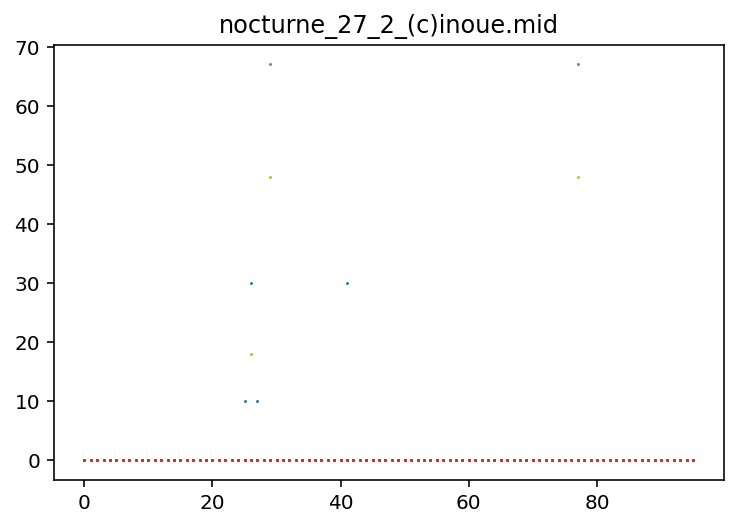

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


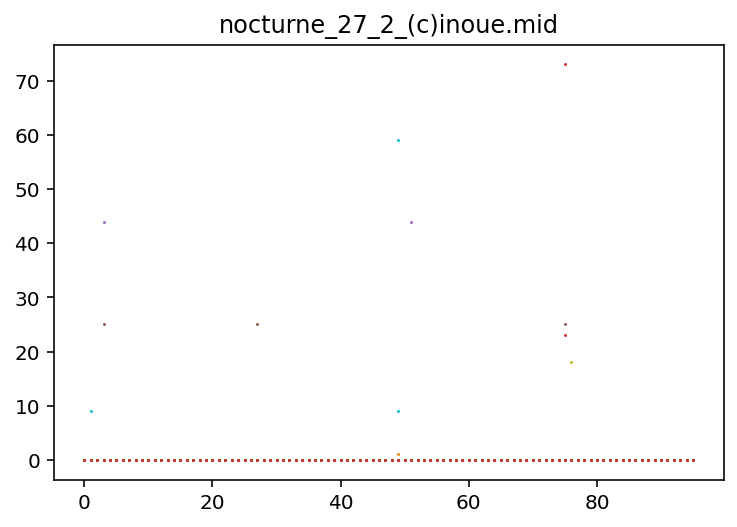

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


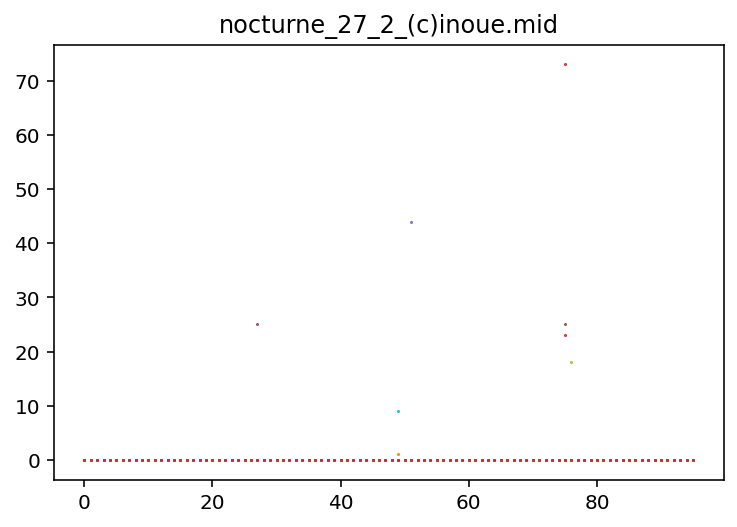

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


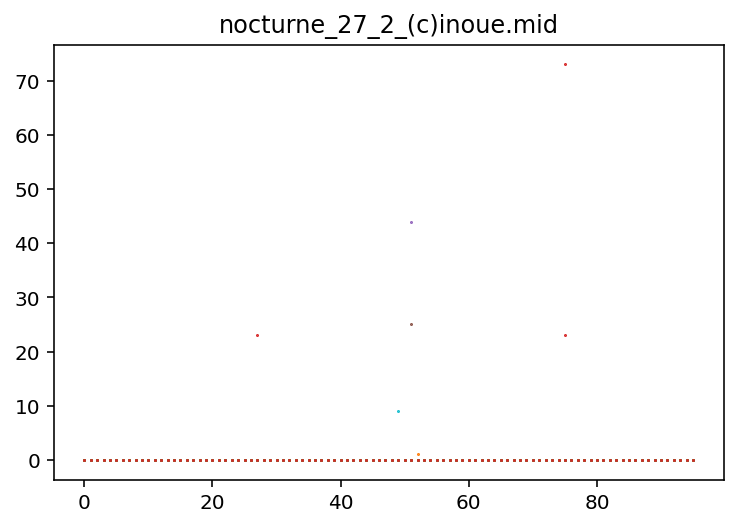

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


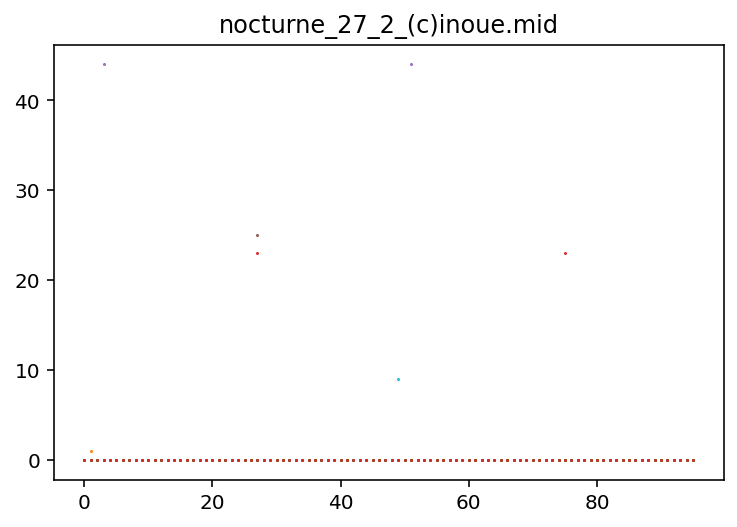

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


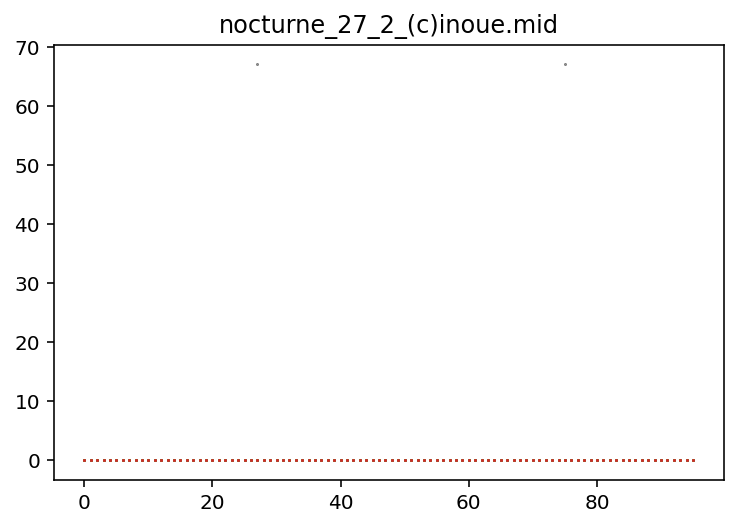

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


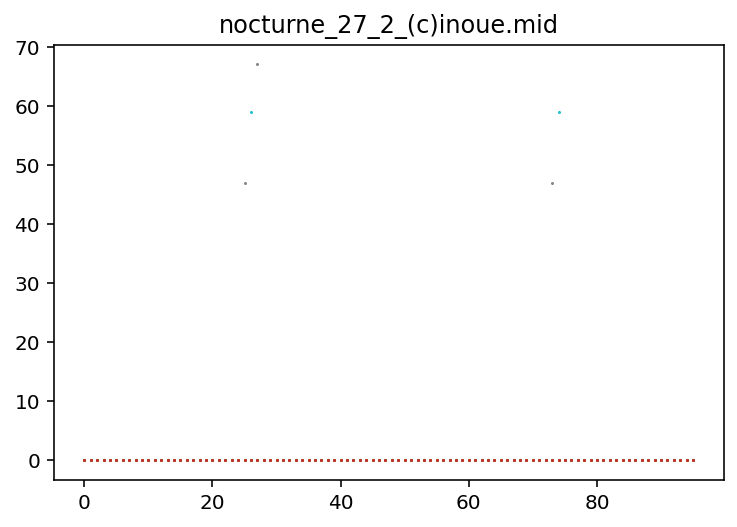

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


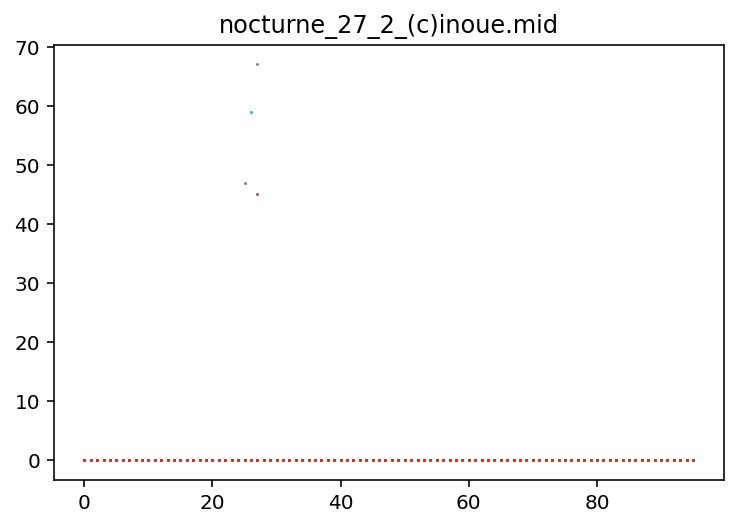

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


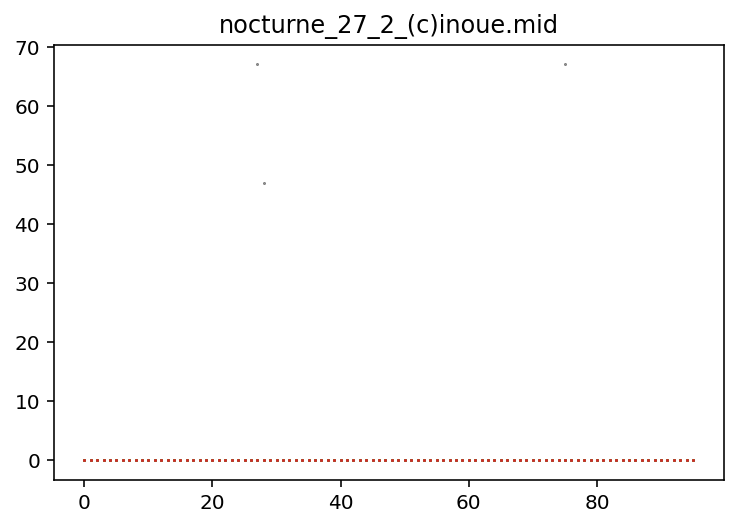

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


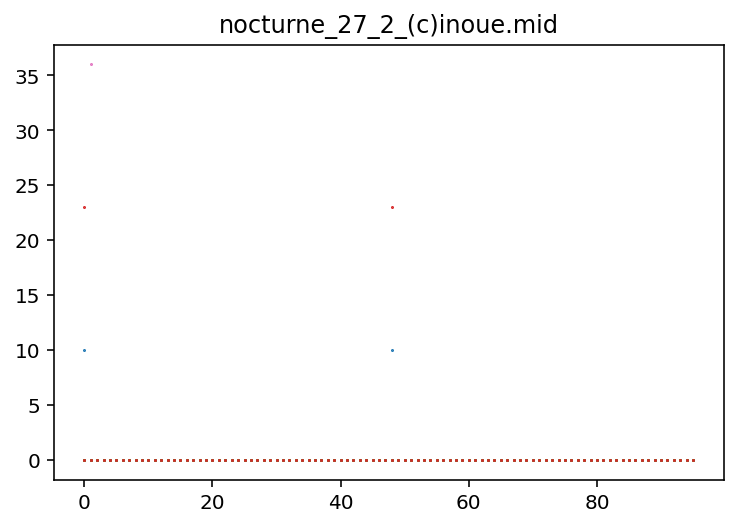

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


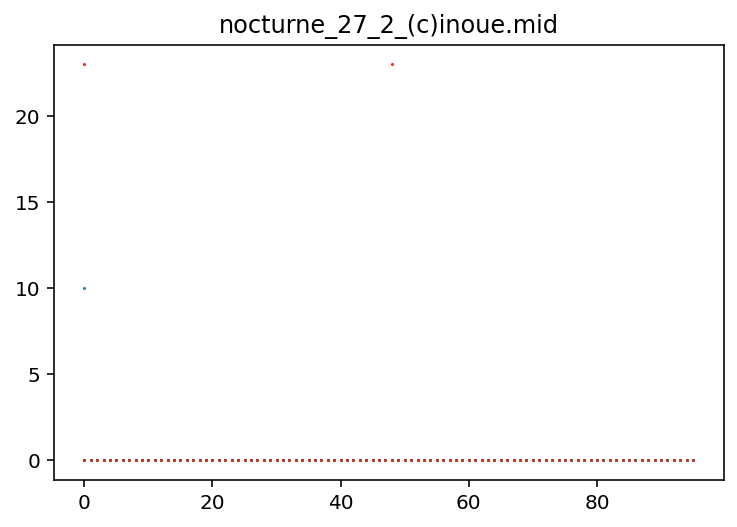

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


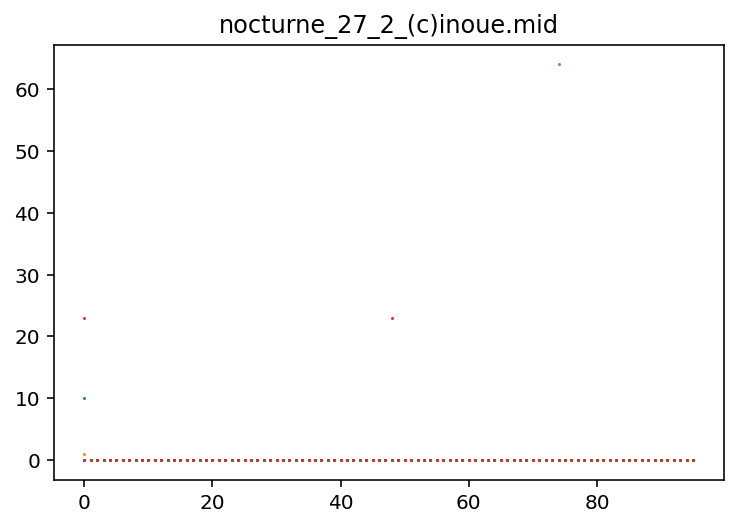

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


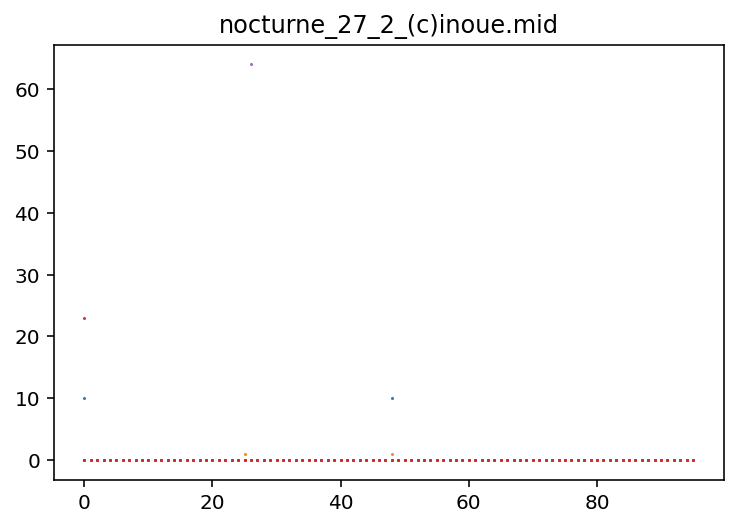

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


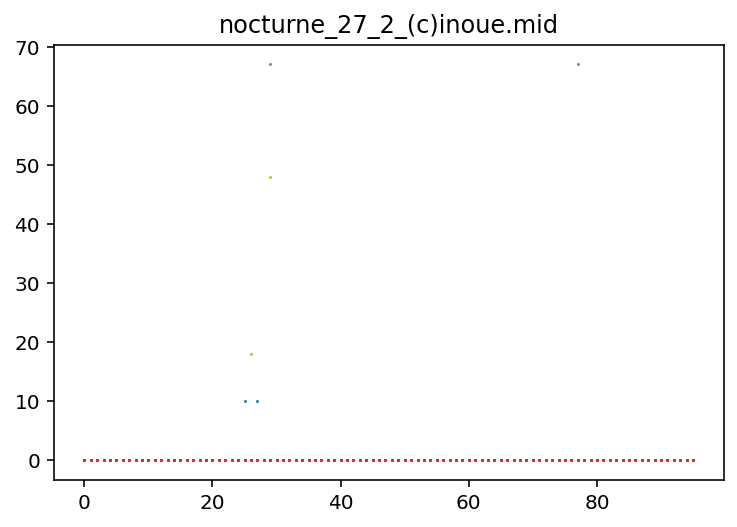

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


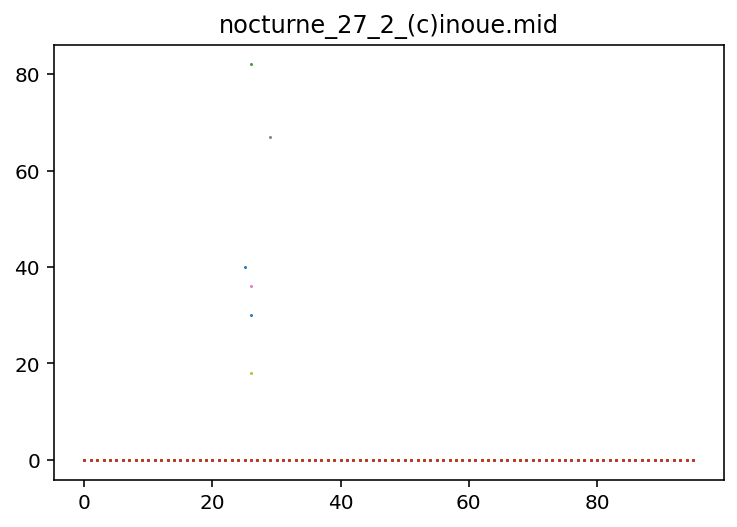

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


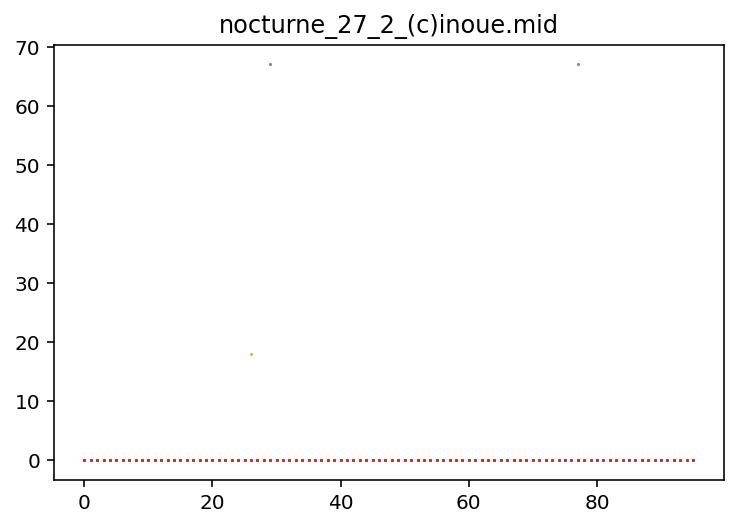

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


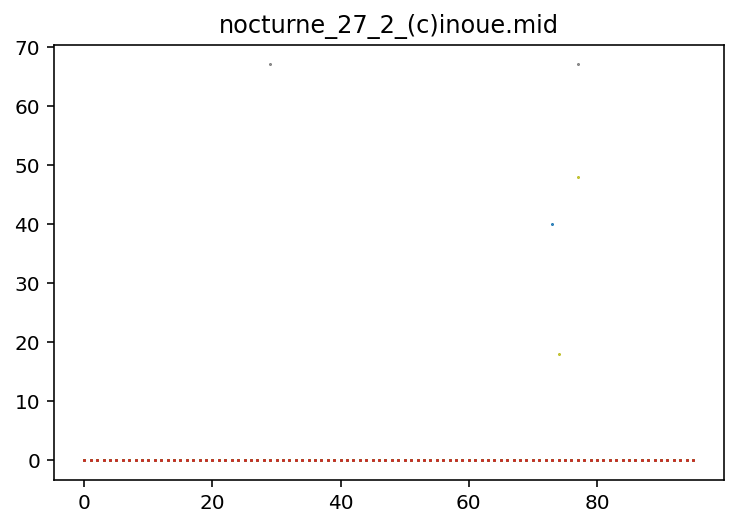

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


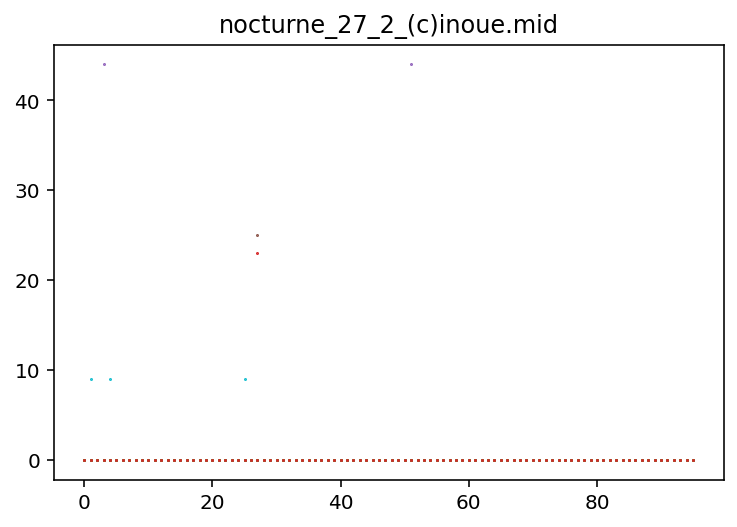

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


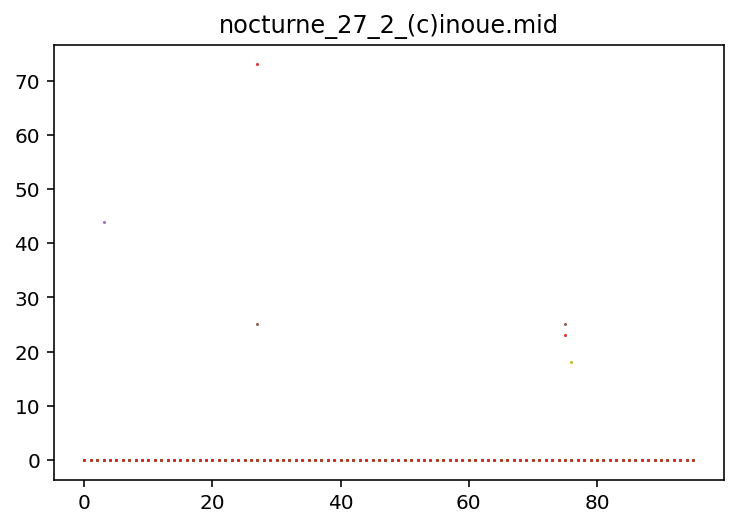

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


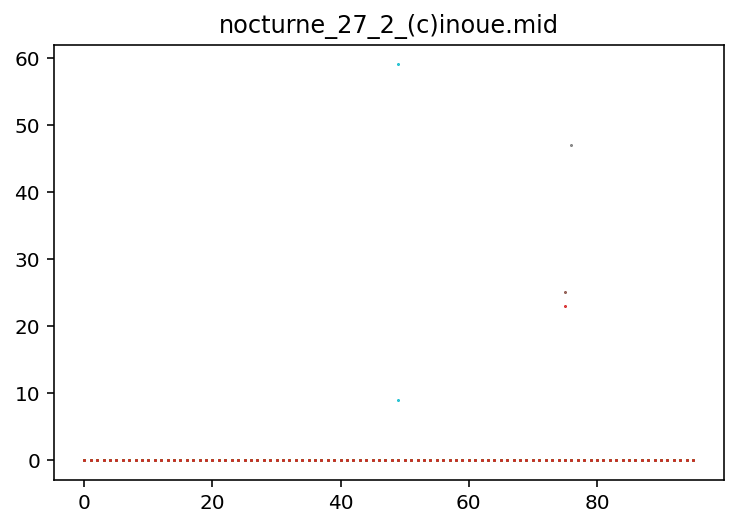

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


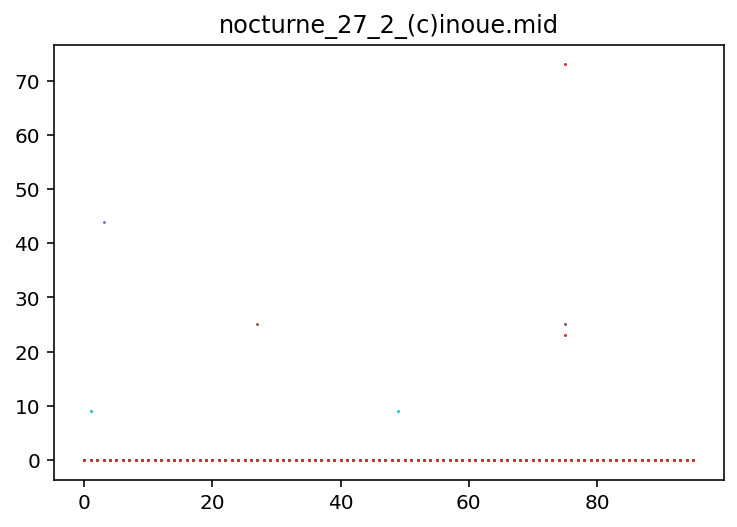

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


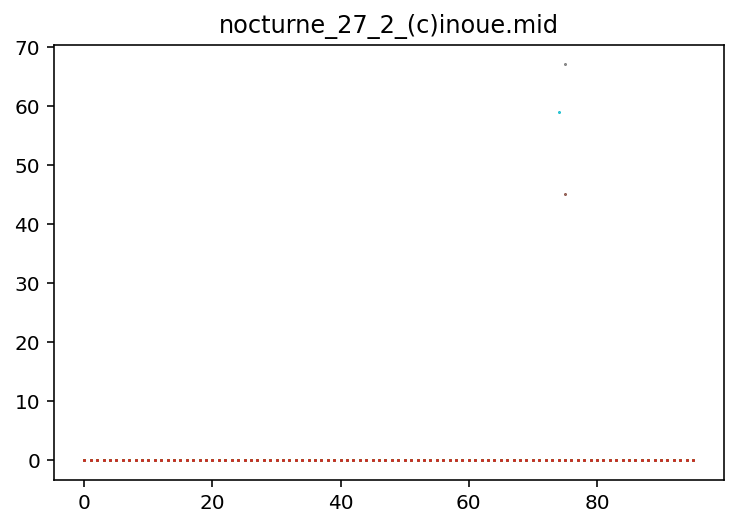

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


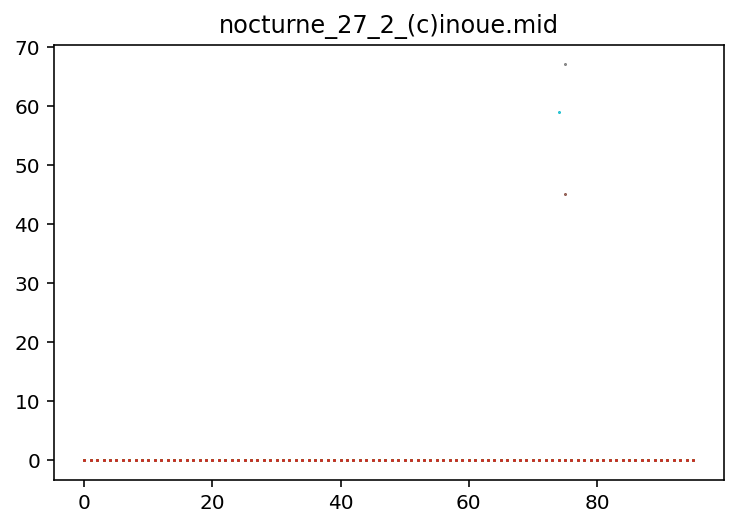

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


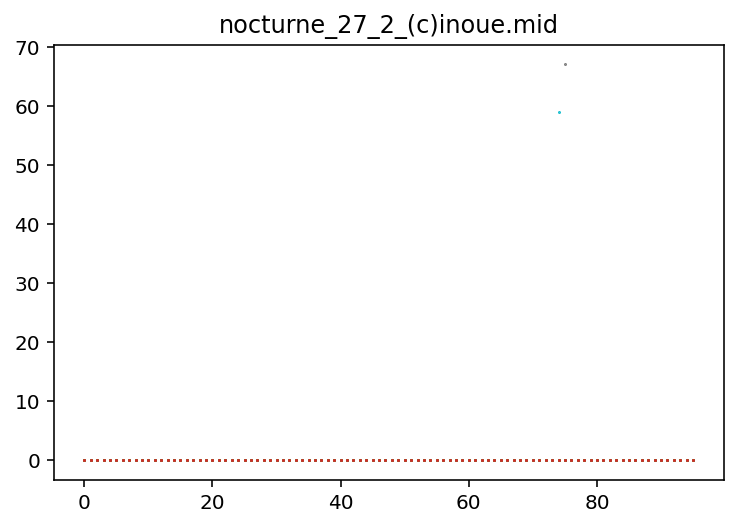

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


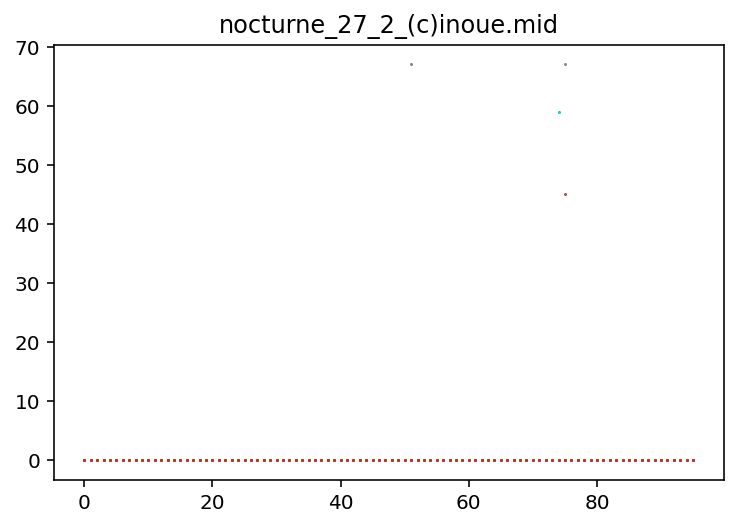

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


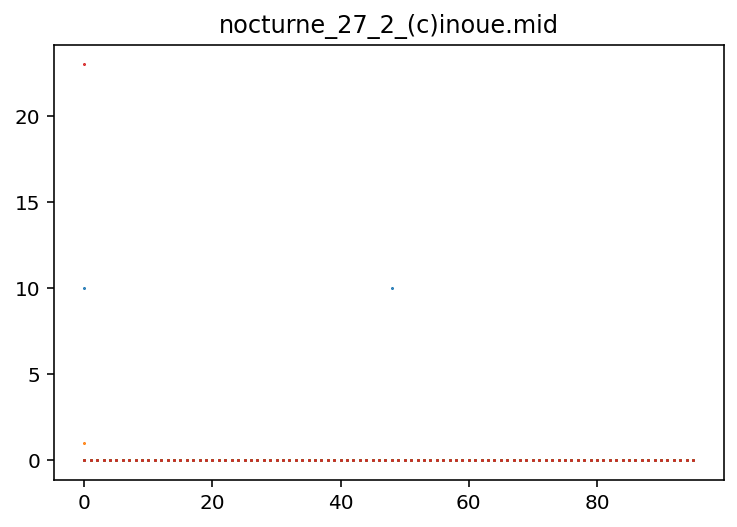

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


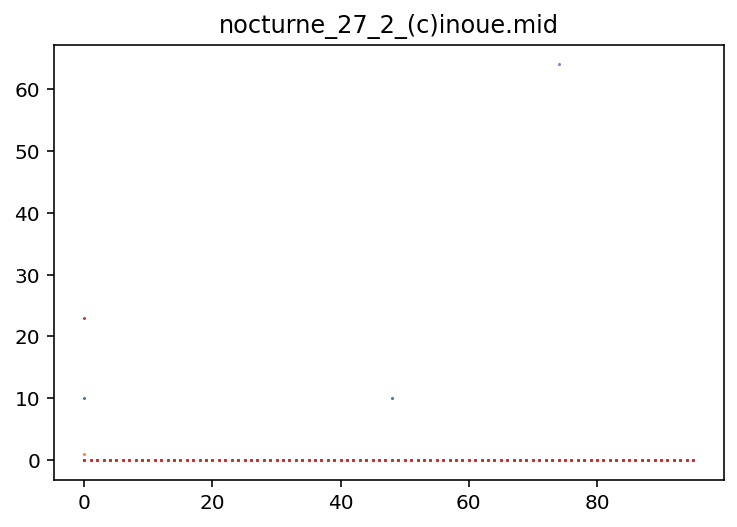

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


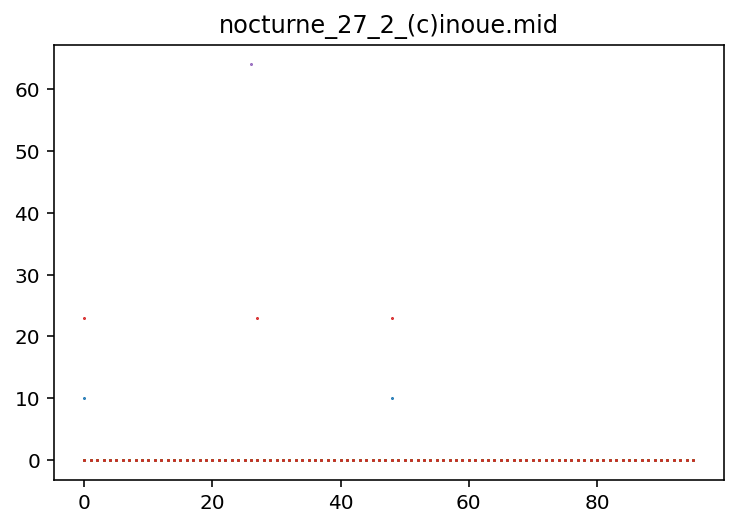

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


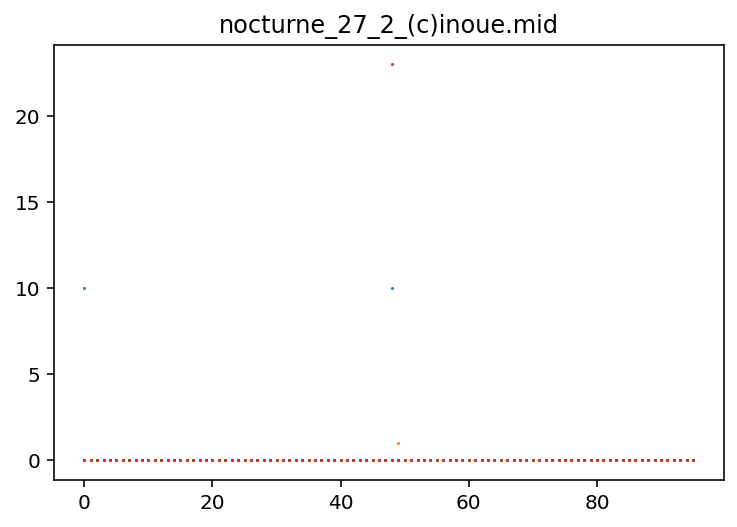

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


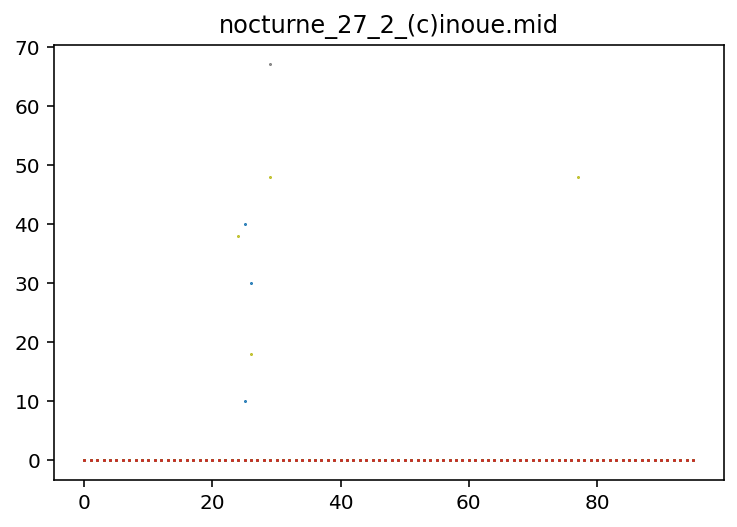

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


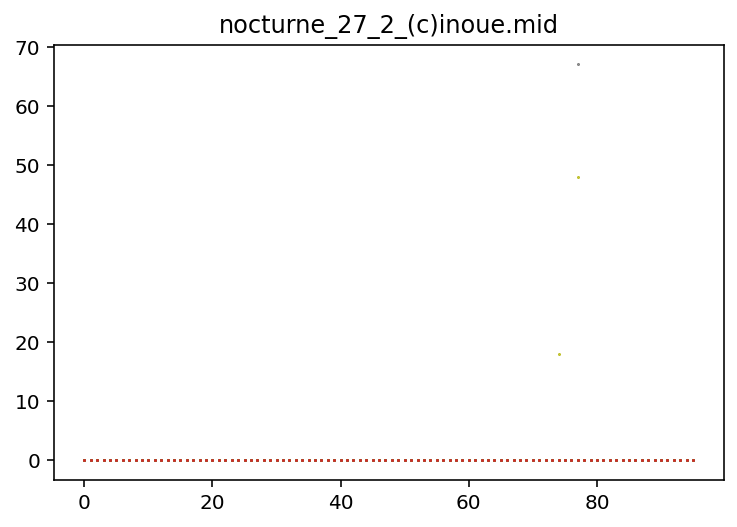

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


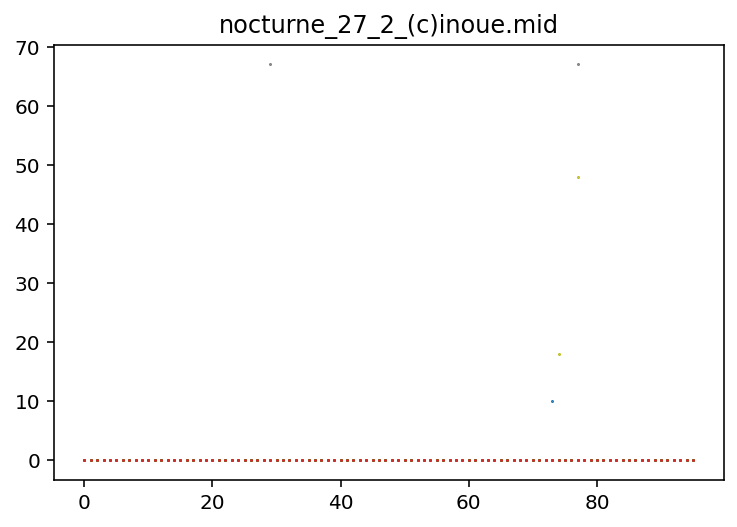

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


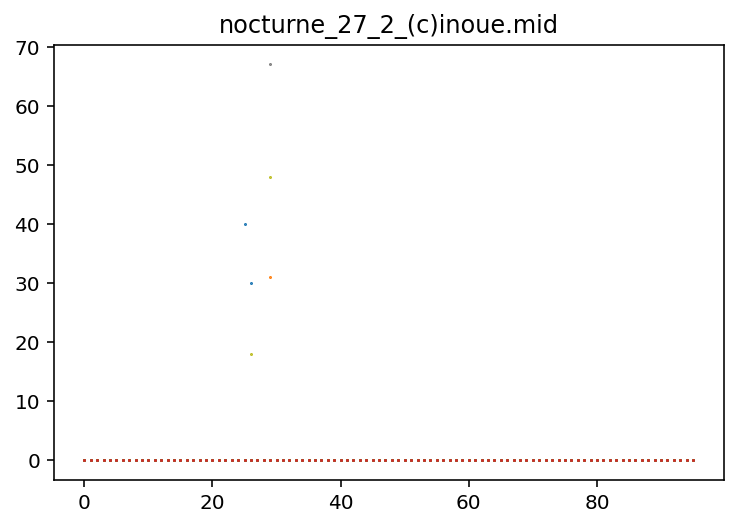

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


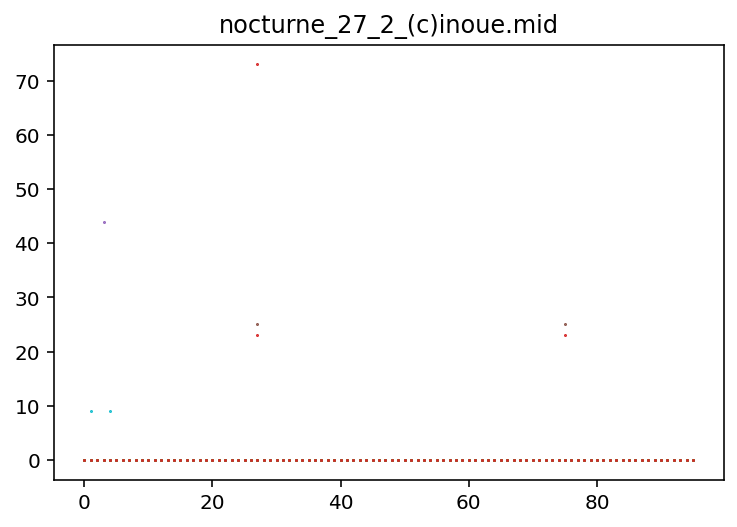

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


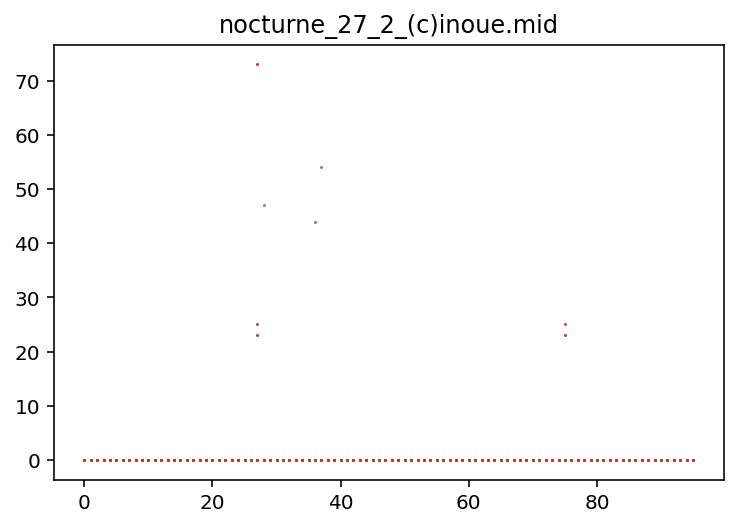

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


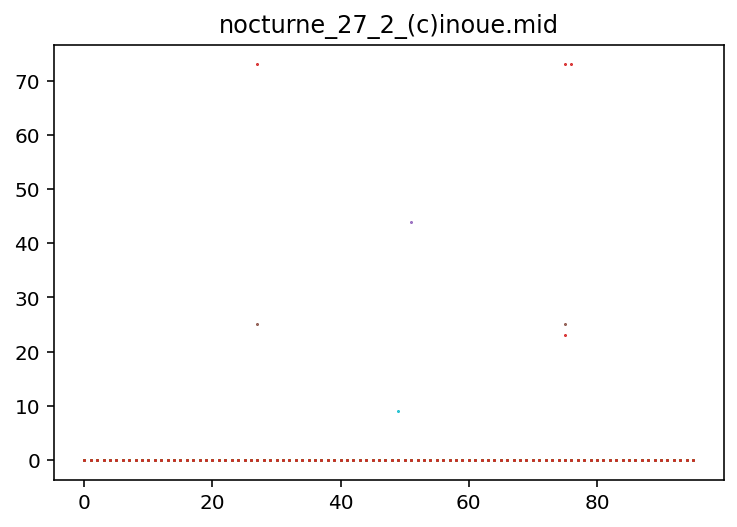

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


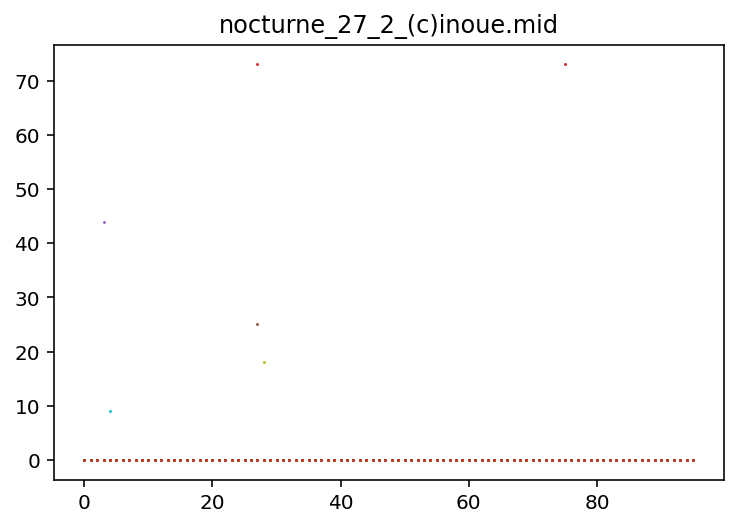

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


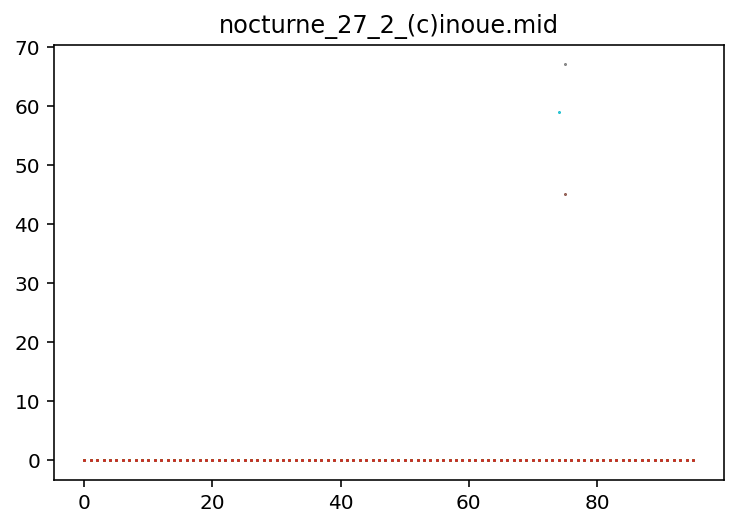

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


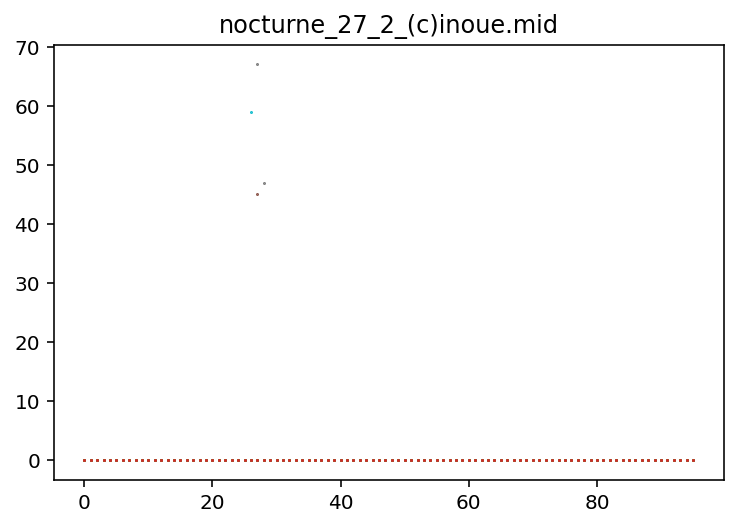

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


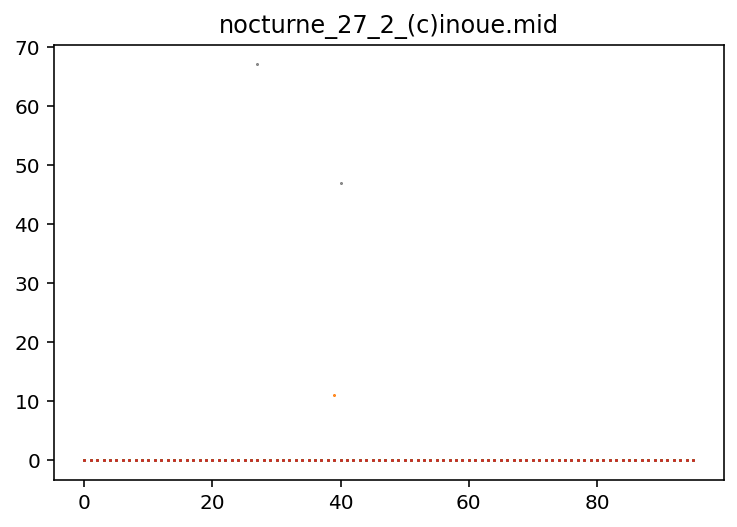

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


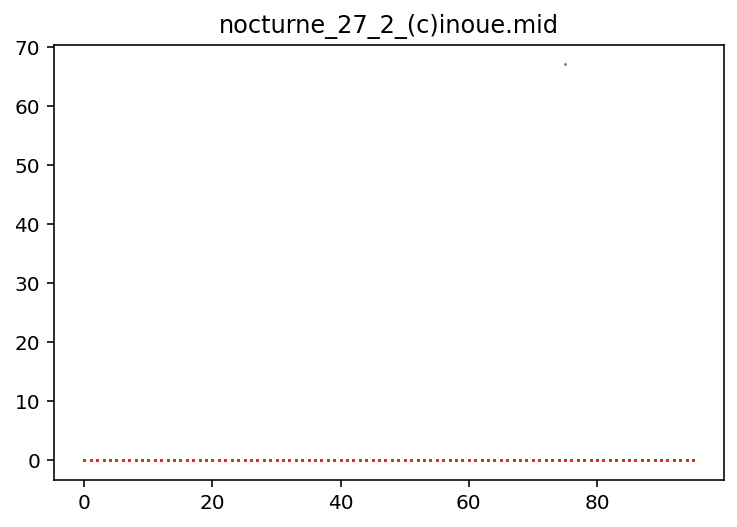

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


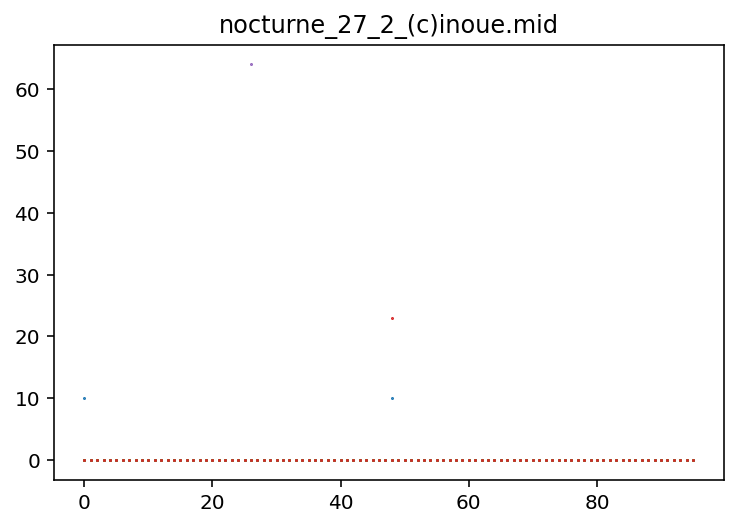

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


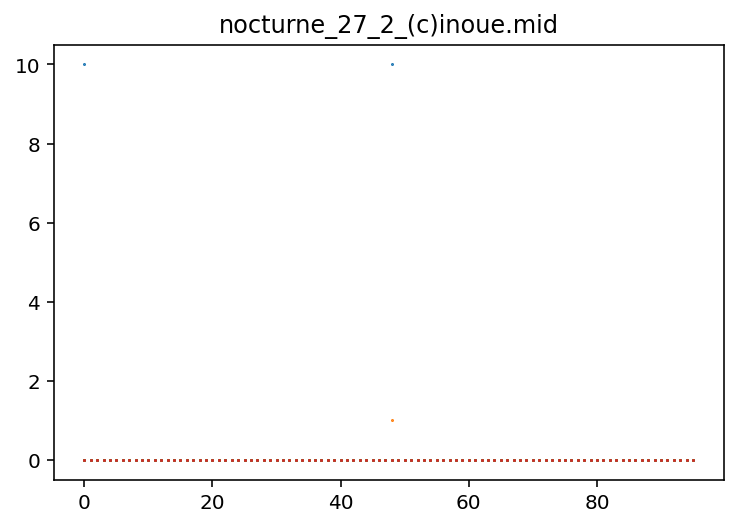

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


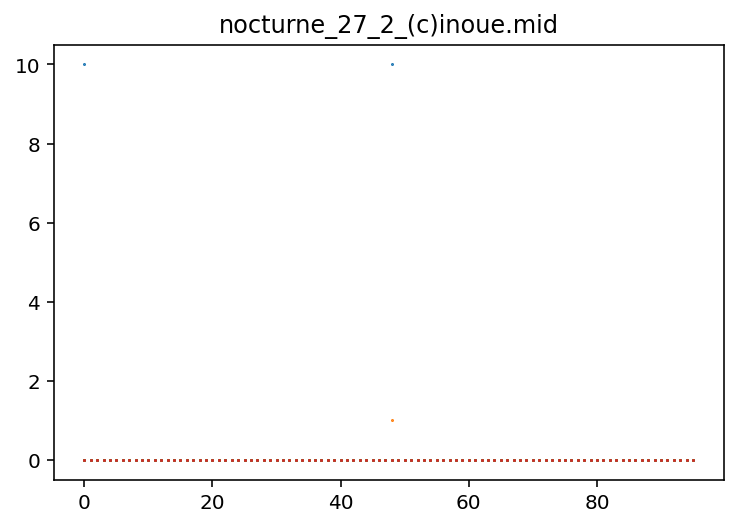

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


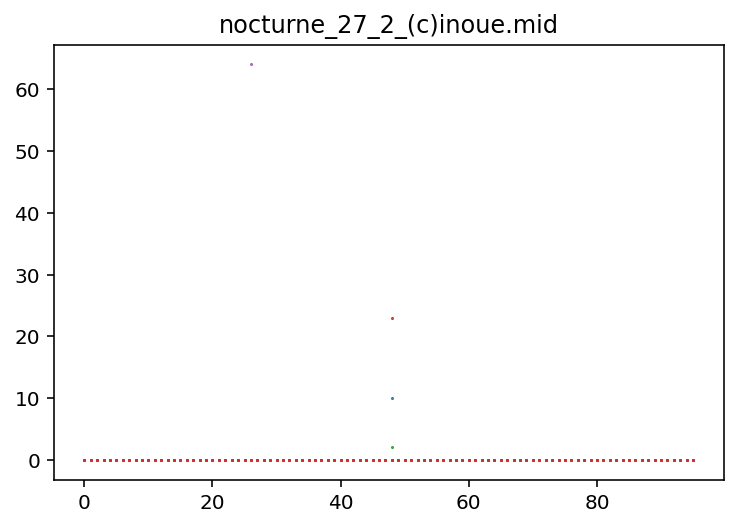

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


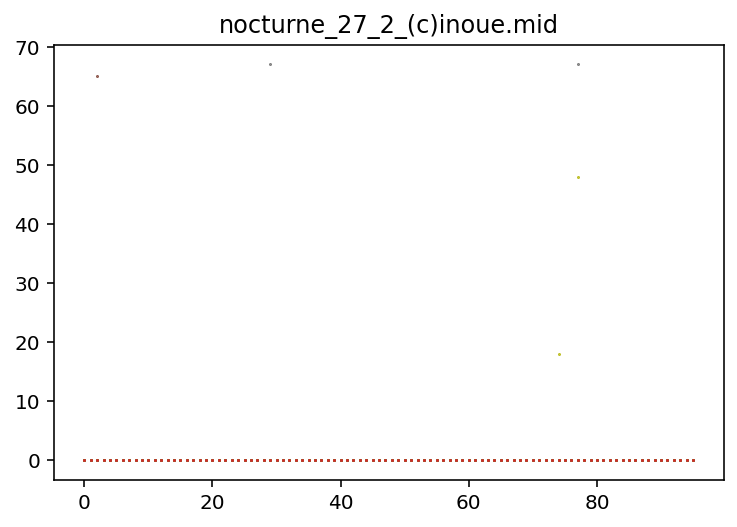

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


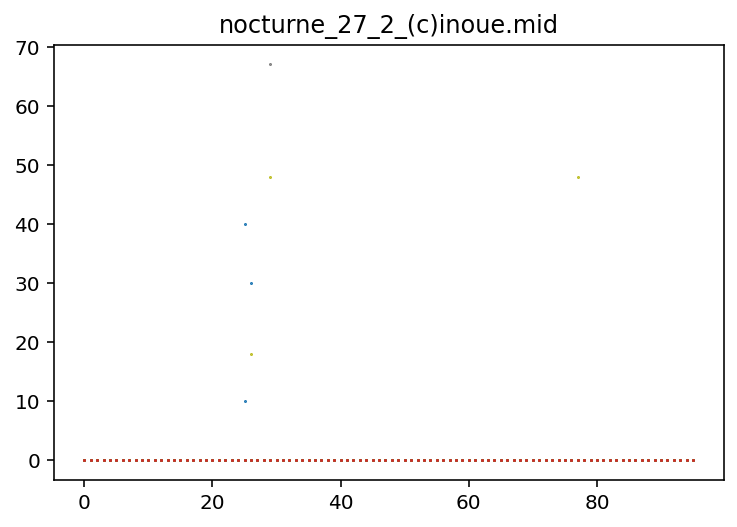

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


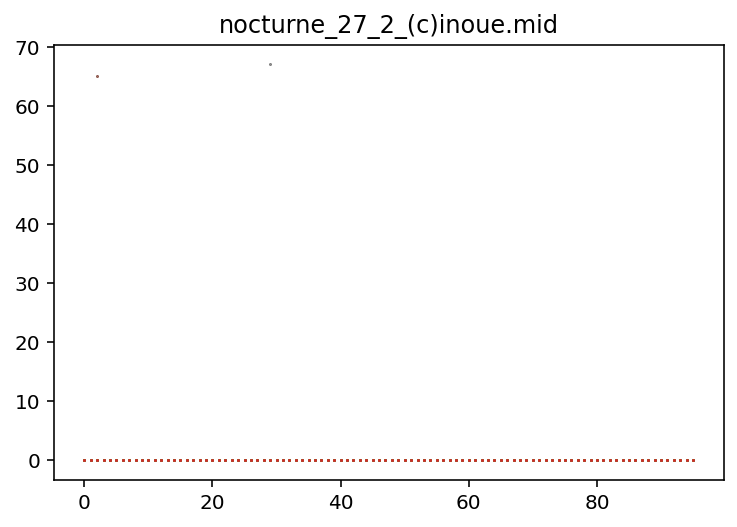

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


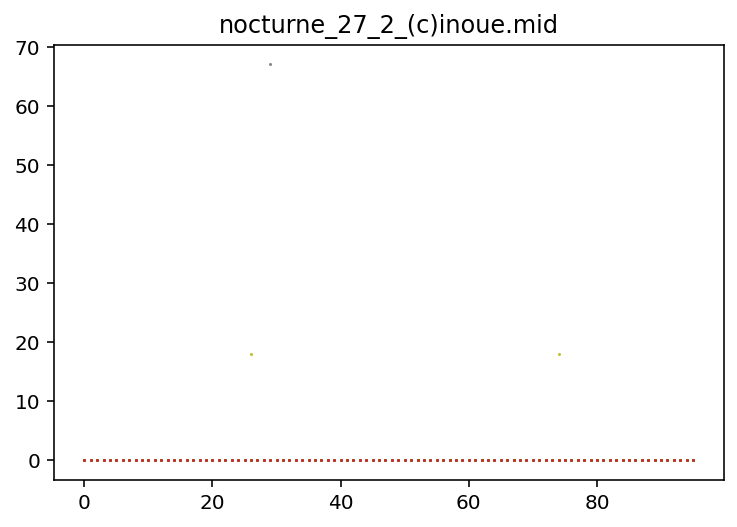

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


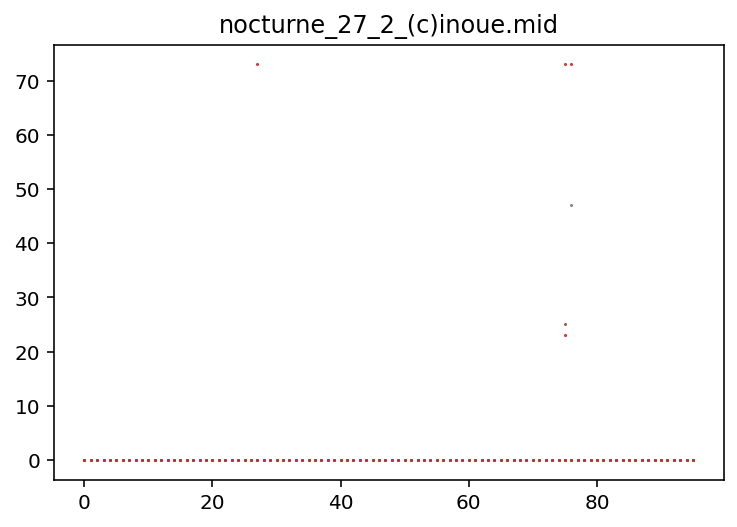

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


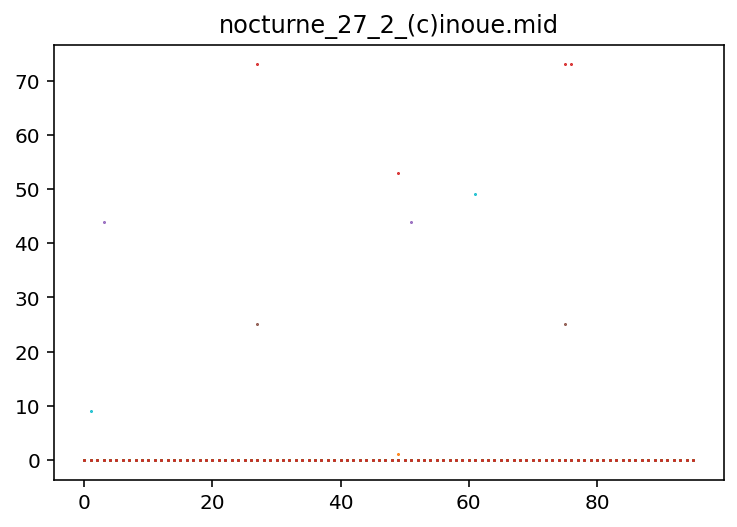

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


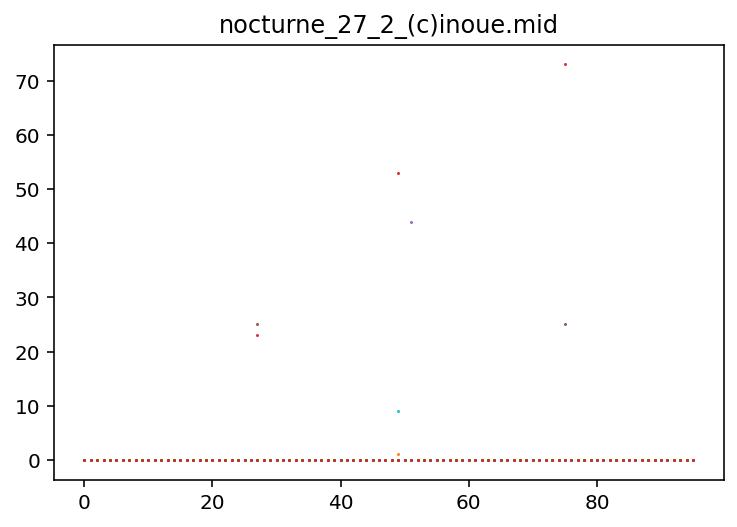

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


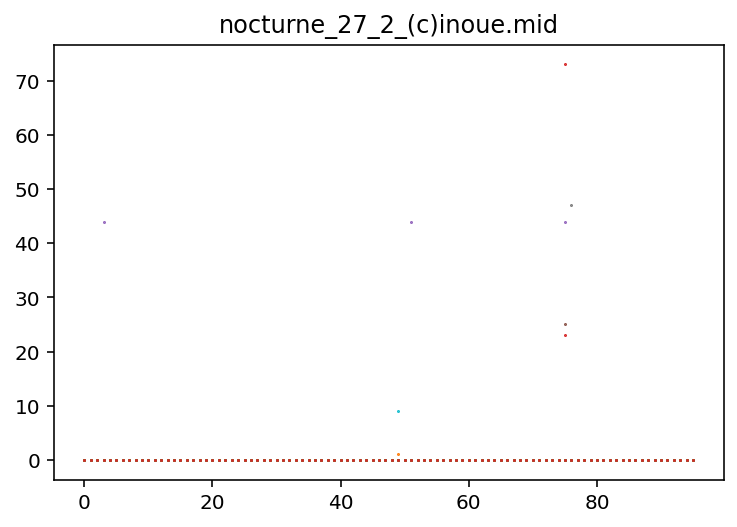

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


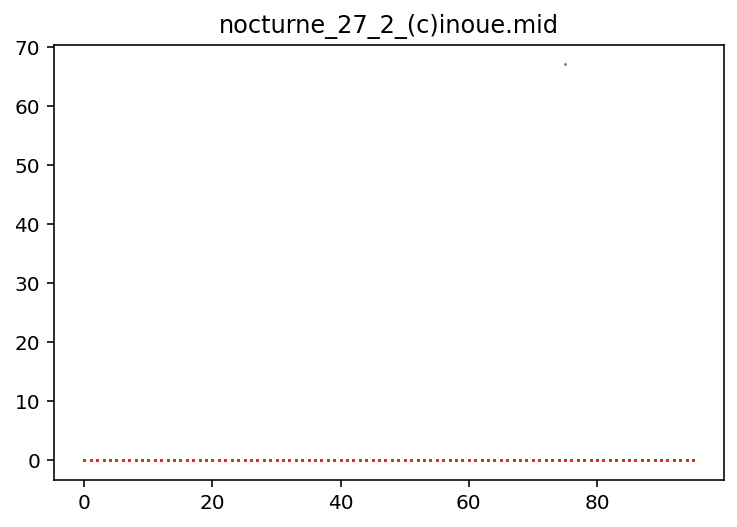

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


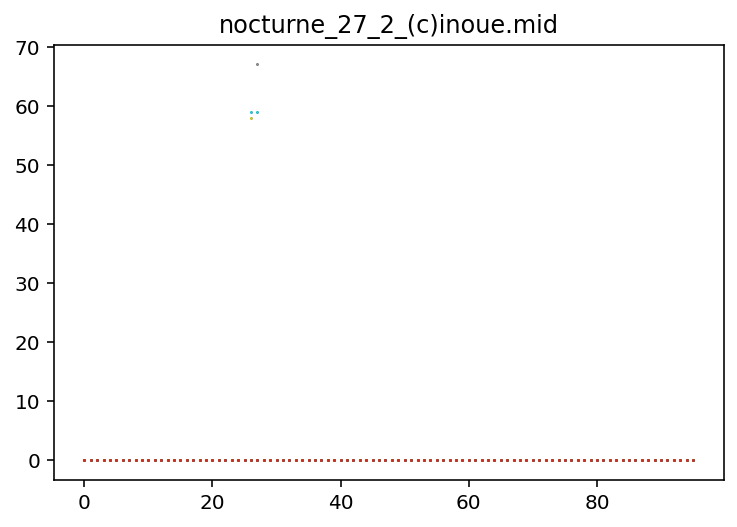

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


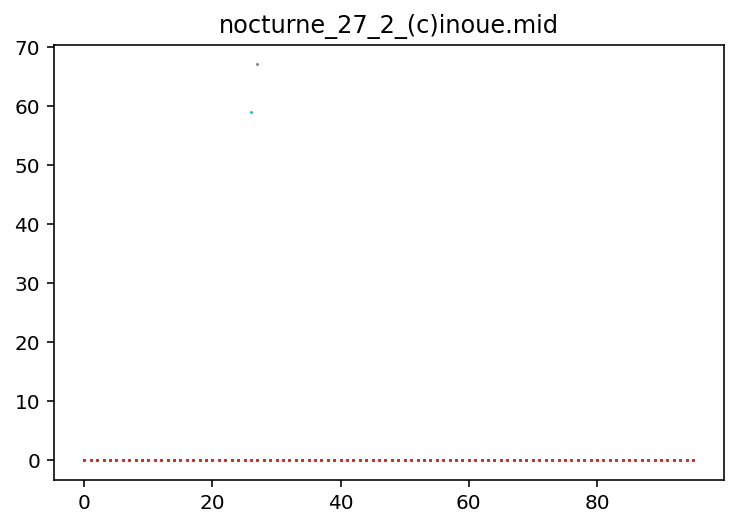

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


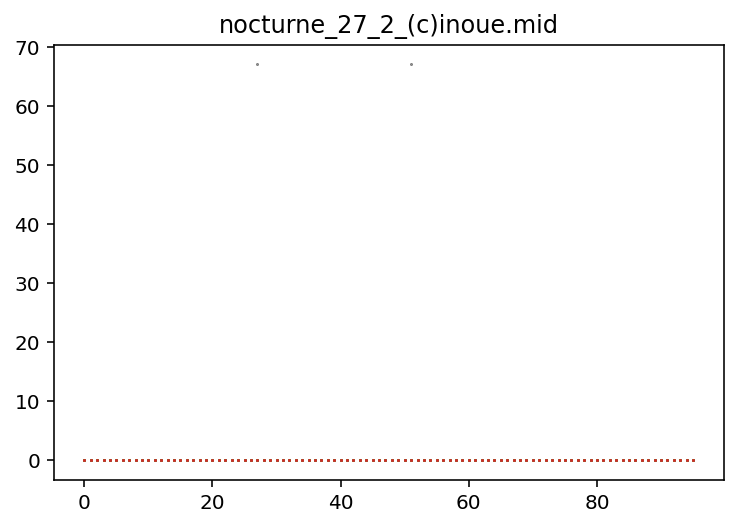

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


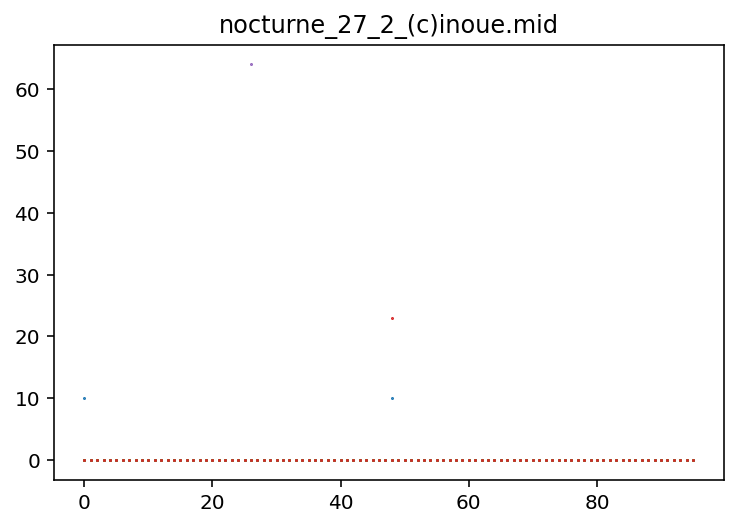

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


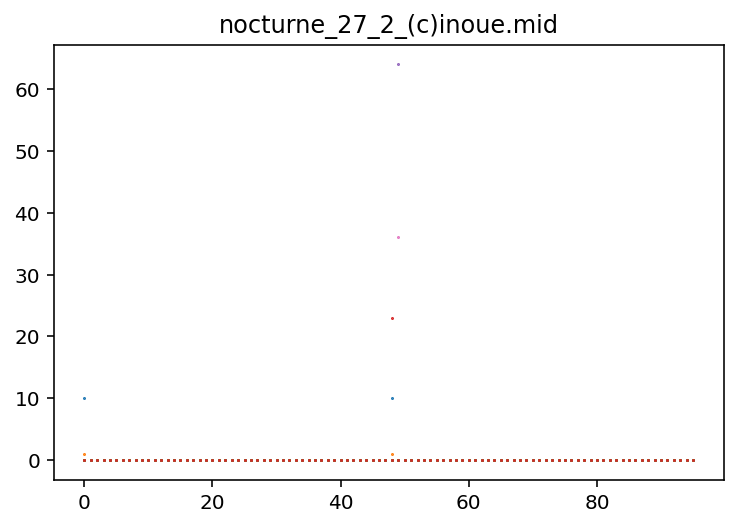

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


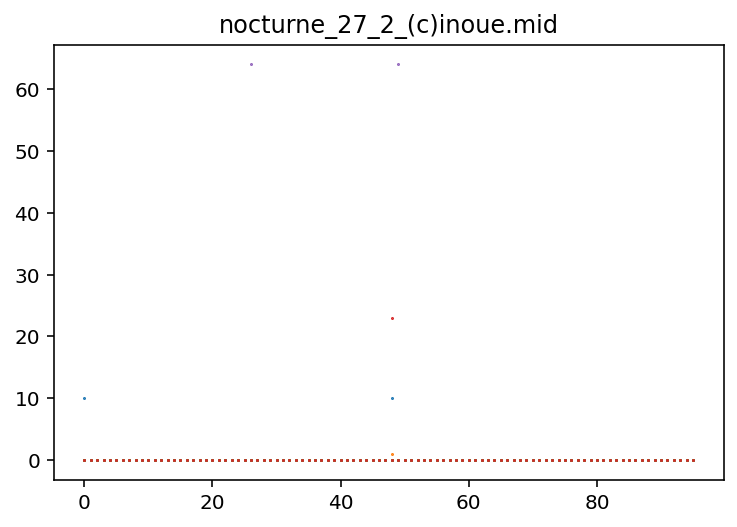

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


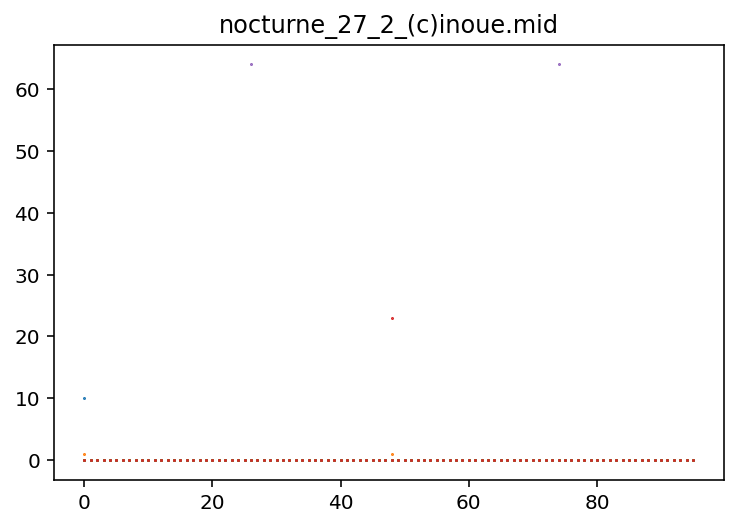

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


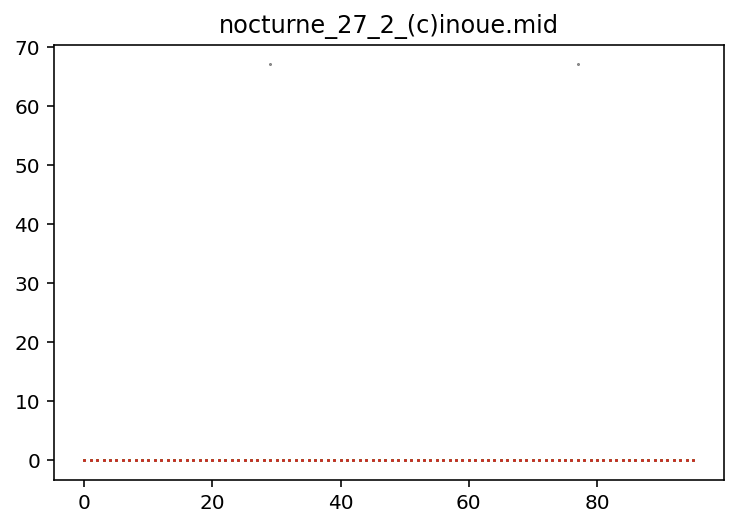

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


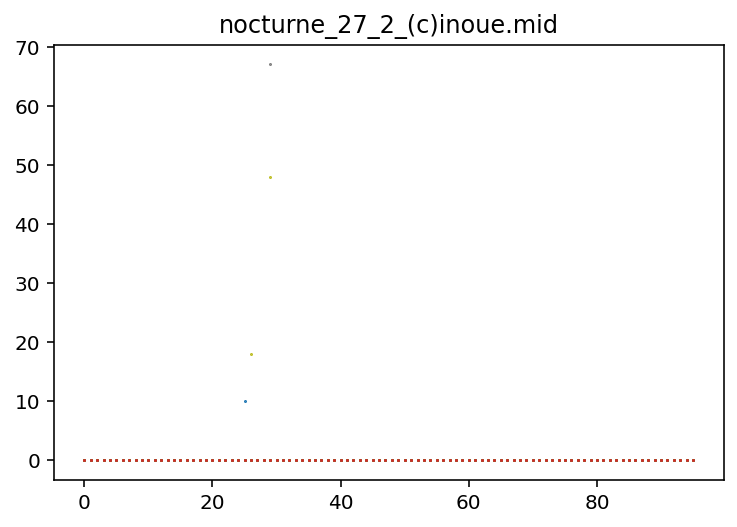

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


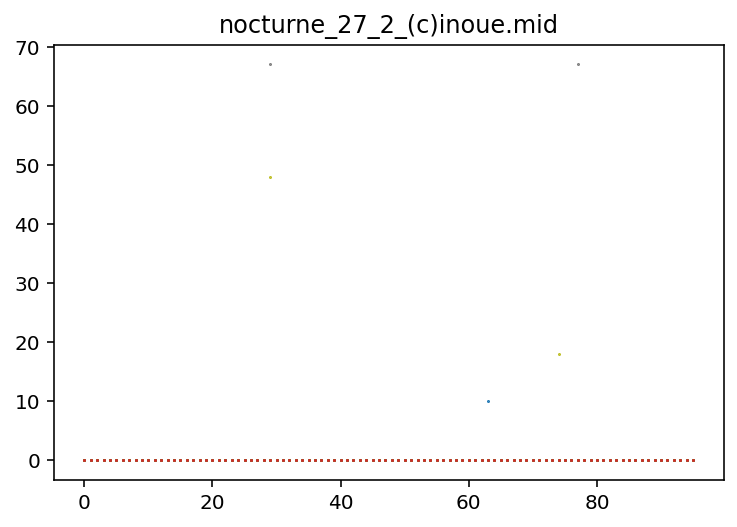

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


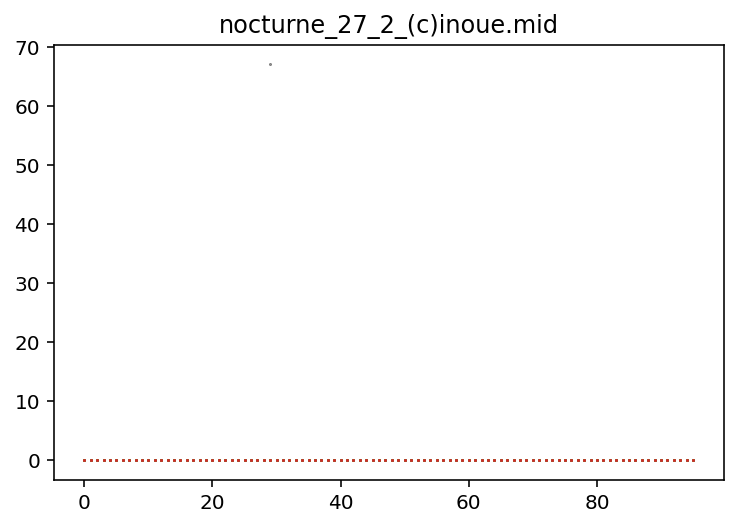

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


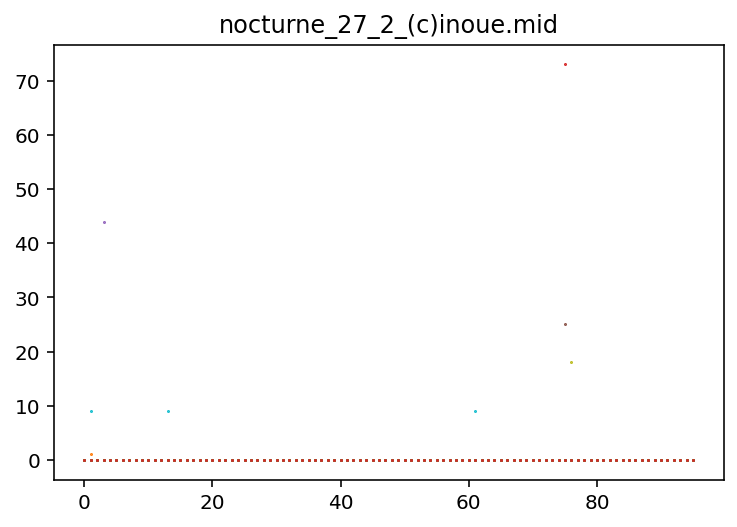

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


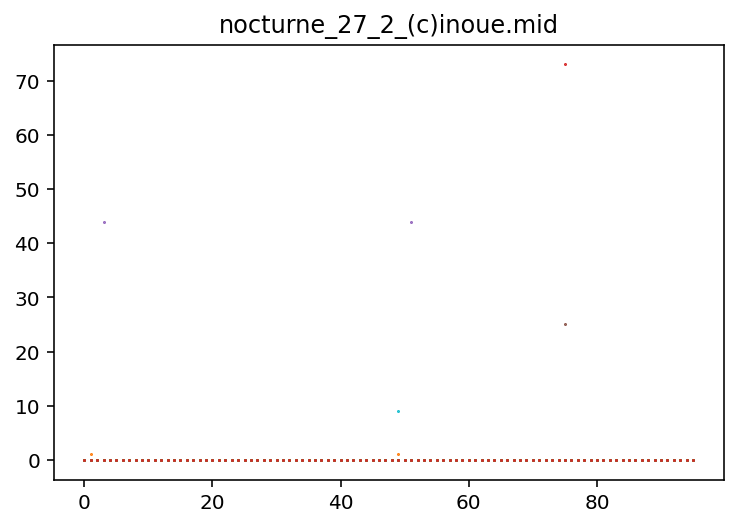

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


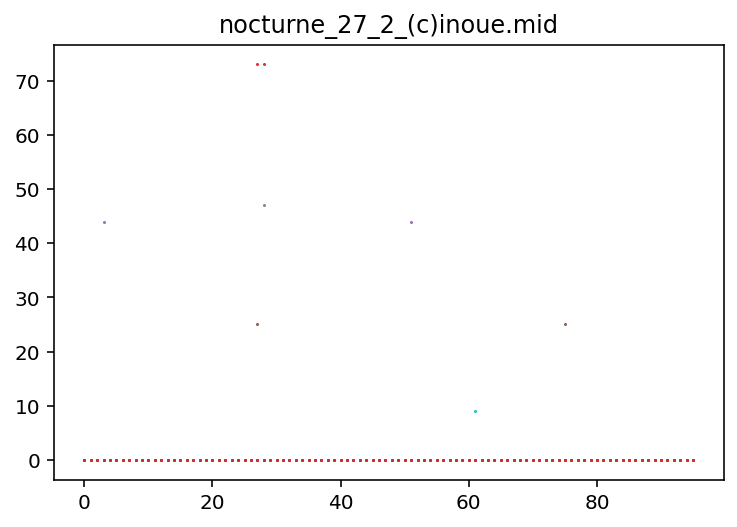

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


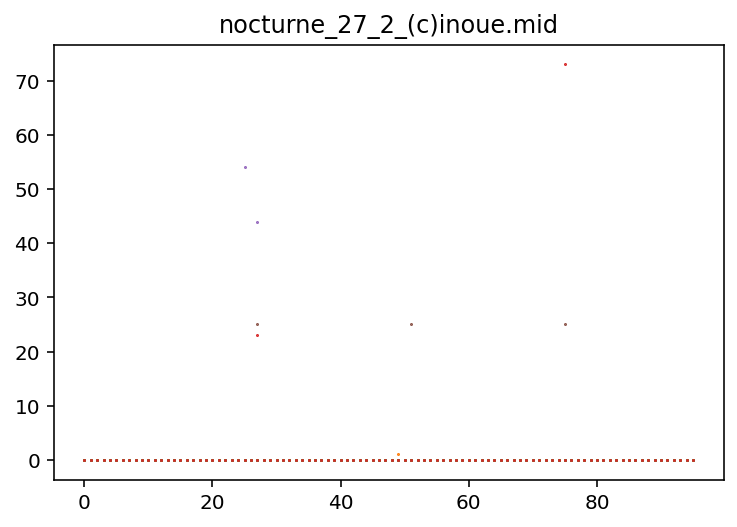

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


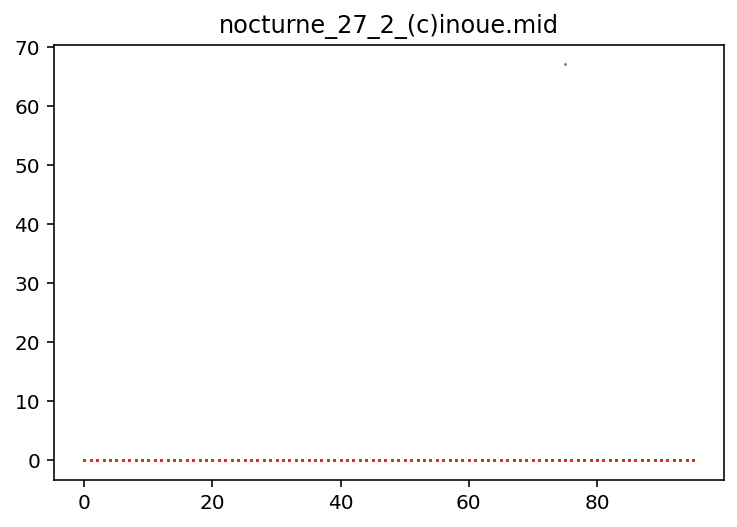

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


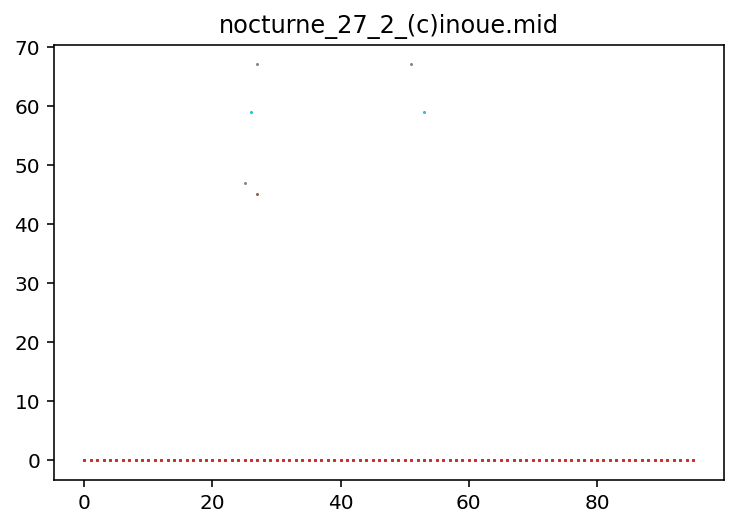

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


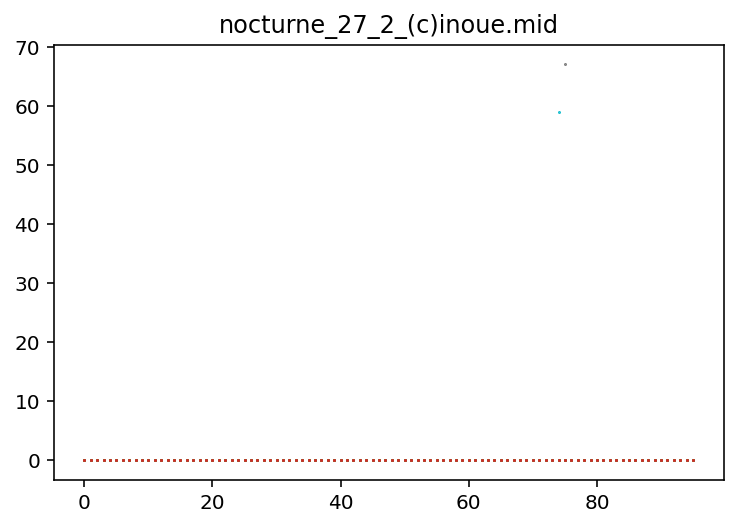

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


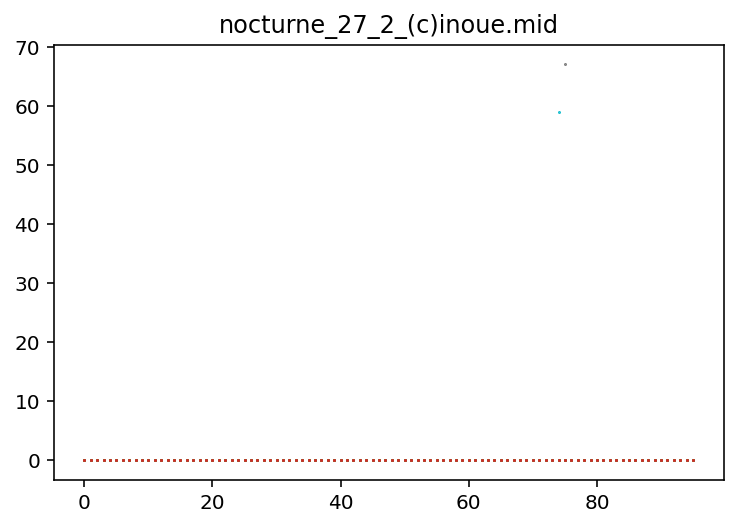

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


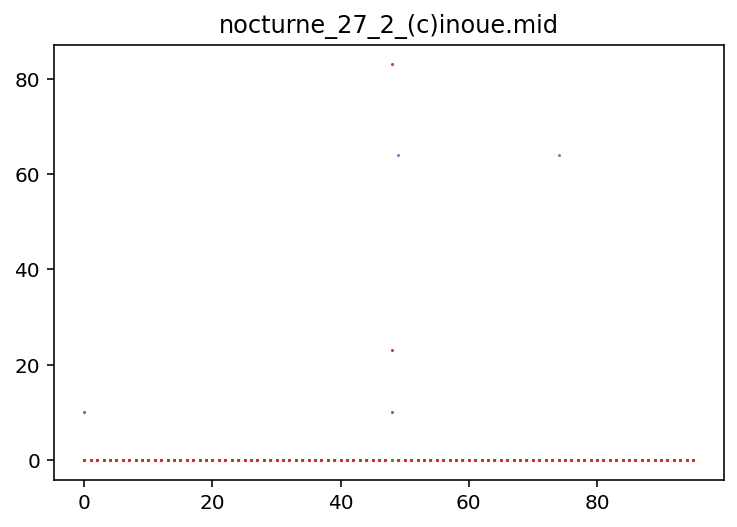

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


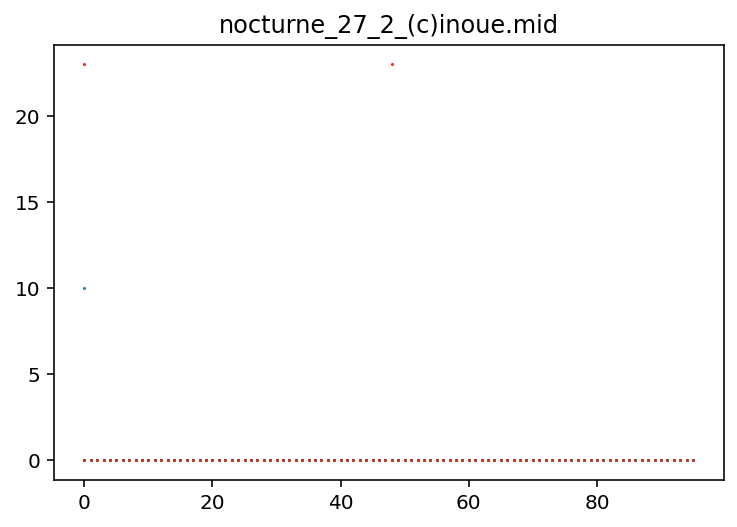

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


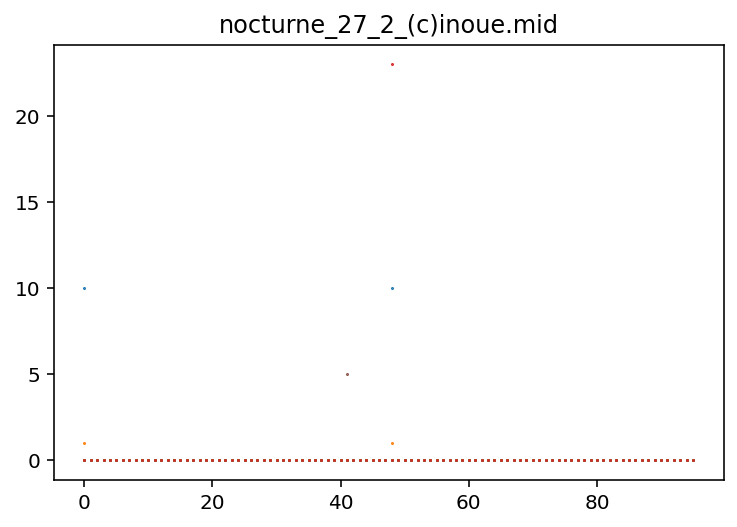

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


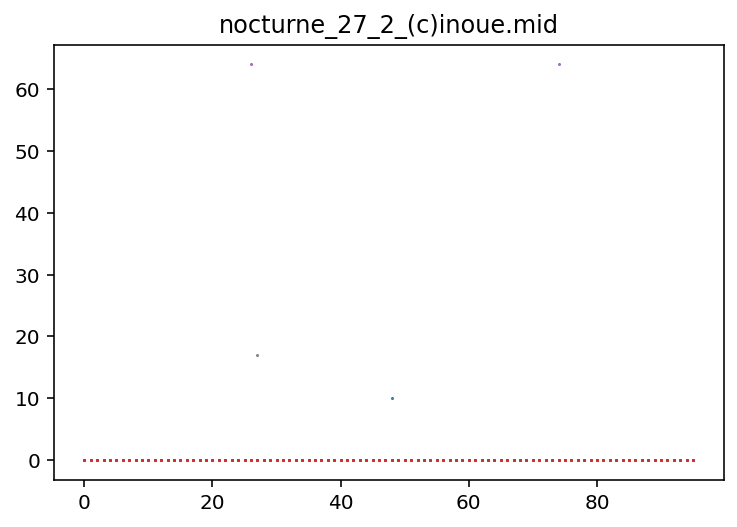

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


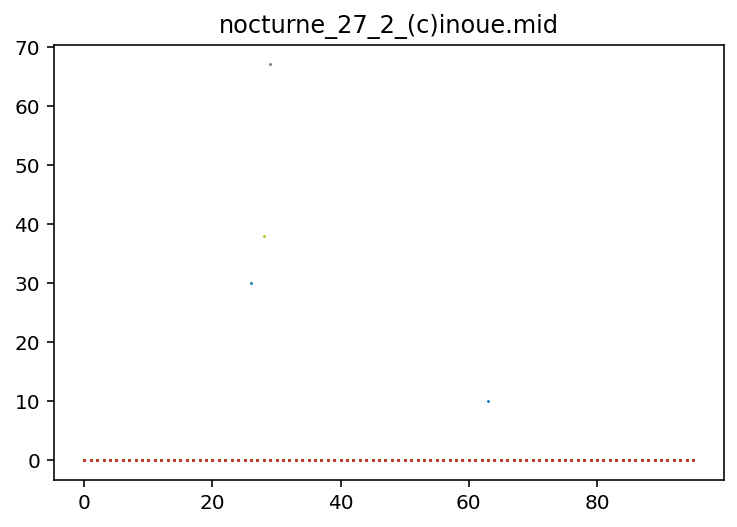

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


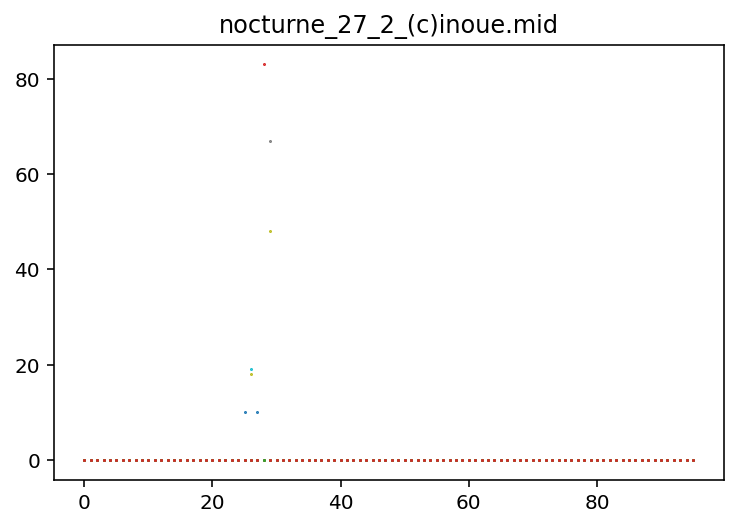

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


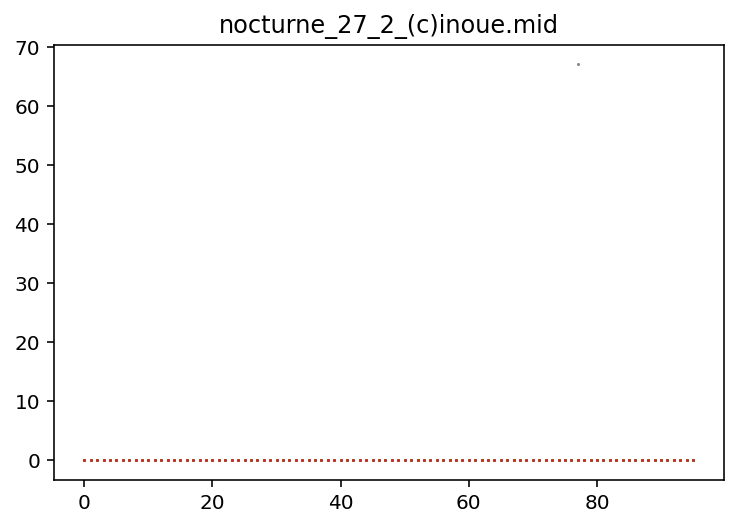

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


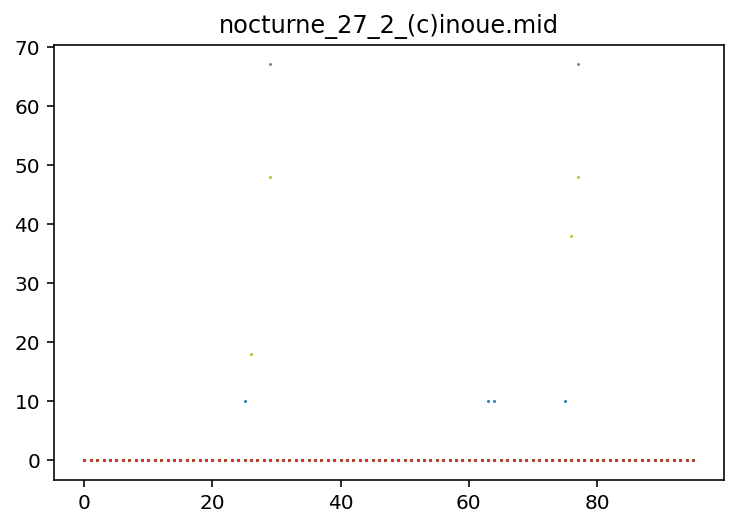

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


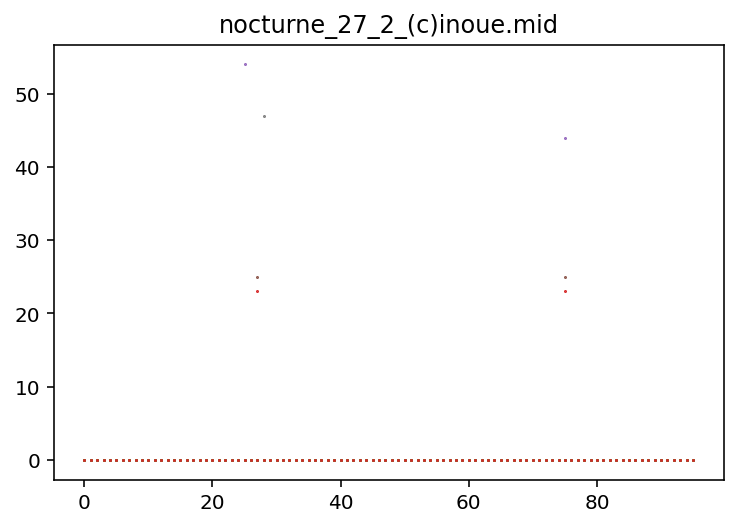

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


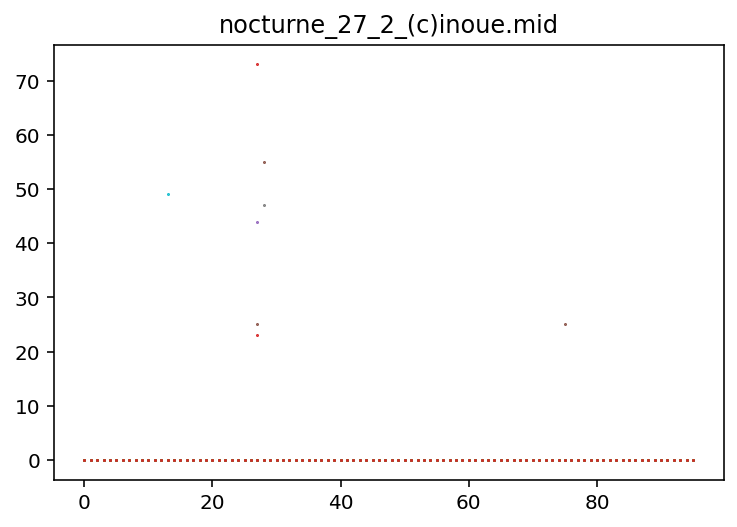

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


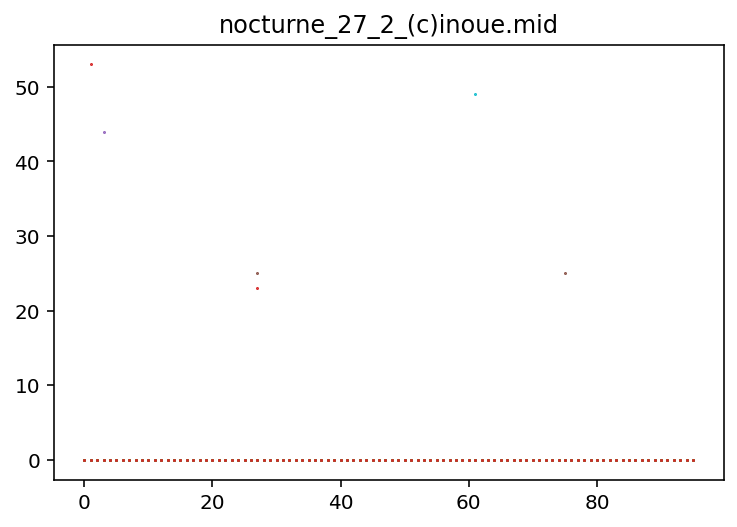

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


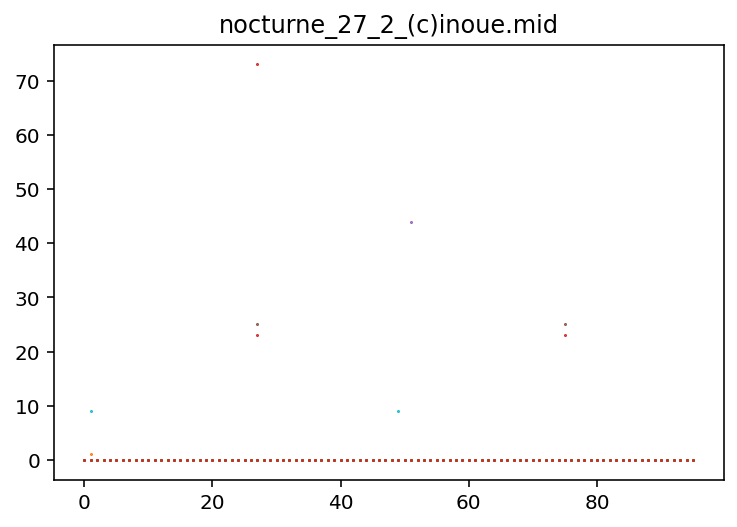

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


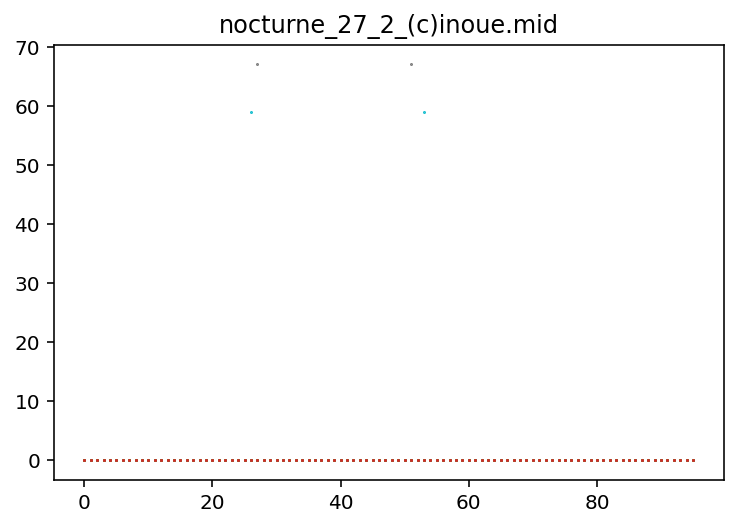

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


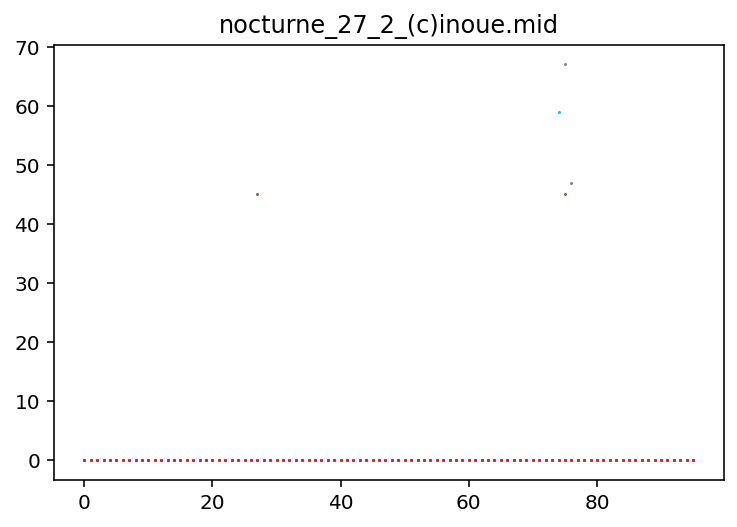

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


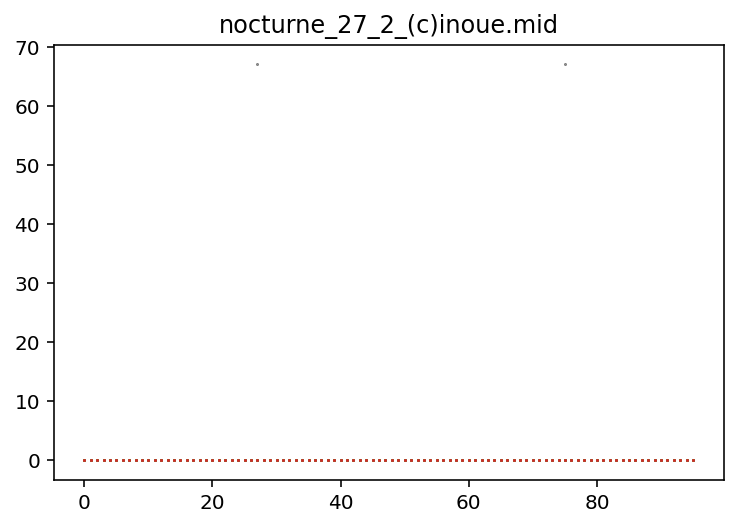

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


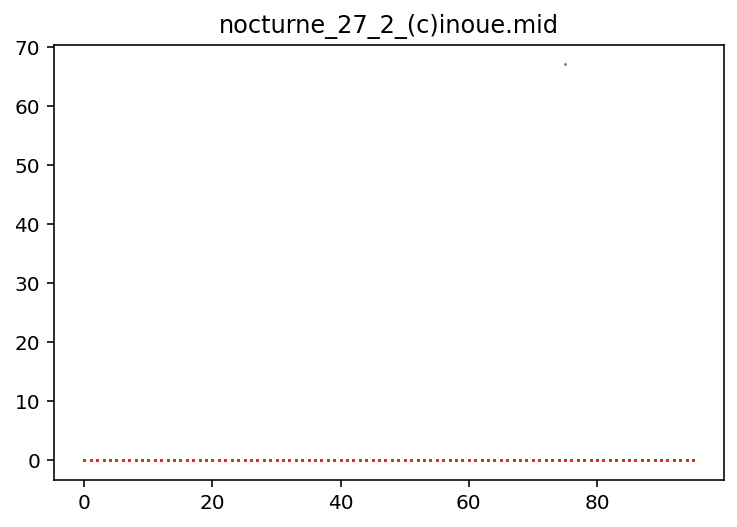

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


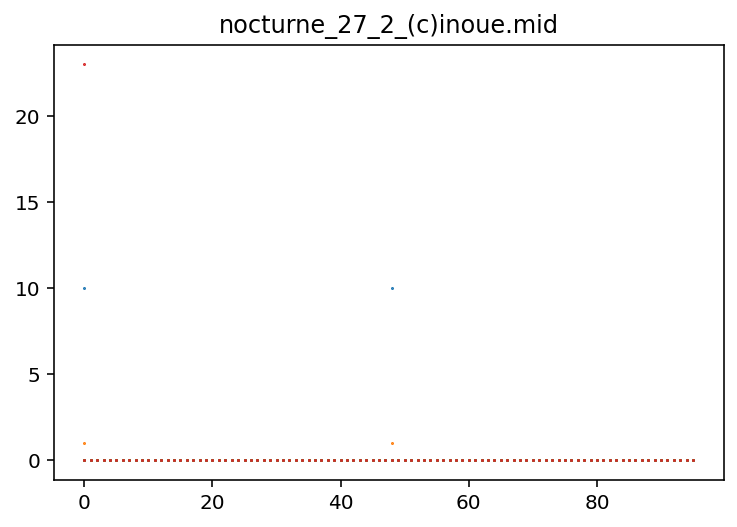

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


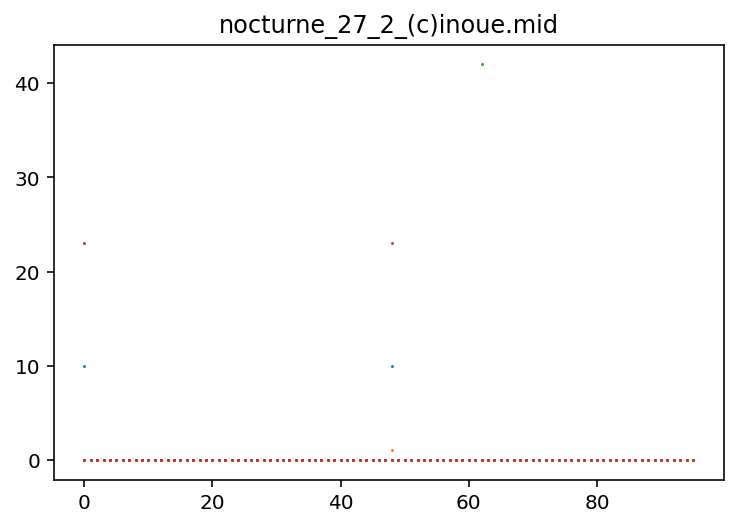

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


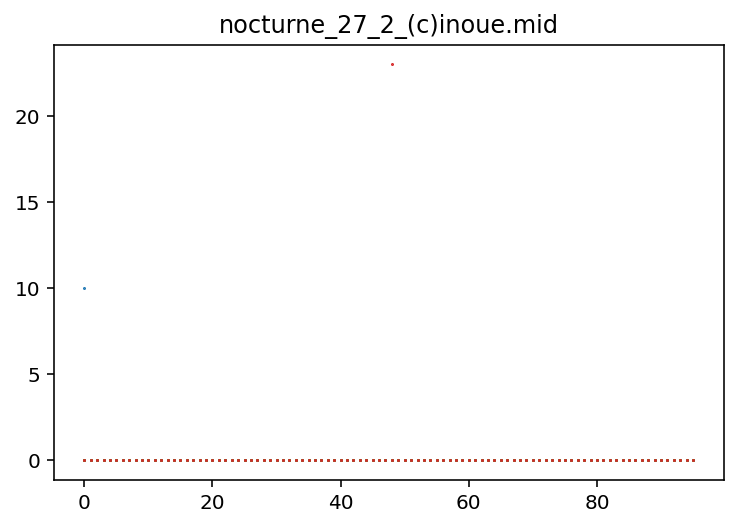

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


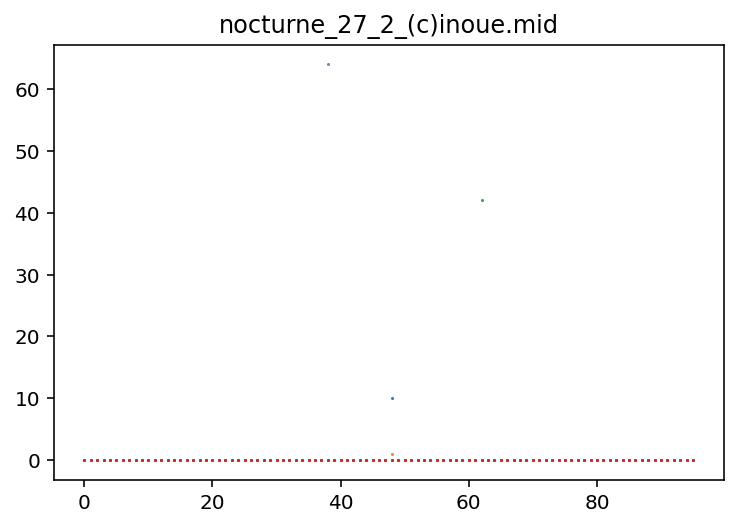

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


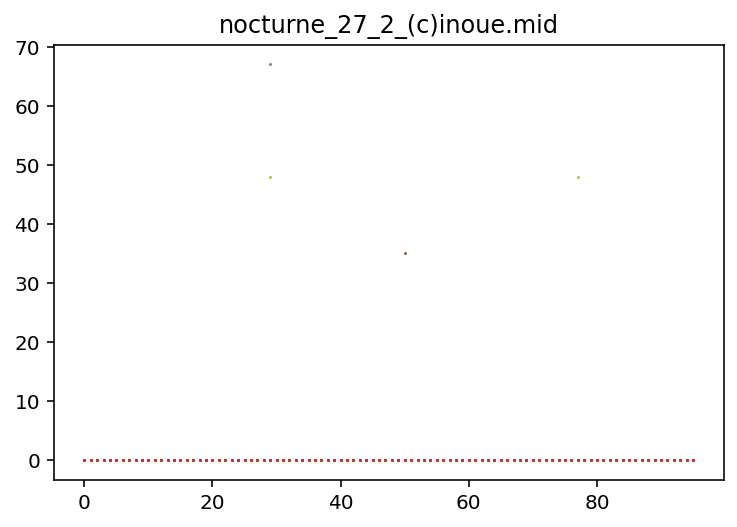

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


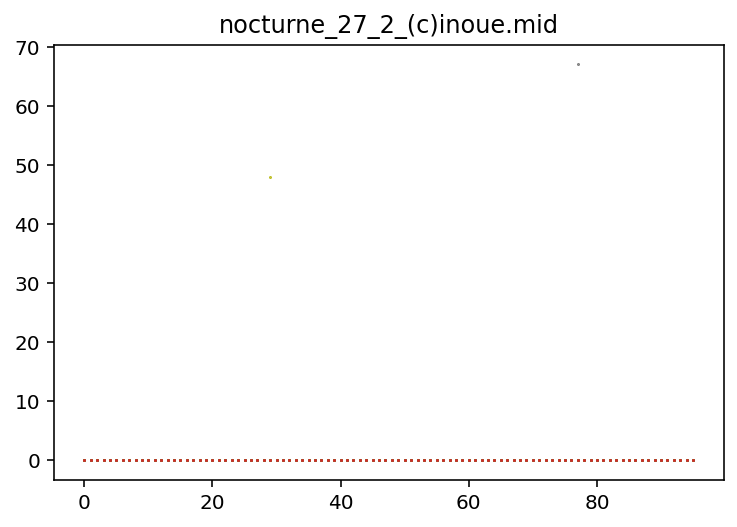

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


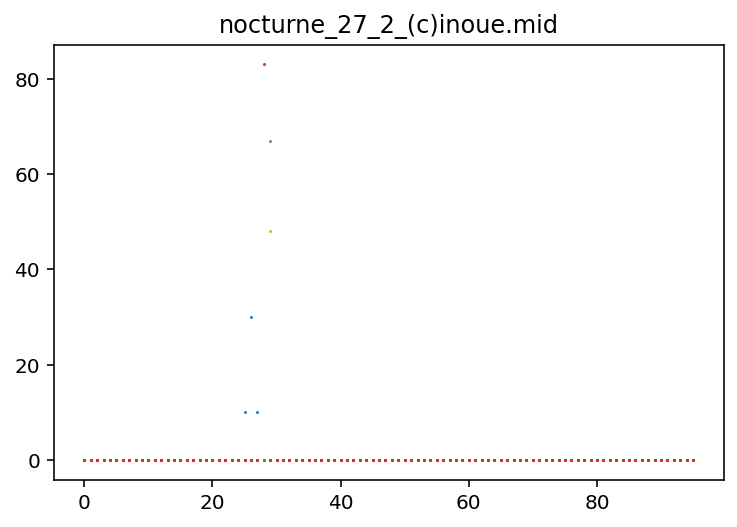

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


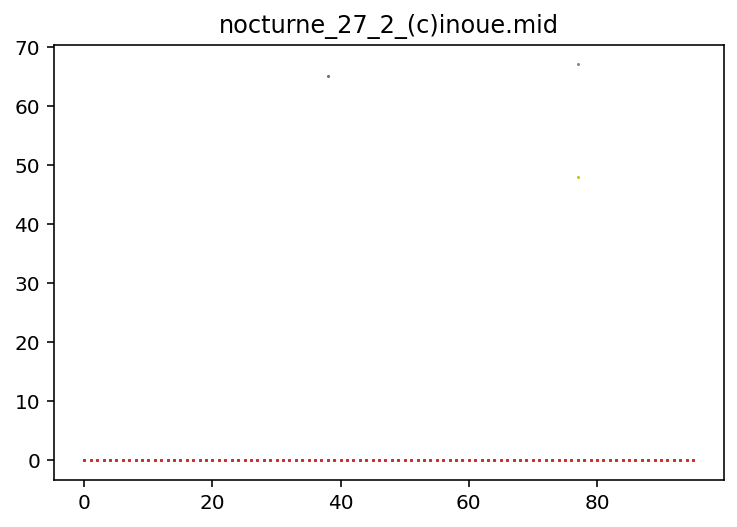

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


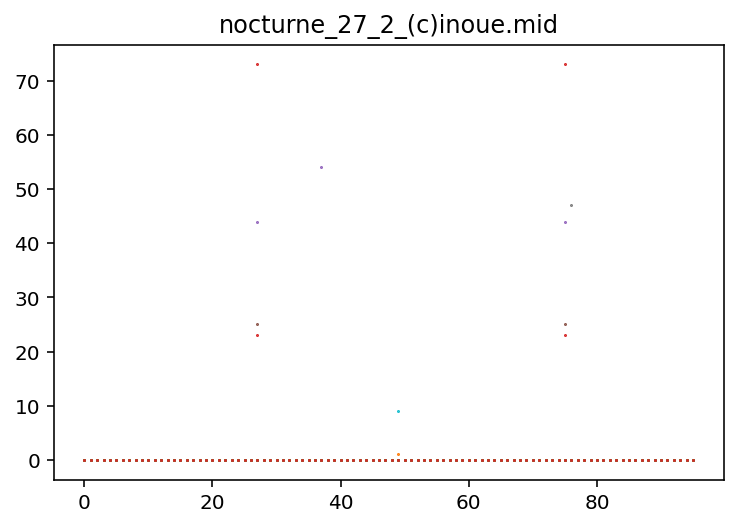

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


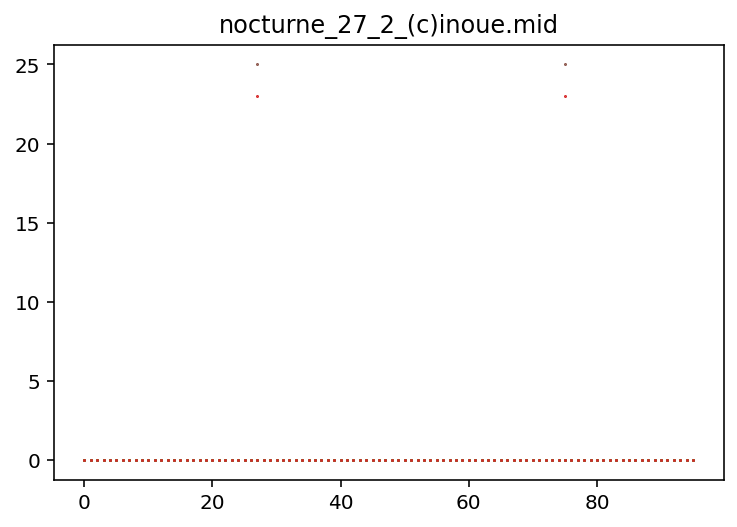

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


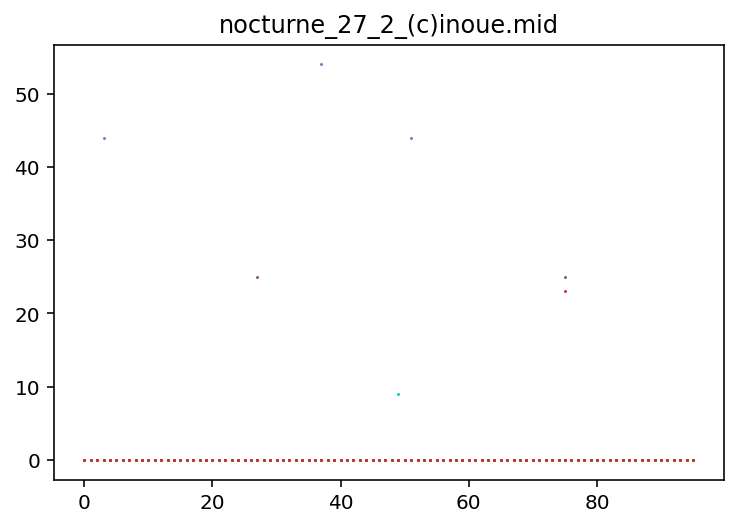

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


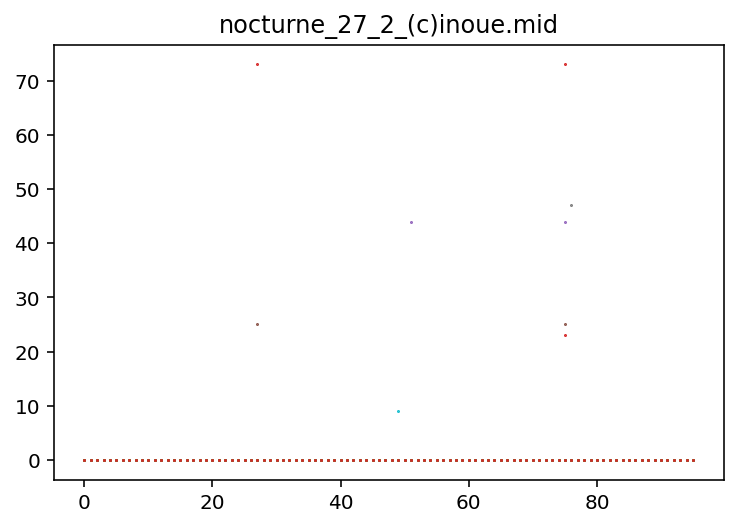

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


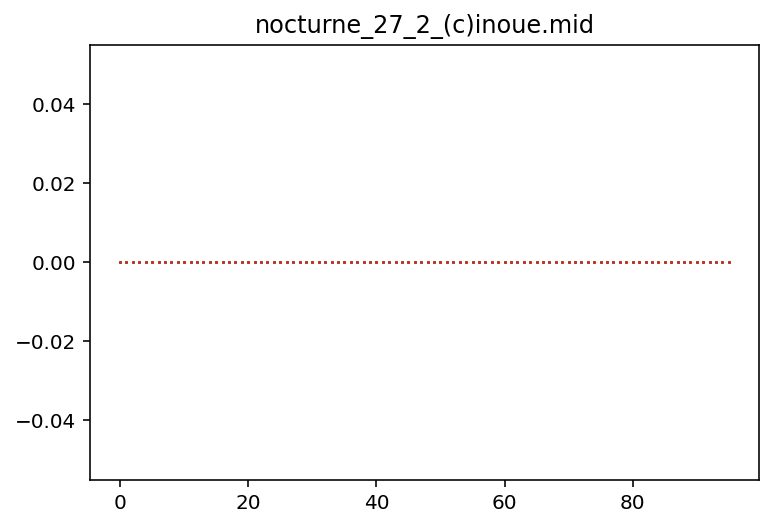

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


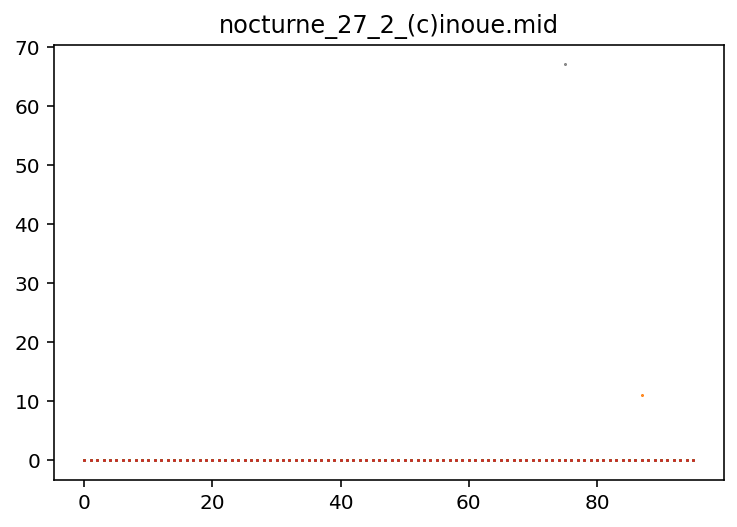

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


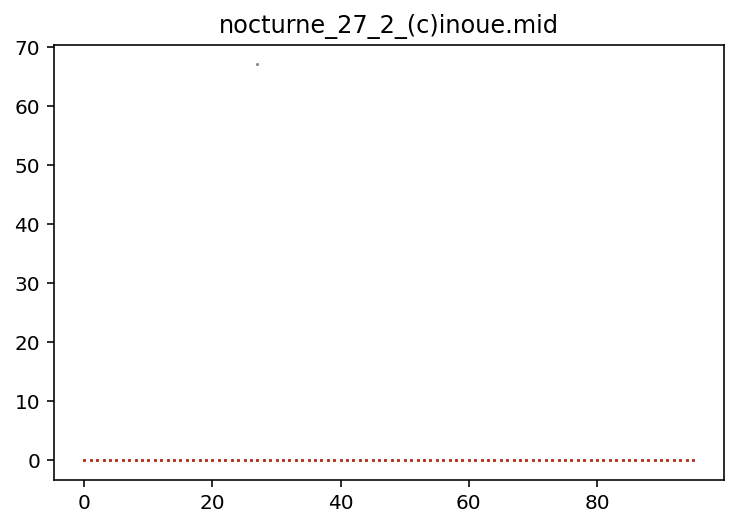

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


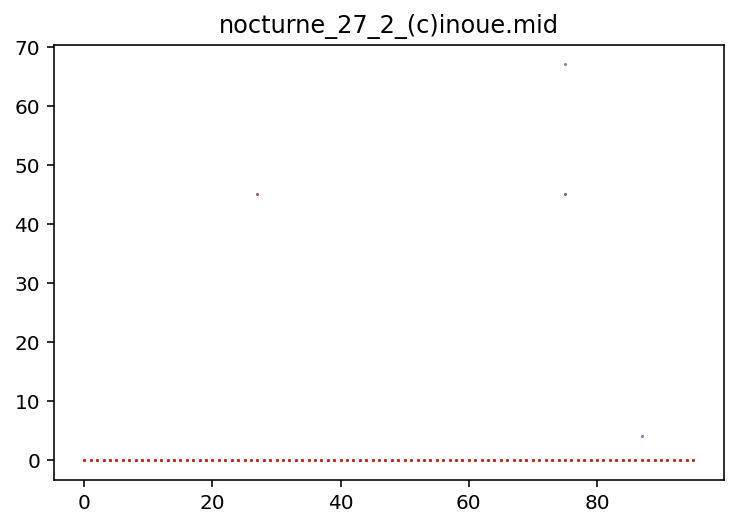

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


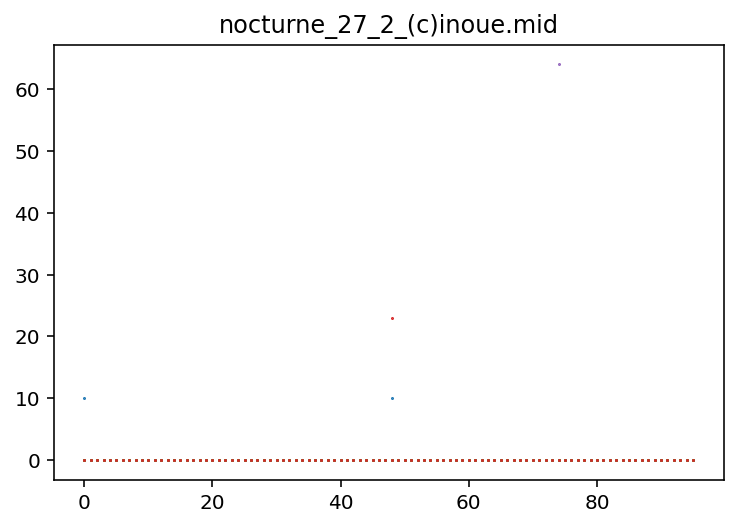

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


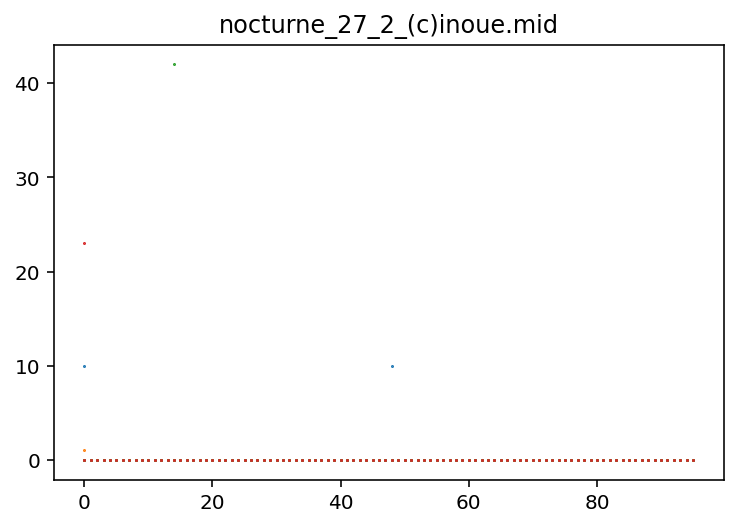

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


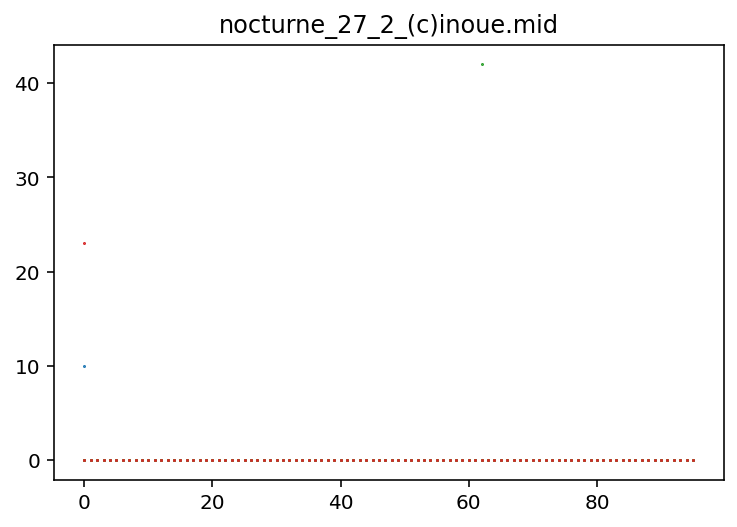

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


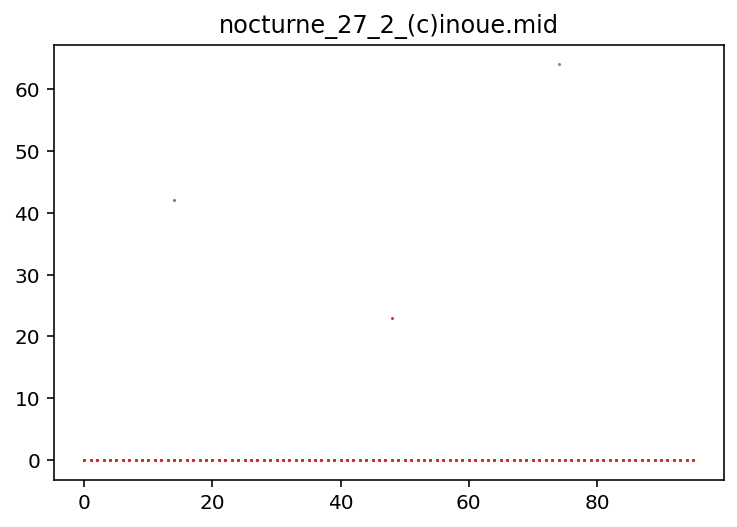

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


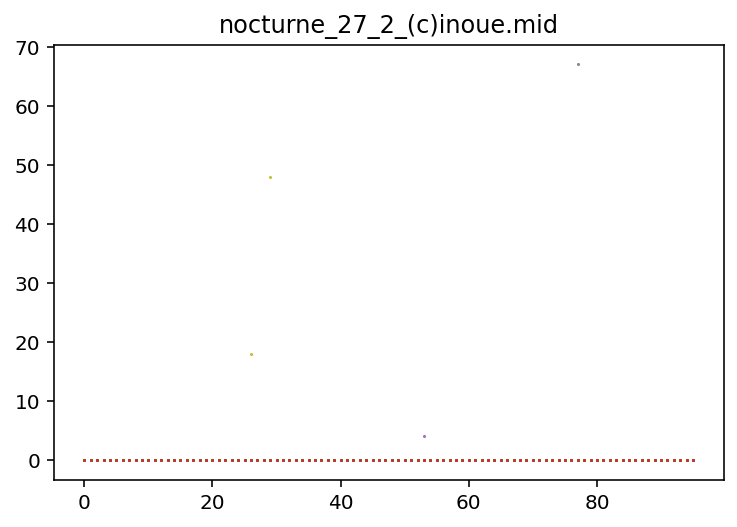

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


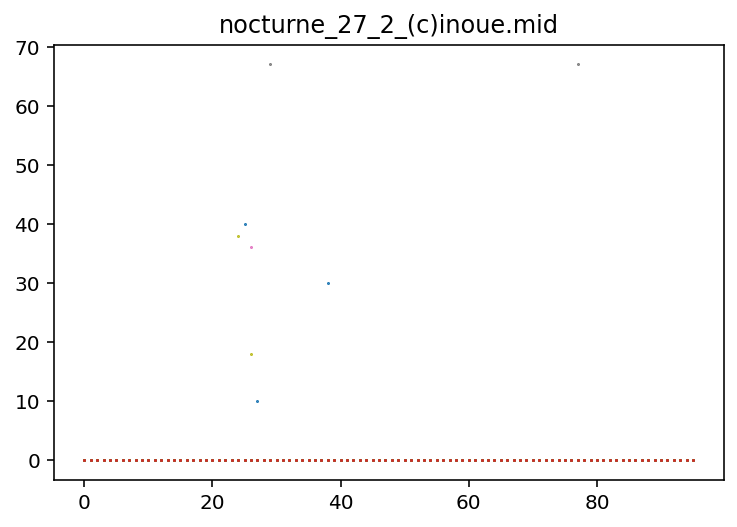

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


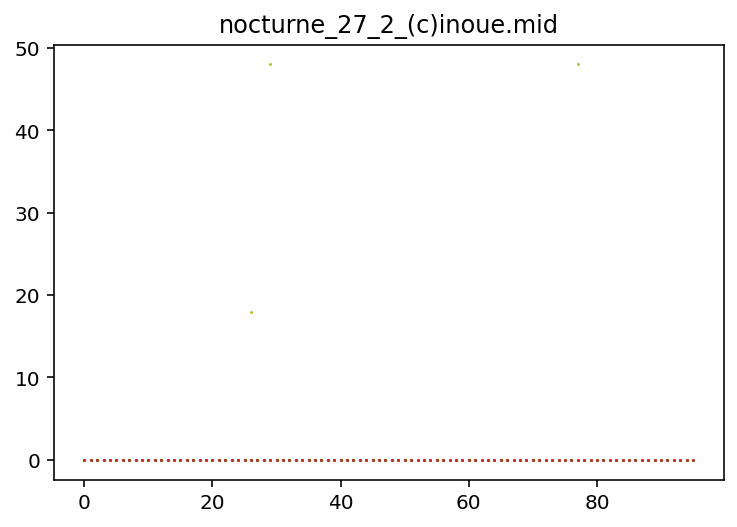

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


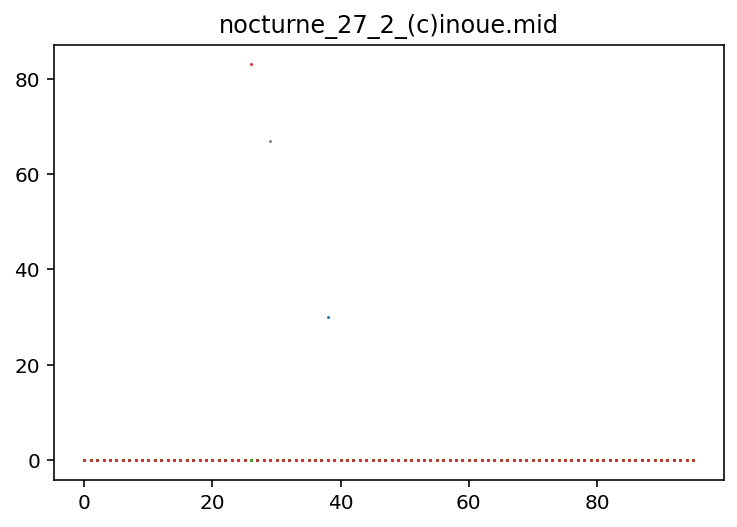

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


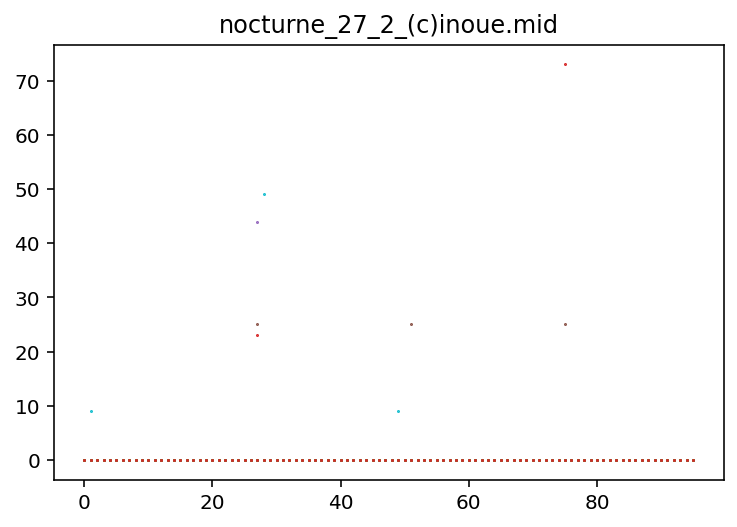

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


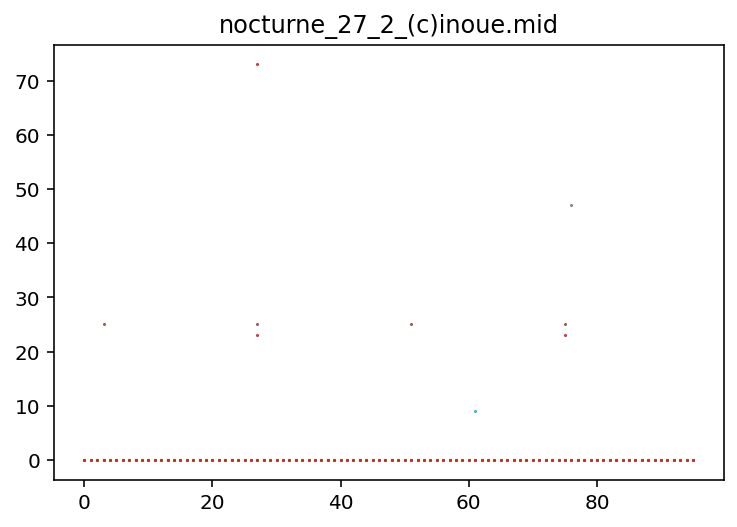

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


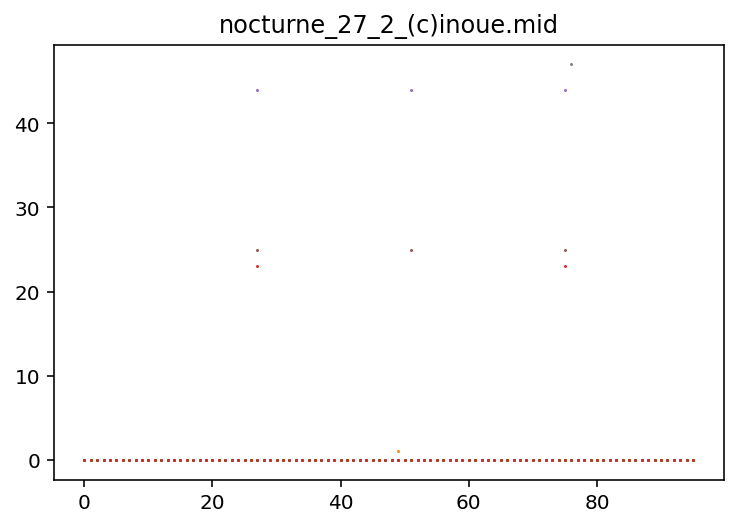

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


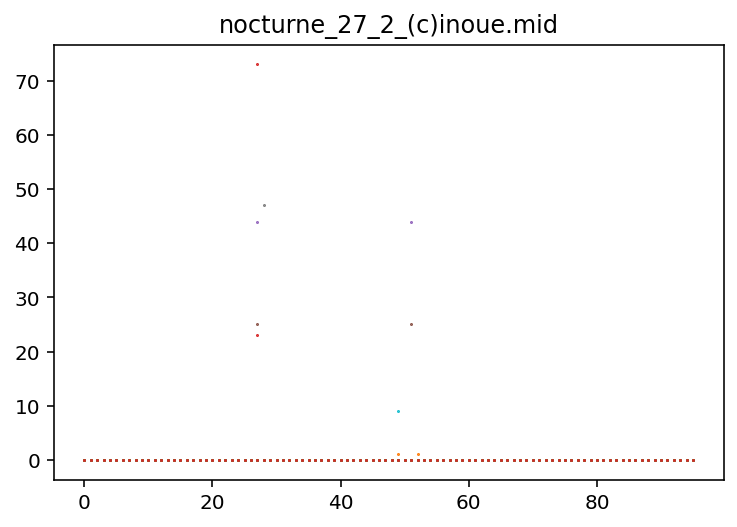

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


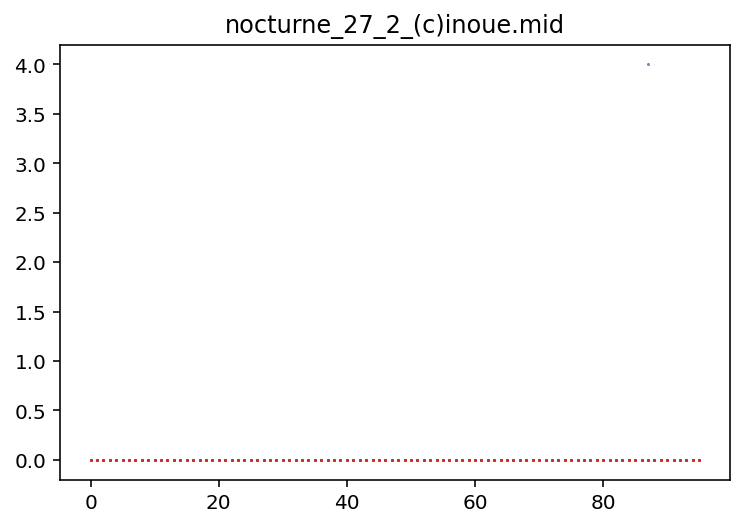

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


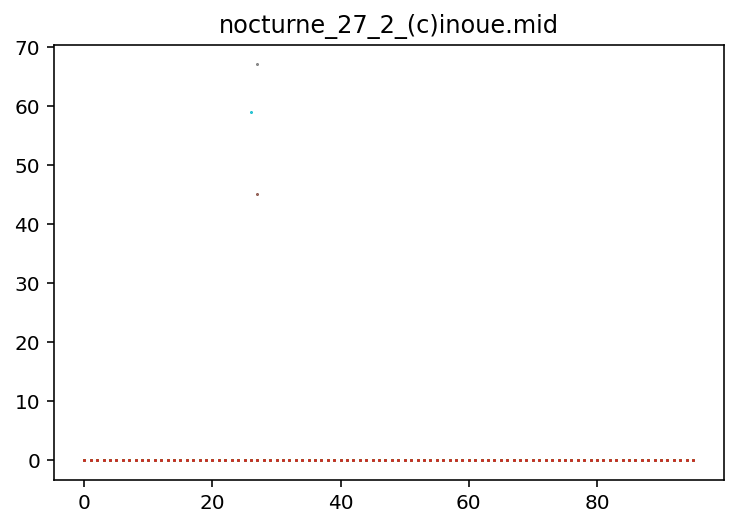

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


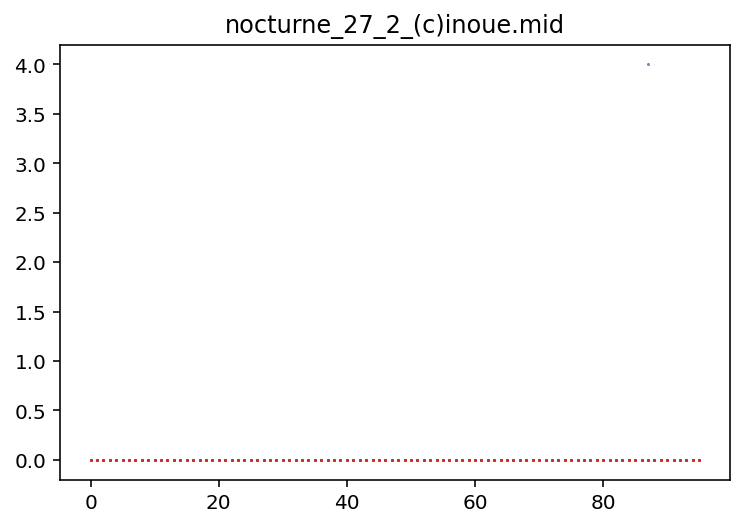

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


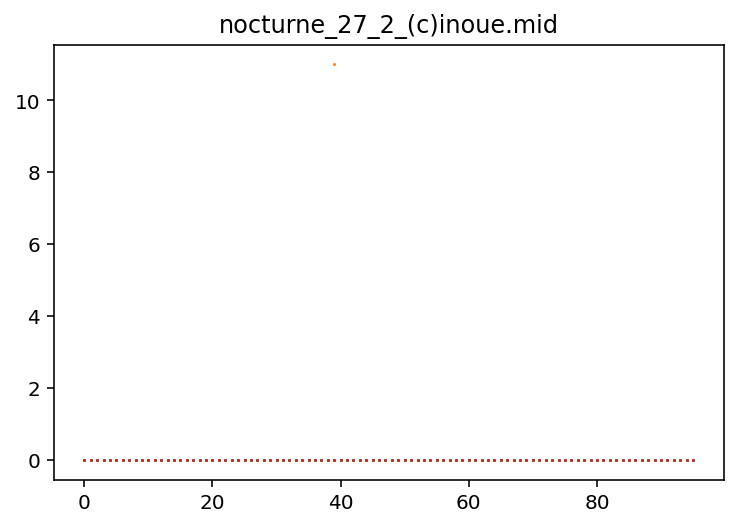

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


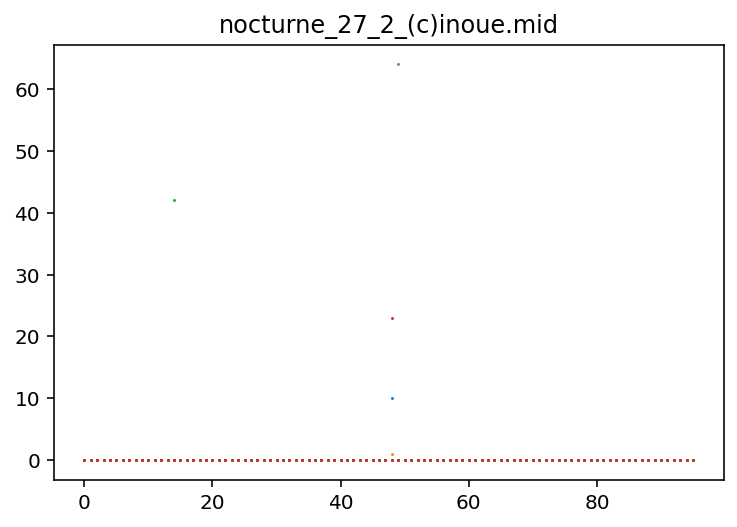

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


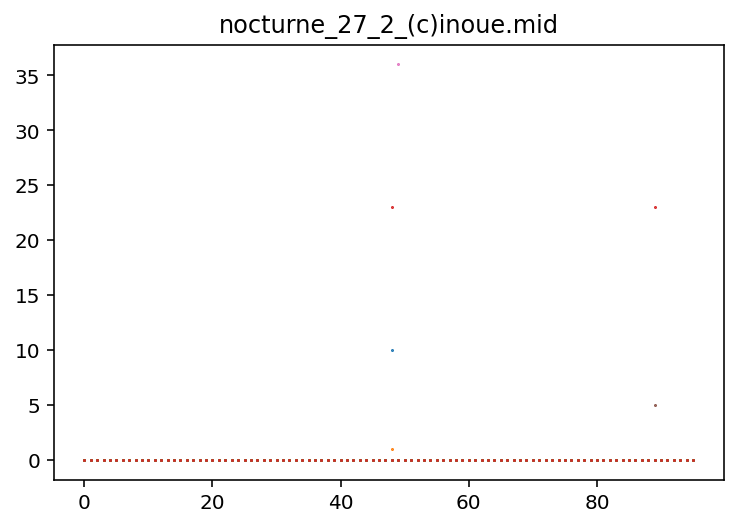

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


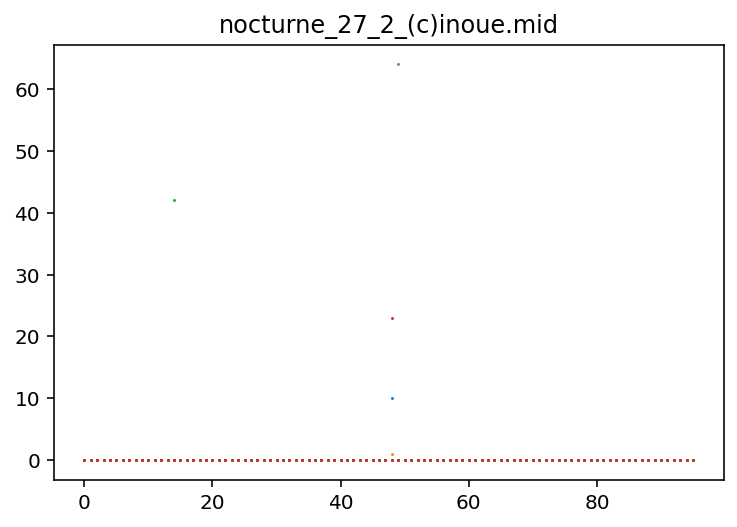

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


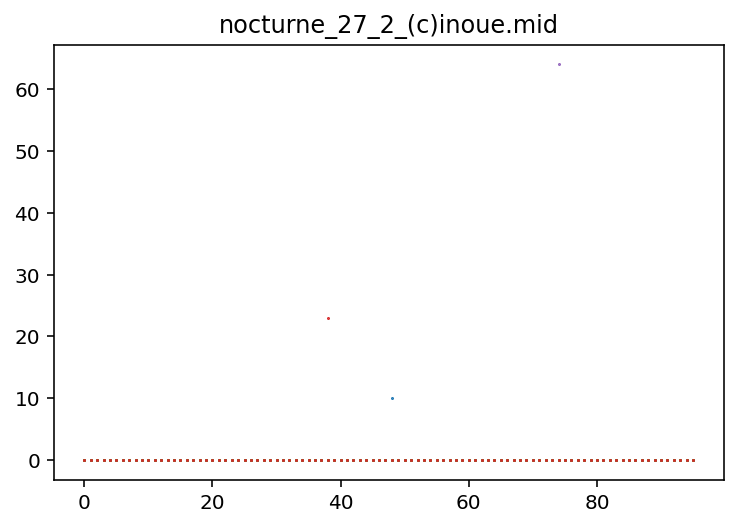

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


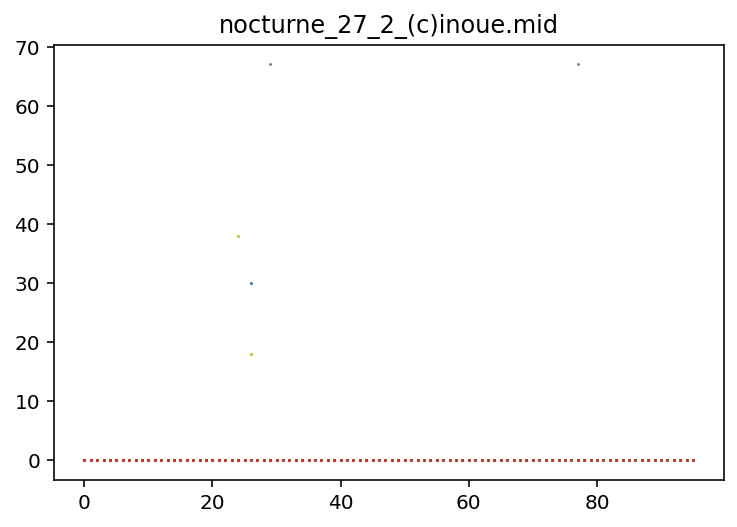

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


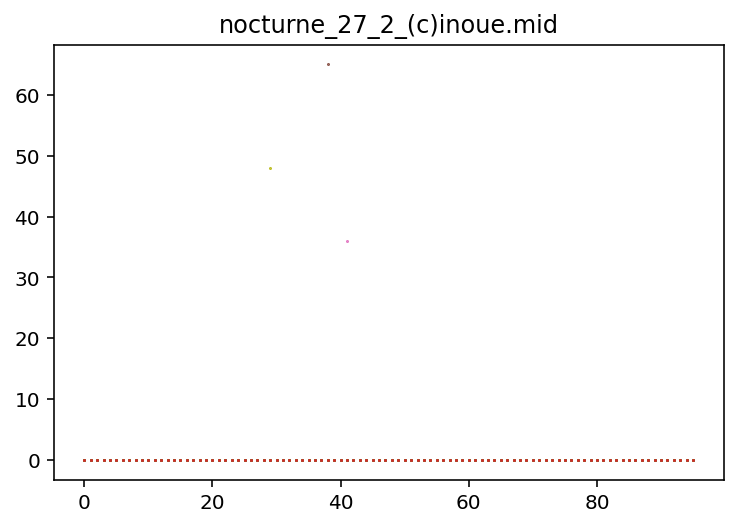

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


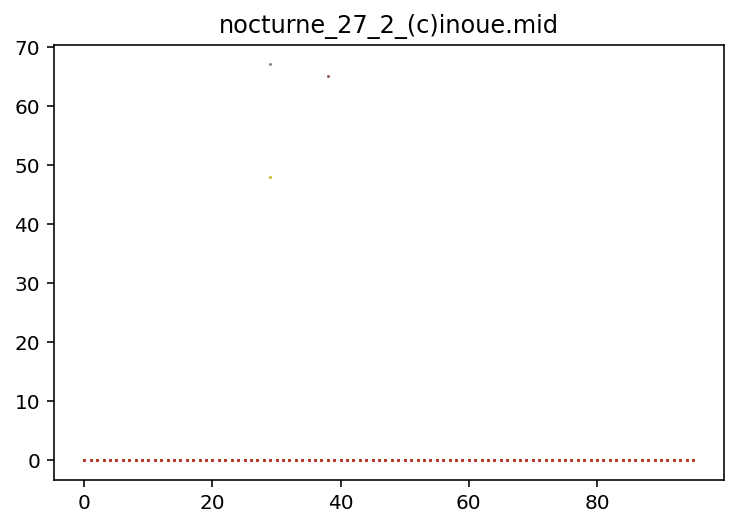

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


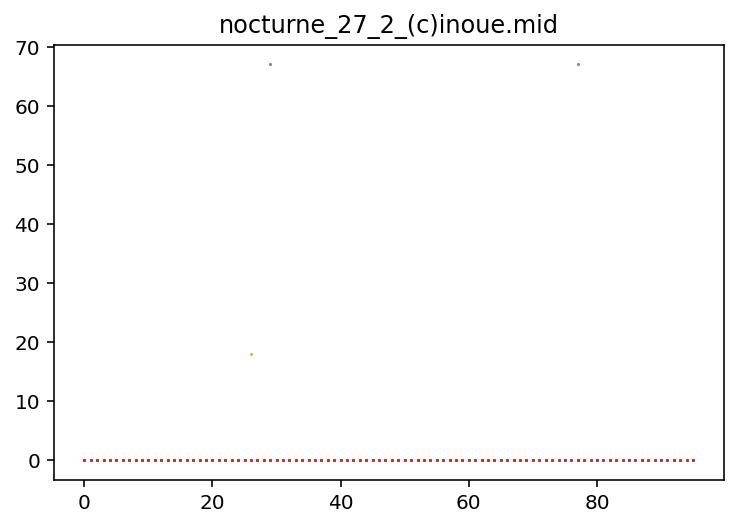

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


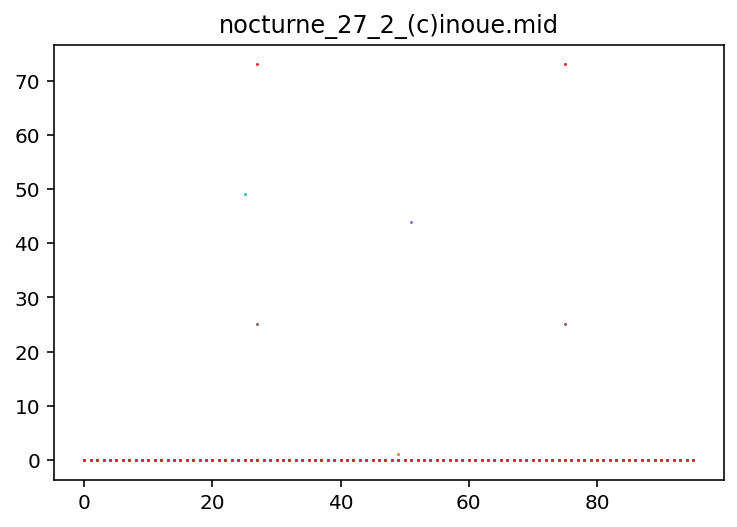

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


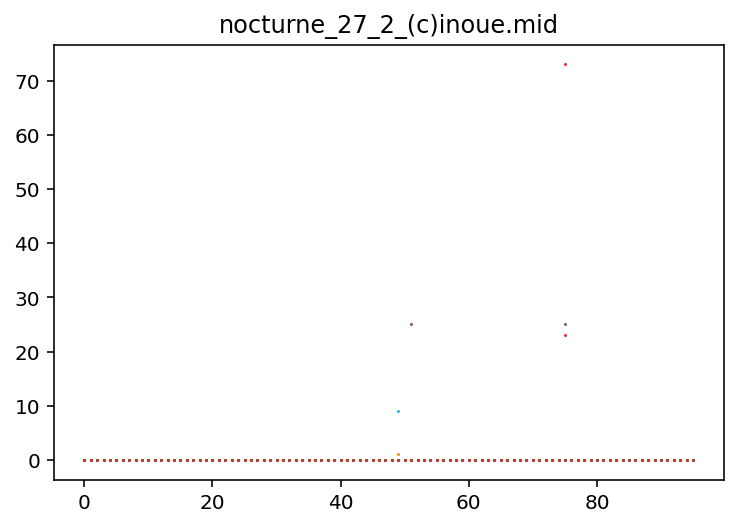

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


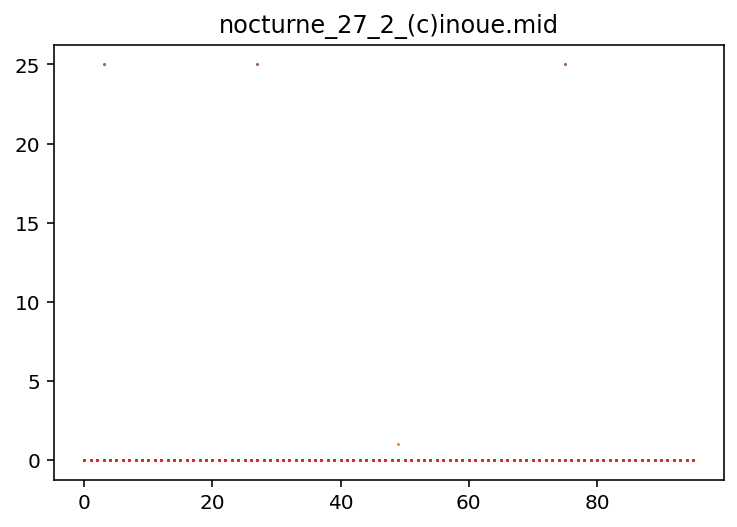

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


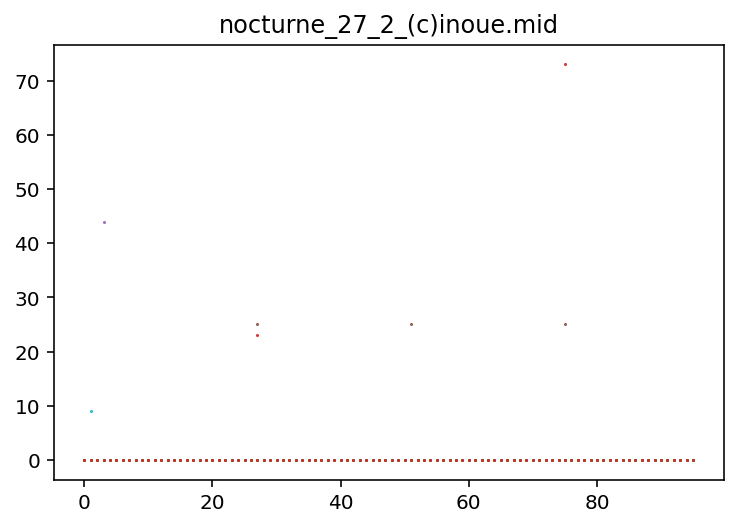

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


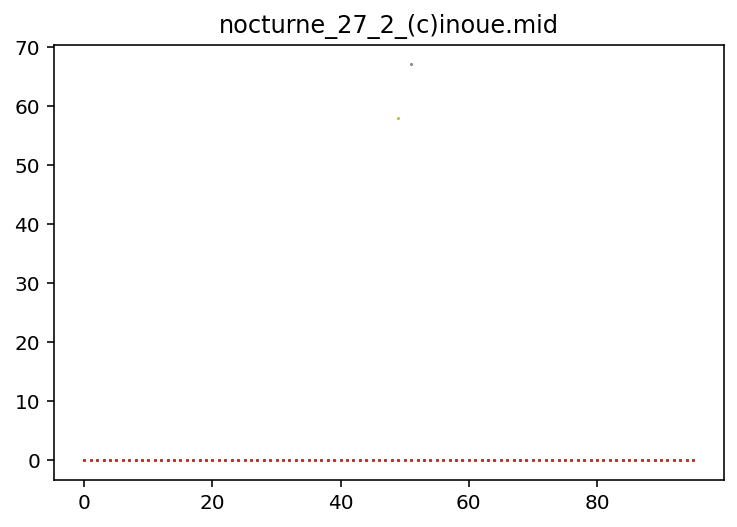

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


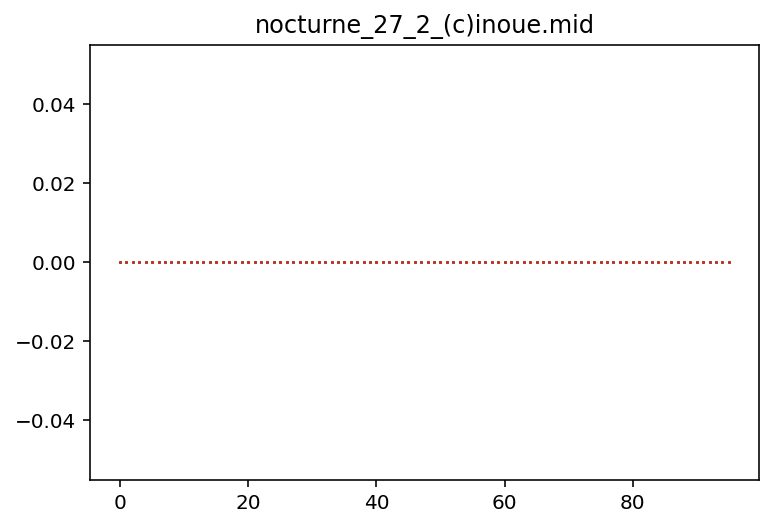

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


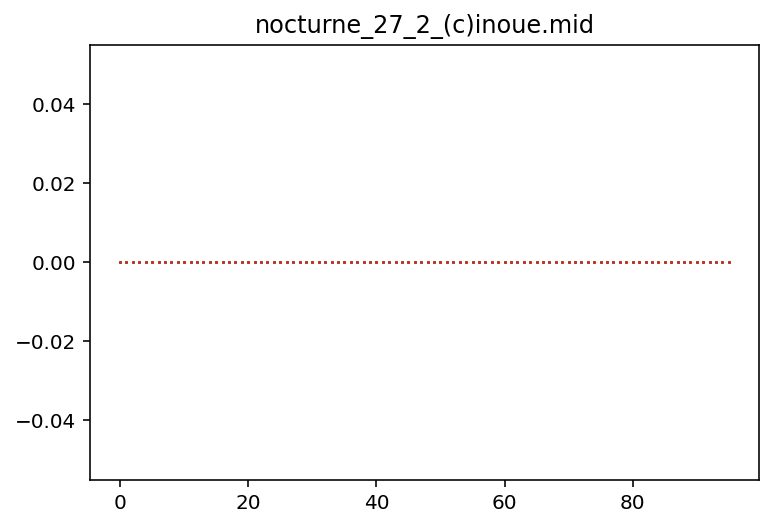

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


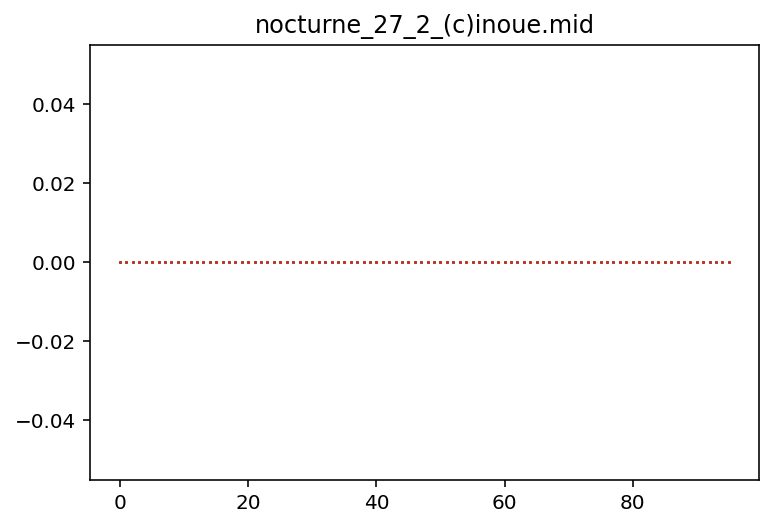

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


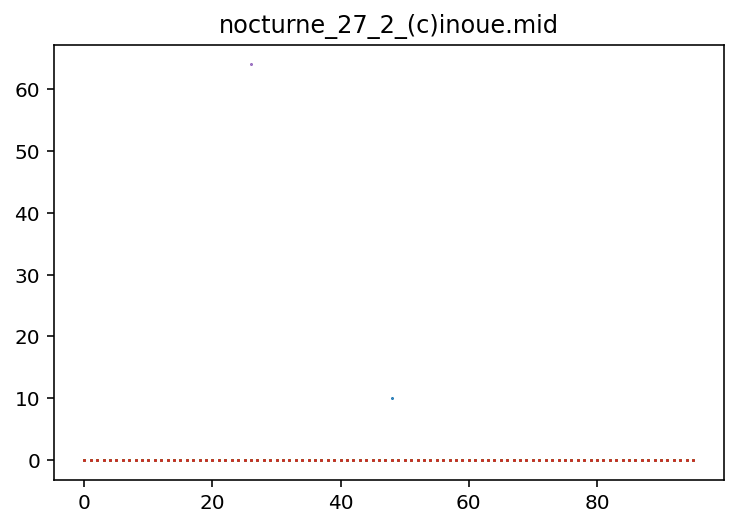

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


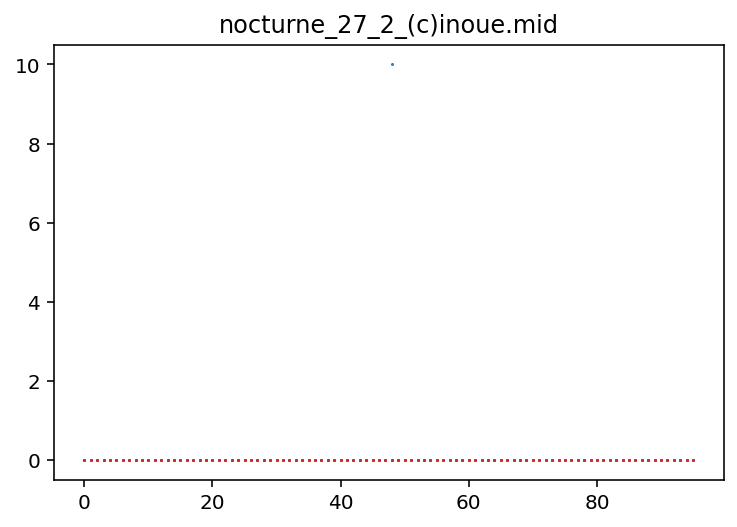

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


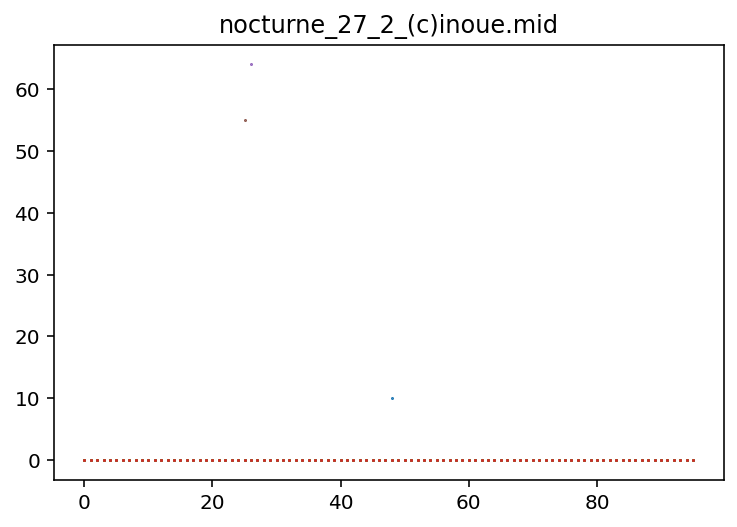

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


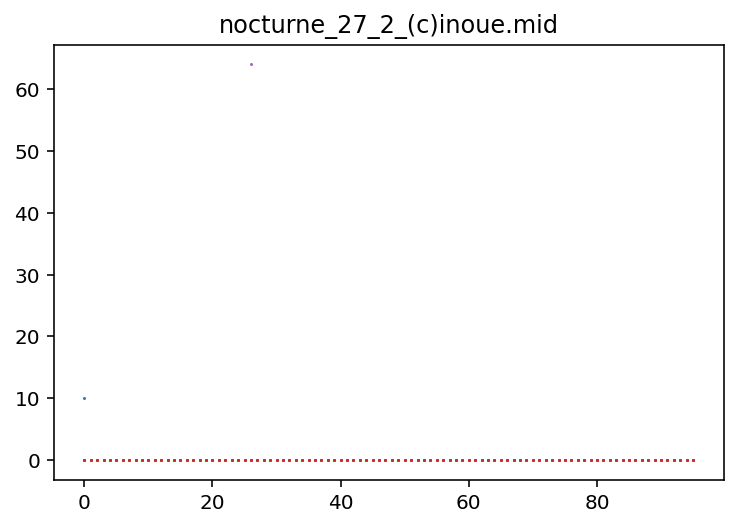

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


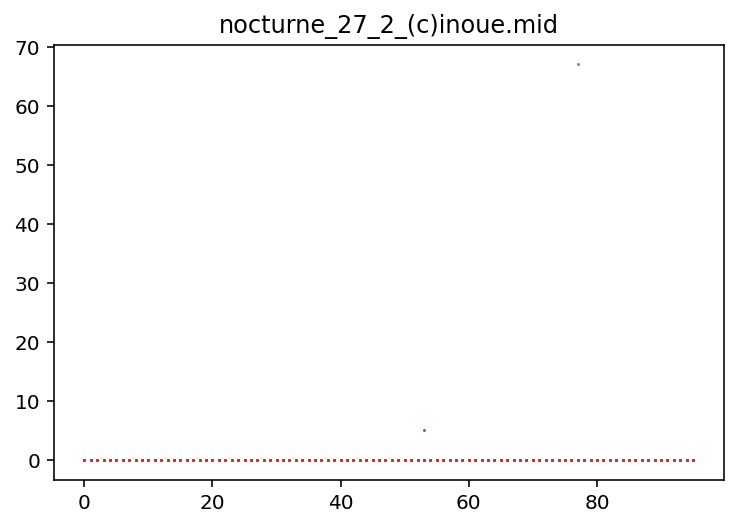

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


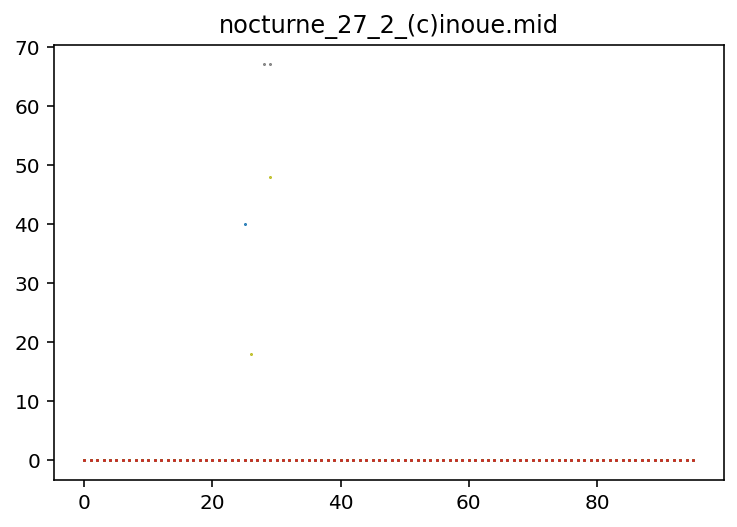

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


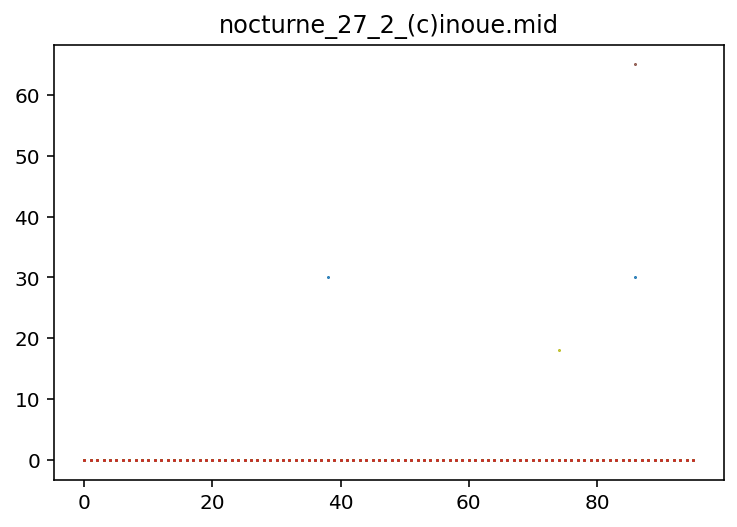

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


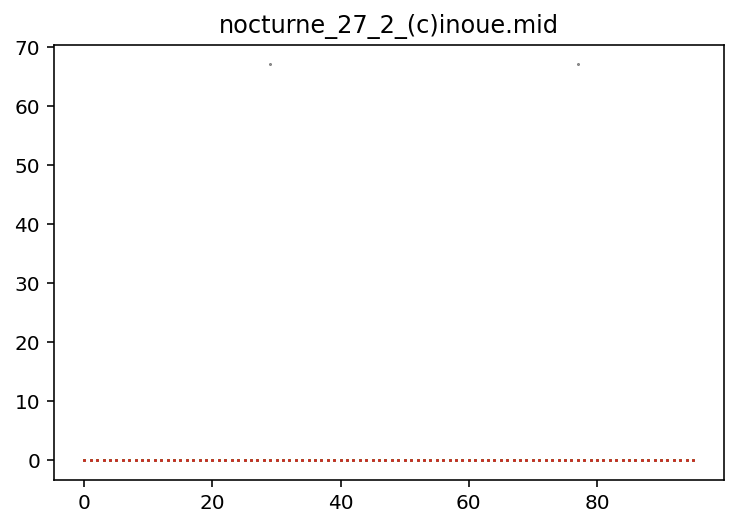

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


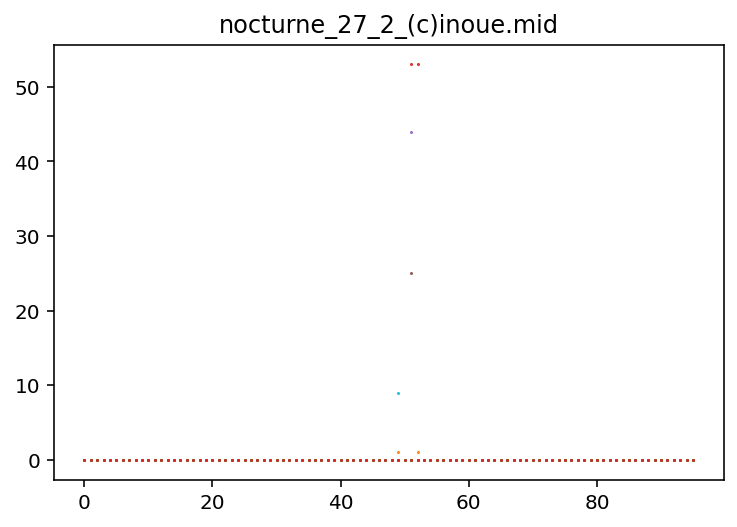

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


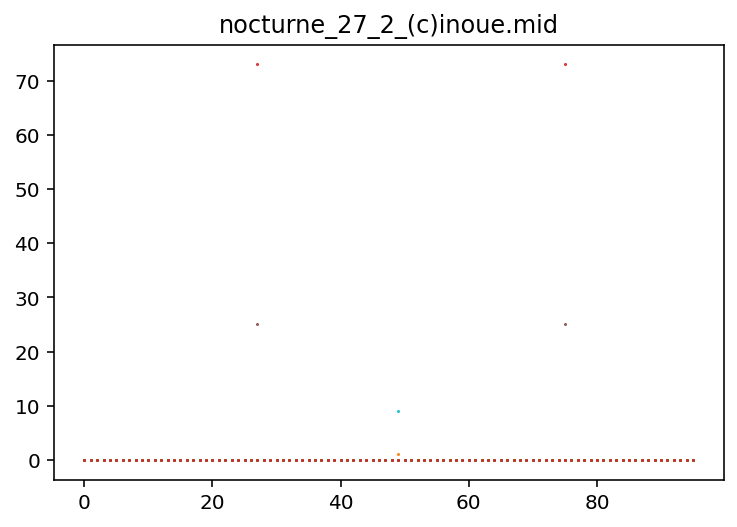

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


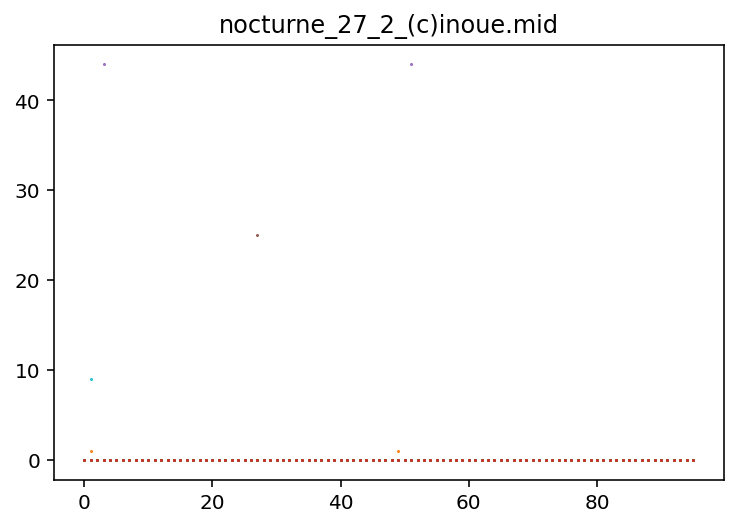

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


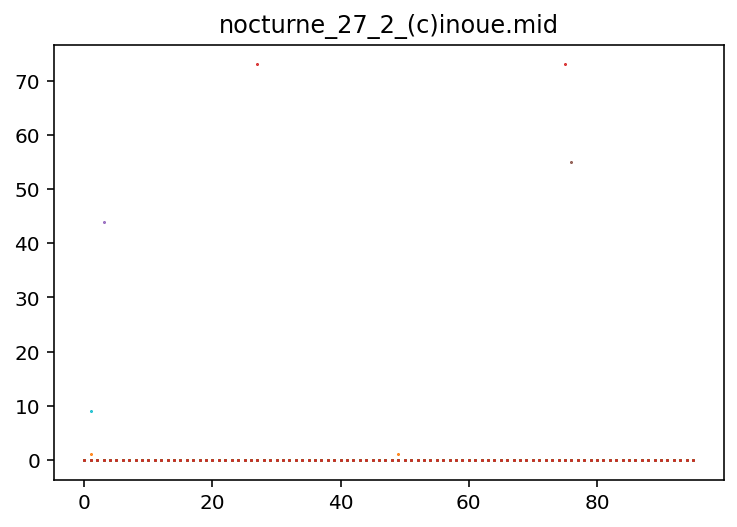

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


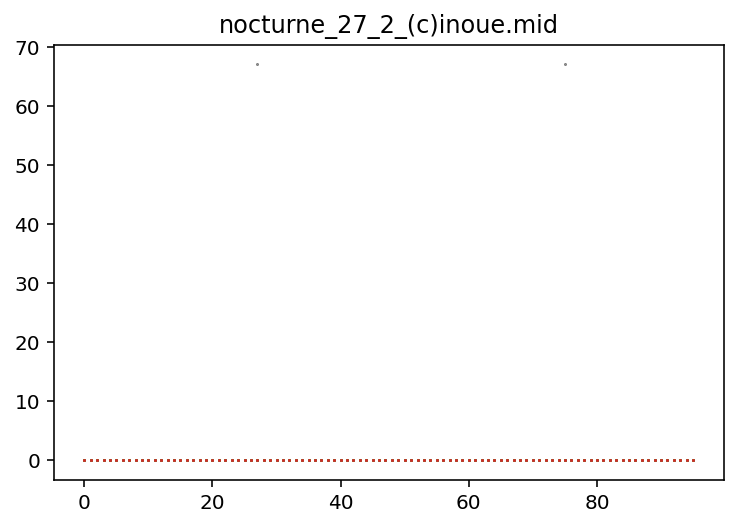

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


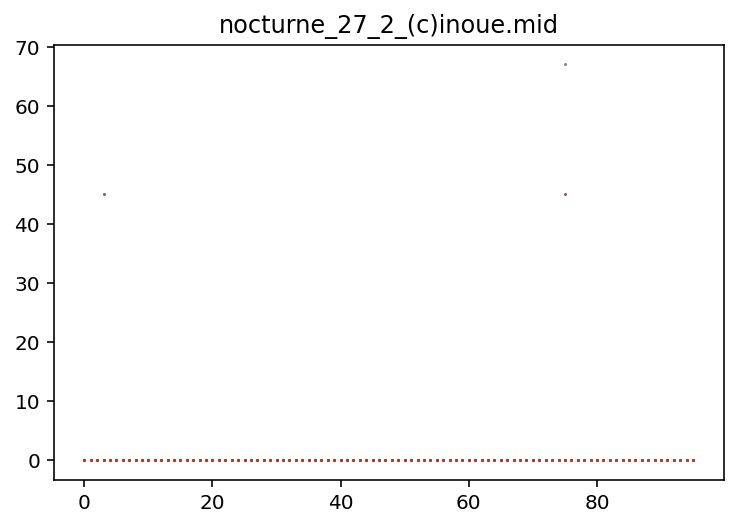

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


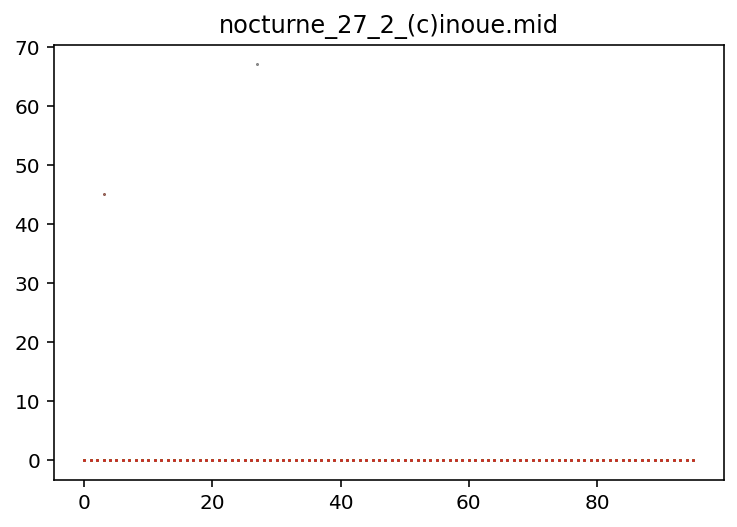

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


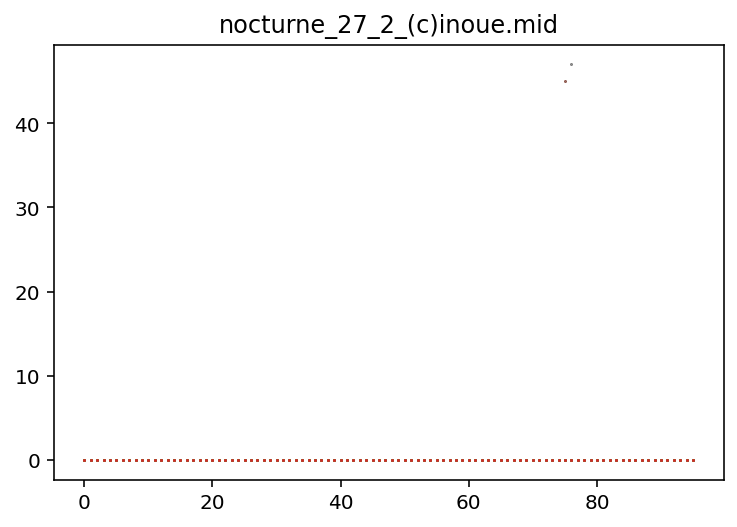

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


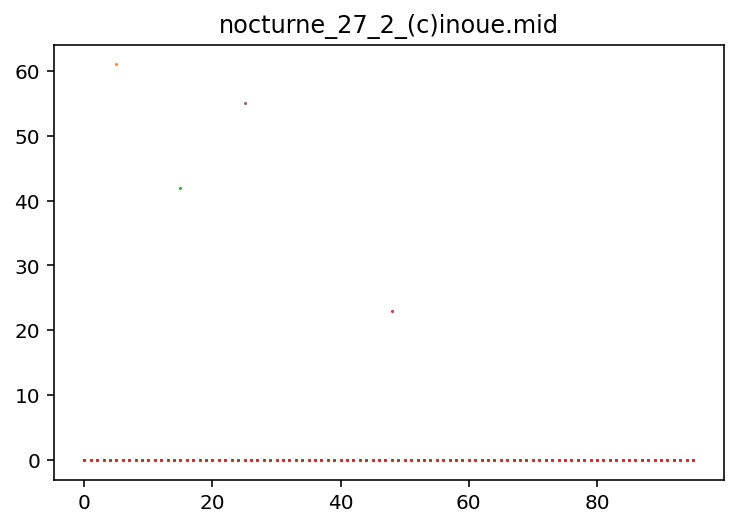

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


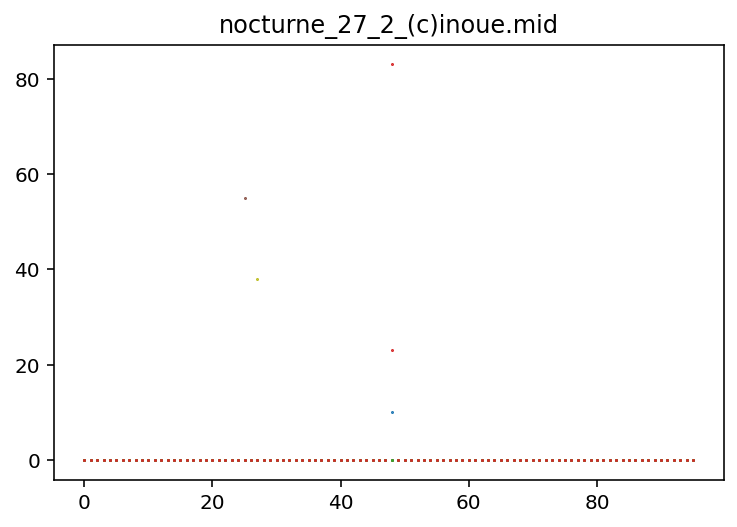

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


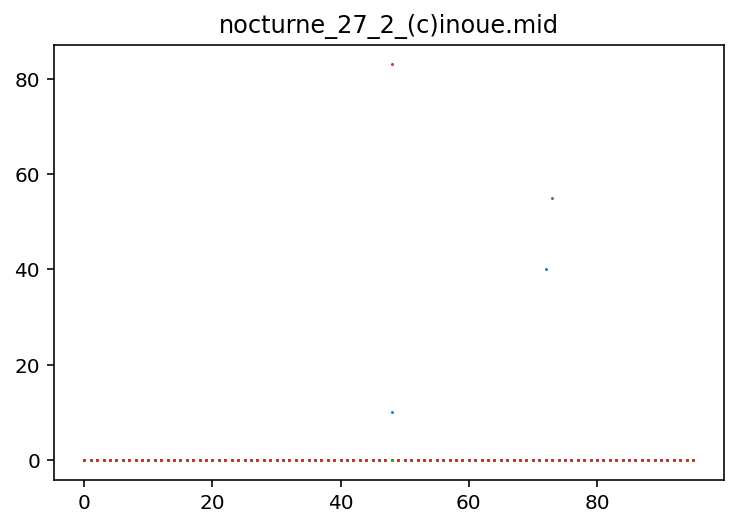

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


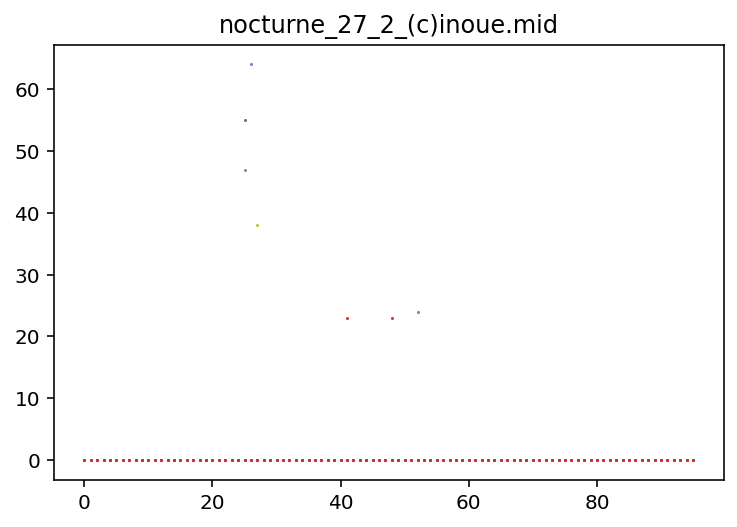

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


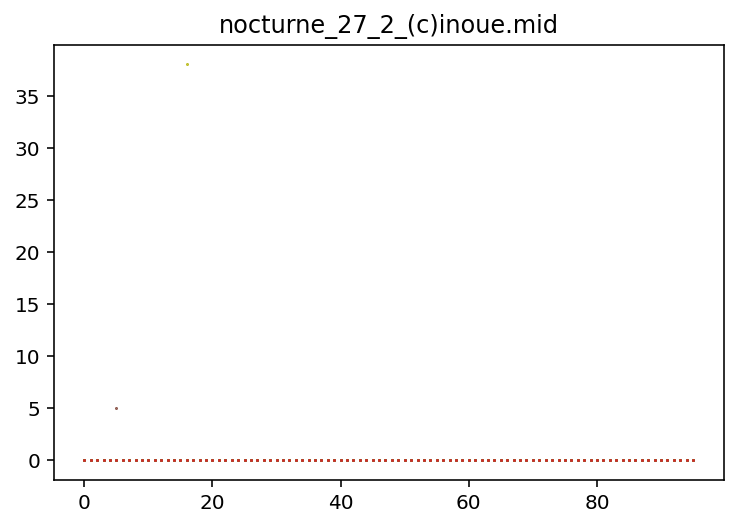

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


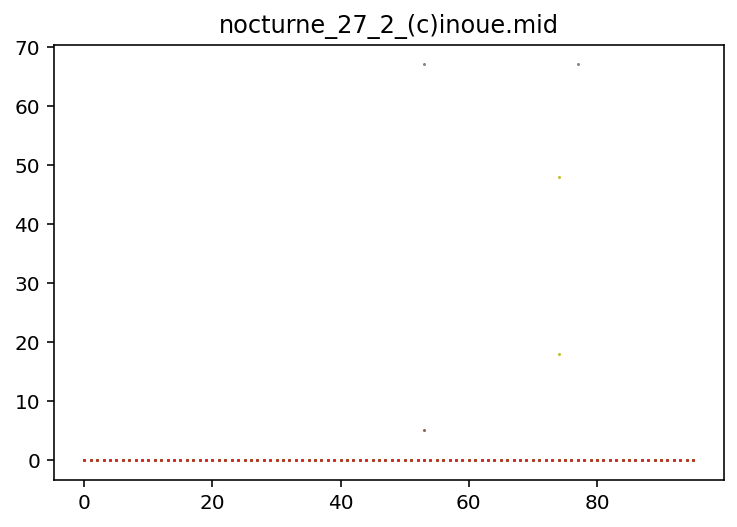

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


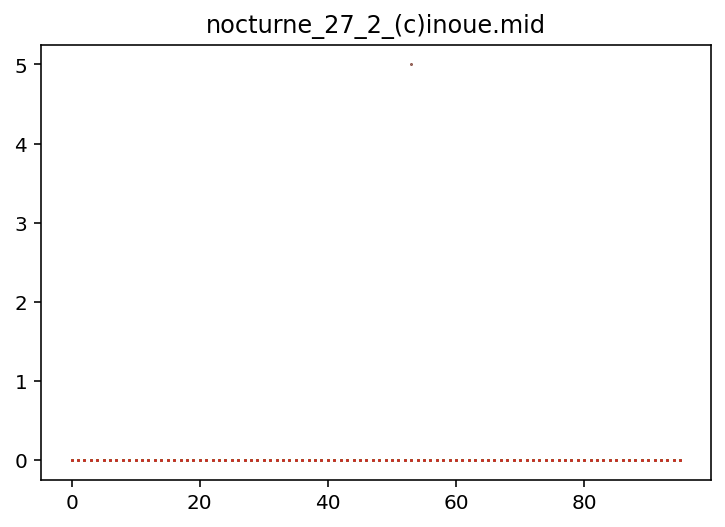

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


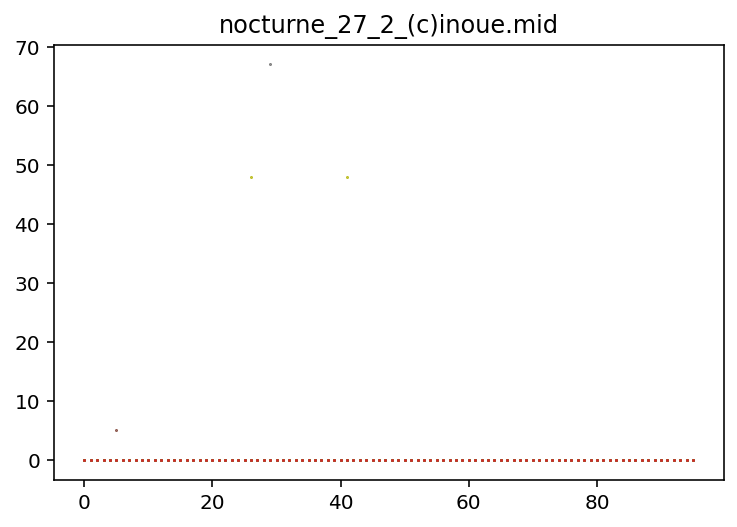

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


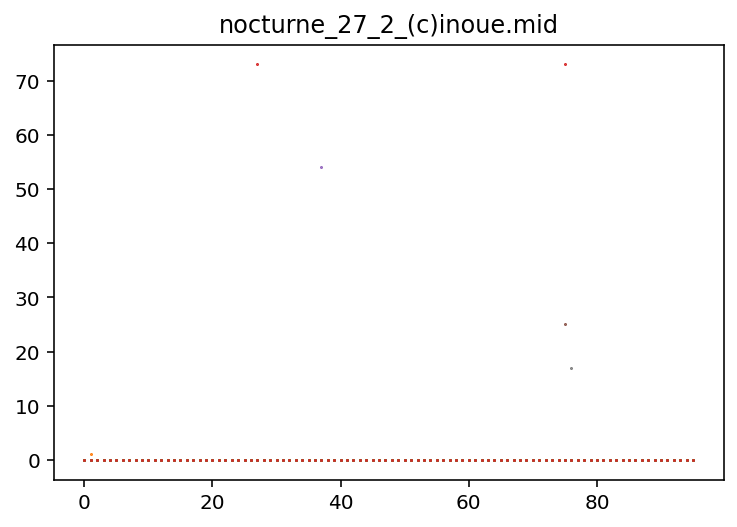

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


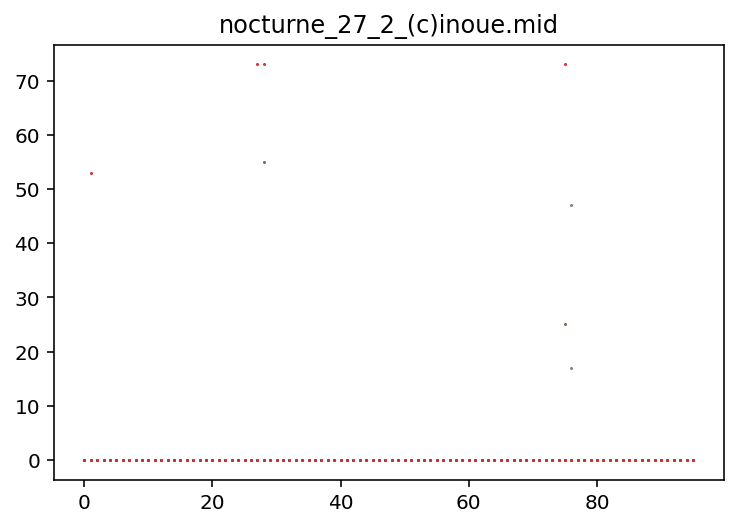

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


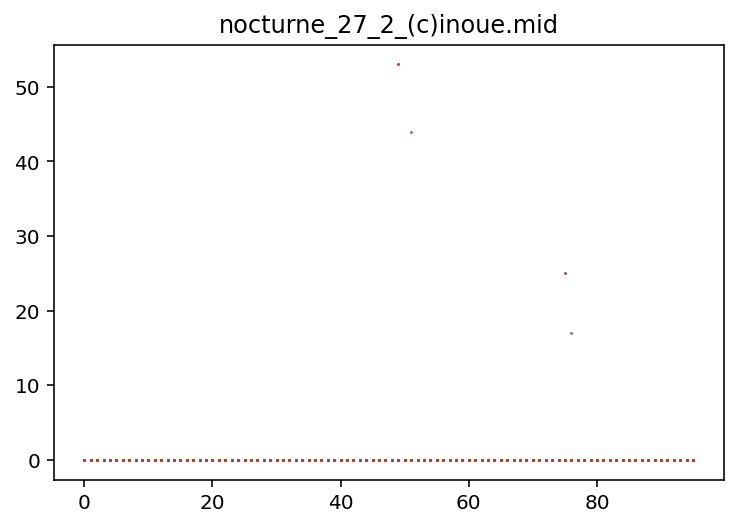

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


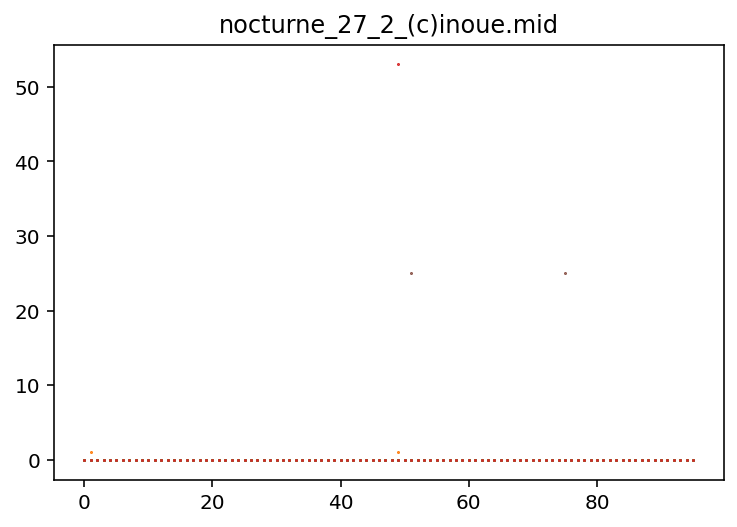

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


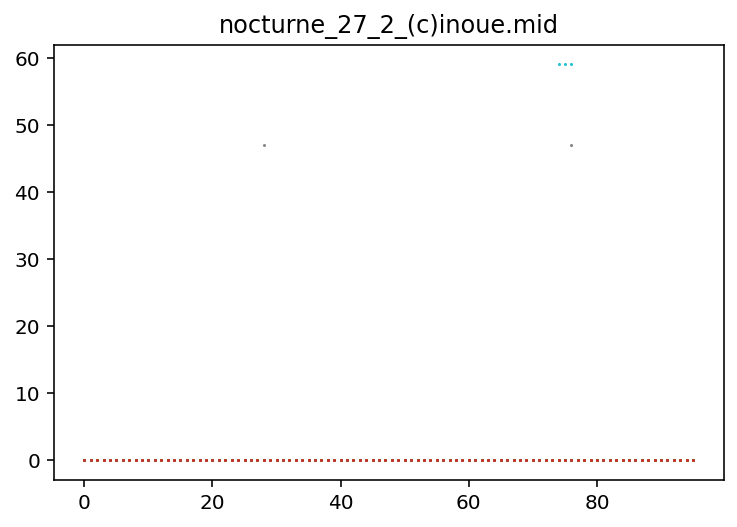

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


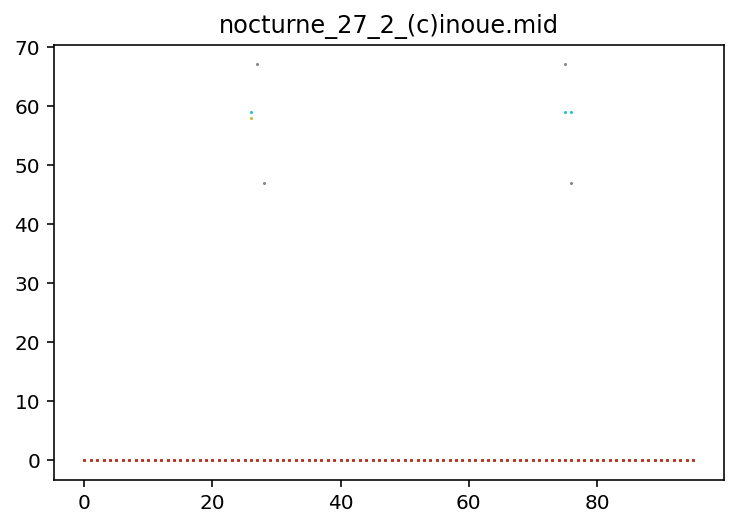

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


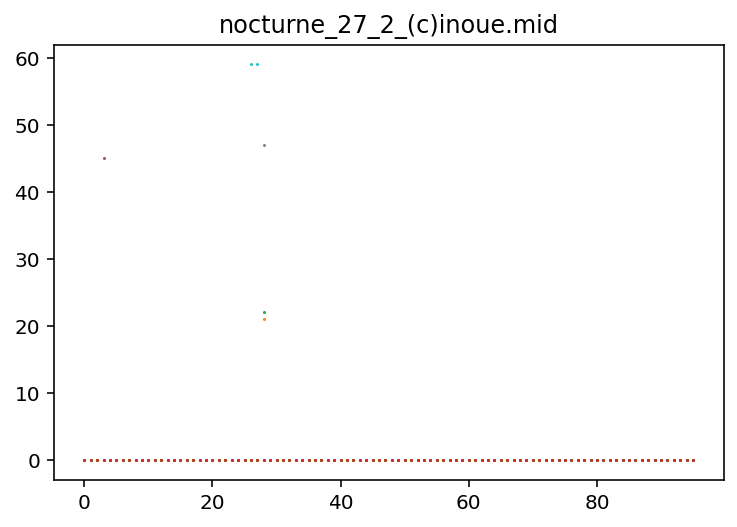

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


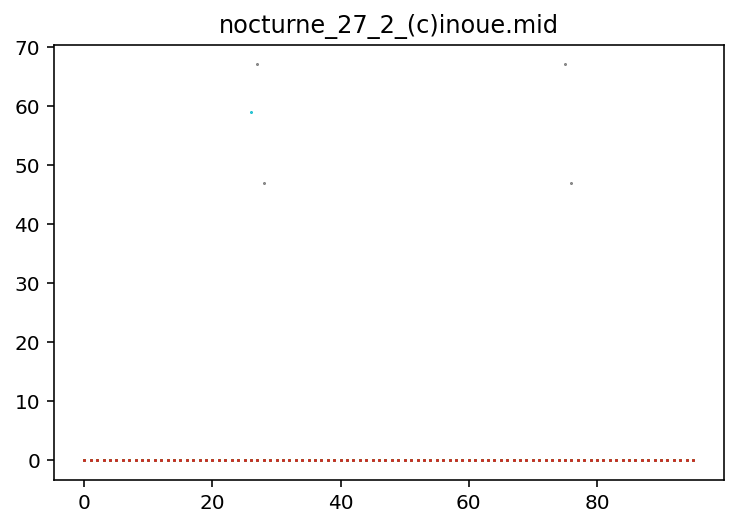

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


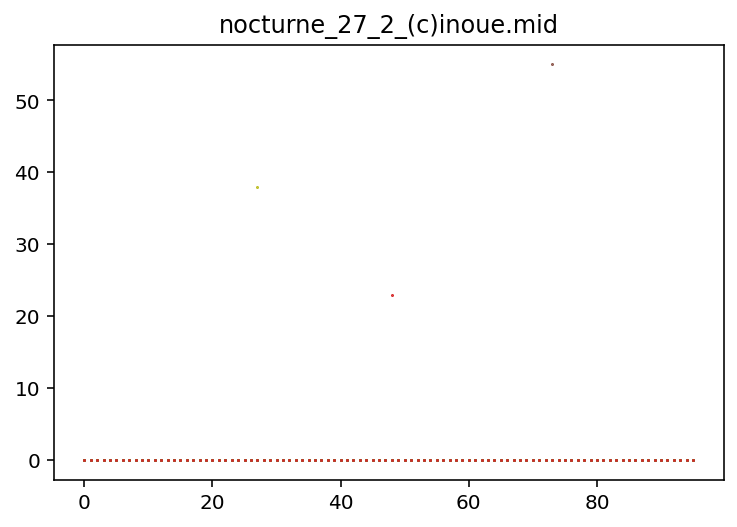

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


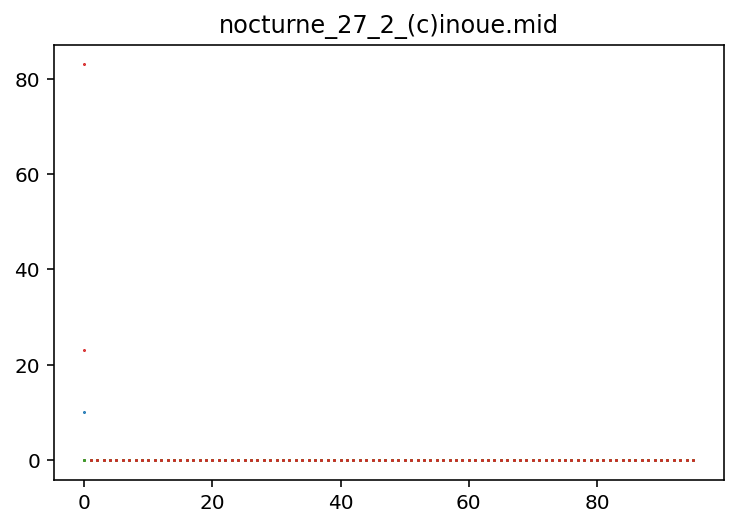

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


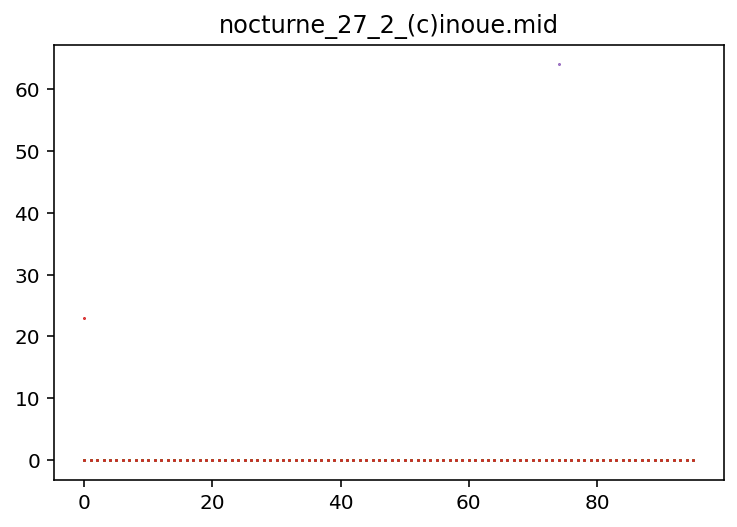

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


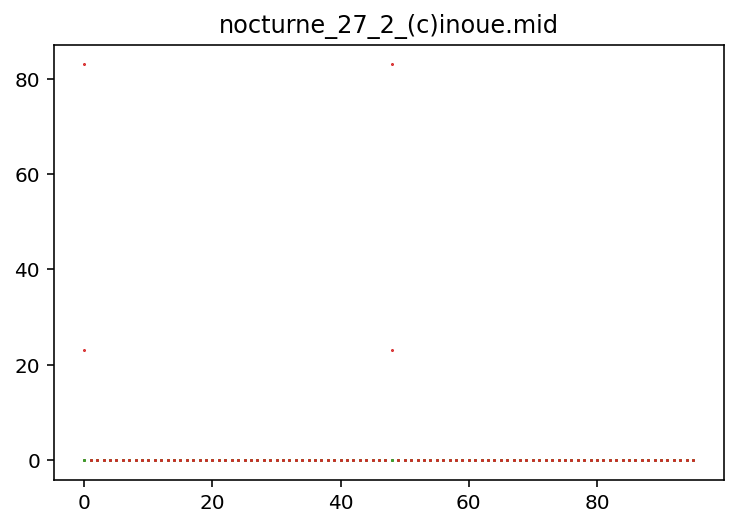

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


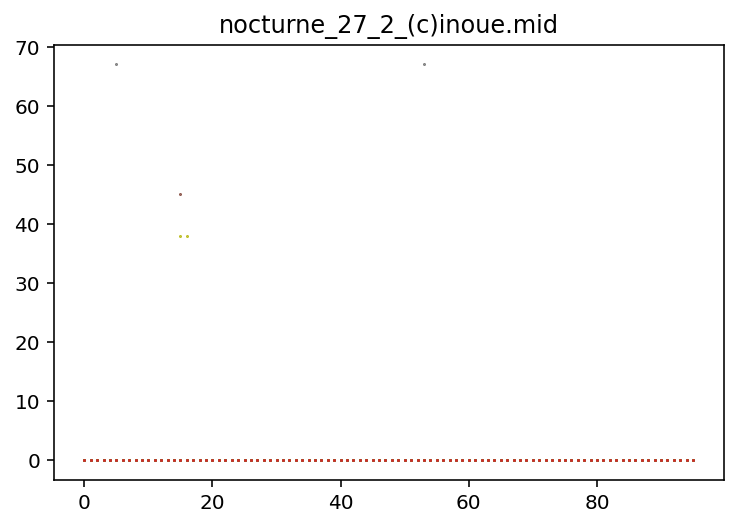

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


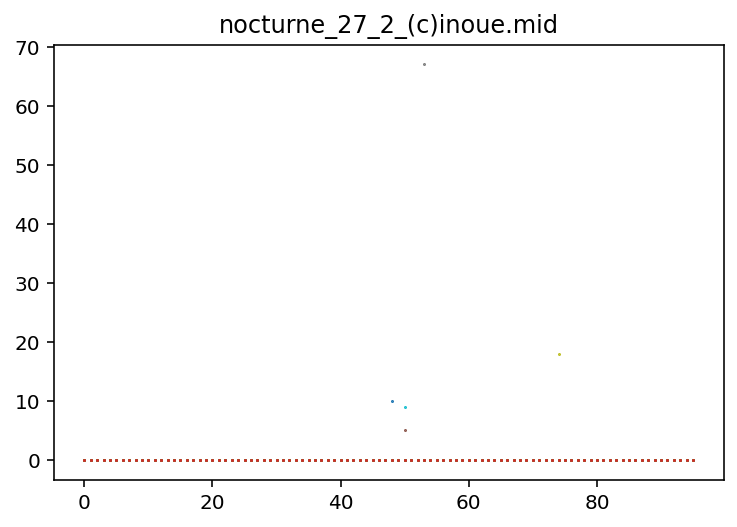

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


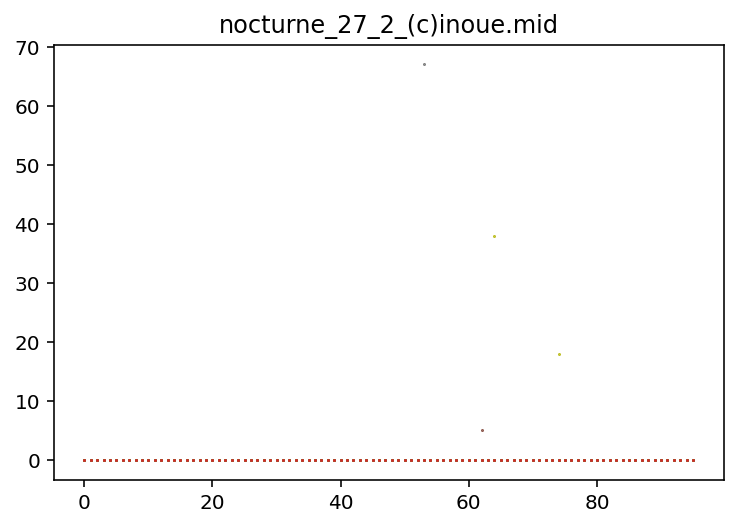

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


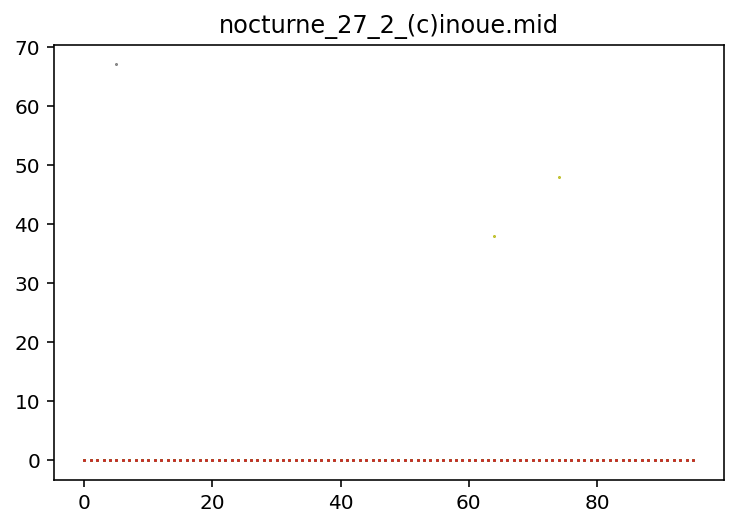

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


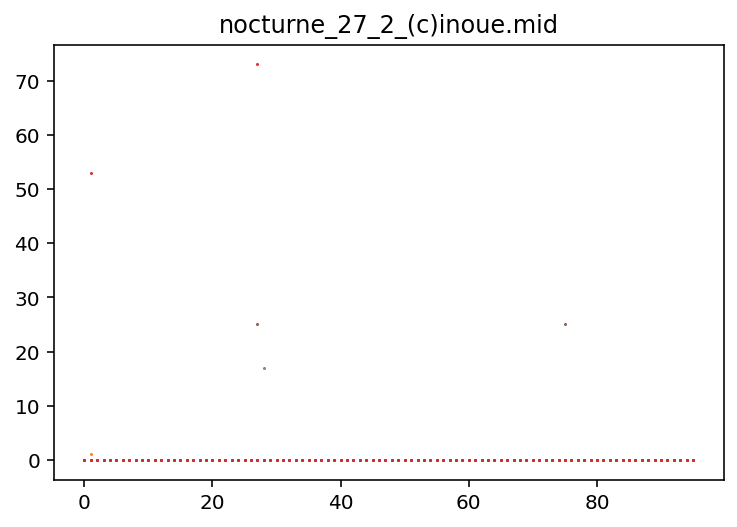

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


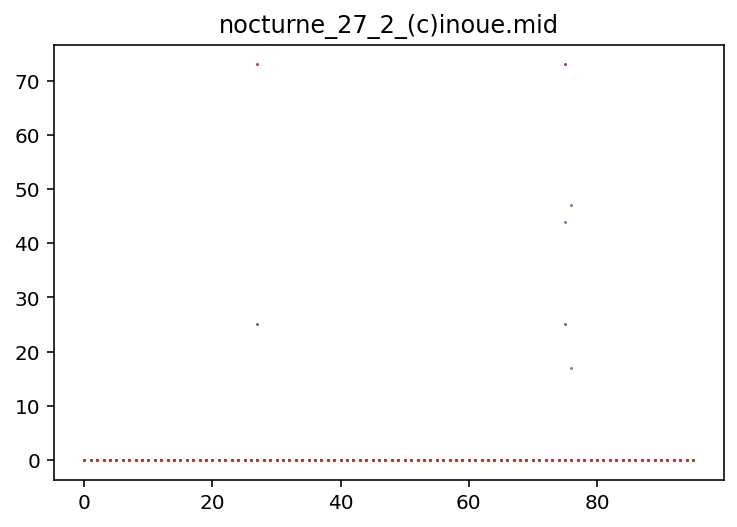

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


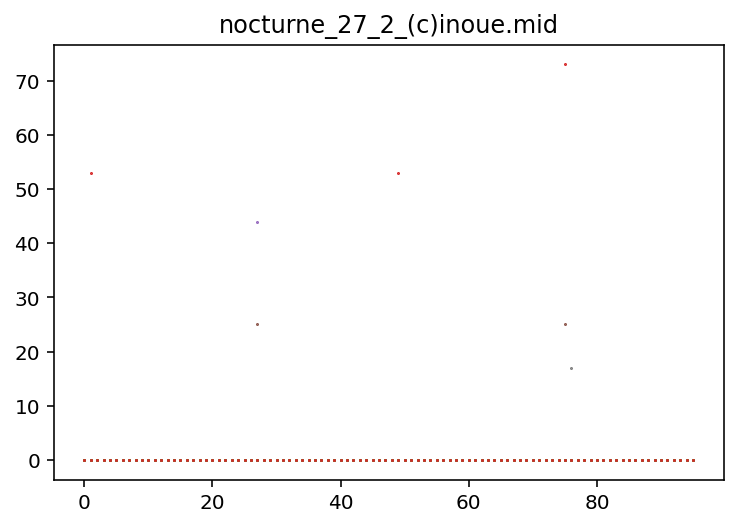

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


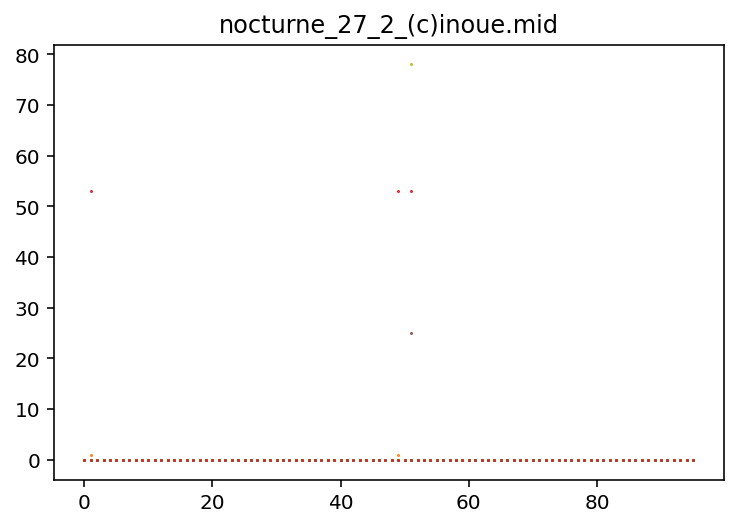

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


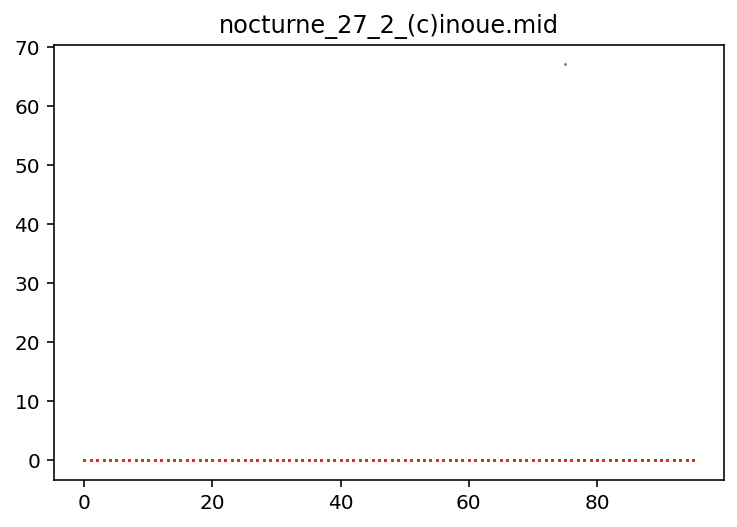

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


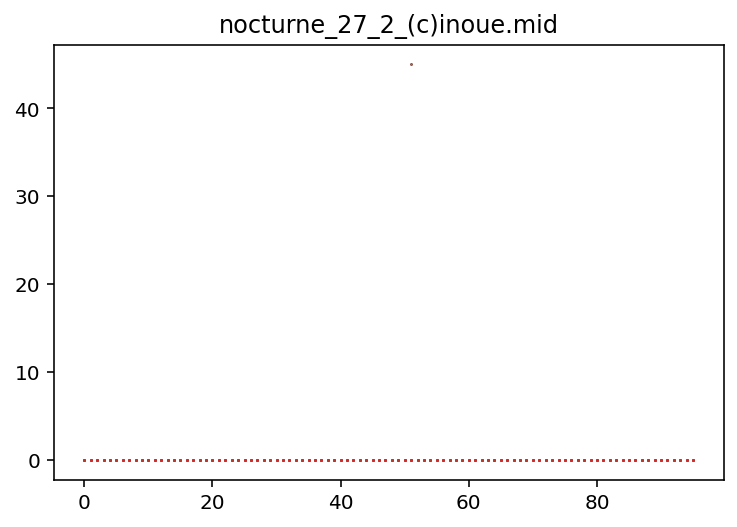

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


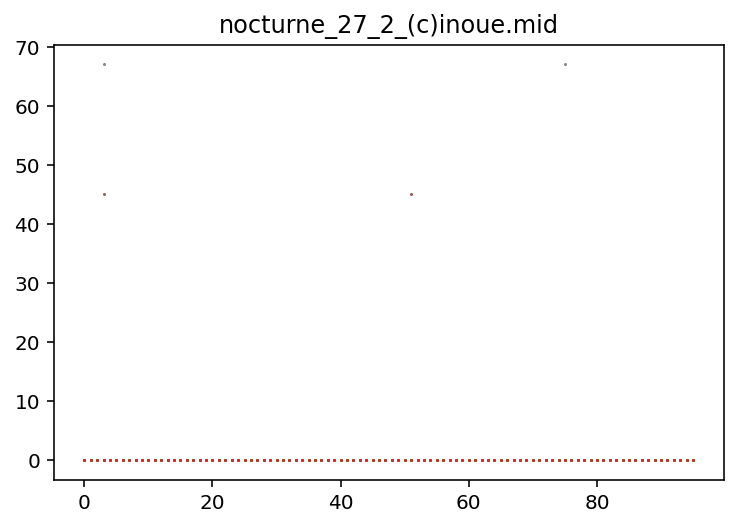

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


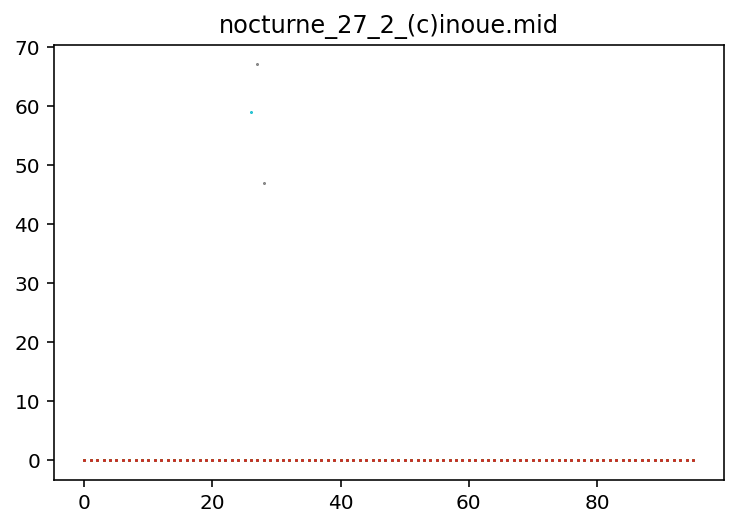

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


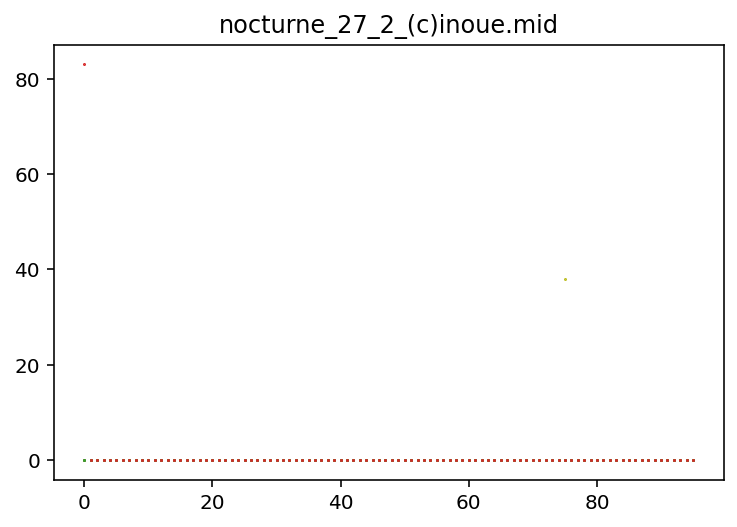

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


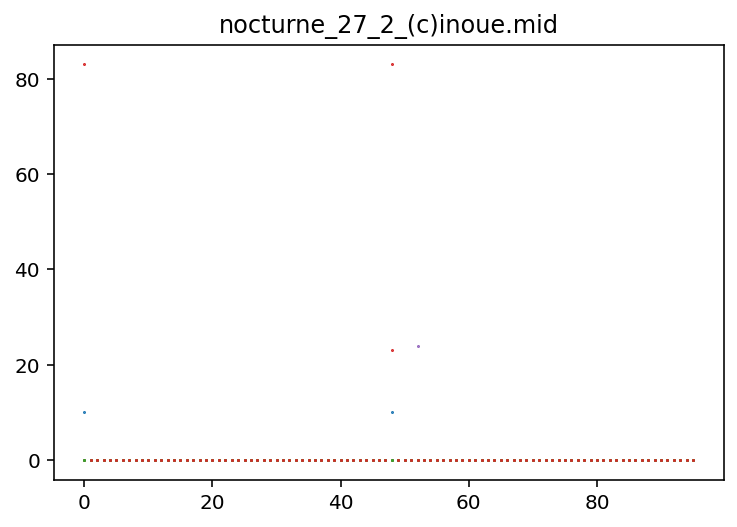

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


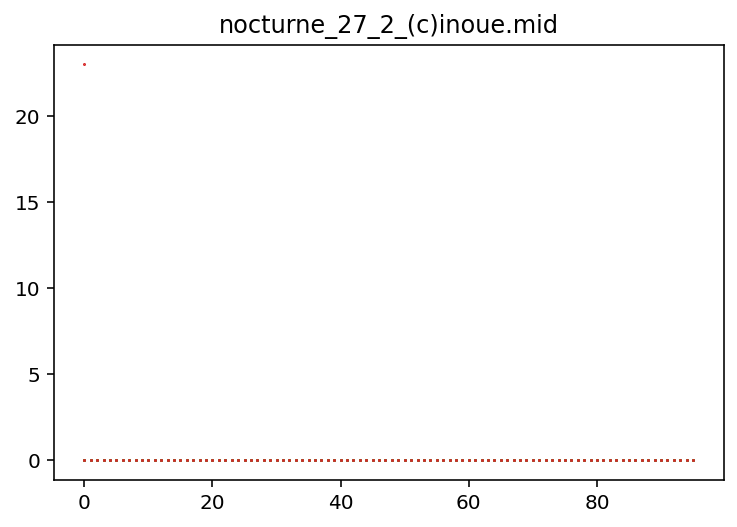

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


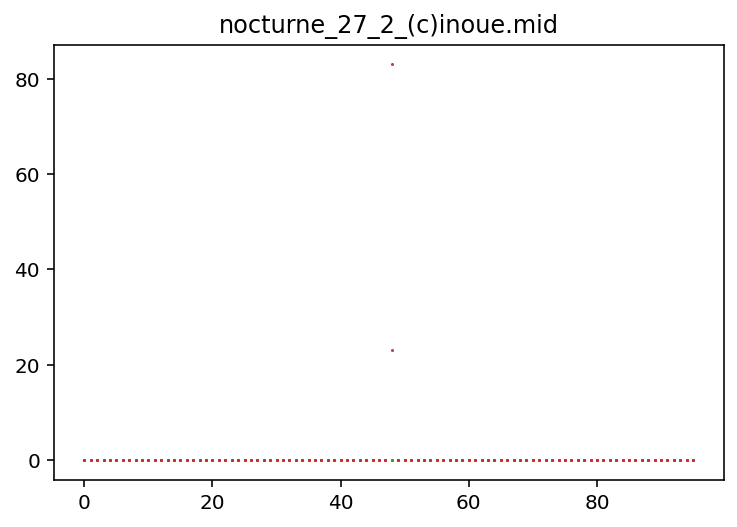

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


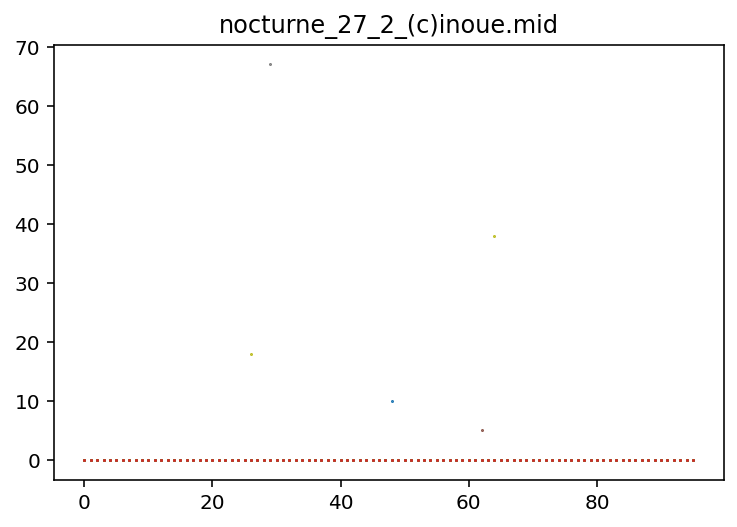

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


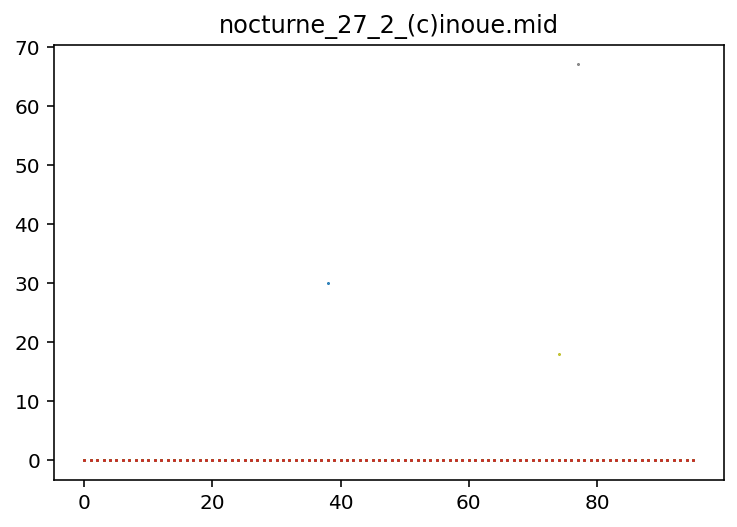

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


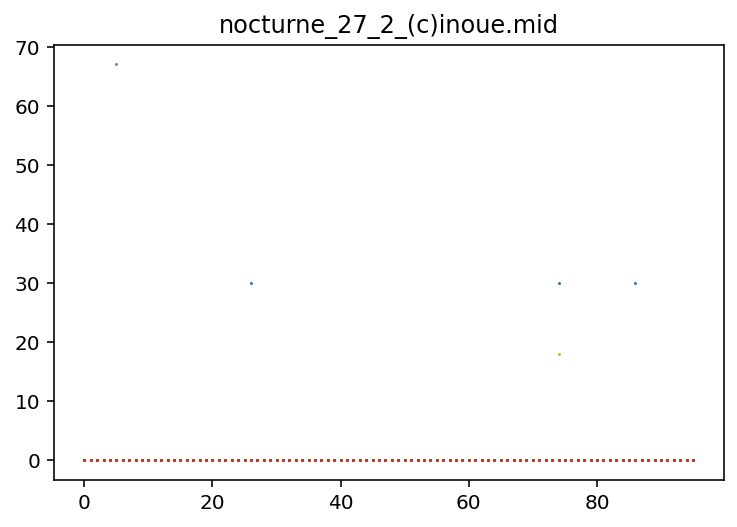

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


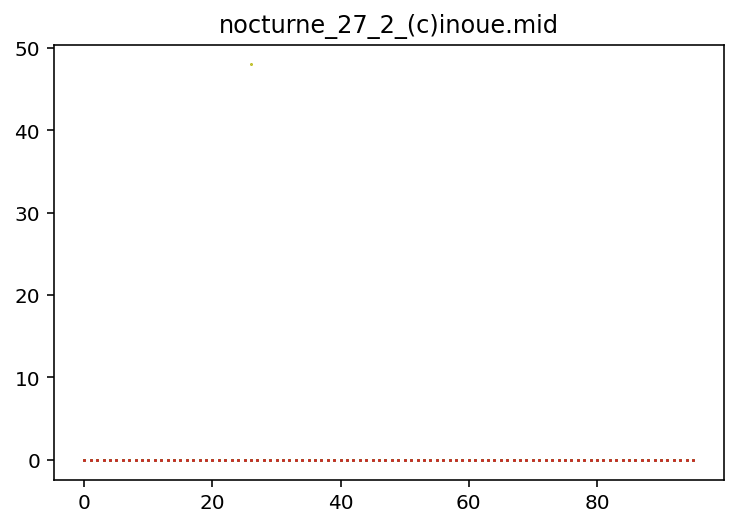

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


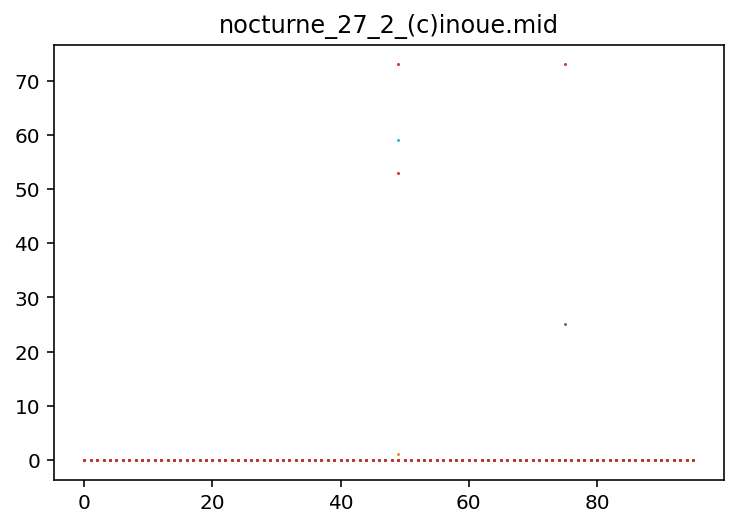

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


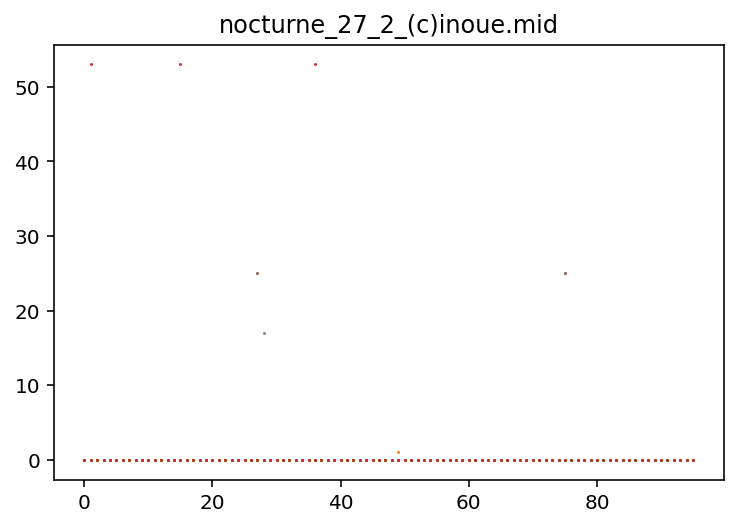

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


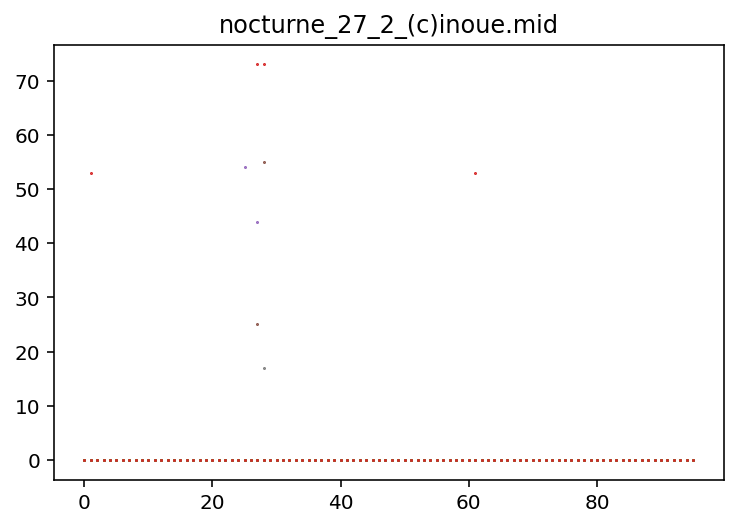

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


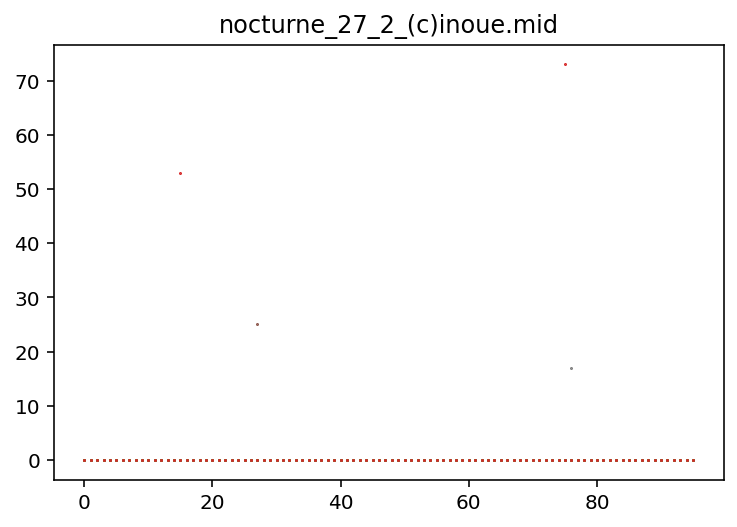

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0  99]
 [  0   0   0 ...   0   0 -99]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


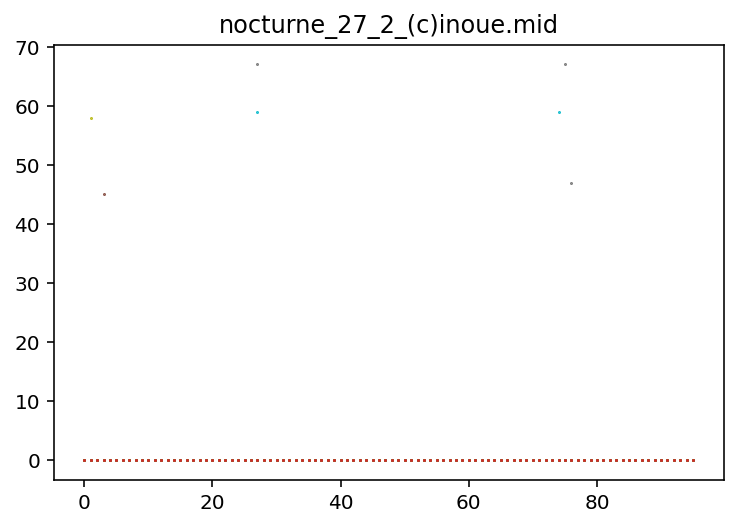

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


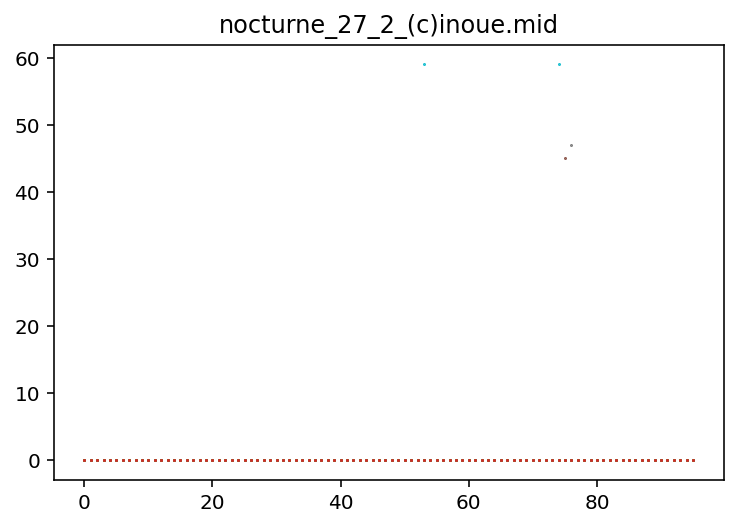

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


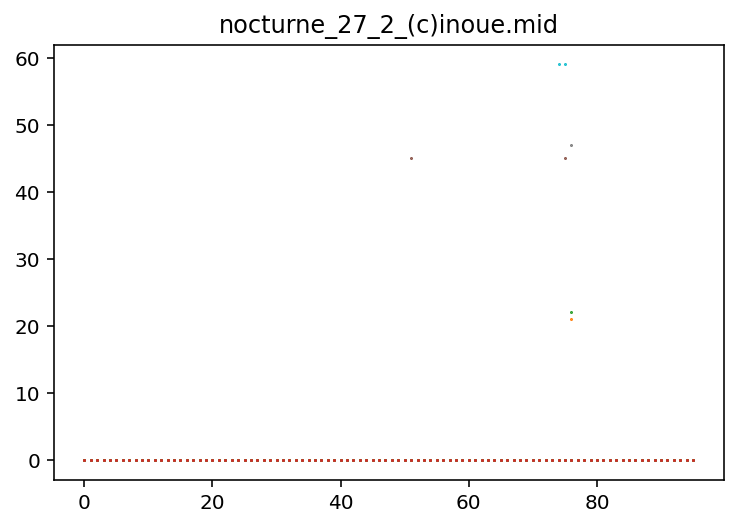

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


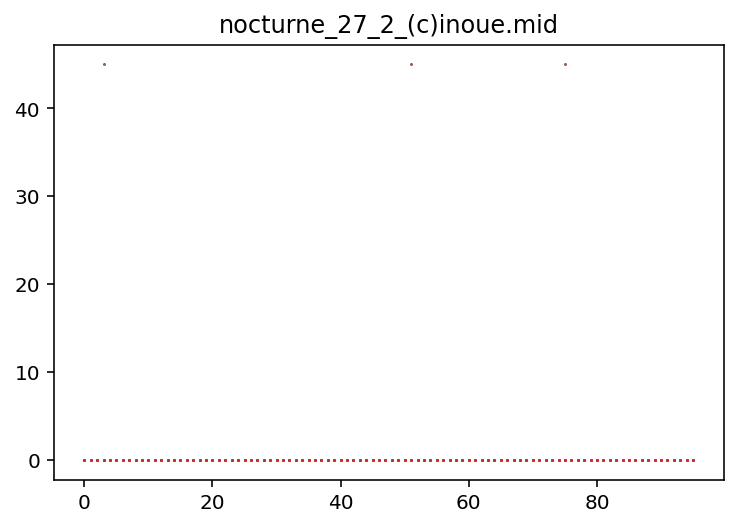

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


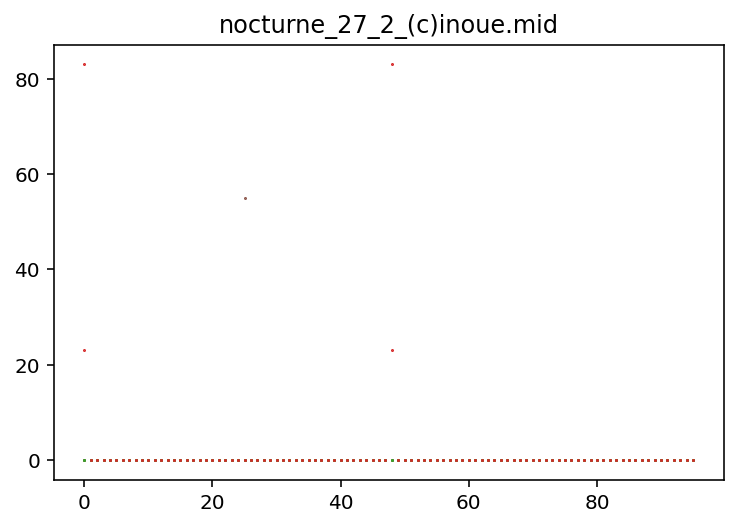

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


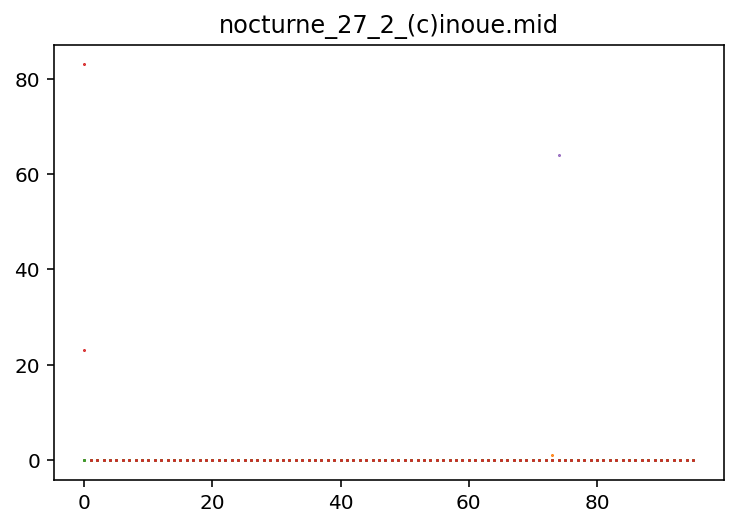

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


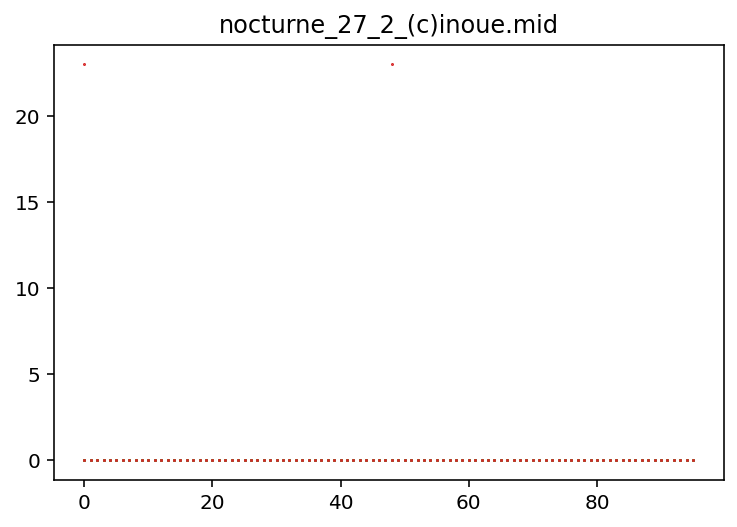

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


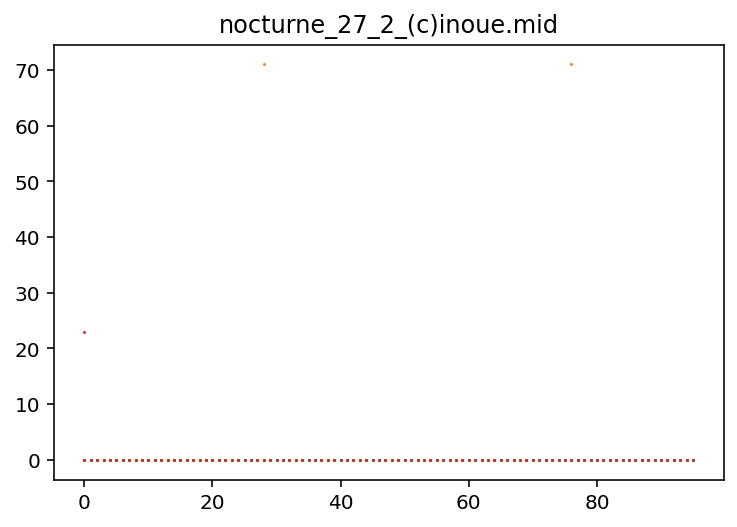

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


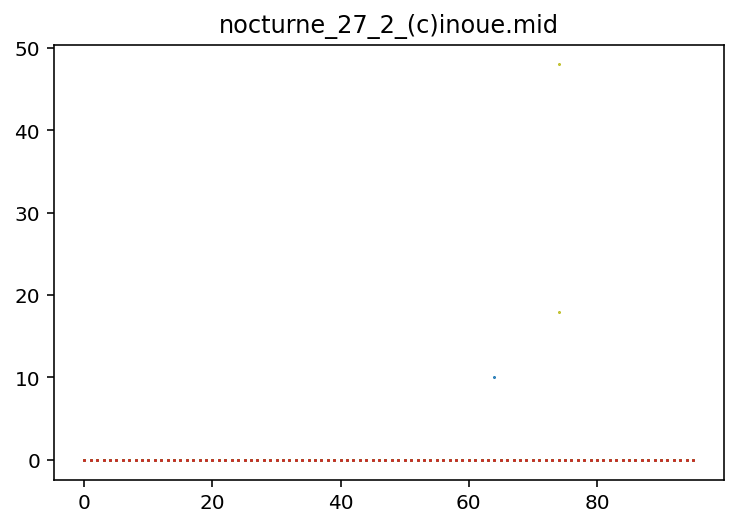

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


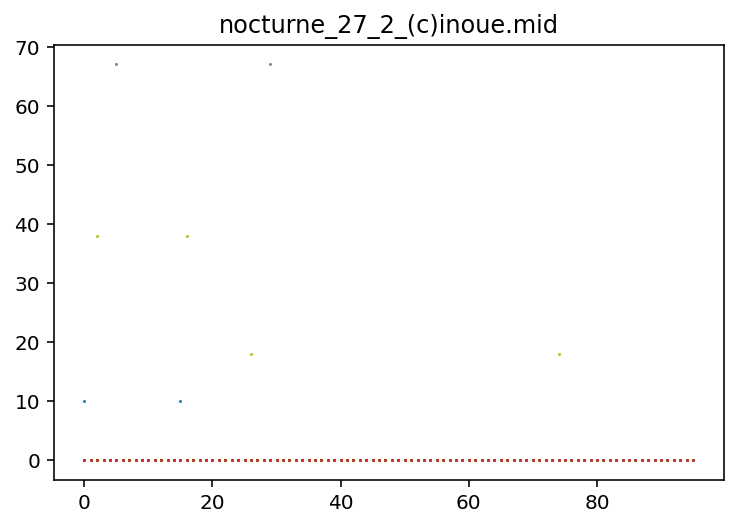

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


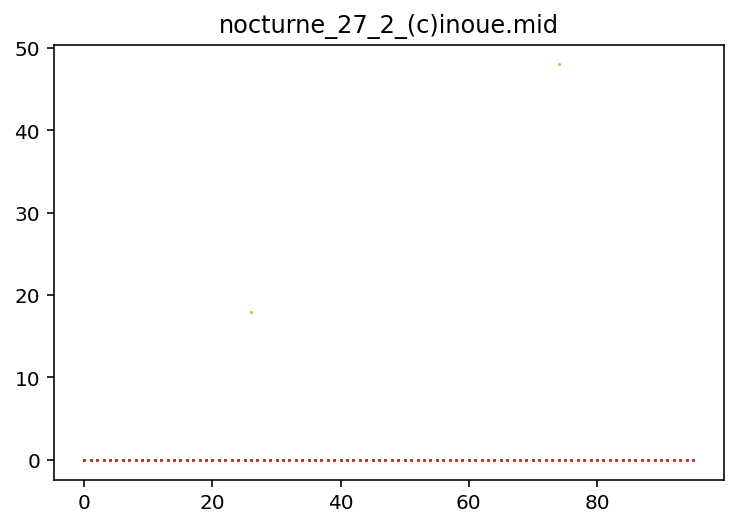

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


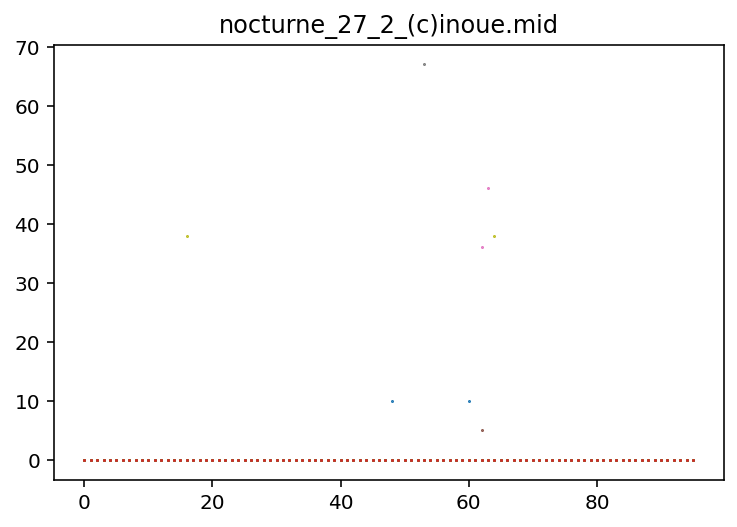

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


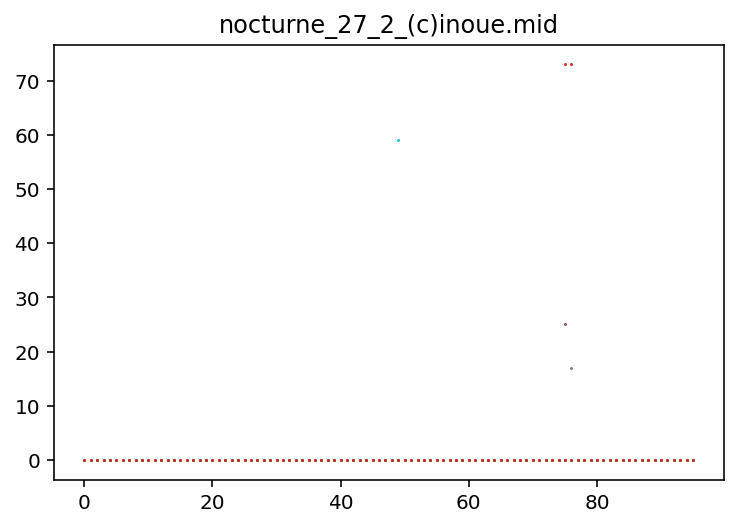

<ipython-input-17-248469b3524a>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


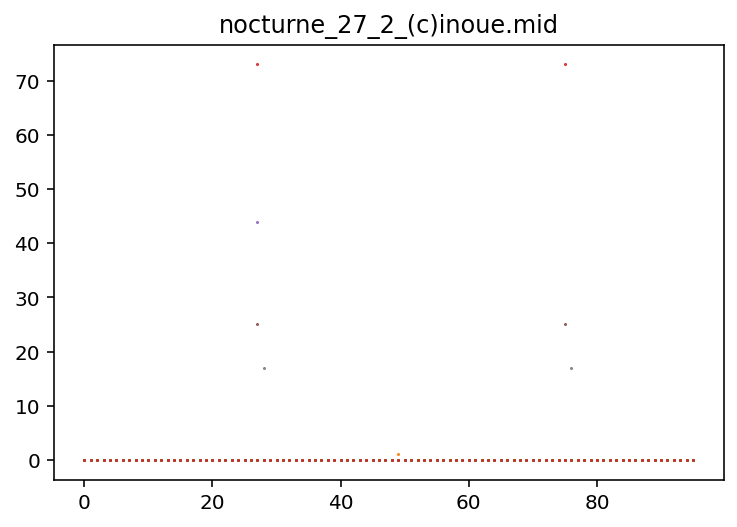

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


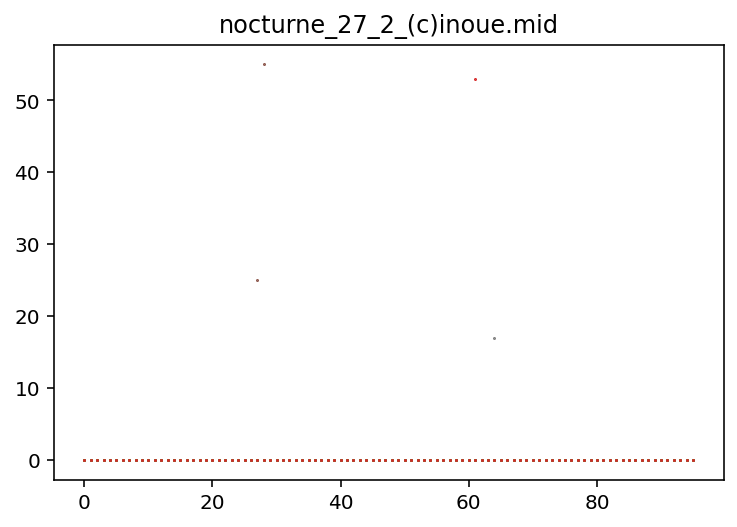

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


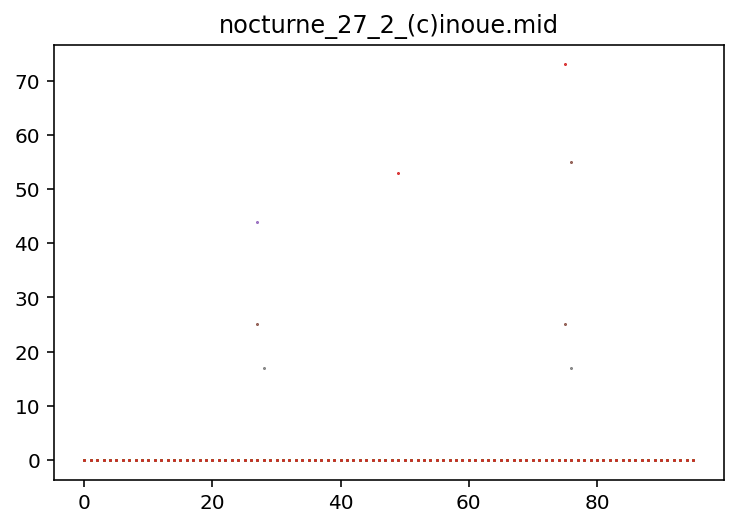

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0  99]
 [  0   0   0 ...   0   0 -99]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


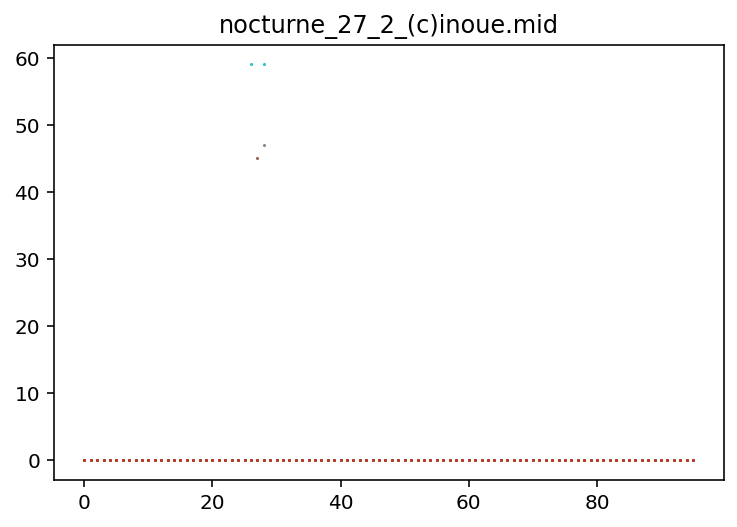

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


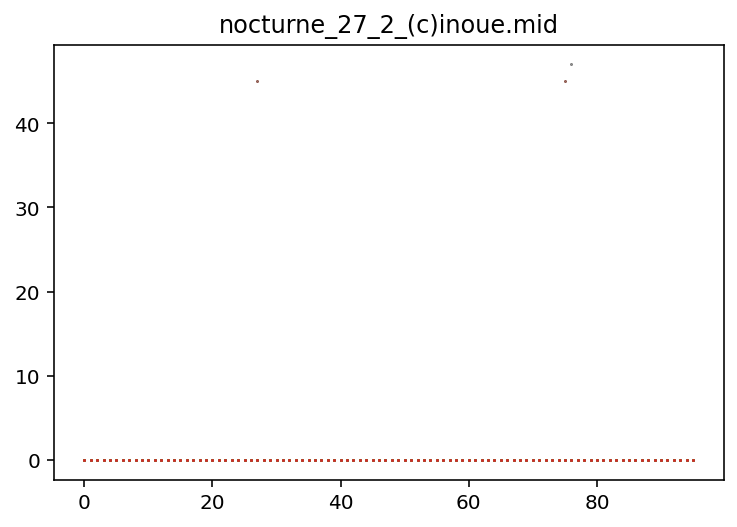

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


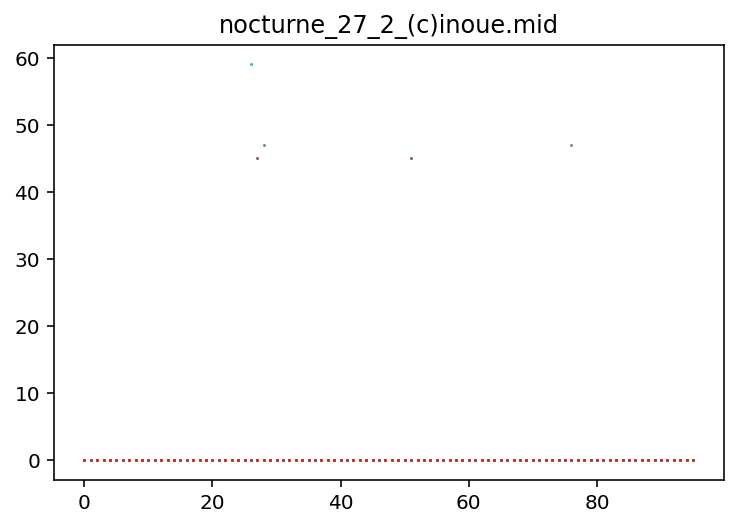

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


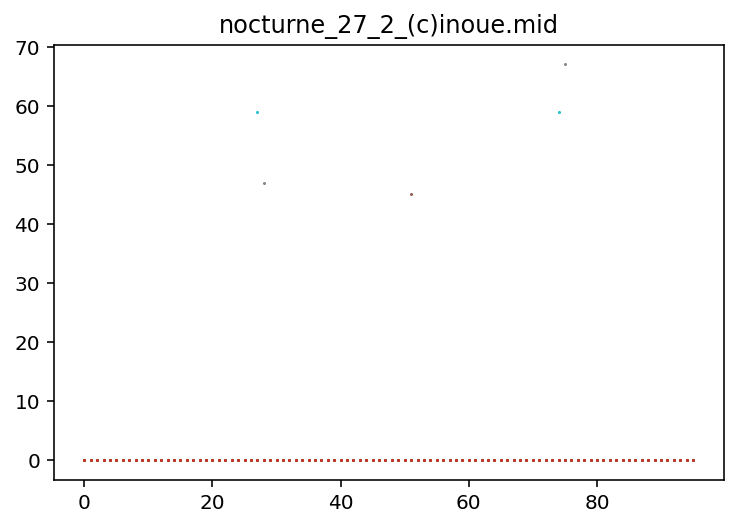

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


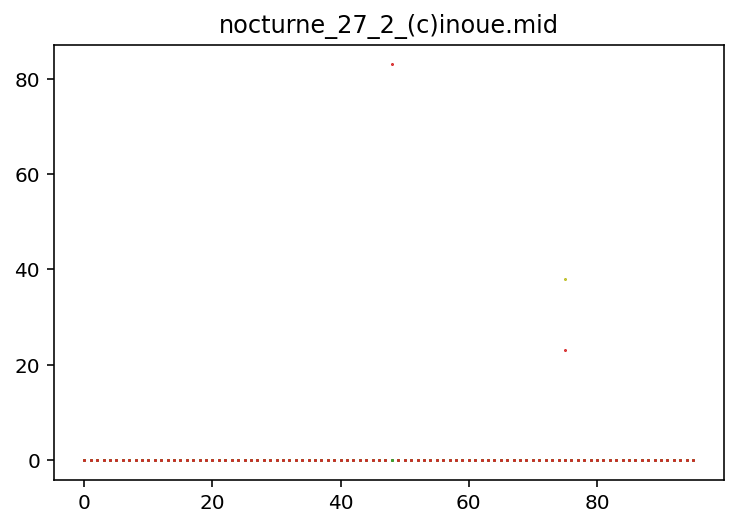

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


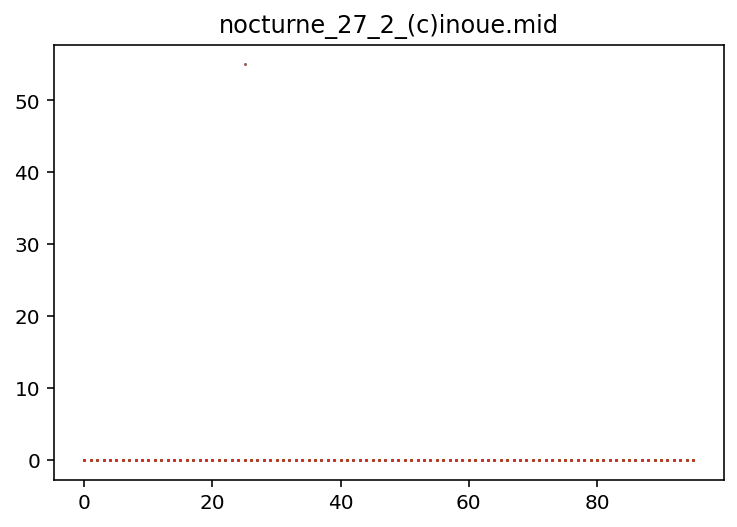

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


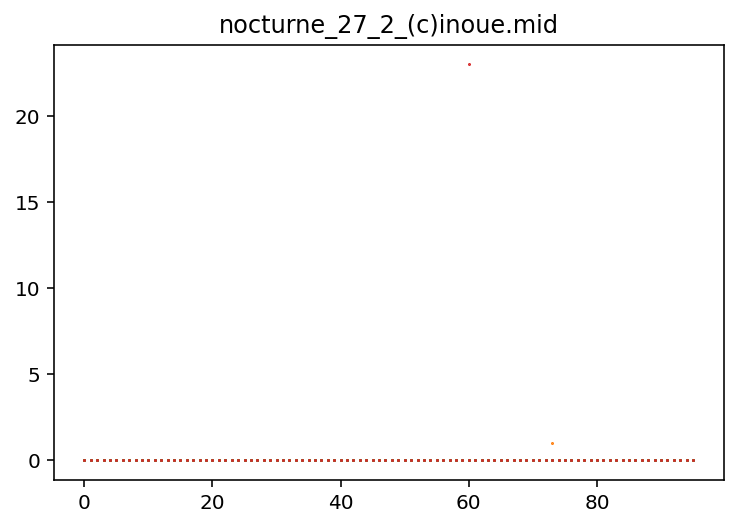

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


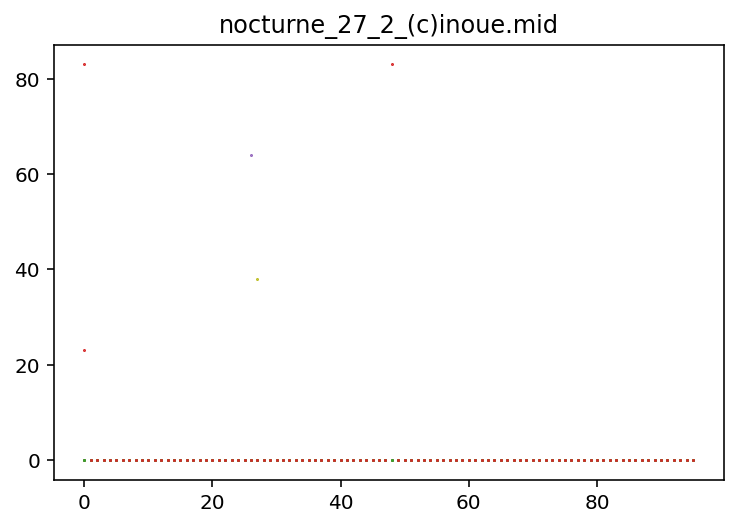

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


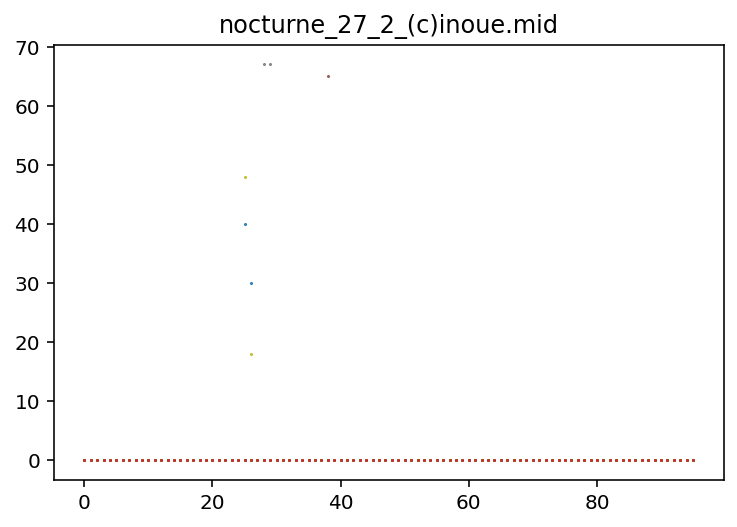

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


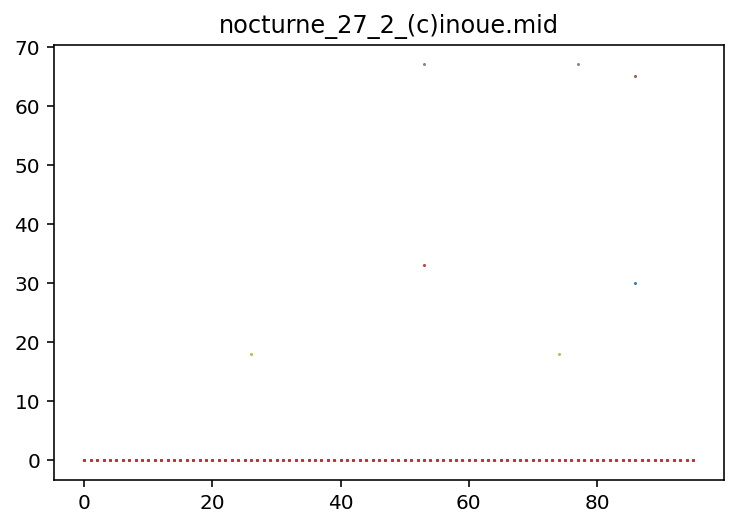

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


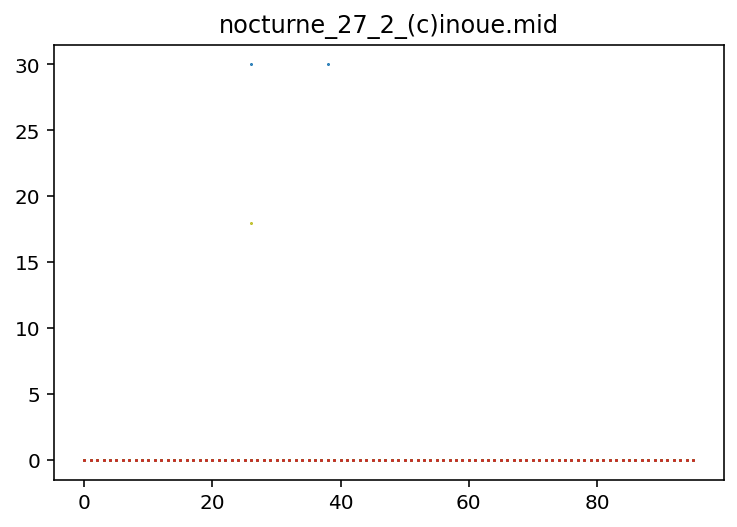

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


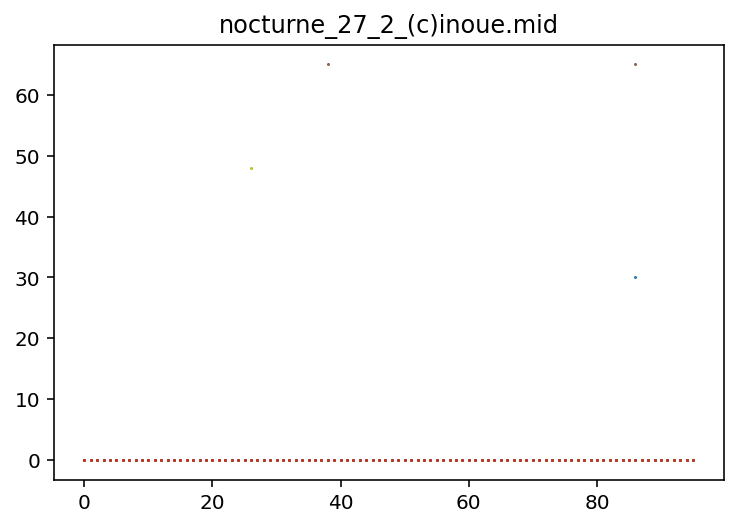

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


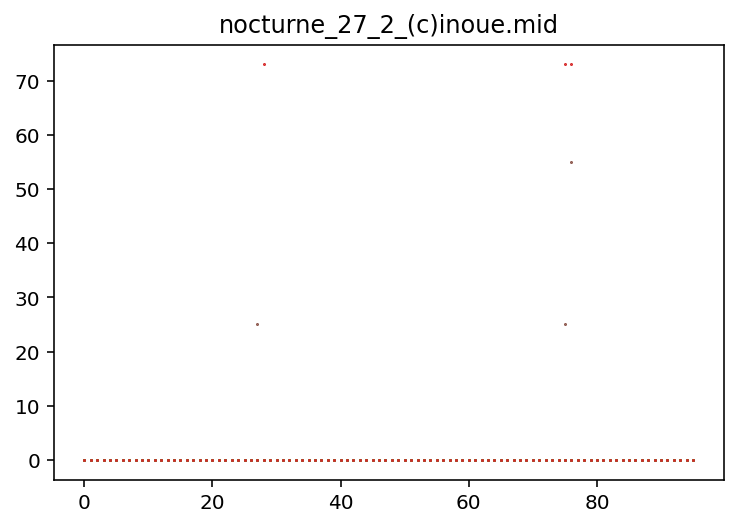

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


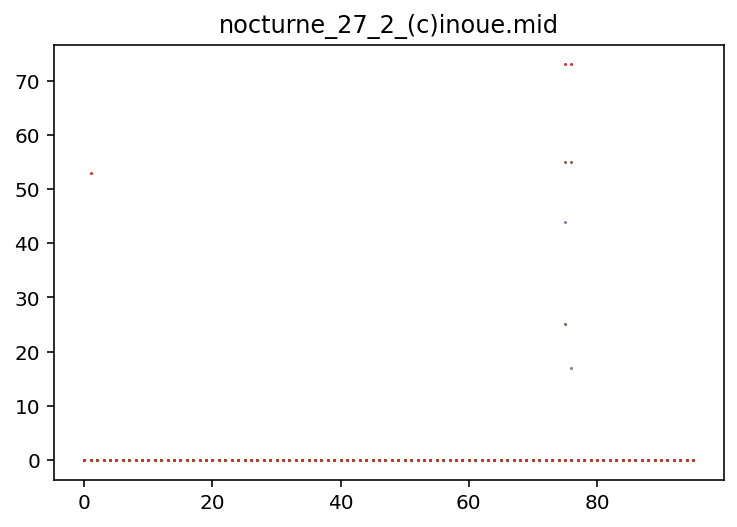

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


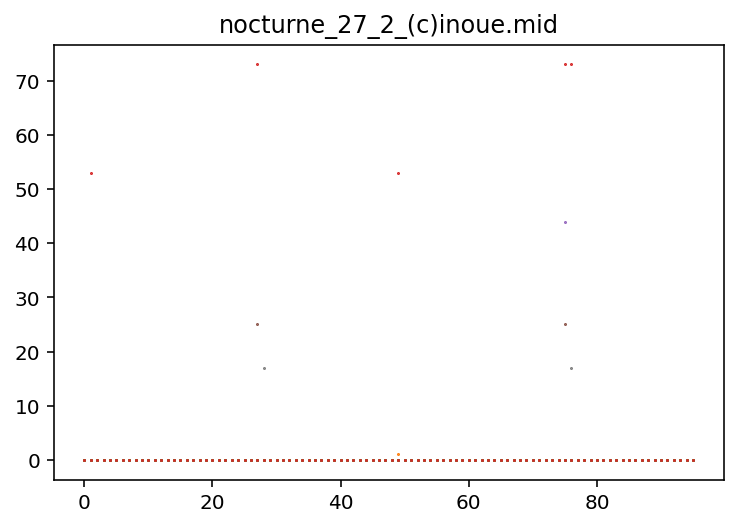

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


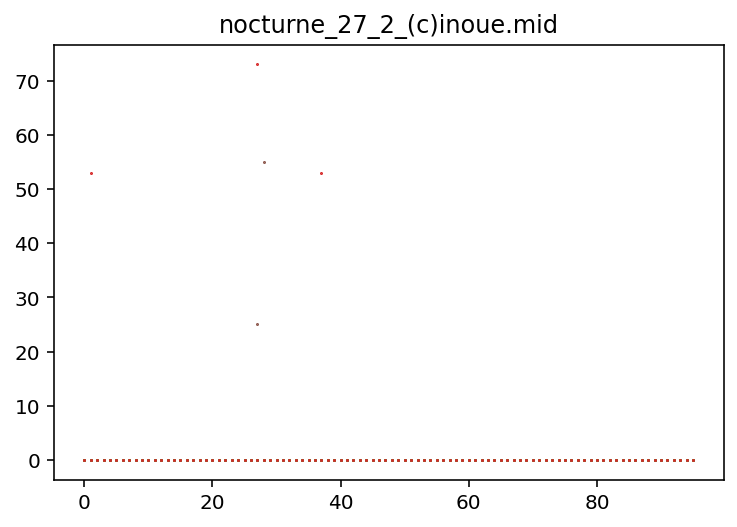

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


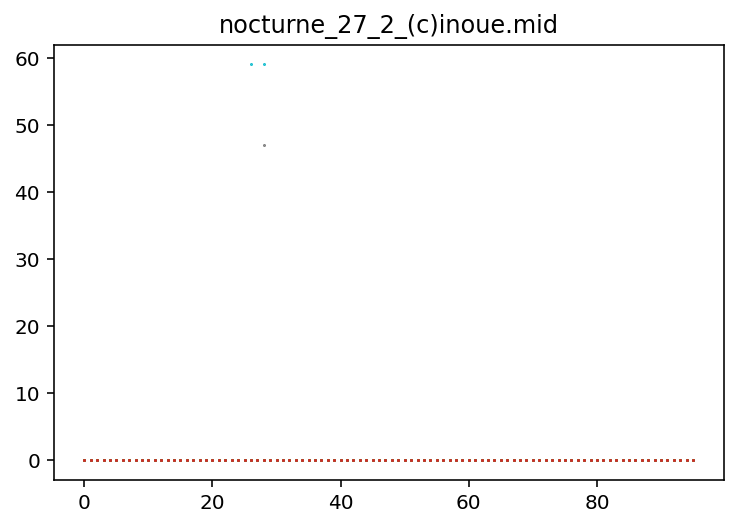

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


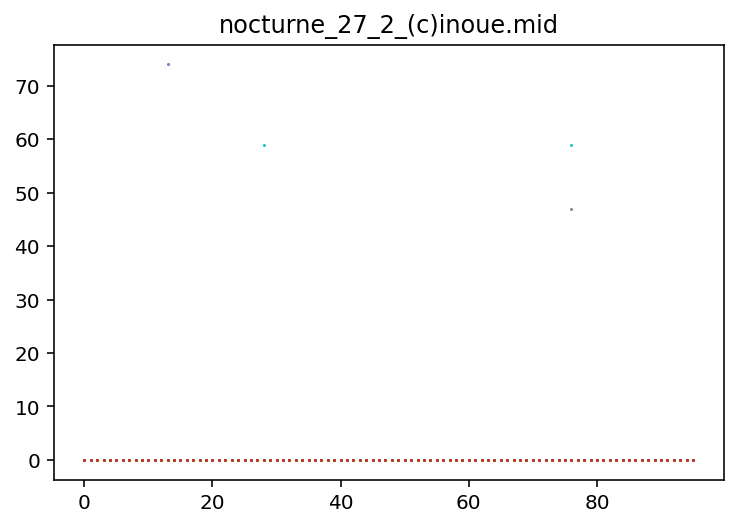

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


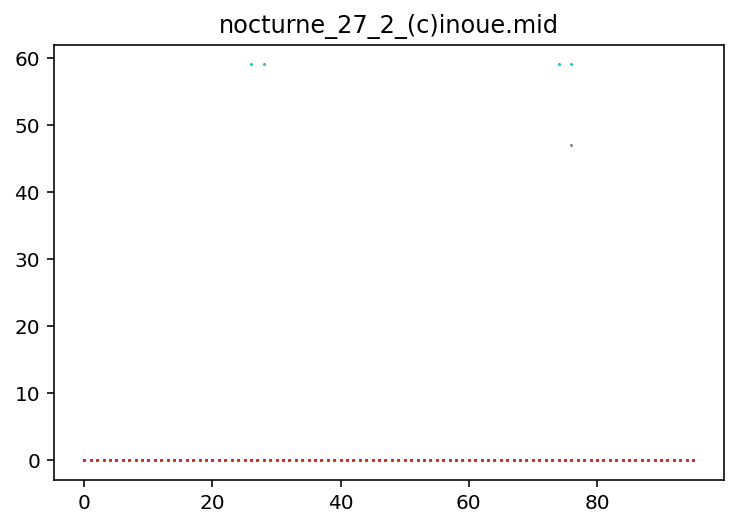

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


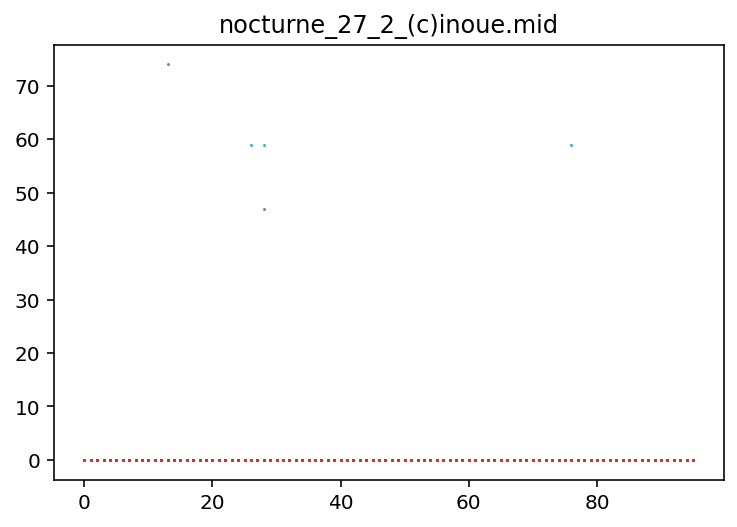

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


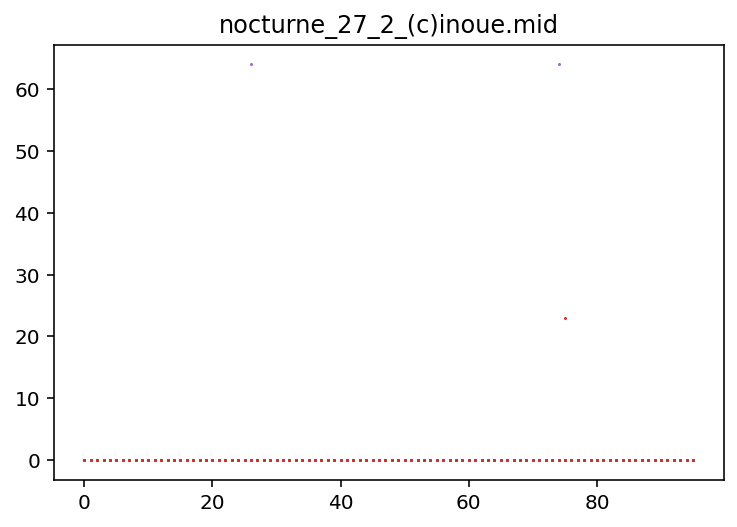

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


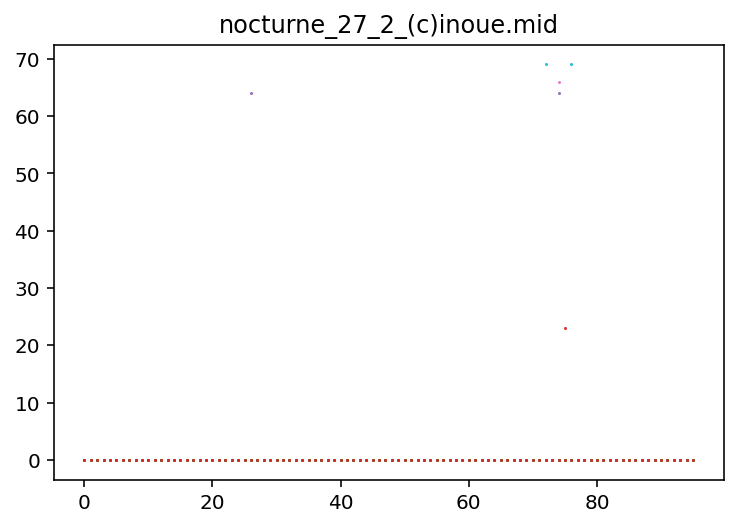

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


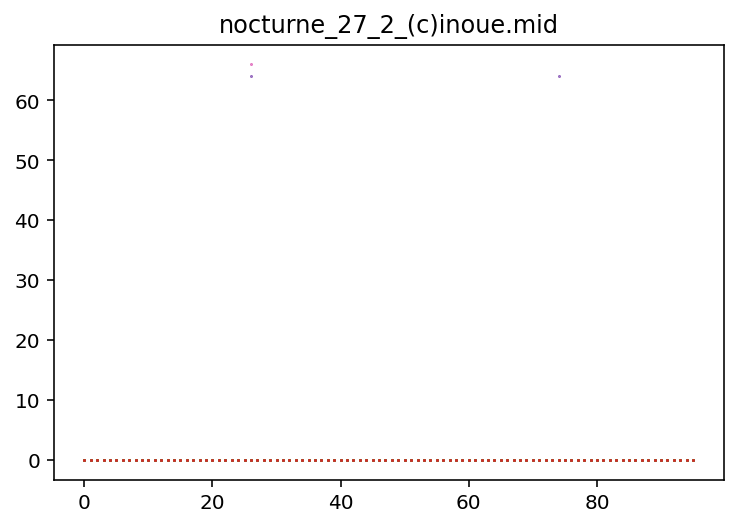

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


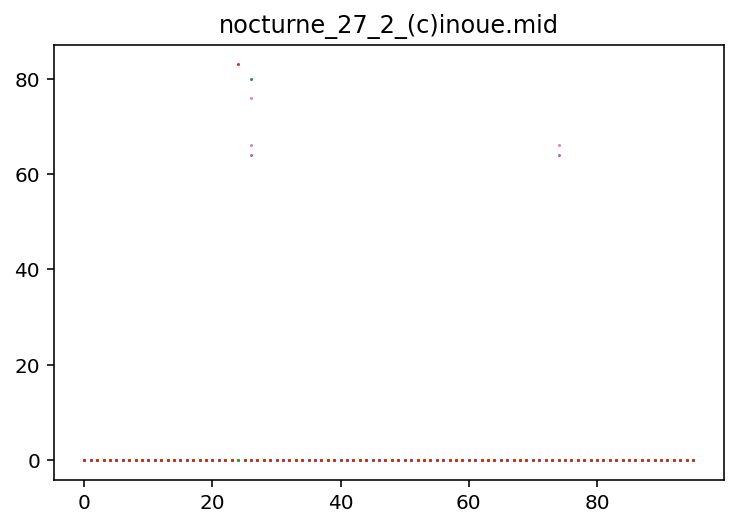

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


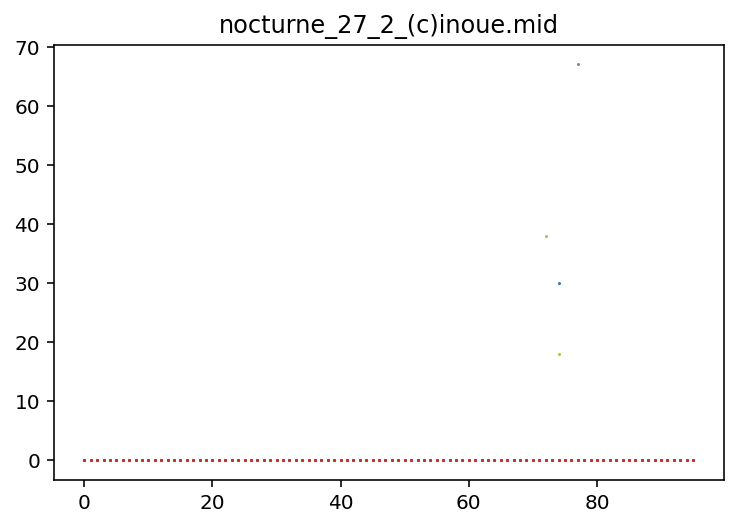

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


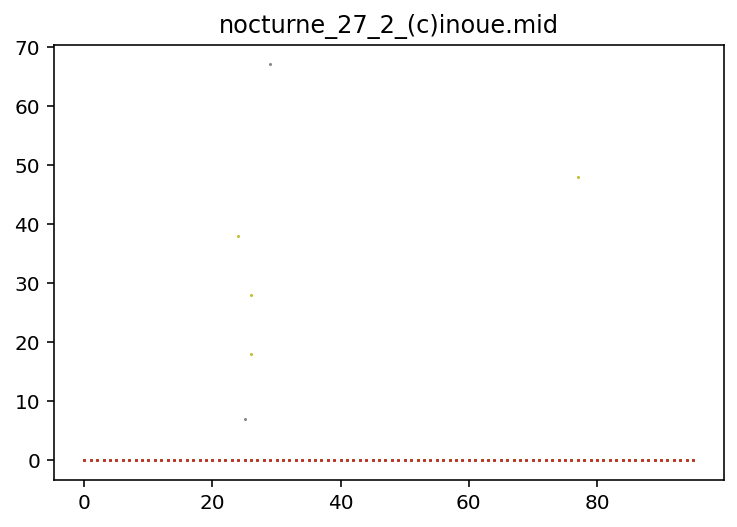

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


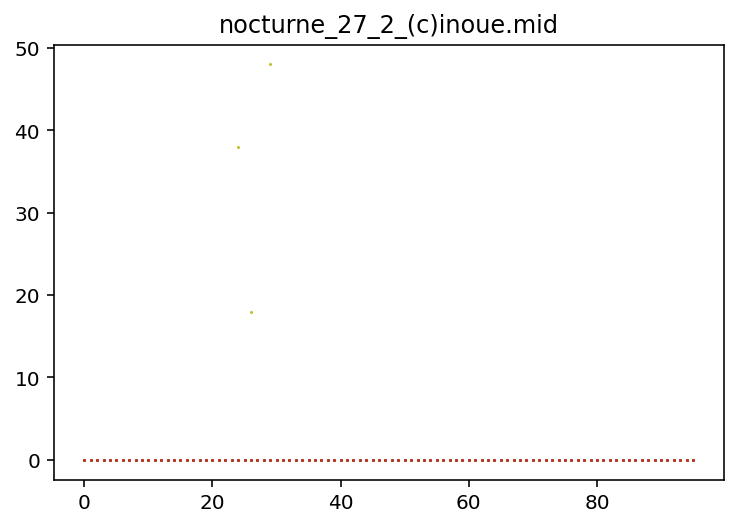

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


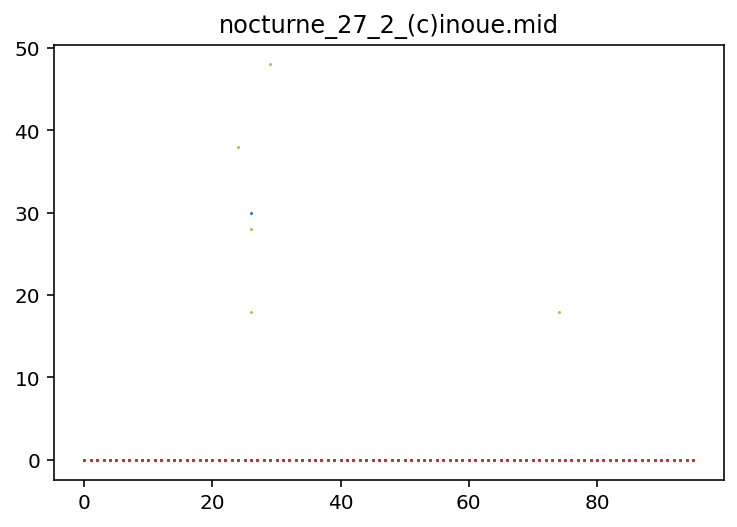

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


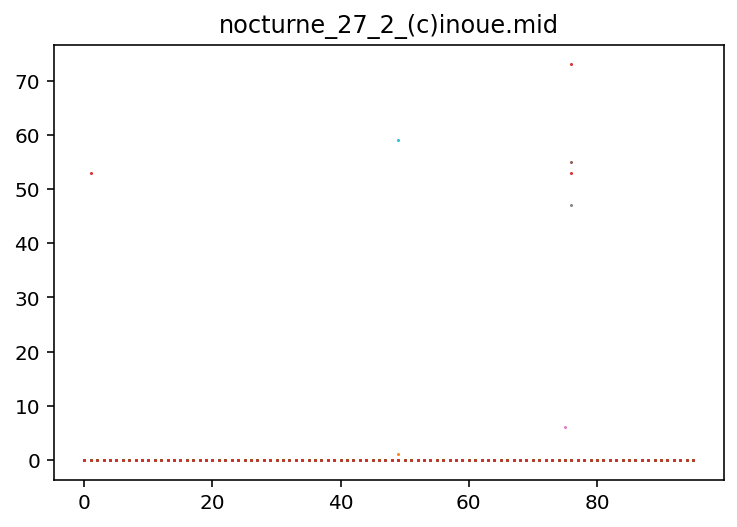

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


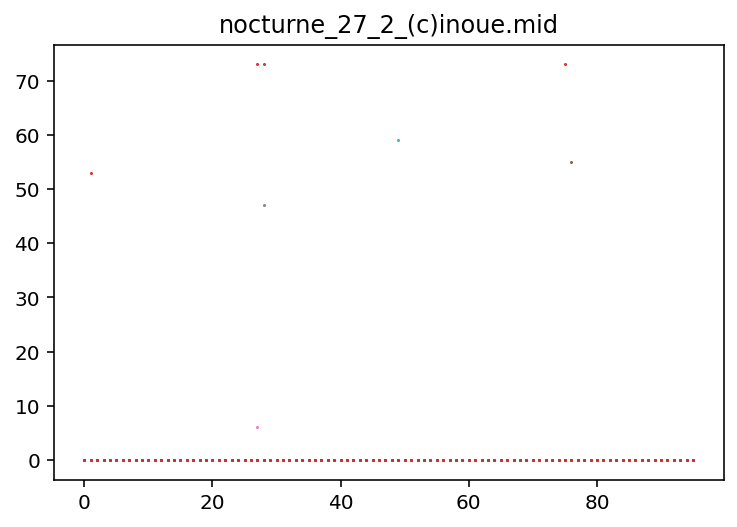

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


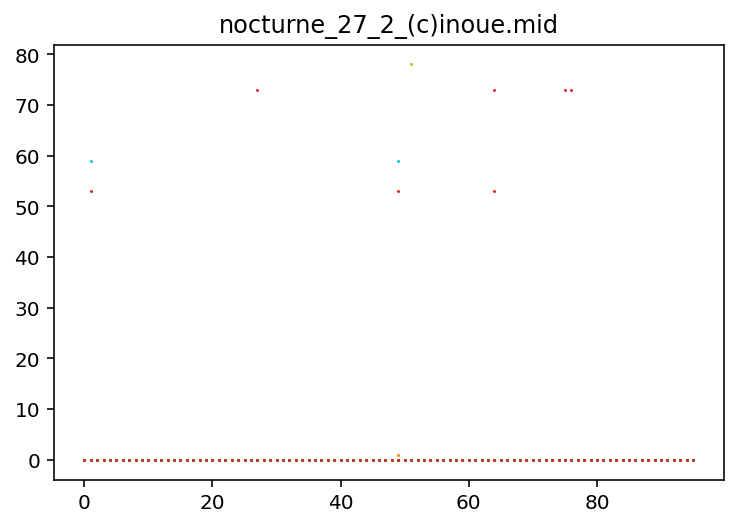

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


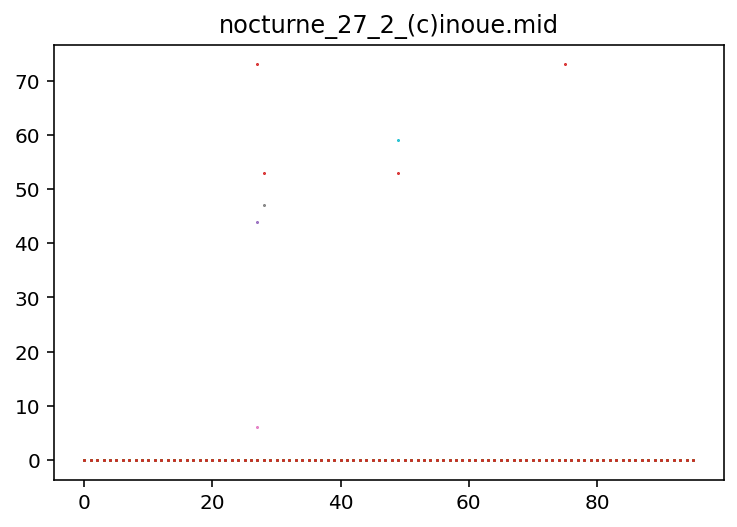

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


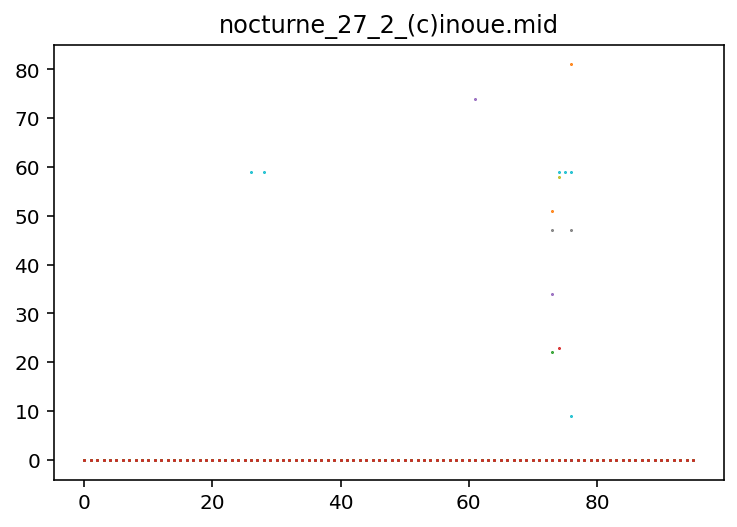

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


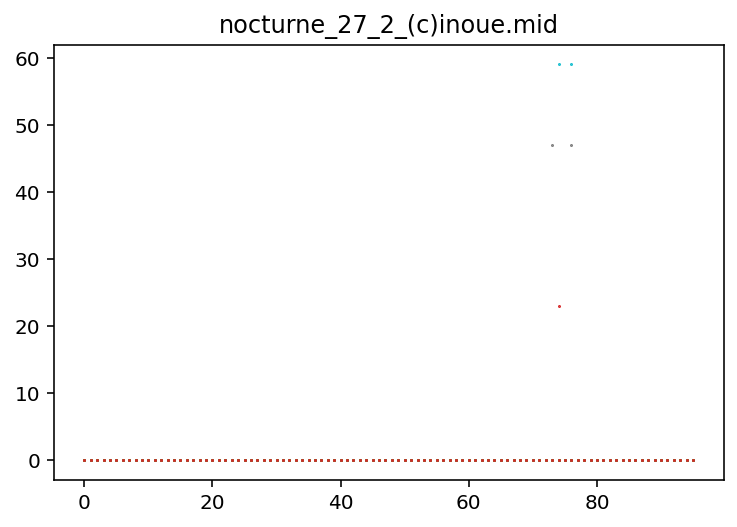

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


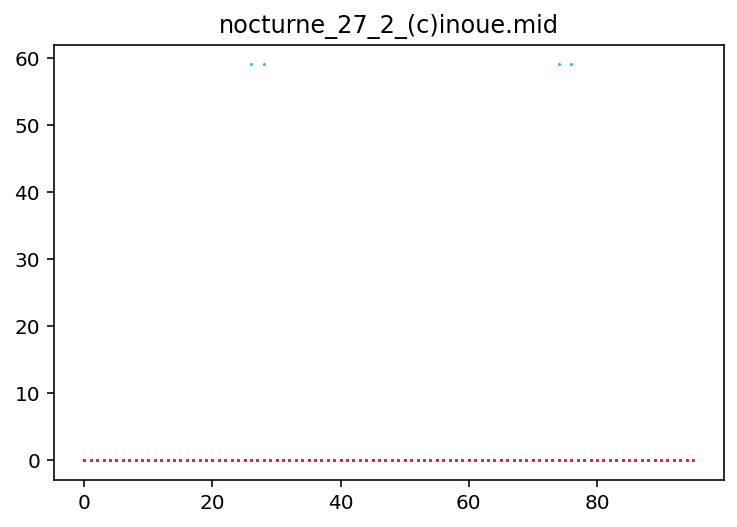

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


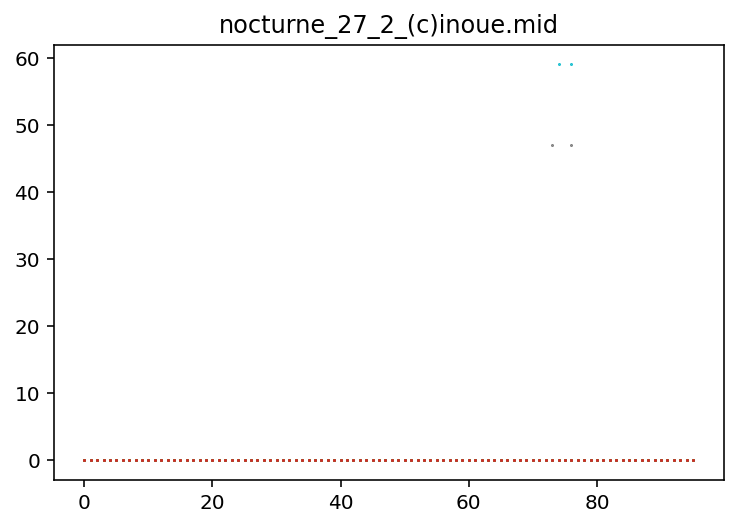

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


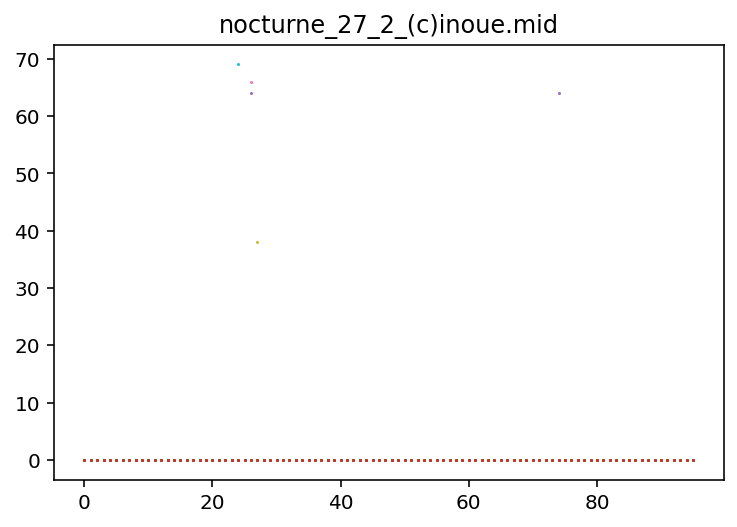

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


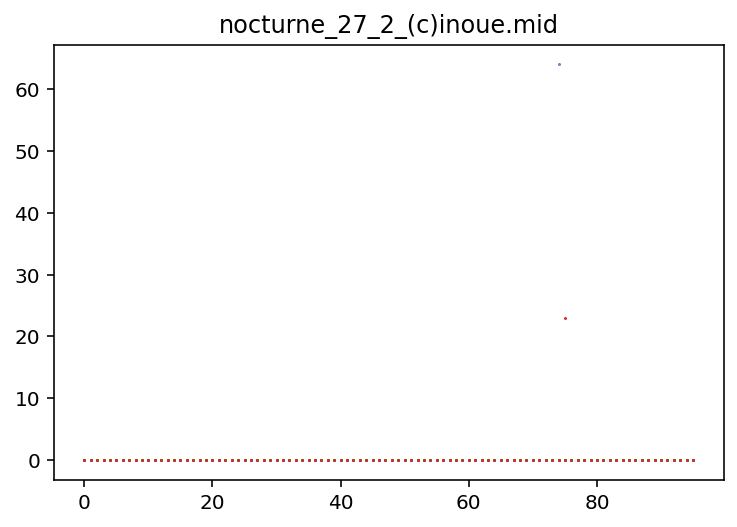

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


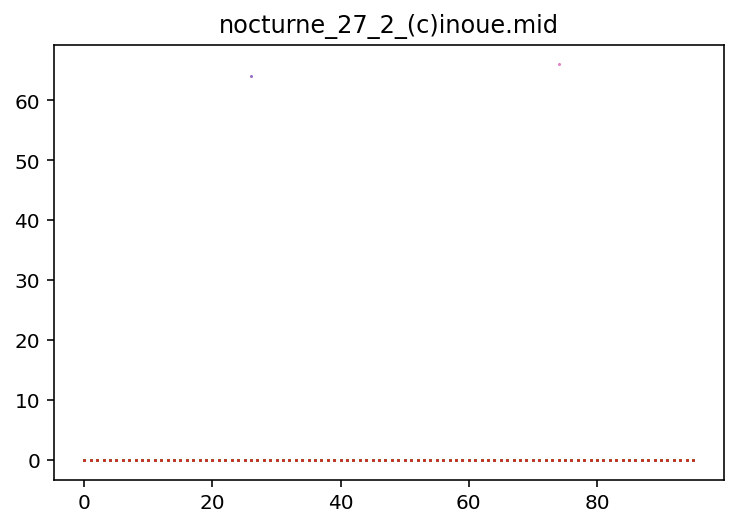

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


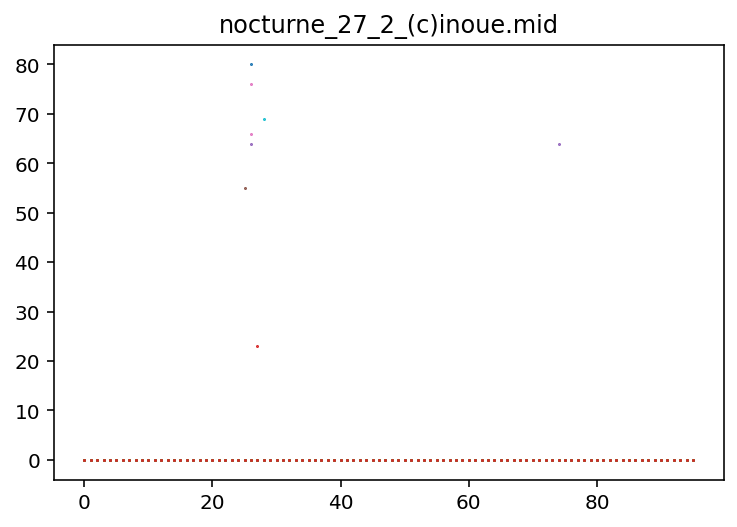

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


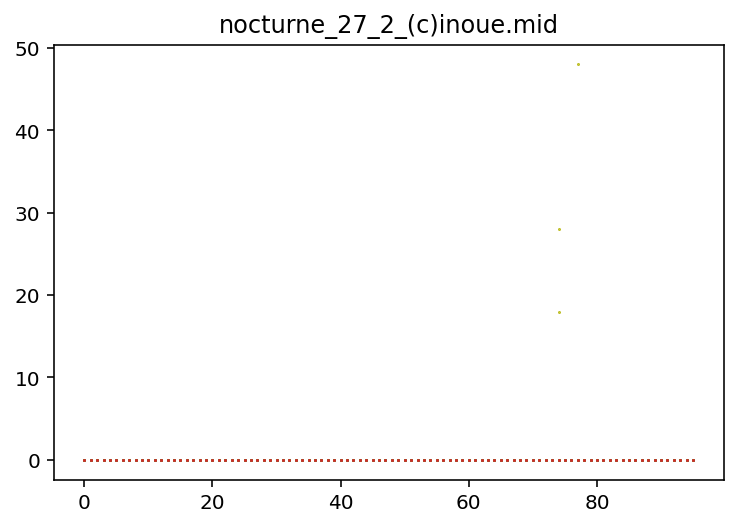

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


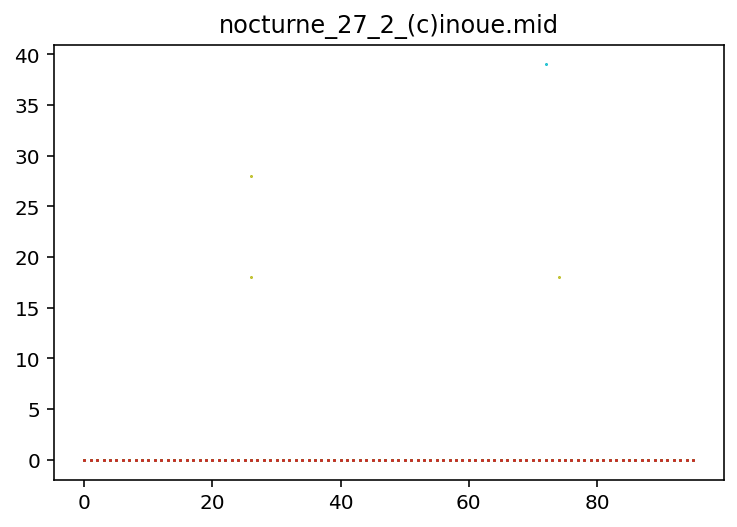

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


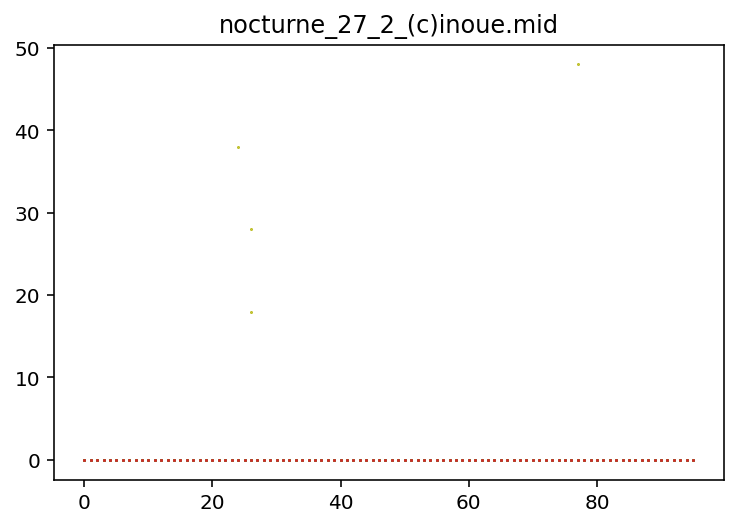

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


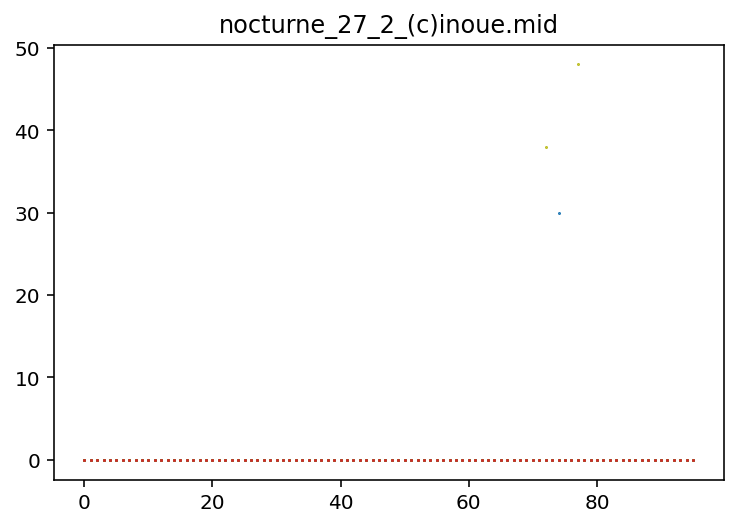

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


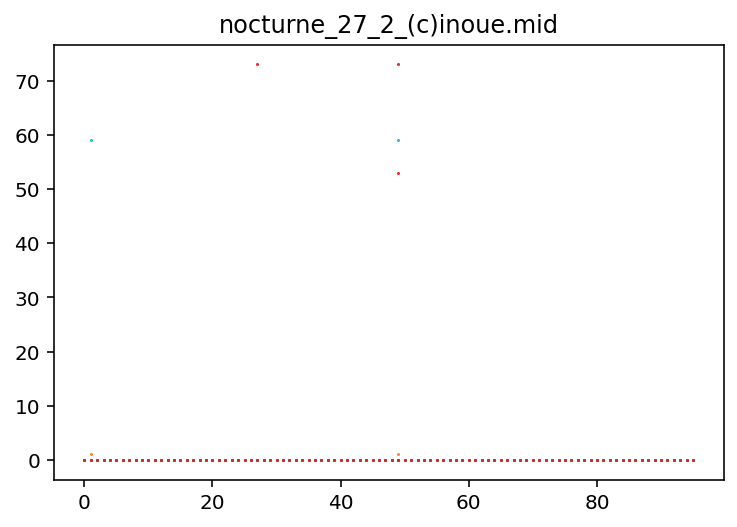

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


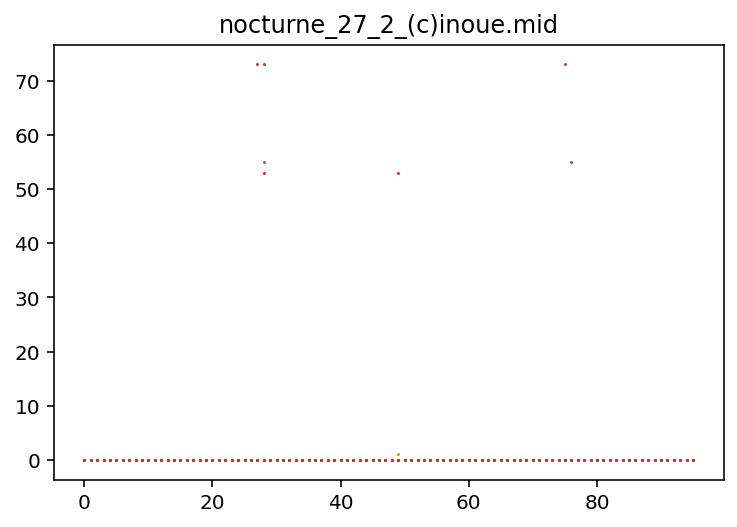

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


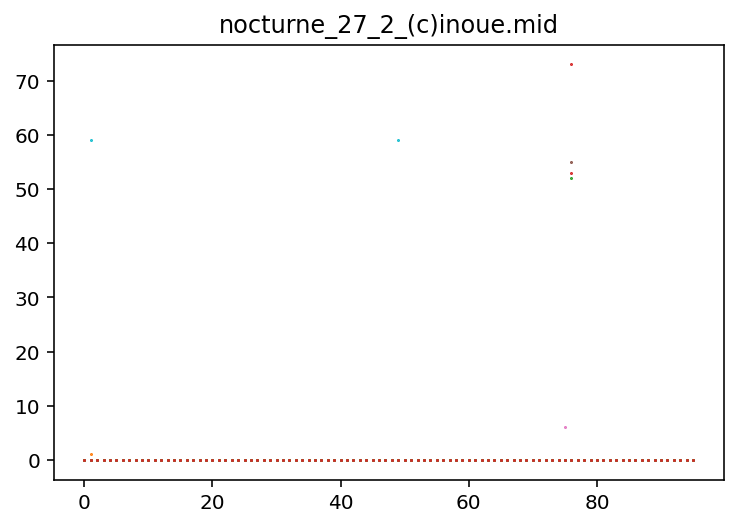

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


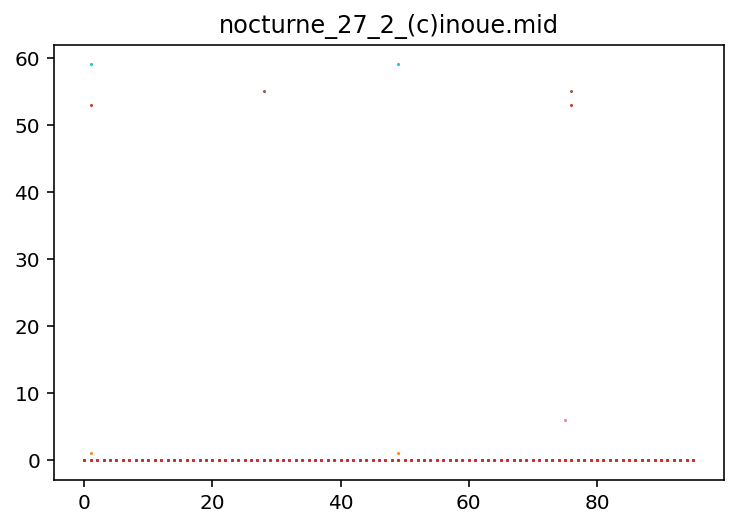

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[  0   0   0 ...   0   0   0]
 [  0  99   0 ...   0   0   0]
 [  0 -99   0 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


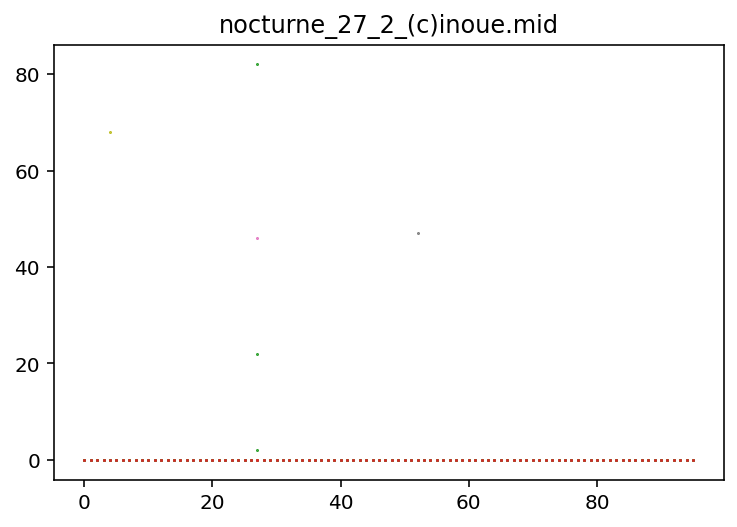

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


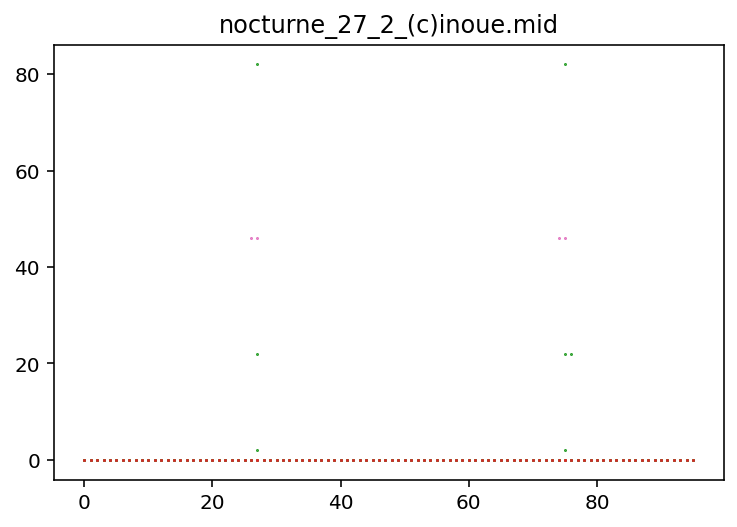

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


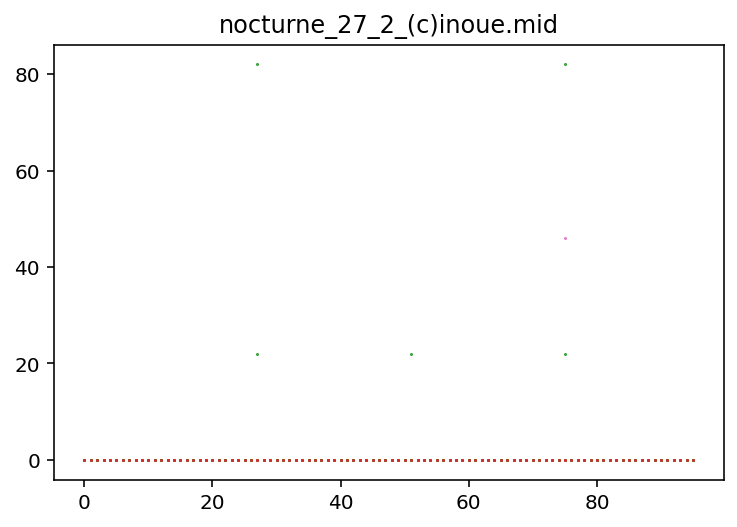

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


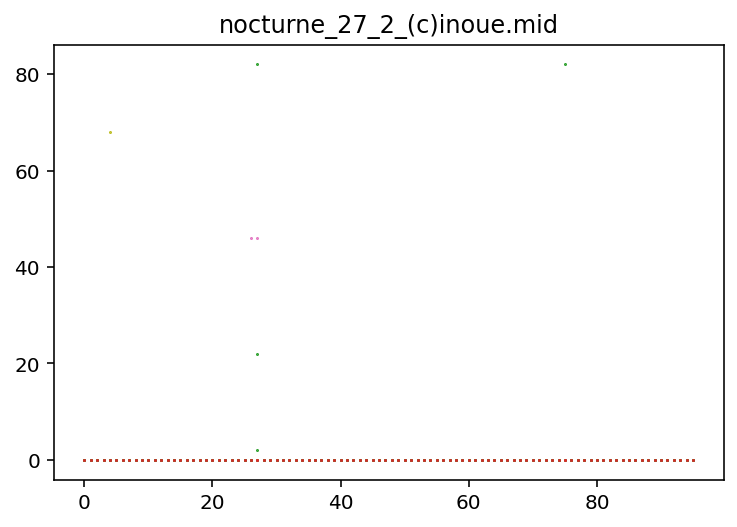

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


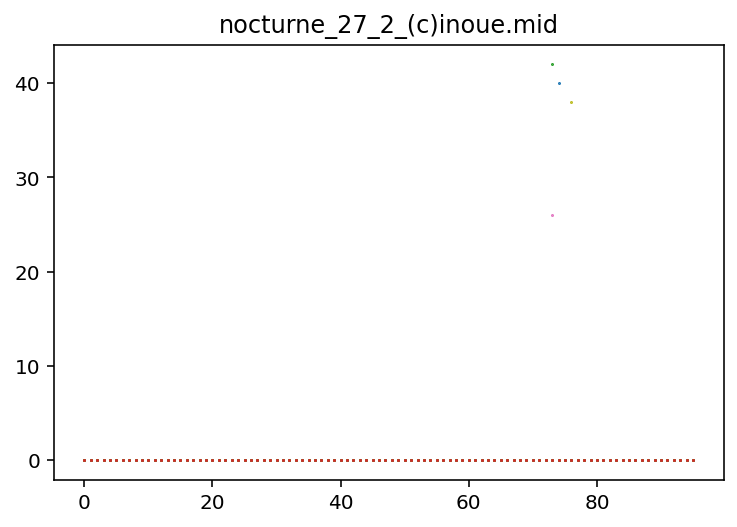

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


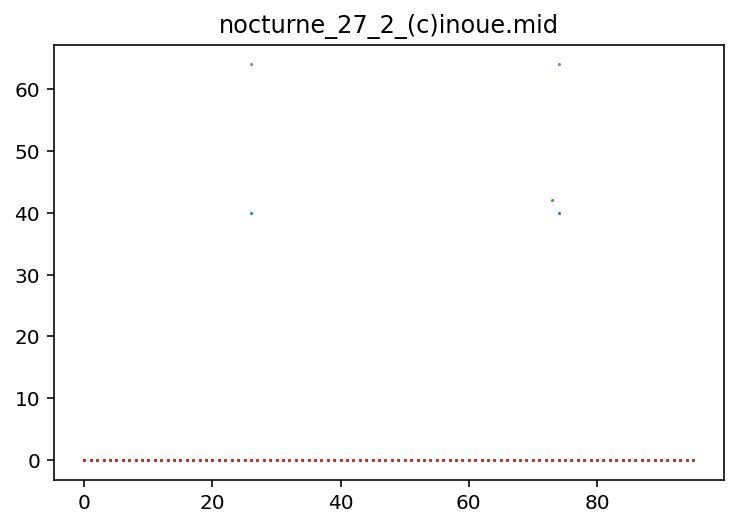

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


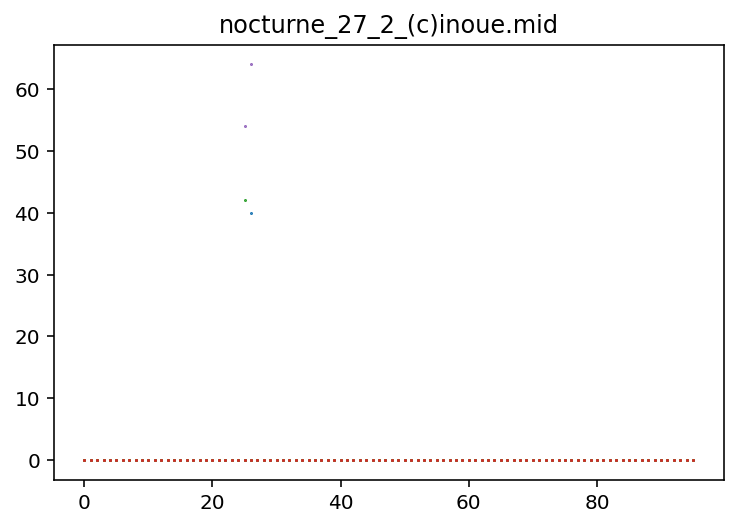

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


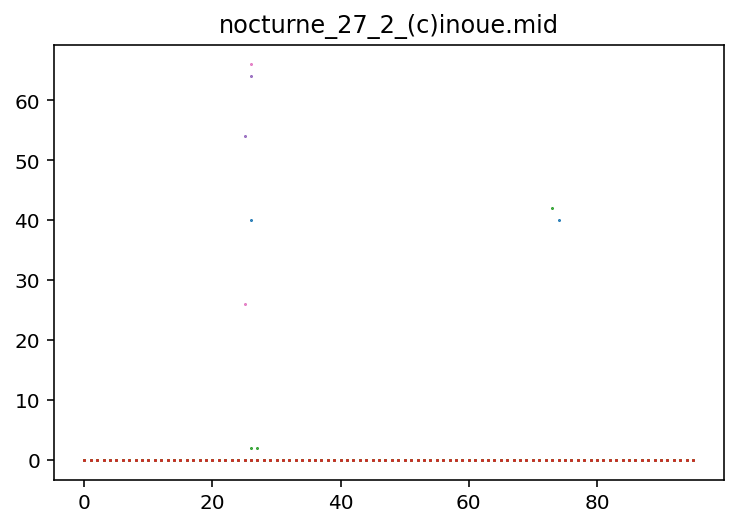

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


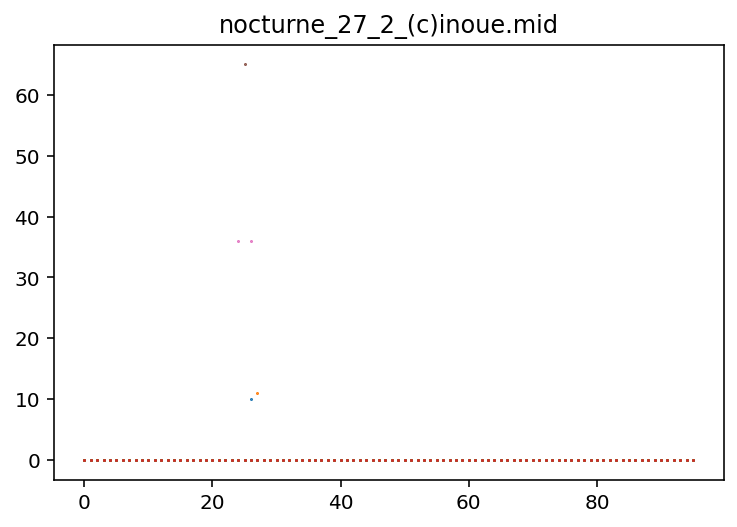

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


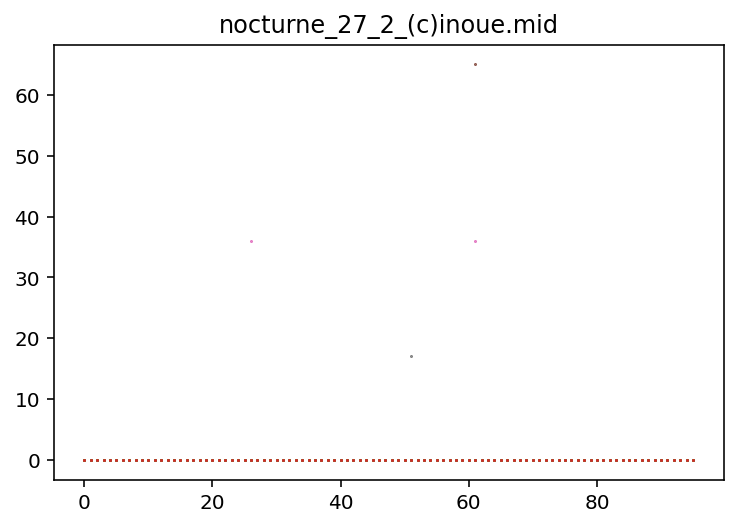

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


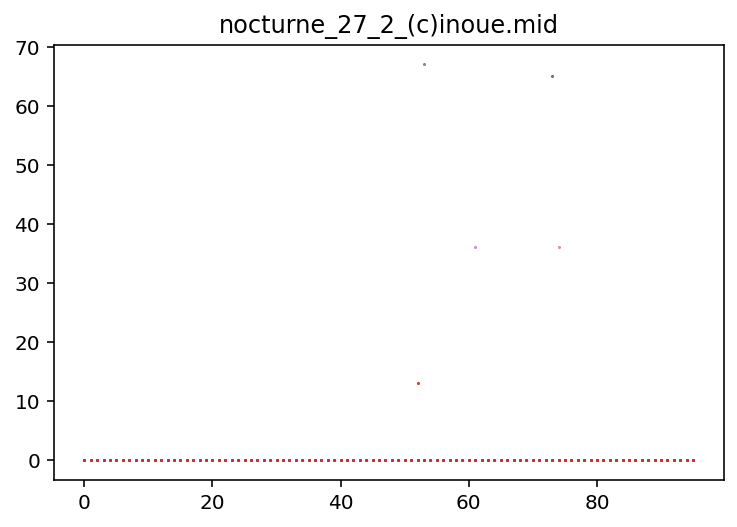

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


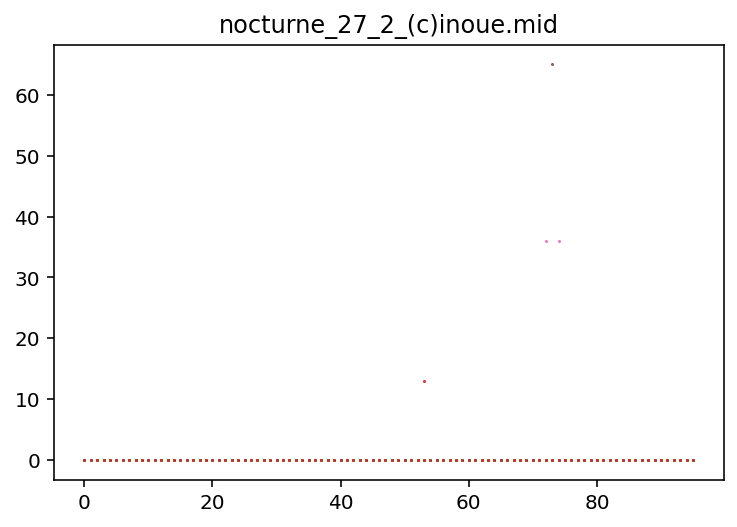

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


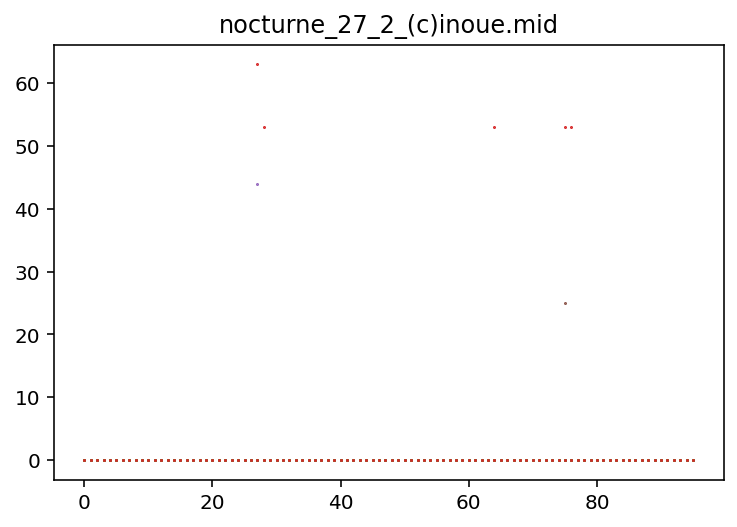

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


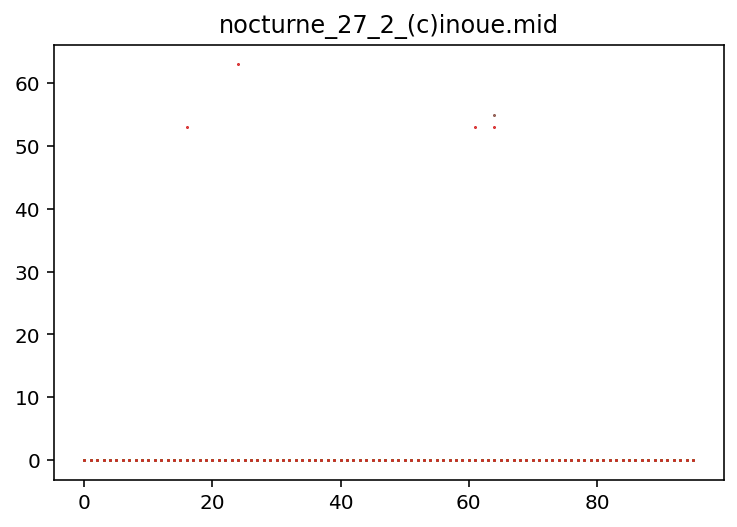

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


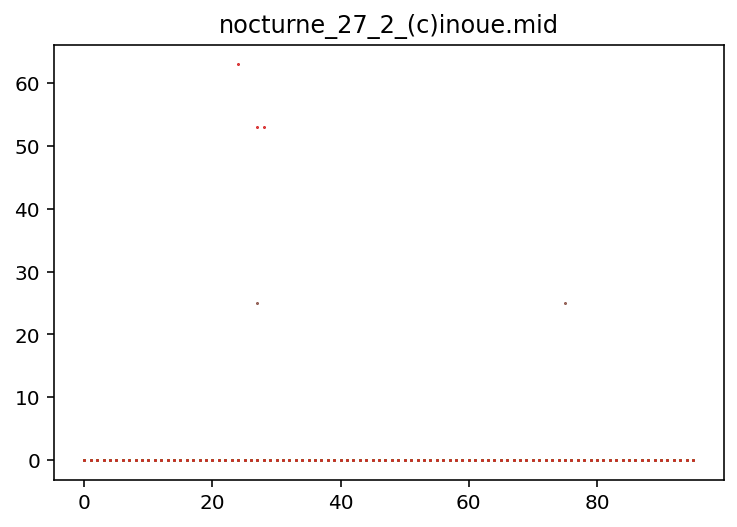

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


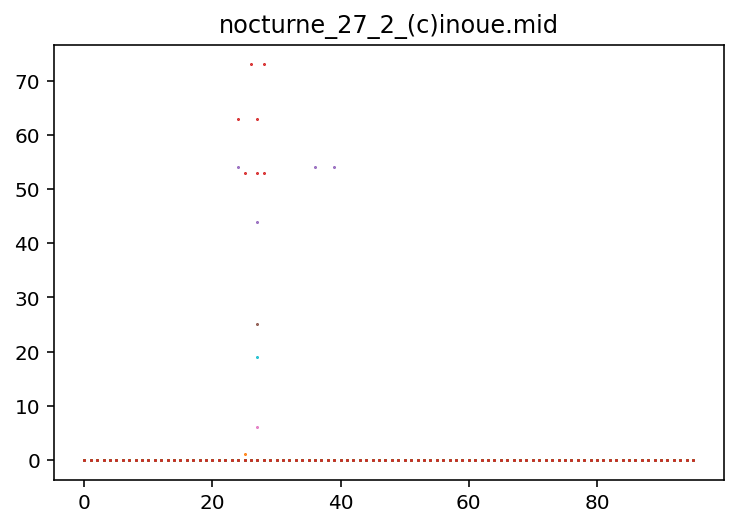

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


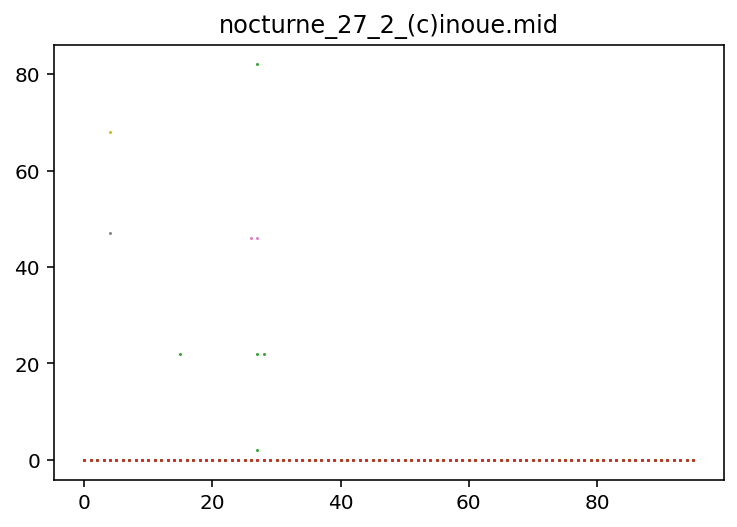

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


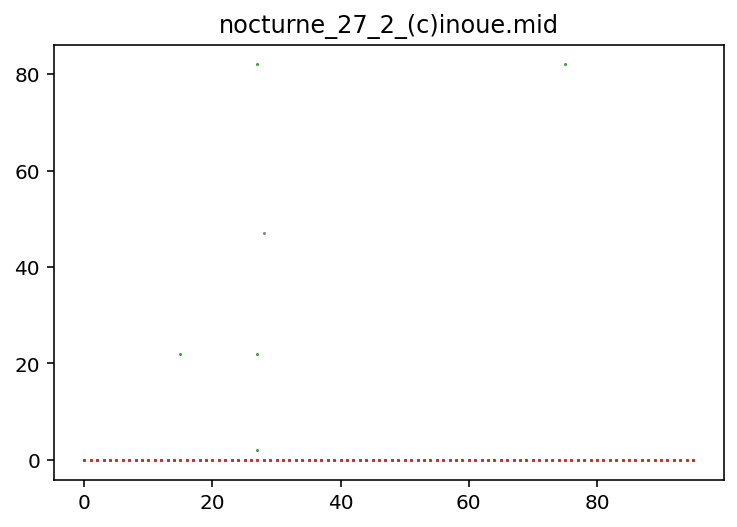

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


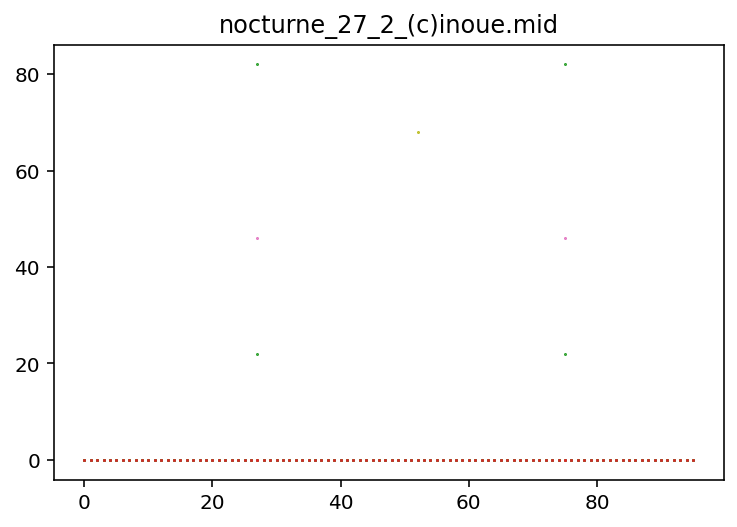

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


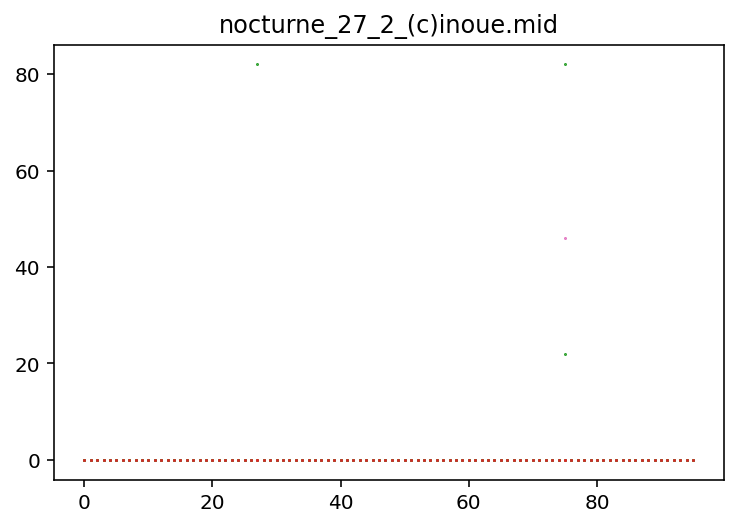

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


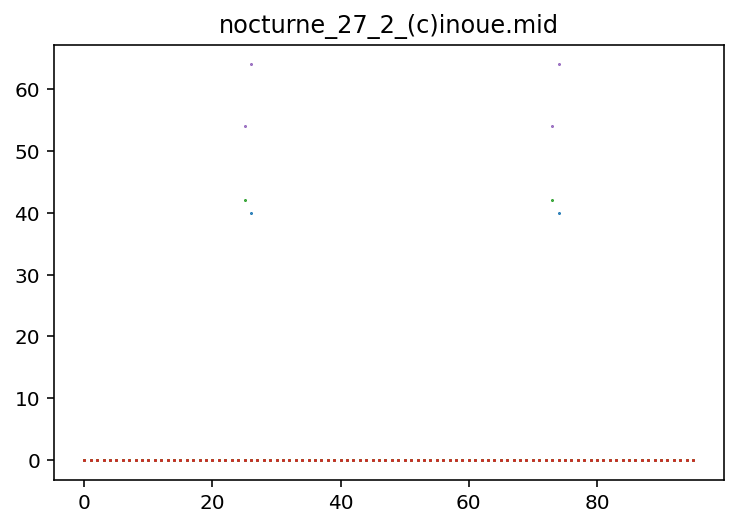

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


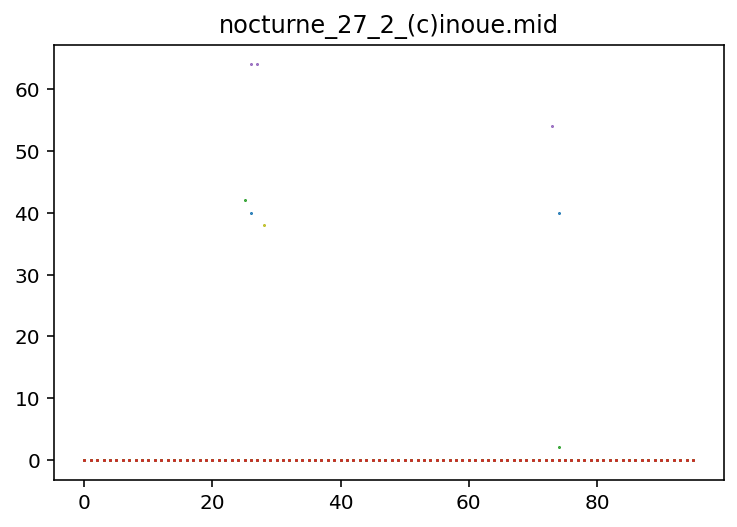

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


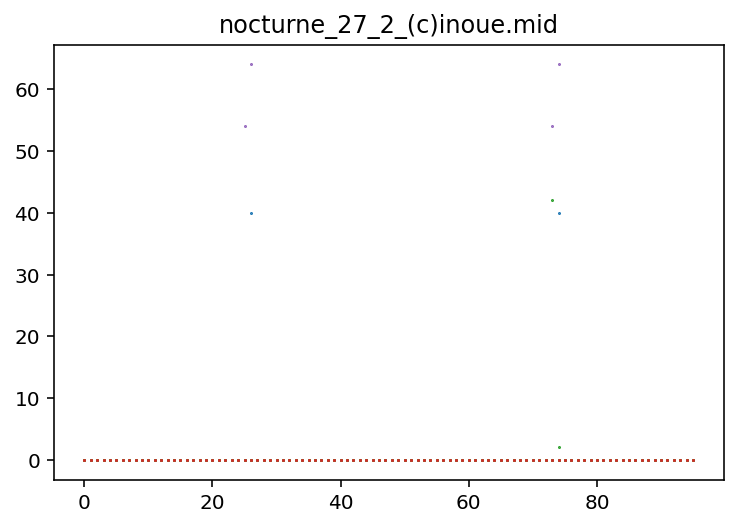

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


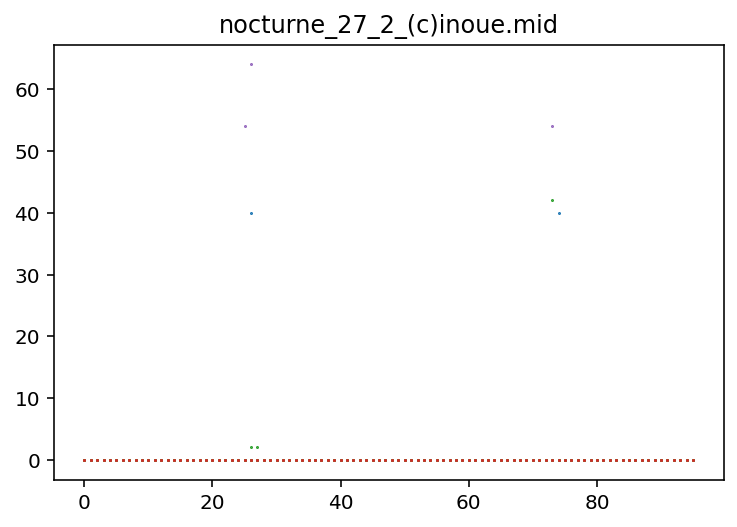

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


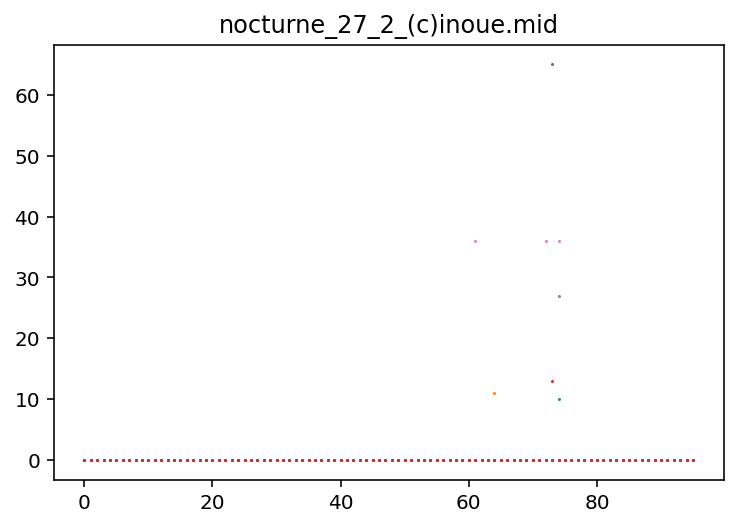

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


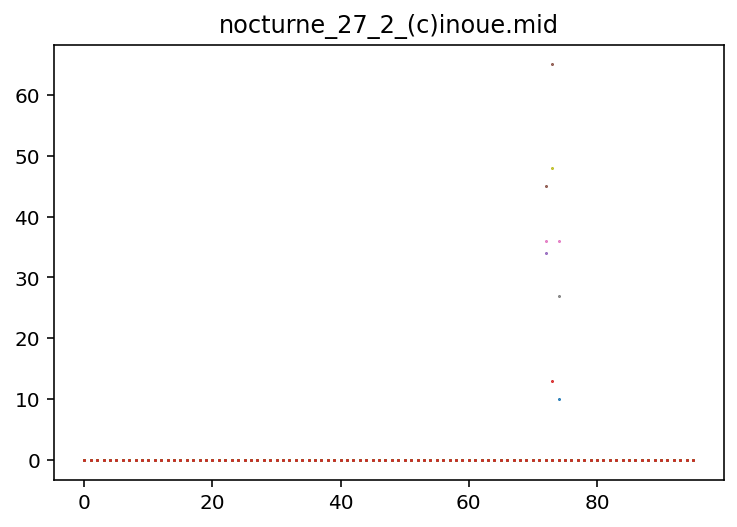

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


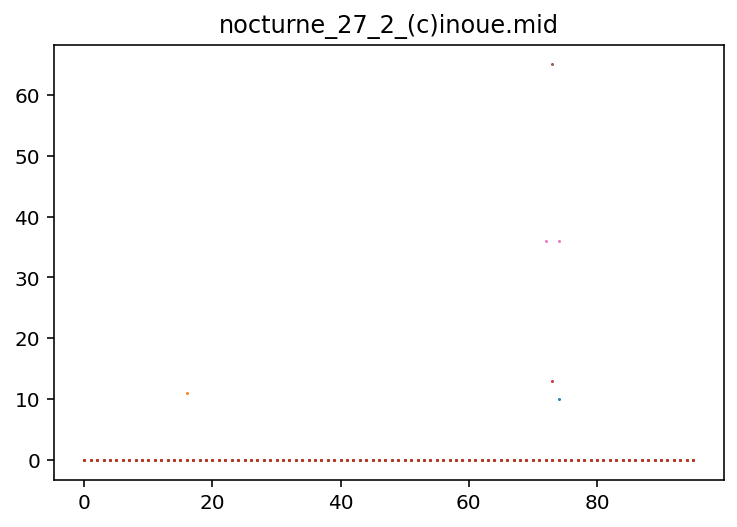

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


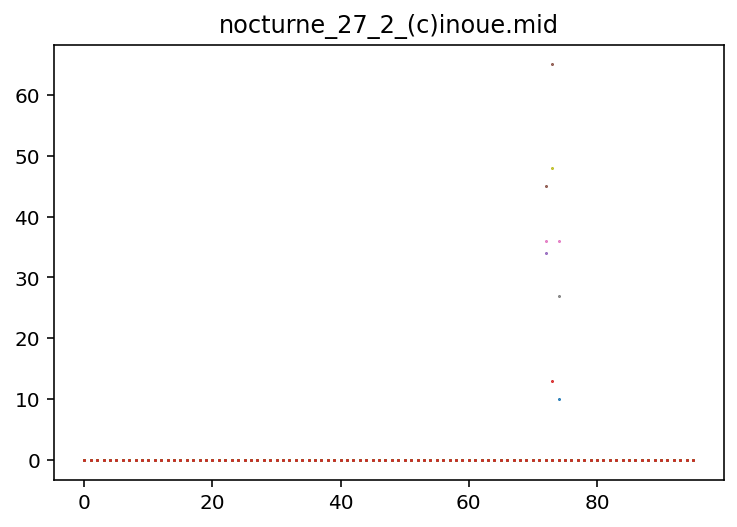

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


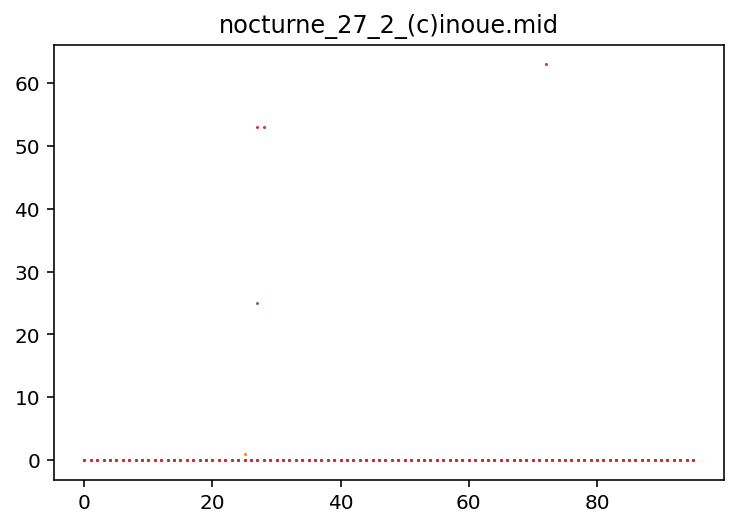

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


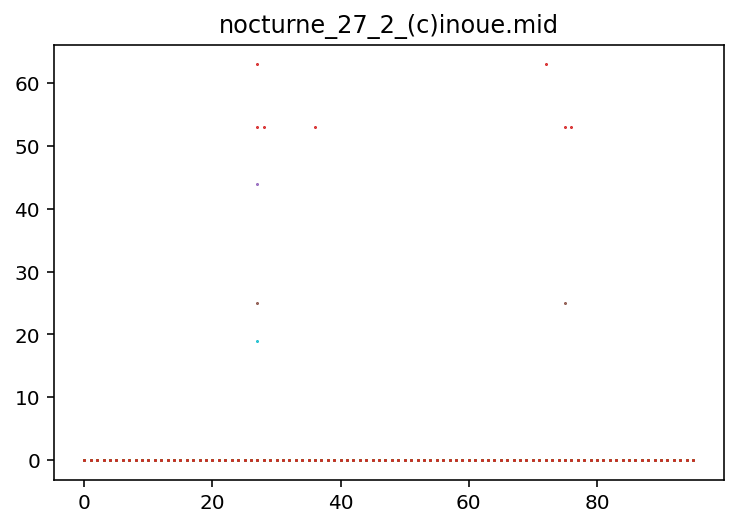

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


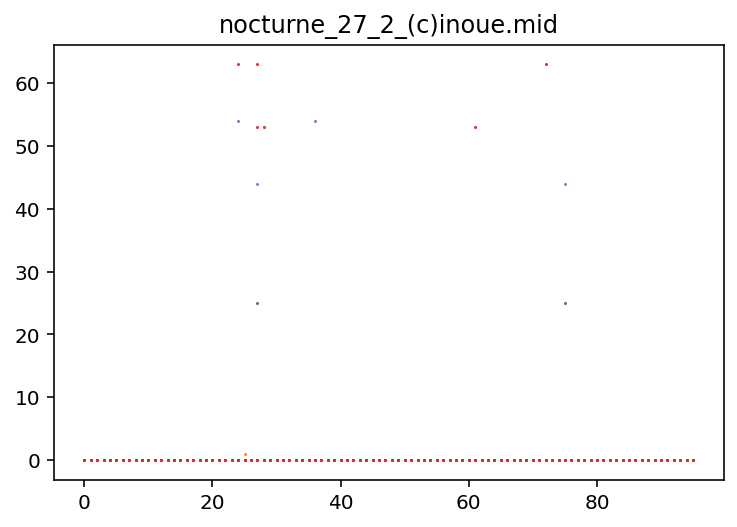

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


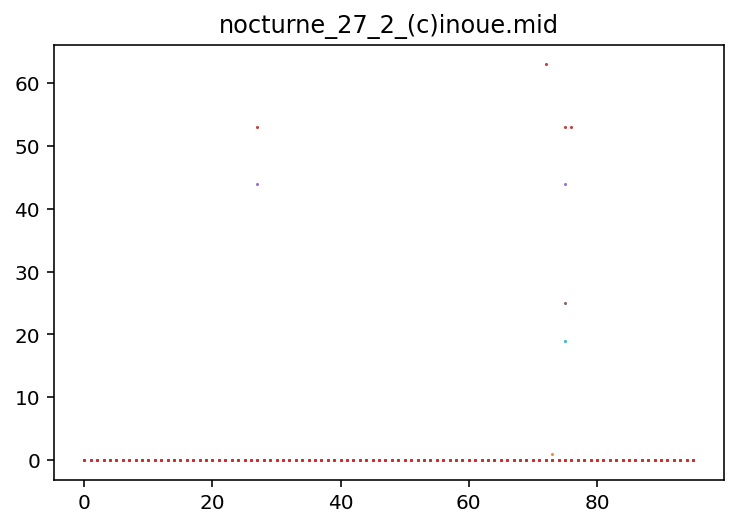

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


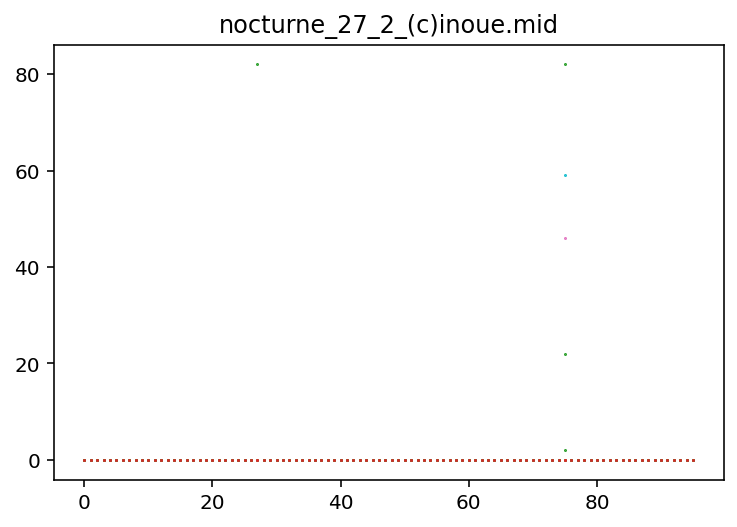

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


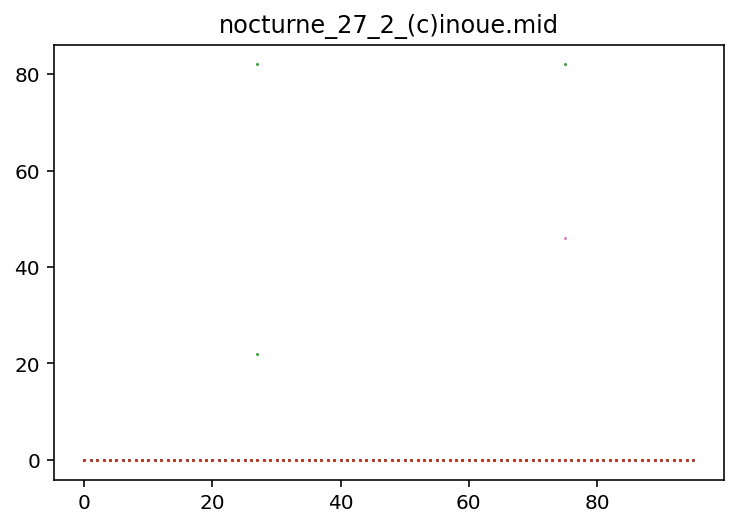

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


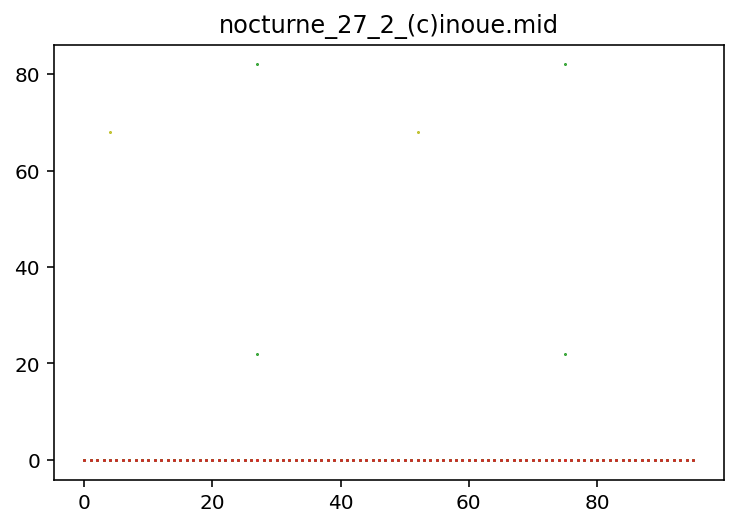

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


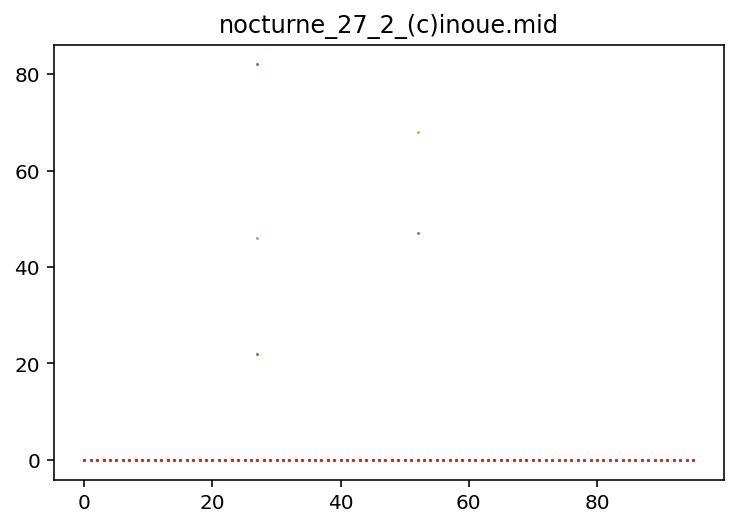

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


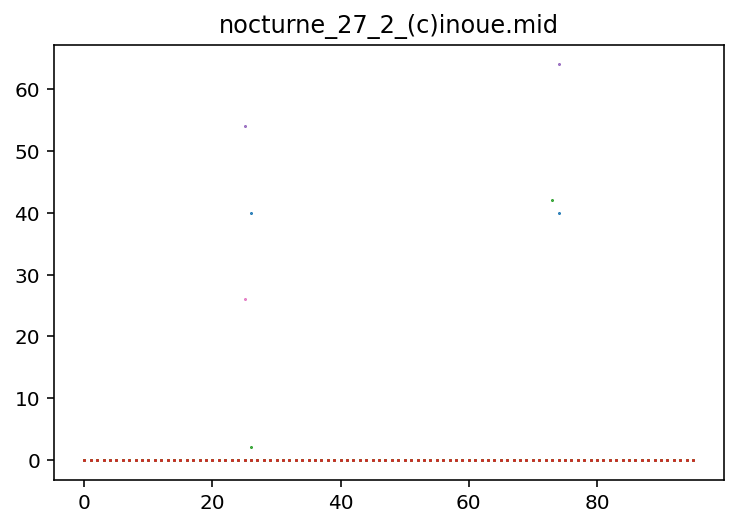

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


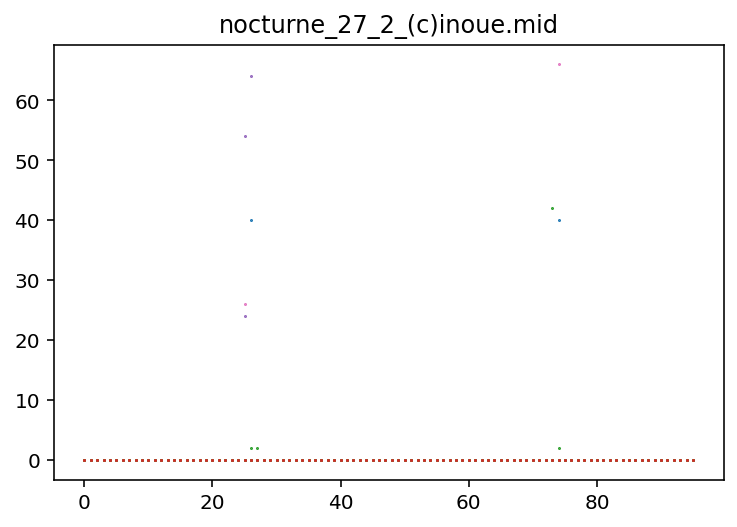

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


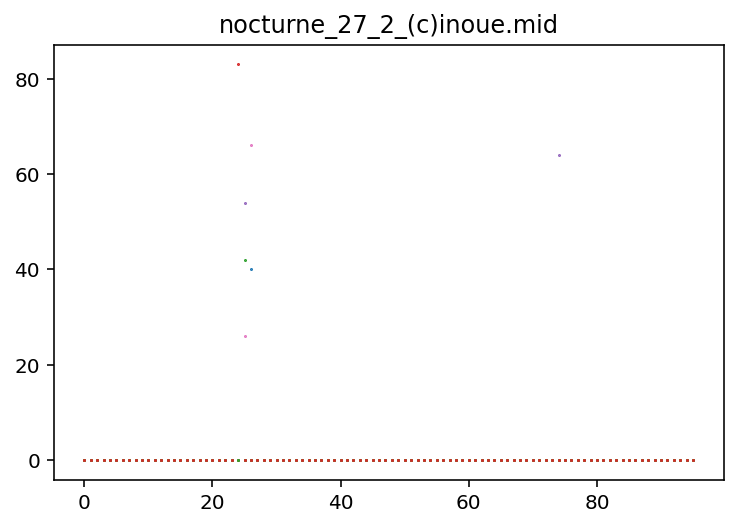

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


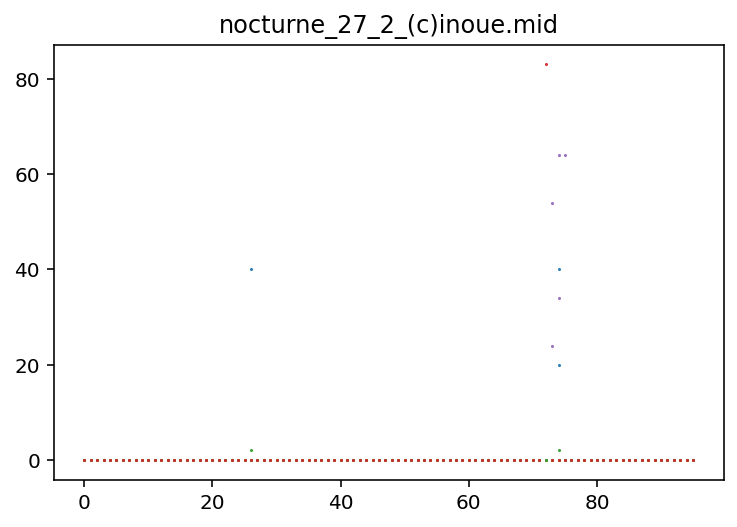

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


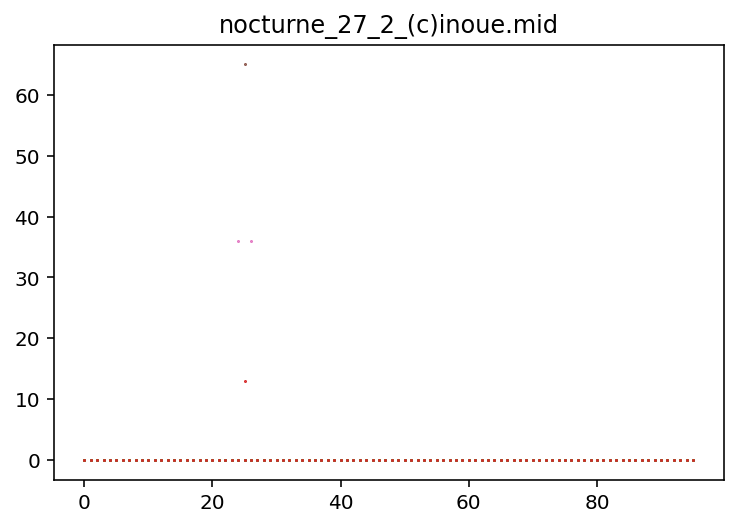

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


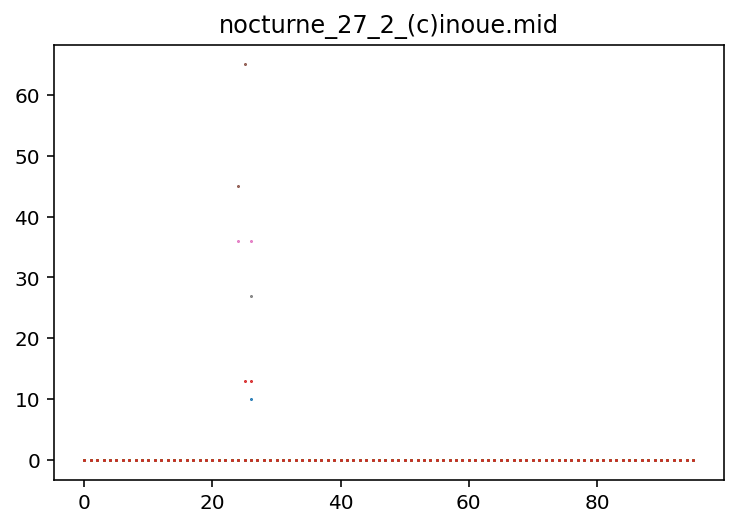

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


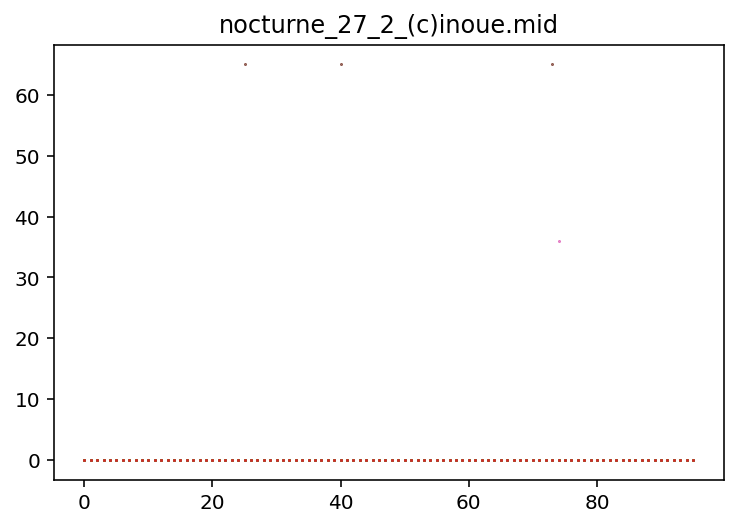

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


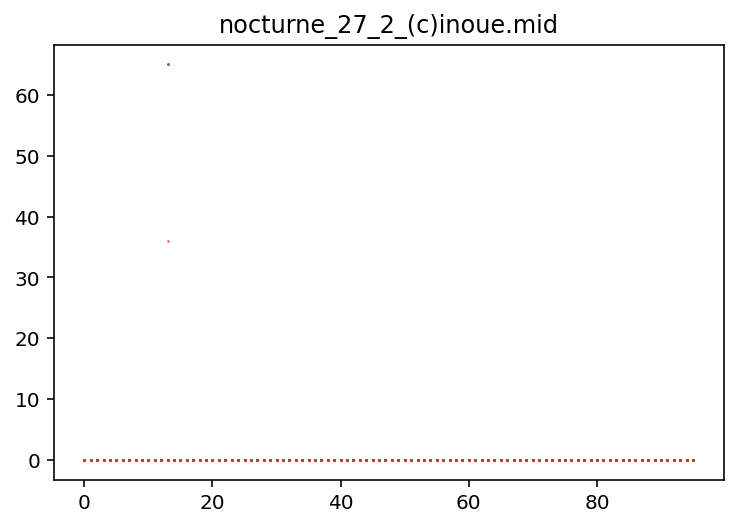

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


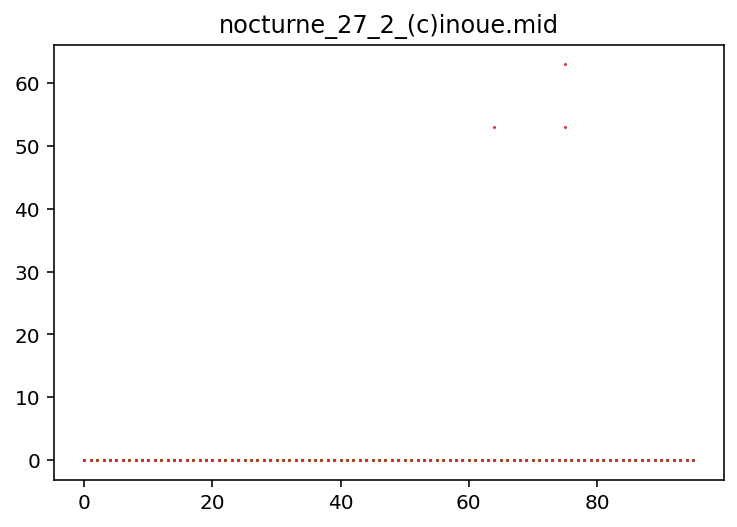

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


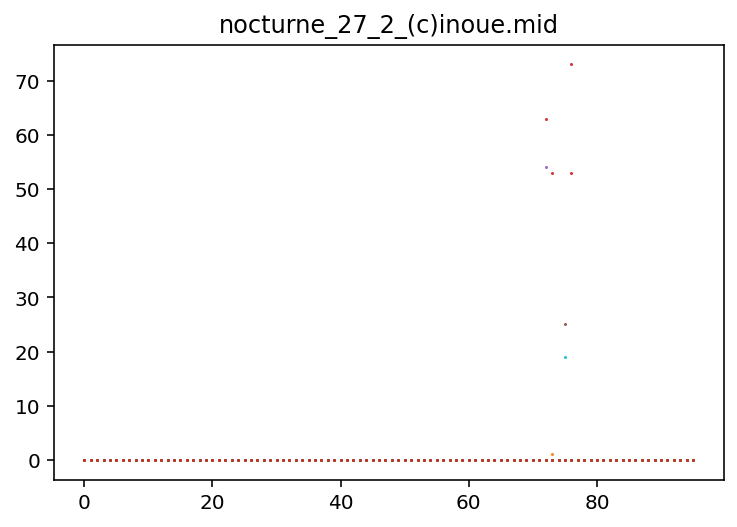

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


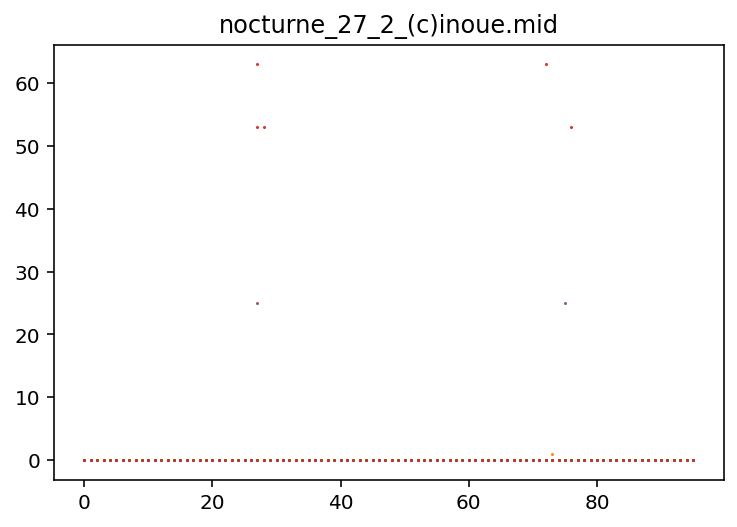

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


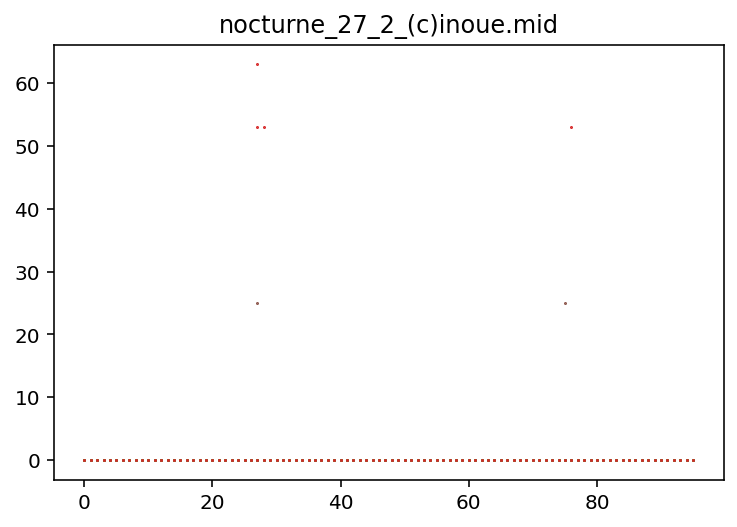

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


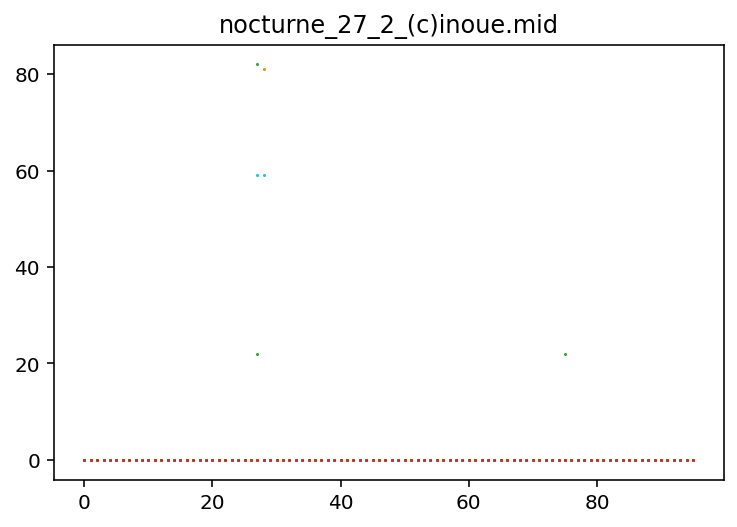

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


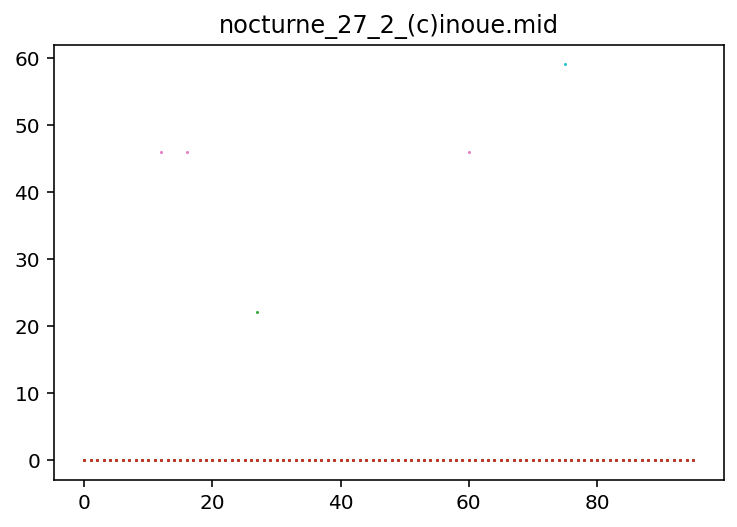

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


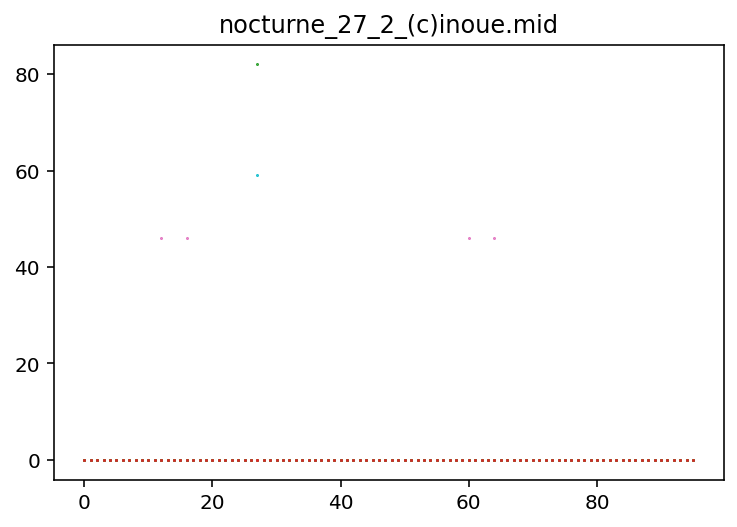

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


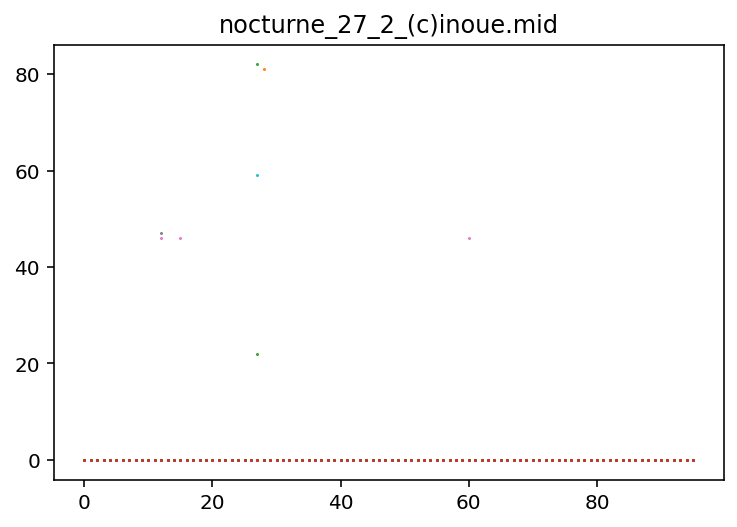

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


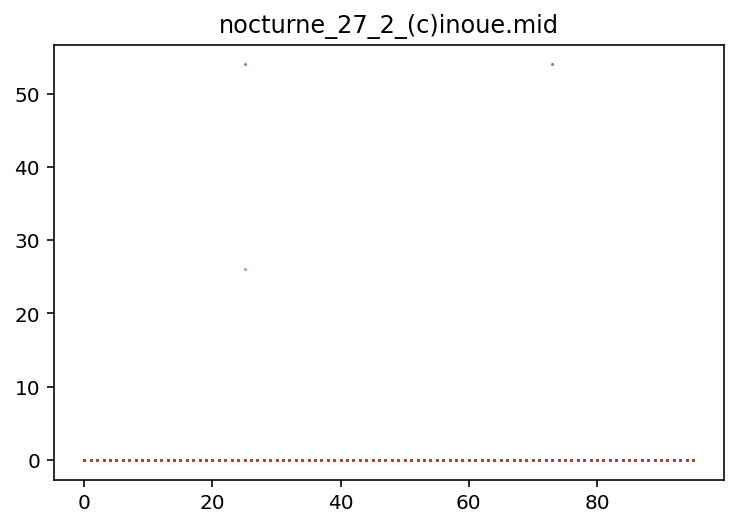

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


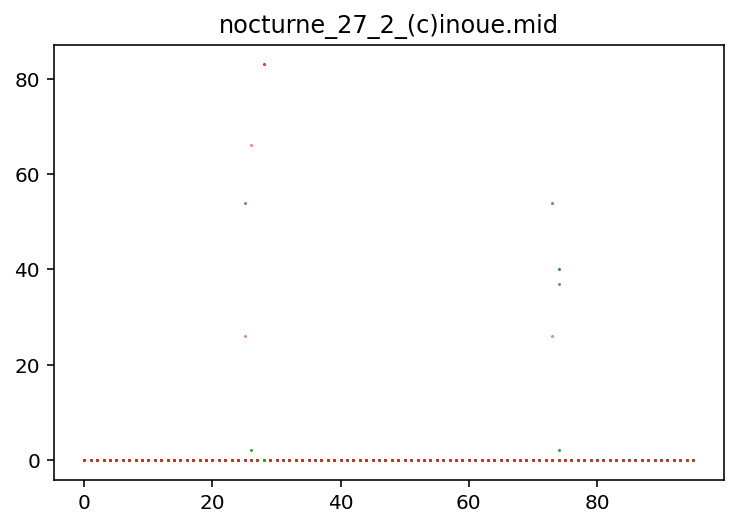

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


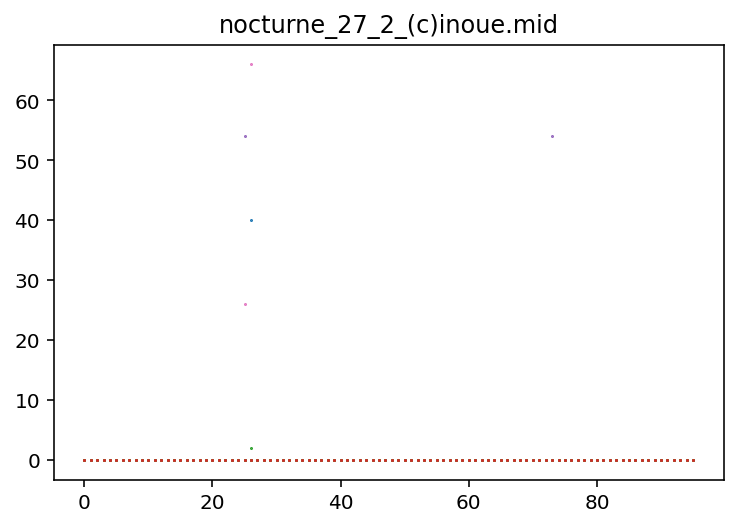

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


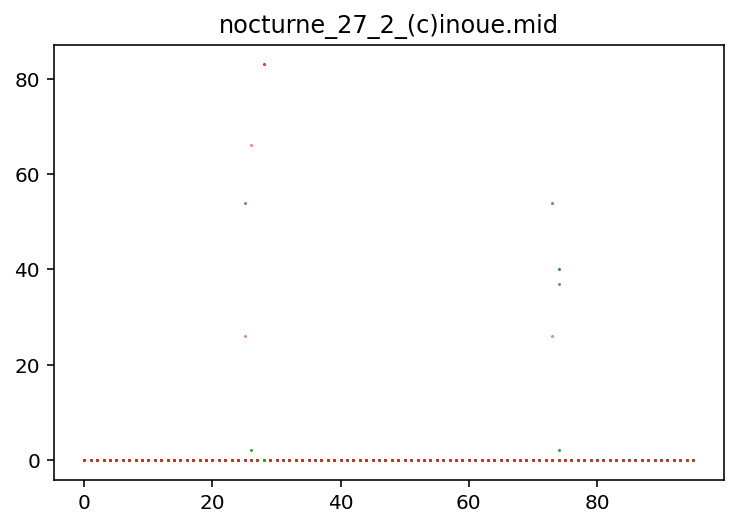

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


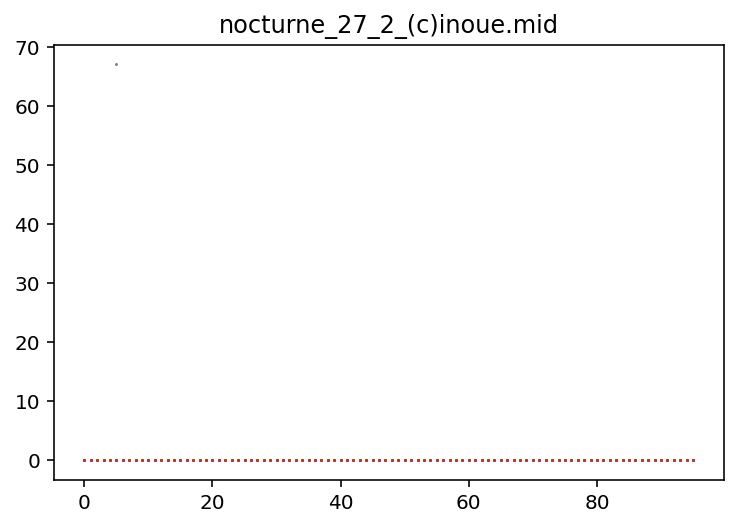

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


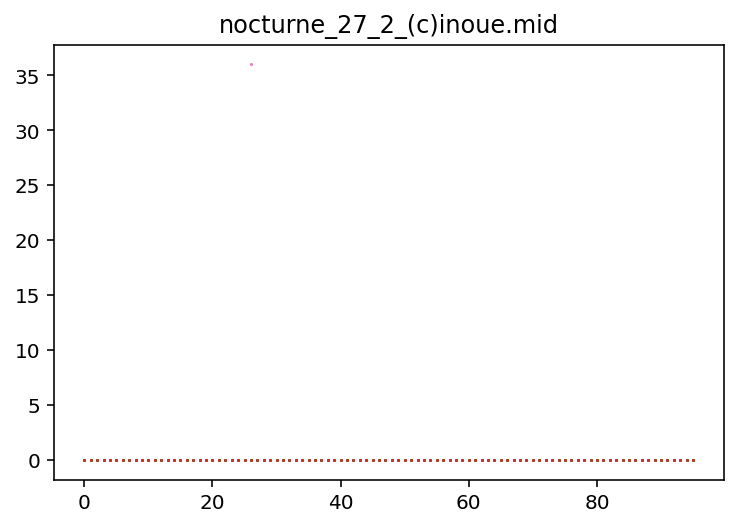

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


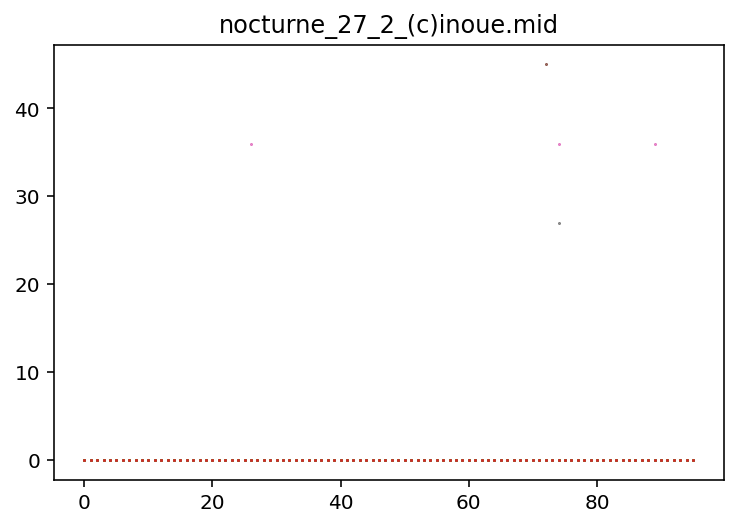

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


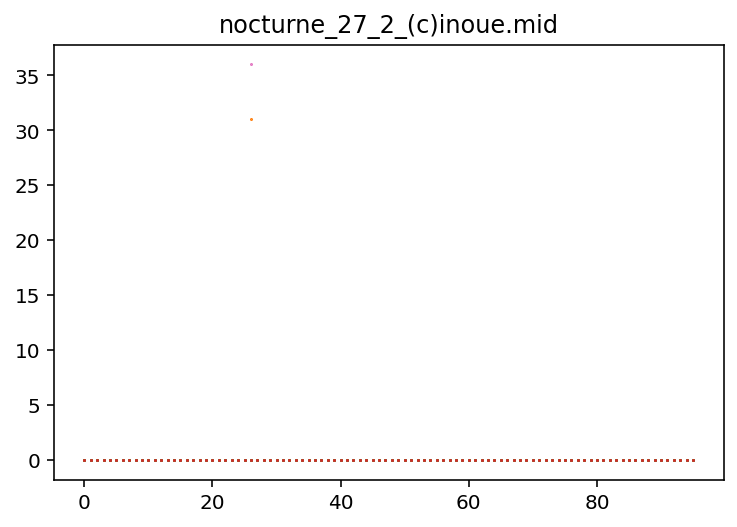

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


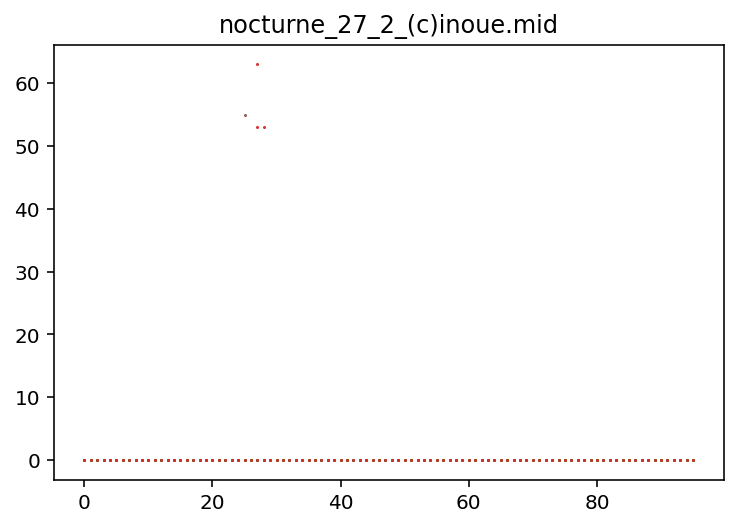

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


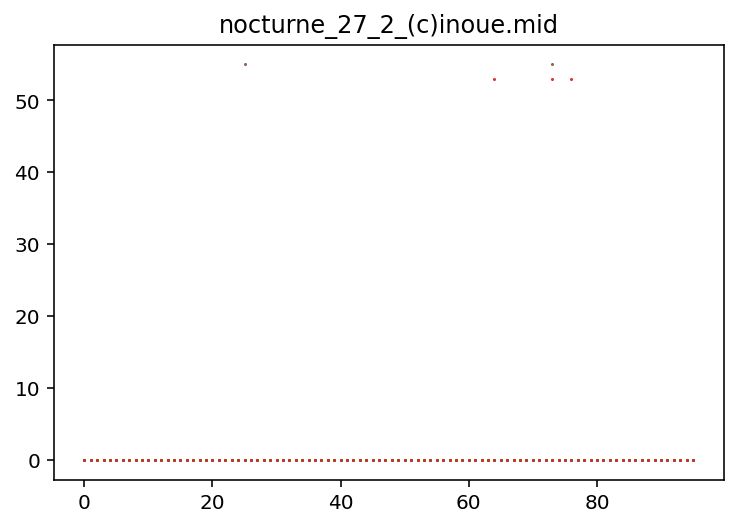

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


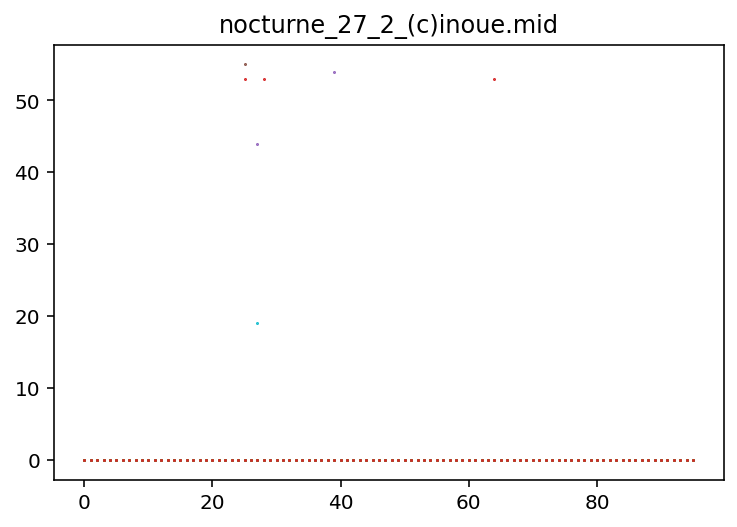

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


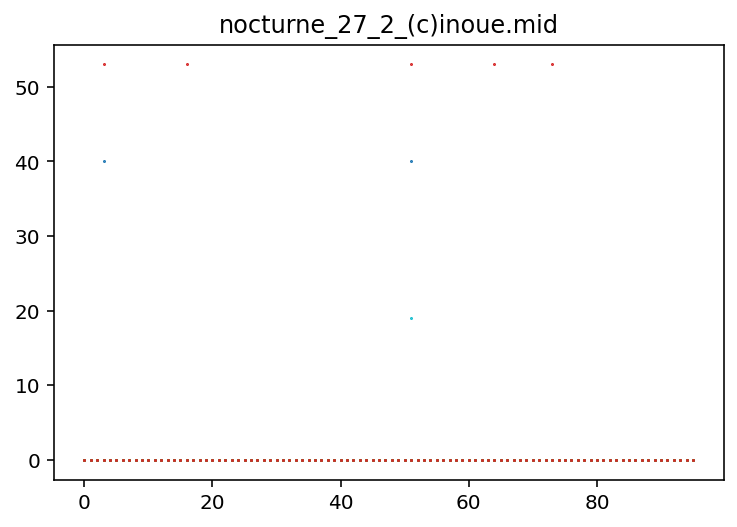

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


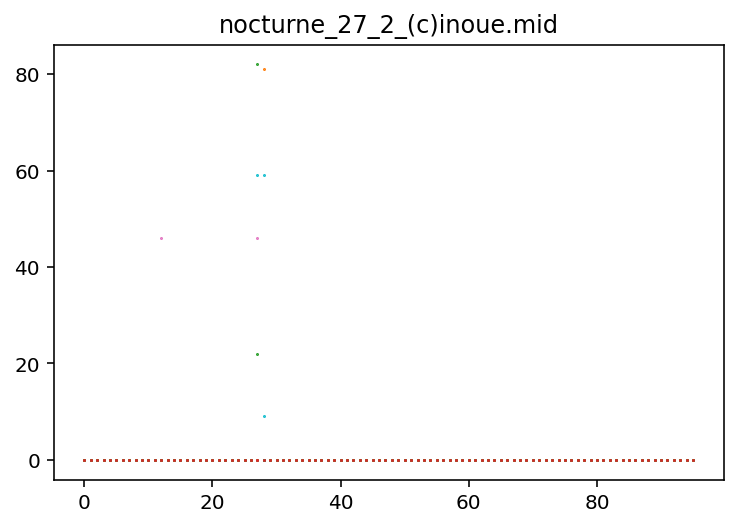

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


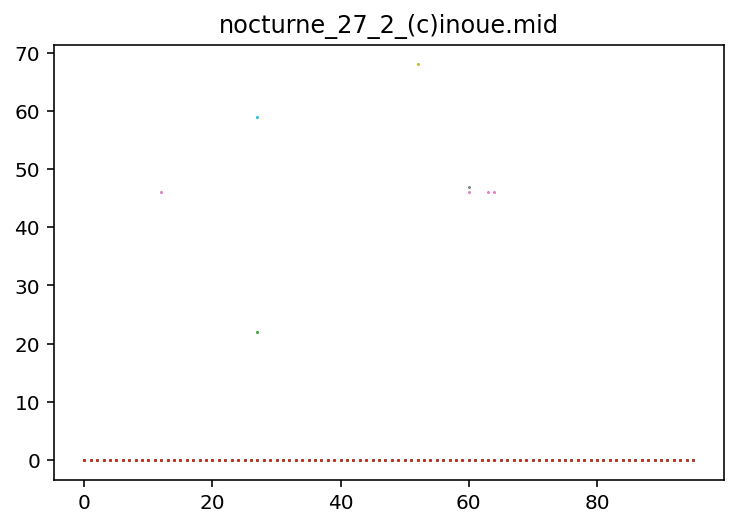

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


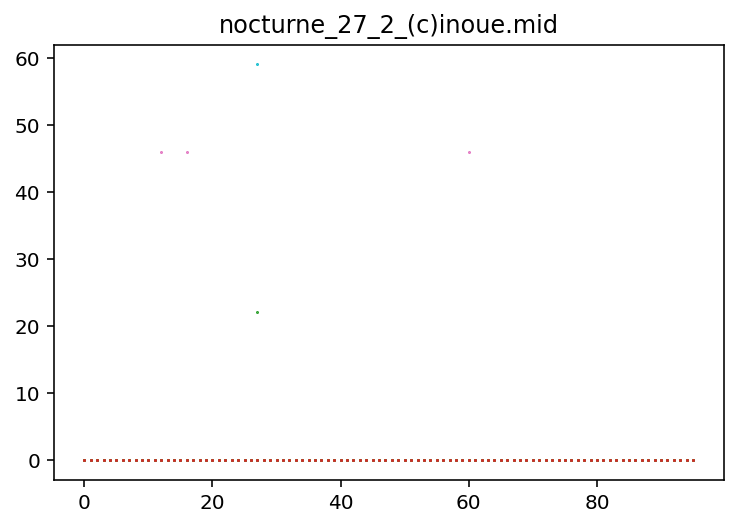

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


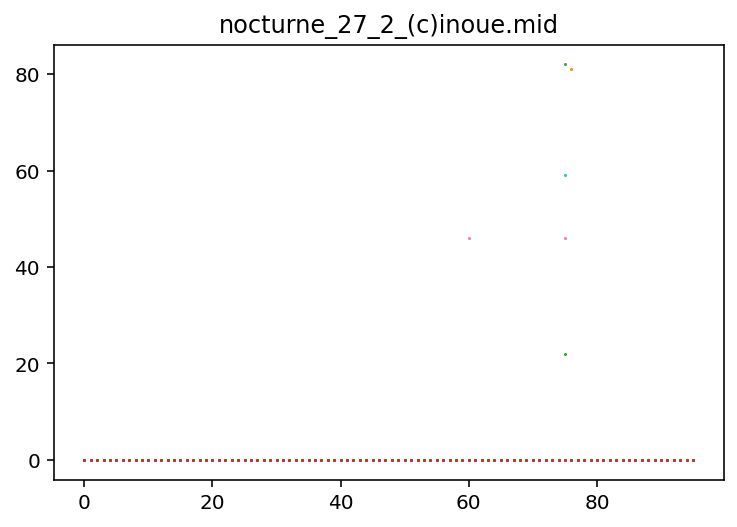

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


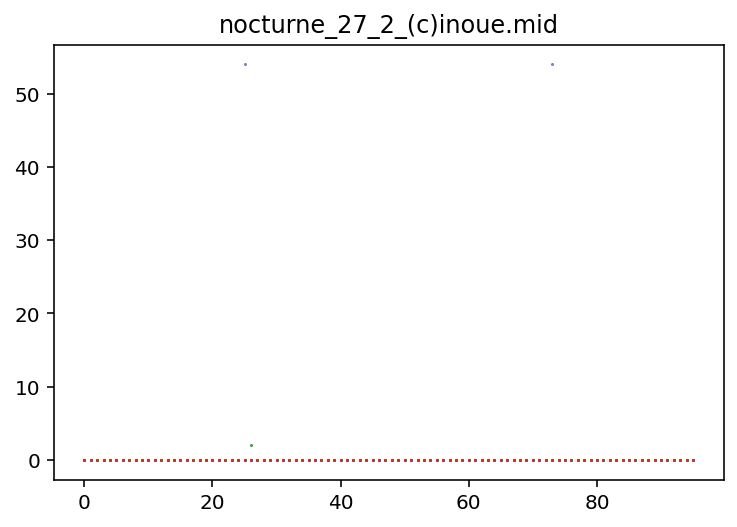

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


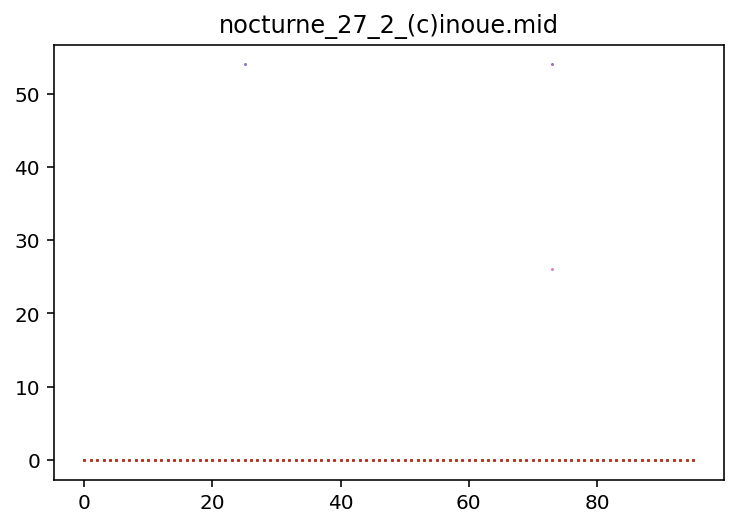

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


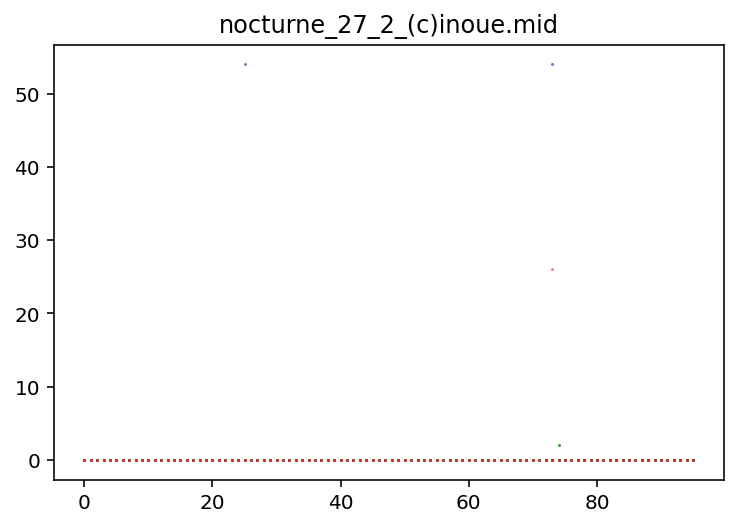

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


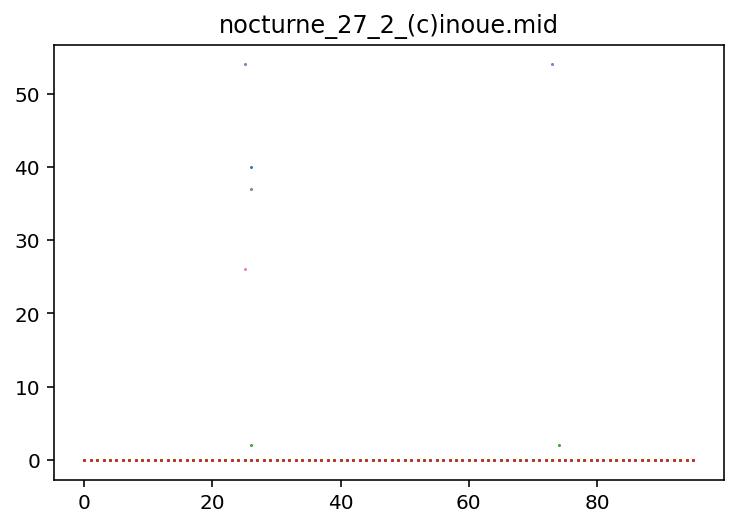

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


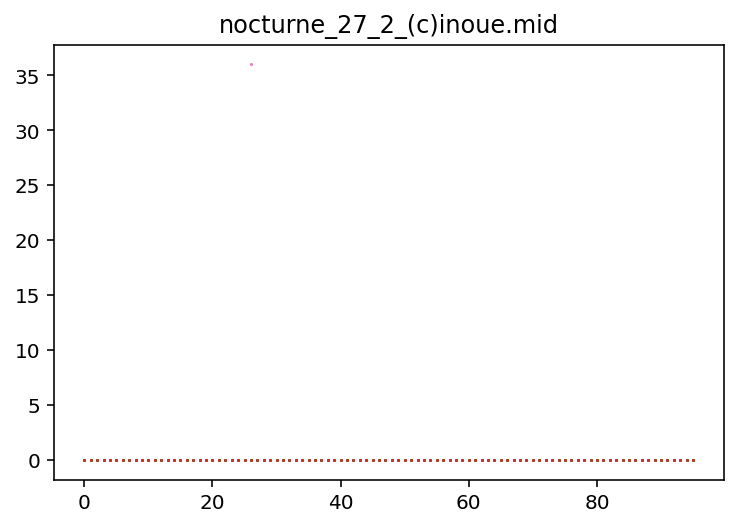

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


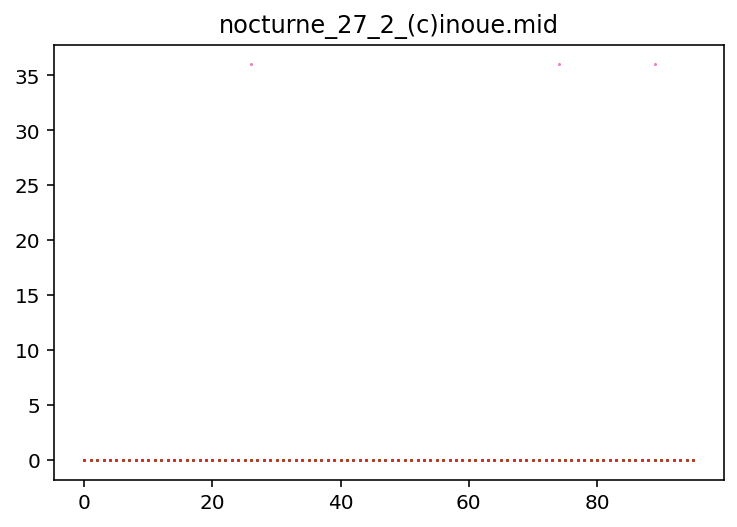

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


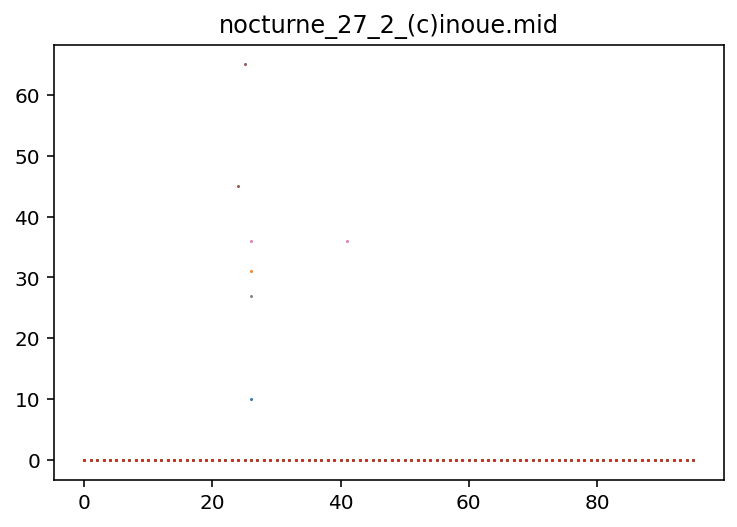

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


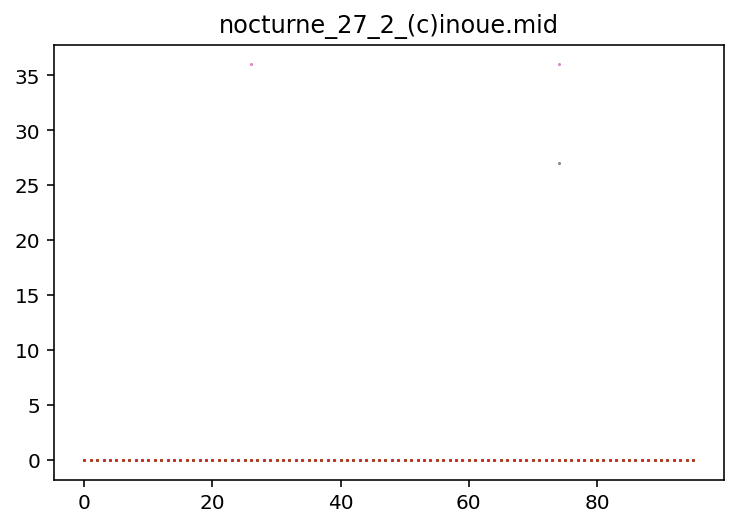

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


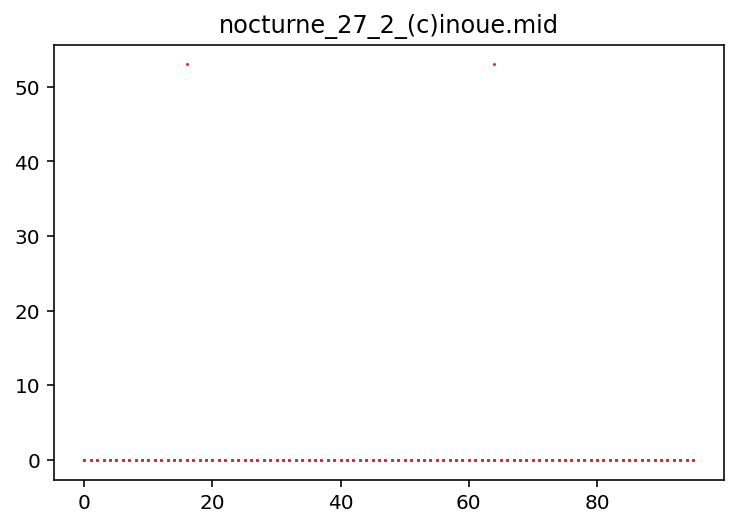

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


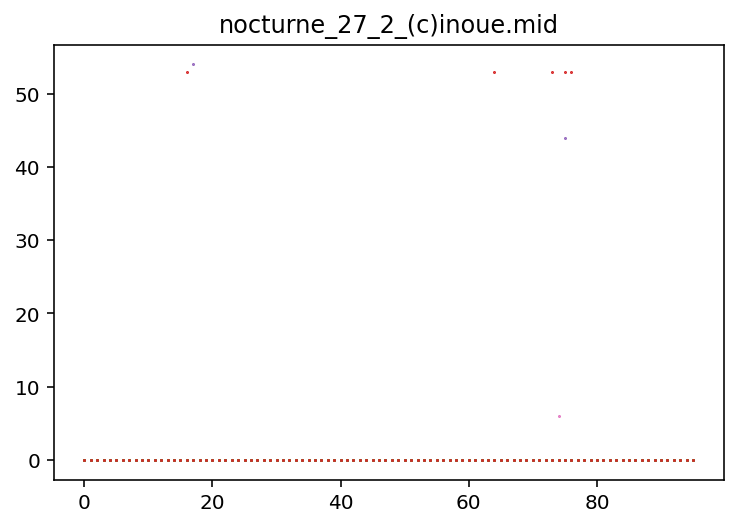

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


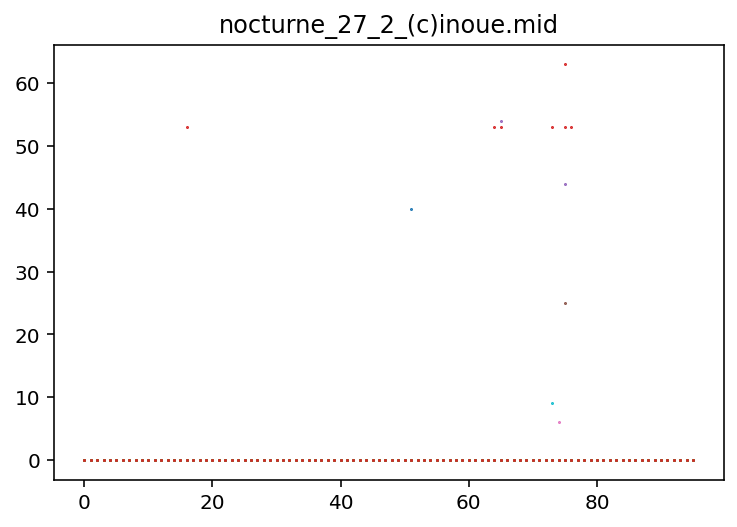

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


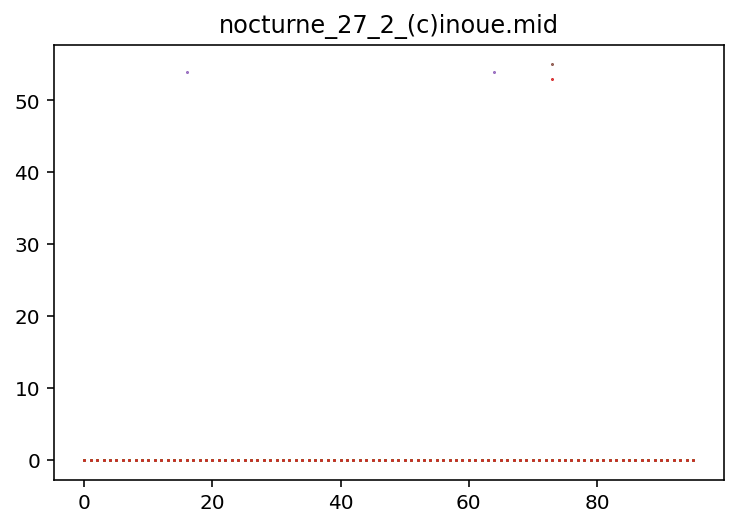

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


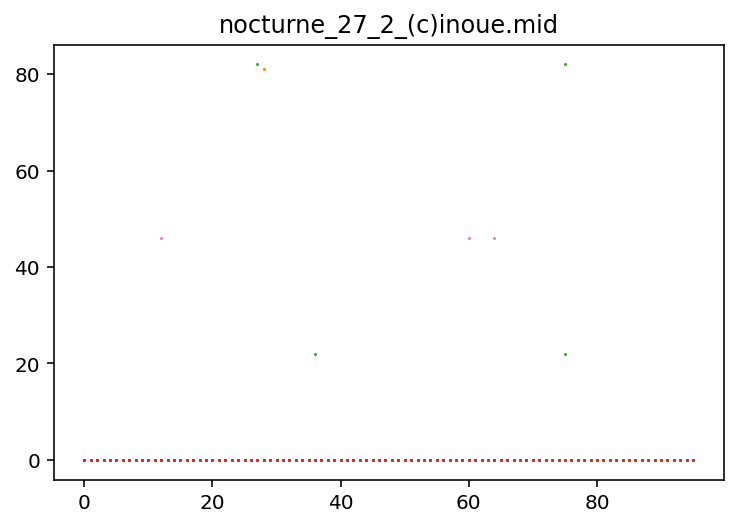

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


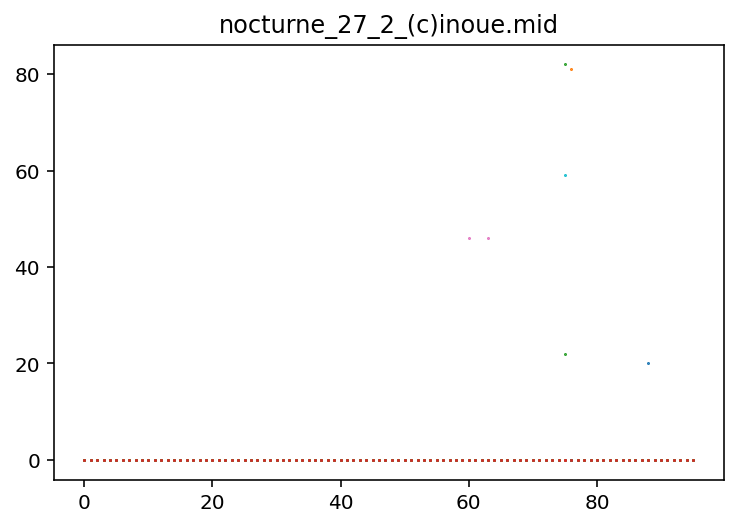

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


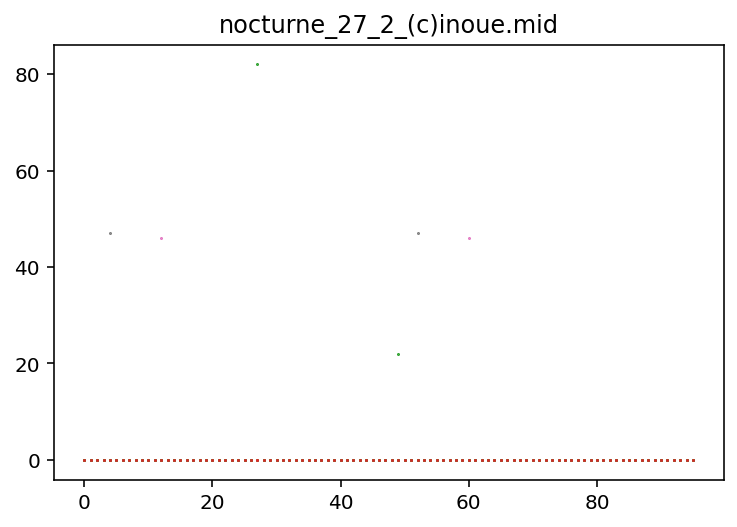

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


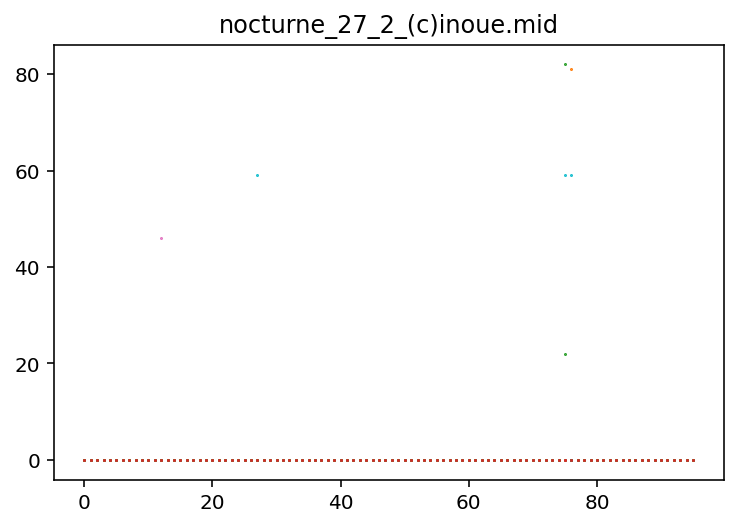

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


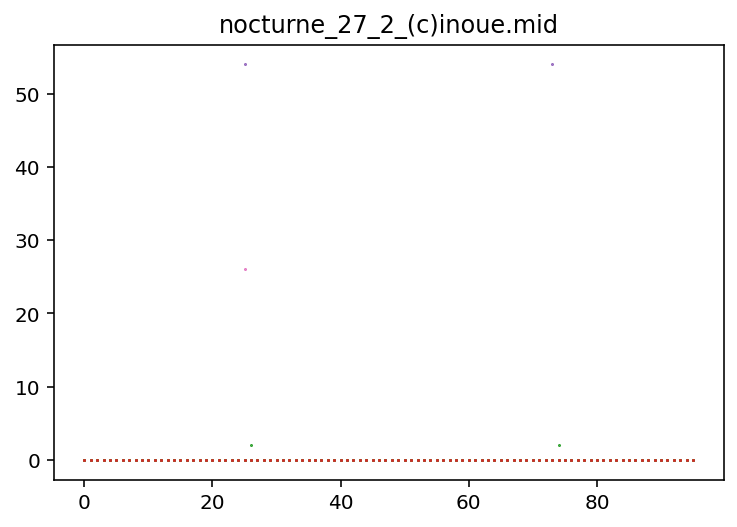

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


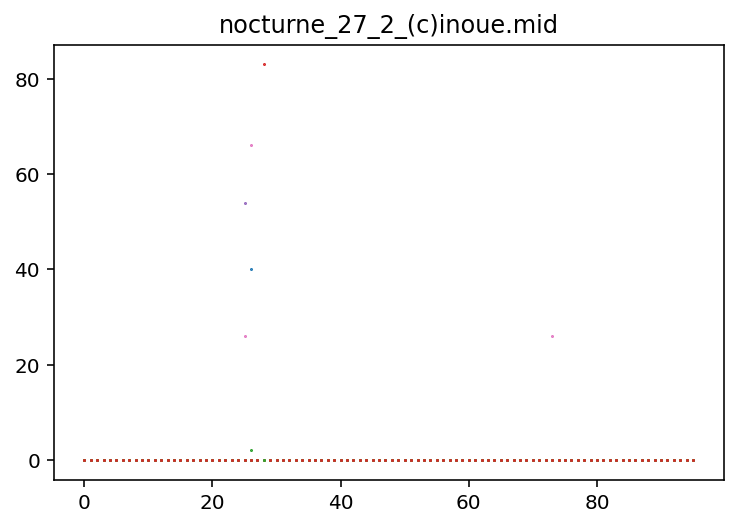

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


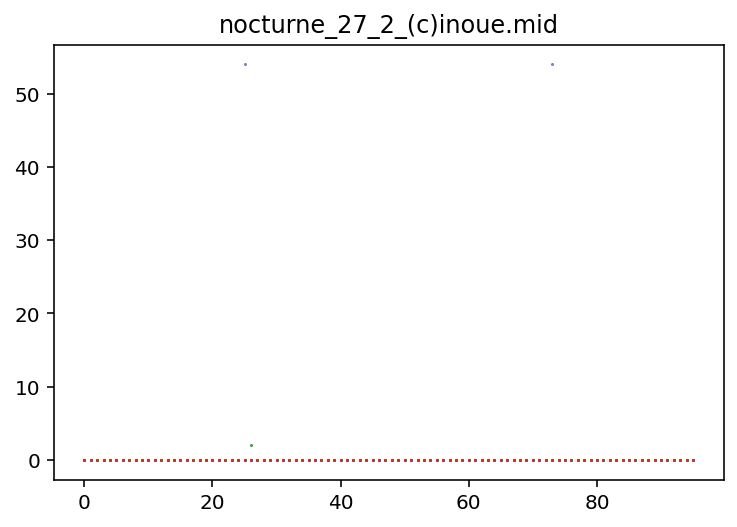

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


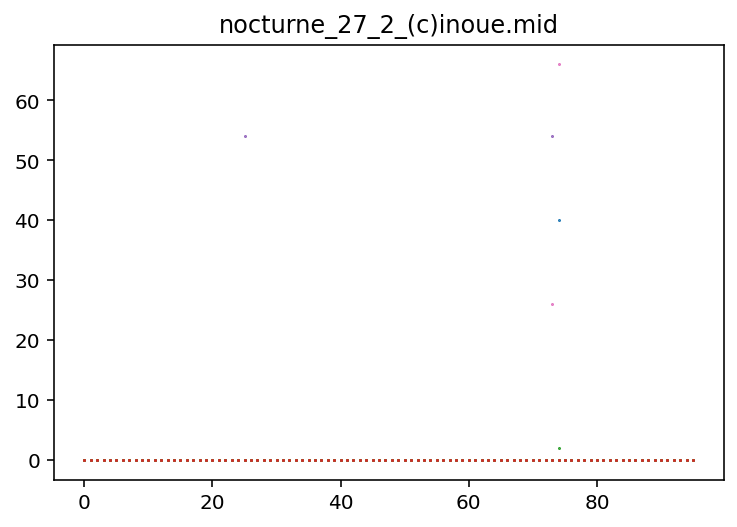

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


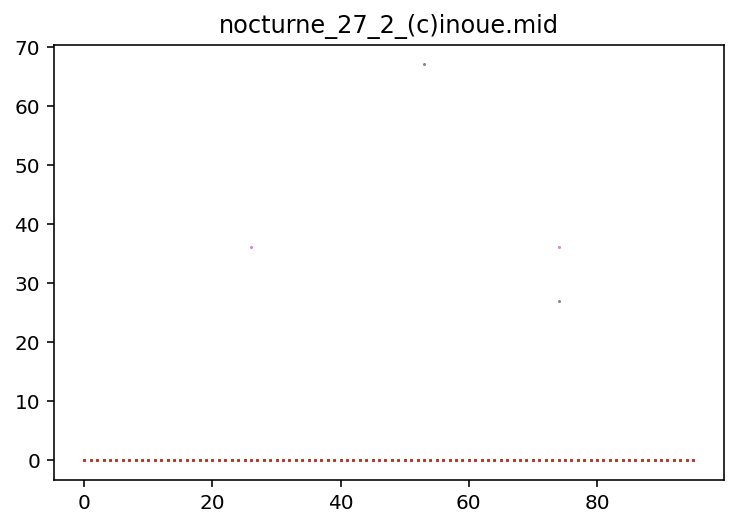

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


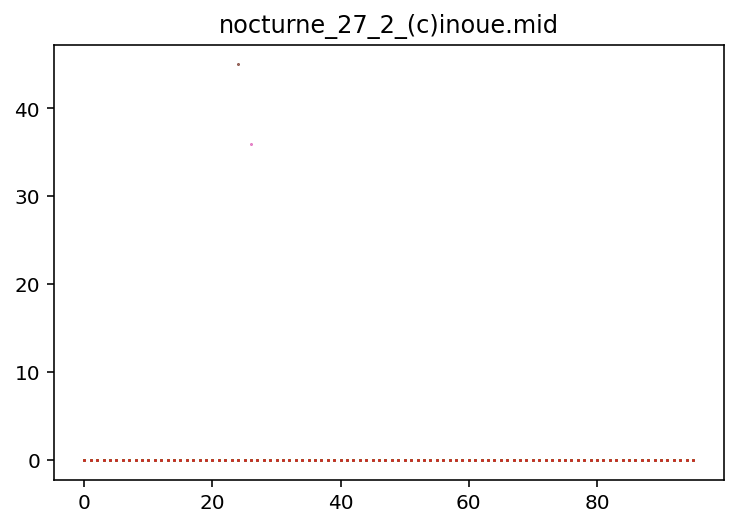

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


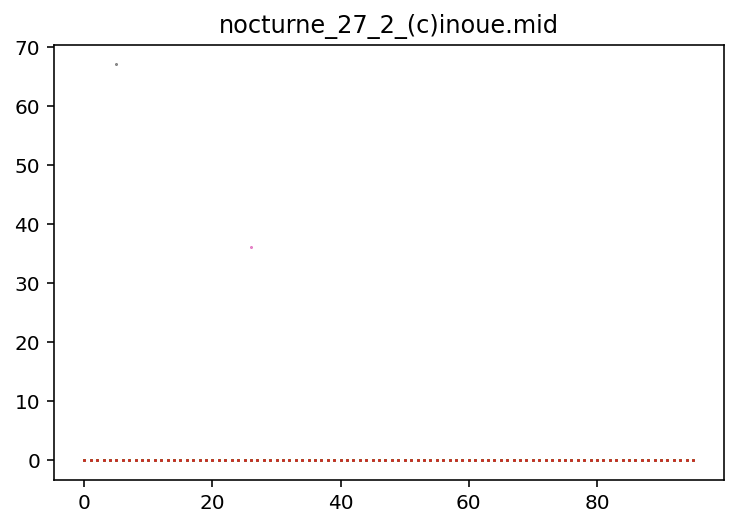

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


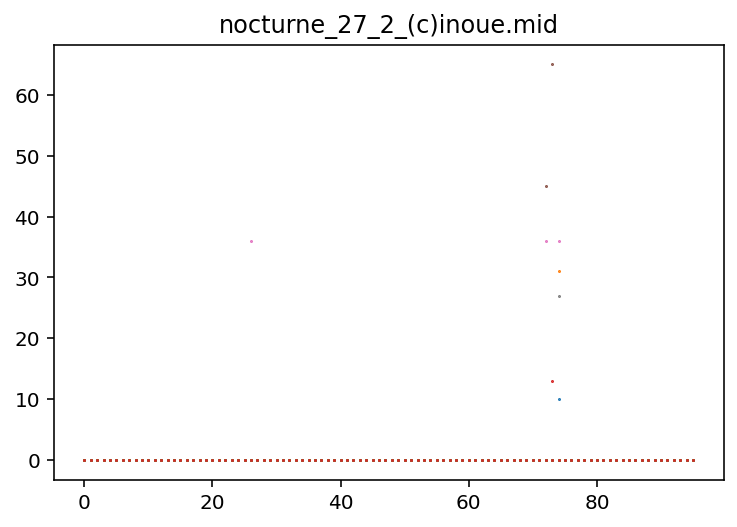

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


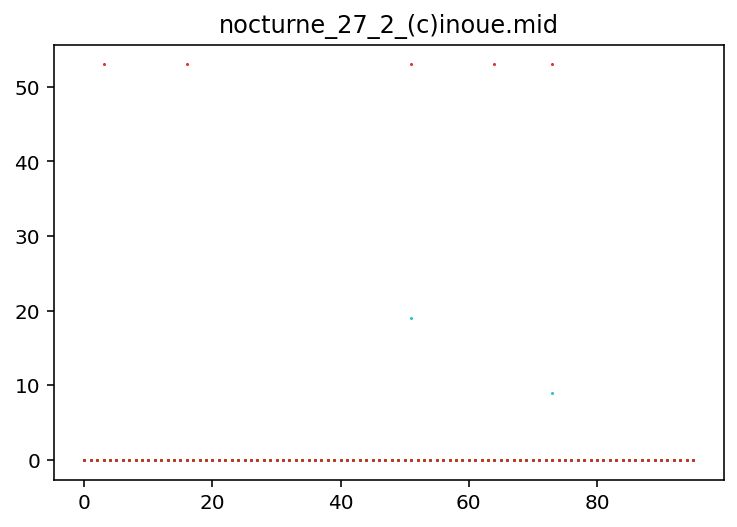

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


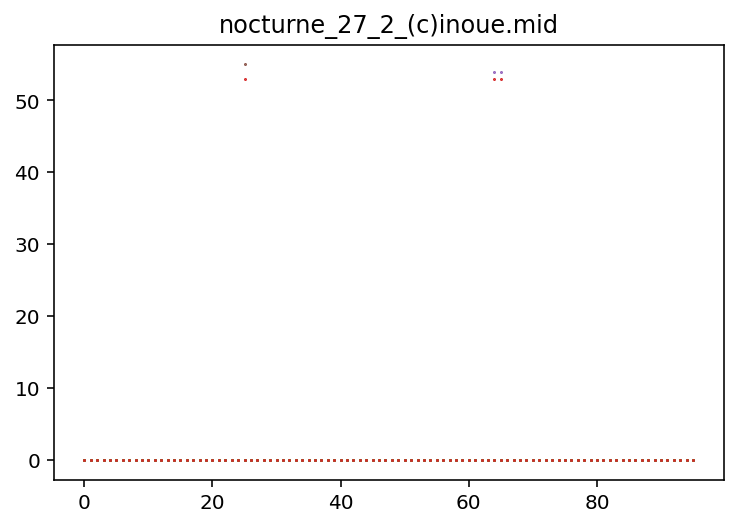

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


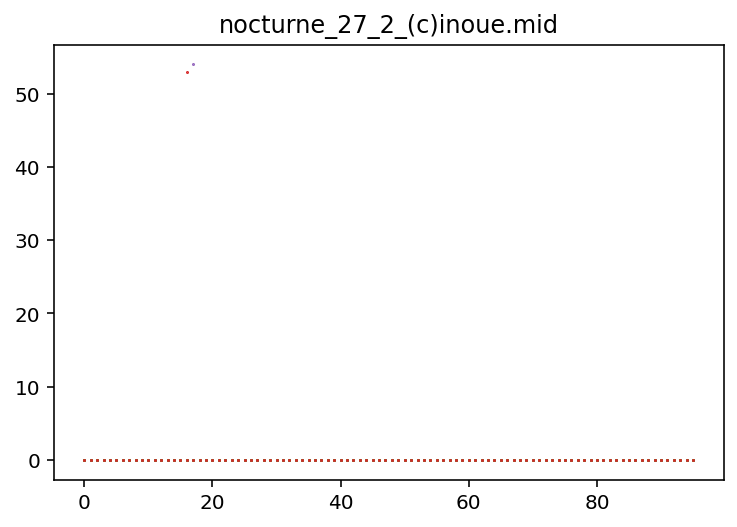

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


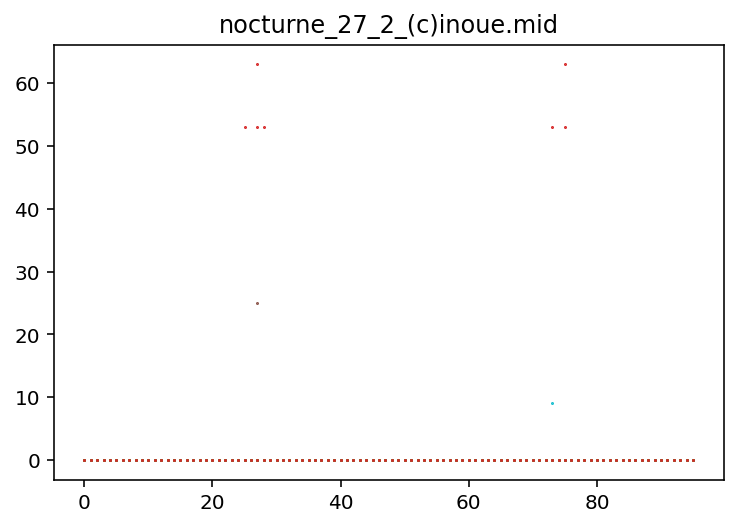

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


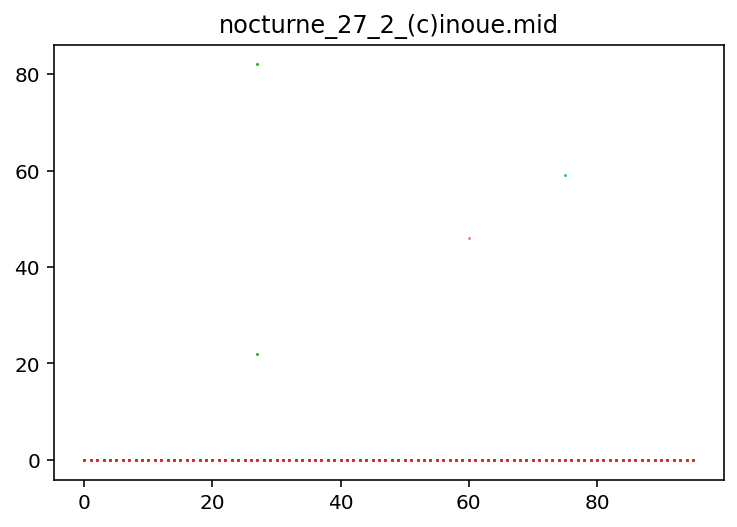

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


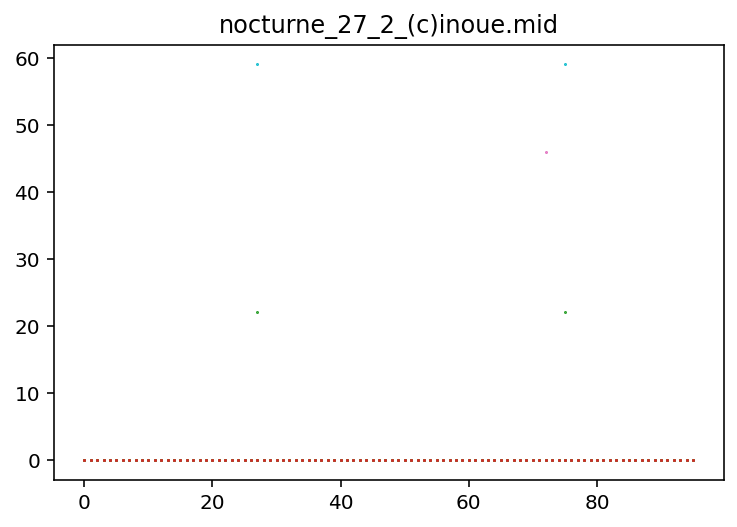

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


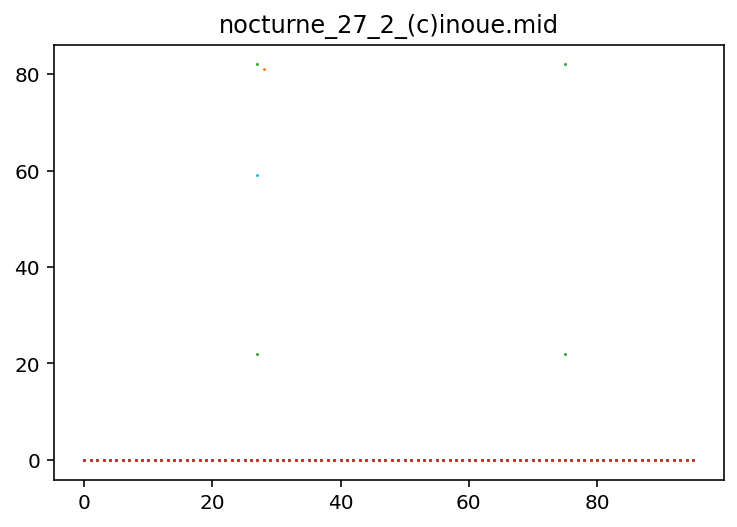

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


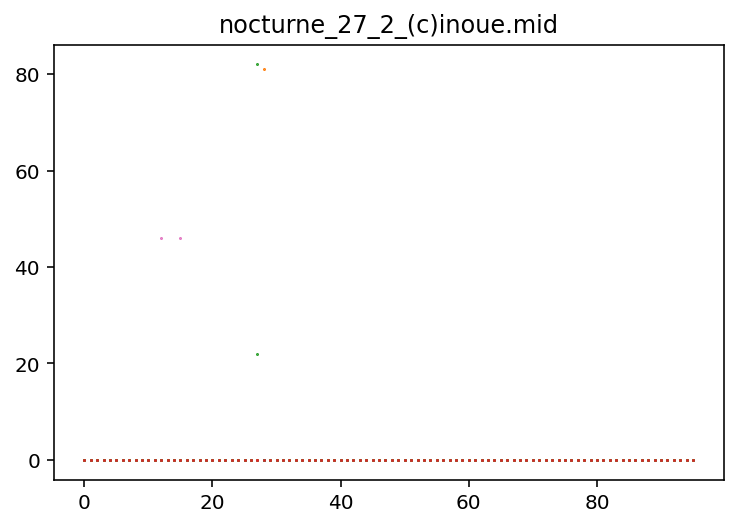

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


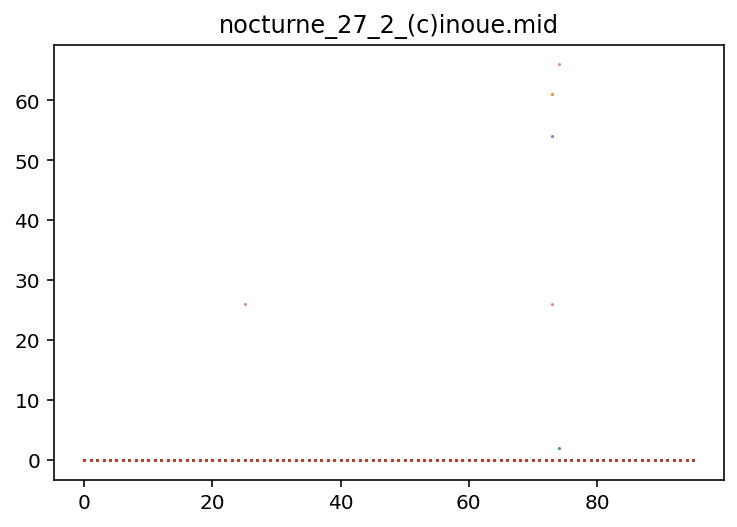

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


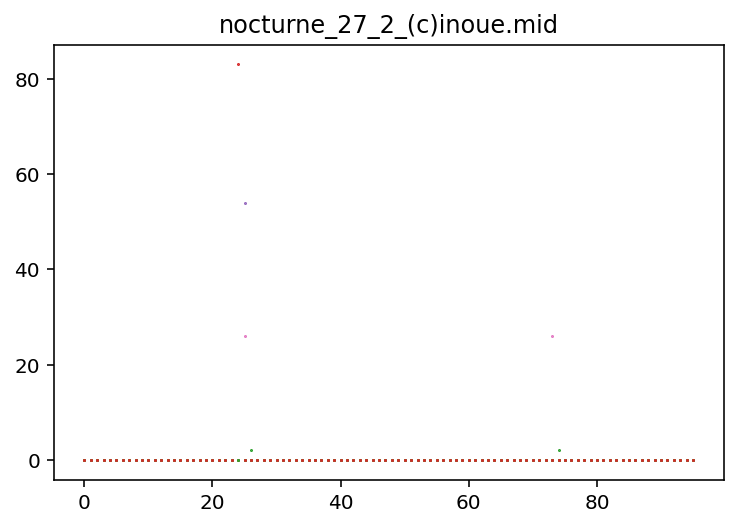

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


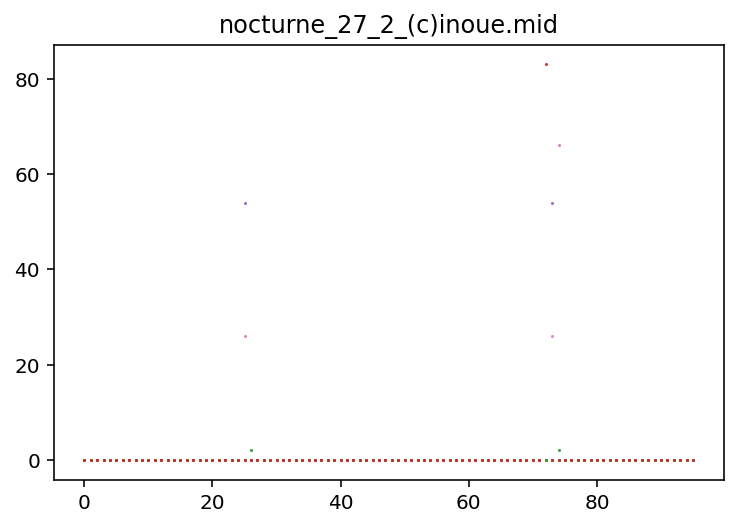

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


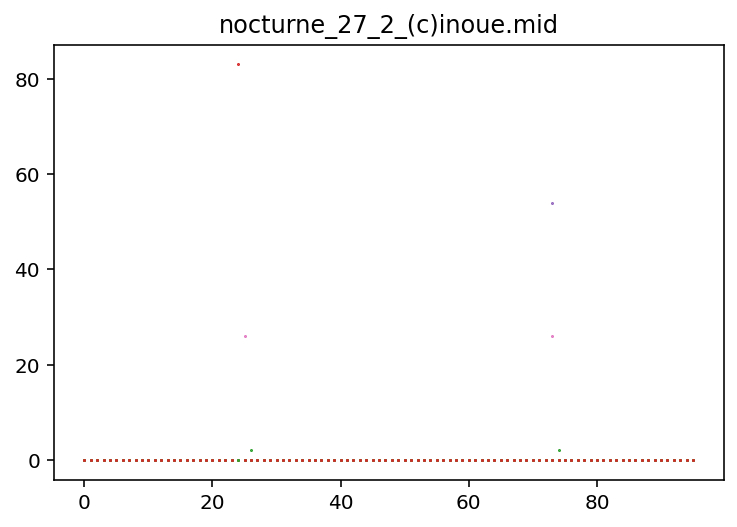

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


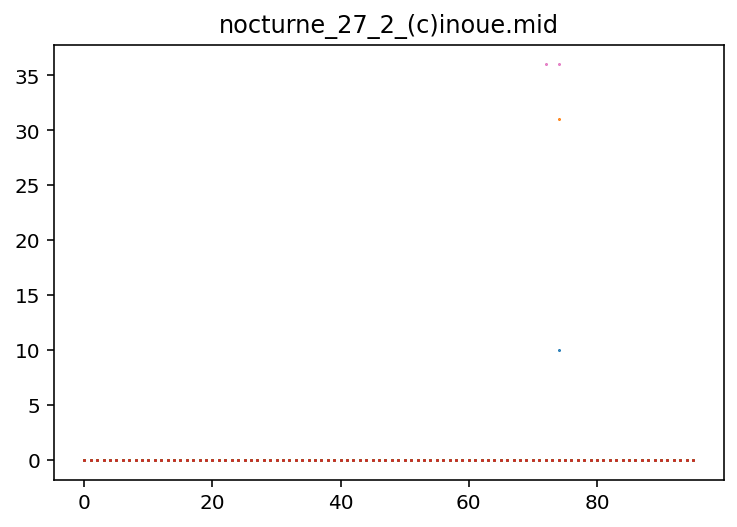

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


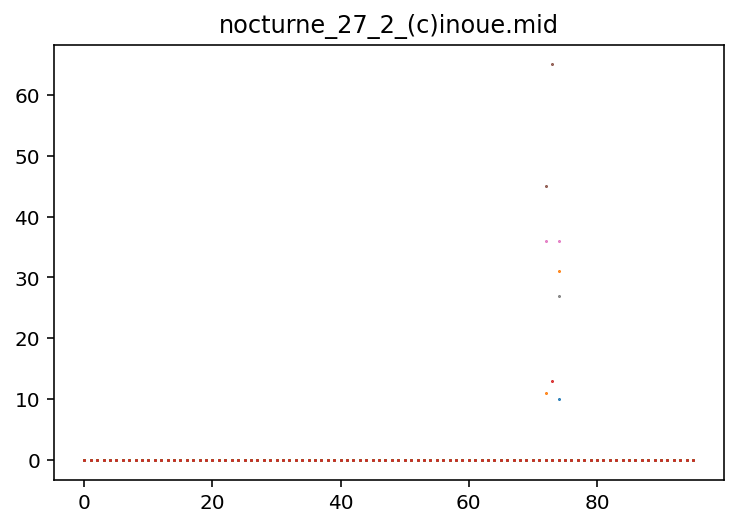

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


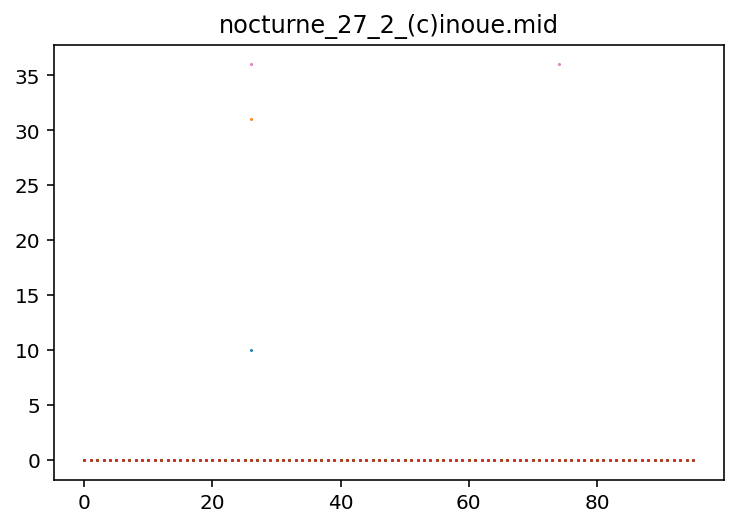

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


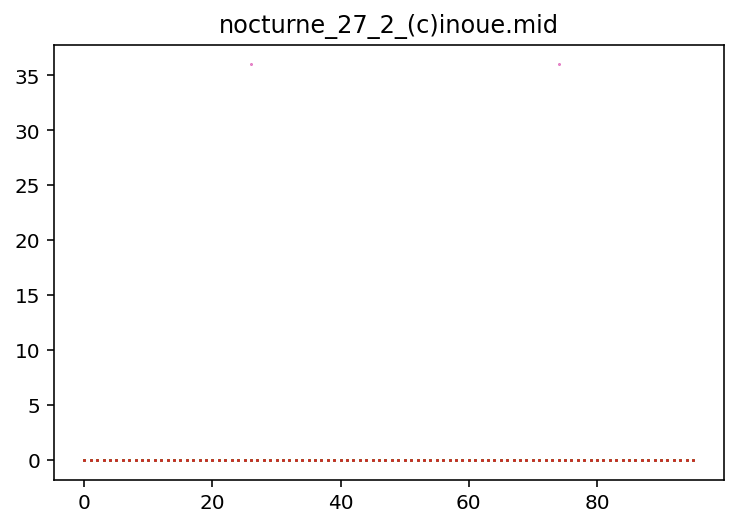

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


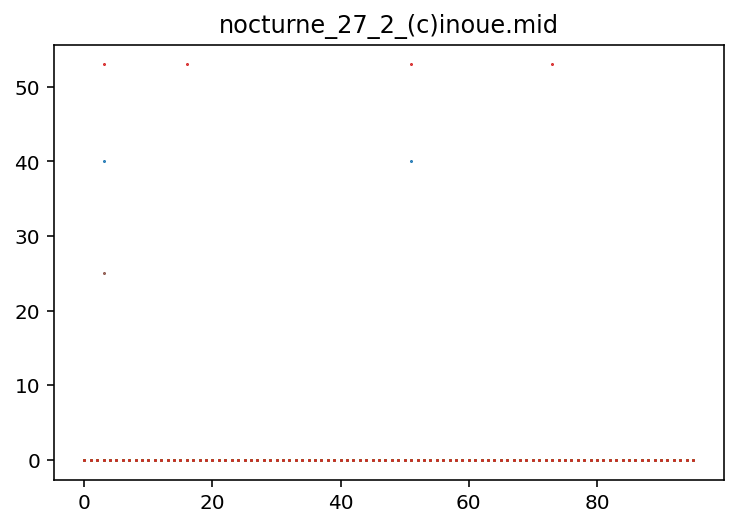

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


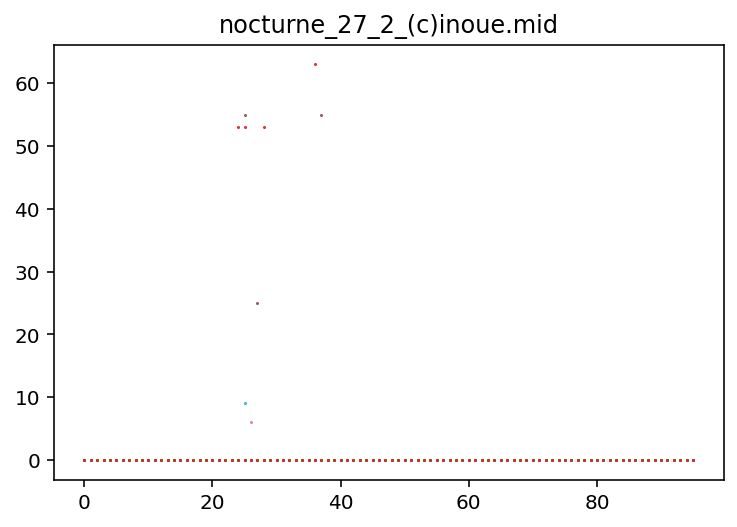

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


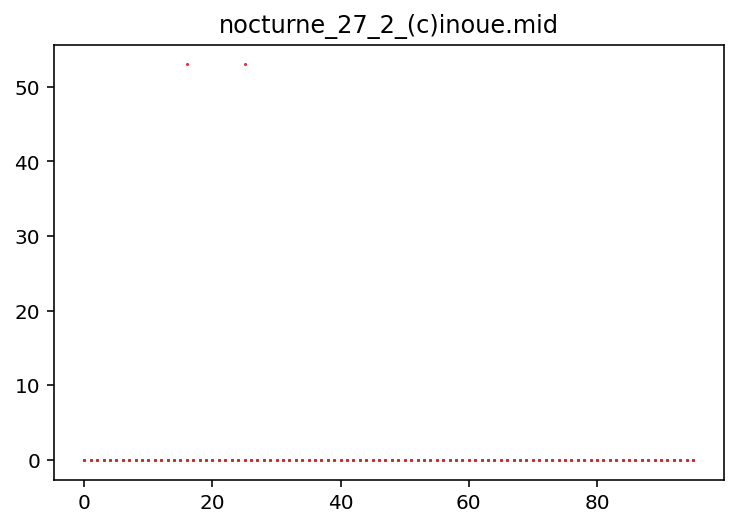

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


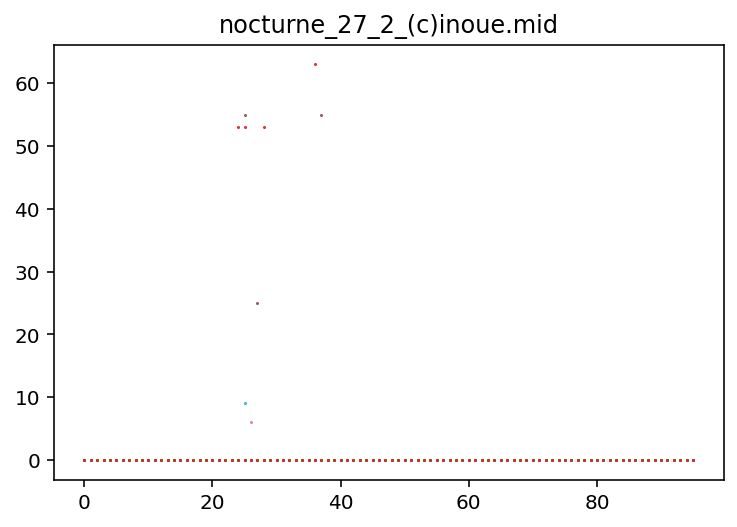

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


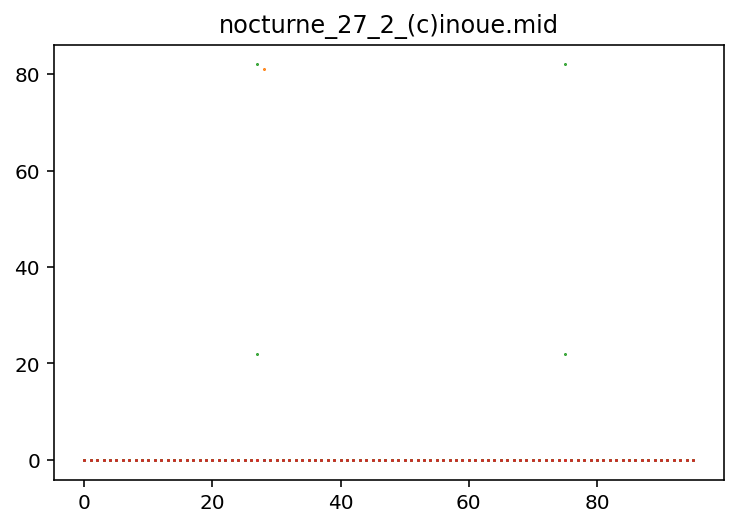

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


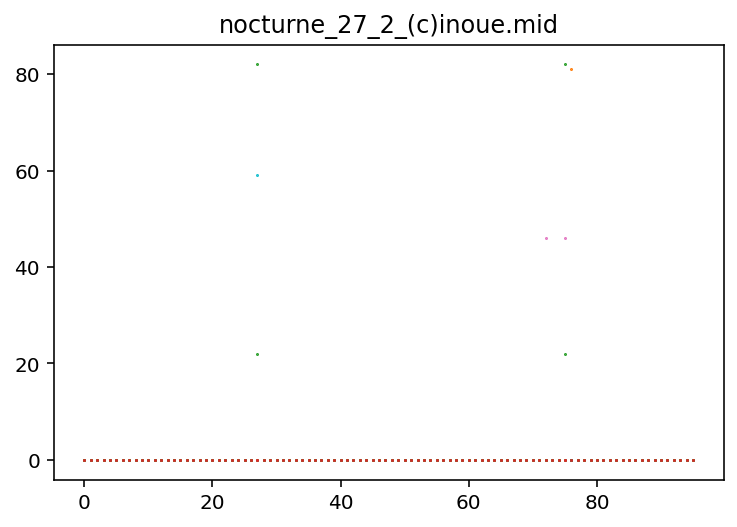

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


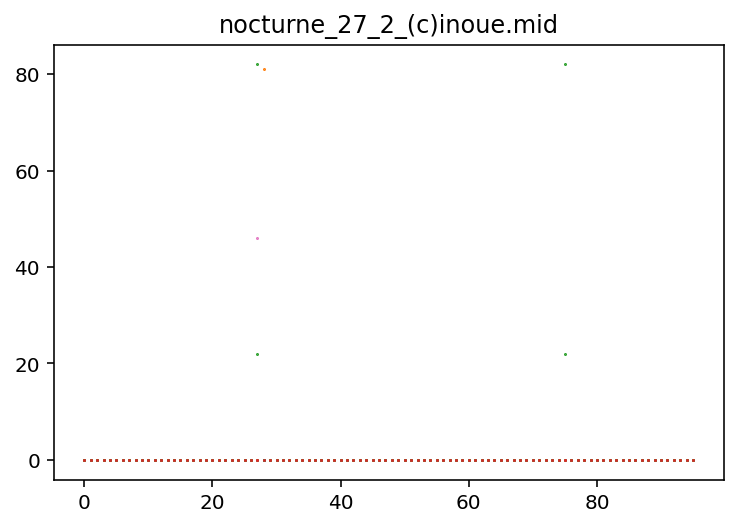

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


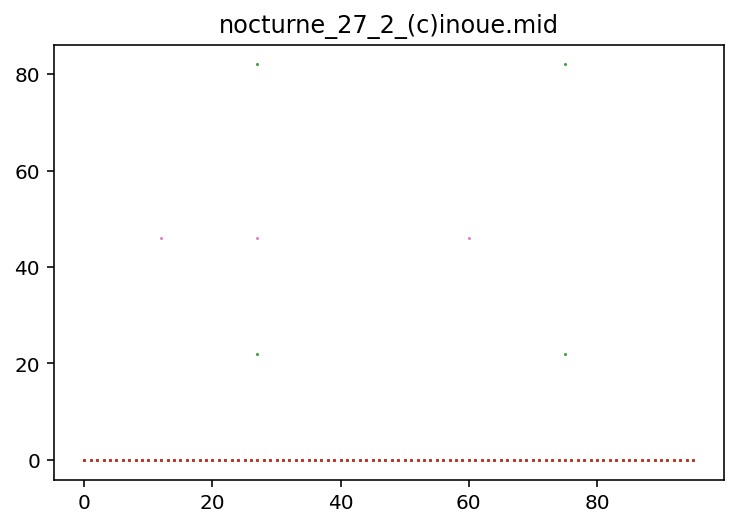

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


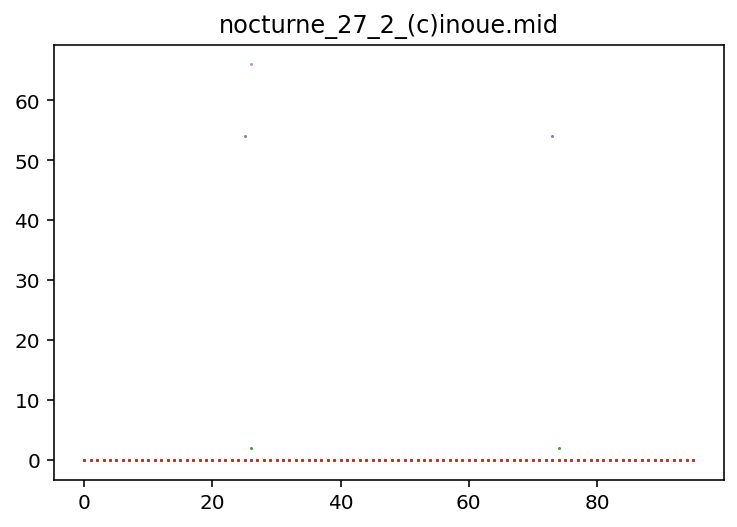

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


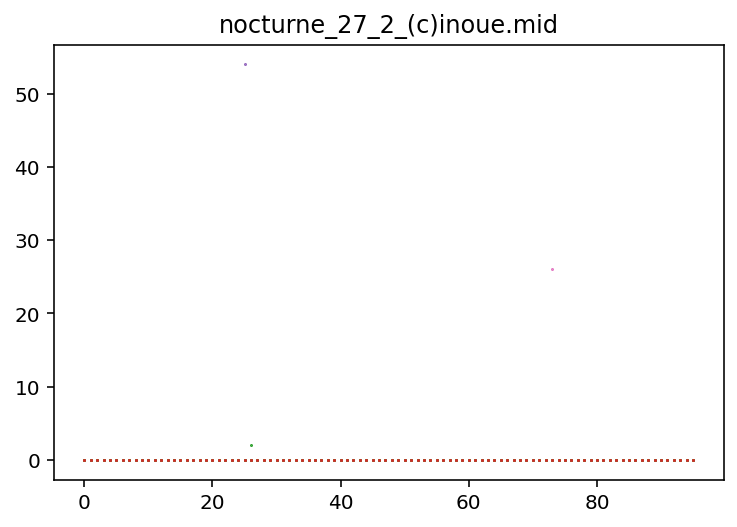

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


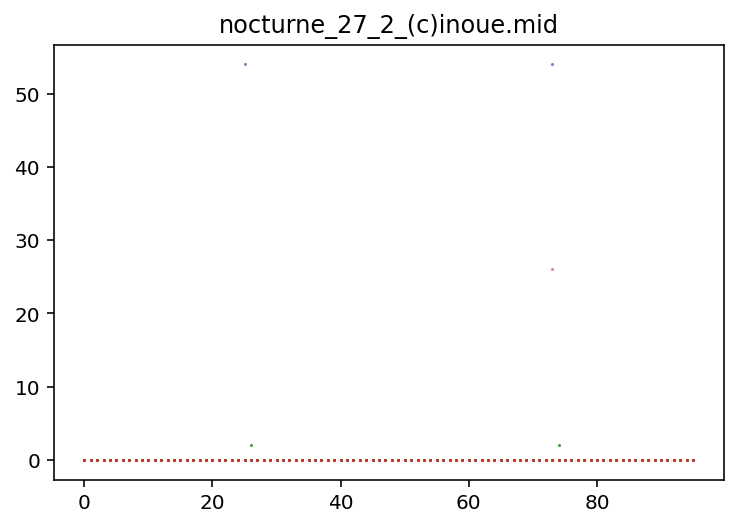

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


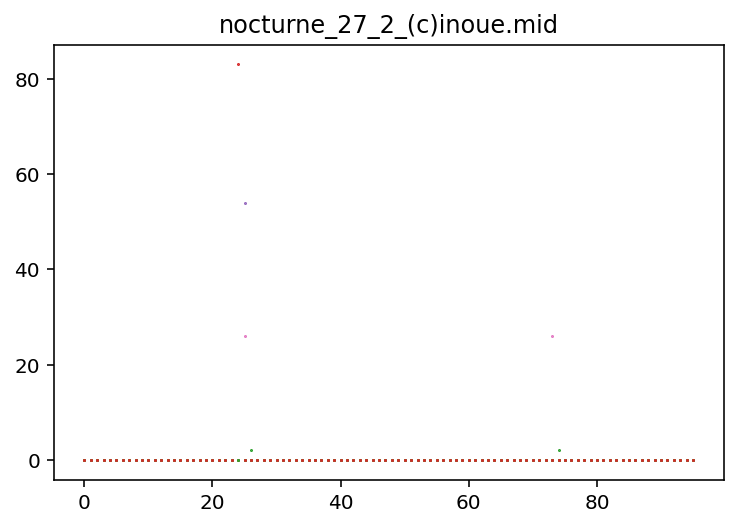

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


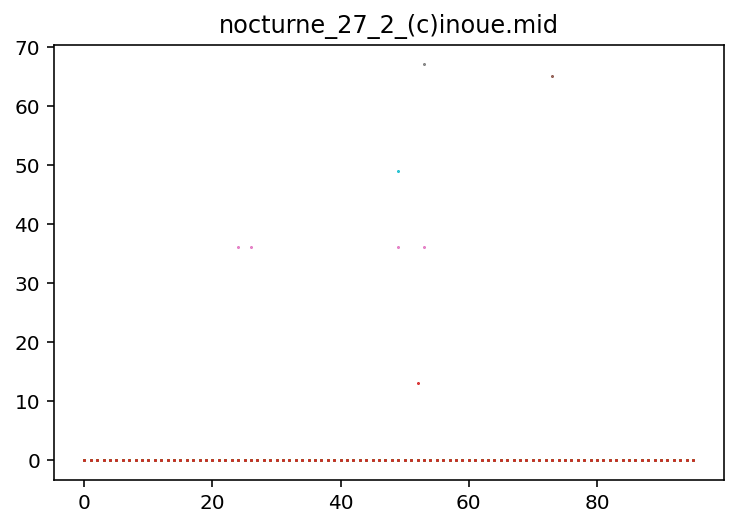

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


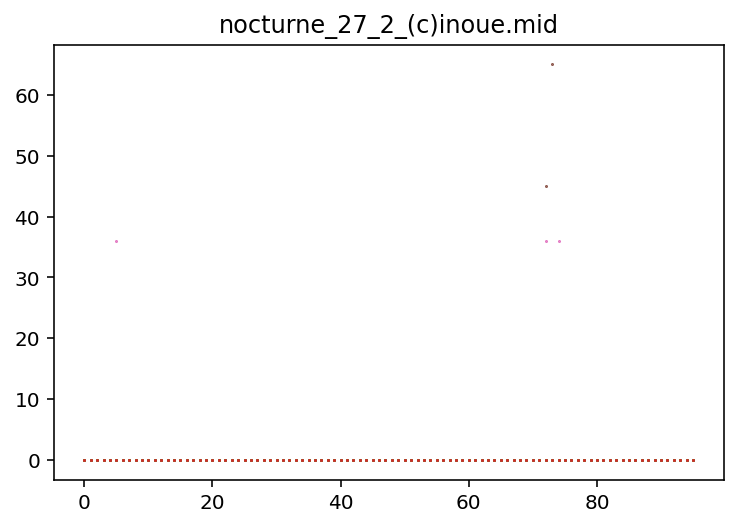

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


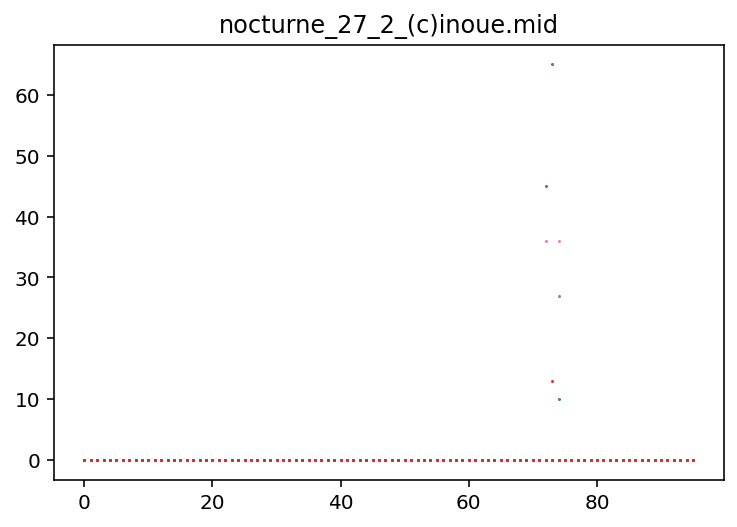

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


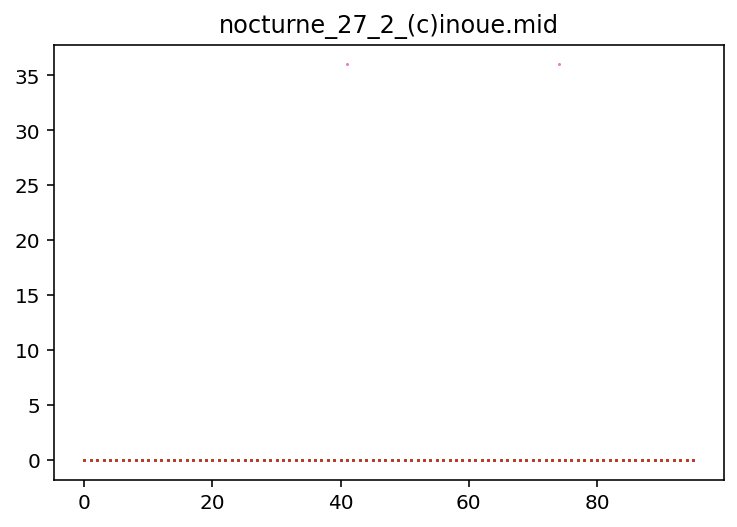

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


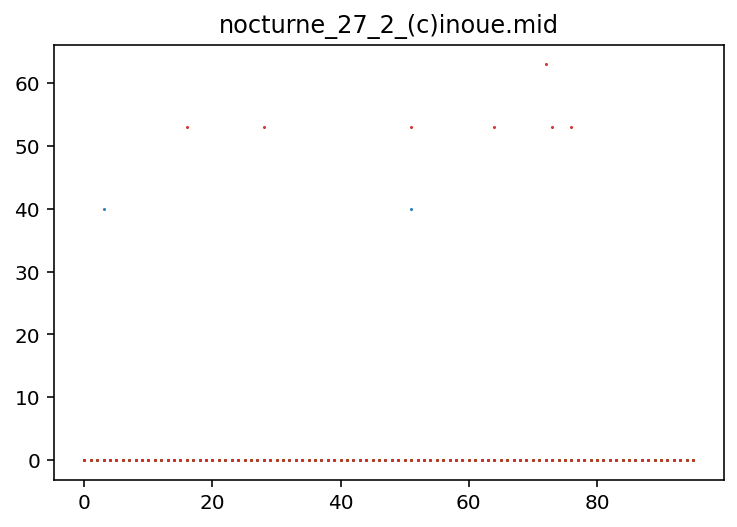

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


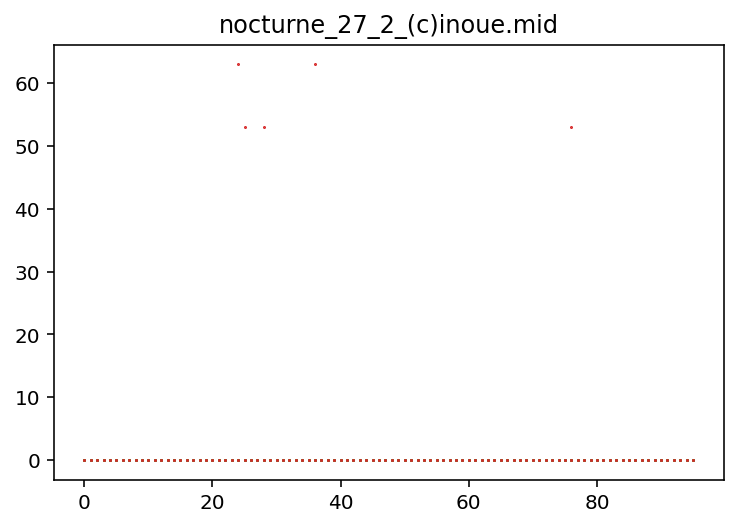

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


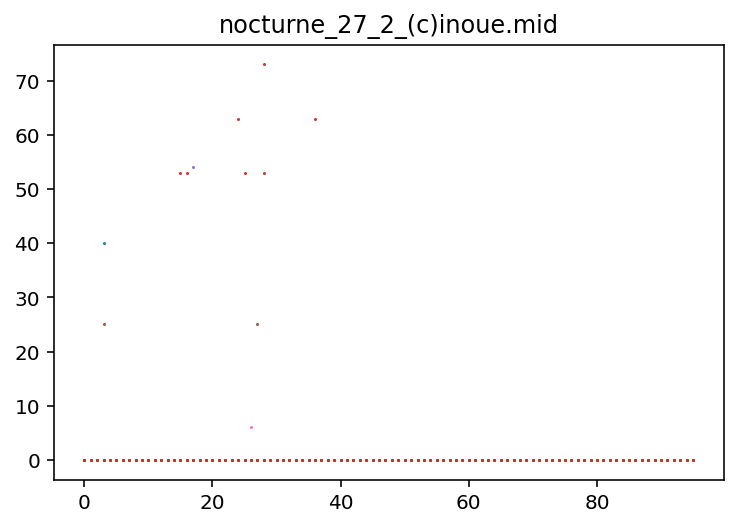

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


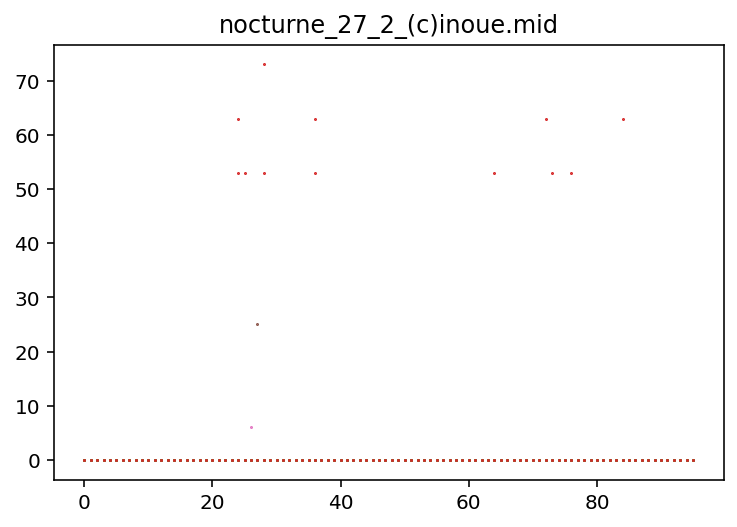

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


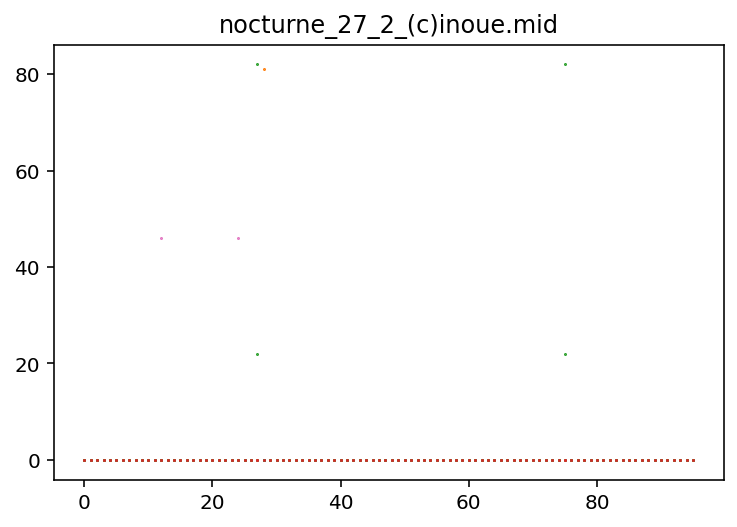

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


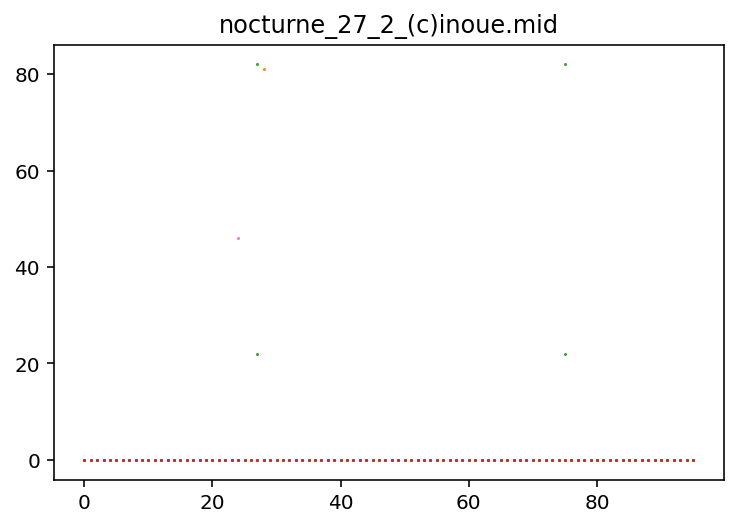

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


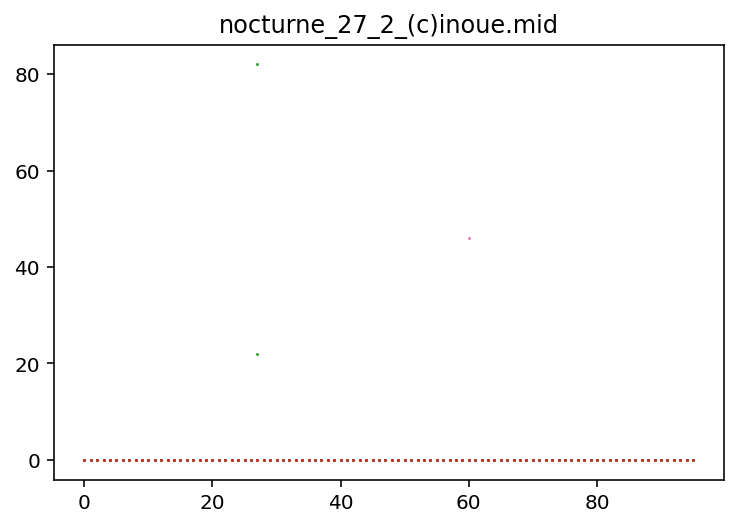

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


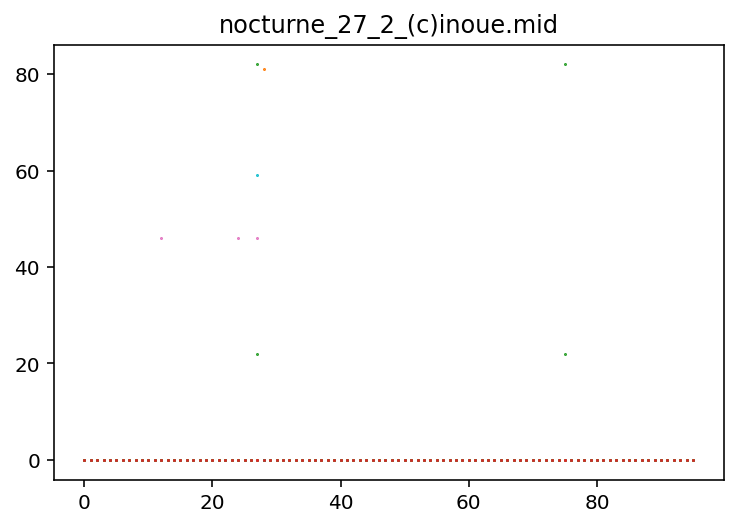

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


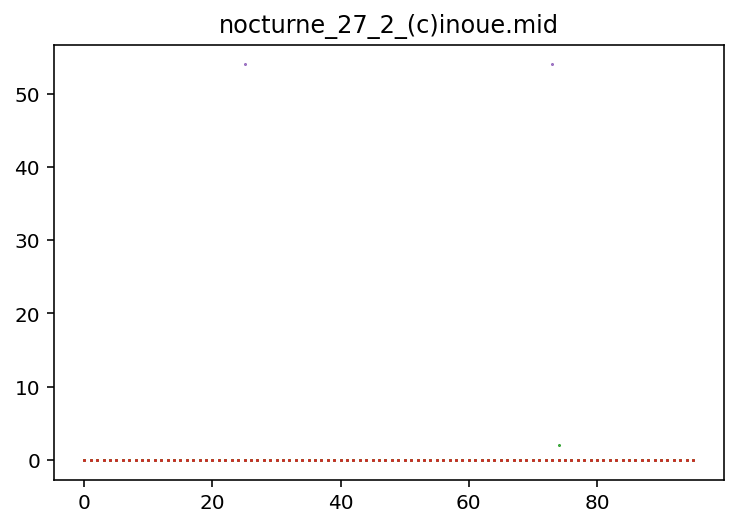

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


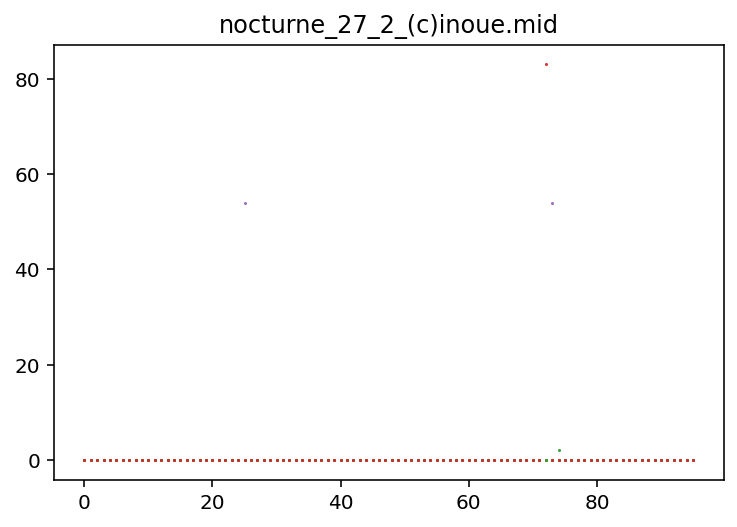

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


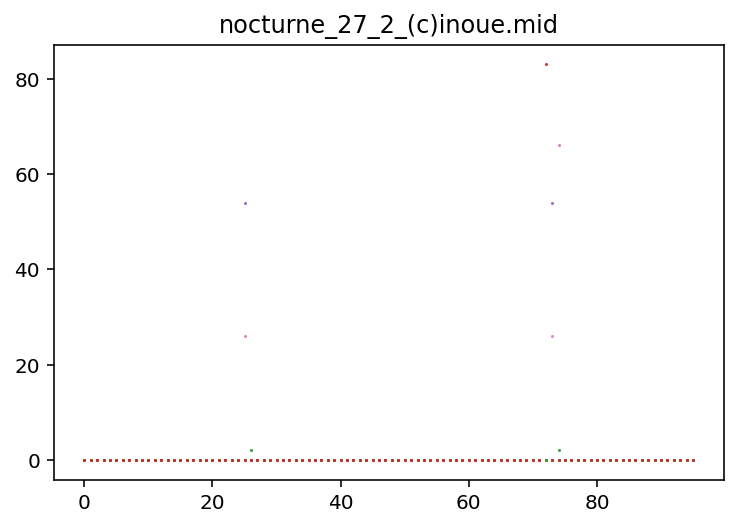

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


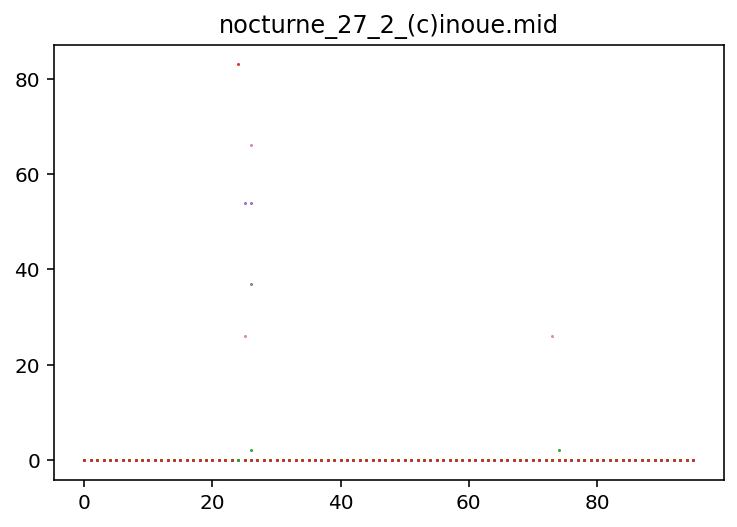

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


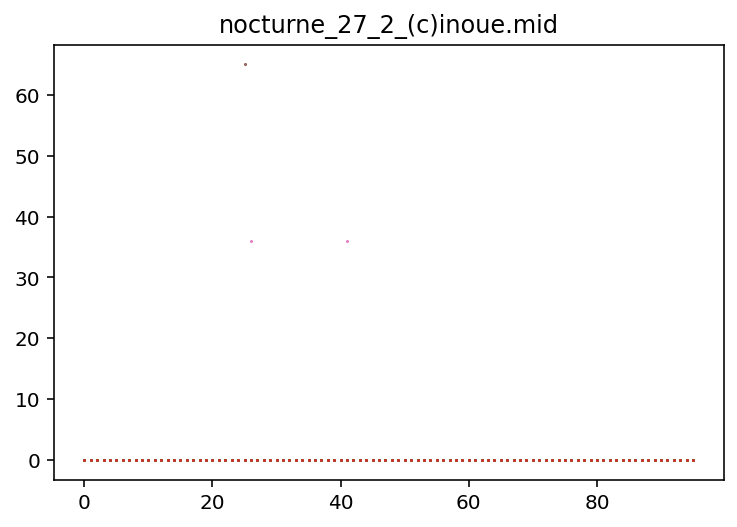

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


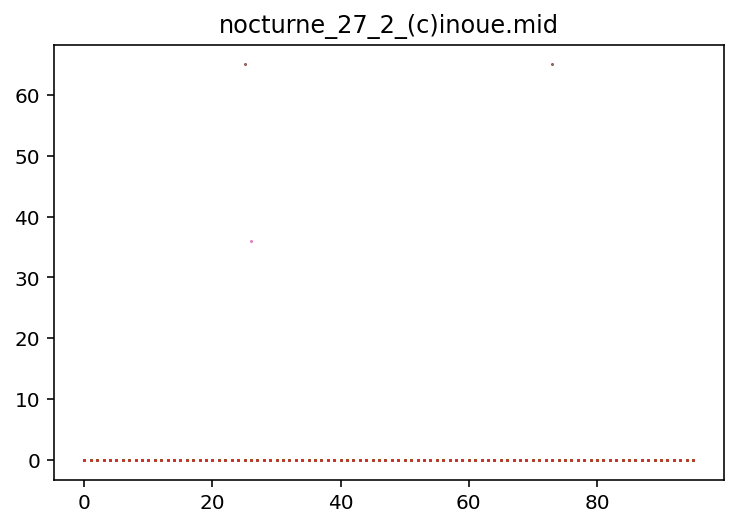

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


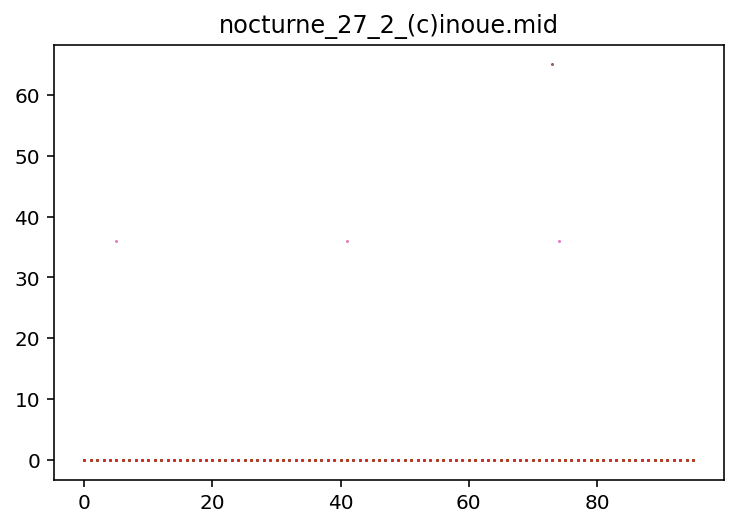

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


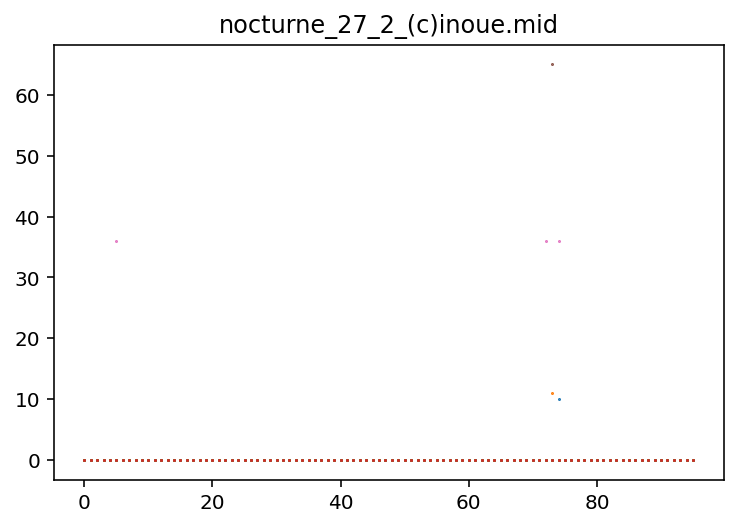

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


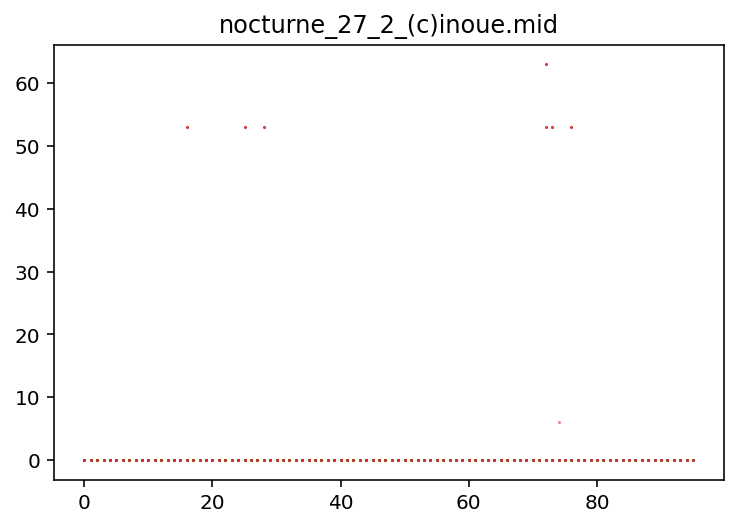

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


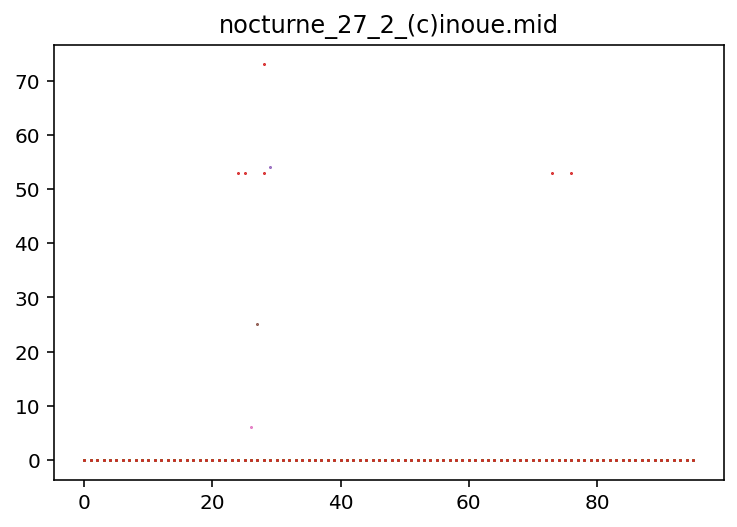

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


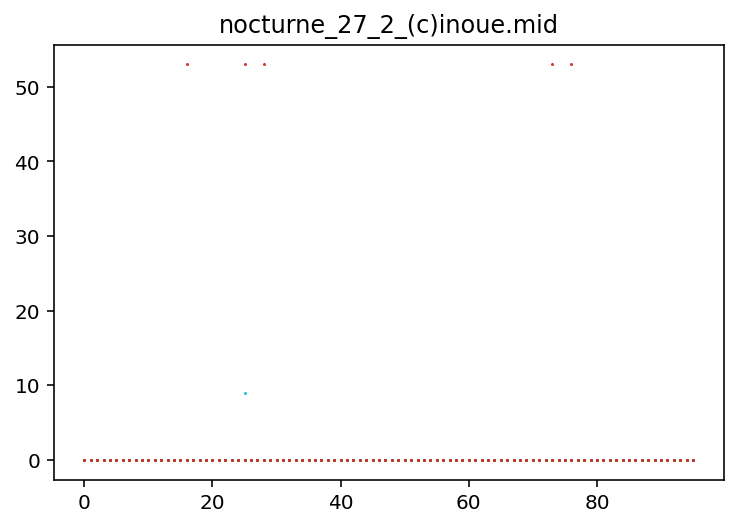

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


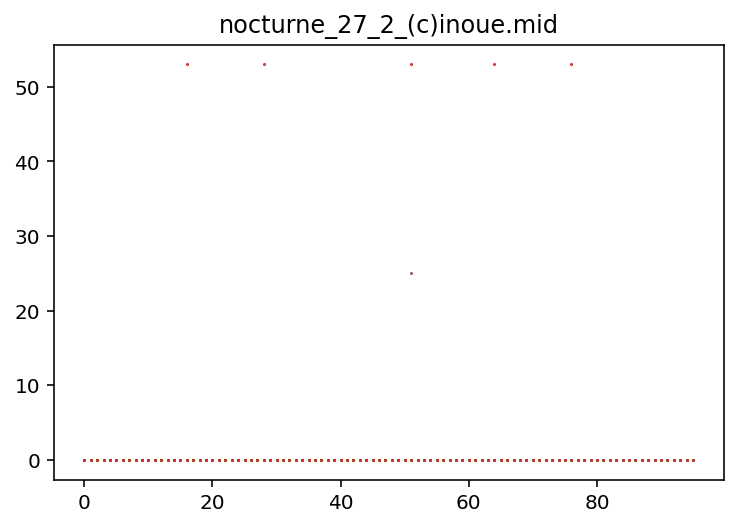

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


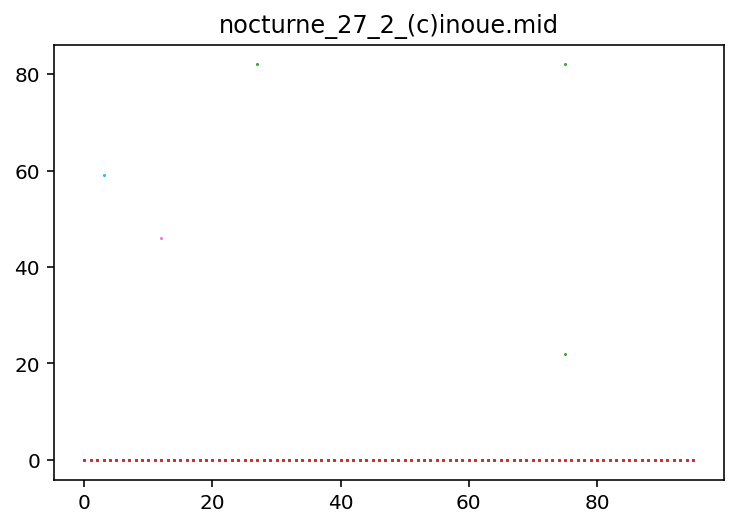

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


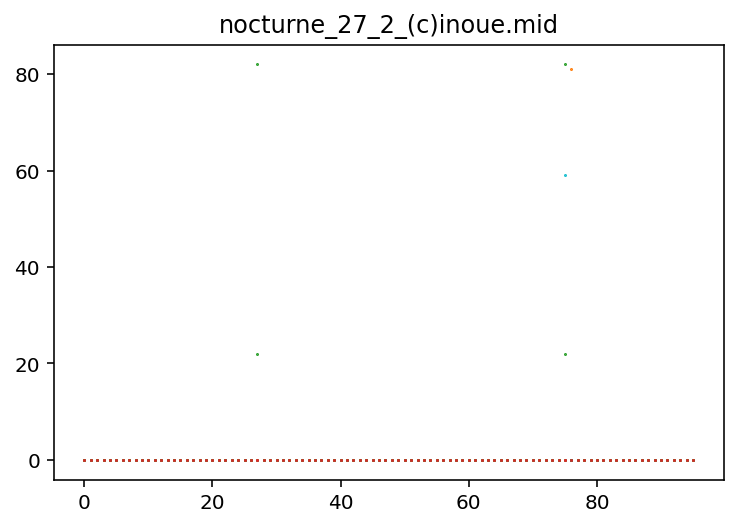

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


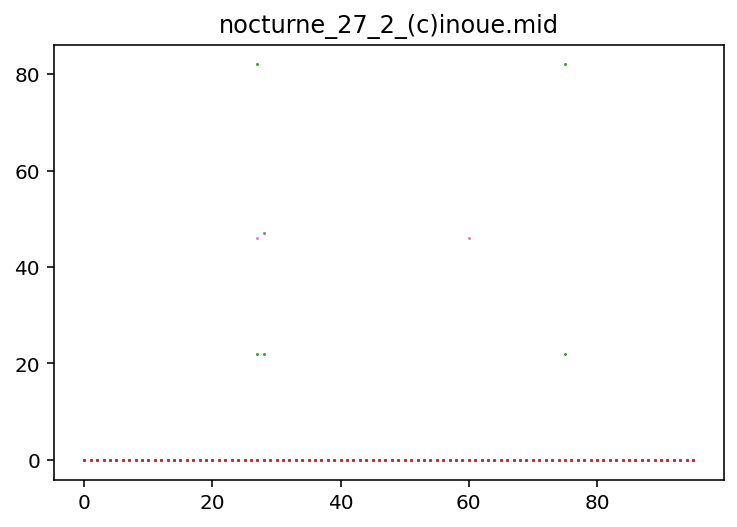

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


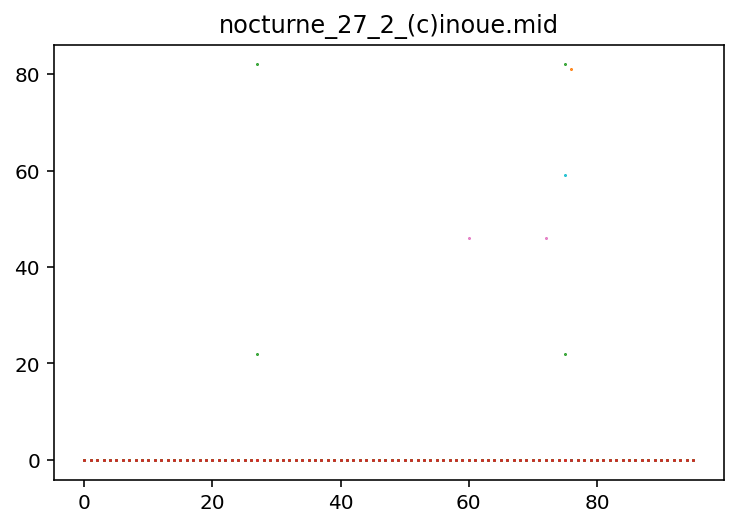

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


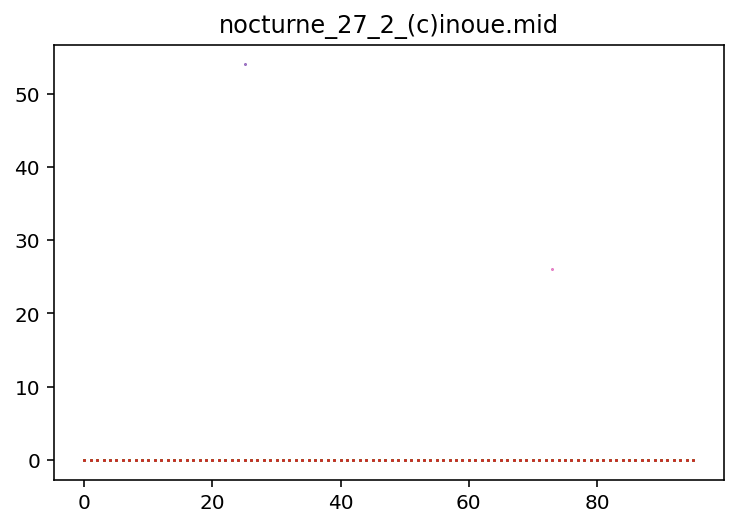

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


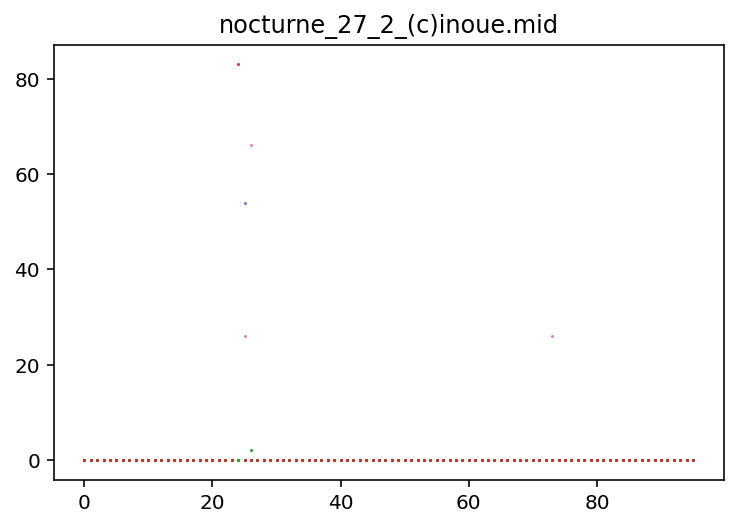

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


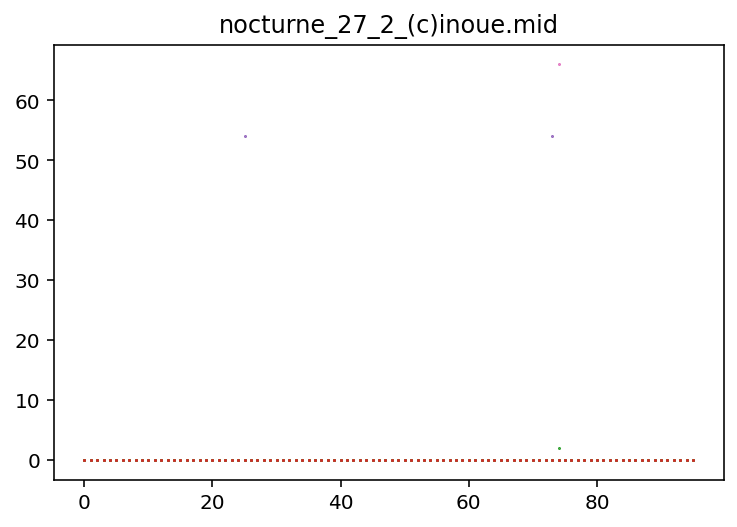

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


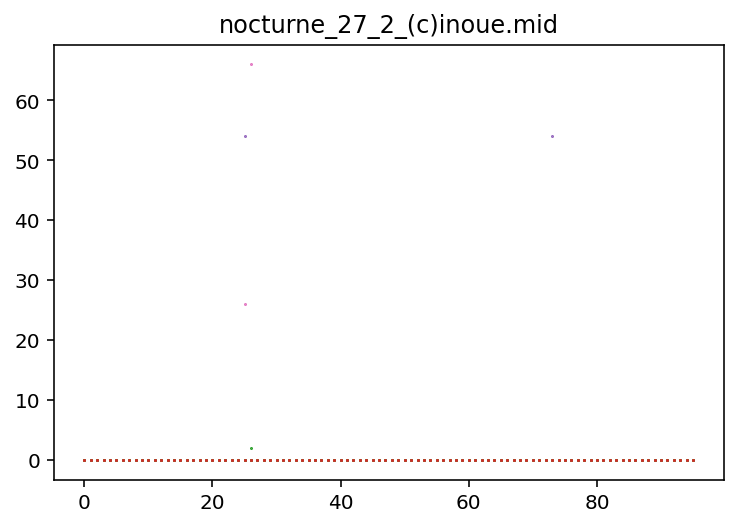

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


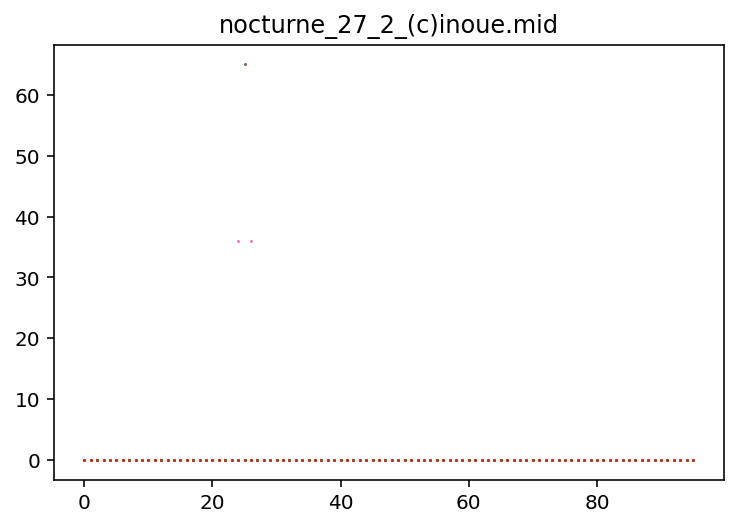

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


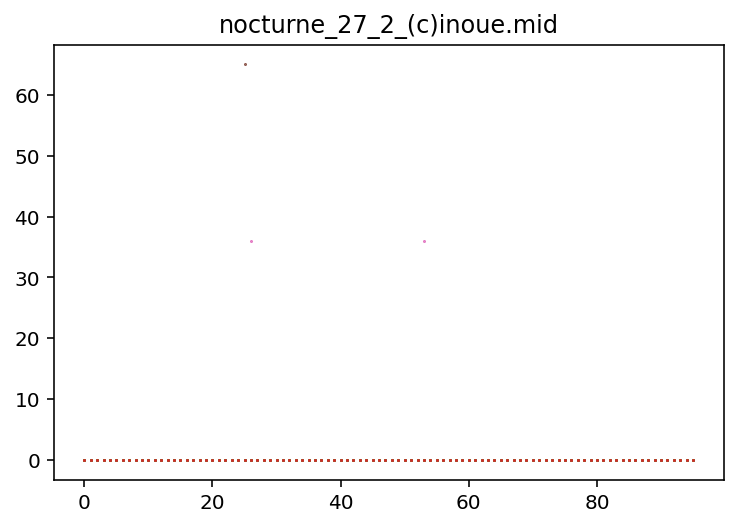

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


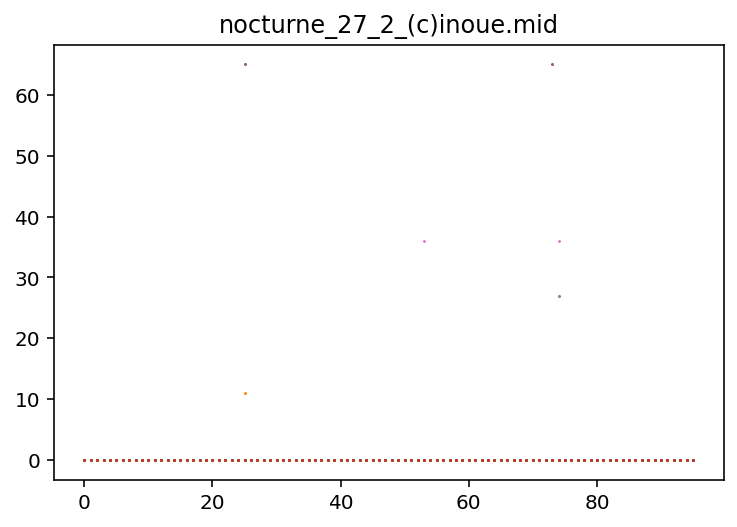

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


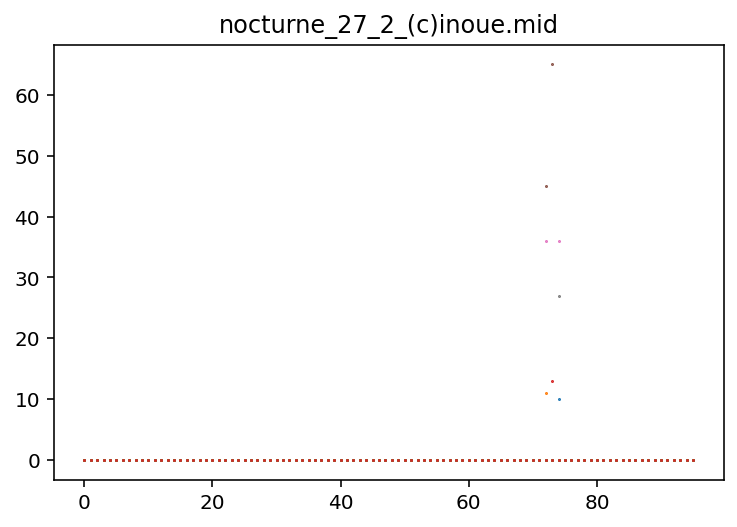

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


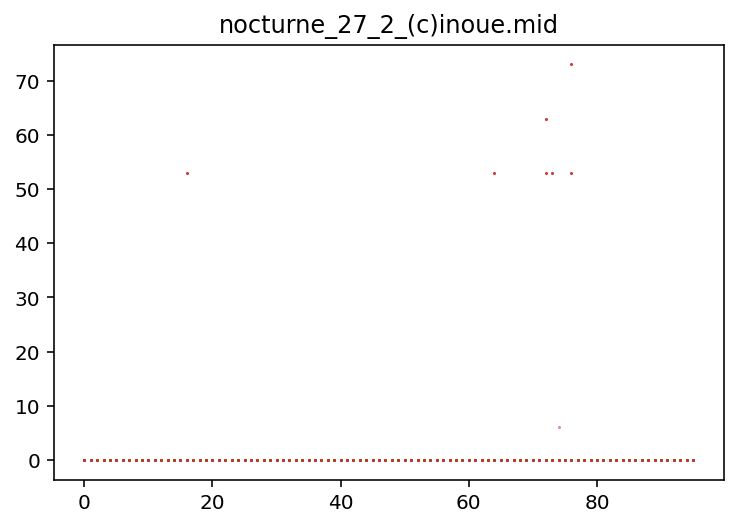

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


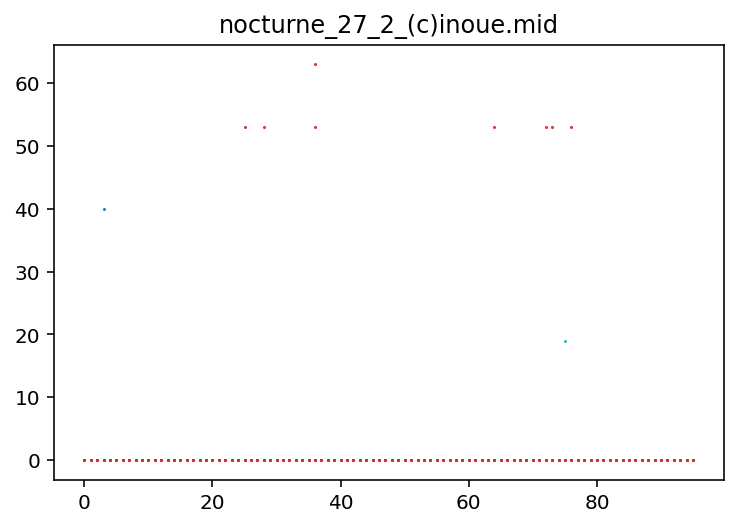

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


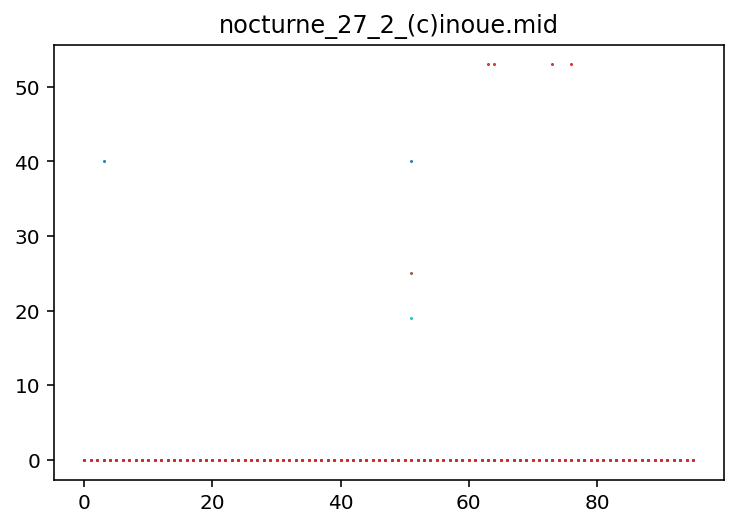

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


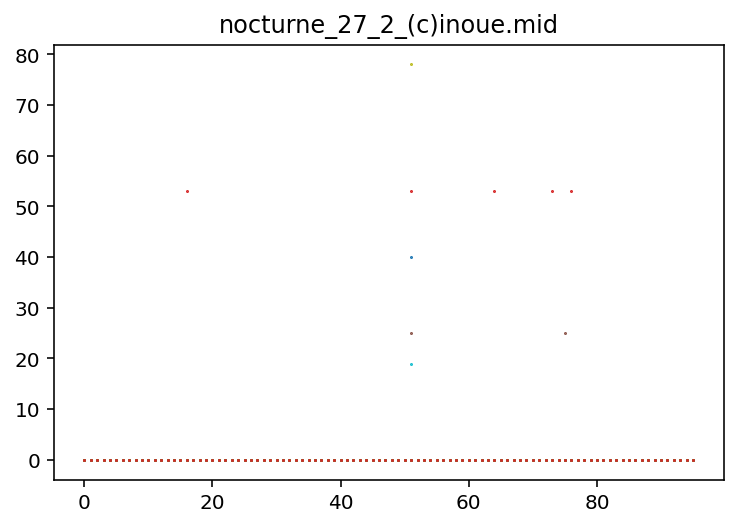

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


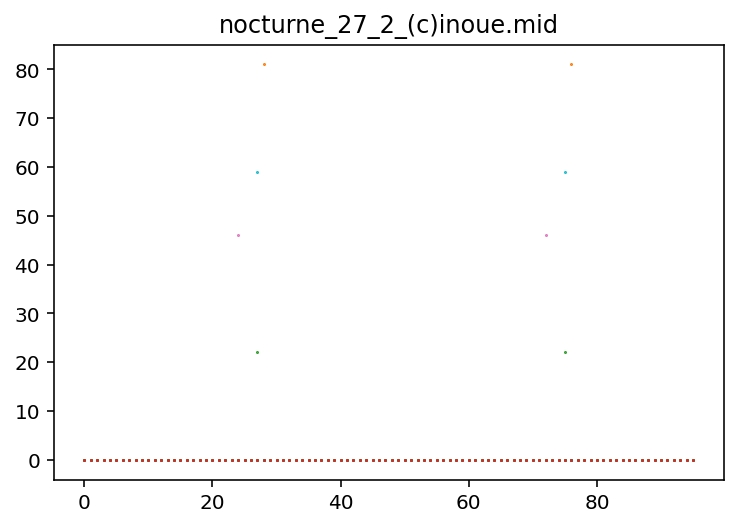

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


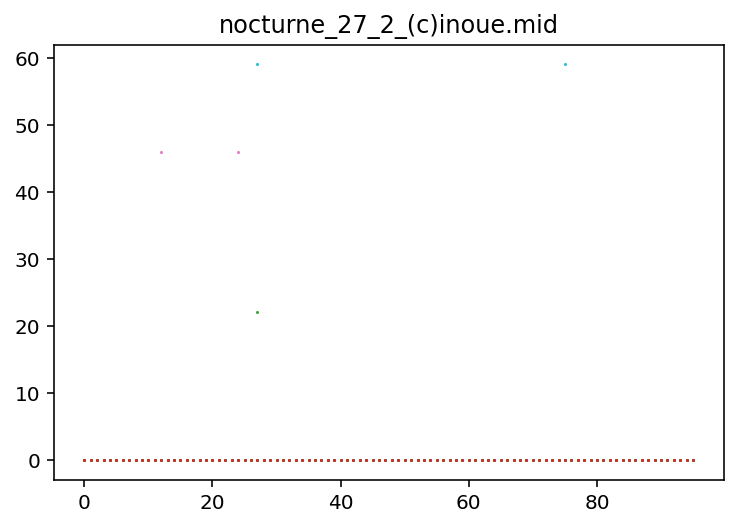

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


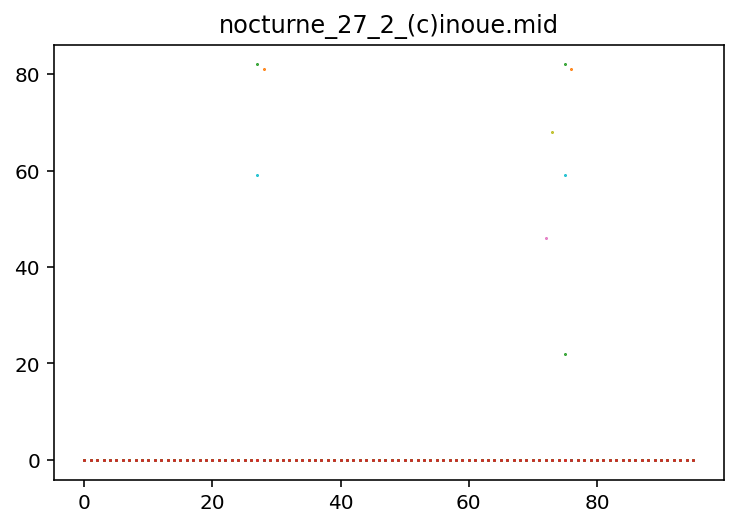

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


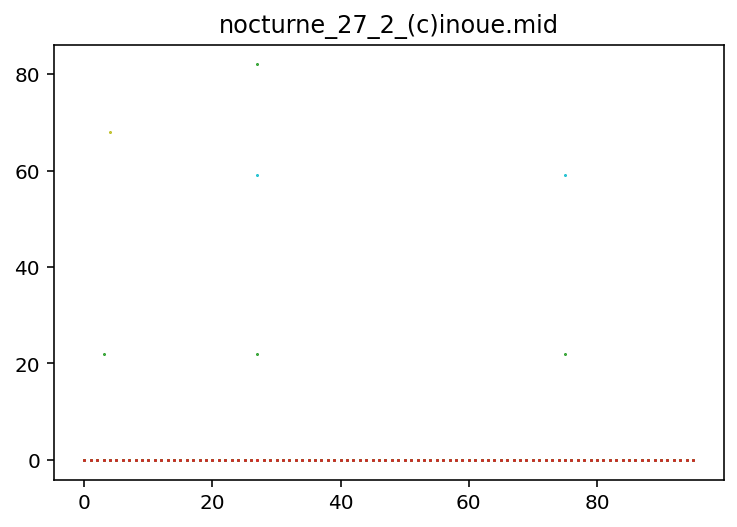

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


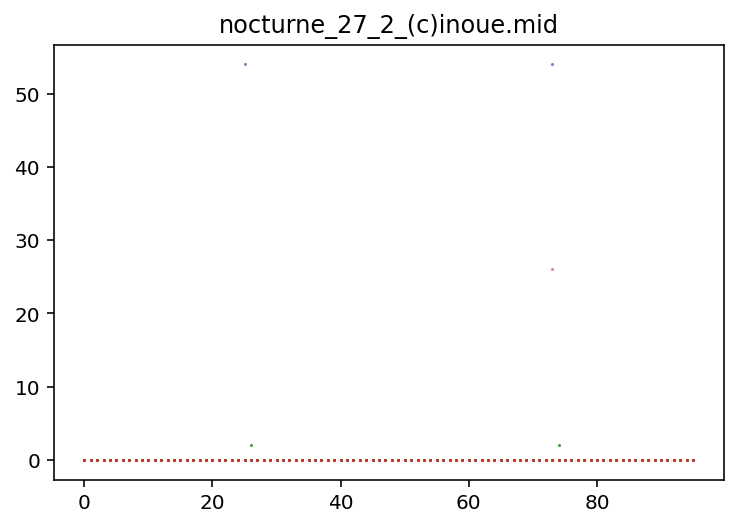

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


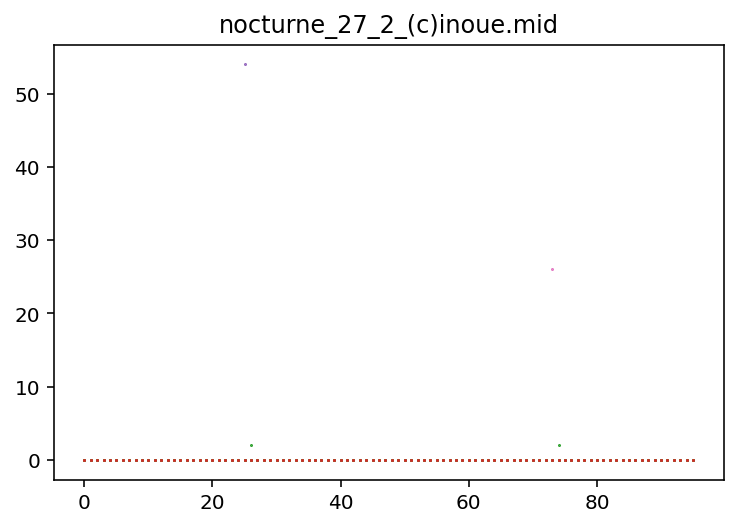

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


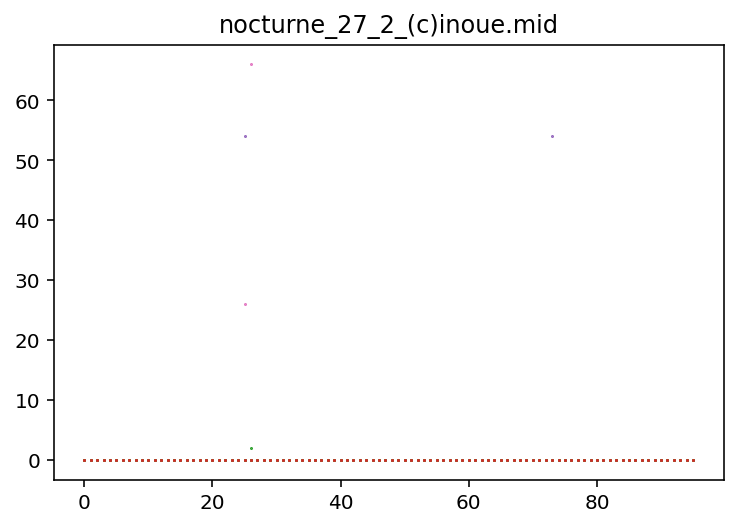

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


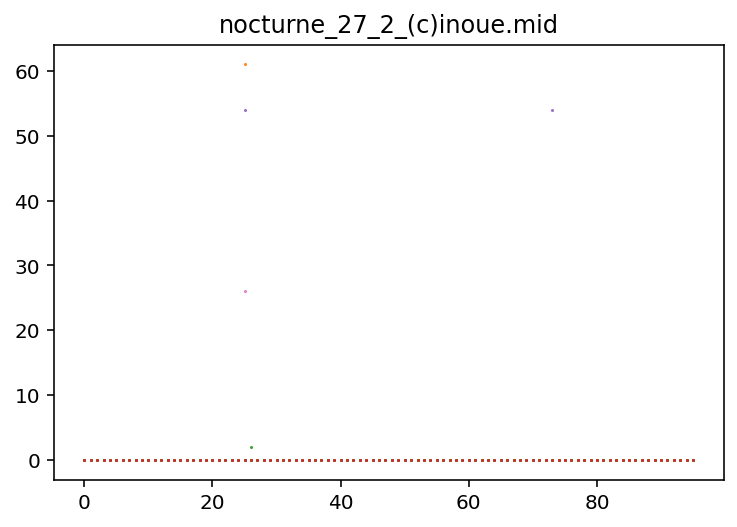

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


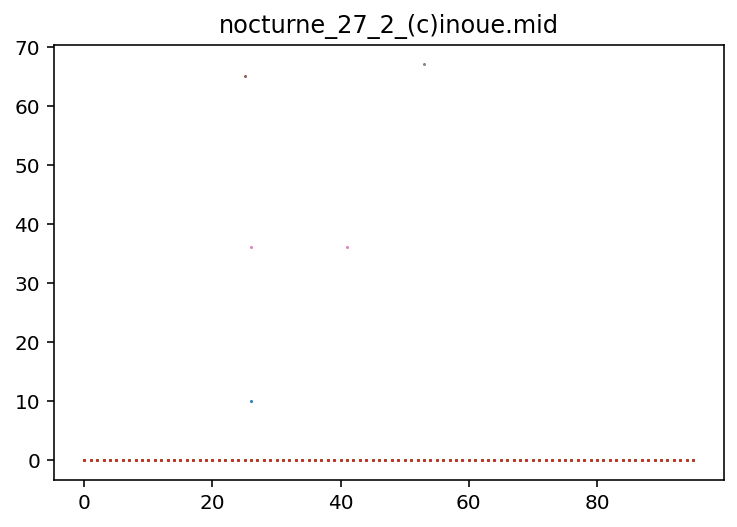

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


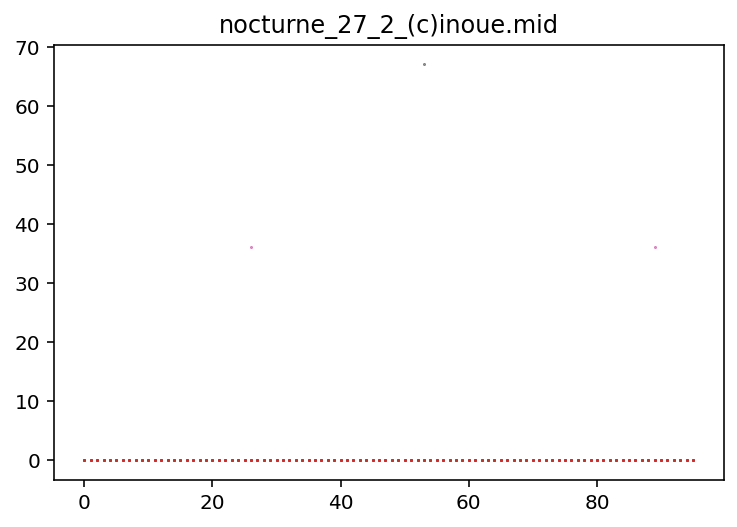

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


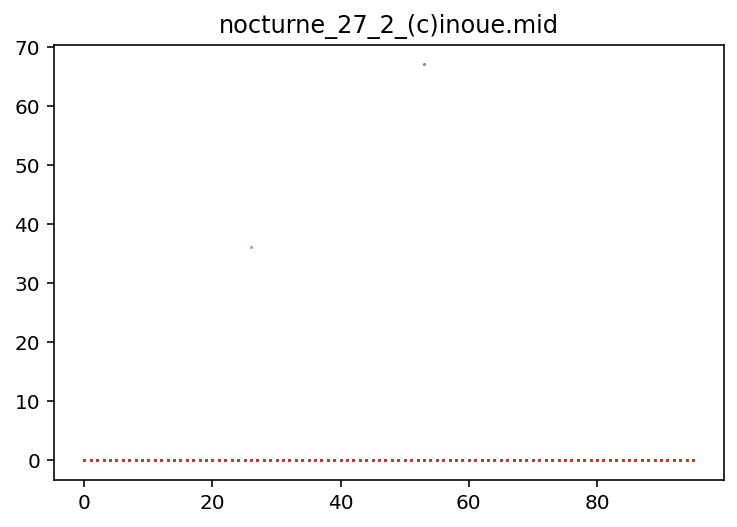

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


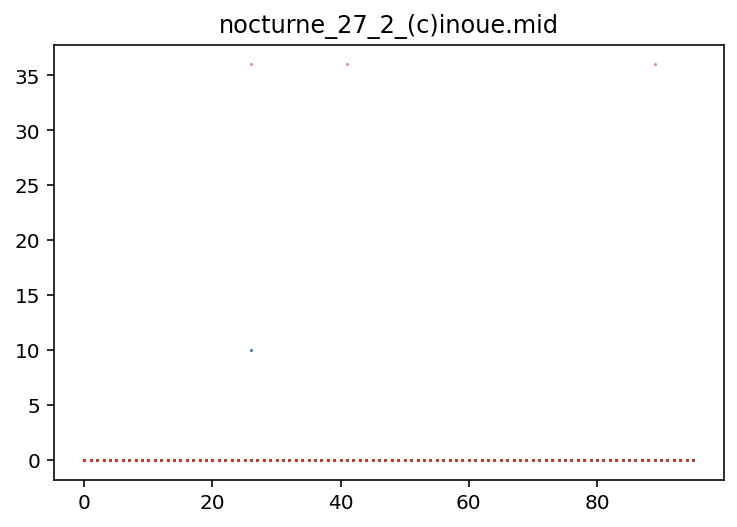

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


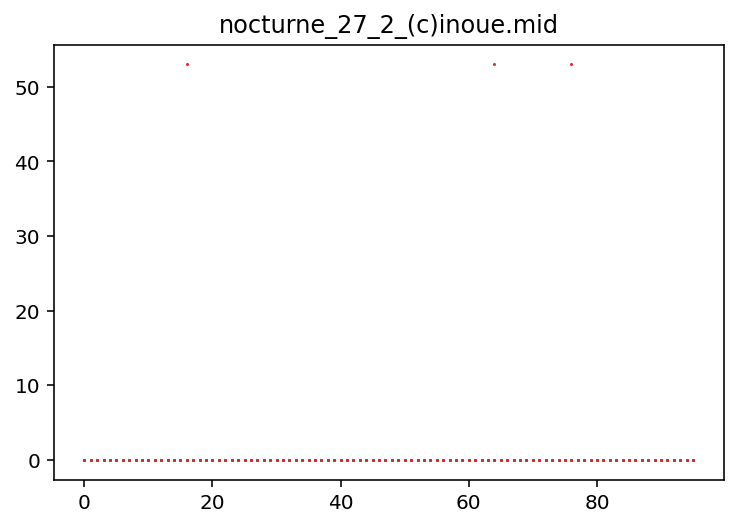

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


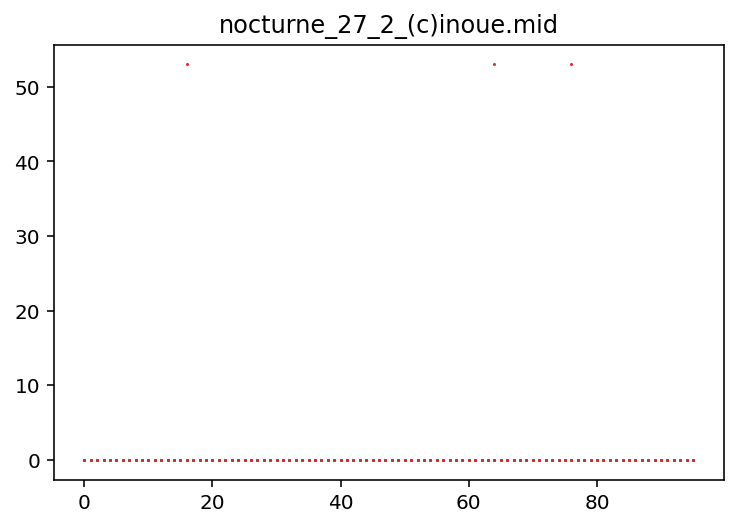

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


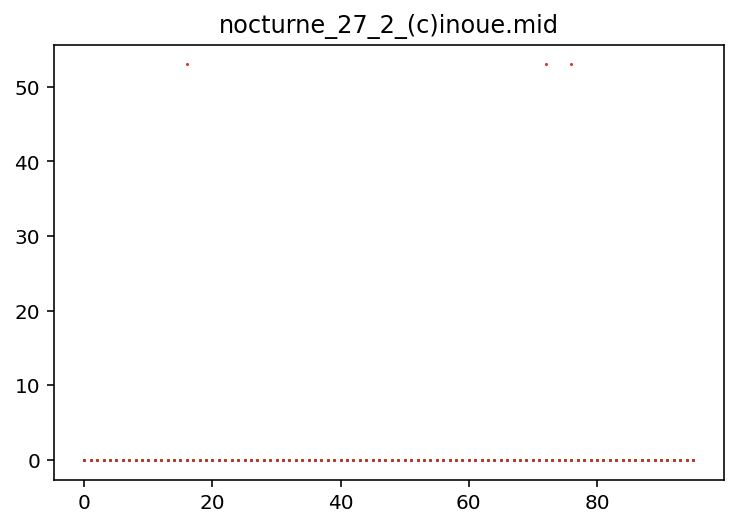

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


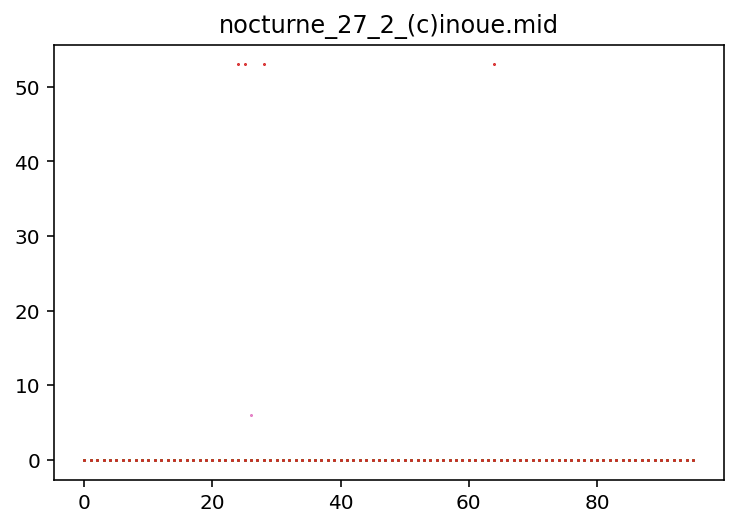

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


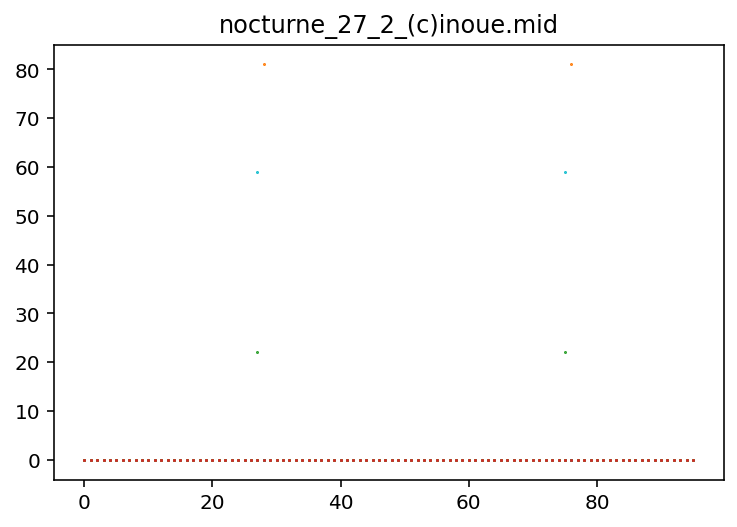

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


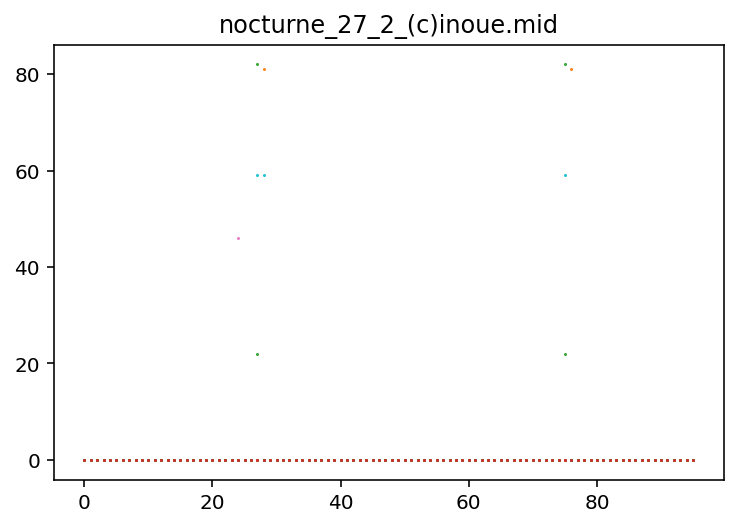

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


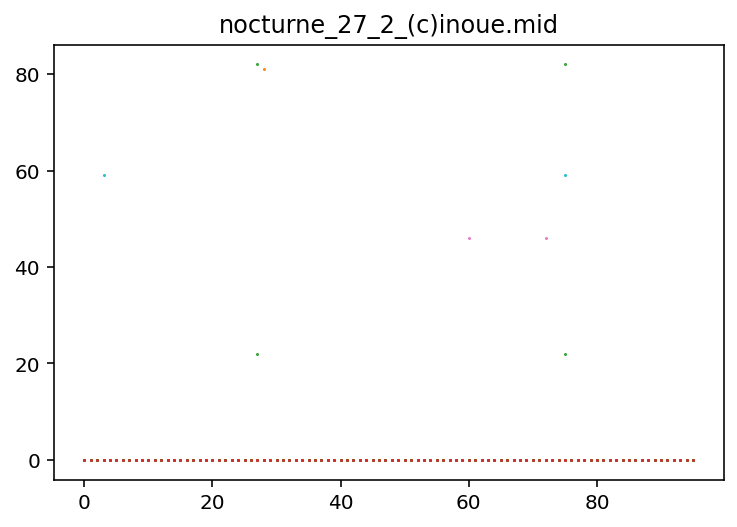

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


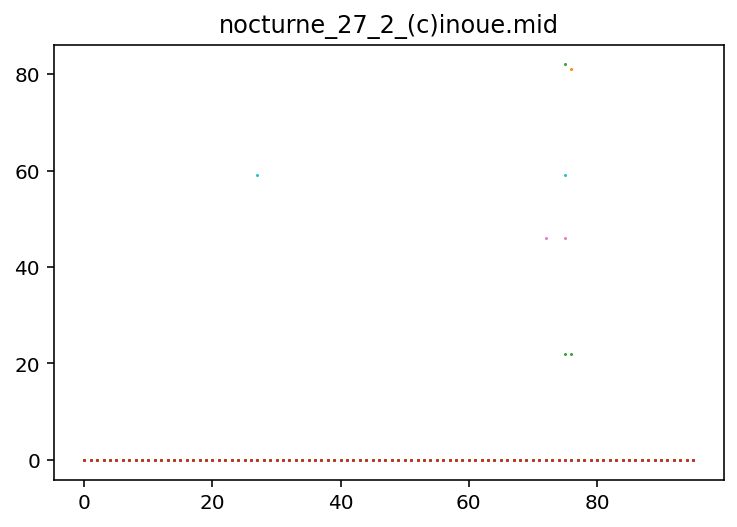

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


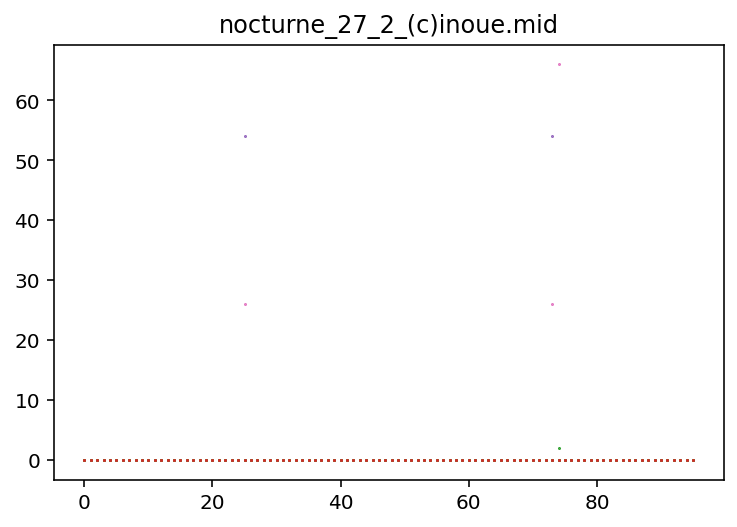

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


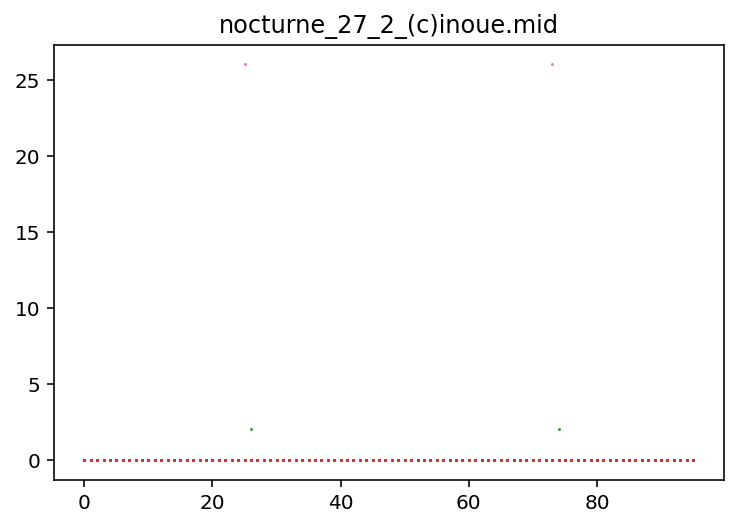

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


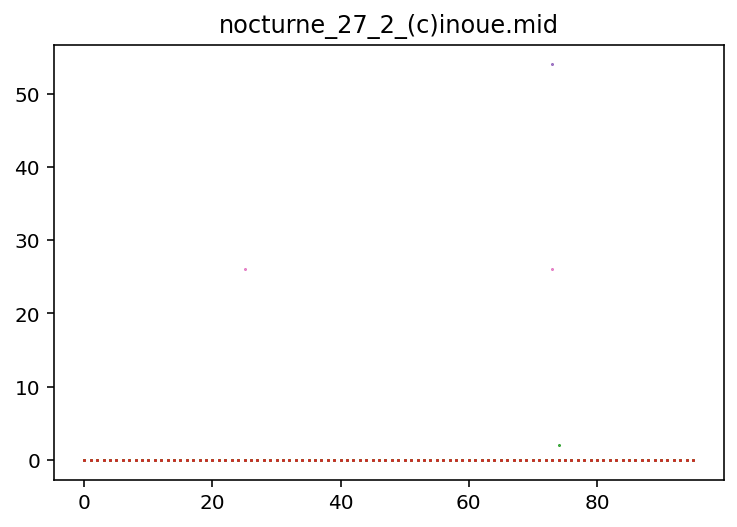

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


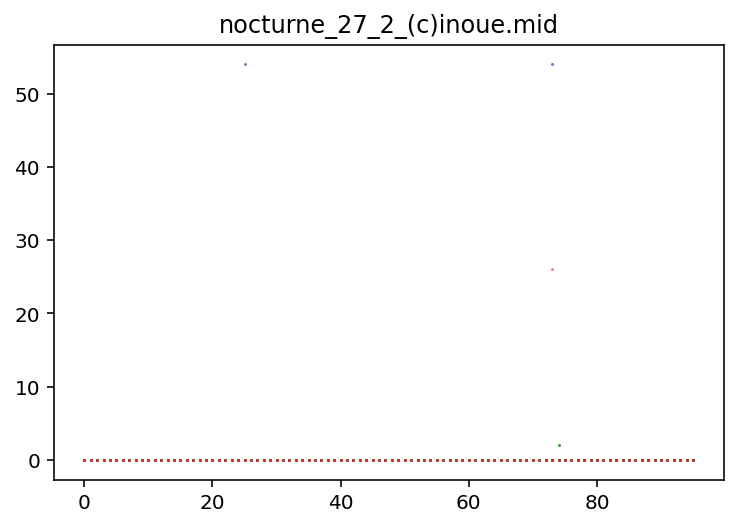

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


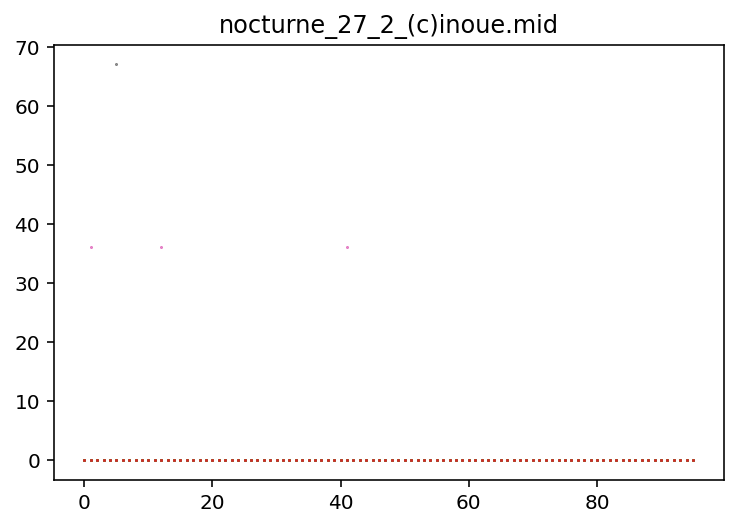

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


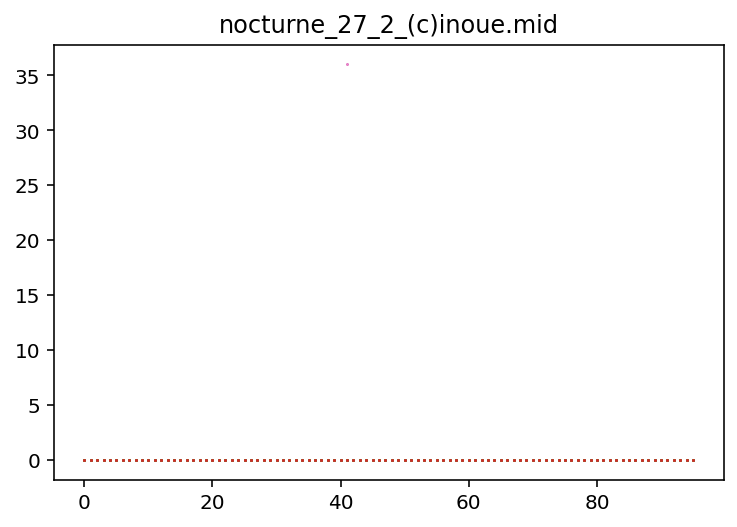

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


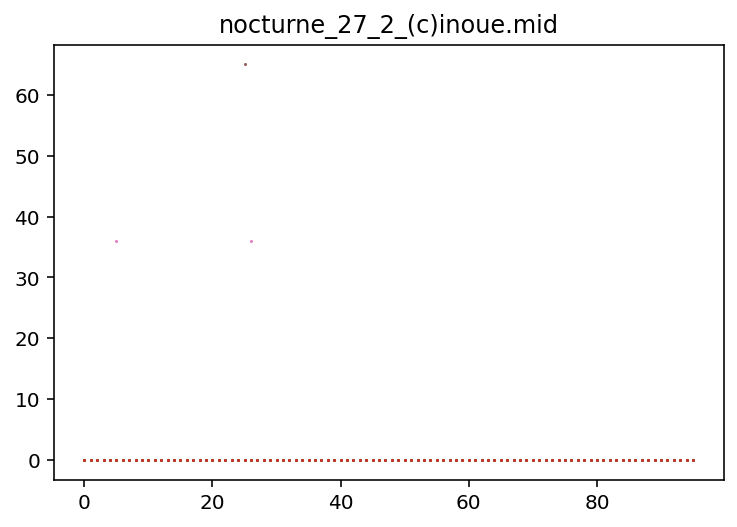

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


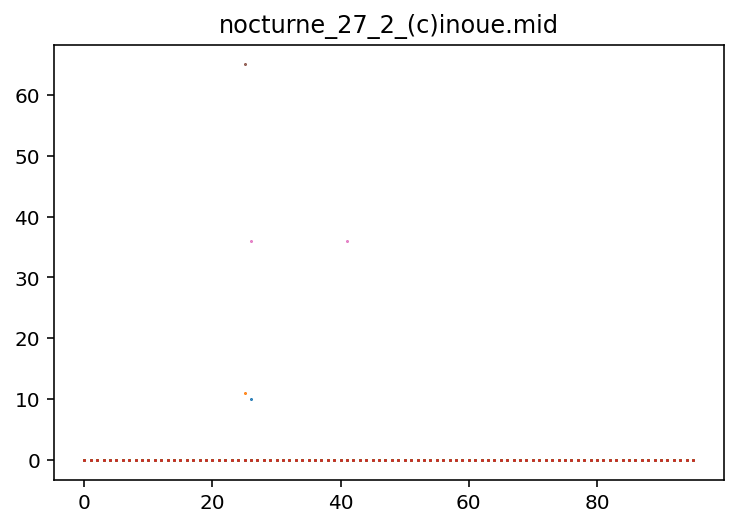

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


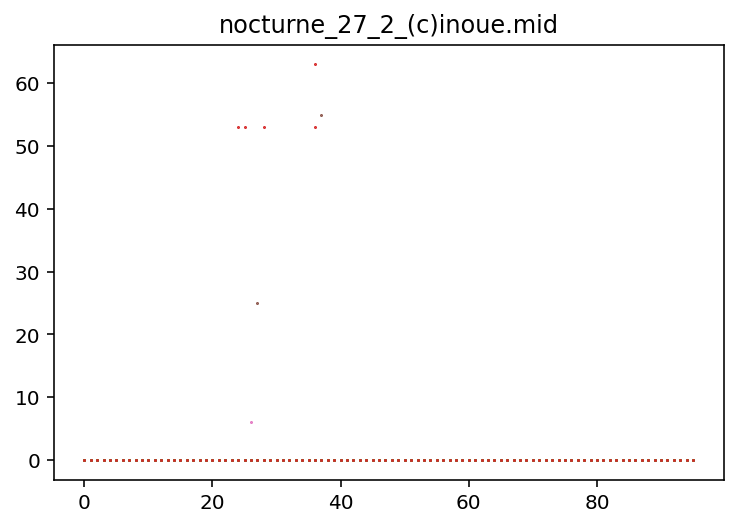

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


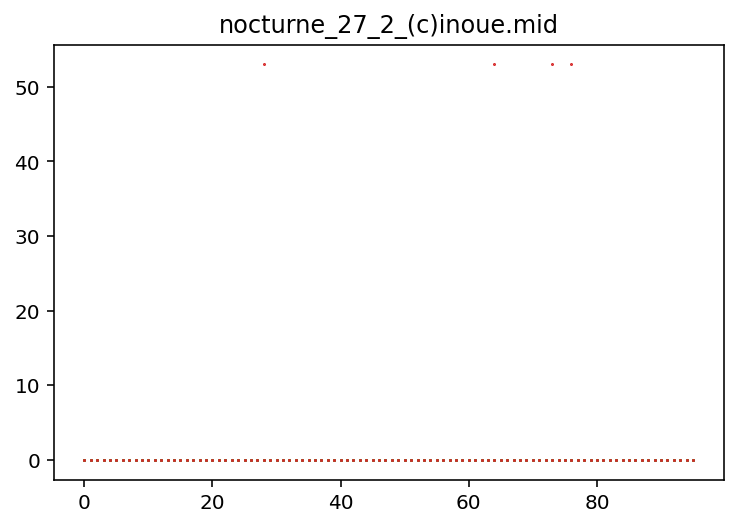

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


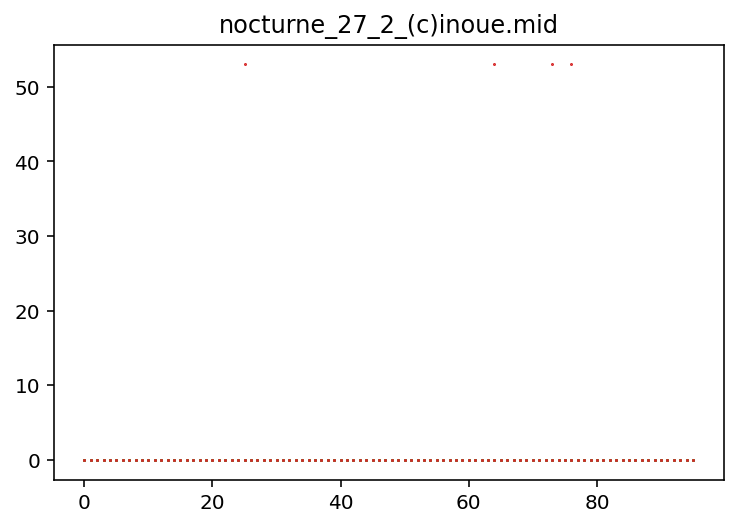

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


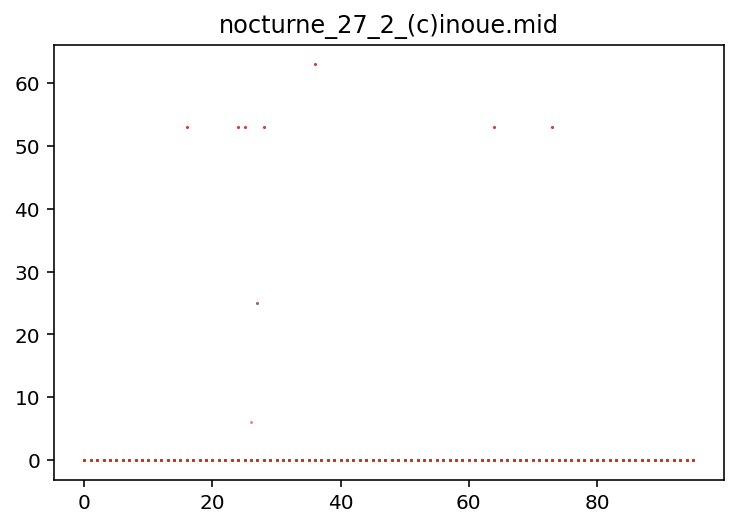

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


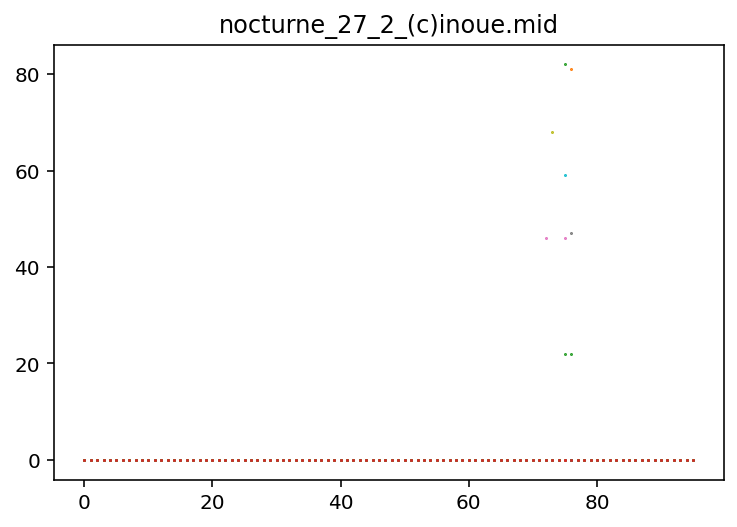

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


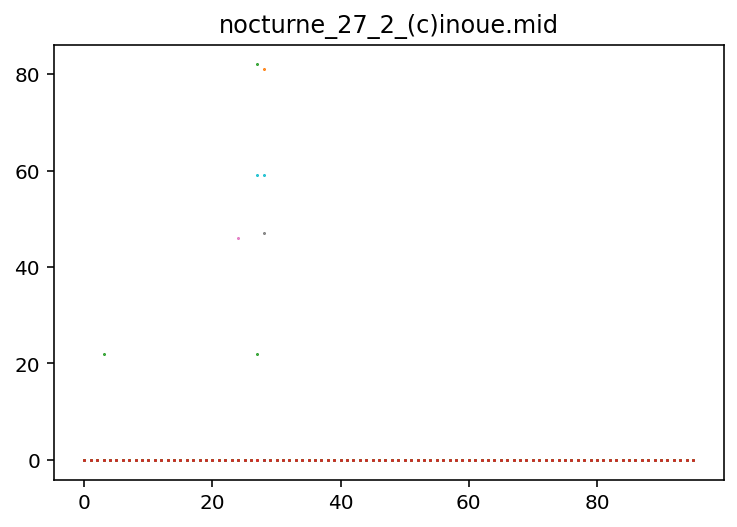

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


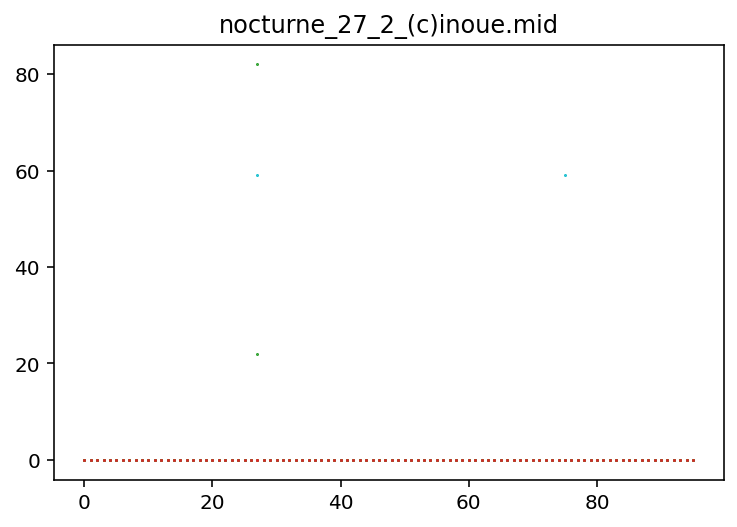

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


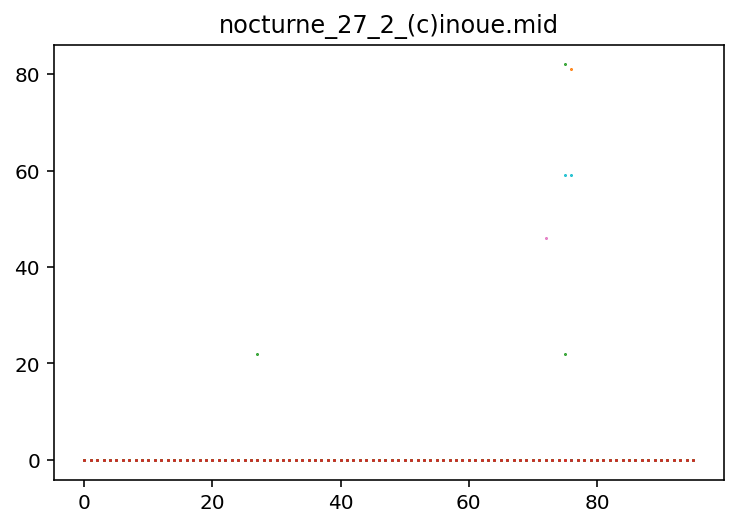

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


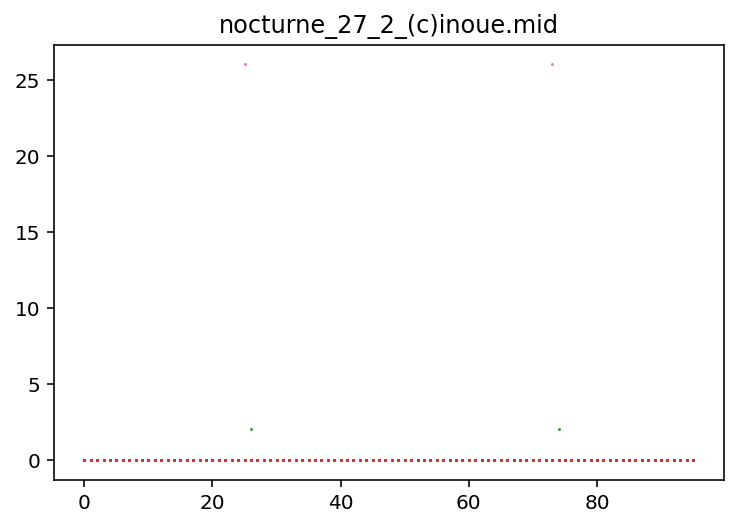

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


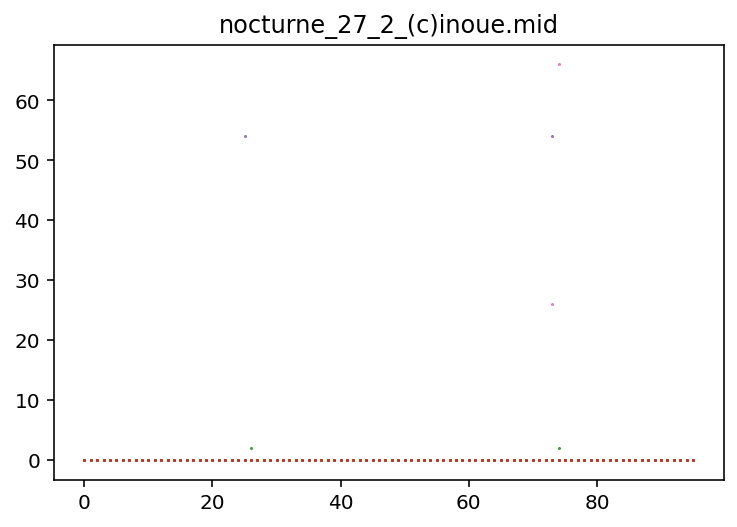

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


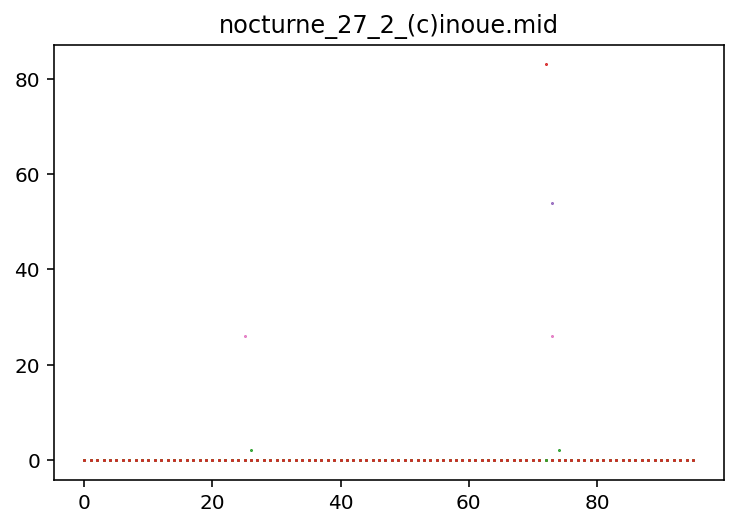

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


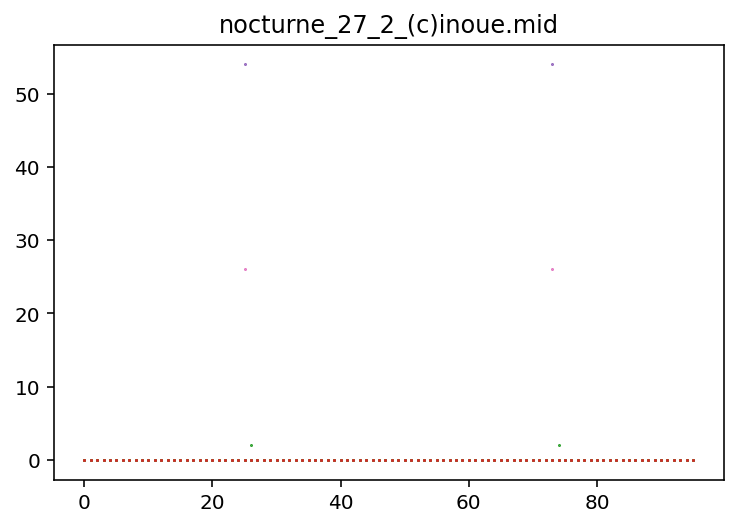

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


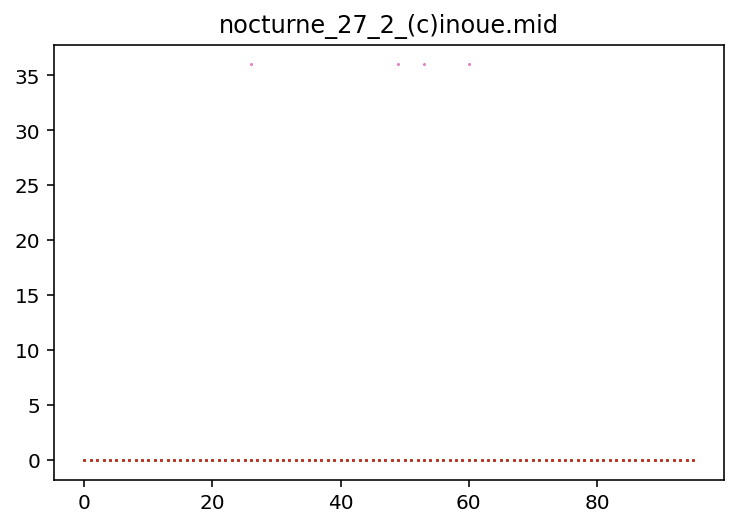

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


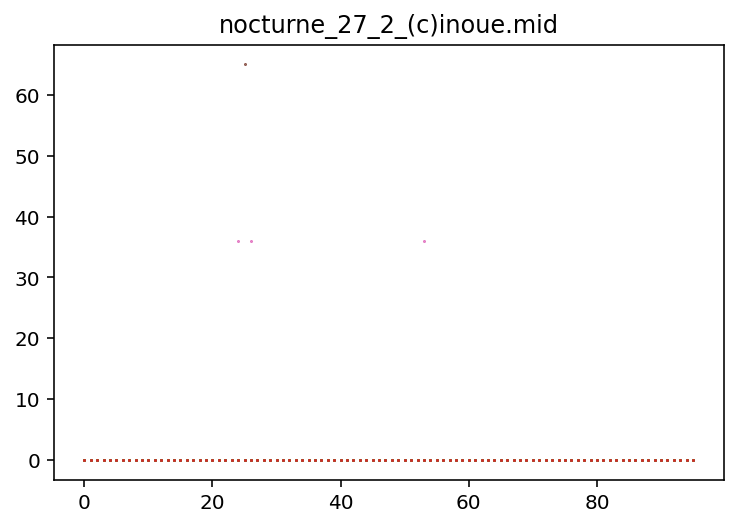

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


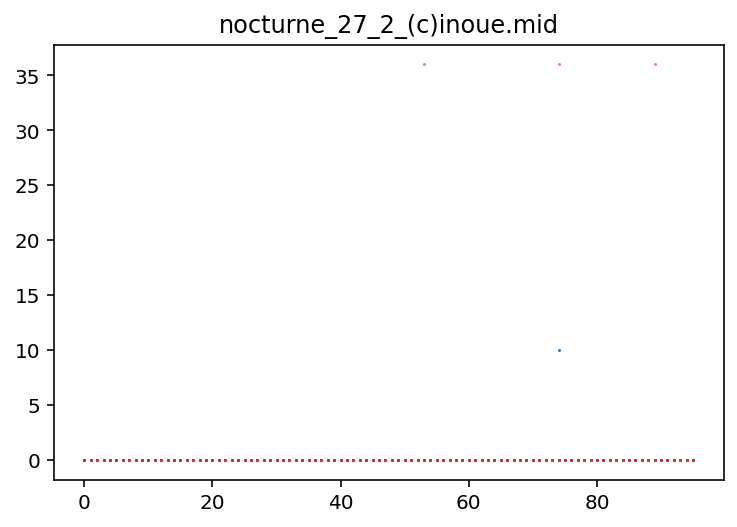

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


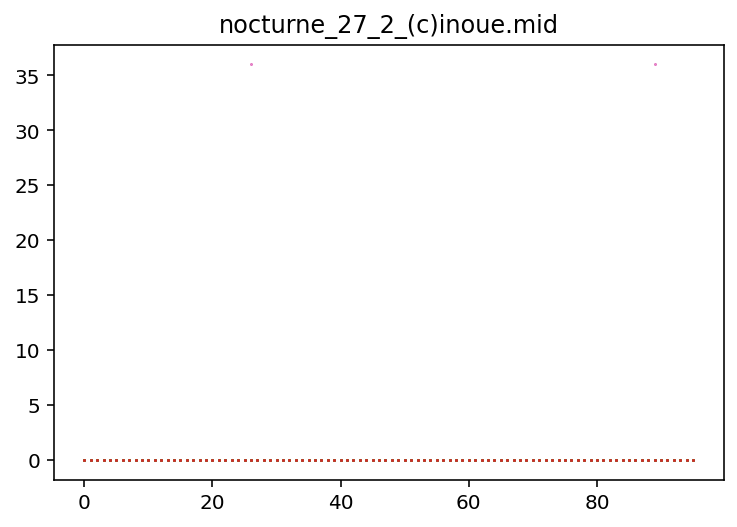

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


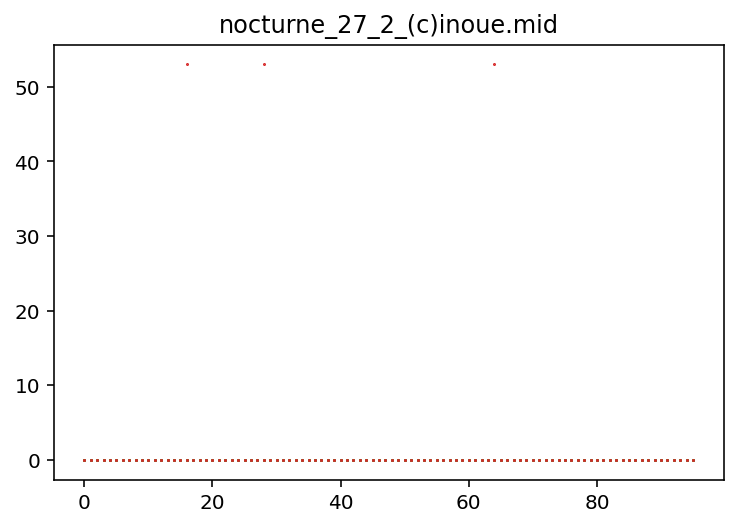

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


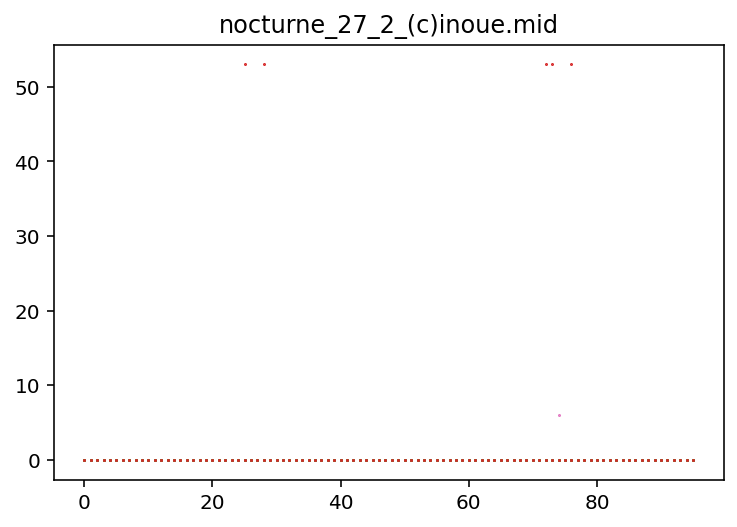

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


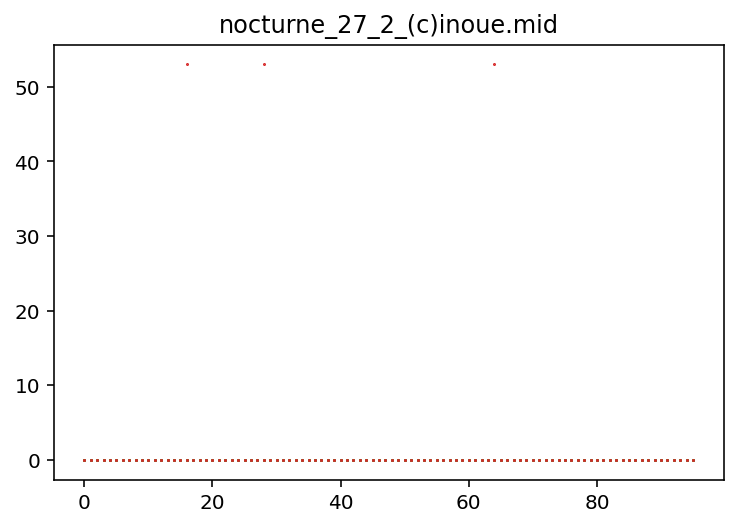

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


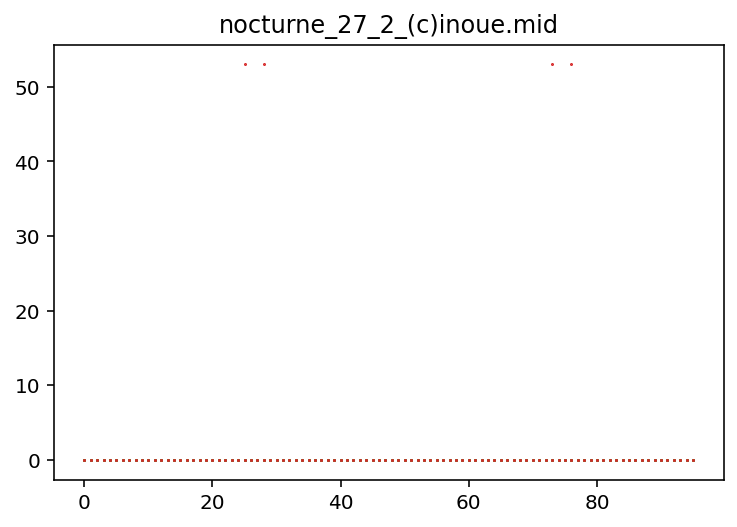

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


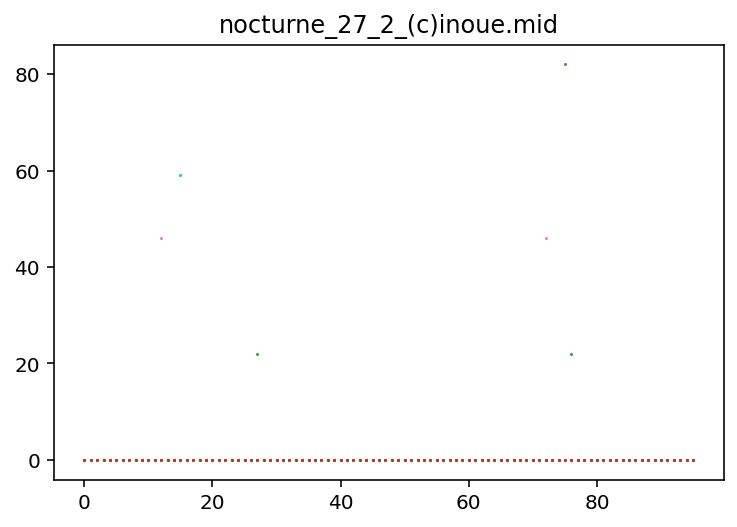

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


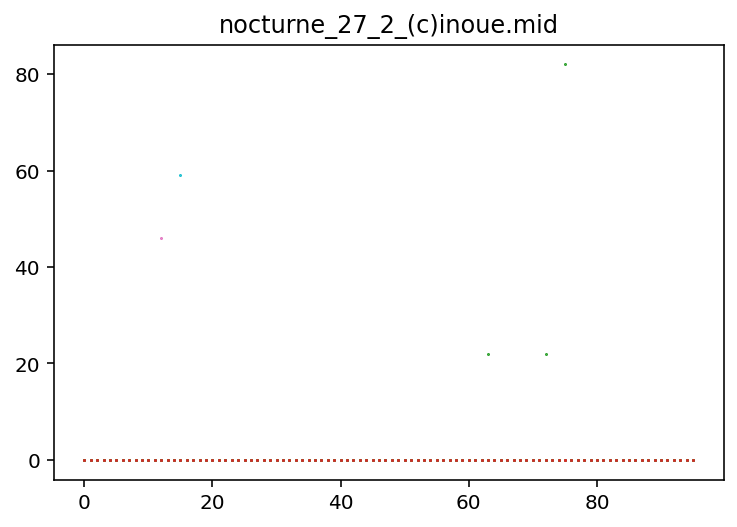

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


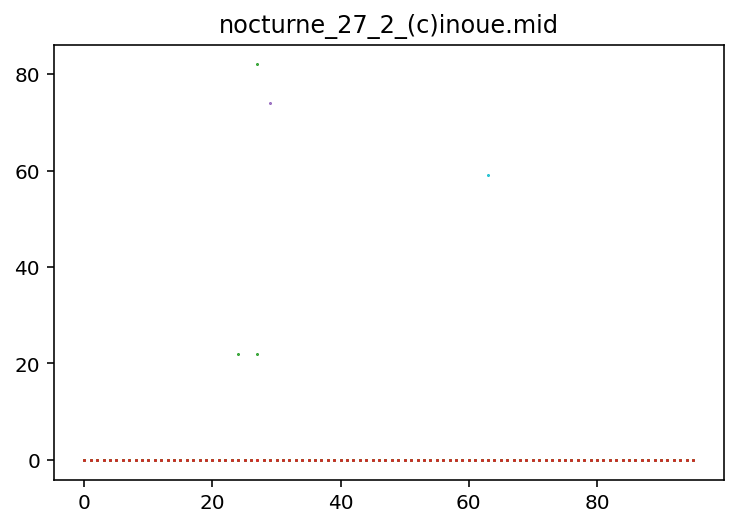

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


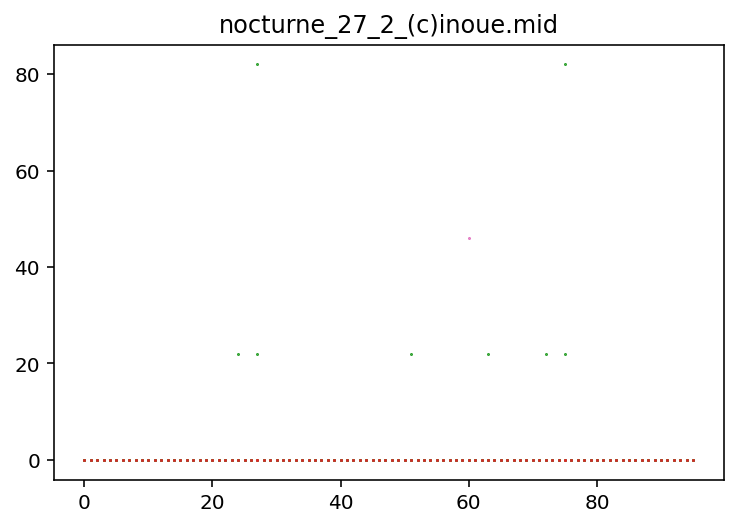

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


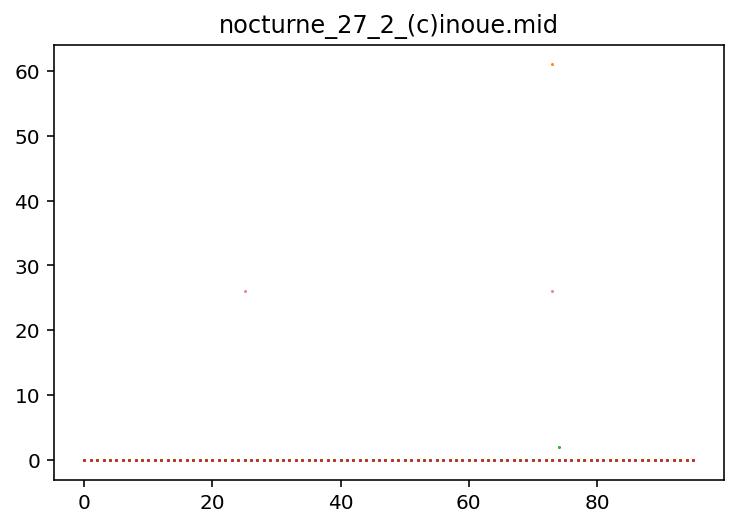

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


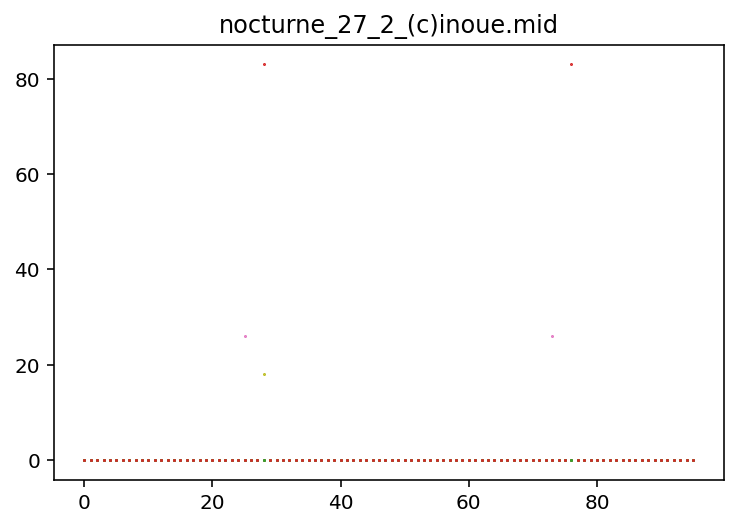

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


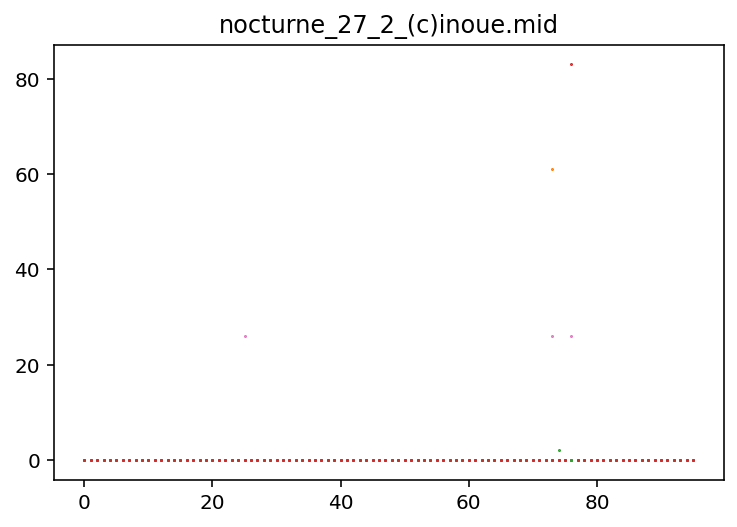

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


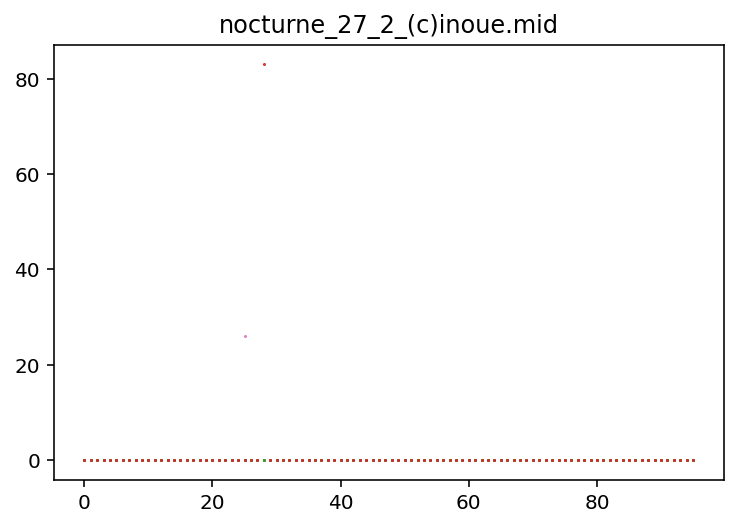

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


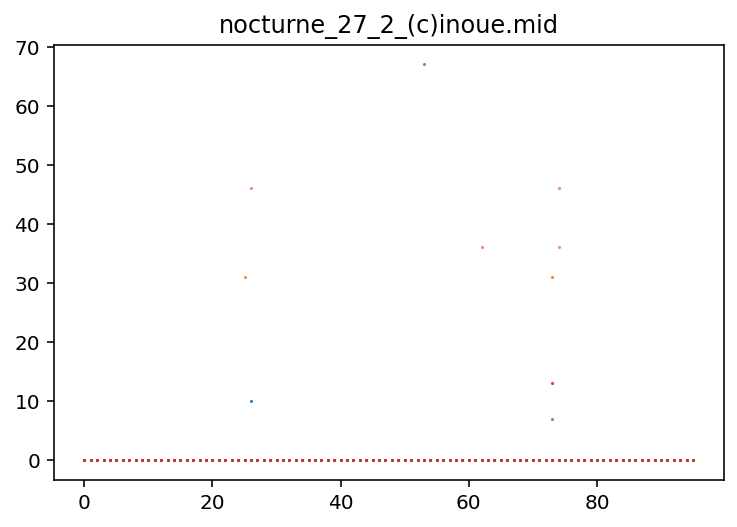

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


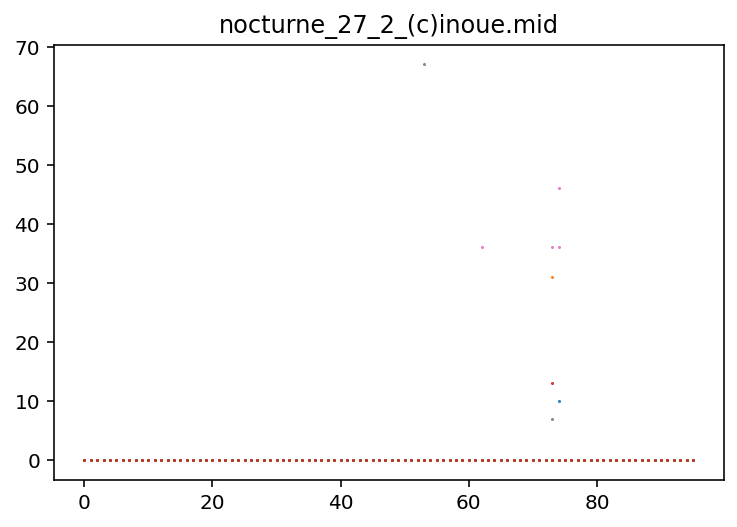

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


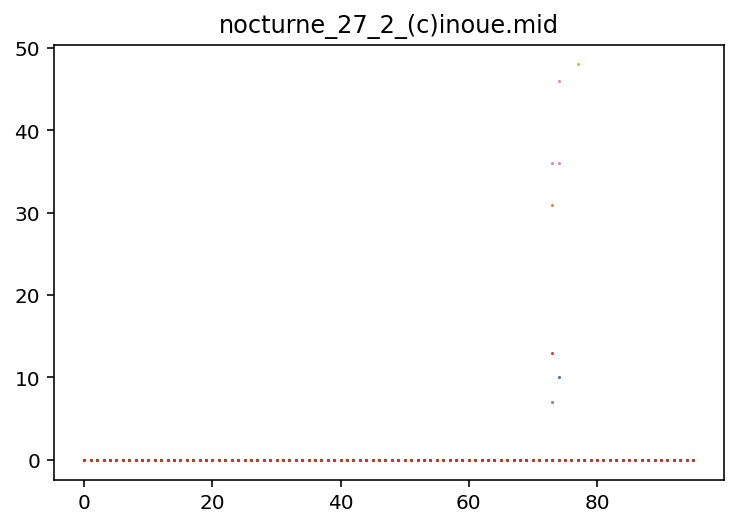

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


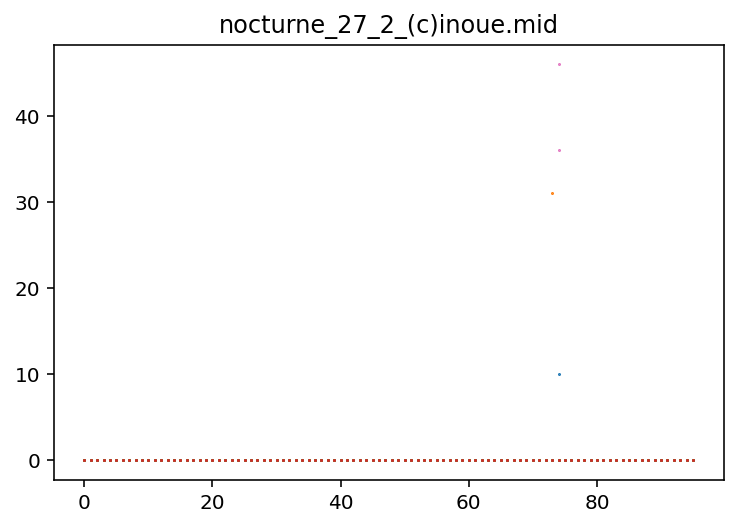

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


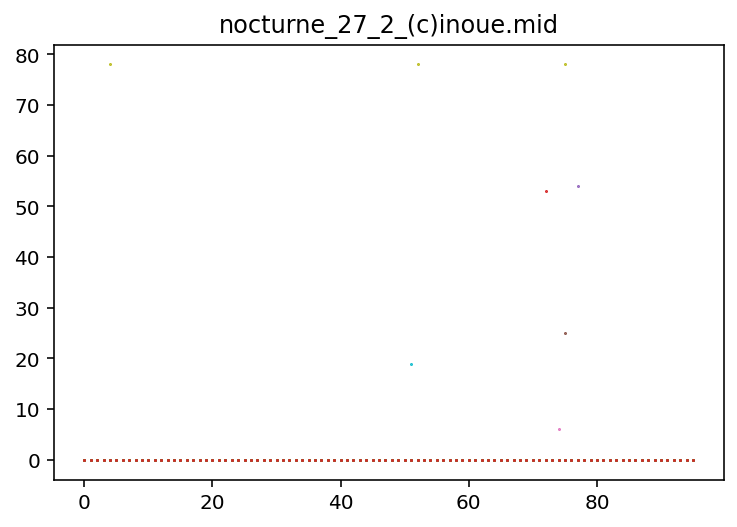

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


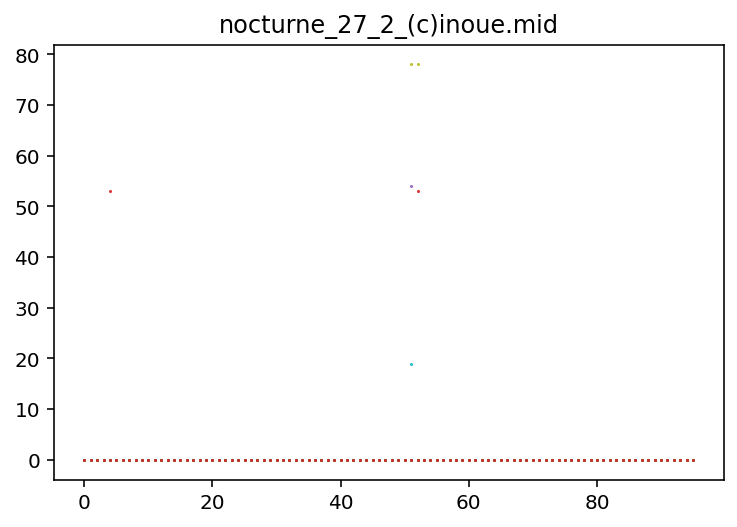

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


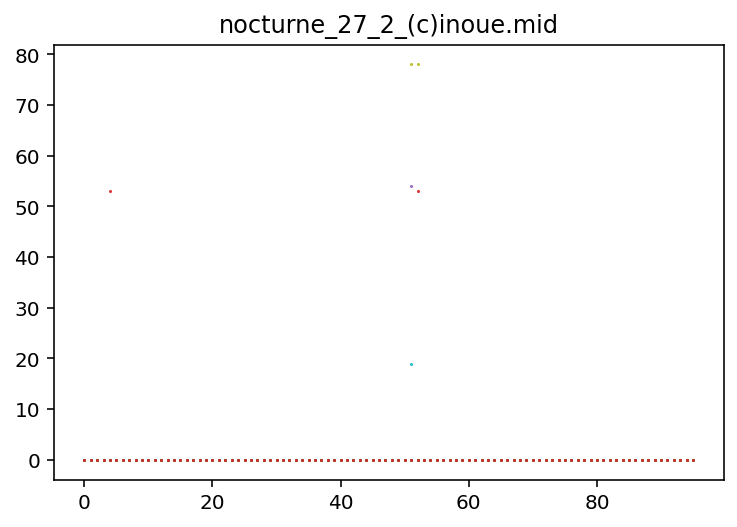

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


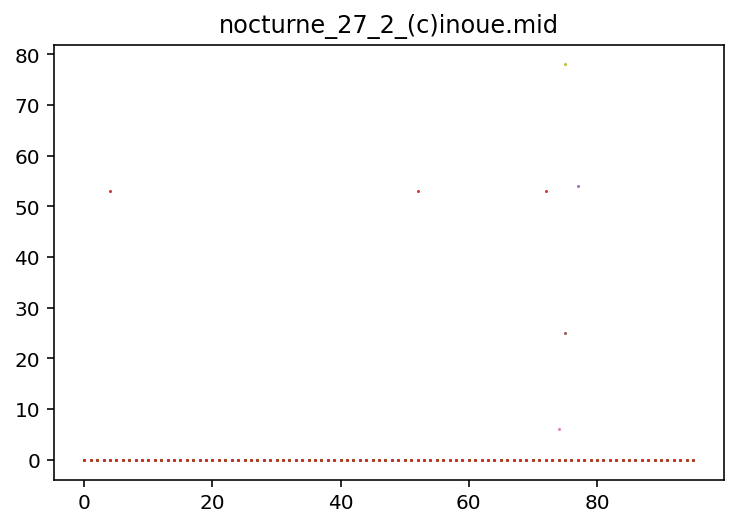

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


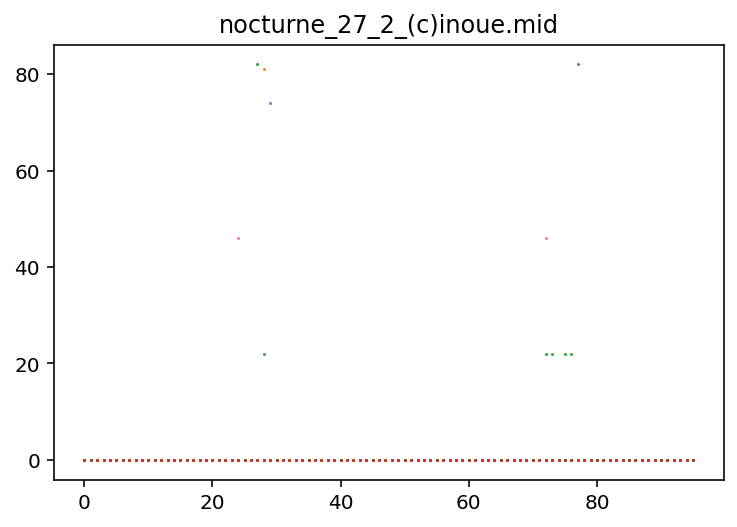

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


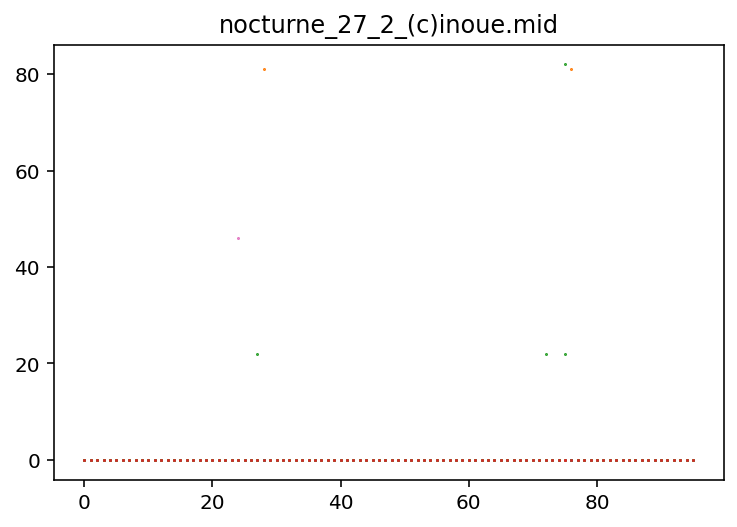

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


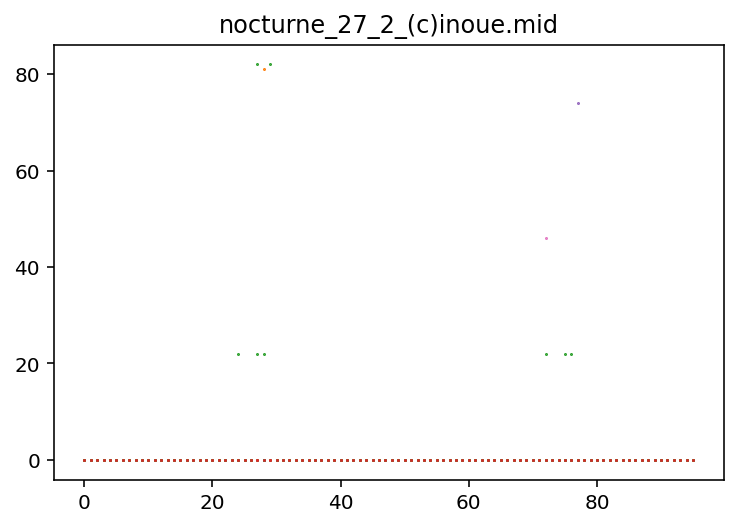

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


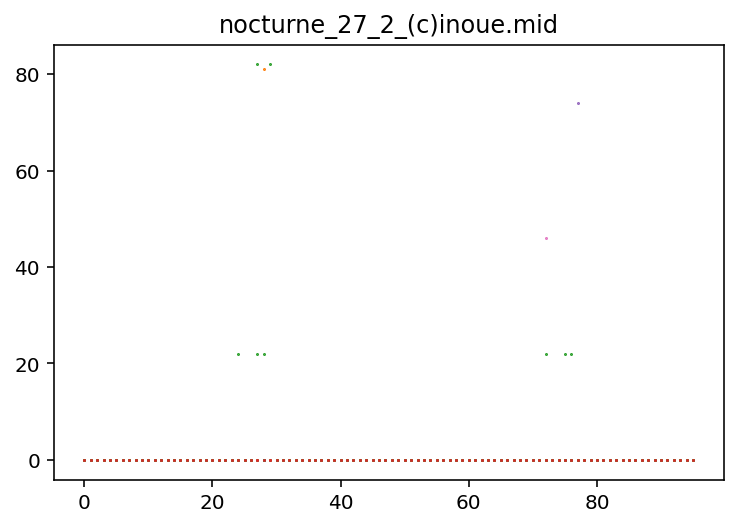

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


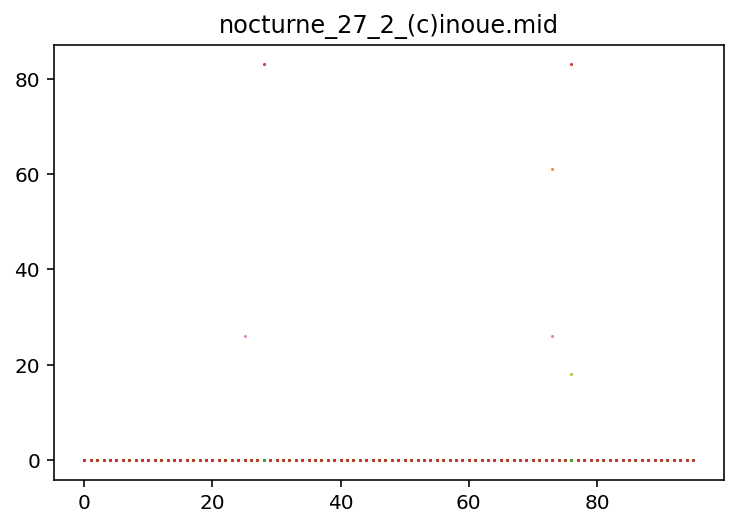

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


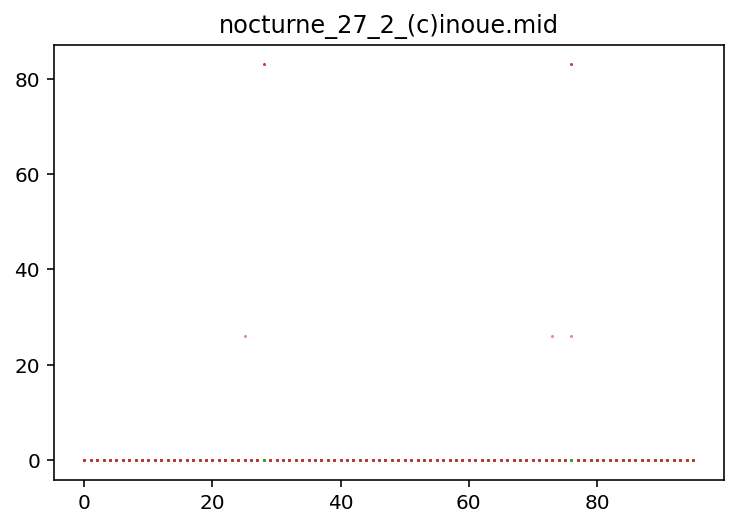

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


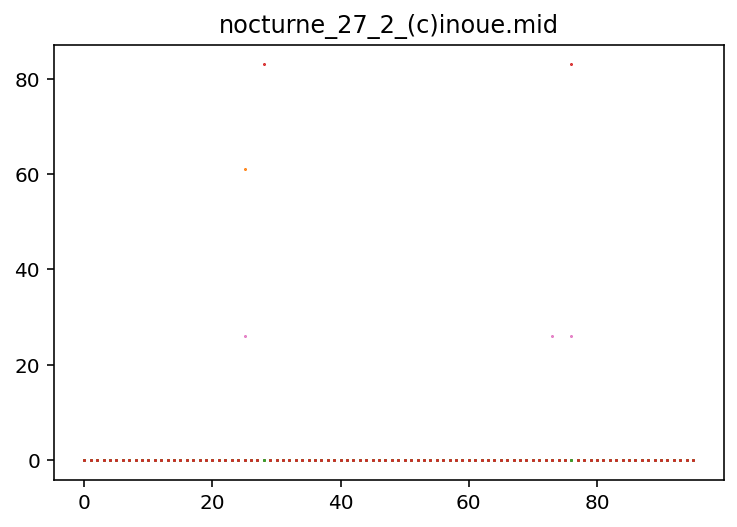

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


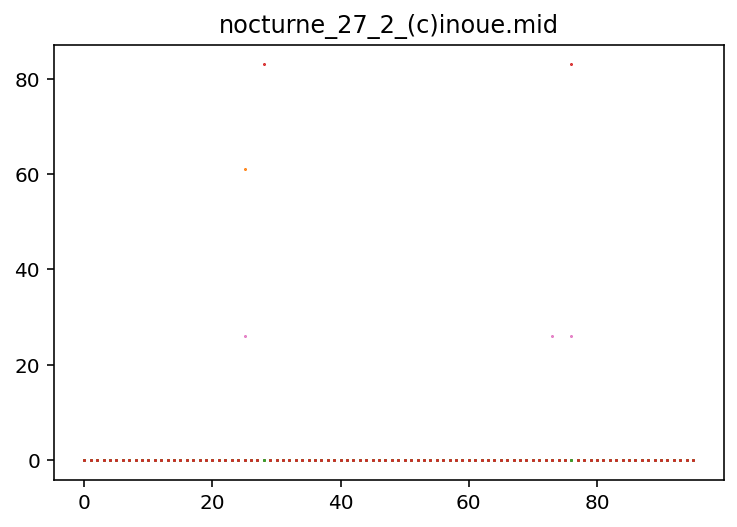

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


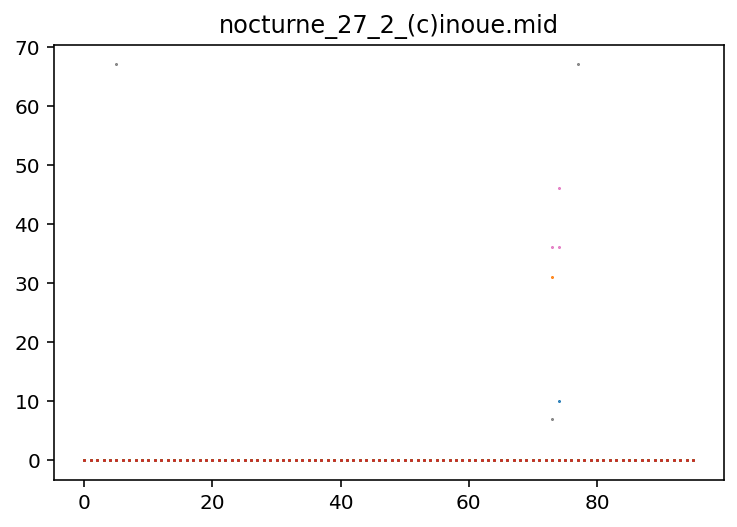

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


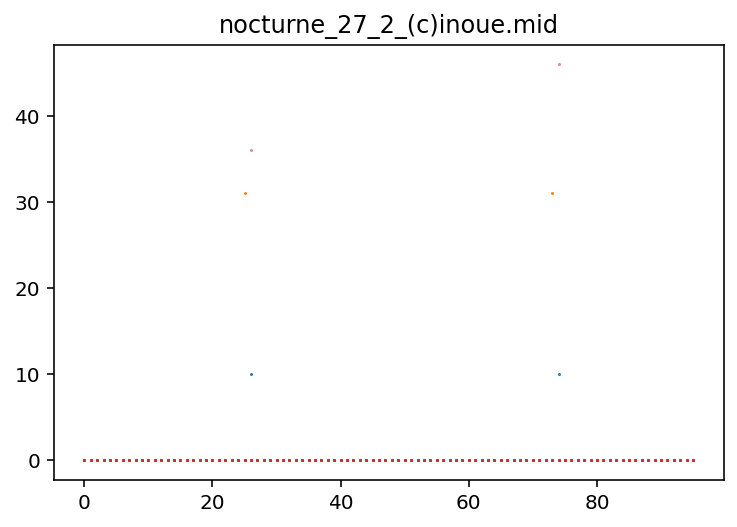

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


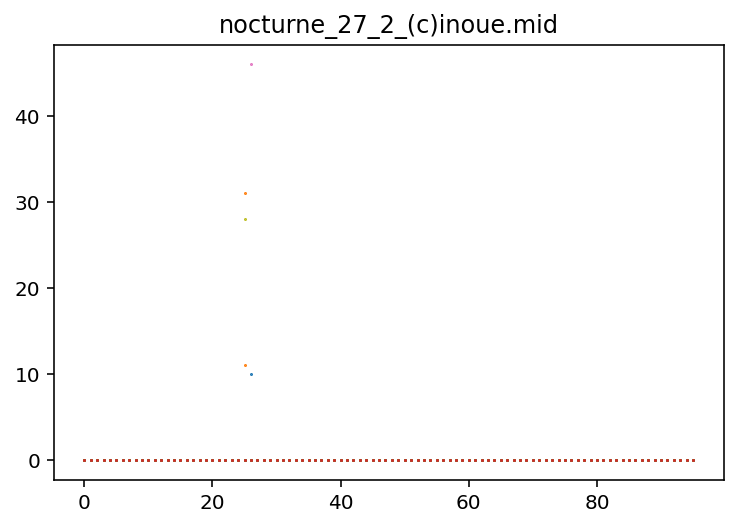

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


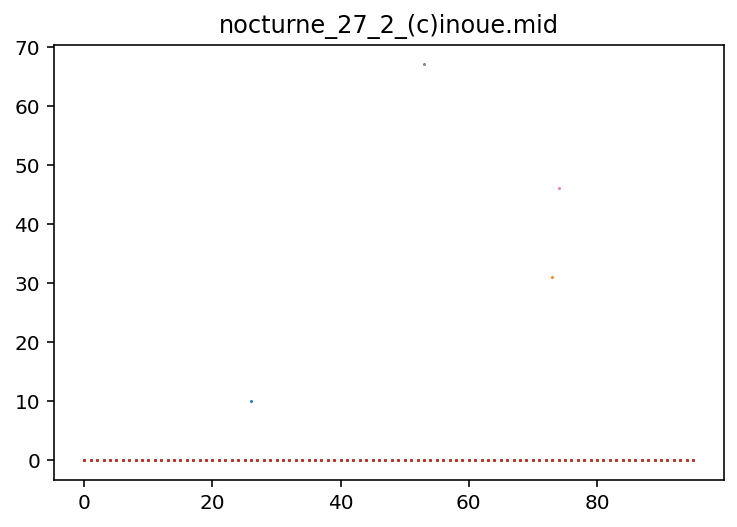

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


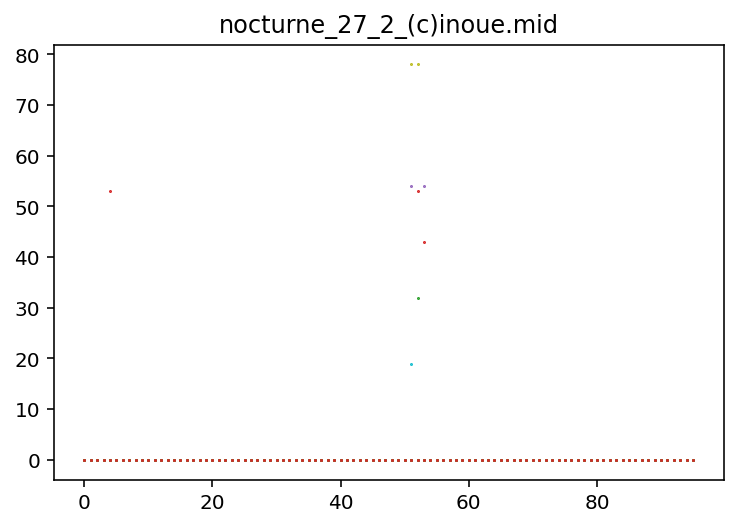

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


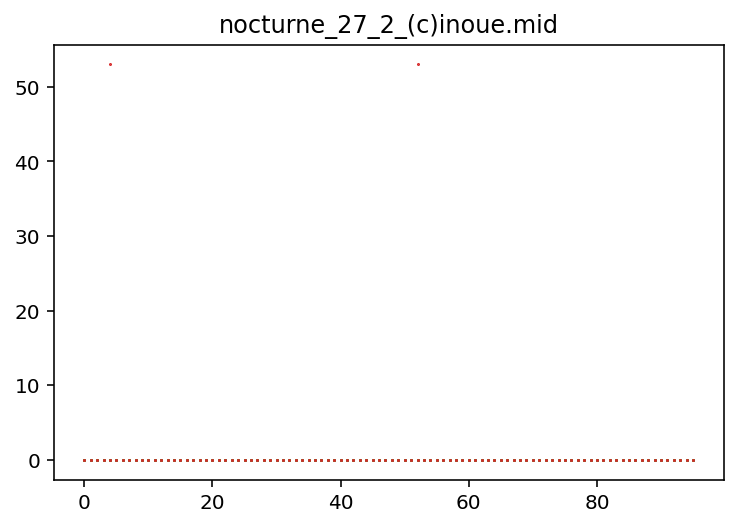

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


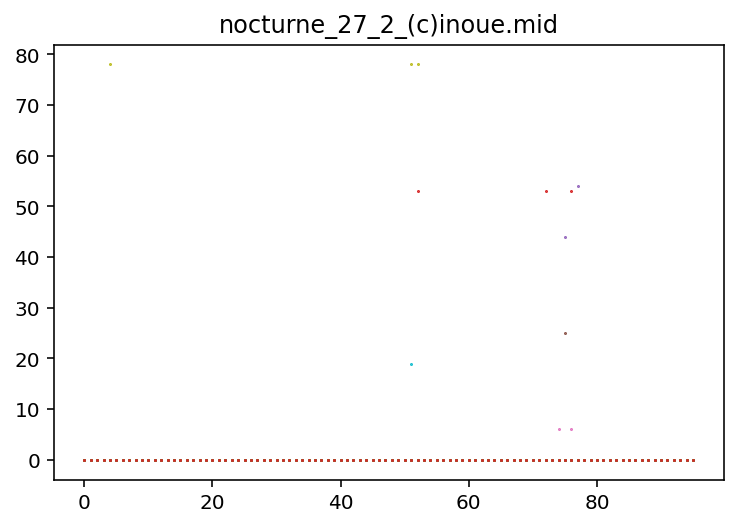

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


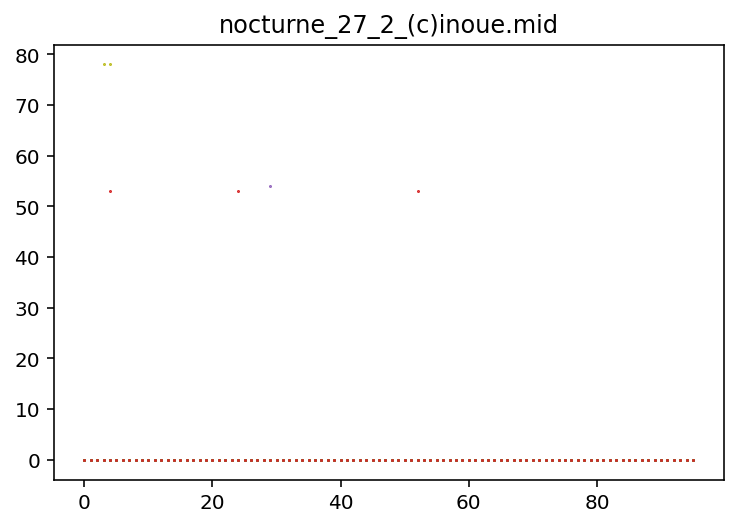

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


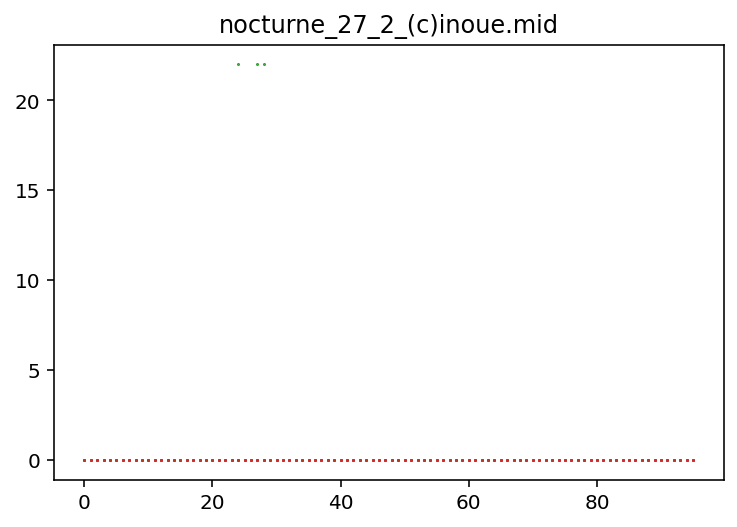

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


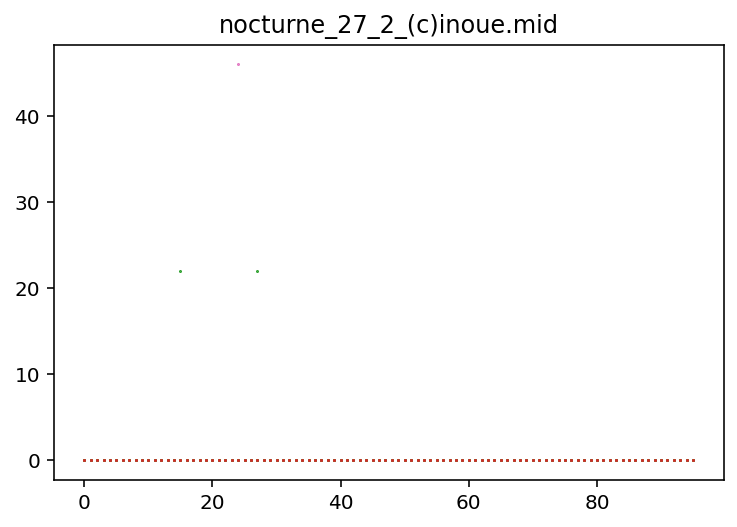

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


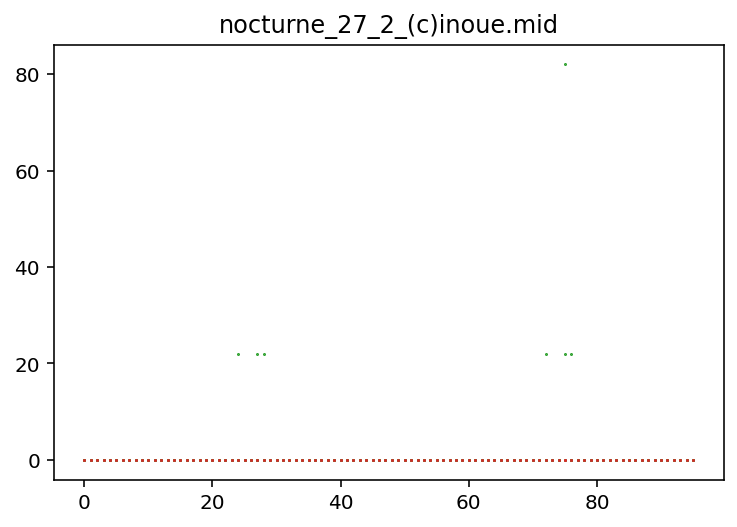

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


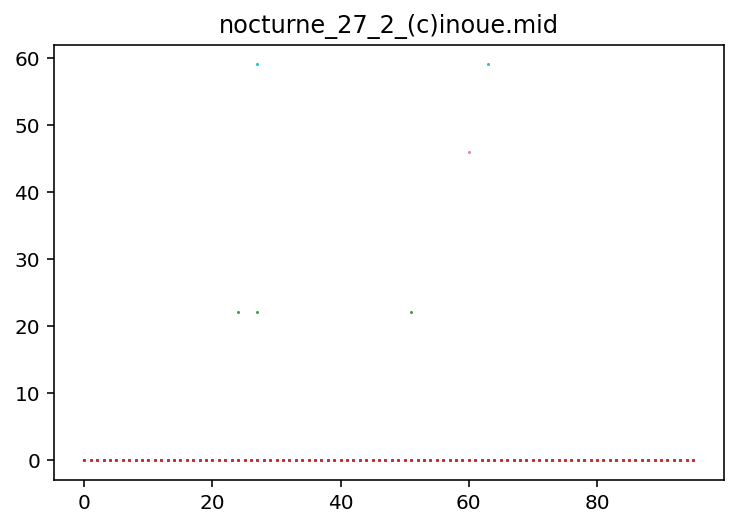

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


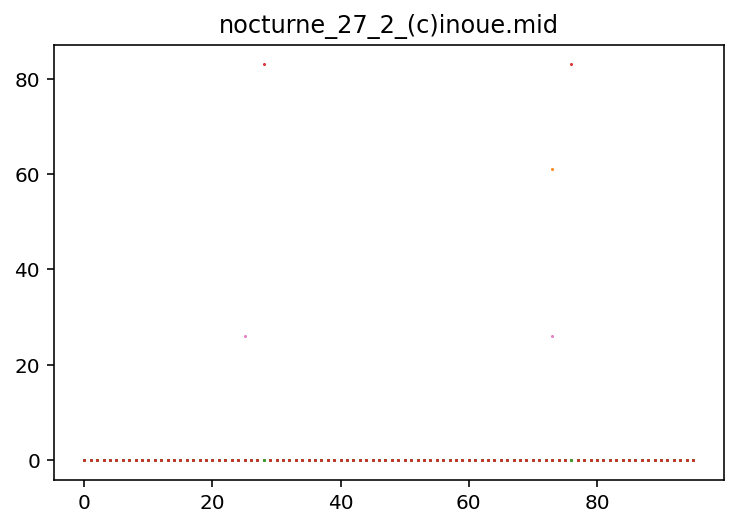

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


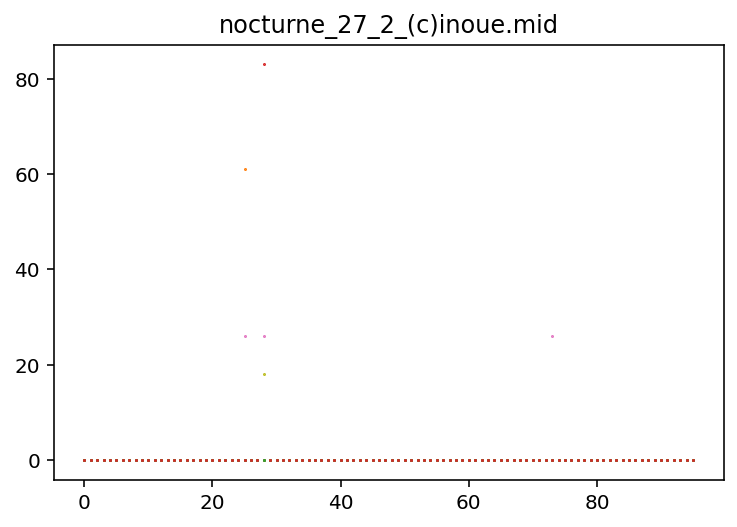

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


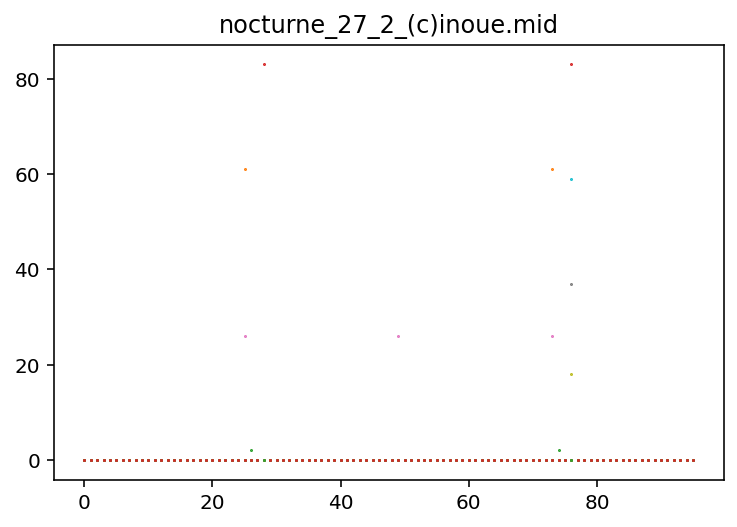

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


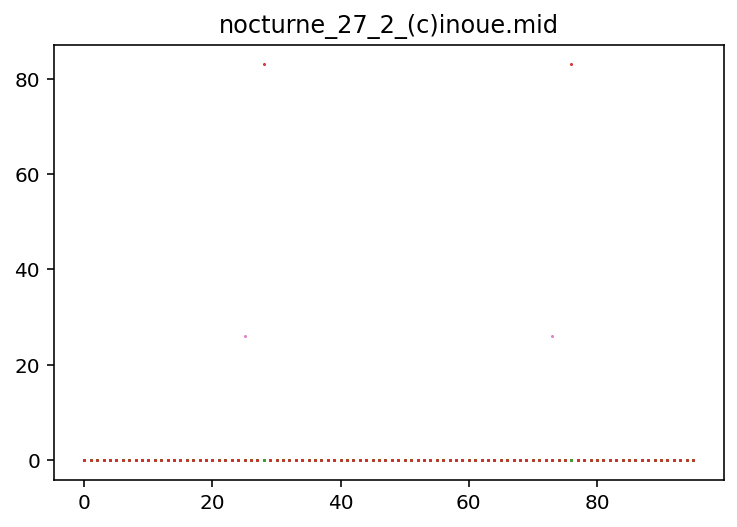

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


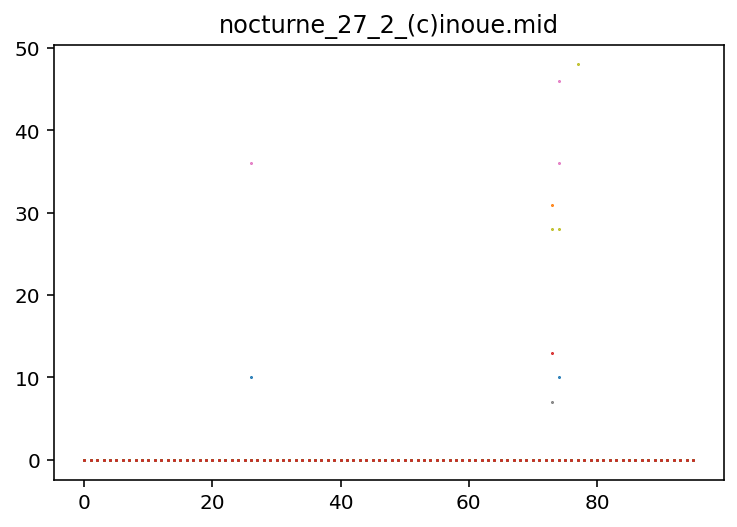

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


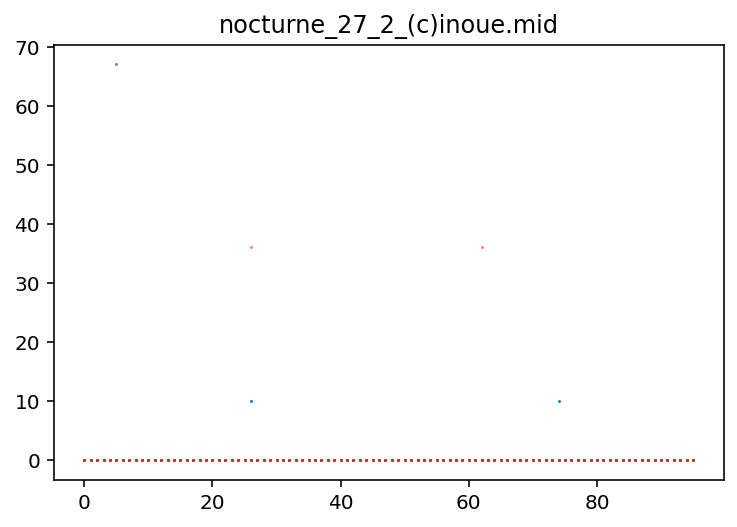

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


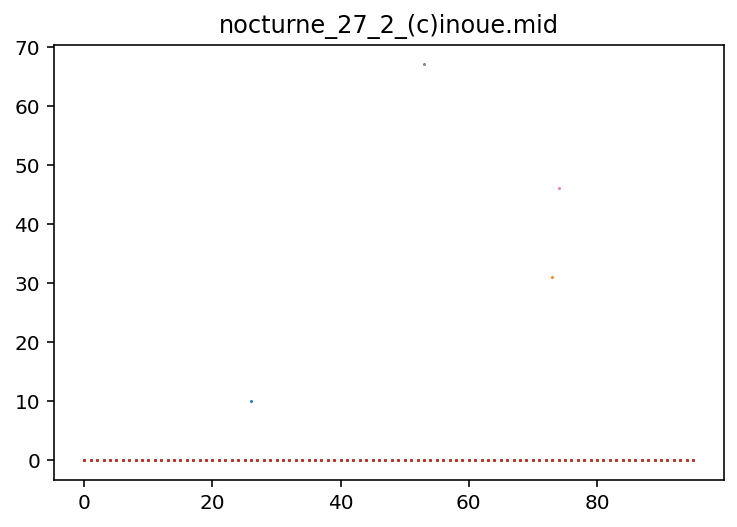

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


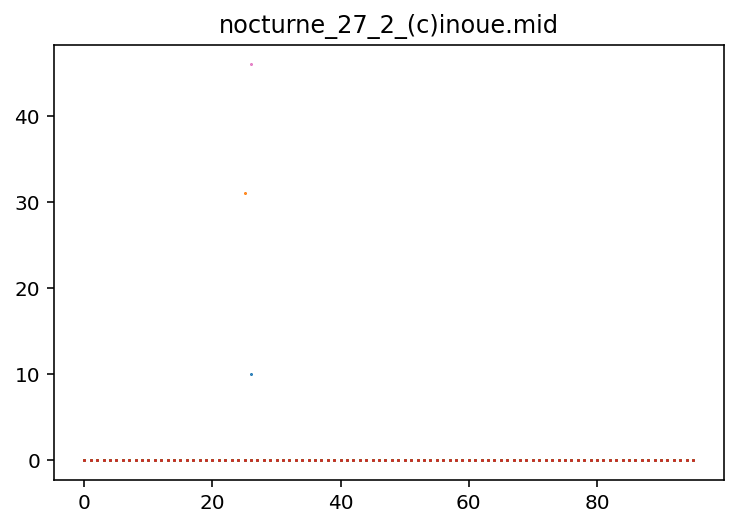

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


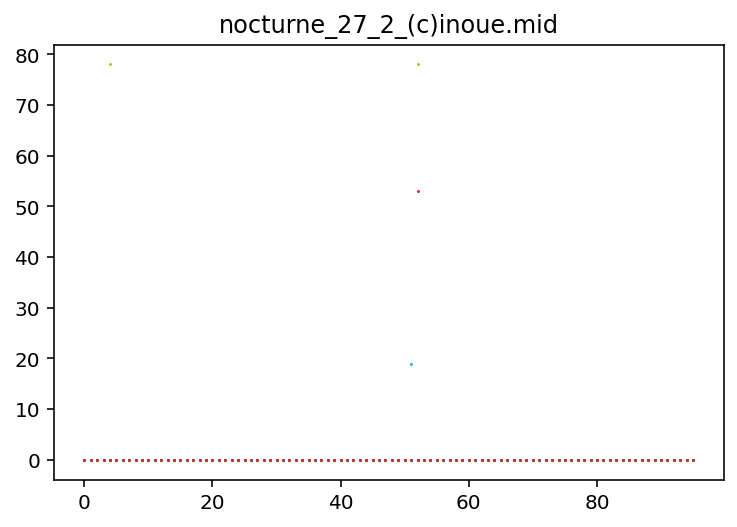

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


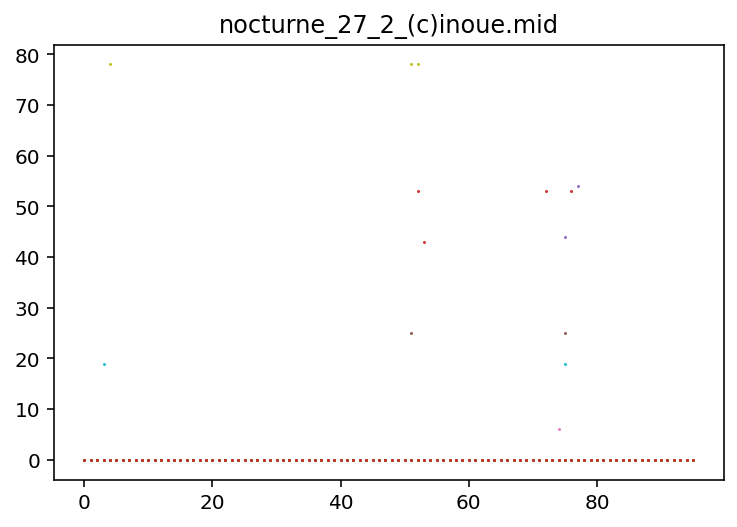

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


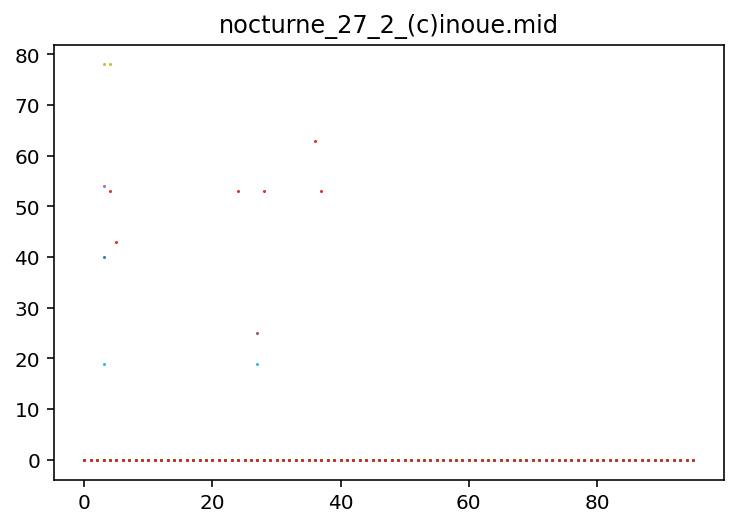

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


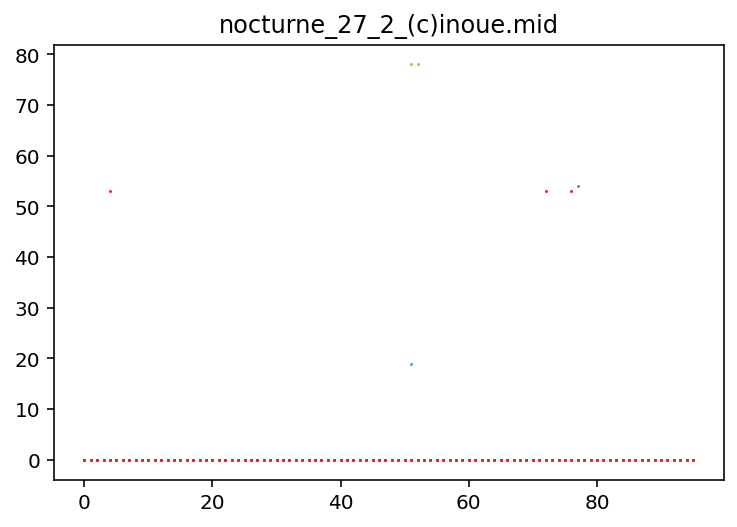

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


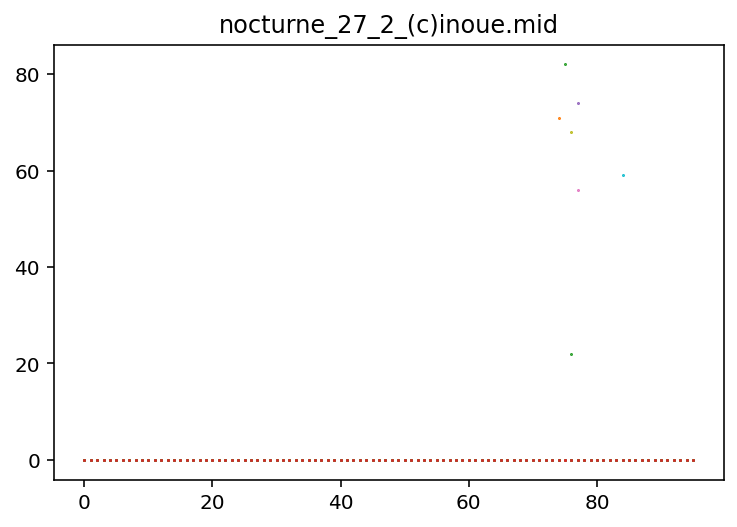

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


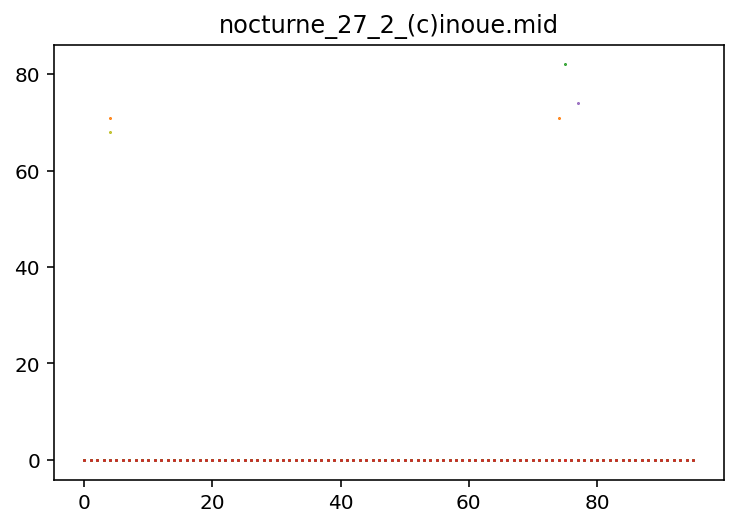

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


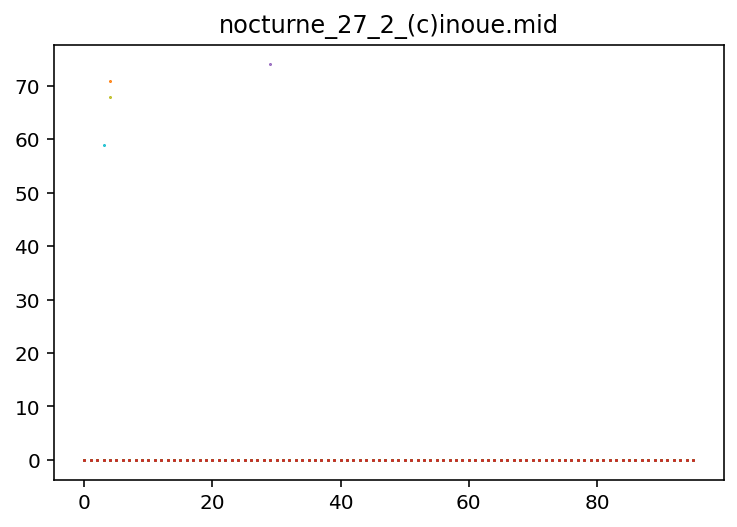

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


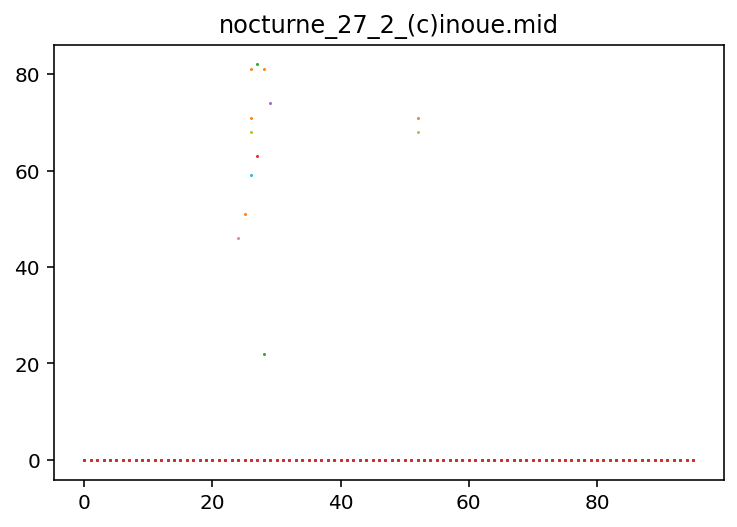

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


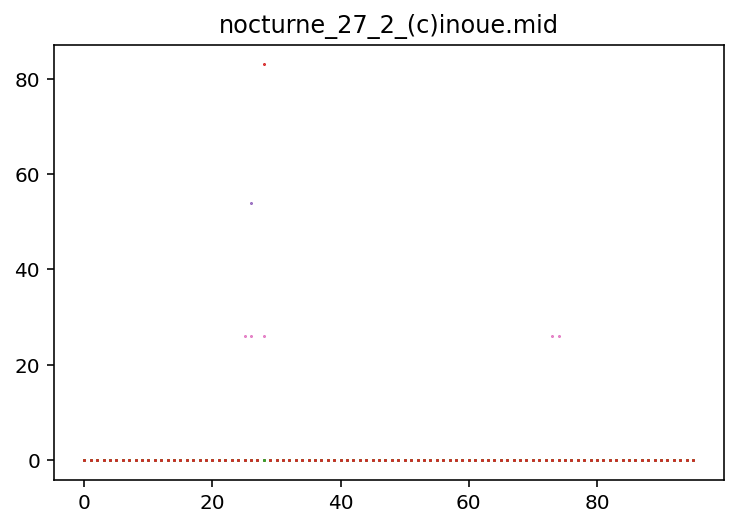

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


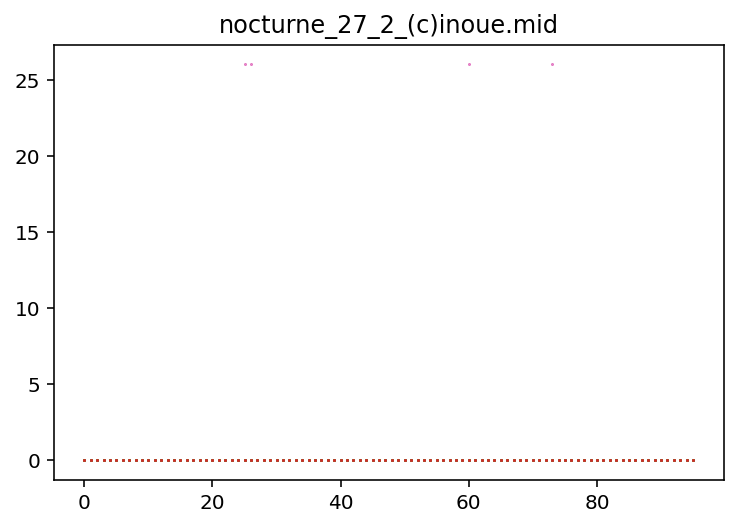

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


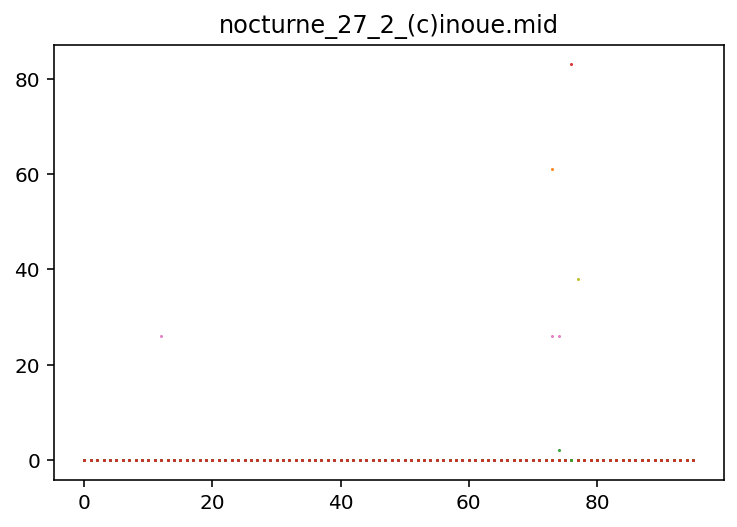

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


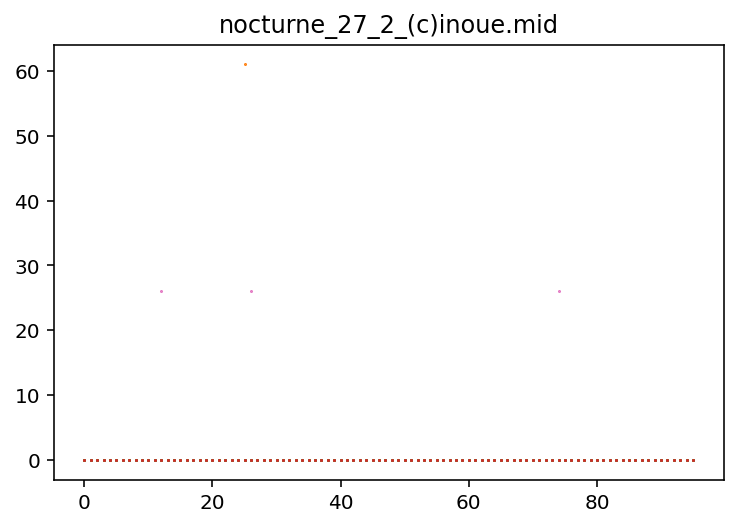

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


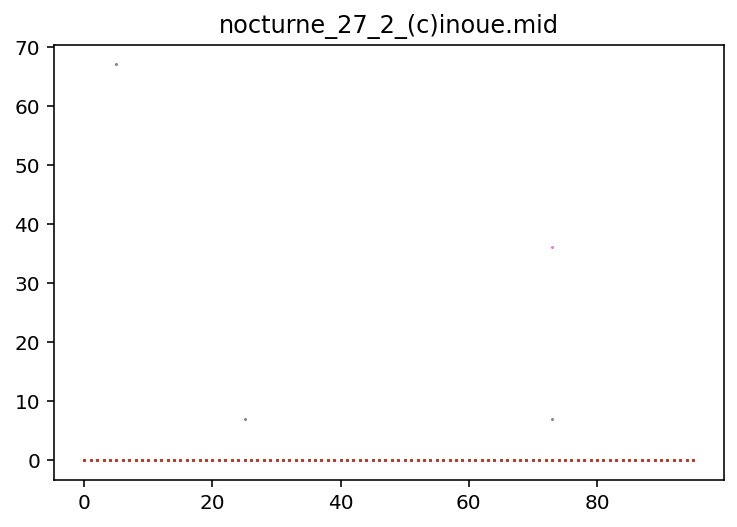

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


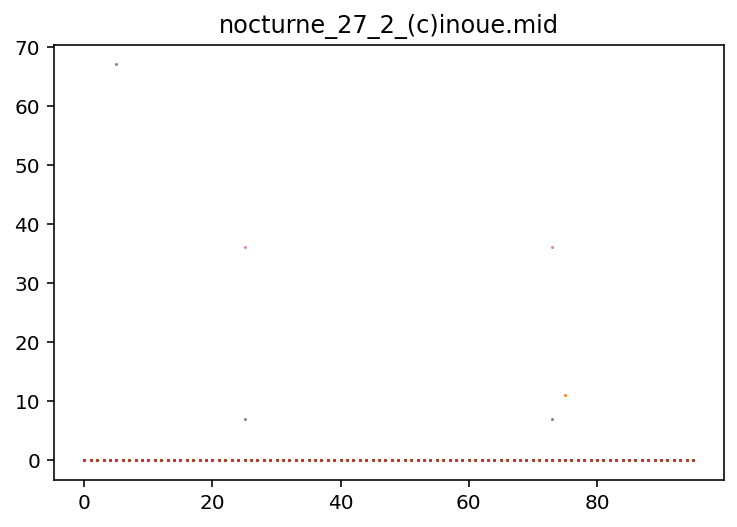

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


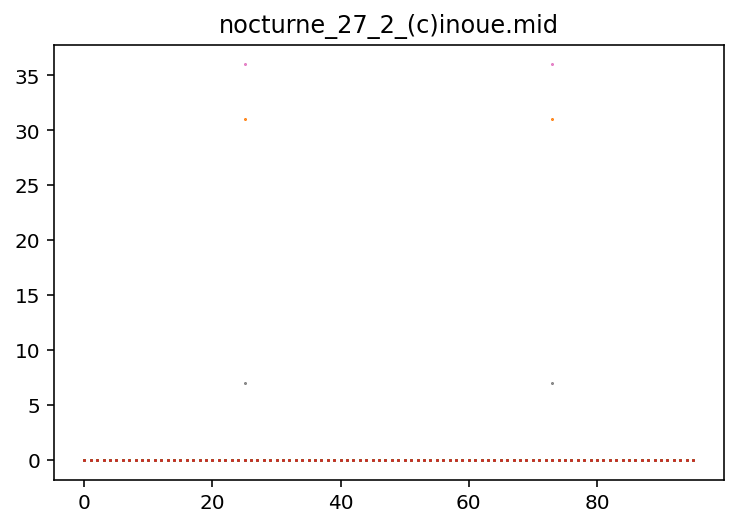

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


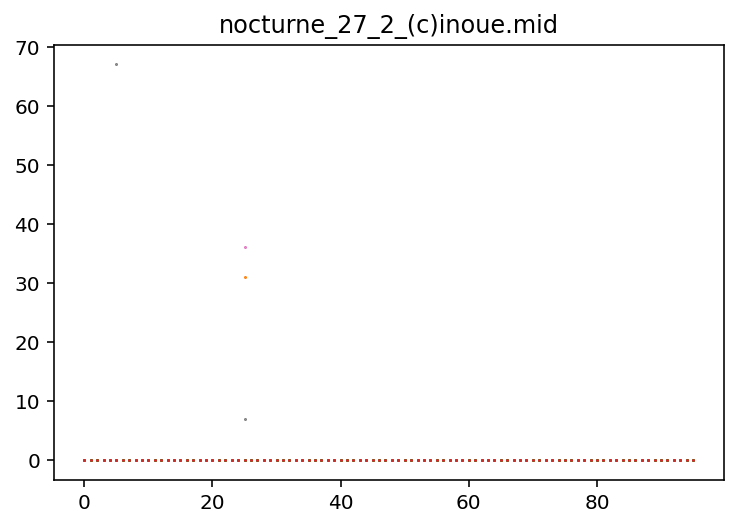

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


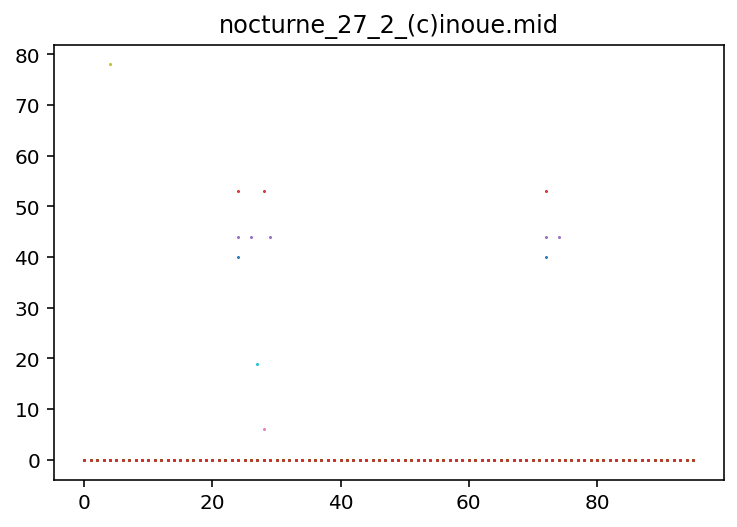

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


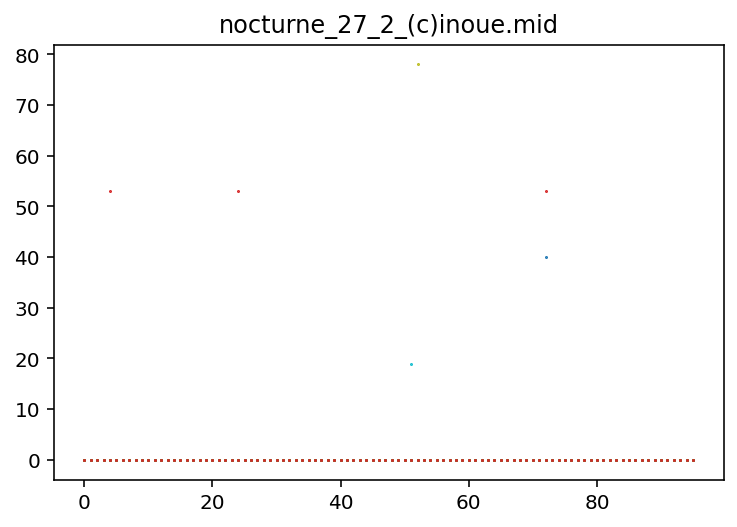

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


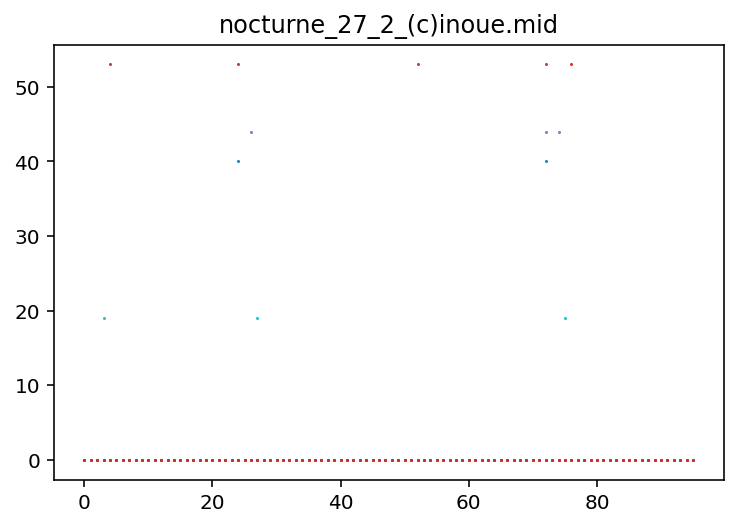

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


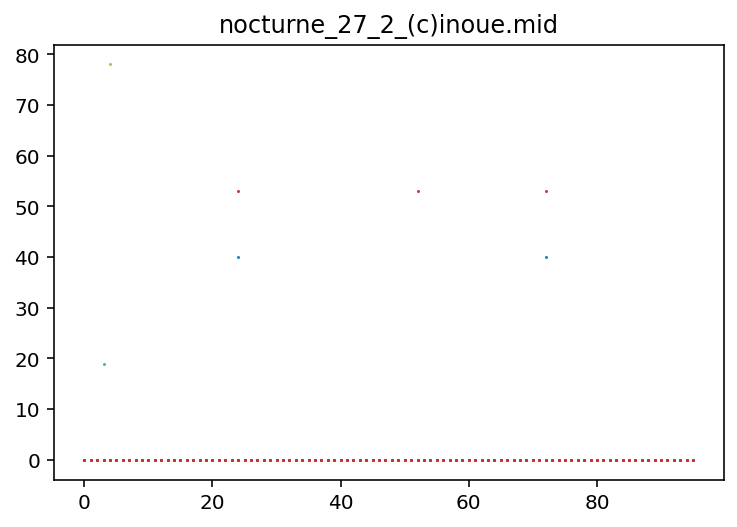

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


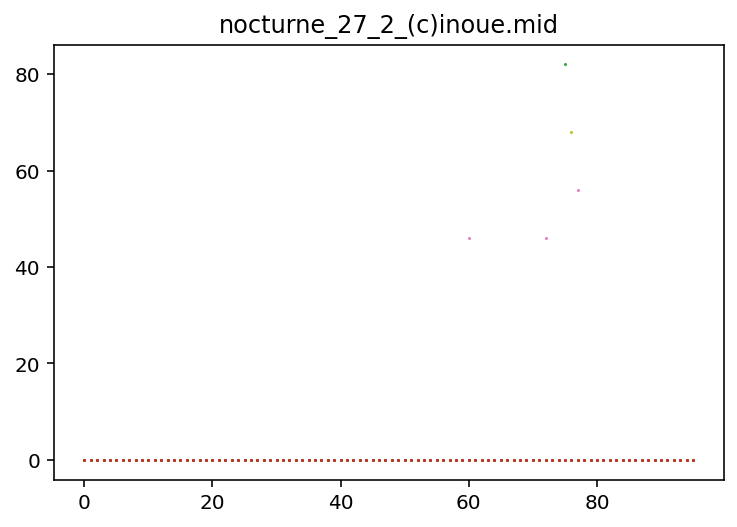

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


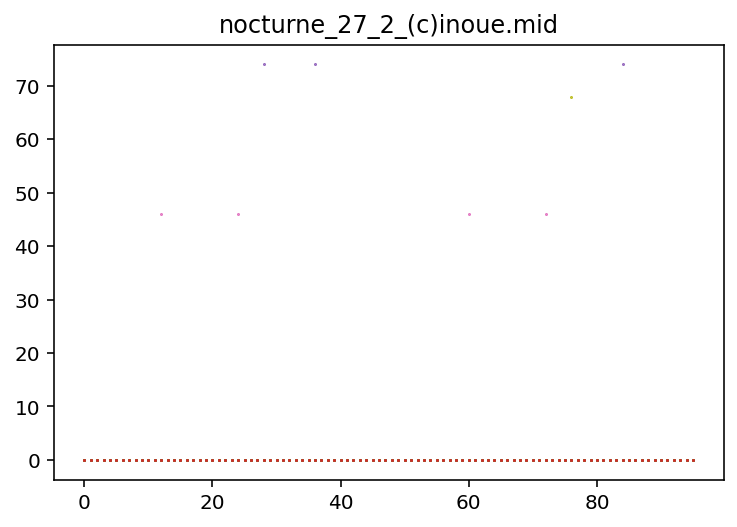

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


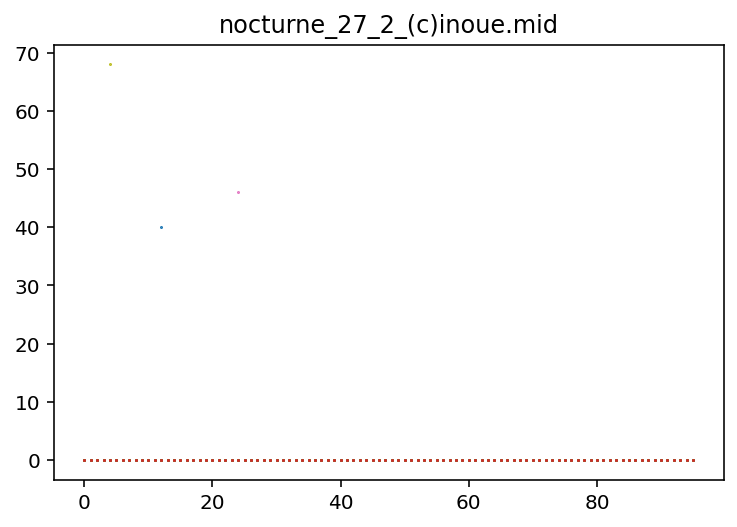

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


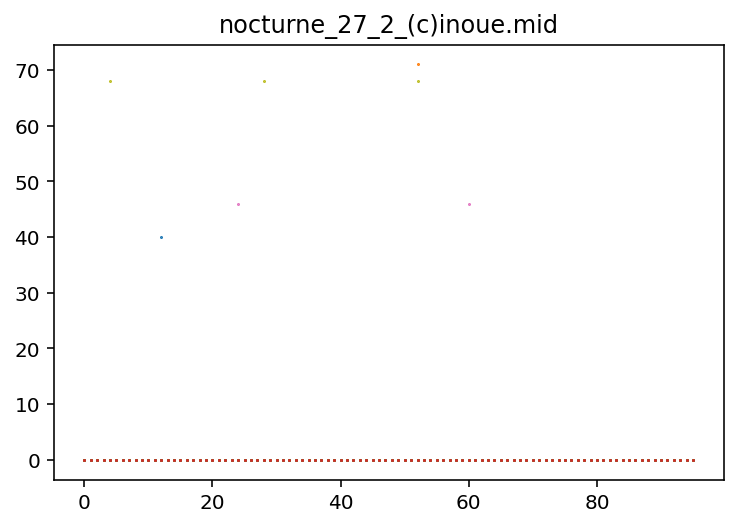

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


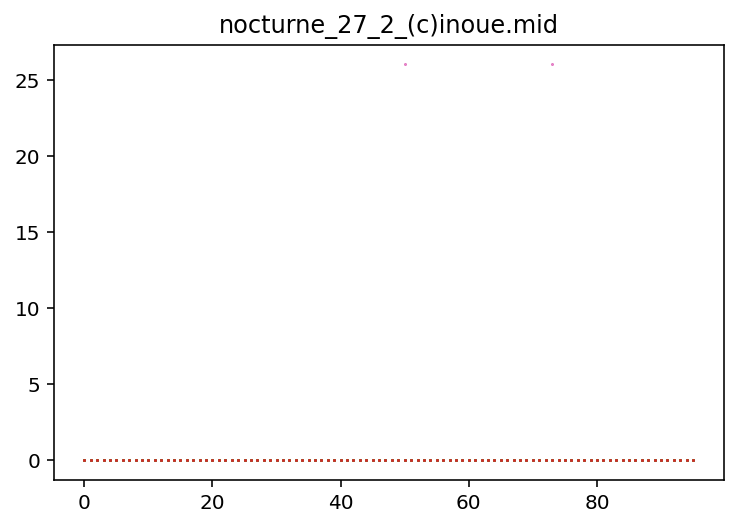

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


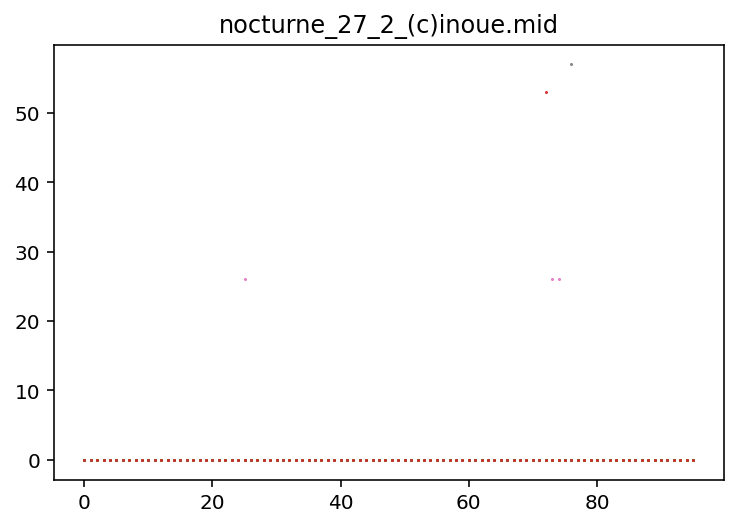

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


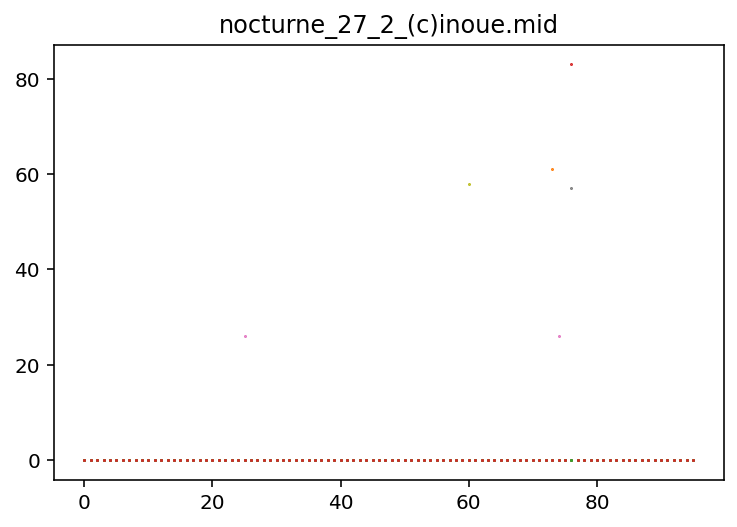

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


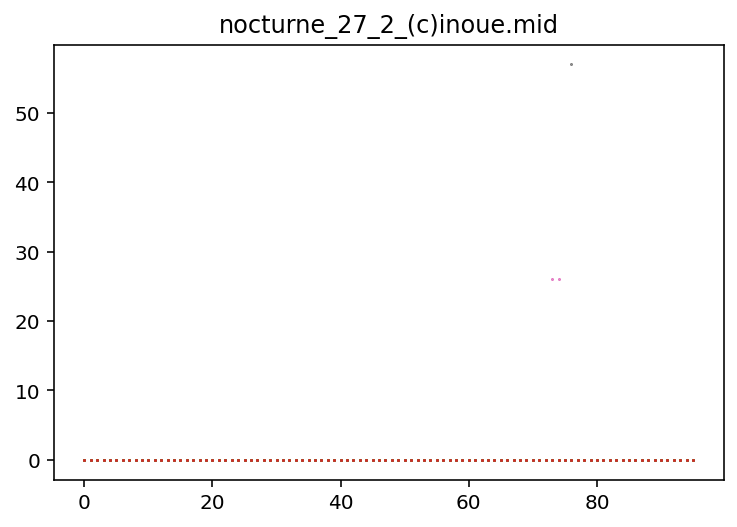

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


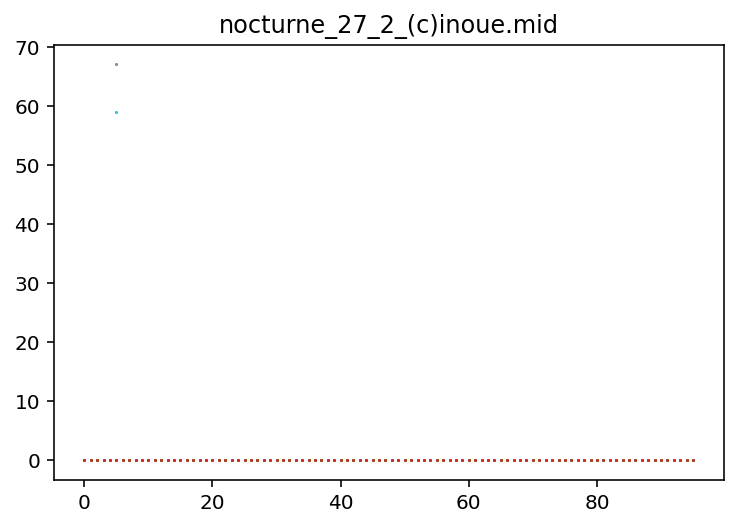

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


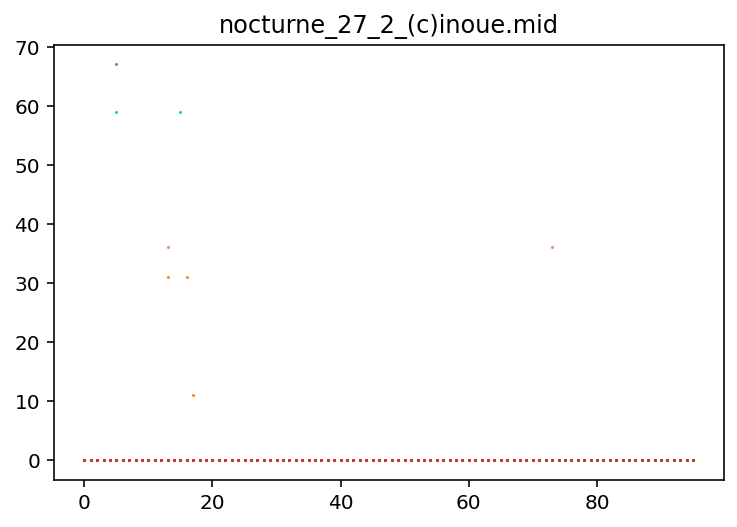

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


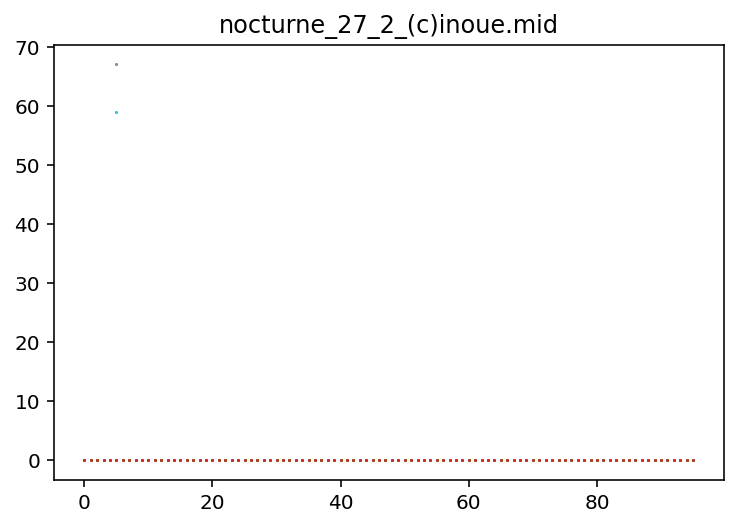

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


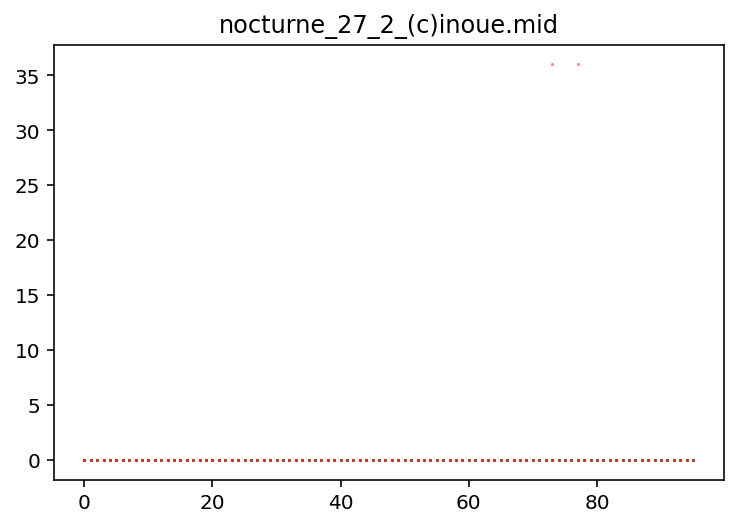

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


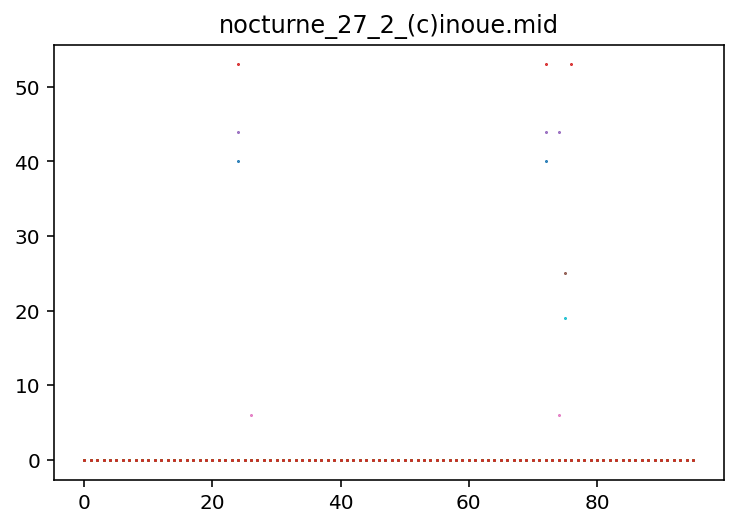

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


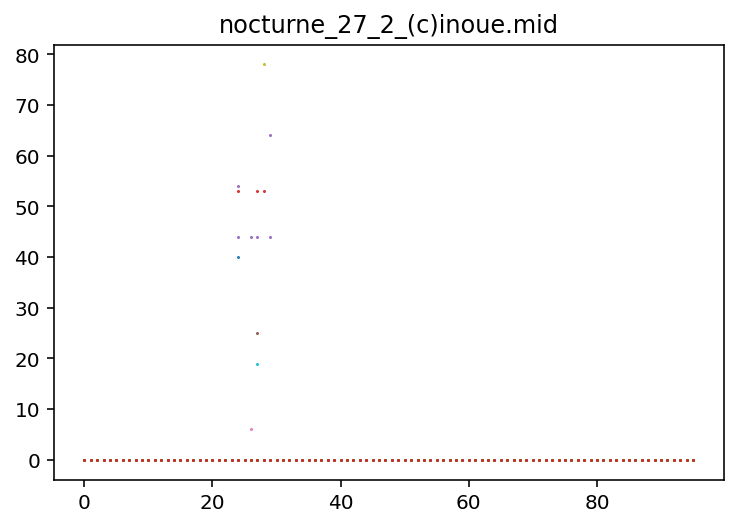

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


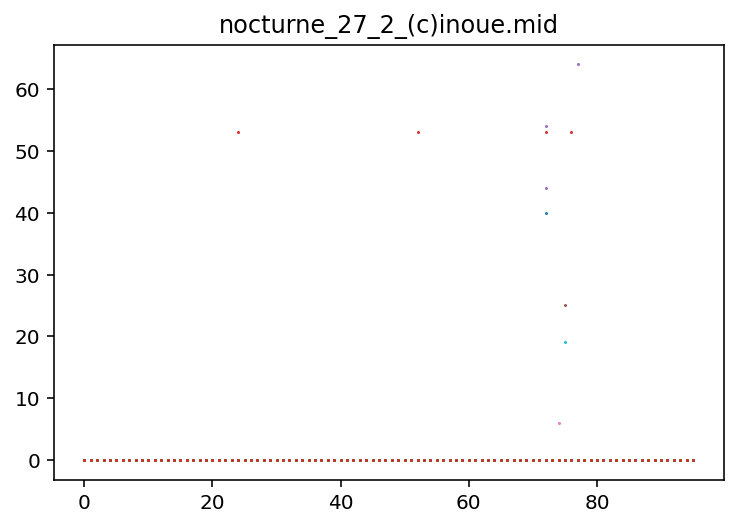

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


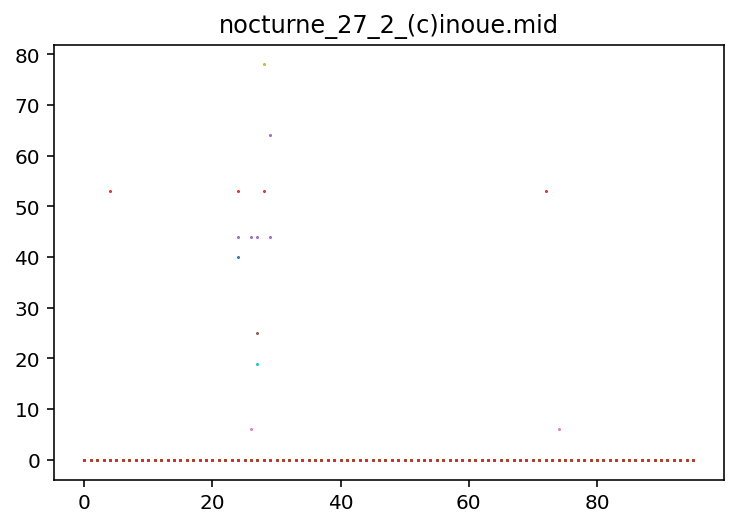

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


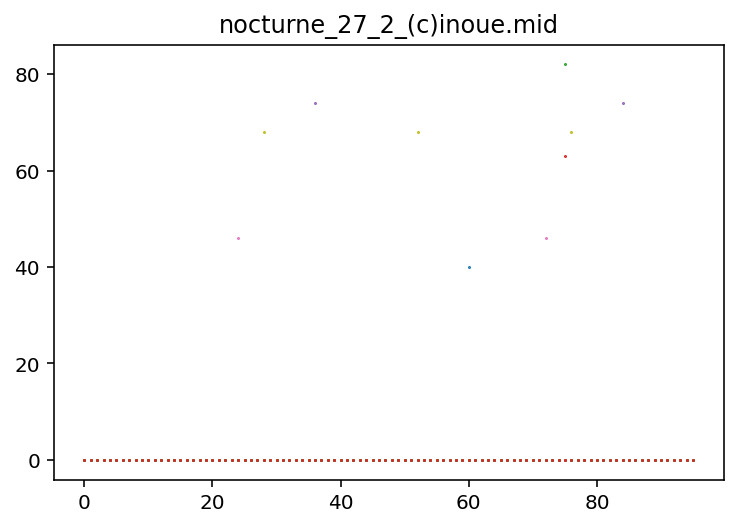

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


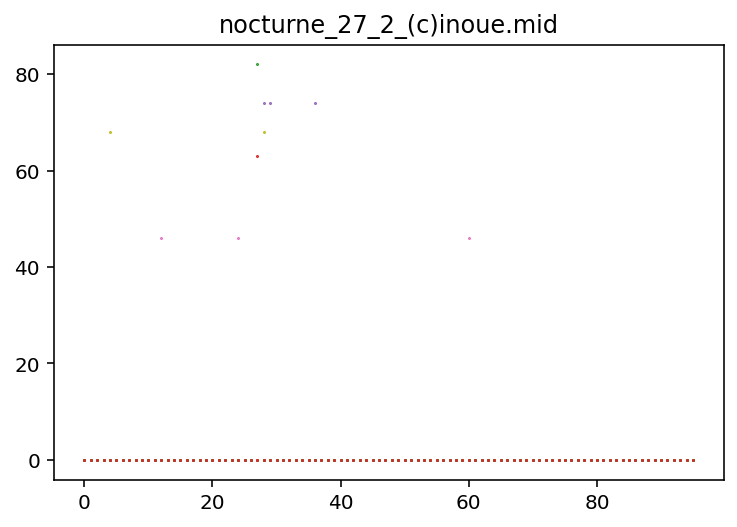

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


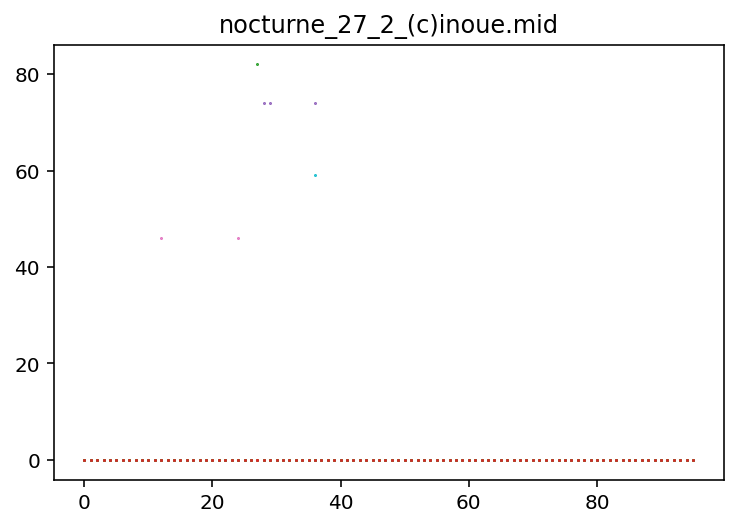

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


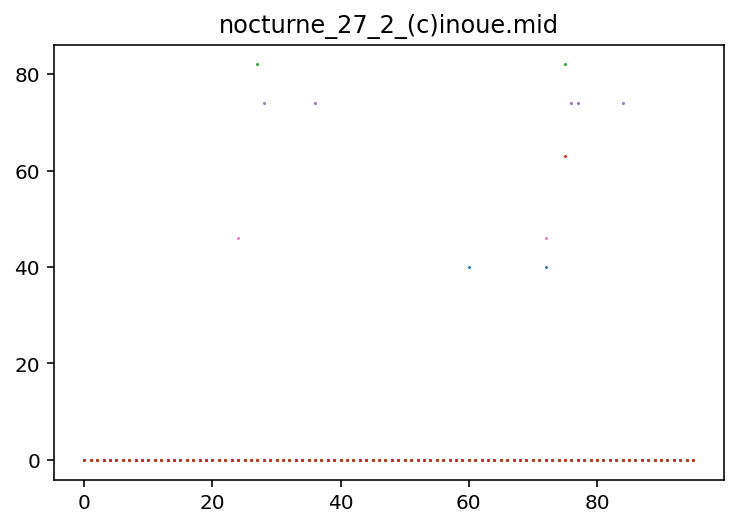

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


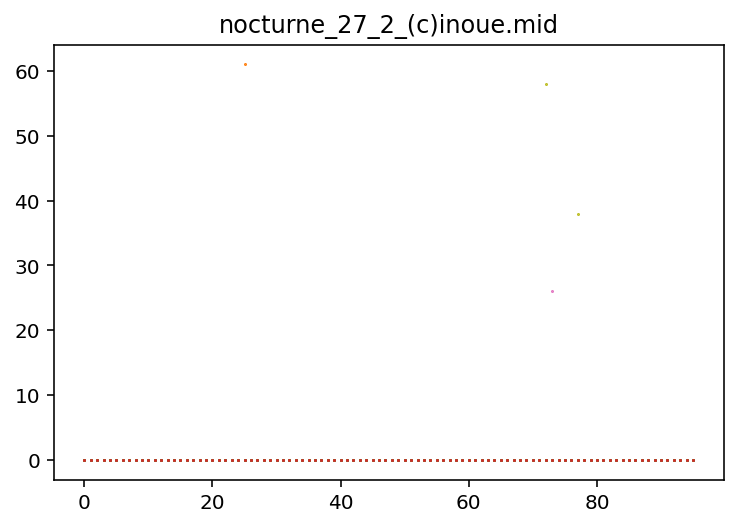

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


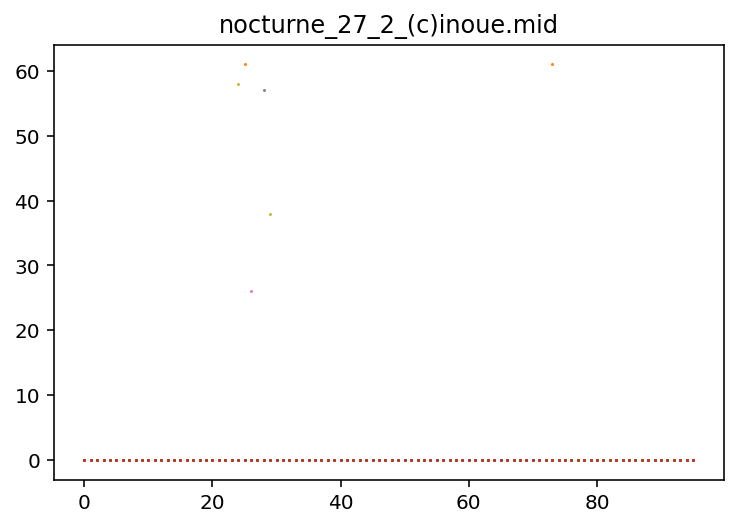

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


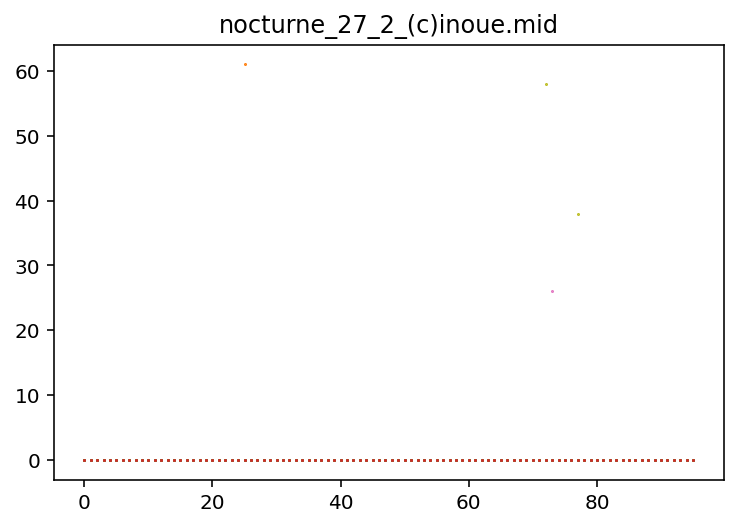

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


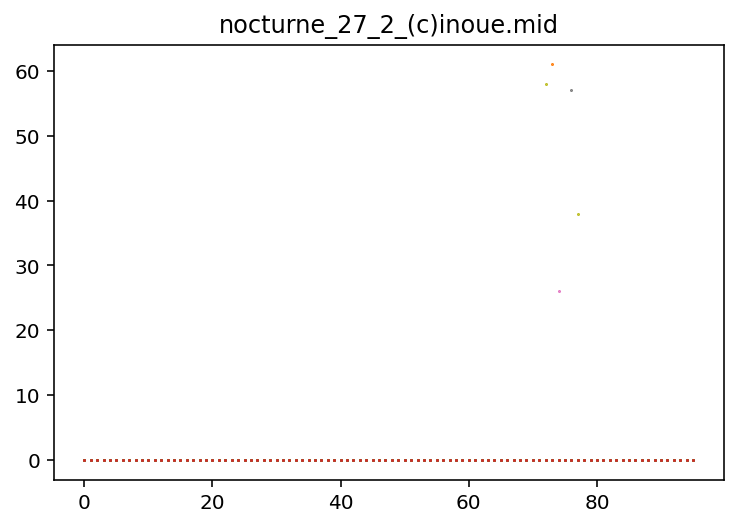

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


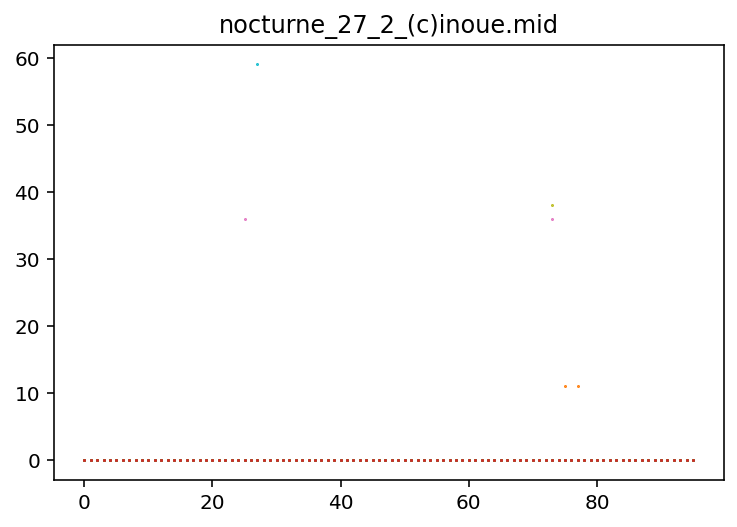

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


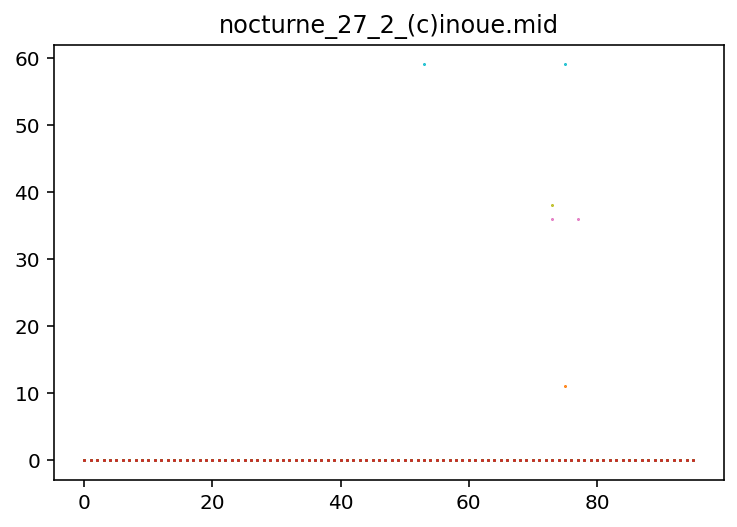

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


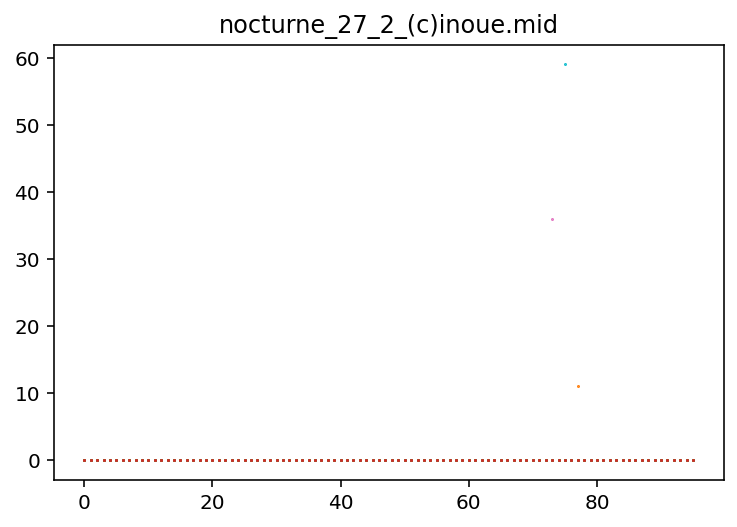

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


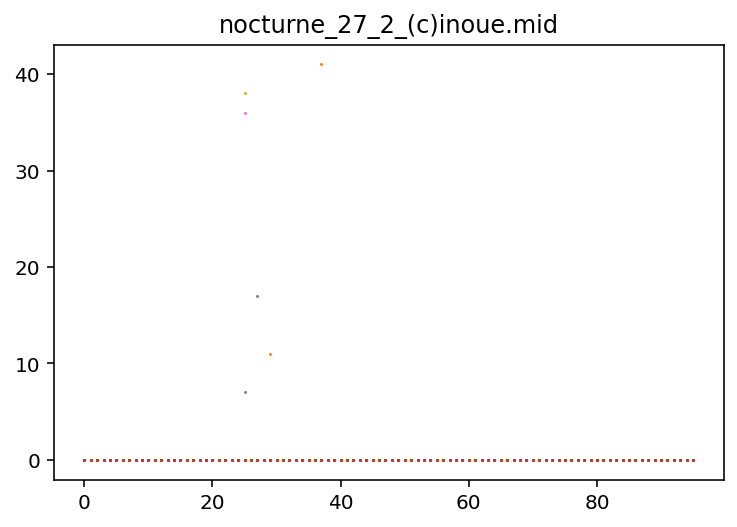

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


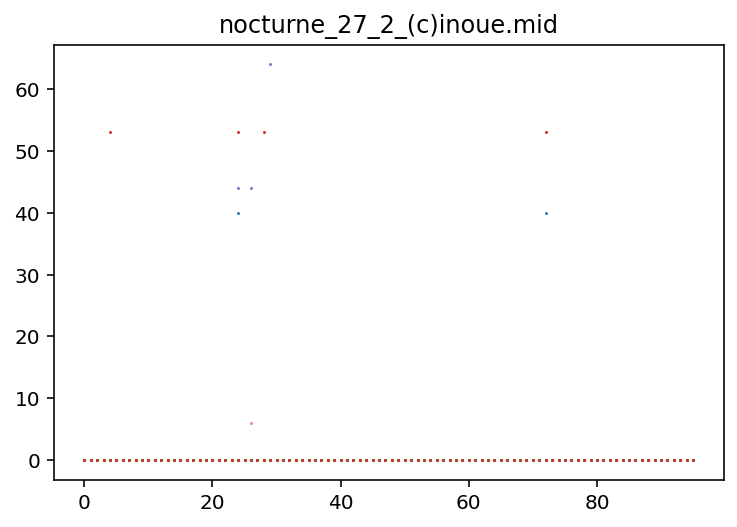

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


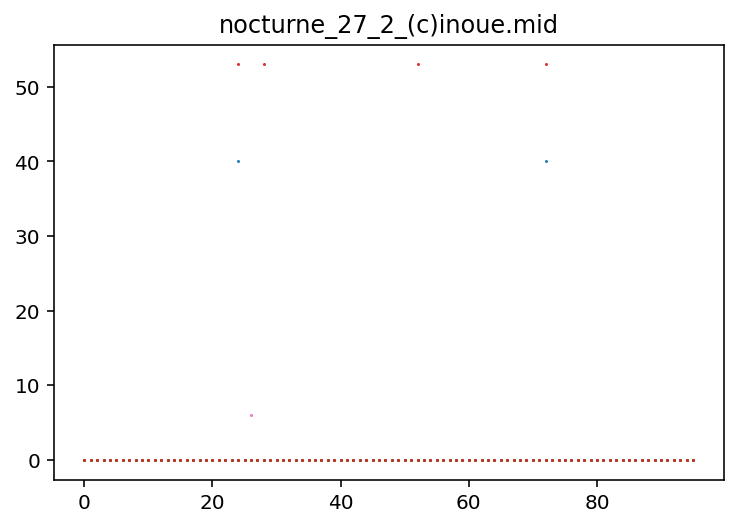

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


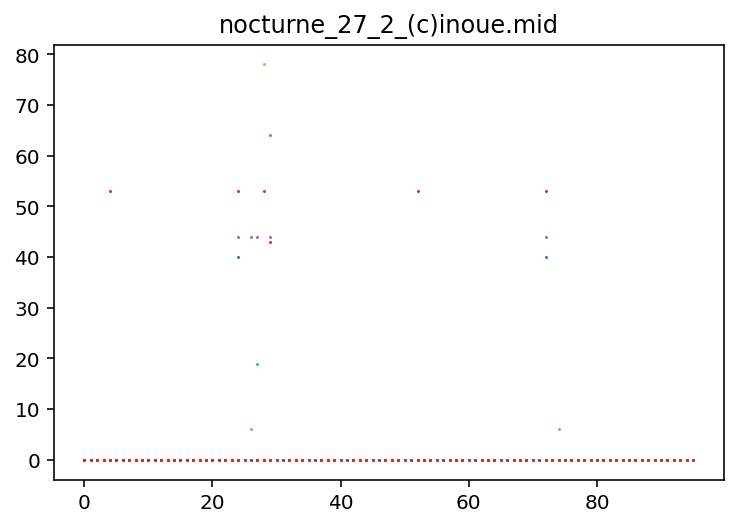

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


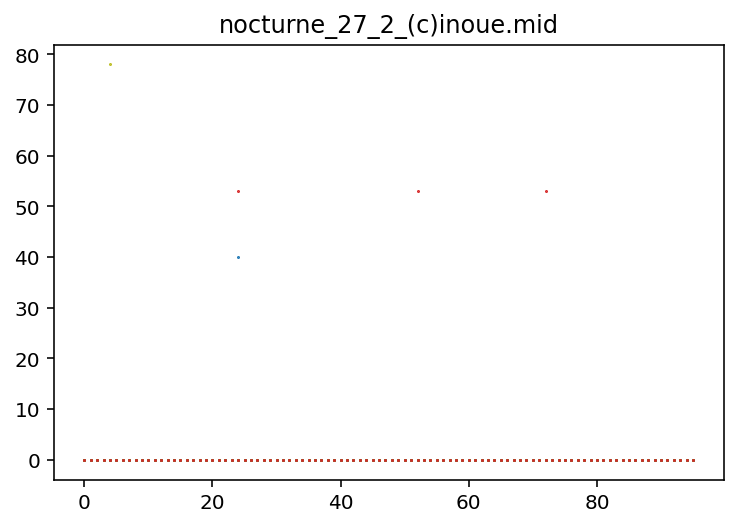

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


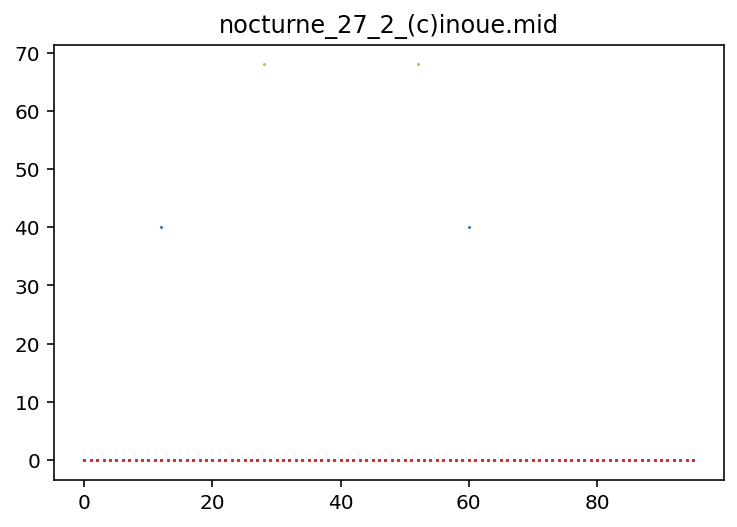

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


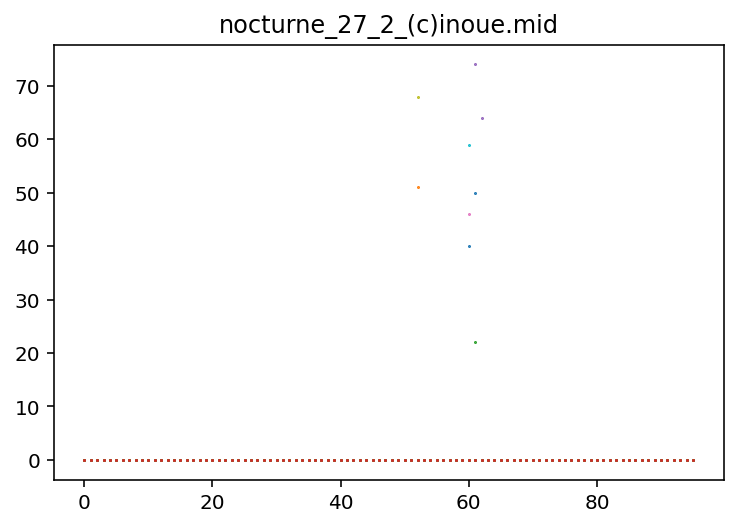

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


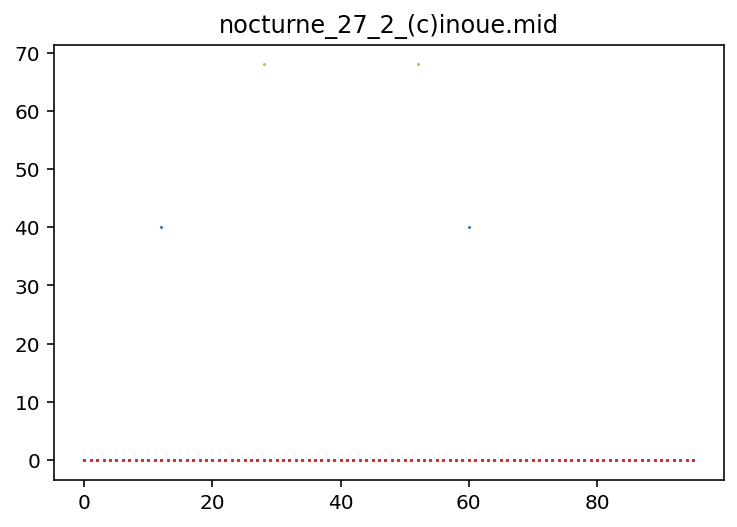

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


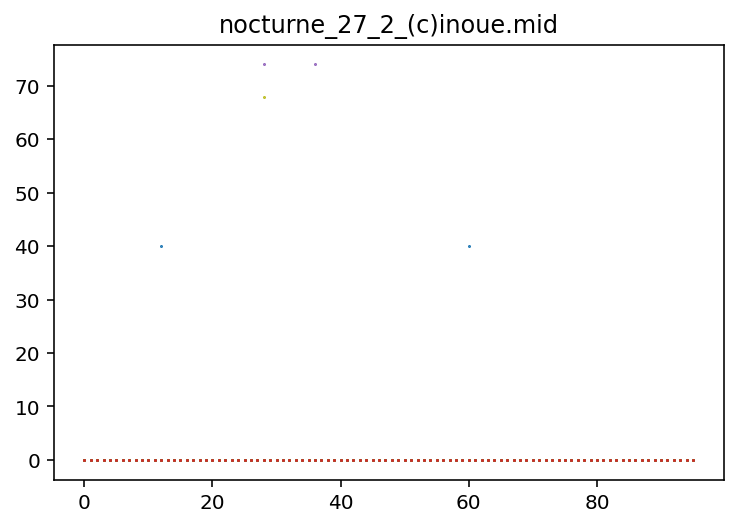

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


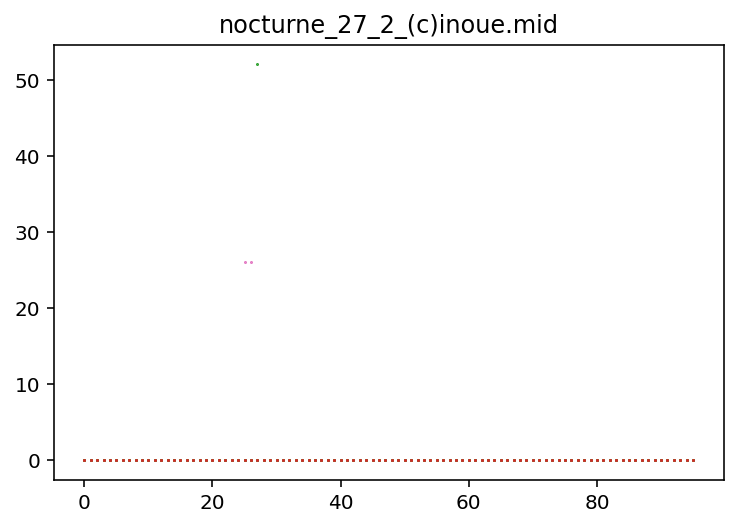

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


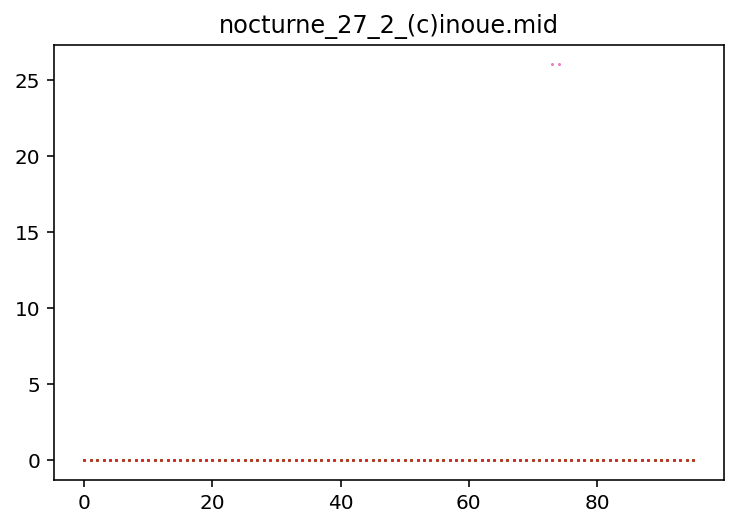

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


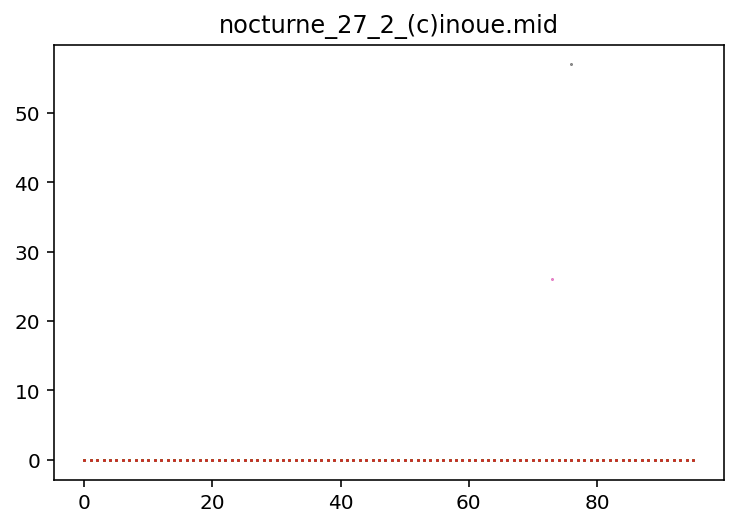

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


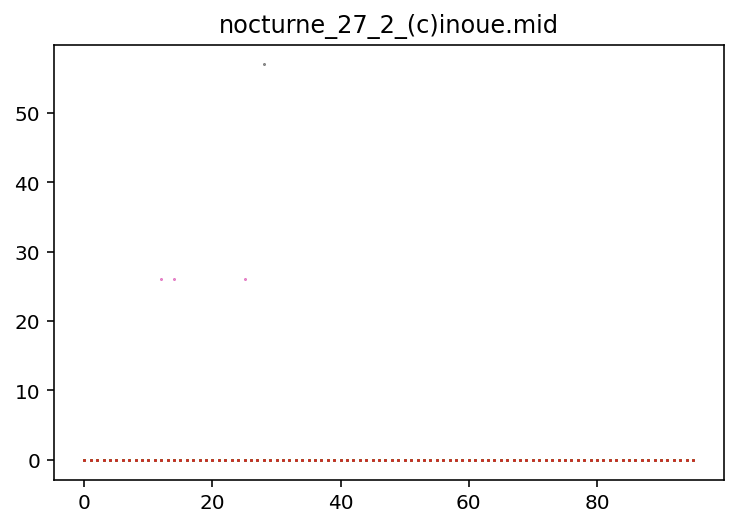

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


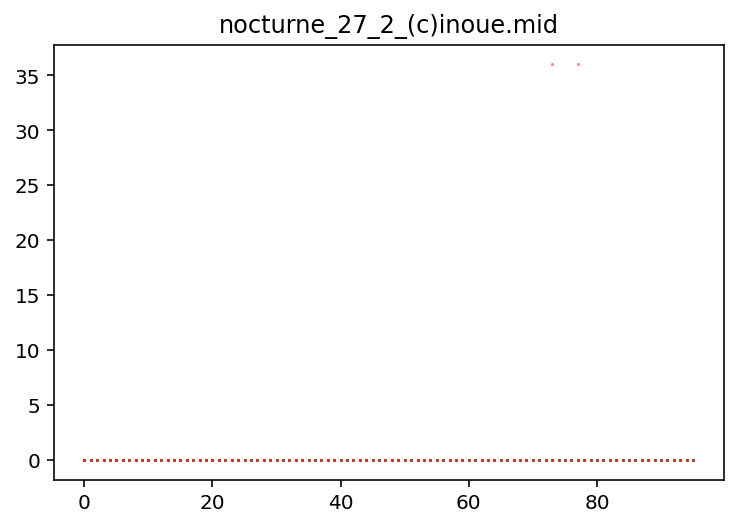

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


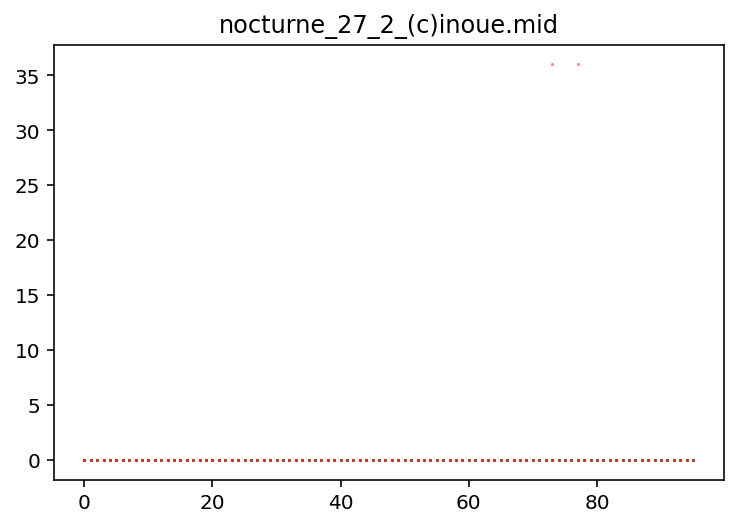

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


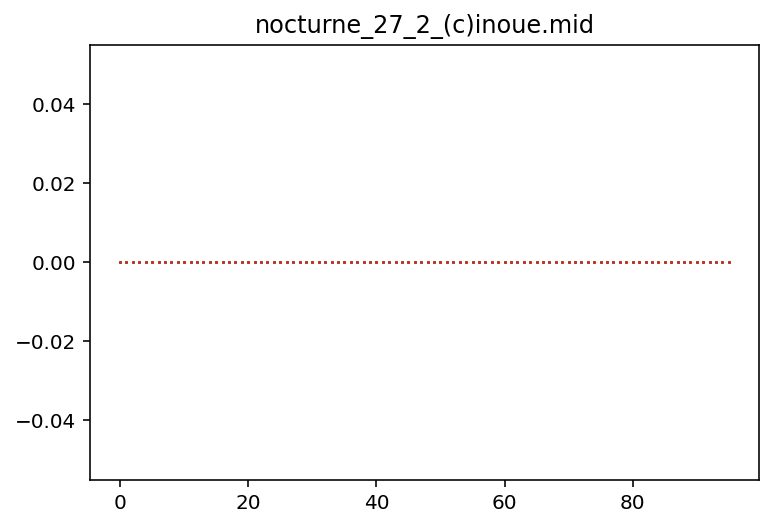

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


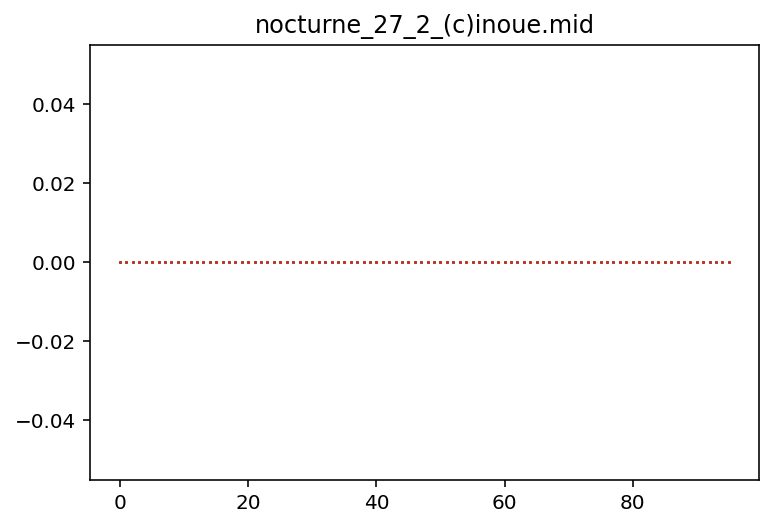

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


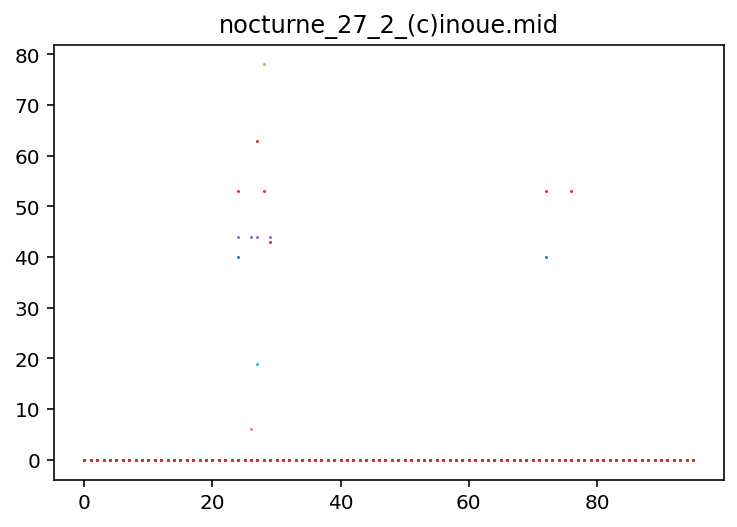

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


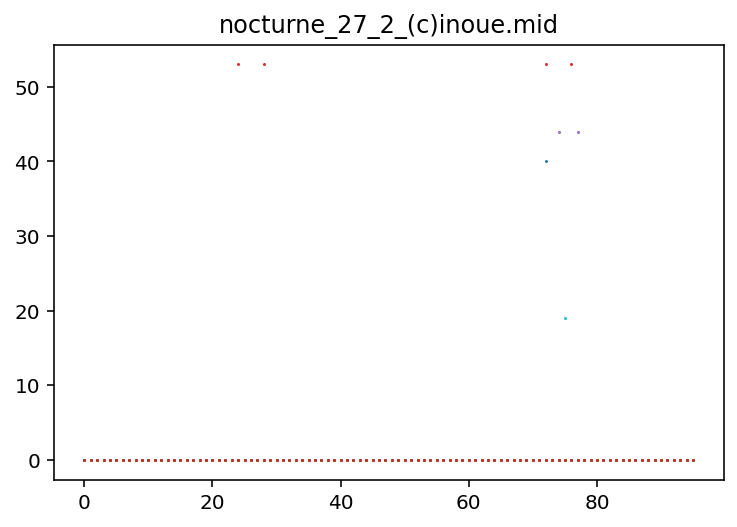

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


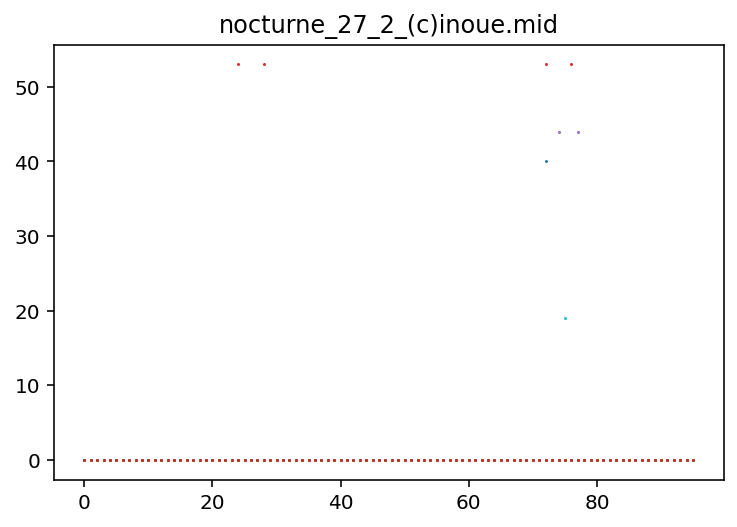

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


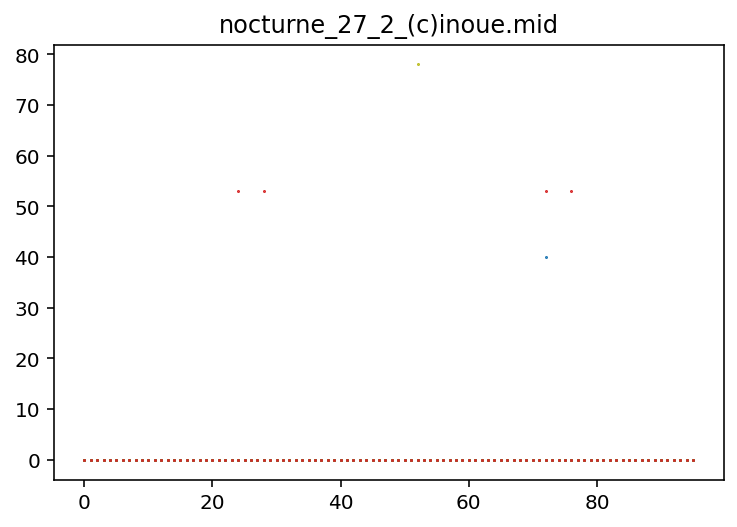

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


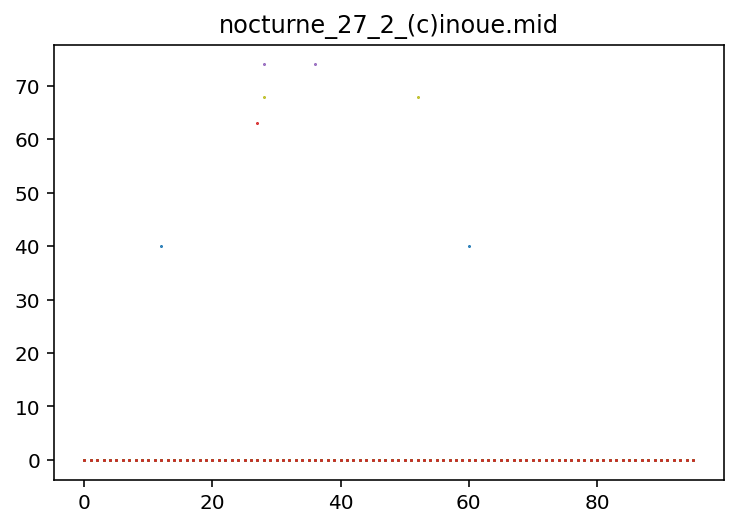

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


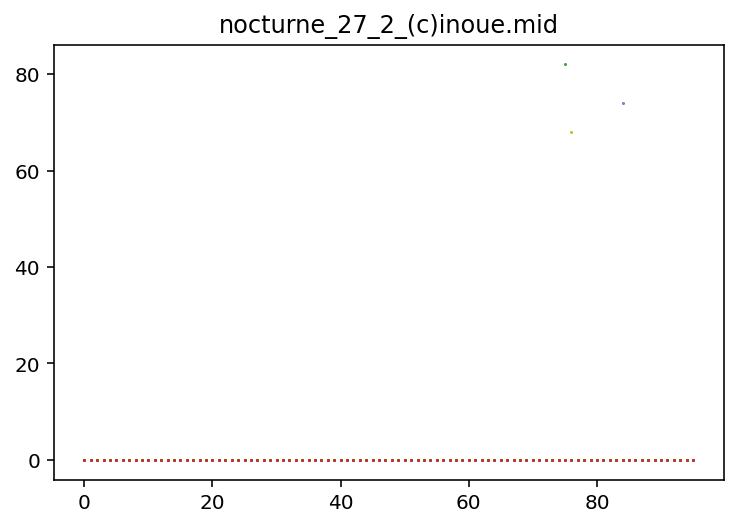

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


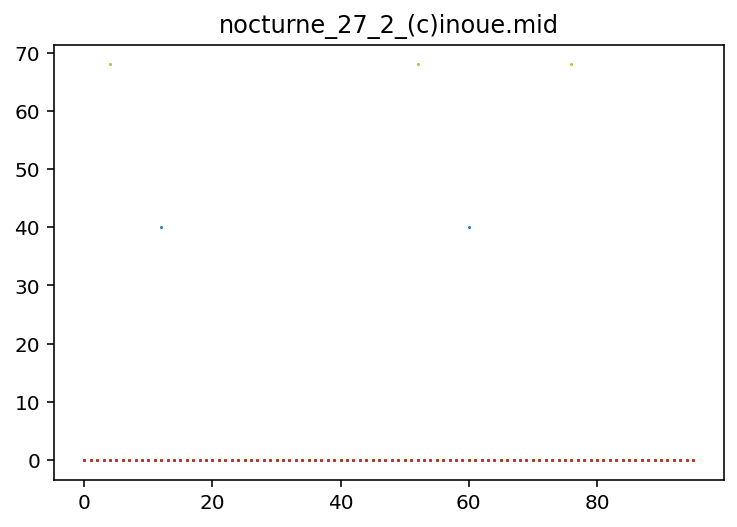

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


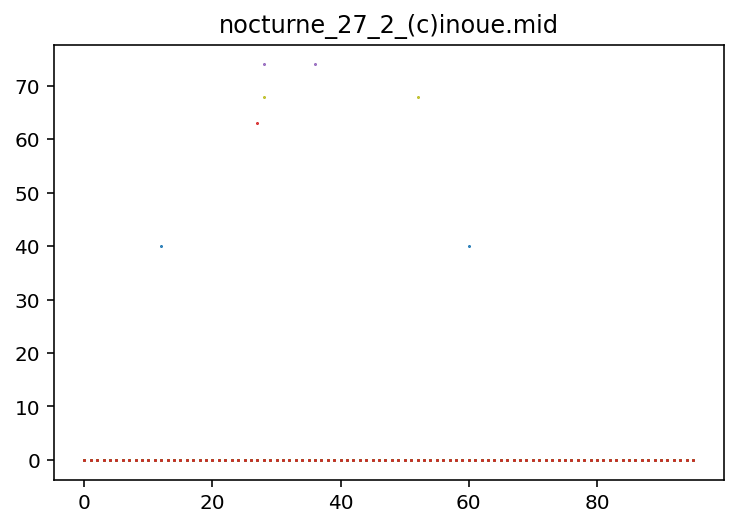

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


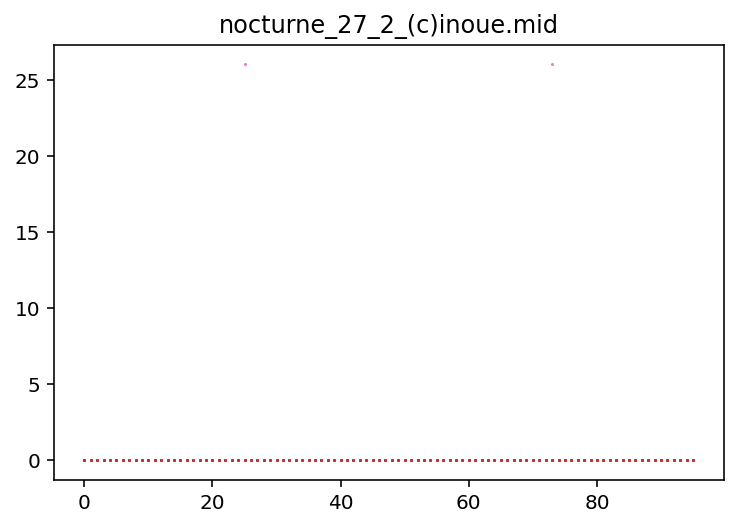

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


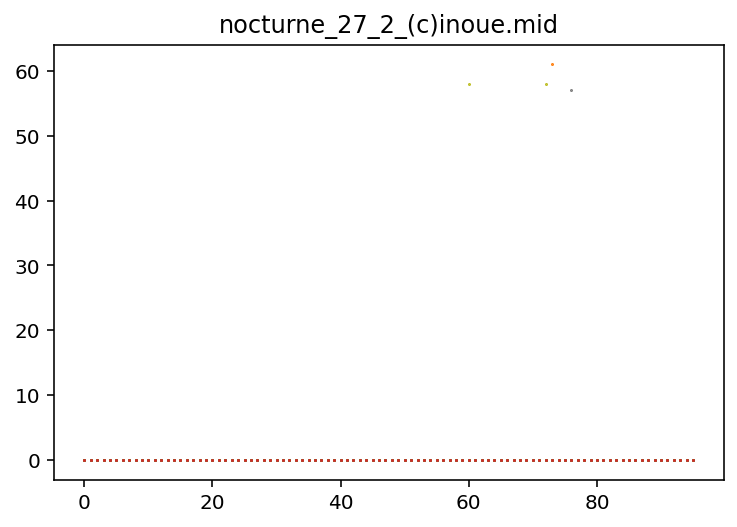

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


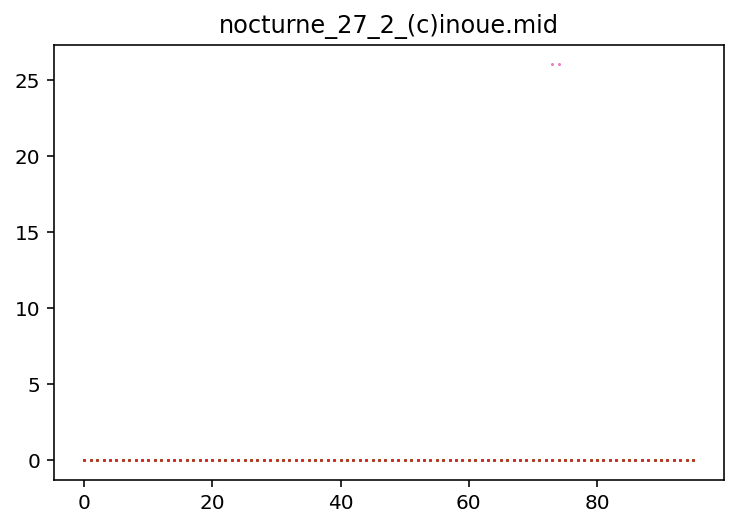

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


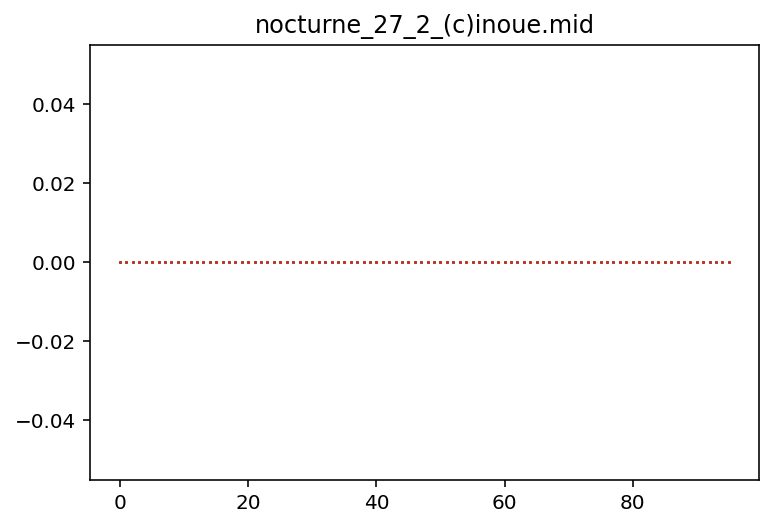

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


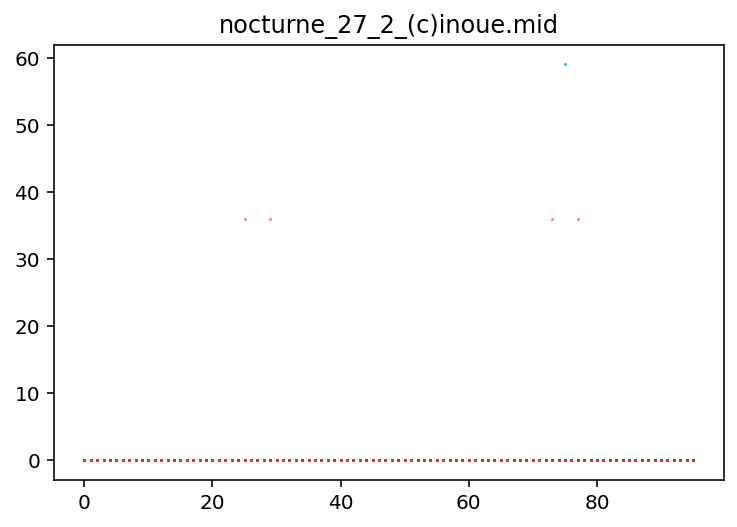

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


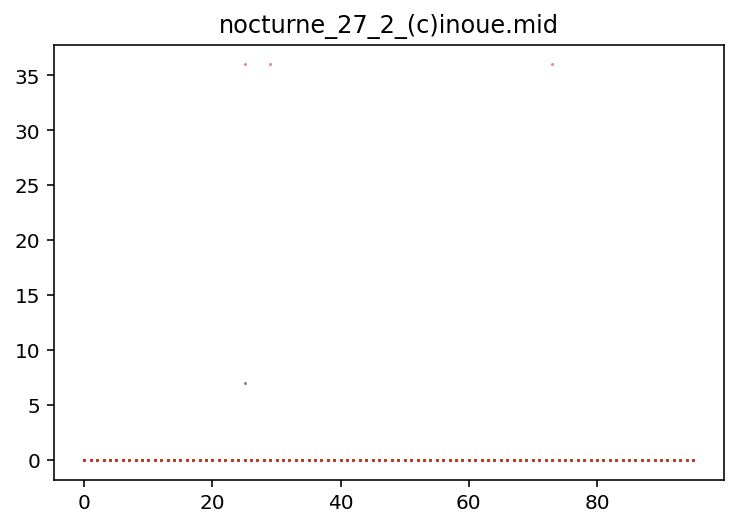

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


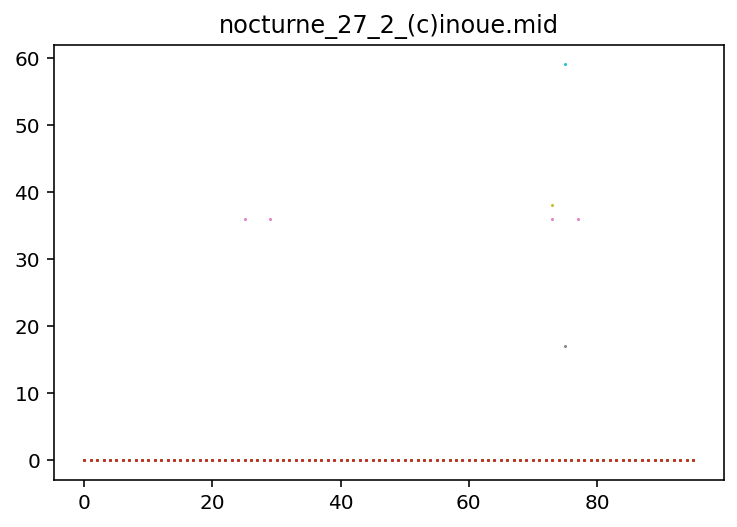

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


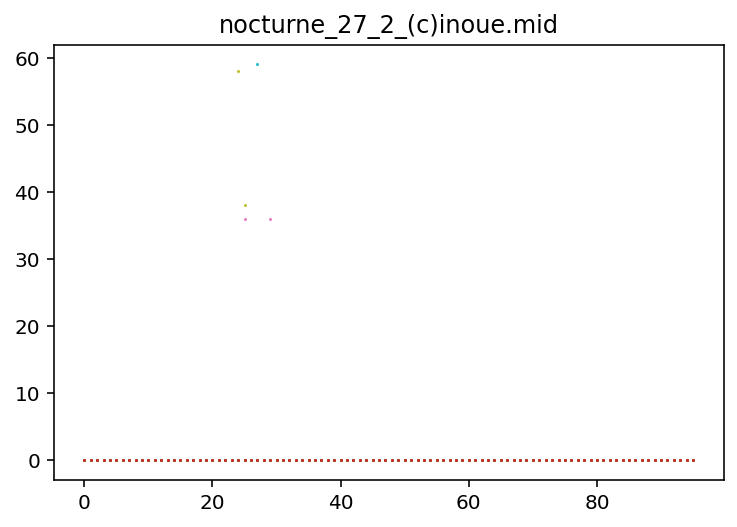

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


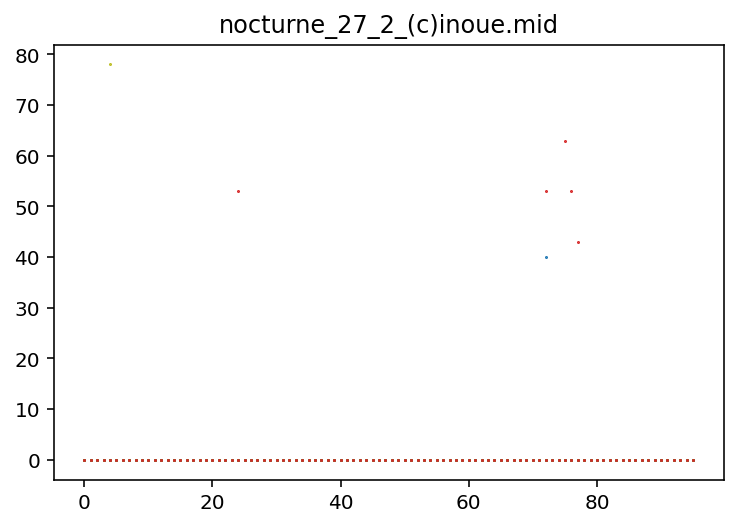

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


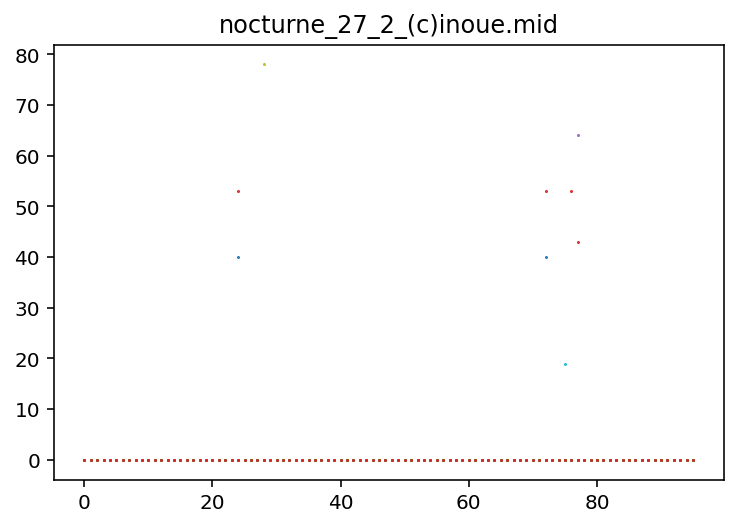

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


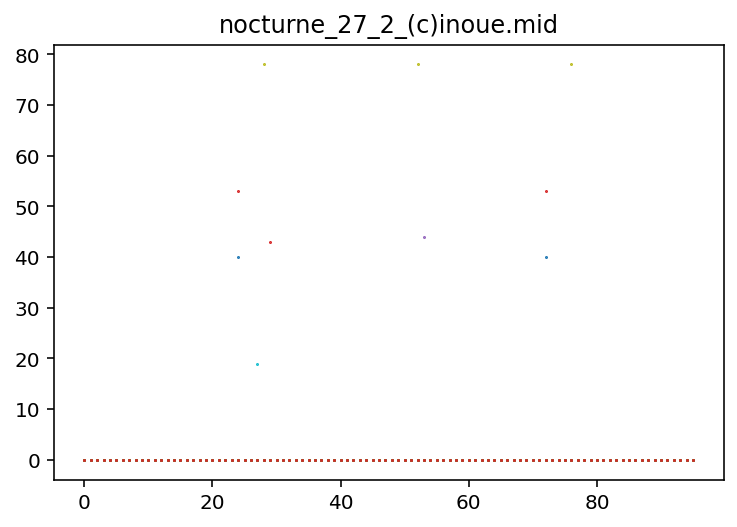

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


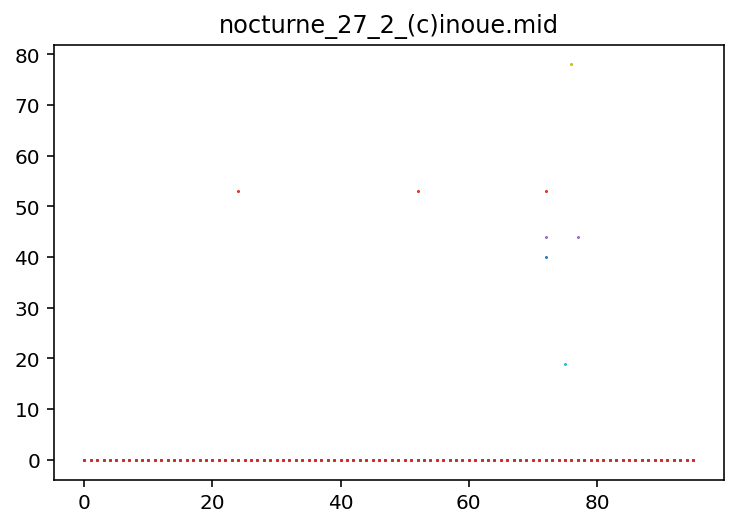

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


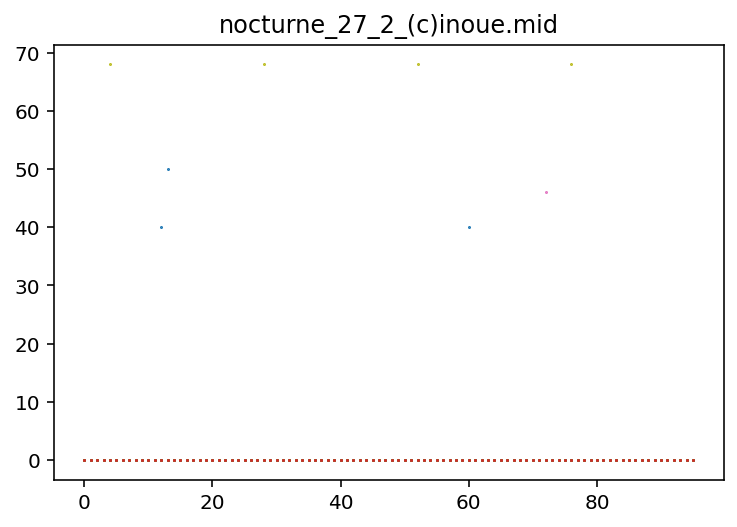

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


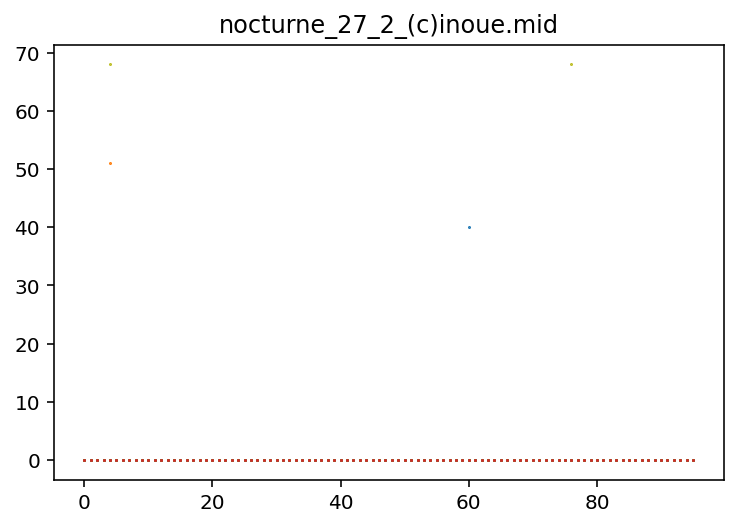

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


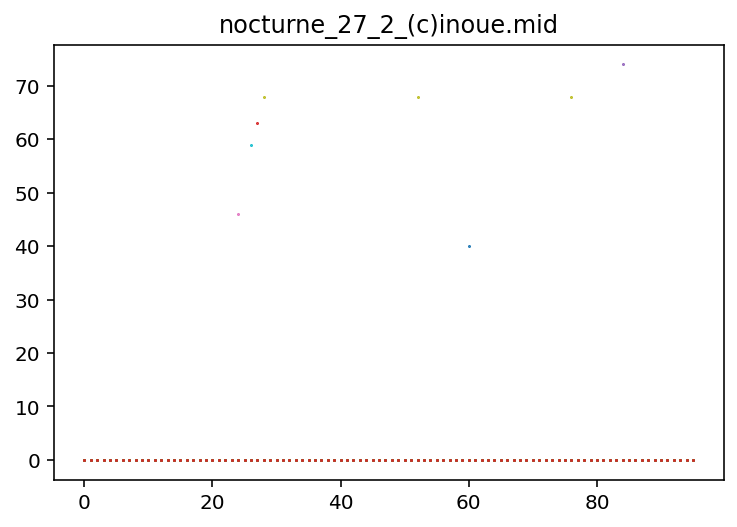

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


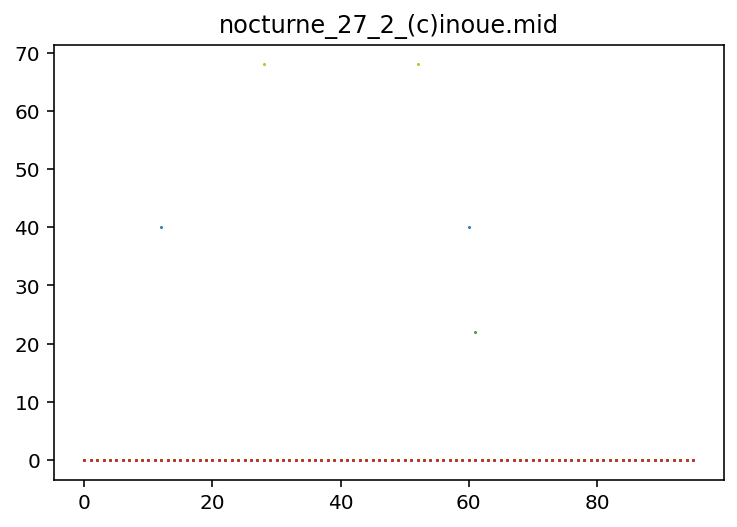

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


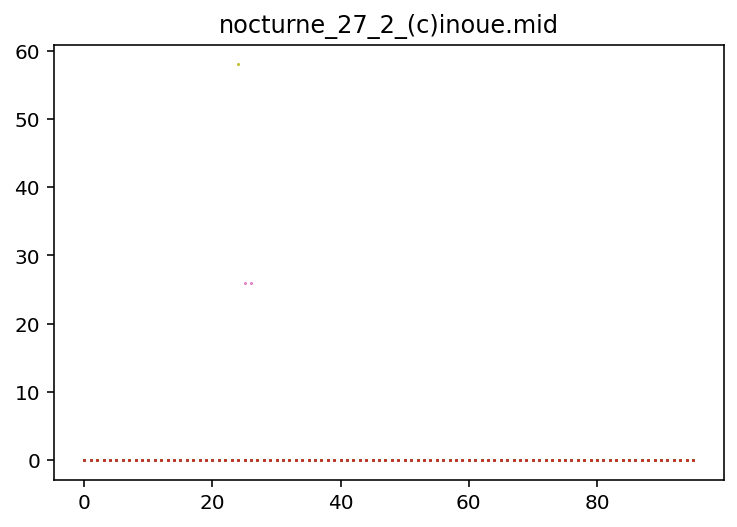

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


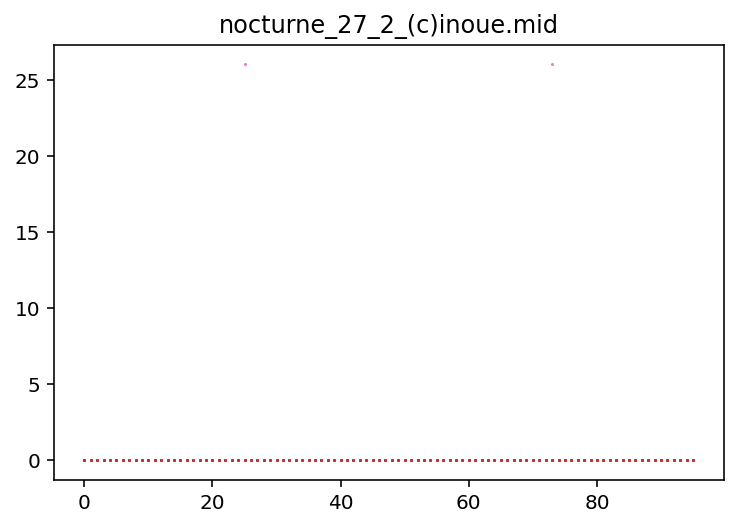

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


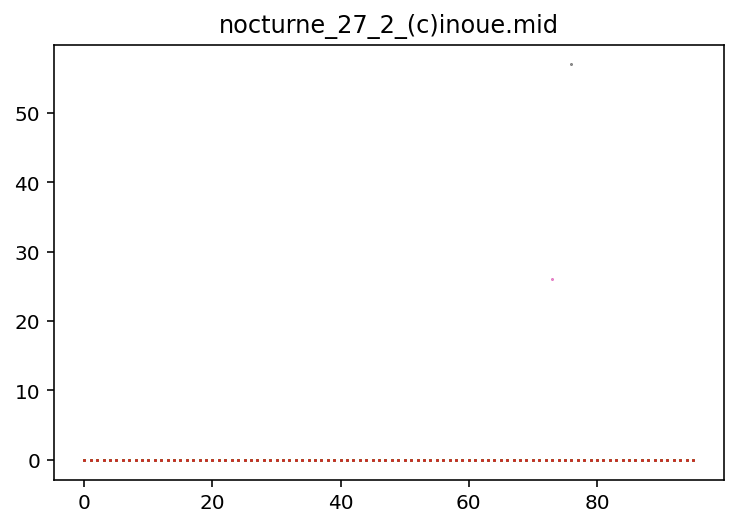

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


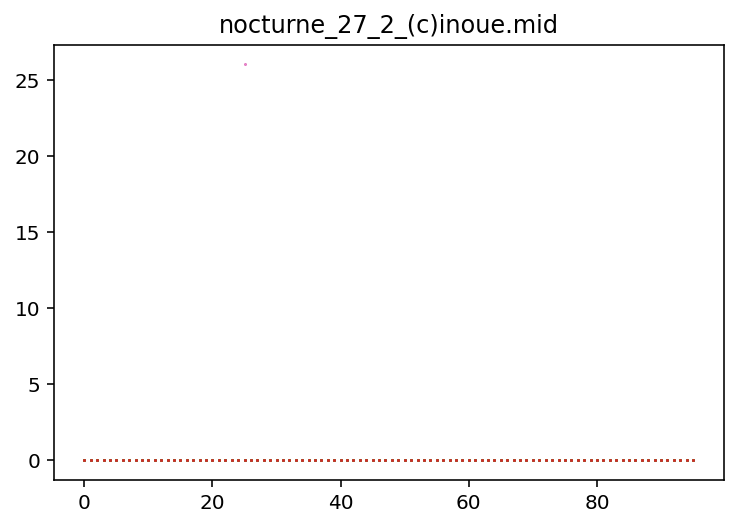

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


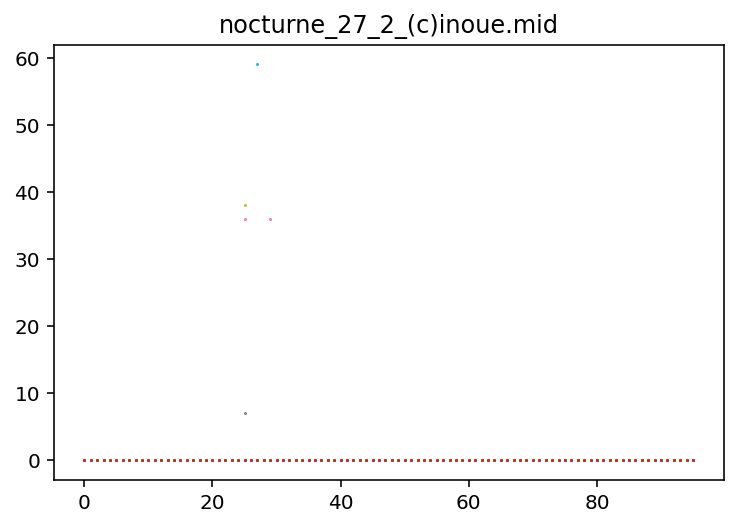

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


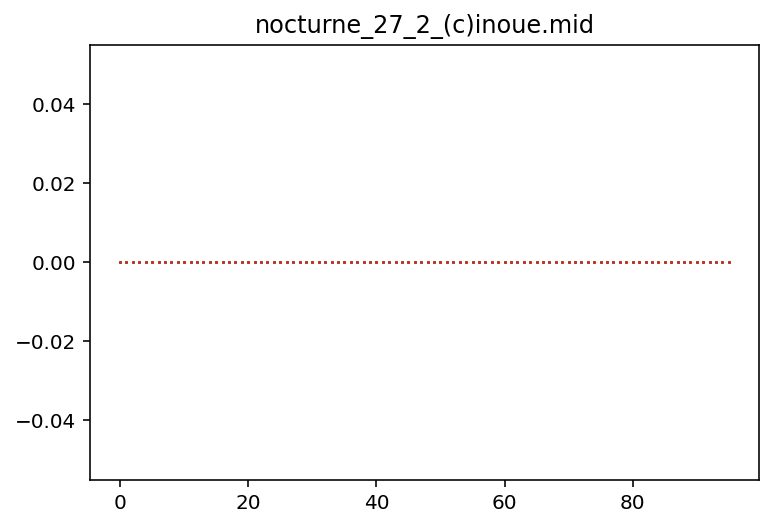

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


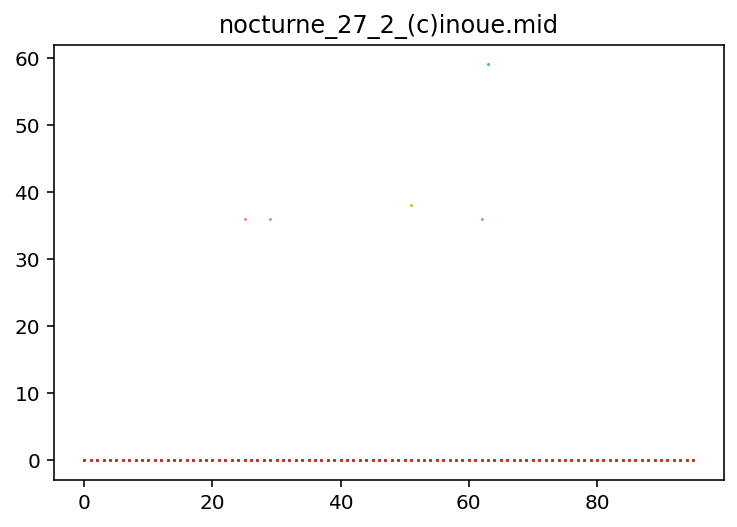

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


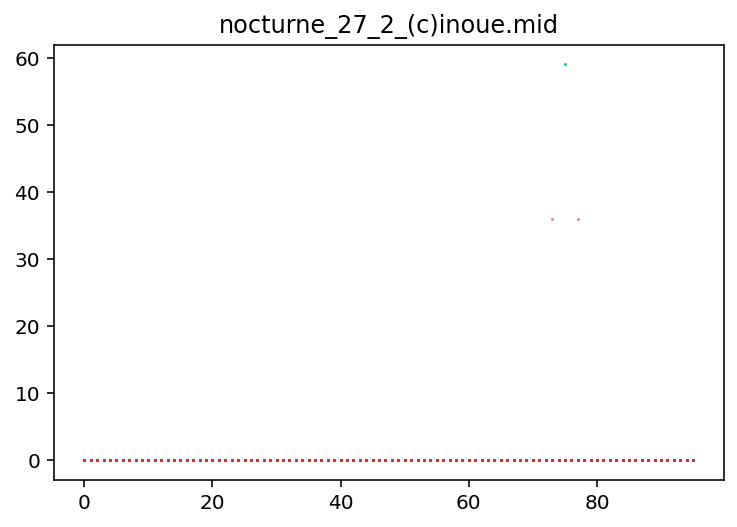

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


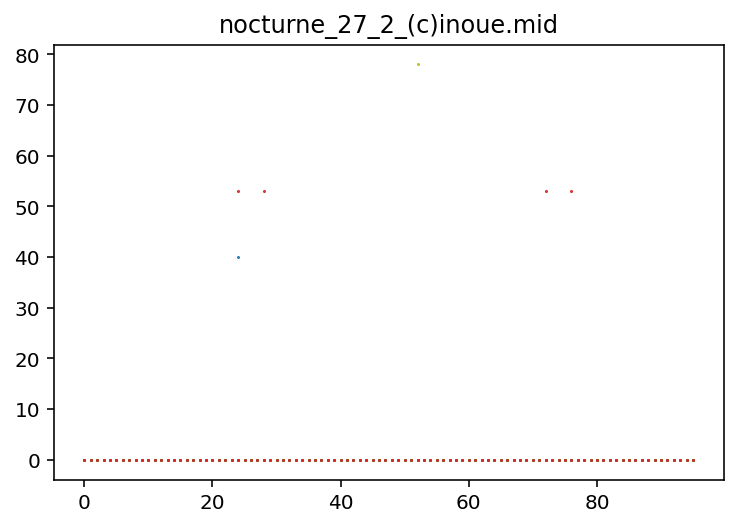

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


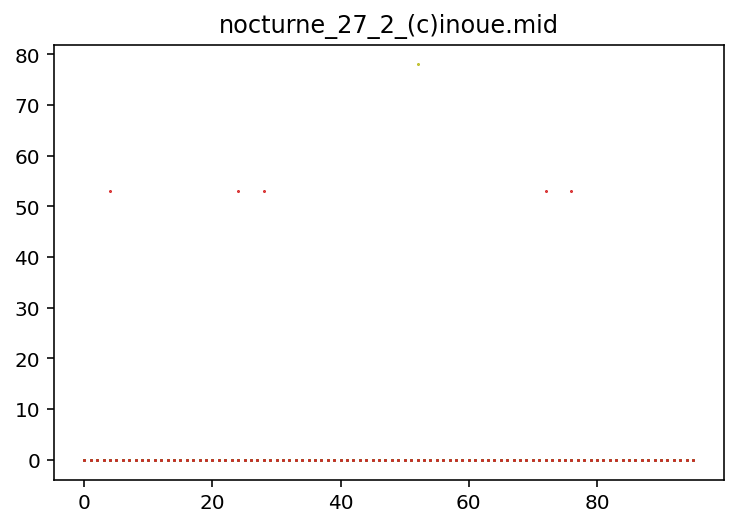

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


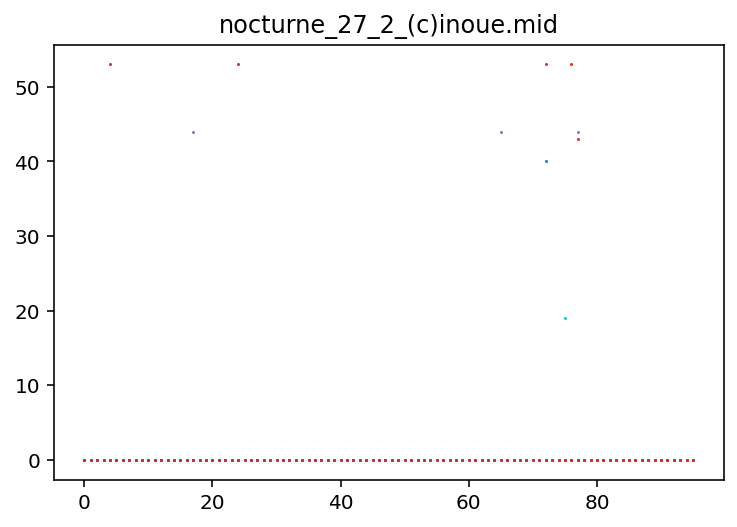

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


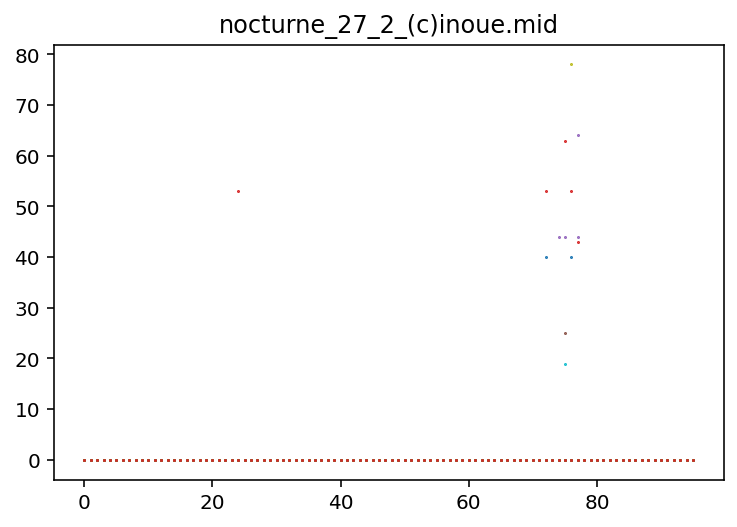

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
(4, 40, 4, 96, 84)


<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


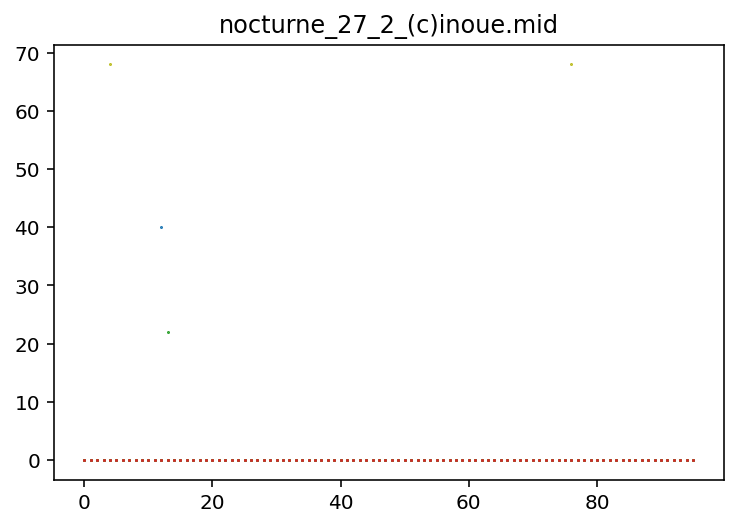

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


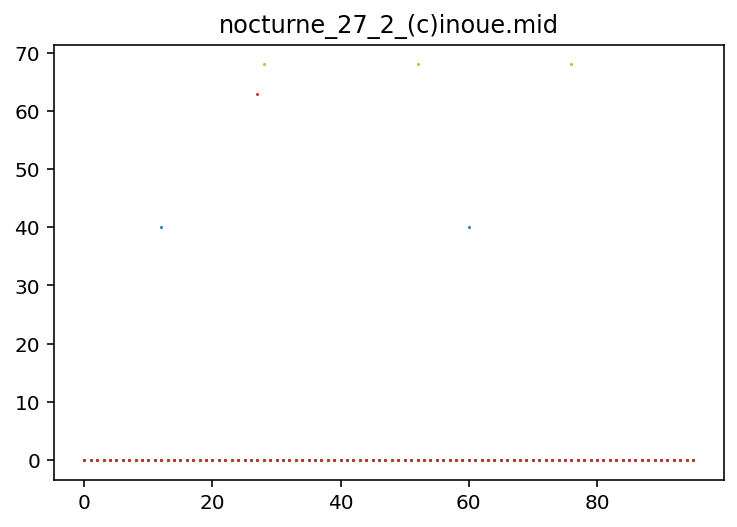

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


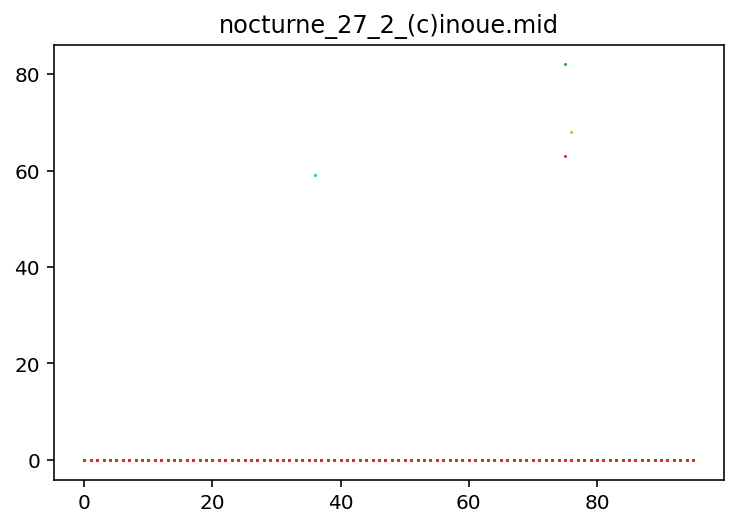

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


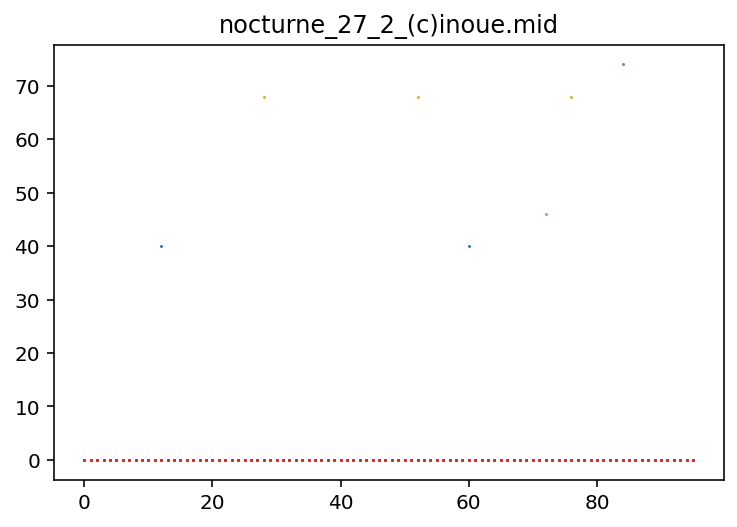

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


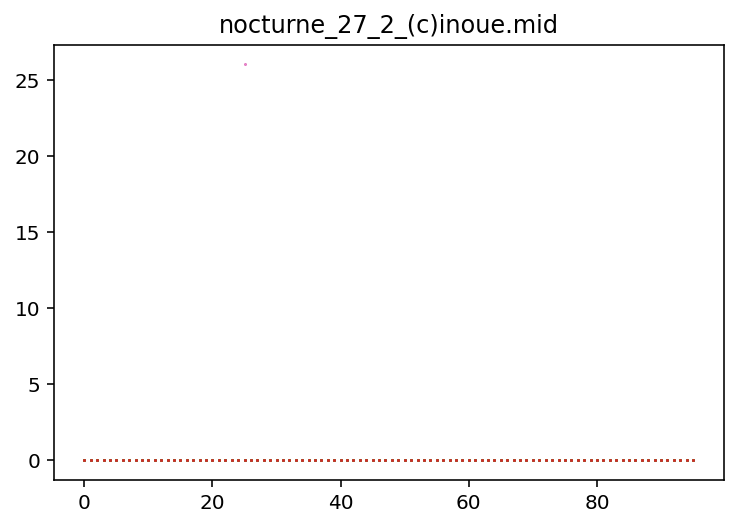

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


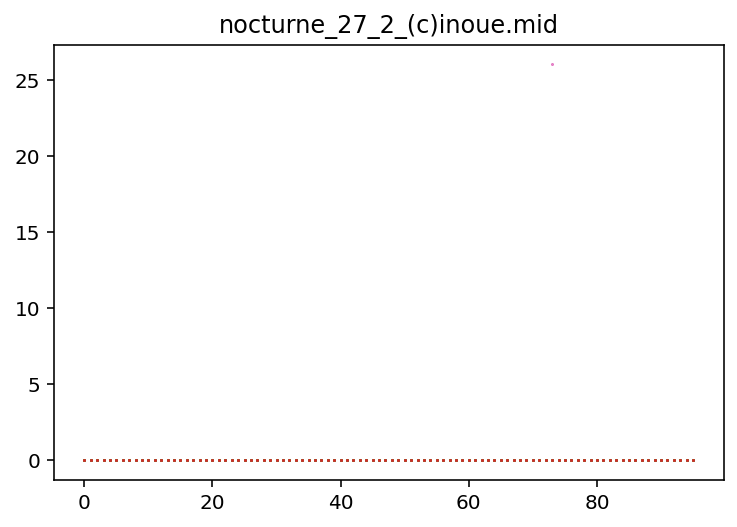

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


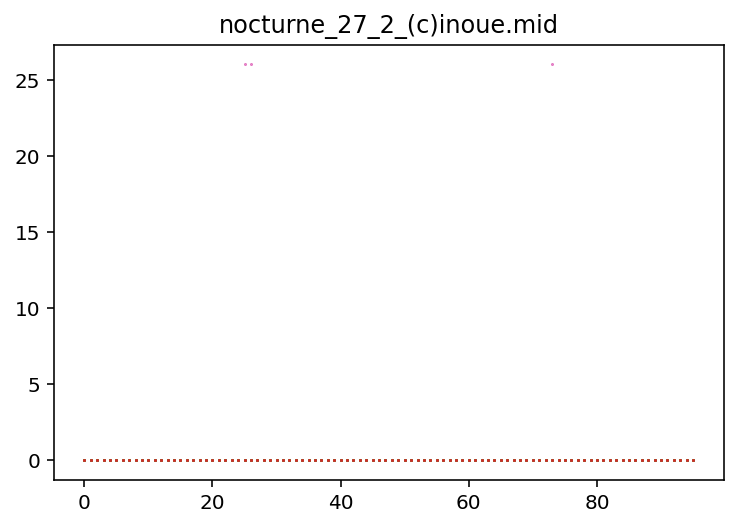

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


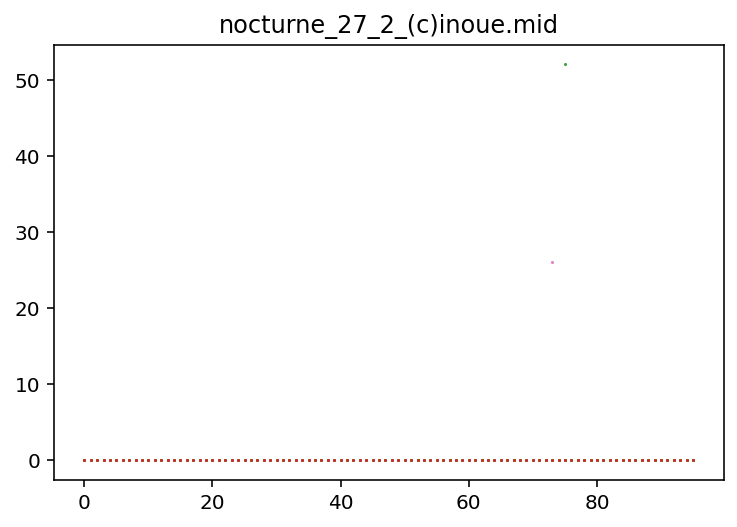

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


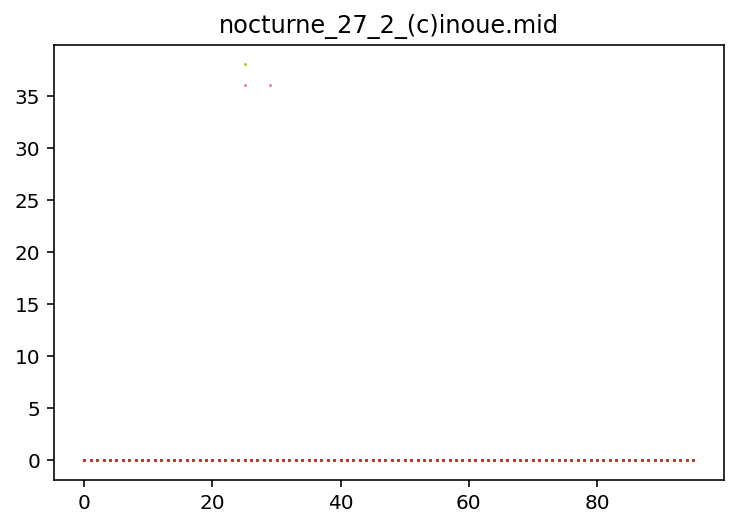

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


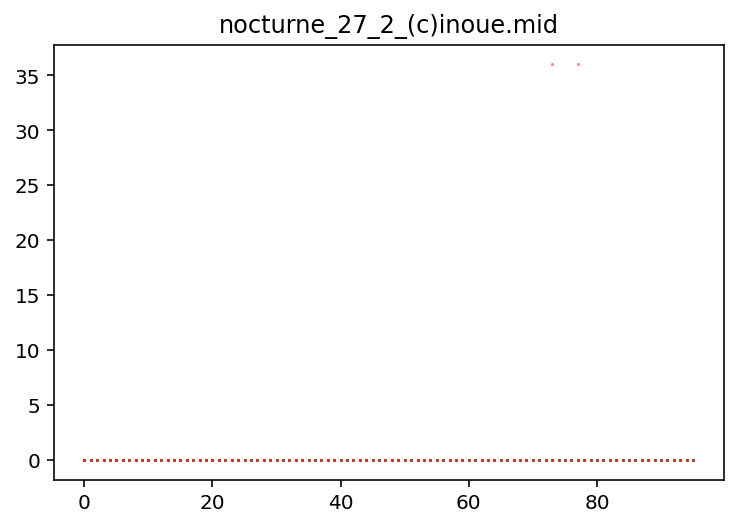

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


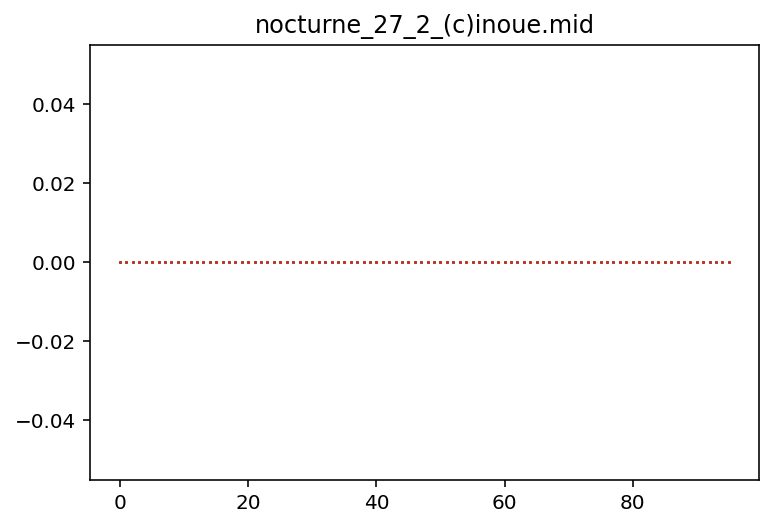

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


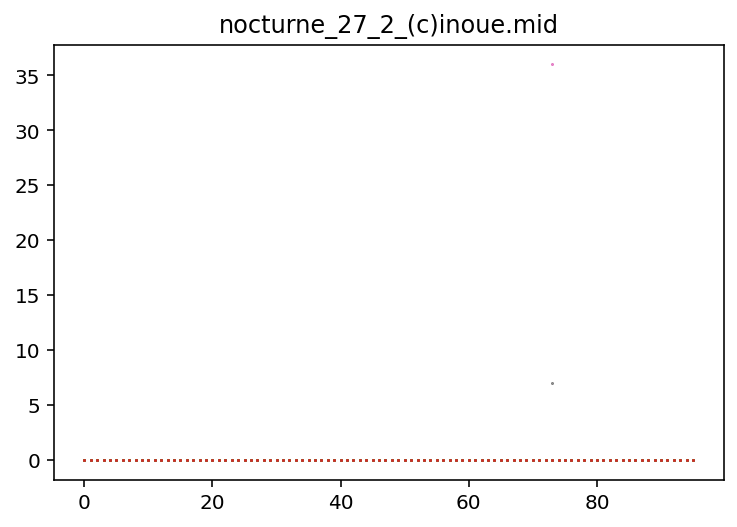

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


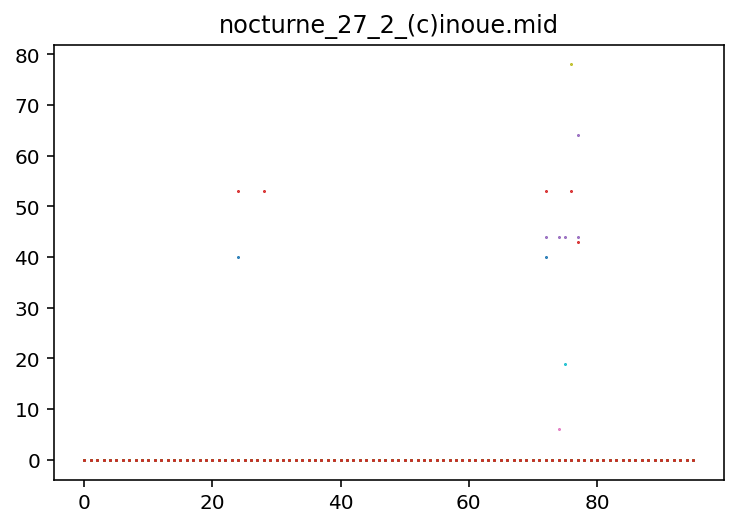

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


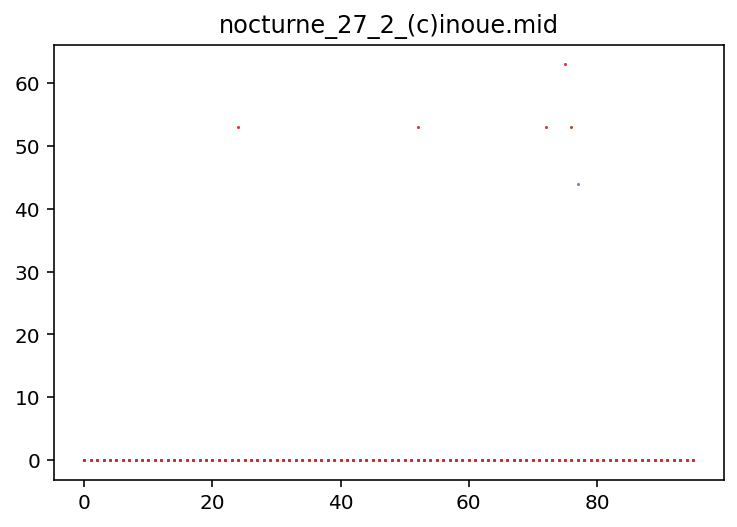

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


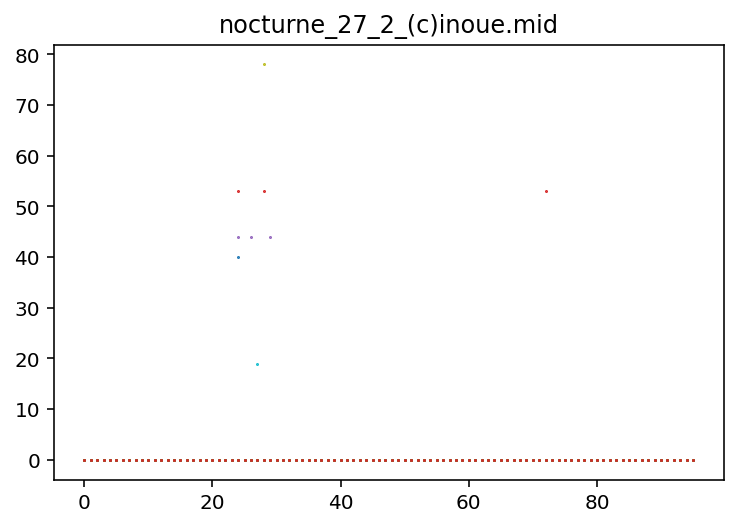

<ipython-input-16-fd7a0d7237ab>:10: RuntimeWarning: invalid value encountered in double_scalars
  mean = total/num_nz


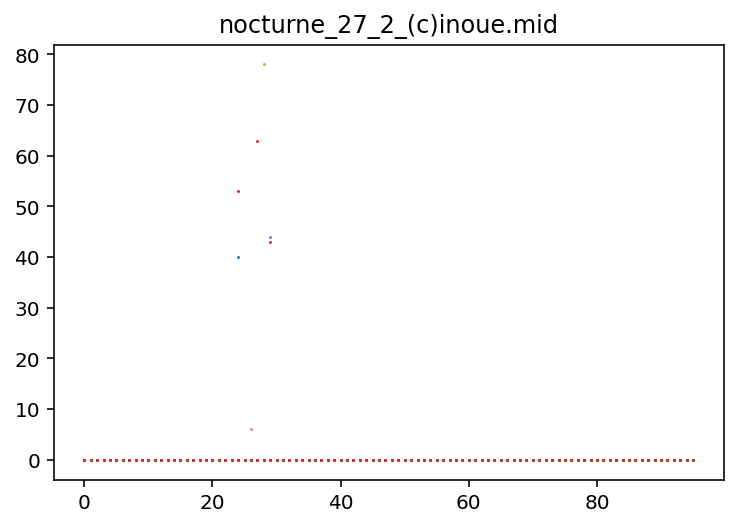

(4, 384, 84)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [29]:
for i in range(Data.shape[0] - 1):

    DDD = Data[i]
    print(DDD.shape)
    Q = compose(DDD)
    print(Q.shape)
    mid = tarry2mid(Q.astype('int32'))
    mid.save("results_v2/v_2epoch%d.mid" % (i*50))